In [1]:
library(survival)
library(survminer)
library(rms)
library(glmnet)
library(dplyr)
library(data.table)
library(readr)
library(stringr)
library(mltools)
library(tidyr)
library(eeptools)
library(meta)
library(metafor)
library(grid)
library(mstate)
library(vcfR)
library(ggpubr)
library(qqman)
library(lattice)
library(forestplot)
qq <- qqman::qq
replace_na <- tidyr::replace_na


source('IL7_scripts.R')

my_forest <- function(result,var,name,xlim=NA,by="Cancer type") {
    res <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- res %>% arrange(desc(n))
    res <- rbind(res,data.frame(cancer=c(NA,"Fixed effects model"),HR=c(NA,exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(NA,exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(NA,exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c(NA,(result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(NA,sum(res$n))))
    
    data <- 
      structure(list(
        mean  = c(NA, res$HR), 
        lower = c(NA, res$HR_min),
        upper = c(NA, res$HR_max)),
        .Names = c("mean", "lower", "upper"), 
        row.names = c(-11L), 
        class = "data.frame")

    tabletext<-cbind(
      c(by, res$cancer),
      c("HR", signif(res$HR,2)),
      c("p-value", gsub('     NA',NA,format(signif(res$pval,2),scientific=T))),
      c("N", res$n),
      c("95%-CI",gsub("\\[NA,NA\\]",NA,paste("[",signif(res$HR_min,2),",",signif(res$HR_max,2),"]",sep="")))
    )

    linenumber <- as.character(length(res$HR)+1)
    hrzl_lines = list(tempname=gpar(lty=1,col="gray"))
    names(hrzl_lines) <- linenumber
    options(repr.plot.width=12, repr.plot.height=5)
    if (is.na(xlim)) {
       xlim <- c(0,quantile(res$HR_max,0.7,na.rm=T)[[1]])
    }
    forestplot(tabletext, data, new_page = TRUE, 
               graphwidth=unit(12,"cm"), clip = xlim,
               graph.pos = 5,
    #            hrzl_lines=hrzl_lines,
               boxsize=0.15,
               is.summary=c(TRUE,rep(FALSE,length(res$HR)-1)),
               grid = structure(c(res$HR[length(res$HR)]), gp = gpar(col = "black", lty = 2)),
               col=fpColors(box="black",line="black",summary="black"),
               vertices=TRUE, zero=1, align=c("l","l","l","r","r"), txt_gp = fpTxtGp(ticks=gpar(cex=0.8),xlab=gpar(cex=0.8)),
               xlab = "HR",
               title=name
              )
}

irAE_type_forest <- function(var,var_name) {
    tr1 <- meta_survival_AE(c(var),OS_GWAS_colitis %>% filter(before_2018==1),plot = F)
    tr2 <- meta_survival_AE(c(var),OS_GWAS_skin %>% filter(before_2018==1),plot = F)
    tr3 <- meta_survival_AE(c(var),OS_GWAS_thyroid %>% filter(before_2018==1),plot = F)
    tr4 <- meta_survival_AE(c(var),OS_GWAS_pneumo %>% filter(before_2018==1),plot = F)
    tr5 <- meta_survival_AE(c(var),OS_GWAS_general %>% filter(before_2018==1),plot = F)
    tr6 <- meta_survival_AE(c(var),OS_GWAS_hepa %>% filter(before_2018==1),plot = F)
    tr7 <- meta_survival_AE(c(var),OS_GWAS_adrenal %>% filter(before_2018==1),plot = F)
    tr8 <- meta_survival_AE(c(var),OS_GWAS_other %>% filter(before_2018==1),plot = F)

    my_forest(tr1,paste0(var,".1"),paste0(var_name," colitis"))
    my_forest(tr2,paste0(var,".1"),paste0(var_name," skin"))
    my_forest(tr3,paste0(var,".1"),paste0(var_name," thyroid"))
    my_forest(tr4,paste0(var,".1"),paste0(var_name," pneumonitis"))
    my_forest(tr5,paste0(var,".1"),paste0(var_name," general adverse event"))
    my_forest(tr6,paste0(var,".1"),paste0(var_name," hepatitis"))
    my_forest(tr7,paste0(var,".1"),paste0(var_name," adrenal insufficiency"))
    my_forest(tr8,paste0(var,".1"),paste0(var_name," other"))

    var <- paste0(var,".1")
    result <- tr1
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- data.frame(irAE=c("Colitis"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n)))
    result <- tr2
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Dermatitis/Rash"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))
    result <- tr3
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Thyroid"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))
    result <- tr4
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Pneumonitis"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))
    result <- tr5
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Unspecified"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))
    result <- tr6
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Hepatitis"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))
    result <- tr7
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Adrenal Insufficiency"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))
    result <- tr8
    temp <- result[[2]] %>% filter(variables==var) %>% mutate(HR=exp(log_hr),HR_max = exp(log_hr+qnorm(0.975)*log_hr_sd),HR_min = exp(log_hr-qnorm(0.975)*log_hr_sd)) %>% select(cancer,HR,HR_min,HR_max,pval,n)
    res <- rbind(res,data.frame(irAE=c("Other"),HR=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed)),HR_min=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$lower.fixed)),HR_max=c(exp((result[[1]] %>% filter(variables==var))$result[[1]]$upper.fixed)),pval=c((result[[1]] %>% filter(variables==var))$result[[1]]$pval.fixed),n=c(sum(temp$n))))

    res <- res %>% arrange(desc(n)) %>% mutate(irAE=as.character(irAE))
    
#     result <- tr1
#     temp <- data.frame(name="Colitis",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed)
#     result <- tr2
#     temp <- rbind(temp,data.frame(name="Dermatitis",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))
#     result <- tr3
#     temp <- rbind(temp,data.frame(name="Thyroid",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))
#     result <- tr4
#     temp <- rbind(temp,data.frame(name="Pneumonitis",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))
#     result <- tr5
#     temp <- rbind(temp,data.frame(name="general",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))
#     result <- tr6
#     temp <- rbind(temp,data.frame(name="Hepatitis",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))
#     result <- tr7
#     temp <- rbind(temp,data.frame(name="adrenal",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))
#     result <- tr8
#     temp <- rbind(temp,data.frame(name="other",log_hr=(result[[1]] %>% filter(variables==var))$result[[1]]$TE.fixed,log_hr_sd=result[[1]]$result[[1]]$seTE.fixed))

#     meta <- metagen(temp$log_hr,temp$log_hr_sd,studlab=temp$name,comb.random=F,comb.fixed=T,method.tau = "SJ",hakn = TRUE,prediction=F,sm="SMD")
#     res <- rbind(res,data.frame(irAE=c(NA,"Meta"),HR=c(NA,exp((meta$TE.fixed))),HR_min=c(NA,exp((meta$lower.fixed))),HR_max=c(NA,exp((meta$upper.fixed))),pval=c(NA,(meta$pval.fixed)),n=c(NA,NA)))

    data <- 
        structure(list(
        mean  = c(NA, res$HR), 
        lower = c(NA, res$HR_min),
        upper = c(NA, res$HR_max)),
        .Names = c("mean", "lower", "upper"), 
        row.names = c(-11L), 
    class = "data.frame")

    tabletext<-cbind(
        c("irAE", res$irAE),
        c("HR", signif(res$HR,2)),
        c("p-value", gsub('     NA',NA,format(signif(res$pval,2),scientific=T))),
        c("N", res$n),
        c("95%-CI",gsub("\\[NA,NA\\]",NA,paste("[",signif(res$HR_min,2),",",signif(res$HR_max,2),"]",sep="")))
    )
    linenumber <- as.character(length(res$HR))
    # hrzl_lines = list(tempname=gpar(lty=1,col="gray"))
    # names(hrzl_lines) <- linenumber
    options(repr.plot.width=12, repr.plot.height=5)
    xlim <- c(0,quantile(res$HR_max,0.7,na.rm=T)[[1]])
    forestplot(tabletext, data, new_page = TRUE, 
               graphwidth=unit(12,"cm"), clip = xlim,
               graph.pos = 5,
    #                hrzl_lines=hrzl_lines,
               boxsize=0.15,
#                is.summary=c(TRUE,rep(FALSE,length(res$HR)-1)),
               col=fpColors(box="black",line="black",summary="black"),
#                grid = structure(c(res$HR[length(res$HR)]), gp = gpar(col = "black", lty = 2)),
               vertices=TRUE, zero=1, align=c("l","l","l","r","r"), txt_gp = fpTxtGp(ticks=gpar(cex=0.8),xlab=gpar(cex=0.8)),
               xlab = "HR",
               title=var_name
              )
}

Loading required package: ggplot2
Loading required package: ggpubr
Loading required package: magrittr
Loading required package: Hmisc
Loading required package: lattice
Loading required package: Formula

Attaching package: ‘Hmisc’

The following objects are masked from ‘package:base’:

    format.pval, units

Loading required package: SparseM

Attaching package: ‘SparseM’

The following object is masked from ‘package:base’:

    backsolve

Loading required package: Matrix
Loading required package: foreach
Loaded glmnet 2.0-16


Attaching package: ‘dplyr’

The following objects are masked from ‘package:Hmisc’:

    src, summarize

The following objects are masked from ‘package:stats’:

    filter, lag

The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Attaching package: ‘data.table’

The following objects are masked from ‘package:dplyr’:

    between, first, last


Attaching package: ‘tidyr’

The following object is masked from ‘package:mlto

# GWAS

In [2]:
result <- data.frame()

files <- list.files("GWAS/result_coxmeg_truenegcorrected/")
files <- files[!grepl("old",files)]
length(files)
pb <- txtProgressBar(min = 1, max = length(files), style = 3)
count <- 1
for (file in files) {
    res <- fread(paste("GWAS/result_coxmeg_truenegcorrected/",file,sep=""))
    result <- rbind(result,res)
    setTxtProgressBar(pb, count)  
    count <- count + 1
}

[1] 2200

  |======================================================================| 100%

[1] 1.025475

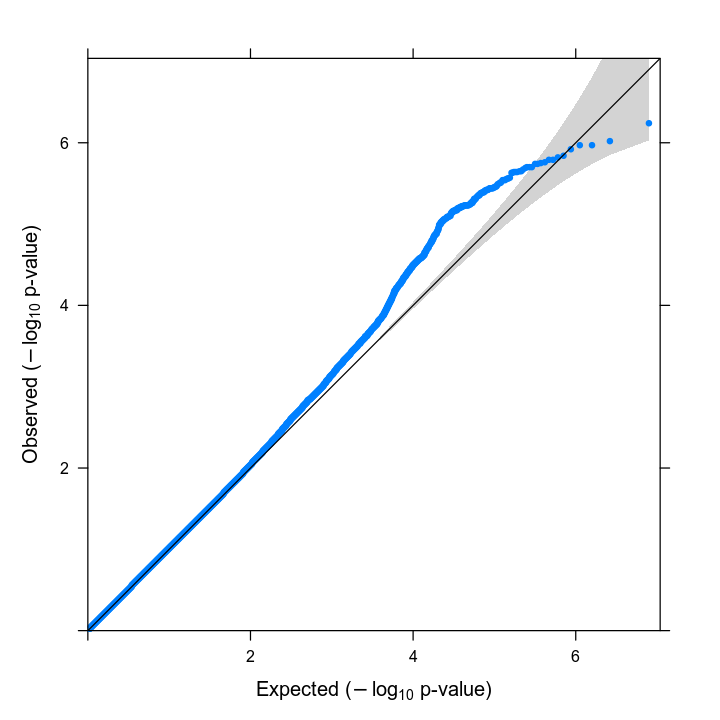

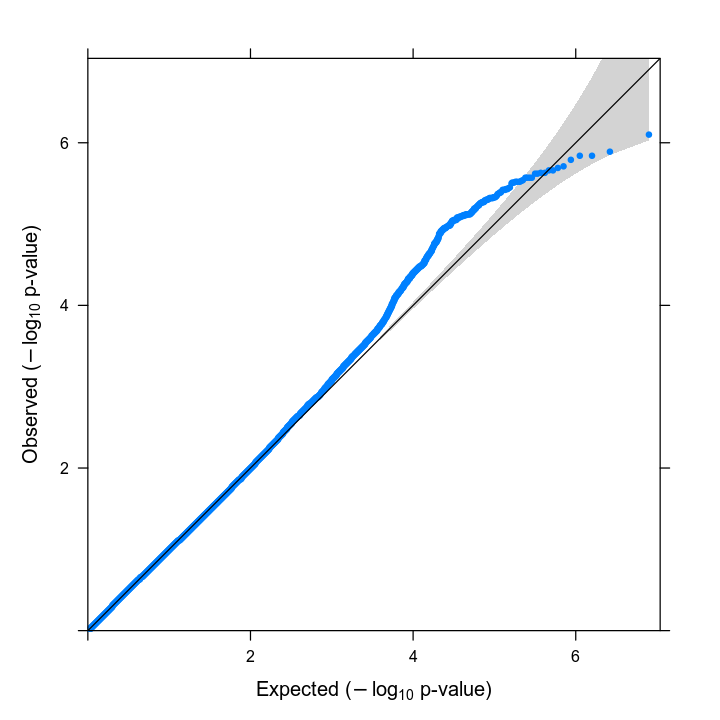

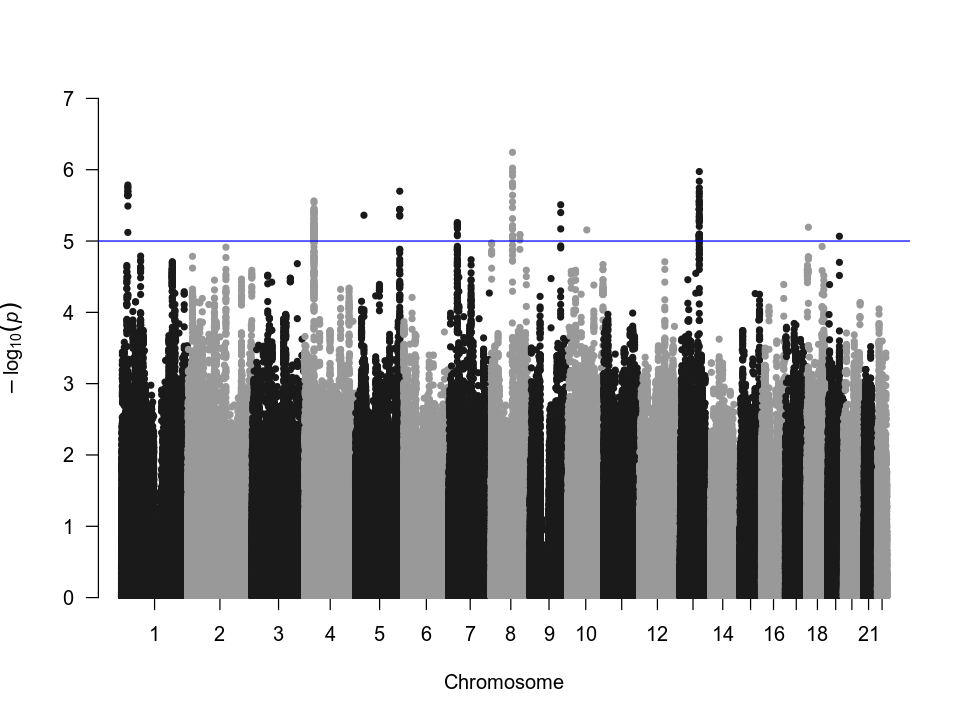

In [3]:
result_cancer_chrom_manhattan <- result %>% mutate(CHR=as.integer(gsub("\\_.*","",allele)),BP=as.integer(gsub("^.*\\_","",allele))) %>% rename(SNP=allele,P=p) %>% dplyr::select(SNP,CHR,BP,P)

# lambda_gc
chisq <- qchisq(1-result_cancer_chrom_manhattan$P,1)
lambda_gc <- median(chisq)/qchisq(0.5,1)
lambda_gc
options(repr.plot.width=6,repr.plot.height=6)
qqunif.plot(result_cancer_chrom_manhattan$P)
result_cancer_chrom_manhattan$P_GC <- 1-pchisq(chisq/lambda_gc, df=1)
qqunif.plot(result_cancer_chrom_manhattan$P_GC)
options(repr.plot.width=8,repr.plot.height=6)
manhattan(result_cancer_chrom_manhattan)

In [3]:
result_cancer_chrom_manhattan <- result %>% mutate(CHR=as.integer(gsub("\\_.*","",allele)),BP=as.integer(gsub("^.*\\_","",allele))) %>% rename(SNP=allele,P=p) %>% dplyr::select(SNP,CHR,BP,P)

temp <- fread("IL7_GWAS_multistate_chrom8.csv") %>% mutate(allele=gsub("SNP_","",allele),BP=as.integer(gsub(".*_(.*)","\\1",allele)),CHR=as.integer(gsub("(.*)_.*","\\1",allele))) %>% select(allele,CHR,BP,pval) %>% rename(SNP=allele,P=pval)
temp <- rbind(temp,fread("IL7_GWAS_multistate_chrom1.csv") %>% mutate(allele=gsub("SNP_","",allele),BP=as.integer(gsub(".*_(.*)","\\1",allele)),CHR=as.integer(gsub("(.*)_.*","\\1",allele))) %>% select(allele,CHR,BP,pval) %>% rename(SNP=allele,P=pval))
temp <- rbind(temp,fread("IL7_GWAS_multistate_chrom4.csv") %>% mutate(allele=gsub("SNP_","",allele),BP=as.integer(gsub(".*_(.*)","\\1",allele)),CHR=as.integer(gsub("(.*)_.*","\\1",allele))) %>% select(allele,CHR,BP,pval) %>% rename(SNP=allele,P=pval))
result_cancer_chrom_manhattan_replaced <- rbind(temp,result_cancer_chrom_manhattan %>% filter(!SNP %in% temp$SNP)) %>% mutate(CHR=as.integer(CHR),BP=as.integer(BP)) %>% arrange(CHR,BP)

# result_cancer_chrom_manhattan_replaced <- result_cancer_chrom_manhattan_replaced %>% mutate(SNP=ifelse(SNP=="1_24464626","rs75824728",ifelse(SNP=="8_79712998","rs16906115",ifelse(SNP=="4_34448039","rs113861051",SNP))))
result_cancer_chrom_manhattan_replaced <- result_cancer_chrom_manhattan_replaced %>% mutate(SNP=ifelse(SNP=="1_24464626","IL22RA1",ifelse(SNP=="8_79712998","IL7",ifelse(SNP=="4_34448039","LINC02484",SNP))))

[1] 1.025765

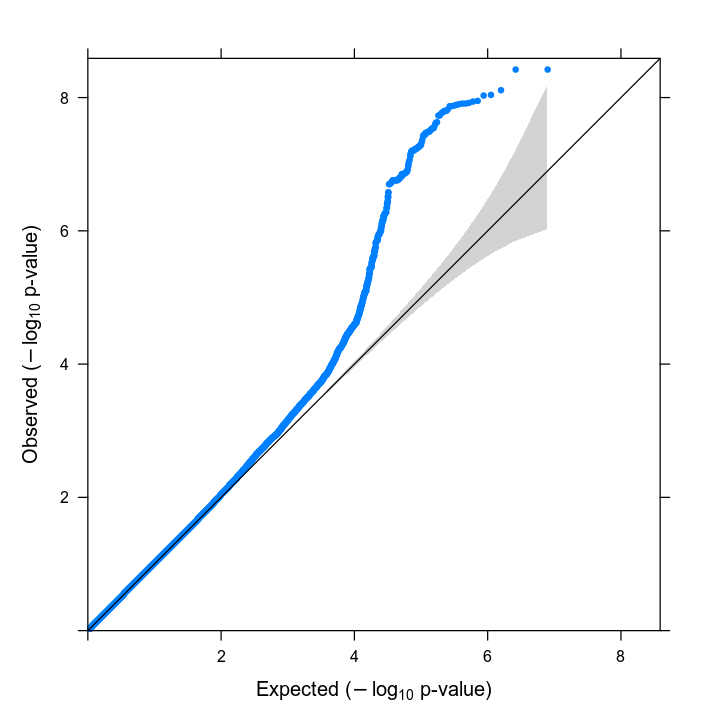

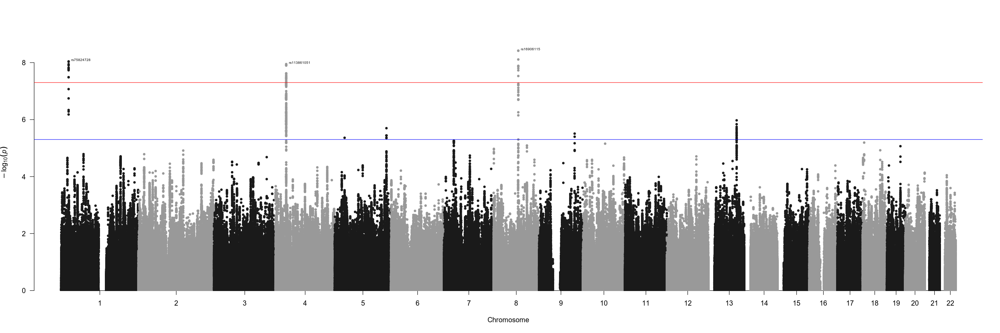

In [6]:
chisq <- qchisq(1-result_cancer_chrom_manhattan_replaced$P,1)
lambda_gc <- median(chisq)/qchisq(0.5,1)
lambda_gc
options(repr.plot.width=6,repr.plot.height=6)
qqunif.plot(result_cancer_chrom_manhattan_replaced$P)
options(repr.plot.width=24,repr.plot.height=8)
manhattan(result_cancer_chrom_manhattan_replaced, annotatePval = 5e-8, suggestiveline = -log10(5e-06),ylim=c(0,9))

In [50]:
library(calibrate)
select <- dplyr::select

manhattan <- function(x, chr="CHR", bp="BP", p="P", snp="SNP", 
                      col=c("gray10", "gray60"), chrlabs=NULL,
                      suggestiveline=-log10(1e-5), genomewideline=-log10(5e-8), 
                      highlight=NULL, logp=TRUE, annotatePval = NULL, annotateTop = TRUE, ...) {

    # Not sure why, but package check will warn without this.
    CHR=BP=P=index=NULL
    
    # Check for sensible dataset
    ## Make sure you have chr, bp and p columns.
    if (!(chr %in% names(x))) stop(paste("Column", chr, "not found!"))
    if (!(bp %in% names(x))) stop(paste("Column", bp, "not found!"))
    if (!(p %in% names(x))) stop(paste("Column", p, "not found!"))
    ## warn if you don't have a snp column
    if (!(snp %in% names(x))) warning(paste("No SNP column found. OK unless you're trying to highlight."))
    ## make sure chr, bp, and p columns are numeric.
    if (!is.numeric(x[[chr]])) stop(paste(chr, "column should be numeric. Do you have 'X', 'Y', 'MT', etc? If so change to numbers and try again."))
    if (!is.numeric(x[[bp]])) stop(paste(bp, "column should be numeric."))
    if (!is.numeric(x[[p]])) stop(paste(p, "column should be numeric."))
    
    # Create a new data.frame with columns called CHR, BP, and P.
    d=data.frame(CHR=x[[chr]], BP=x[[bp]], P=x[[p]])
    
    # If the input data frame has a SNP column, add it to the new data frame you're creating.
    if (!is.null(x[[snp]])) d=transform(d, SNP=x[[snp]])
    
    # Set positions, ticks, and labels for plotting
    ## Sort and keep only values where is numeric.
    #d <- subset(d[order(d$CHR, d$BP), ], (P>0 & P<=1 & is.numeric(P)))
    d <- subset(d, (is.numeric(CHR) & is.numeric(BP) & is.numeric(P)))
    d <- d[order(d$CHR, d$BP), ]
    #d$logp <- ifelse(logp, yes=-log10(d$P), no=d$P)
    if (logp) {
        d$logp <- -log10(d$P)
    } else {
        d$logp <- d$P
    }
    d$pos=NA
    
    
    # Fixes the bug where one chromosome is missing by adding a sequential index column.
    d$index=NA
    ind = 0
    for (i in unique(d$CHR)){
        ind = ind + 1
        d[d$CHR==i,]$index = ind
    }
    
    # This section sets up positions and ticks. Ticks should be placed in the
    # middle of a chromosome. The a new pos column is added that keeps a running
    # sum of the positions of each successive chromsome. For example:
    # chr bp pos
    # 1   1  1
    # 1   2  2
    # 2   1  3
    # 2   2  4
    # 3   1  5
    nchr = length(unique(d$CHR))
    if (nchr==1) { ## For a single chromosome
        ## Uncomment the next two linex to plot single chr results in Mb
        #options(scipen=999)
	    #d$pos=d$BP/1e6
        d$pos=d$BP
        ticks=floor(length(d$pos))/2+1
        xlabel = paste('Chromosome',unique(d$CHR),'position')
        labs = ticks
    } else { ## For multiple chromosomes
        lastbase=0
        ticks=NULL
        for (i in unique(d$index)) {
            if (i==1) {
                d[d$index==i, ]$pos=d[d$index==i, ]$BP
            } else {
                lastbase=lastbase+tail(subset(d,index==i-1)$BP, 1)
                d[d$index==i, ]$pos=d[d$index==i, ]$BP+lastbase
            }
            # Old way: assumes SNPs evenly distributed
            # ticks=c(ticks, d[d$index==i, ]$pos[floor(length(d[d$index==i, ]$pos)/2)+1])
            # New way: doesn't make that assumption
            ticks = c(ticks, (min(d[d$index == i,]$pos) + max(d[d$index == i,]$pos))/2 + 1)
        }
        xlabel = 'Chromosome'
        #labs = append(unique(d$CHR),'') ## I forgot what this was here for... if seems to work, remove.
        labs <- unique(d$CHR)
    }
    
    # Initialize plot
    xmax = ceiling(max(d$pos) * 1.03)
    xmin = floor(max(d$pos) * -0.03)
    
    # The old way to initialize the plot
    # plot(NULL, xaxt='n', bty='n', xaxs='i', yaxs='i', xlim=c(xmin,xmax), ylim=c(ymin,ymax),
    #      xlab=xlabel, ylab=expression(-log[10](italic(p))), las=1, pch=20, ...)

    
    # The new way to initialize the plot.
    ## See http://stackoverflow.com/q/23922130/654296
    ## First, define your default arguments
    def_args <- list(xaxt='n', bty='n', xaxs='i', yaxs='i', las=1, pch=20,
                     xlim=c(xmin,xmax), ylim=c(0,ceiling(max(d$logp))),
                     xlab=xlabel, ylab=expression(-log[10](italic(p))))
    ## Next, get a list of ... arguments
    #dotargs <- as.list(match.call())[-1L]
    dotargs <- list(...)
    ## And call the plot function passing NA, your ... arguments, and the default
    ## arguments that were not defined in the ... arguments.
    par(mar = c(5.5, 5.5, 4.1, 2.1))
    do.call("plot", c(NA, dotargs, def_args[!names(def_args) %in% names(dotargs)]))
    
    # If manually specifying chromosome labels, ensure a character vector and number of labels matches number chrs.
    if (!is.null(chrlabs)) {
        if (is.character(chrlabs)) {
            if (length(chrlabs)==length(labs)) {
                labs <- chrlabs
            } else {
                warning("You're trying to specify chromosome labels but the number of labels != number of chromosomes.")
            }
        } else {
            warning("If you're trying to specify chromosome labels, chrlabs must be a character vector")
        }
    }
    
    # Add an axis. 
    if (nchr==1) { #If single chromosome, ticks and labels automatic.
        axis(1, ...)
    } else { # if multiple chrs, use the ticks and labels you created above.
        axis(1, at=ticks, labels=labs, ...)
    }
    
    # Create a vector of alternatiting colors
    col=rep(col, max(d$CHR))

    # Add points to the plot
    if (nchr==1) {
        with(d, points(pos, logp, pch=20, col=col[1], ...))
    } else {
        # if multiple chromosomes, need to alternate colors and increase the color index (icol) each chr.
        icol=1
        for (i in unique(d$index)) {
            with(d[d$index==unique(d$index)[i], ], points(pos, logp, col=col[icol], pch=20, ...))
            icol=icol+1
        }
    }
    
    # Add suggestive and genomewide lines
    if (suggestiveline) abline(h=suggestiveline, col="blue")
    if (genomewideline) abline(h=genomewideline, col="red")
    
    # Highlight snps from a character vector
    if (!is.null(highlight)) {
        if (any(!(highlight %in% d$SNP))) warning("You're trying to highlight SNPs that don't exist in your results.")
        d.highlight=d[which(d$SNP %in% highlight), ]
        with(d.highlight, points(pos, logp, col="green3", pch=20, ...)) 
    }
    
    # Highlight top SNPs
    if (!is.null(annotatePval)) {
        # extract top SNPs at given p-val
        topHits = subset(d, P <= annotatePval)
        par(xpd = TRUE)
        # annotate these SNPs
        if (annotateTop == FALSE) {
            with(subset(d, P <= annotatePval), 
                 textxy(pos, -log10(P), offset = 0.625, labs = topHits$SNP, cex = 2), ...)
        }
        else {
            # could try alternative, annotate top SNP of each sig chr
            topHits <- topHits[order(topHits$P),]
            topSNPs <- NULL
            
            for (i in unique(topHits$CHR)) {
                
                chrSNPs <- topHits[topHits$CHR == i,]
                topSNPs <- rbind(topSNPs, chrSNPs[1,])
                
            }
            textxy(topSNPs$pos, -log10(topSNPs$P), offset = 0.625, labs = topSNPs$SNP, cex = 2.5, ...)
        }
    }  
    par(xpd = FALSE)
}

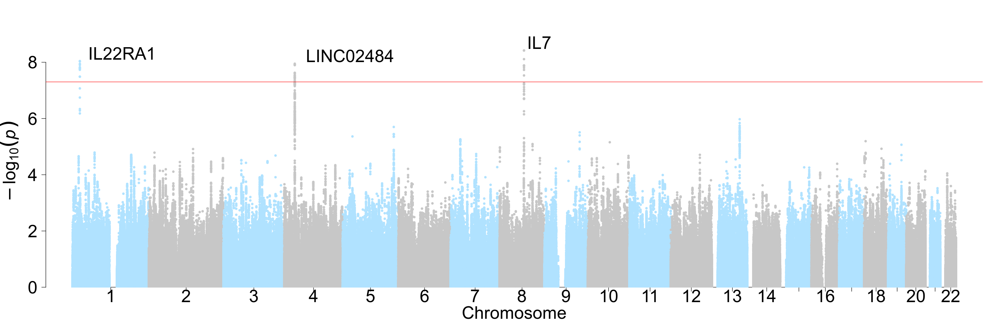

In [42]:
options(repr.plot.width=24,repr.plot.height=8)
manhattan(result_cancer_chrom_manhattan_replaced, annotatePval = 5e-8, suggestiveline = F,ylim=c(0,9),cex.axis = 2.5, cex.lab=2.5, col = c("lightskyblue1","grey78"))

In [7]:
snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=gsub(":","_",V1)) %>% rename(allele=V1,SNP=V3)

inner_join(result %>% arrange(p) %>% filter(p<5e-5),snptrans)
fwrite(inner_join(result %>% arrange(p) %>% filter(p<5e-5),snptrans),"IL7_coxmeg_suggestiveSNPs.csv")

Joining, by = "allele"


allele,beta,HR,sd_beta,p,SNP
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
8_79557237,-0.9254063,0.3963703,0.18505389,5.711084e-07,rs7011565
8_79712998,-0.7764404,0.4600407,0.15839945,9.496875e-07,rs16906115
13_90715598,-0.4989793,0.6071501,0.10225054,1.061036e-06,rs1491024
8_79659182,-0.8475601,0.4284590,0.17374638,1.070879e-06,rs16906062
8_79694464,-0.7833721,0.4568628,0.16137605,1.207965e-06,rs73251644
13_90719948,-0.4690276,0.6256103,0.09735354,1.451670e-06,rs9588852
8_79626275,-0.8552512,0.4251764,0.17786316,1.520836e-06,rs73249933
8_79658906,-0.8400098,0.4317063,0.17523107,1.637115e-06,rs7816685
1_24463359,-0.7226034,0.4854867,0.15074789,1.639325e-06,rs78086250


Joining, by = "allele"


In [50]:
temp <- result %>% arrange(p) %>% filter(p<5e-5)
temp %>% mutate(CHR=gsub("(.*)_.*","\\1",allele)) %>% group_by(CHR) %>% count

CHR,n
<chr>,<int>
1,104
10,28
12,3
13,62
16,1
18,29
19,4
2,26
3,11


In [55]:
fwrite(inner_join(result %>% arrange(p) %>% filter(grepl("8_",allele)),snptrans),"coxmeg_chrom8SNPs_truenegcorrected.csv")
fwrite(inner_join(result %>% arrange(p) %>% filter(grepl("1_",allele)),snptrans),"coxmeg_chrom1SNPs_truenegcorrected.csv")

Joining, by = "allele"
Joining, by = "allele"


In [4]:
snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=gsub(":","_",V1)) %>% rename(allele=V1,SNP=V3)

sumstat <- inner_join(result,snptrans)

sumstat <- sumstat %>% mutate(chr=gsub("([0-9]*)_[0-9]*","\\1",allele),pos=gsub("[0-9]*_([0-9]*)","\\1",allele)) %>% rename(snp=SNP) %>% select(chr,pos,snp,HR,beta,sd_beta,p)

refalt <- fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/alleles.tsv",header=F,col.names = c("SNP","COUNTED","ALT"))
refalt <- refalt %>% mutate(chr=gsub("([0-9]*):([0-9]*)","\\1",SNP),pos=gsub("([0-9]*):([0-9]*)","\\2",SNP))

sumstat <- inner_join(sumstat,refalt) %>% select(chr,pos,snp,COUNTED,ALT,HR,beta,sd_beta,p) %>% rename(ref=COUNTED,alt=ALT)

fwrite(sumstat,"IL7.summstat")

Joining, by = "allele"


### curated

In [198]:
result <- data.frame()

files <- list.files("GWAS/result_curated_coxmeg/")
files <- files[!grepl("old",files)]
length(files)
pb <- txtProgressBar(min = 1, max = length(files), style = 3)
count <- 1
for (file in files) {
    res <- fread(paste("GWAS/result_curated_coxmeg/",file,sep=""))
    result <- rbind(result,res)
    setTxtProgressBar(pb, count)  
    count <- count + 1
}

[1] 2200

  |======================================================================| 100%

[1] 1.042557

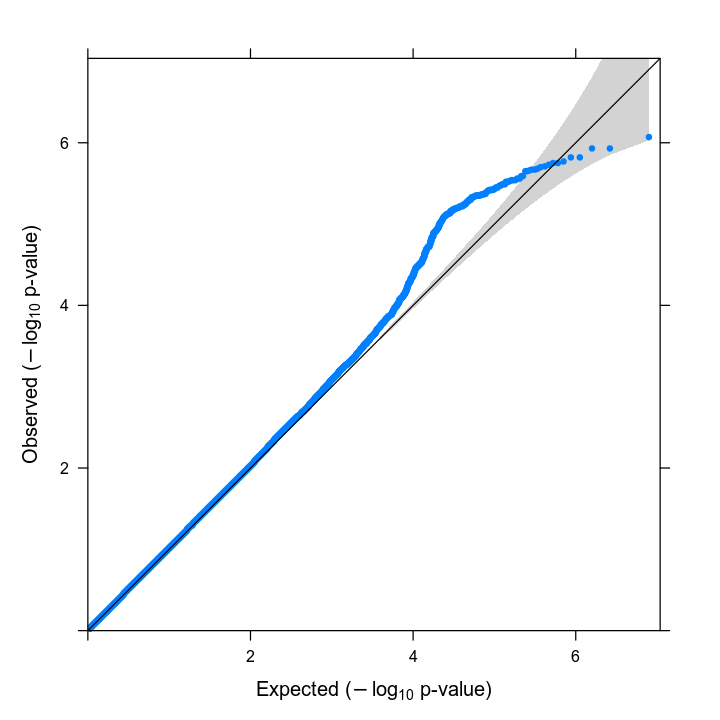

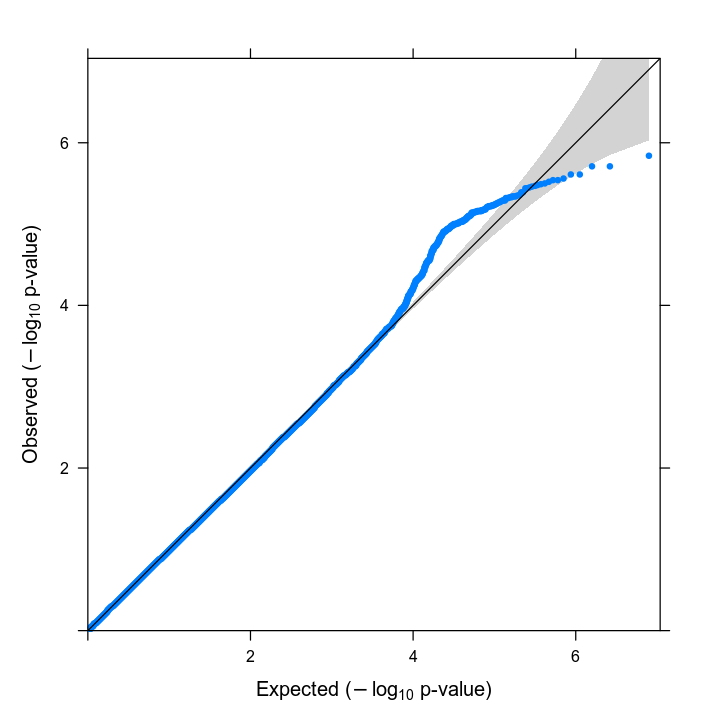

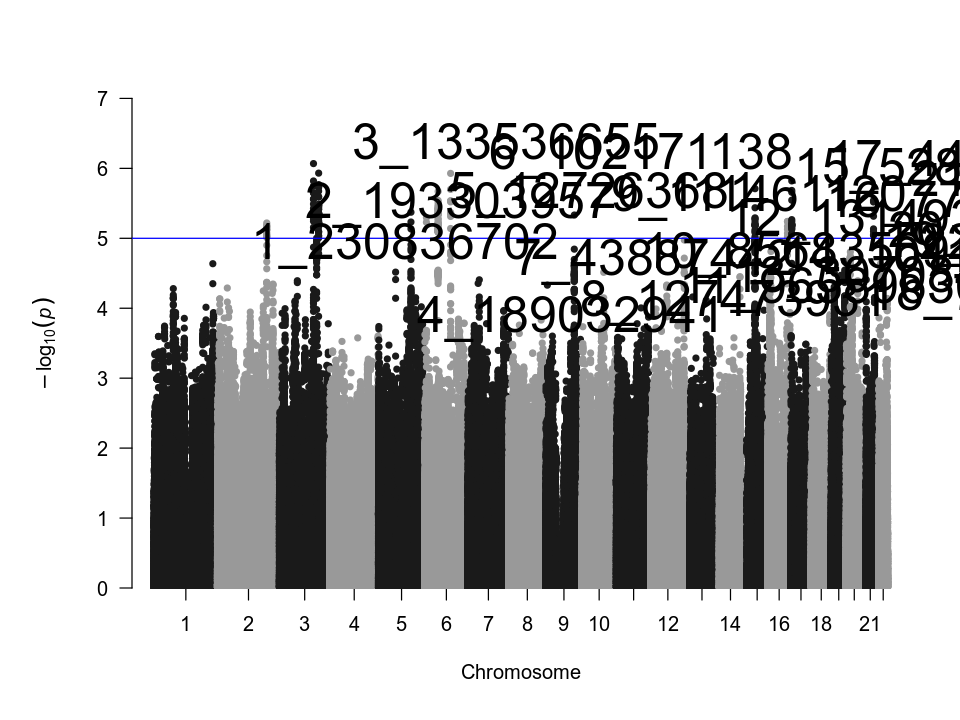

In [44]:
result_cancer_chrom_manhattan <- result %>% mutate(CHR=as.integer(gsub("\\_.*","",allele)),BP=as.integer(gsub("^.*\\_","",allele))) %>% rename(SNP=allele,P=p) %>% dplyr::select(SNP,CHR,BP,P)

# lambda_gc
chisq <- qchisq(1-result_cancer_chrom_manhattan$P,1)
lambda_gc <- median(chisq)/qchisq(0.5,1)
lambda_gc
options(repr.plot.width=6,repr.plot.height=6)
qqunif.plot(result_cancer_chrom_manhattan$P)
result_cancer_chrom_manhattan$P_GC <- 1-pchisq(chisq/lambda_gc, df=1)
qqunif.plot(result_cancer_chrom_manhattan$P_GC)
options(repr.plot.width=8,repr.plot.height=6)
manhattan(result_cancer_chrom_manhattan, annotatePval = 0.01)

In [51]:
result_cancer_chrom_manhattan <- result %>% mutate(CHR=as.integer(gsub("\\_.*","",allele)),BP=as.integer(gsub("^.*\\_","",allele))) %>% rename(SNP=allele,P=p) %>% dplyr::select(SNP,CHR,BP,P)

temp <- fread("IL7_GWAS_multistate_chrom3.csv") %>% mutate(allele=gsub("SNP_","",allele),BP=as.integer(gsub(".*_(.*)","\\1",allele)),CHR=as.integer(gsub("(.*)_.*","\\1",allele))) %>% select(allele,CHR,BP,pval) %>% rename(SNP=allele,P=pval)
result_cancer_chrom_manhattan_replaced <- rbind(temp,result_cancer_chrom_manhattan %>% filter(!SNP %in% temp$SNP)) %>% mutate(CHR=as.integer(CHR),BP=as.integer(BP)) %>% arrange(CHR,BP)

In [ ]:
chisq <- qchisq(1-result_cancer_chrom_manhattan_replaced$P,1)
lambda_gc <- median(chisq)/qchisq(0.5,1)
lambda_gc
options(repr.plot.width=6,repr.plot.height=6)
qqunif.plot(result_cancer_chrom_manhattan_replaced$P)
options(repr.plot.width=24,repr.plot.height=8)
manhattan(result_cancer_chrom_manhattan_replaced, annotatePval = NULL, suggestiveline = -log10(5e-06),ylim=c(0,9))

ERROR: Error in log10(topSNPs$P): non-numeric argument to mathematical function


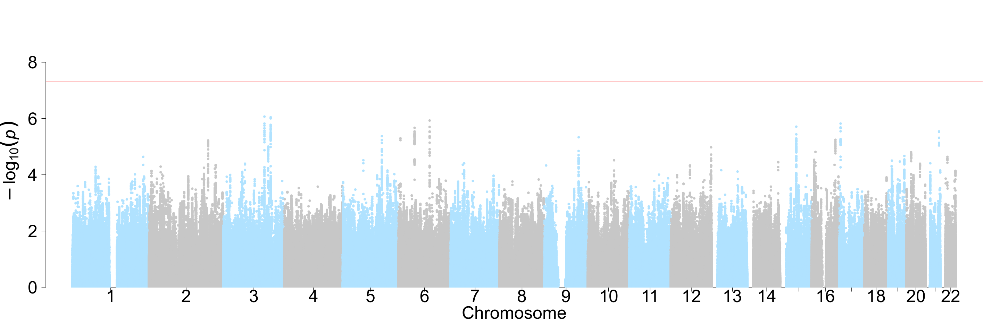

In [52]:
options(repr.plot.width=24,repr.plot.height=8)
manhattan(result_cancer_chrom_manhattan_replaced, annotatePval = 5e-8, suggestiveline = F,ylim=c(0,9),cex.axis = 2.5, cex.lab=2.5, col = c("lightskyblue1","grey78"))

In [12]:
snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=gsub(":","_",V1)) %>% rename(allele=V1,SNP=V3)

inner_join(result %>% arrange(p) %>% filter(p<5e-5),snptrans)
fwrite(inner_join(result %>% arrange(p) %>% filter(p<5e-5),snptrans),"IL7_coxmeg_suggestiveSNPs_curated.csv")

Joining, by = "allele"


allele,beta,HR,sd_beta,p,SNP
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>
3_133536655,-0.5813098,0.5591655,0.1180965,8.552073e-07,rs1464937
3_153827300,0.6069028,1.8347401,0.1248658,1.171238e-06,rs1624917
6_102171138,-1.1168023,0.3273248,0.2298497,1.180772e-06,rs79887063
17_4424682,-0.6731656,0.5100913,0.1399642,1.512658e-06,rs55818133
3_133524717,-0.6286978,0.5332858,0.1307307,1.516076e-06,rs1107413
3_153835972,0.6747855,1.9636117,0.1410126,1.707445e-06,rs1727880
3_133530647,-0.5443738,0.5802050,0.1139775,1.786800e-06,rs56090943
3_153889725,-0.8846033,0.4128779,0.1852295,1.790689e-06,rs62279489
3_153882865,0.7235750,2.0617909,0.1517950,1.871842e-06,rs1727945


Joining, by = "allele"


In [4]:
fwrite(inner_join(result %>% arrange(p) %>% filter(grepl("3_",allele)),snptrans),"coxmeg_chrom3SNPs_curated.csv")

Joining, by = "allele"


In [199]:
snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=gsub(":","_",V1)) %>% rename(allele=V1,SNP=V3)

sumstat <- inner_join(result,snptrans)

sumstat <- sumstat %>% mutate(chr=gsub("([0-9]*)_[0-9]*","\\1",allele),pos=gsub("[0-9]*_([0-9]*)","\\1",allele)) %>% rename(snp=SNP) %>% select(chr,pos,snp,HR,beta,sd_beta,p)

refalt <- fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/alleles.tsv",header=F,col.names = c("SNP","COUNTED","ALT"))
refalt <- refalt %>% mutate(chr=gsub("([0-9]*):([0-9]*)","\\1",SNP),pos=gsub("([0-9]*):([0-9]*)","\\2",SNP))

sumstat <- inner_join(sumstat,refalt) %>% select(chr,pos,snp,COUNTED,ALT,HR,beta,sd_beta,p) %>% rename(ref=COUNTED,alt=ALT)

fwrite(sumstat,"IL7_cur.summstat")

Joining, by = "allele"
Joining, by = c("chr", "pos")


# Analysis

In [2]:
pid2bl <- fread("../../../OncDRS_data/ALL/GENOMIC_SPECIMEN.csv",fill=TRUE) %>% select(PATIENT_ID,SAMPLE_ACCESSION_NBR) %>% rename(BLNUM=SAMPLE_ACCESSION_NBR) %>% unique
bl2cbio <- fread("../../../OncDRS_data/ALL/sample_id_to_cbio.txt") %>% select(SampleID,cBio_PatientID,cBio_SampleID) %>% rename(BLNUM=SampleID,CBIO_PATIENT=cBio_PatientID,CBIO_SAMPLE=cBio_SampleID) %>% unique
bl2cbio <- full_join(fread("../../../OncDRS_data/LUNG/raw/PTID_CBIO.csv") %>% select(BLNUM,CBIO_PATIENT,CBIO_SAMPLE),bl2cbio,by=c("BLNUM","CBIO_PATIENT","CBIO_SAMPLE")) %>% distinct
pid2mrn <- fread("../../../OncDRS_data/ALL/PT_INFO_STATUS_REGISTRATION.csv",fill=TRUE) %>% select(PATIENT_ID,DFCI_MRN) %>% rename(MRN=DFCI_MRN) %>% unique
pbp2bl <- fread("/data/gusev/PROFILE/2020_04/gusev-pseudonymize-output.txt") %>% rename(BLNUM=bl_number,PBP=pbp_number) %>% select(BLNUM,PBP)
temp <- right_join(bl2cbio,pid2bl,by="BLNUM") %>% group_by(PATIENT_ID) %>% summarise(CBIO_PATIENT=as.character(ifelse(all(is.na(CBIO_PATIENT)),NA,first(CBIO_PATIENT[!is.na(CBIO_PATIENT)]))))
translate_pid <- merge(temp,pid2mrn,by="PATIENT_ID") %>% select(PATIENT_ID,CBIO_PATIENT,MRN) %>% unique
translate_sid <- full_join(pbp2bl,right_join(bl2cbio,pid2bl,by="BLNUM"),by="BLNUM") %>% select(PATIENT_ID,BLNUM,PBP,CBIO_PATIENT,CBIO_SAMPLE) %>% unique

In [3]:
OS <- fread("../OS/OS.csv",na.string="")
OS <- OS %>% mutate(LAST_DATE=as.Date(LAST_DATE),IO_START=as.Date(IO_START))

OS$PANEL_VERSION <- factor(OS$PANEL_VERSION)
OS$AGE_AT_TREATMENTSTART_BINNED <- factor(OS$AGE_AT_TREATMENTSTART_BINNED)
OS$ANCESTRY_SELFREPORTED <- factor(OS$ANCESTRY_SELFREPORTED)
OS$ANCESTRY_SELFREPORTED <- relevel(OS$ANCESTRY_SELFREPORTED,"White")
OS$ANCESTRY_GENETICS <- factor(OS$ANCESTRY_GENETICS)
OS$ANCESTRY_GENETICS <- relevel(OS$ANCESTRY_GENETICS,"EUR")
OS$TMB_binned <- factor(OS$TMB_binned)
OS$TMB_binned <- relevel(OS$TMB_binned,"0")
OS$TREATMENT_CUM <- factor(OS$TREATMENT_CUM)
levels(OS$TREATMENT_CUM) <- gsub("/| ","_",levels(OS$TREATMENT_CUM))
OS$TREATMENT_CUM <- factor(OS$TREATMENT_CUM)
OS$TREATMENT_CUM <- relevel(OS$TREATMENT_CUM,"PD1_PDL1")
OS$MEDICATION_CUM <- factor(OS$MEDICATION_CUM)
OS$MEDICATION_CUM <- relevel(OS$MEDICATION_CUM,"pembrolizumab")
OS$GENDER <- factor(OS$GENDER)
OS$PANEL_VERSION <- factor(OS$PANEL_VERSION)
OS$PANEL_VERSION <- relevel(OS$PANEL_VERSION,"3")
OS$START_YEAR <- factor(OS$START_YEAR)
levels(OS$START_YEAR) <- gsub(">","after",gsub("<","before",gsub("/","_",levels(OS$START_YEAR))))
OS$START_YEAR <- relevel(OS$START_YEAR,"2016")
OS$PRIOR_TREATMENT <- factor(OS$PRIOR_TREATMENT)
levels(OS$PRIOR_TREATMENT) <- gsub("\\(","",gsub("\\)","",gsub(" ","_",levels(OS$PRIOR_TREATMENT))))
OS$TPLAN_GOAL <- factor(OS$TPLAN_GOAL)
OS$TPLAN_GOAL <- relevel(OS$TPLAN_GOAL,"PALLIATIVE")
OS$STAGE <- factor(OS$STAGE)
OS$STAGE <- relevel(OS$STAGE,"STAGE1_2")

OS <- OS %>% mutate_at(vars(matches("LAB_.*_NORMAL")),function(x) try(relevel(as.factor(x),"N")))

Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level


In [4]:
pd1_agents <- c("pembrolizumab","nivolumab","cemiplimab")
pdl1_agents <- c("atezolizumab","avelumab","durvalumab")
OS <- left_join(OS,fread("../OS/MEDICATION_CUM.csv") %>% mutate(TREATMENT_FINE = ifelse(TREATMENT_CUM=="PD1/PDL1",ifelse(MEDICATION_CUM %in% pd1_agents,"PD1",ifelse(MEDICATION_CUM %in% pdl1_agents,"PDL1","PD1/PDL1")),TREATMENT_CUM)) %>% group_by(TREATMENT_FINE) %>% select(MRN,TREATMENT_FINE))

OS$TREATMENT_FINE <- factor(OS$TREATMENT_FINE)
levels(OS$TREATMENT_FINE) <- gsub("/| ","_",levels(OS$TREATMENT_FINE))
OS$TREATMENT_FINE <- factor(OS$TREATMENT_FINE)
OS$TREATMENT_FINE <- relevel(OS$TREATMENT_FINE,"PD1")

Joining, by = "MRN"


In [5]:
GWAS <- fread('grep "CHR\\|79557237\\|79712998" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.8.QC.traw') %>% t
GWAS <- data.frame(GWAS)
GWAS$PBP <- rownames(GWAS)
names(GWAS) <- c("rs7011565","rs16906115","PBP")
GWAS <- GWAS %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
GWAS <- GWAS %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
GWAS <- GWAS %>% mutate(PBP=gsub("^0_","",PBP))
                           
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
EUR_cohort_characteristics <- inner_join(inner_join(OS,temp_trans),GWAS) %>% select(-PBP) %>% filter(before_2018==1)
EUR_cohort_characteristics <- EUR_cohort_characteristics %>% select(MRN,IO_START,tstart,tstop,event,CANCER_TYPE,START_YEAR,GENDER,PROFILE_AFTER_TREATMENT,TREATMENT_CUM,LINE_OF_TREATMENT,PANEL_VERSION,AGE_AT_TREATMENTSTART,ANCESTRY_ROT_PC1,ANCESTRY_ROT_PC2,ANCESTRY_EA_PC1,ANCESTRY_EA_PC2,rs16906115) %>% drop_na
EUR_cohort_characteristics <- inner_join(EUR_cohort_characteristics,fread("adverse_events_truenegcorrected.csv",na.strings=""))

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"
Joining, by = "MRN"


In [6]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
gwas_ind <- inner_join(GWAS,temp_trans) %>% drop_na(rs16906115) %>% distinct(MRN) %>% mutate(GWAS_avail=T)
OS <- left_join(OS,gwas_ind) %>% mutate(GWAS_avail=replace_na(GWAS_avail,F))

Joining, by = "PATIENT_ID"
Joining, by = "PBP"
Joining, by = "MRN"


In [7]:
cohort_characteristics <- inner_join(OS,fread("adverse_events_truenegcorrected.csv",na.strings=""),by="MRN") %>% filter(before_2018==1) %>% drop_na(ANCESTRY_ROT_PC1)

In [8]:
(cohort_characteristics %>% distinct(MRN) %>% dim)[1]
(EUR_cohort_characteristics %>% distinct(MRN) %>% dim)[1]

[1] 1908

[1] 1751

In [9]:
fwrite(EUR_cohort_characteristics,"EUR_cohort_characteristics.csv")

In [10]:
EUR_cohort_characteristics %>% group_by(CANCER_TYPE) %>% count %>% arrange(desc(n))

CANCER_TYPE,n
<chr>,<int>
Non-Small Cell Lung Cancer,539
Melanoma,241
Other,236
Glioma,112
Breast Carcinoma,111
Esophagogastric Carcinoma,111
Renal Cell Carcinoma,109
Bladder Cancer,94
Head and Neck Carcinoma,90


In [11]:
left_join(EUR_cohort_characteristics,fread("curated_irAE_full.csv",na.strings=""),by="MRN") %>% group_by(ADV_EVENT.x) %>% count %>% mutate(n/sum(.$n))
left_join(EUR_cohort_characteristics,fread("curated_irAE_full.csv",na.strings=""),by="MRN") %>% group_by(ADV_EVENT.y) %>% count %>% ungroup %>% mutate(n/sum(n[!is.na(ADV_EVENT.y)]))

ADV_EVENT.x,n,n/sum(.$n)
<lgl>,<int>,<dbl>
FALSE,1412,0.8063963
TRUE,339,0.1936037


ADV_EVENT.y,n,n/sum(n[!is.na(ADV_EVENT.y)])
<int>,<int>,<dbl>
0,1375,0.84149327
1,259,0.15850673
NA,117,0.07160343


In [12]:
1375+259

[1] 1634

In [13]:
cohort_characteristics %>% group_by(PROFILE_AFTER_TREATMENT) %>% count

PROFILE_AFTER_TREATMENT,n
<int>,<int>
0,1486
1,422


In [14]:
cohort_characteristics %>% group_by(ANCESTRY_GENETICS) %>% count

ANCESTRY_GENETICS,n
<fct>,<int>
EUR,1751
AFR,80
ASI,77


In [15]:
cohort_characteristics

MRN,id,tstart,tstop,event,PROFILE_AFTER_TREATMENT,LAST_DATE,IO_START,IO_STOP,othertreatment_after_io,⋯,DIAG_Z79.891,DIAG_Z79.899,DIAG_Z85.3,DIAG_Z85.820,DIAG_Z87.891,TREATMENT_FINE,GWAS_avail,ADV_EVENT,ADV_EVENT_DT,true_negative
<int>,<int>,<int>,<int>,<int>,<int>,<date>,<date>,<chr>,<lgl>,⋯,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<fct>,<lgl>,<lgl>,<chr>,<int>
108952,108952,0,26,0,0,2018-03-26,2018-02-28,NA,TRUE,⋯,FALSE,FALSE,TRUE,FALSE,FALSE,PD1,TRUE,FALSE,NA,NA
109056,109056,277,437,1,1,2018-08-02,2017-05-22,2017-11-24,TRUE,⋯,FALSE,FALSE,FALSE,FALSE,FALSE,PD1,TRUE,FALSE,NA,NA
117750,117750,0,1249,0,0,2020-12-28,2017-07-28,2019-02-06,FALSE,⋯,FALSE,FALSE,FALSE,FALSE,FALSE,PD1,TRUE,TRUE,2017-10-06,0
130002,130002,0,26,1,0,2018-01-10,2017-12-15,2018-01-09,TRUE,⋯,FALSE,FALSE,FALSE,FALSE,FALSE,PD1,TRUE,FALSE,NA,NA
131629,131629,0,69,1,0,2018-08-15,2018-06-07,NA,FALSE,⋯,FALSE,TRUE,FALSE,FALSE,FALSE,PD1,TRUE,FALSE,NA,NA
136802,136802,0,107,1,0,2019-05-10,2019-01-23,2019-04-06,TRUE,⋯,FALSE,FALSE,FALSE,FALSE,FALSE,PD1,FALSE,FALSE,NA,NA
136873,136873,0,36,1,0,2018-04-21,2018-03-16,NA,FALSE,⋯,FALSE,TRUE,FALSE,FALSE,FALSE,PD1,TRUE,FALSE,NA,NA
139144,139144,0,12,1,0,2017-08-22,2017-08-10,2017-08-21,TRUE,⋯,FALSE,TRUE,FALSE,FALSE,FALSE,PD1,TRUE,FALSE,NA,NA
139758,139758,0,85,1,0,2016-06-30,2016-04-06,2016-06-08,FALSE,⋯,FALSE,FALSE,FALSE,FALSE,FALSE,PD1,TRUE,FALSE,NA,1


### grades

In [158]:
fread("carrier_irAE_forcuration_fromStefan.csv") %>% select(MRN,`IRAE grade`) %>% rename(irAE_grade="IRAE grade") %>% drop_na() %>% group_by(irAE_grade) %>% count %>% ungroup %>% mutate(freq=n/sum(n))

irAE_grade,n,freq
<int>,<int>,<dbl>
1,8,0.17777778
2,19,0.42222222
3,15,0.33333333
4,2,0.04444444
5,1,0.02222222


### OS ~ irAE

NULL


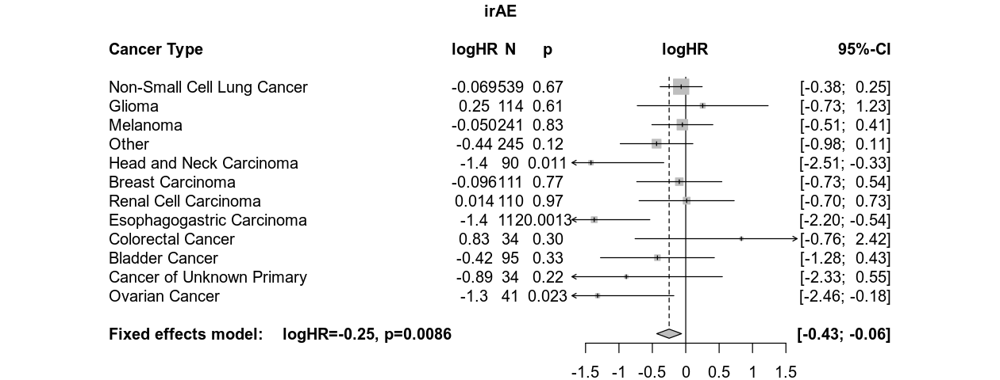

In [11]:
OS_temp <- OS %>% filter(before_2018==1,GWAS_avail)

attributes(OS_temp)$tname$idname <- "id"
attributes(OS_temp)$tname$tstartname <- "tstart"
attributes(OS_temp)$tname$tstopname <- "tstop"
attributes(OS_temp)$tevent <- "event"
attributes(OS_temp)$tcensor$event <- 0

temp <- merge(OS_temp,fread("adverse_events_truenegcorrected.csv",na.strings="") %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN"))
temp <- temp %>% mutate(irAE_time=ifelse(ADV_EVENT,as.numeric(difftime(ADV_EVENT_DT,IO_START,unit="days")),NA)) %>% select(MRN,ADV_EVENT,irAE_time)
OS_pred <- tmerge(OS_temp,temp,id=MRN,irAE=tdc(irAE_time,as.numeric(ADV_EVENT))) %>% mutate(irAE=replace_na(irAE,0))

options_before <- options()
options(repr.plot.width=10.5,repr.plot.height=4)
result_irAE <- meta_survival_onehot(c("irAE"),OS_pred)
options(options_before)

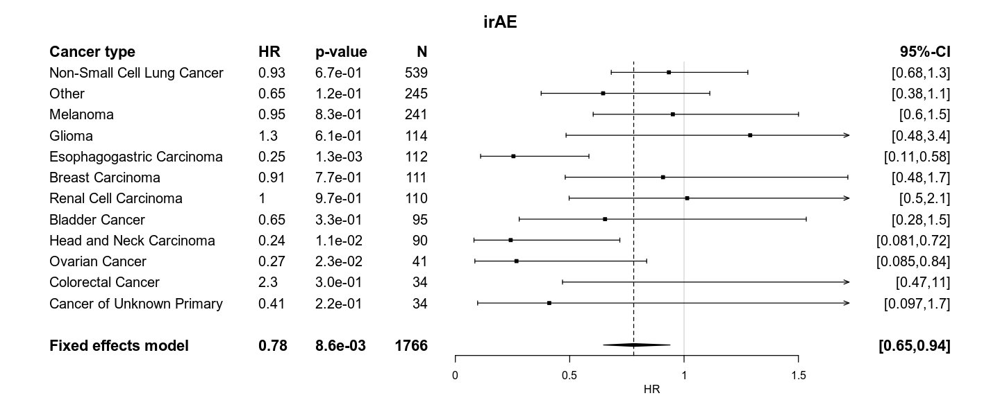

In [12]:
my_forest(result_irAE,"irAE","irAE")

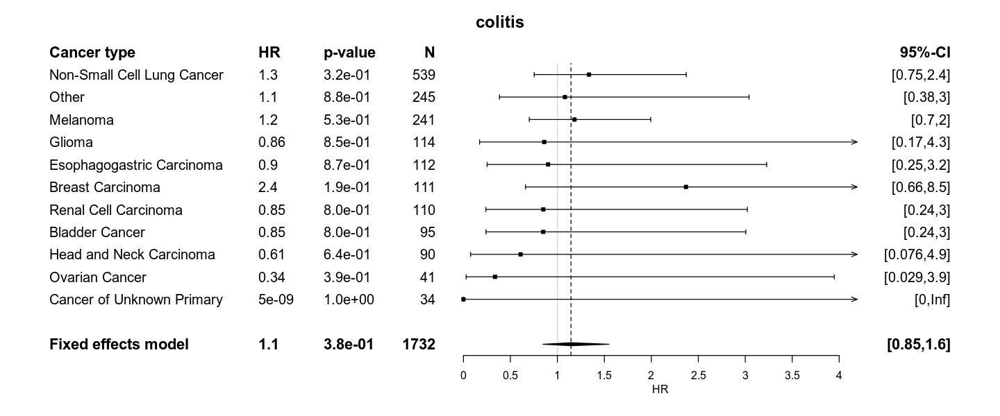

In [44]:
OS_temp <- OS %>% filter(before_2018==1,GWAS_avail)

attributes(OS_temp)$tname$idname <- "id"
attributes(OS_temp)$tname$tstartname <- "tstart"
attributes(OS_temp)$tname$tstopname <- "tstop"
attributes(OS_temp)$tevent <- "event"
attributes(OS_temp)$tcensor$event <- 0

temp <- merge(OS_temp,fread("adverse_events_truenegcorrected_type.csv",na.strings="") %>% filter(is.na(TYPE) | grepl("colitis",tolower(TYPE))) %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN"))
temp <- temp %>% mutate(irAE_time=ifelse(ADV_EVENT,as.numeric(difftime(ADV_EVENT_DT,IO_START,unit="days")),NA)) %>% select(MRN,ADV_EVENT,irAE_time)
OS_pred <- tmerge(OS_temp,temp,id=MRN,irAE=tdc(irAE_time,as.numeric(ADV_EVENT))) %>% mutate(irAE=replace_na(irAE,0))

options_before <- options()
options(repr.plot.width=10.5,repr.plot.height=4)
result_irAE <- meta_survival_onehot(c("irAE"),OS_pred,plot=F)
options(options_before)
my_forest(result_irAE,"irAE","colitis")

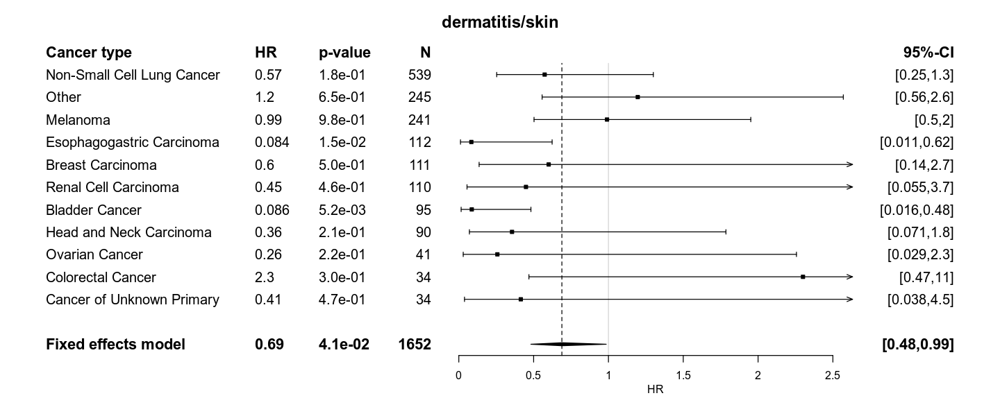

In [45]:
OS_temp <- OS %>% filter(before_2018==1,GWAS_avail)

attributes(OS_temp)$tname$idname <- "id"
attributes(OS_temp)$tname$tstartname <- "tstart"
attributes(OS_temp)$tname$tstopname <- "tstop"
attributes(OS_temp)$tevent <- "event"
attributes(OS_temp)$tcensor$event <- 0

temp <- merge(OS_temp,fread("adverse_events_truenegcorrected_type.csv",na.strings="") %>% filter(is.na(TYPE) | grepl("dermatitis",tolower(TYPE))) %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN"))
temp <- temp %>% mutate(irAE_time=ifelse(ADV_EVENT,as.numeric(difftime(ADV_EVENT_DT,IO_START,unit="days")),NA)) %>% select(MRN,ADV_EVENT,irAE_time)
OS_pred <- tmerge(OS_temp,temp,id=MRN,irAE=tdc(irAE_time,as.numeric(ADV_EVENT))) %>% mutate(irAE=replace_na(irAE,0))

options_before <- options()
options(repr.plot.width=10.5,repr.plot.height=4)
result_irAE <- meta_survival_onehot(c("irAE"),OS_pred,plot=F)
options(options_before)
my_forest(result_irAE,"irAE","dermatitis/skin")

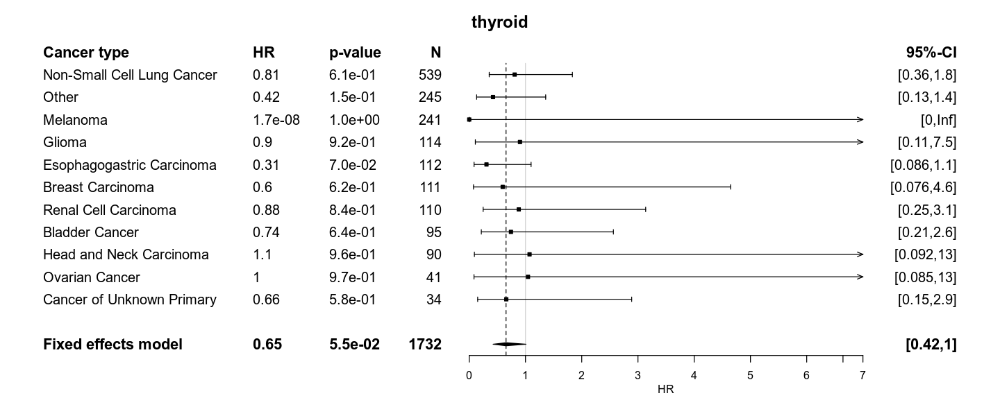

In [42]:
OS_temp <- OS %>% filter(before_2018==1,GWAS_avail)

attributes(OS_temp)$tname$idname <- "id"
attributes(OS_temp)$tname$tstartname <- "tstart"
attributes(OS_temp)$tname$tstopname <- "tstop"
attributes(OS_temp)$tevent <- "event"
attributes(OS_temp)$tcensor$event <- 0

temp <- merge(OS_temp,fread("adverse_events_truenegcorrected_type.csv",na.strings="") %>% filter(is.na(TYPE) | grepl("thyroid",tolower(TYPE))) %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN"))
temp <- temp %>% mutate(irAE_time=ifelse(ADV_EVENT,as.numeric(difftime(ADV_EVENT_DT,IO_START,unit="days")),NA)) %>% select(MRN,ADV_EVENT,irAE_time)
OS_pred <- tmerge(OS_temp,temp,id=MRN,irAE=tdc(irAE_time,as.numeric(ADV_EVENT))) %>% mutate(irAE=replace_na(irAE,0))

options_before <- options()
options(repr.plot.width=10.5,repr.plot.height=4)
result_irAE <- meta_survival_onehot(c("irAE"),OS_pred,plot=F)
options(options_before)
my_forest(result_irAE,"irAE","thyroid")

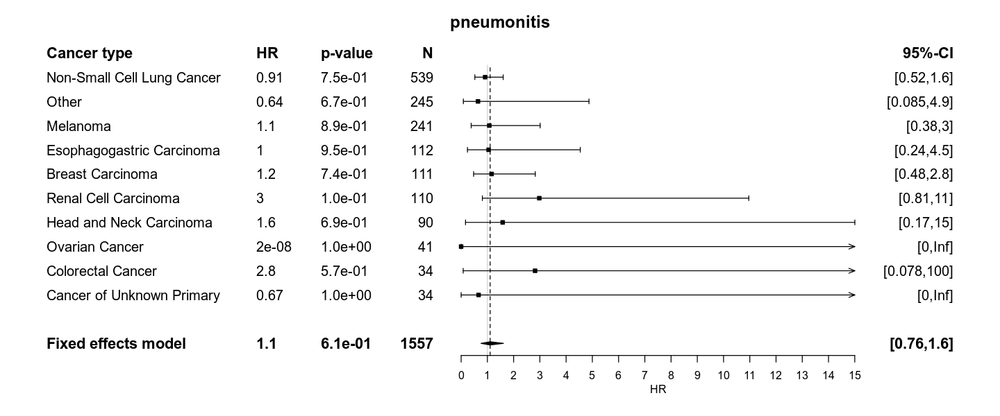

In [17]:
OS_temp <- OS %>% filter(before_2018==1,GWAS_avail)

attributes(OS_temp)$tname$idname <- "id"
attributes(OS_temp)$tname$tstartname <- "tstart"
attributes(OS_temp)$tname$tstopname <- "tstop"
attributes(OS_temp)$tevent <- "event"
attributes(OS_temp)$tcensor$event <- 0

temp <- merge(OS_temp,fread("adverse_events_truenegcorrected_type.csv",na.strings="") %>% filter(grepl("pneum",tolower(TYPE))) %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN"))
temp <- temp %>% mutate(irAE_time=ifelse(ADV_EVENT,as.numeric(difftime(ADV_EVENT_DT,IO_START,unit="days")),NA)) %>% select(MRN,ADV_EVENT,irAE_time)
OS_pred <- tmerge(OS_temp,temp,id=MRN,irAE=tdc(irAE_time,as.numeric(ADV_EVENT))) %>% mutate(irAE=replace_na(irAE,0))

options_before <- options()
options(repr.plot.width=10.5,repr.plot.height=4)
result_irAE <- meta_survival_onehot(c("irAE"),OS_pred,plot=F)
options(options_before)
my_forest(result_irAE,"irAE","pneumonitis")

NULL


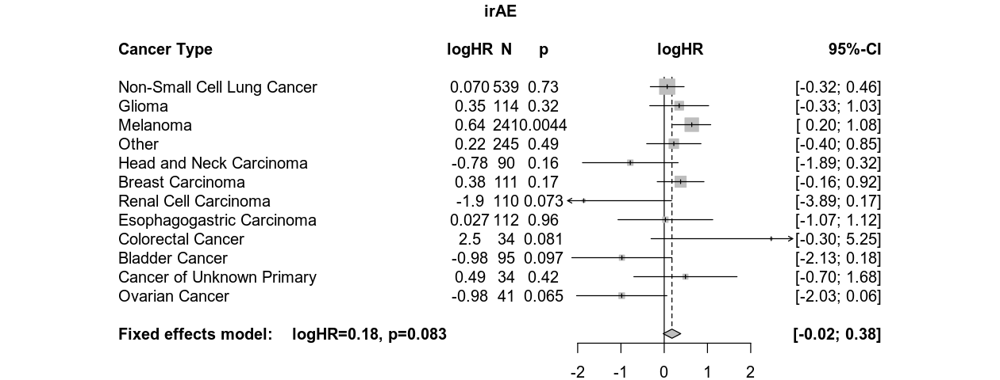

In [31]:
OS_temp <- OS %>% filter(before_2018==1,GWAS_avail)

attributes(OS_temp)$tname$idname <- "id"
attributes(OS_temp)$tname$tstartname <- "tstart"
attributes(OS_temp)$tname$tstopname <- "tstop"
attributes(OS_temp)$tevent <- "event"
attributes(OS_temp)$tcensor$event <- 0

temp <- merge(OS_temp,fread("curated_irAE_full.csv",na.strings="") %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN"))
temp <- temp %>% mutate(irAE_time=ifelse(ADV_EVENT,as.numeric(difftime(ADV_EVENT_DT,IO_START,unit="days")),NA)) %>% select(MRN,ADV_EVENT,irAE_time)
OS_pred <- tmerge(OS_temp,temp,id=MRN,irAE=tdc(irAE_time,as.numeric(ADV_EVENT))) %>% mutate(irAE=replace_na(irAE,0))

options_before <- options()
options(repr.plot.width=10.5,repr.plot.height=4)
result_irAE <- meta_survival_onehot(c("irAE"),OS_pred)
options(options_before)

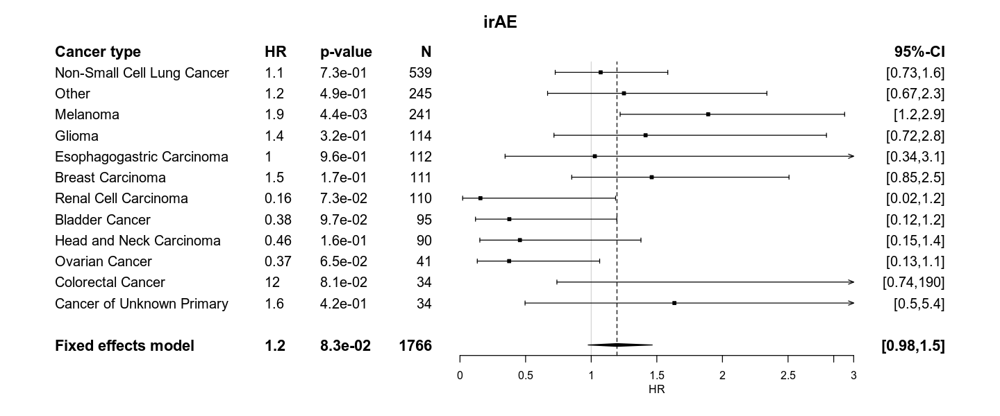

In [32]:
my_forest(result_irAE,"irAE","irAE")

In [159]:
OS_mult <- make_multistate(OS)
OS_mult_cur <- make_multistate_cur(OS)

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  463  1491      646           2600
  AE                0    0   258      277            535
  Death             0    0     0     1749           1749

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1780769 0.5734615 0.2484615
  AE        0.0000000 0.0000000 0.4822430 0.5177570
  Death     0.0000000 0.0000000 0.0000000 1.0000000



Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  222  1206      422           1850
  AE                0    0   169      107            276
  Death             0    0     0     1375           1375

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1200000 0.6518919 0.2281081
  AE        0.0000000 0.0000000 0.6123188 0.3876812
  Death     0.0000000 0.0000000 0.0000000 1.0000000



### Curated vs predicted


Attaching package: ‘purrr’

The following object is masked from ‘package:data.table’:

    transpose

The following objects are masked from ‘package:foreach’:

    accumulate, when

The following object is masked from ‘package:magrittr’:

    set_names



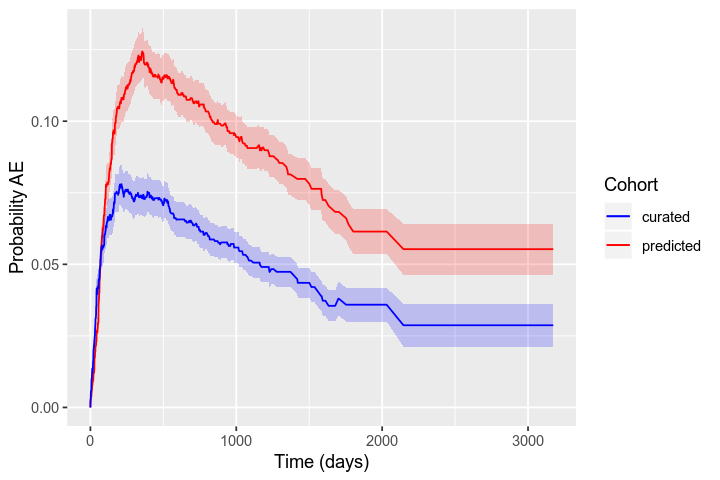

In [34]:
library(purrr)

tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))

prob_ae <- list()
OS_temp <- OS_mult %>% filter(before_2018==1,GWAS_avail)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = OS_temp, method = "breslow")
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["predicted"]] <- pt0
OS_temp <- OS_mult_cur %>% filter(before_2018==1)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = OS_temp, method = "breslow")
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["curated"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_predicted <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(aes(x=time,y=predicted_pstate2,color="predicted")) + geom_ribbon(aes(x=time,ymax=predicted_pstate2+predicted_se2,ymin=predicted_pstate2-predicted_se2),alpha=0.2,fill="red") + geom_line(data=temp %>% select(time,curated_pstate2) %>% drop_na,aes(x=time,y=curated_pstate2,color="curated"),na.rm=T) + geom_ribbon(data=temp %>% select(time,curated_pstate2,curated_se2) %>% drop_na,aes(x=time,ymax=curated_pstate2+curated_se2,ymin=curated_pstate2-curated_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "Cohort", values=c("predicted"="red","curated"="blue")) + labs(y="Probability AE",x="Time (days)")
options(options_predicted)

### Gender

NULL
NULL
NULL


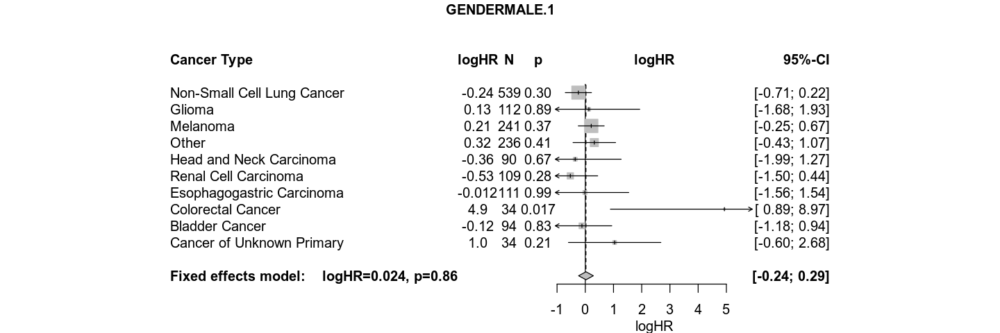

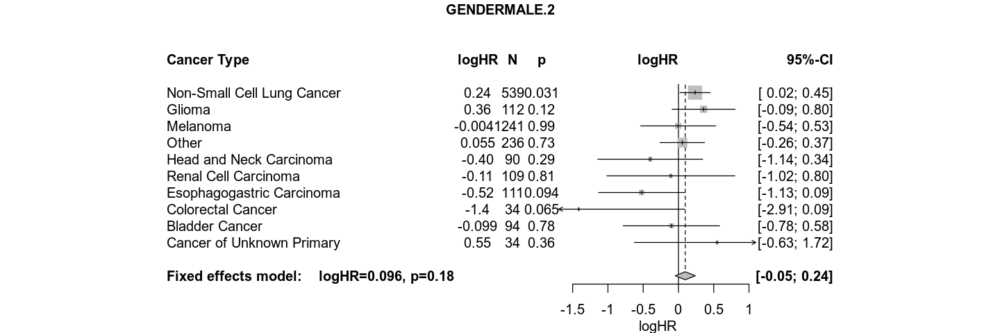

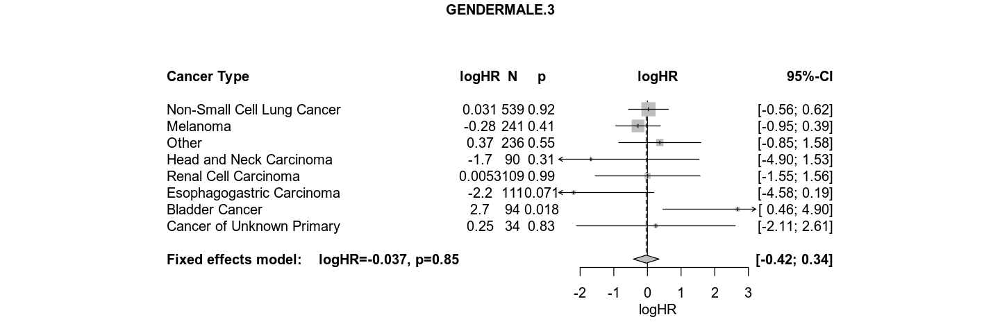

In [87]:
options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
treatment_pred <- meta_survival_AE(c("GENDERMALE"),transition="1|2|3",OS_mult %>% filter(before_2018==1,GWAS_avail))
options(options_before)

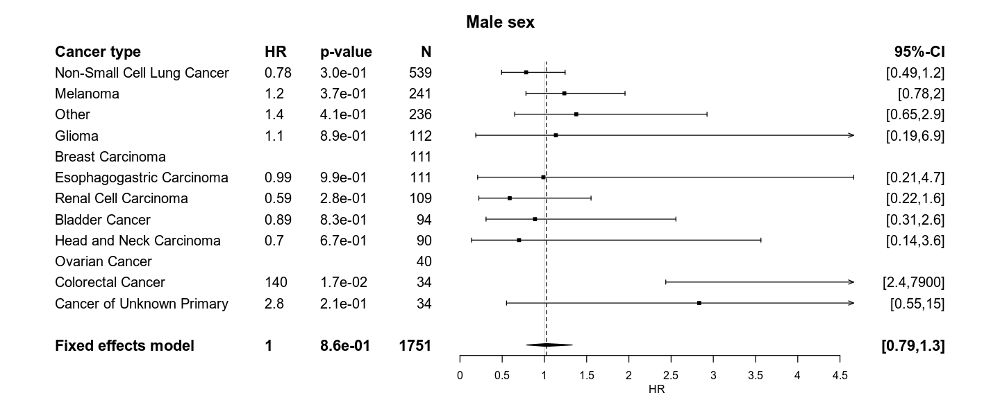

In [18]:
my_forest(treatment_pred,"GENDERMALE.1","Male sex")

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


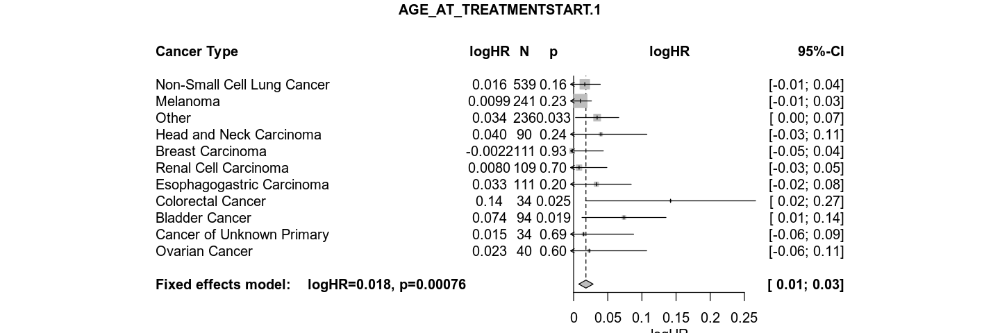

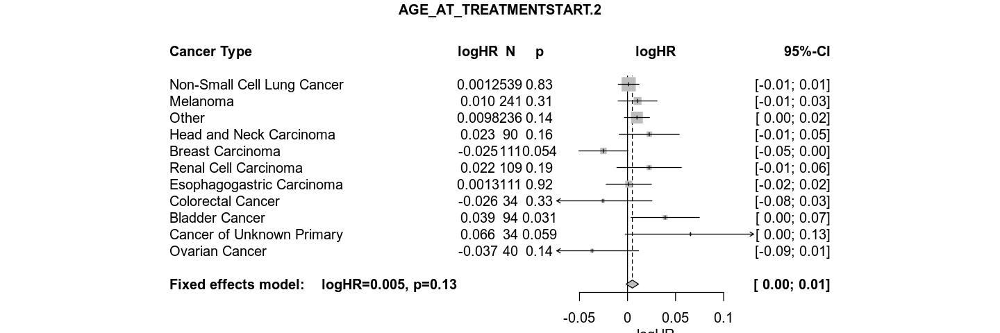

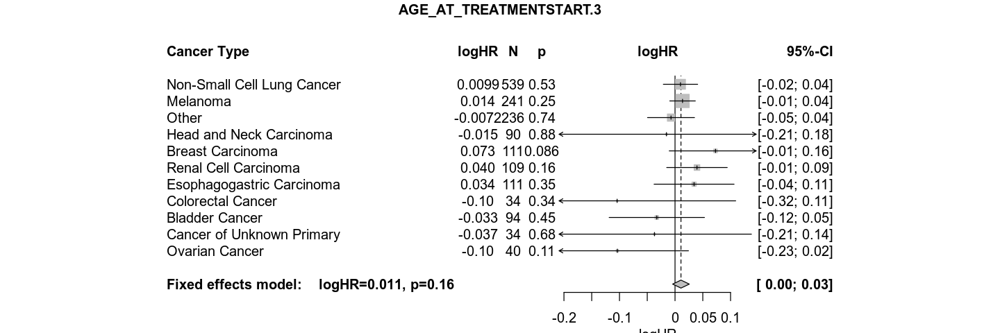

In [88]:
options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
treatment_pred <- meta_survival_AE(c("AGE_AT_TREATMENTSTART"),transition="1|2|3",OS_mult %>% filter(before_2018==1,GWAS_avail))
options(options_before)

### Treatment association

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"


Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

NULL
NULL
NULL


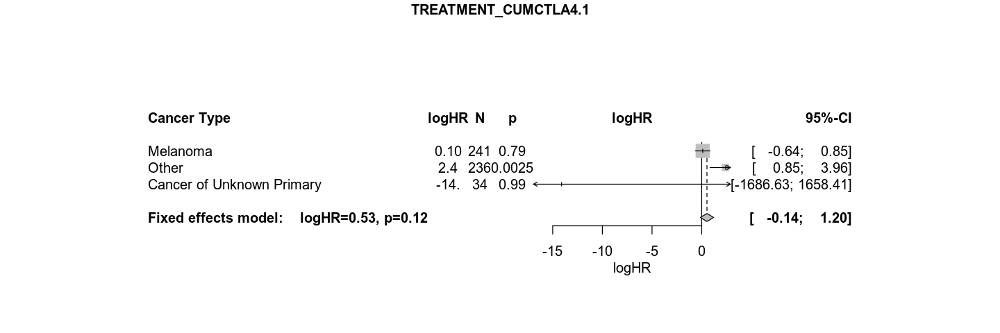

NULL


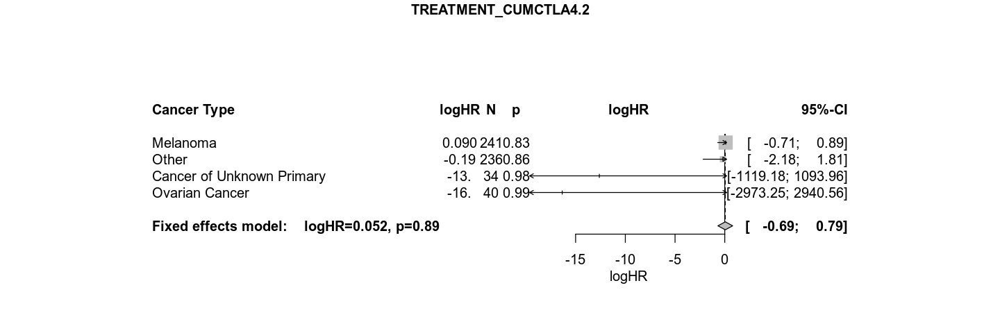

NULL


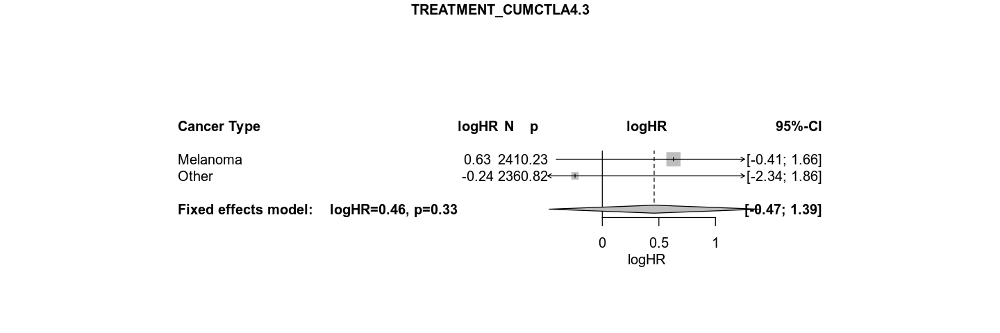

NULL


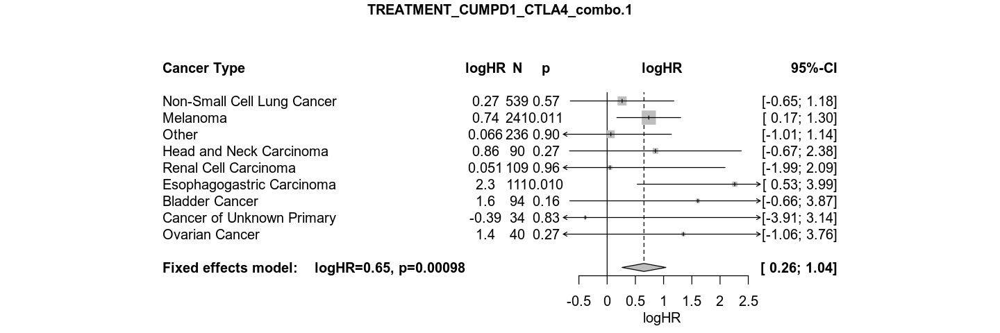

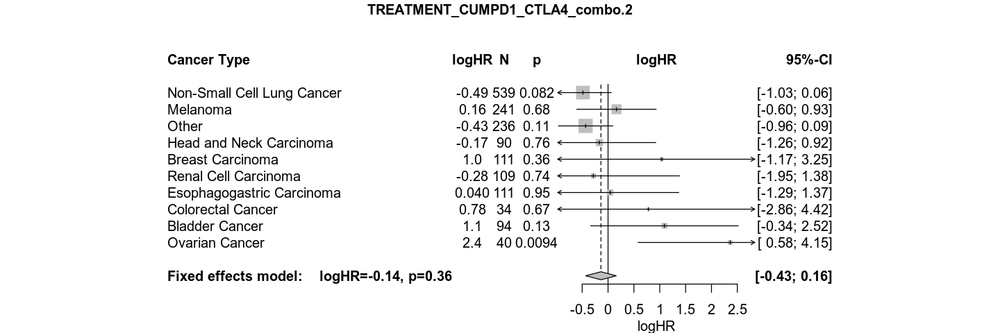

NULL
NULL


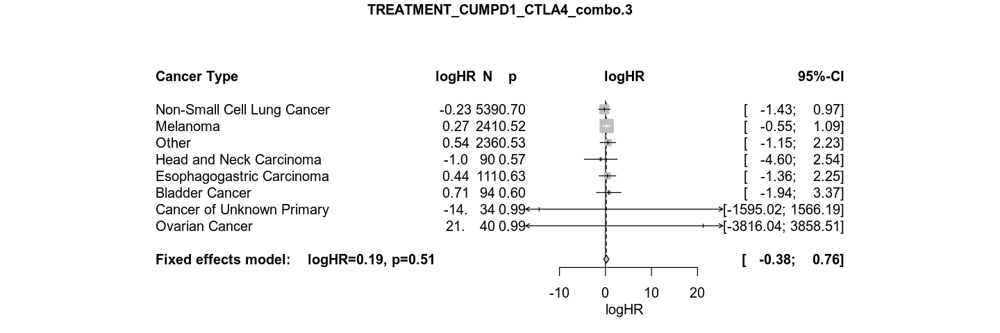

NULL


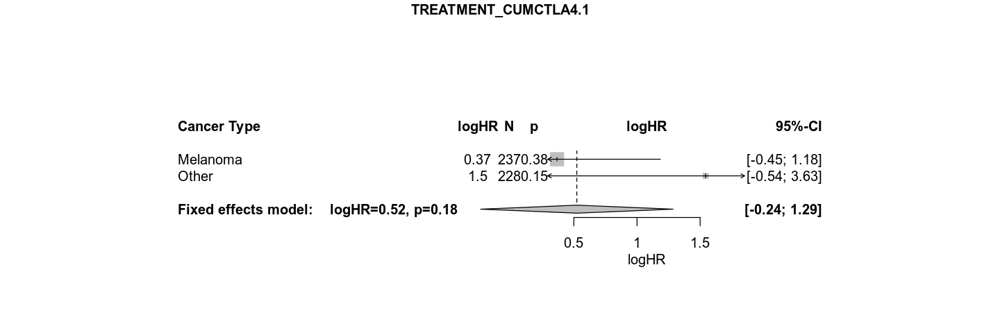

NULL


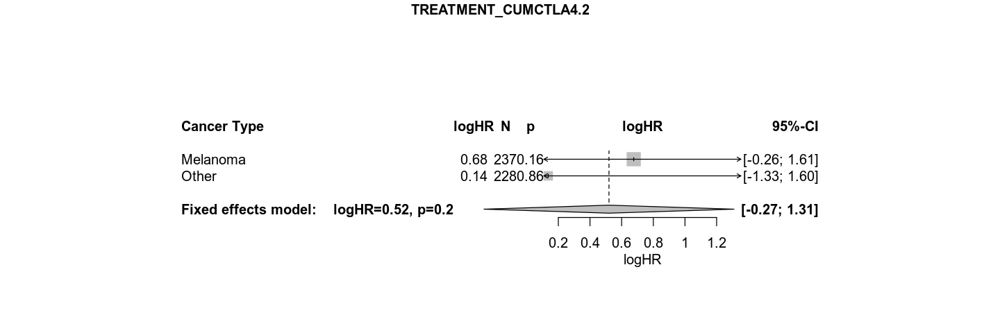

NULL


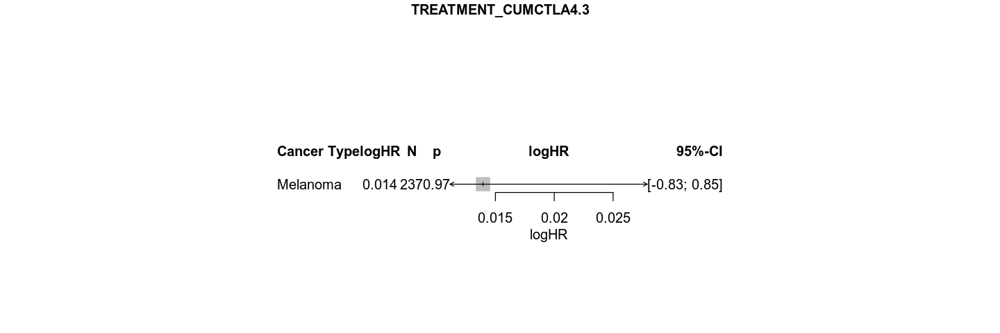

NULL


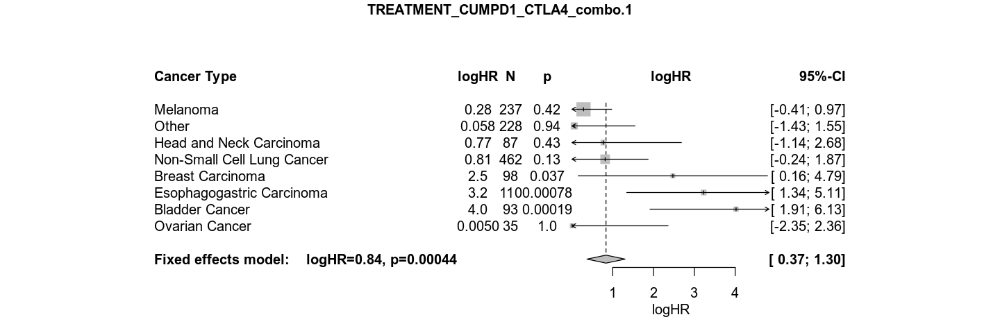

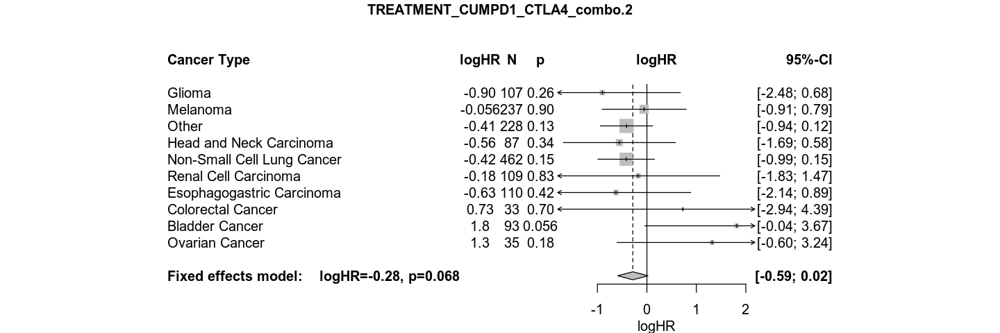

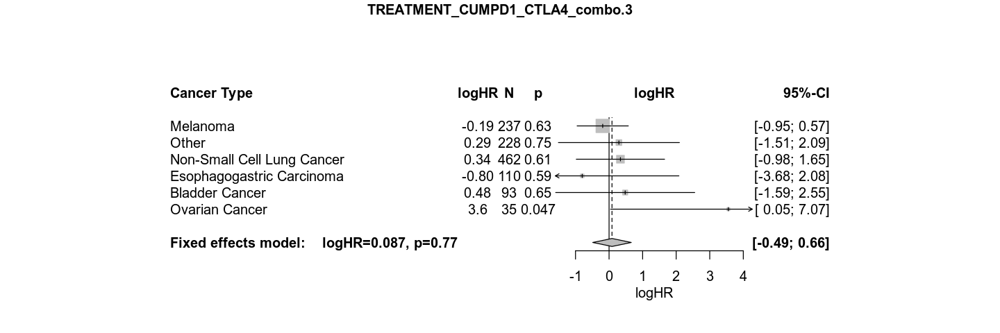

In [35]:
options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
treatment_pred <- meta_survival_AE(c("TREATMENT_CUMPD1_CTLA4_combo","TREATMENT_CUMCTLA4"),transition="1|2|3",OS_mult %>% filter(before_2018==1,GWAS_avail))
options(options_before)

options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
treatment_cur <- meta_survival_AE(c("TREATMENT_CUMPD1_CTLA4_combo","TREATMENT_CUMCTLA4"),transition="1|2|3",OS_mult_cur %>% filter(before_2018==1,GWAS_avail))
options(options_before)

Warning message in if (is.na(xlim)) {:
“the condition has length > 1 and only the first element will be used”Warning message in if (is.na(xlim)) {:
“the condition has length > 1 and only the first element will be used”

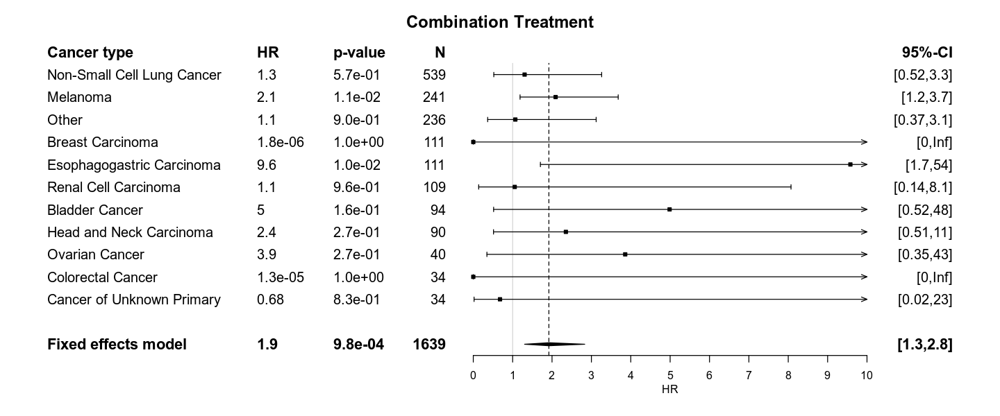

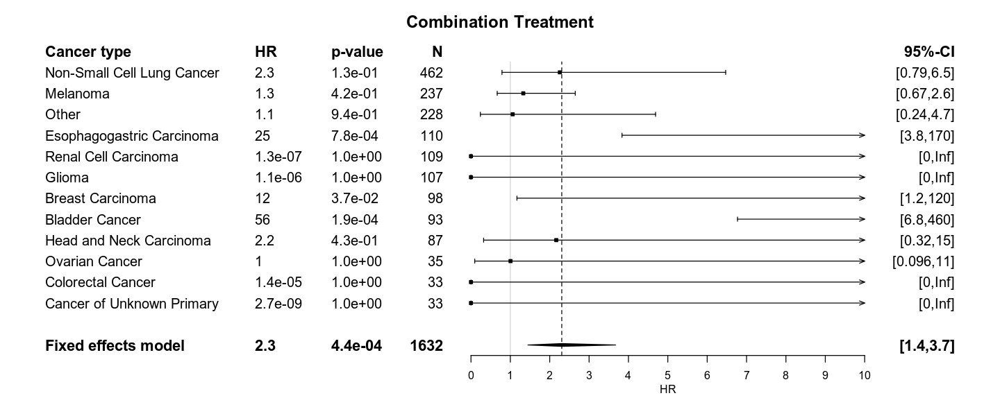

In [36]:
my_forest(treatment_pred,"TREATMENT_CUMPD1_CTLA4_combo.1","Combination Treatment",xlim=c(0,10))
my_forest(treatment_cur,"TREATMENT_CUMPD1_CTLA4_combo.1","Combination Treatment",xlim=c(0,10))

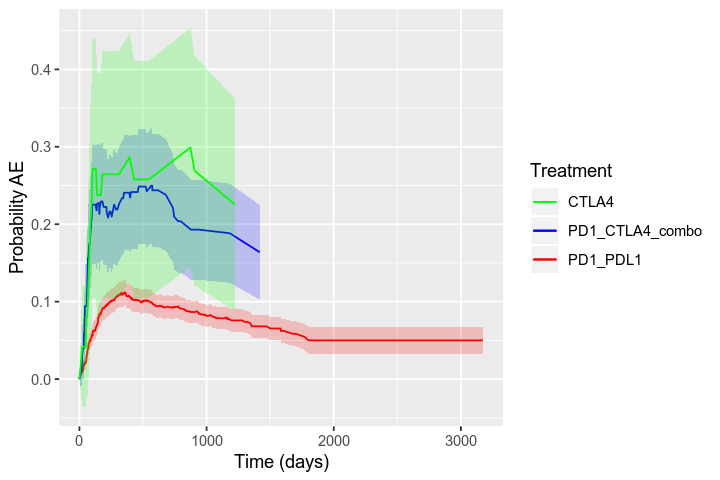

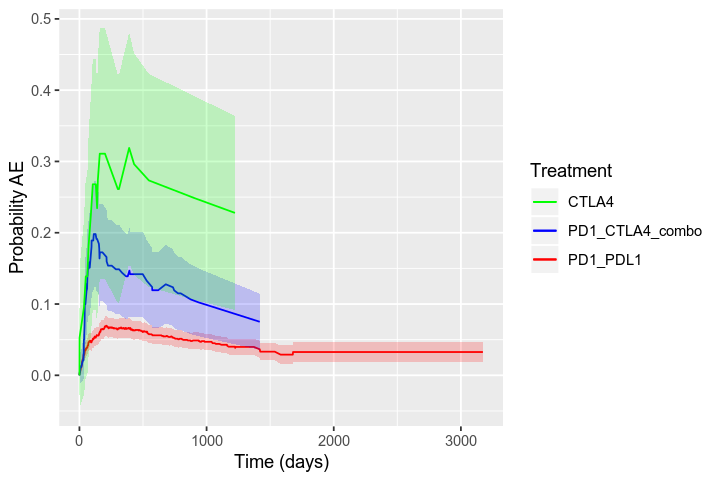

In [132]:
library(purrr)

OS_temp <- OS_mult %>% filter(before_2018==1,GWAS_avail)
prob_ae <- list()
for (l in levels(OS_temp$TREATMENT_CUM)) {
    temp <- OS_temp %>% filter(TREATMENT_CUM==l)
    c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
    tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
    msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
    pt0 <- probtrans(msf0,predt=0)
    prob_ae[[l]] <- pt0
}
temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(aes(x=time,y=PD1_PDL1_pstate2,color="PD1_PDL1")) + geom_ribbon(aes(x=time,ymax=PD1_PDL1_pstate2+qnorm(0.975)*PD1_PDL1_se2,ymin=PD1_PDL1_pstate2-qnorm(0.975)*PD1_PDL1_se2),alpha=0.2,fill="red") + geom_line(data=temp %>% select(time,PD1_CTLA4_combo_pstate2) %>% drop_na,aes(x=time,y=PD1_CTLA4_combo_pstate2,color="PD1_CTLA4_combo"),na.rm=T) + geom_ribbon(data=temp %>% select(time,PD1_CTLA4_combo_pstate2,PD1_CTLA4_combo_se2) %>% drop_na,aes(x=time,ymax=PD1_CTLA4_combo_pstate2+qnorm(0.975)*PD1_CTLA4_combo_se2,ymin=PD1_CTLA4_combo_pstate2-qnorm(0.975)*PD1_CTLA4_combo_se2),alpha=0.2,fill="blue") + geom_line(data=temp %>% select(time,CTLA4_pstate2) %>% drop_na,aes(x=time,y=CTLA4_pstate2,color="CTLA4"),na.rm=T) + geom_ribbon(data=temp %>% select(time,CTLA4_pstate2,CTLA4_se2) %>% drop_na,aes(x=time,ymax=CTLA4_pstate2+qnorm(0.975)*CTLA4_se2,ymin=CTLA4_pstate2-qnorm(0.975)*CTLA4_se2),alpha=0.2,fill="green") + scale_color_manual(name = "Treatment", values=c("PD1_PDL1"="red","PD1_CTLA4_combo"="blue","CTLA4"="green","other_io"="orange")) + labs(y="Probability AE",x="Time (days)")
options(options_before)

library(purrr)

OS_temp <- OS_mult_cur %>% filter(before_2018==1,GWAS_avail)
prob_ae <- list()
for (l in levels(OS_temp$TREATMENT_CUM)) {
    tempdf <- OS_temp %>% filter(TREATMENT_CUM==l)
    c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = tempdf, method = "breslow")
    tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
    msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
    pt0 <- probtrans(msf0,predt=0)
    prob_ae[[l]] <- pt0
}
temp1 <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp1[[names(prob_ae)[i]]] <- ttemp
    
}
temp1 <- temp1 %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp1) + geom_line(aes(x=time,y=PD1_PDL1_pstate2,color="PD1_PDL1")) + geom_ribbon(aes(x=time,ymax=PD1_PDL1_pstate2+qnorm(0.975)*PD1_PDL1_se2,ymin=PD1_PDL1_pstate2-qnorm(0.975)*PD1_PDL1_se2),alpha=0.2,fill="red") + geom_line(data=temp1 %>% select(time,PD1_CTLA4_combo_pstate2) %>% drop_na,aes(x=time,y=PD1_CTLA4_combo_pstate2,color="PD1_CTLA4_combo"),na.rm=T) + geom_ribbon(data=temp1 %>% select(time,PD1_CTLA4_combo_pstate2,PD1_CTLA4_combo_se2) %>% drop_na,aes(x=time,ymax=PD1_CTLA4_combo_pstate2+qnorm(0.975)*PD1_CTLA4_combo_se2,ymin=PD1_CTLA4_combo_pstate2-qnorm(0.975)*PD1_CTLA4_combo_se2),alpha=0.2,fill="blue") + geom_line(data=temp1 %>% select(time,CTLA4_pstate2) %>% drop_na,aes(x=time,y=CTLA4_pstate2,color="CTLA4"),na.rm=T) + geom_ribbon(data=temp1 %>% select(time,CTLA4_pstate2,CTLA4_se2) %>% drop_na,aes(x=time,ymax=CTLA4_pstate2+qnorm(0.975)*CTLA4_se2,ymin=CTLA4_pstate2-qnorm(0.975)*CTLA4_se2),alpha=0.2,fill="green") + scale_color_manual(name = "Treatment", values=c("PD1_PDL1"="red","PD1_CTLA4_combo"="blue","CTLA4"="green","other_io"="orange")) + labs(y="Probability AE",x="Time (days)")
options(options_before)

In [211]:
levels(OS_mult$TREATMENT_CUM_FINE)

[1] "PD1"             "CTLA4"           "PD1_CTLA4_combo" "PDL1"

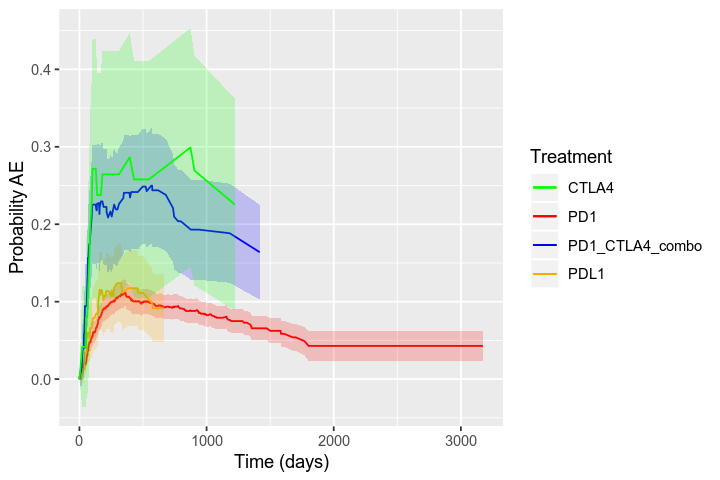

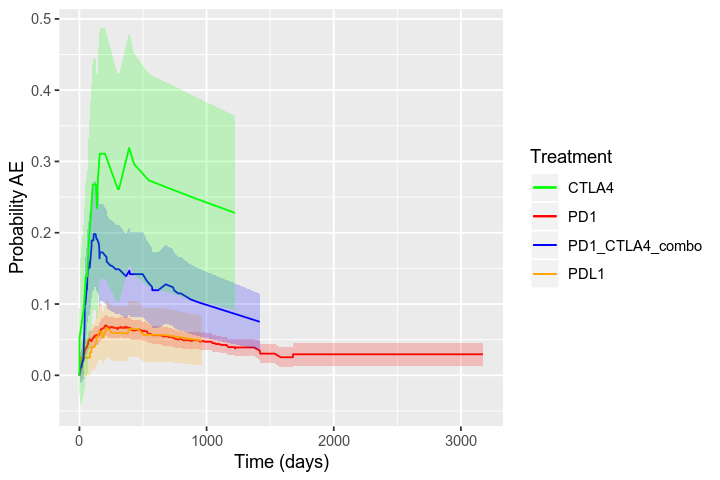

In [164]:
library(purrr)

OS_temp <- OS_mult %>% filter(before_2018==1,GWAS_avail)
prob_ae <- list()
for (l in levels(OS_temp$TREATMENT_FINE)) {
    temp <- OS_temp %>% filter(TREATMENT_FINE==l)
    c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
    tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
    msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
    pt0 <- probtrans(msf0,predt=0)
    prob_ae[[l]] <- pt0
}
temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(aes(x=time,y=PD1_pstate2,color="PD1")) + geom_ribbon(aes(x=time,ymax=PD1_pstate2+qnorm(0.975)*PD1_se2,ymin=PD1_pstate2-qnorm(0.975)*PD1_se2),alpha=0.2,fill="red") + geom_line(data=temp %>% select(time,PDL1_pstate2) %>% drop_na,aes(x=time,y=PDL1_pstate2,color="PDL1")) + geom_ribbon(data=temp %>% select(time,PDL1_pstate2,PDL1_se2) %>% drop_na,aes(x=time,ymax=PDL1_pstate2+qnorm(0.975)*PDL1_se2,ymin=PDL1_pstate2-qnorm(0.975)*PDL1_se2),alpha=0.2,fill="orange") + geom_line(data=temp %>% select(time,PD1_CTLA4_combo_pstate2) %>% drop_na,aes(x=time,y=PD1_CTLA4_combo_pstate2,color="PD1_CTLA4_combo"),na.rm=T) + geom_ribbon(data=temp %>% select(time,PD1_CTLA4_combo_pstate2,PD1_CTLA4_combo_se2) %>% drop_na,aes(x=time,ymax=PD1_CTLA4_combo_pstate2+qnorm(0.975)*PD1_CTLA4_combo_se2,ymin=PD1_CTLA4_combo_pstate2-qnorm(0.975)*PD1_CTLA4_combo_se2),alpha=0.2,fill="blue") + geom_line(data=temp %>% select(time,CTLA4_pstate2) %>% drop_na,aes(x=time,y=CTLA4_pstate2,color="CTLA4"),na.rm=T) + geom_ribbon(data=temp %>% select(time,CTLA4_pstate2,CTLA4_se2) %>% drop_na,aes(x=time,ymax=CTLA4_pstate2+qnorm(0.975)*CTLA4_se2,ymin=CTLA4_pstate2-qnorm(0.975)*CTLA4_se2),alpha=0.2,fill="green") + scale_color_manual(name = "Treatment", values=c("PD1"="red","PDL1"="orange","PD1_CTLA4_combo"="blue","CTLA4"="green","other_io"="orange")) + labs(y="Probability AE",x="Time (days)")
options(options_before)

library(purrr)

OS_temp <- OS_mult_cur %>% filter(before_2018==1,GWAS_avail)
prob_ae <- list()
for (l in levels(OS_temp$TREATMENT_FINE)) {
    tempdf <- OS_temp %>% filter(TREATMENT_FINE==l)
    c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = tempdf, method = "breslow")
    tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
    msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
    pt0 <- probtrans(msf0,predt=0)
    prob_ae[[l]] <- pt0
}
temp1 <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp1[[names(prob_ae)[i]]] <- ttemp
    
}
temp1 <- temp1 %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp1) + geom_line(aes(x=time,y=PD1_pstate2,color="PD1")) + geom_ribbon(aes(x=time,ymax=PD1_pstate2+qnorm(0.975)*PD1_se2,ymin=PD1_pstate2-qnorm(0.975)*PD1_se2),alpha=0.2,fill="red") + geom_line(data=temp1 %>% select(time,PDL1_pstate2) %>% drop_na,aes(x=time,y=PDL1_pstate2,color="PDL1")) + geom_ribbon(data=temp1 %>% select(time,PDL1_pstate2,PDL1_se2) %>% drop_na,aes(x=time,ymax=PDL1_pstate2+qnorm(0.975)*PDL1_se2,ymin=PDL1_pstate2-qnorm(0.975)*PDL1_se2),alpha=0.2,fill="orange") + geom_line(data=temp1 %>% select(time,PD1_CTLA4_combo_pstate2) %>% drop_na,aes(x=time,y=PD1_CTLA4_combo_pstate2,color="PD1_CTLA4_combo"),na.rm=T) + geom_ribbon(data=temp1 %>% select(time,PD1_CTLA4_combo_pstate2,PD1_CTLA4_combo_se2) %>% drop_na,aes(x=time,ymax=PD1_CTLA4_combo_pstate2+qnorm(0.975)*PD1_CTLA4_combo_se2,ymin=PD1_CTLA4_combo_pstate2-qnorm(0.975)*PD1_CTLA4_combo_se2),alpha=0.2,fill="blue") + geom_line(data=temp1 %>% select(time,CTLA4_pstate2) %>% drop_na,aes(x=time,y=CTLA4_pstate2,color="CTLA4"),na.rm=T) + geom_ribbon(data=temp1 %>% select(time,CTLA4_pstate2,CTLA4_se2) %>% drop_na,aes(x=time,ymax=CTLA4_pstate2+qnorm(0.975)*CTLA4_se2,ymin=CTLA4_pstate2-qnorm(0.975)*CTLA4_se2),alpha=0.2,fill="green") + scale_color_manual(name = "Treatment", values=c("PD1"="red","PDL1"="orange","PD1_CTLA4_combo"="blue","CTLA4"="green","other_io"="orange")) + labs(y="Probability AE",x="Time (days)")
options(options_before)

Warning message:
“Removed 14 rows containing missing values (geom_path).”Warning message:
“Removed 14 rows containing missing values (geom_path).”Warning message:
“Removed 13 rows containing missing values (geom_path).”

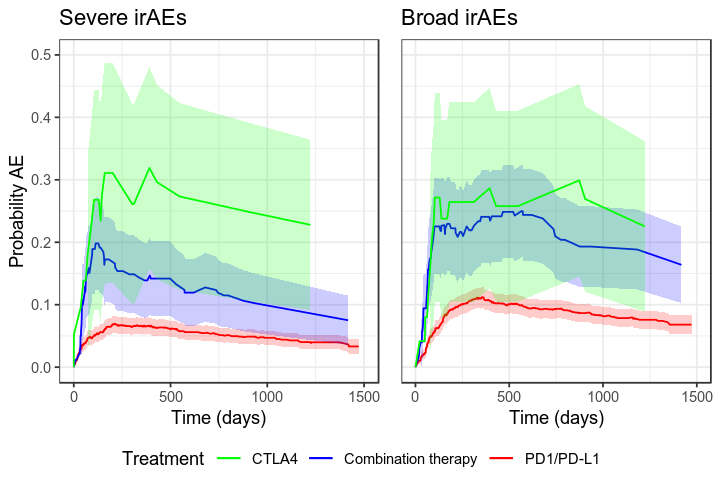

In [49]:
g_legend<-function(a.gplot){
  tmp <- ggplot_gtable(ggplot_build(a.gplot))
  leg <- which(sapply(tmp$grobs, function(x) x$name) == "guide-box")
  legend <- tmp$grobs[[leg]]
  return(legend)}

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
# g1 <- ggplot() + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF")) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs7011565", values=c("REF"="red","ALT"="blue")) + labs(x="Time (days)",y=NULL) + xlim(0,2500) + ylim(0,0.2) + theme_bw() + theme(legend.position="none",axis.text.y = element_blank(),axis.ticks.y = element_blank()) + ggtitle("Chemo")
# g2 <- ggplot() + geom_line(data=temp1[!is.na(temp1[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF")) + geom_ribbon(data=temp1[!is.na(temp1[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="red") + geom_line(data=temp1[!is.na(temp1[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT"),na.rm=T) + geom_ribbon(data=temp1[!is.na(temp1[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs7011565", values=c("REF"="red","ALT"="blue")) + labs(x="Time (days)",y="Probability AE") + xlim(0,2500) + ylim(0,0.2) + theme_bw() + theme(axis.title.x = element_text()) + theme(legend.position="bottom") + ggtitle("ICI")
g1 <- ggplot(temp) + geom_line(aes(x=time,y=PD1_PDL1_pstate2,color="PD1_PDL1")) + geom_ribbon(aes(x=time,ymax=PD1_PDL1_pstate2+qnorm(0.975)*PD1_PDL1_se2,ymin=PD1_PDL1_pstate2-qnorm(0.975)*PD1_PDL1_se2),alpha=0.2,fill="red") + geom_line(data=temp %>% select(time,PD1_CTLA4_combo_pstate2) %>% drop_na,aes(x=time,y=PD1_CTLA4_combo_pstate2,color="PD1_CTLA4_combo"),na.rm=T) + geom_ribbon(data=temp %>% select(time,PD1_CTLA4_combo_pstate2,PD1_CTLA4_combo_se2) %>% drop_na,aes(x=time,ymax=PD1_CTLA4_combo_pstate2+qnorm(0.975)*PD1_CTLA4_combo_se2,ymin=PD1_CTLA4_combo_pstate2-qnorm(0.975)*PD1_CTLA4_combo_se2),alpha=0.2,fill="blue") + geom_line(data=temp %>% select(time,CTLA4_pstate2) %>% drop_na,aes(x=time,y=CTLA4_pstate2,color="CTLA4"),na.rm=T) + geom_ribbon(data=temp %>% select(time,CTLA4_pstate2,CTLA4_se2) %>% drop_na,aes(x=time,ymax=CTLA4_pstate2+qnorm(0.975)*CTLA4_se2,ymin=CTLA4_pstate2-qnorm(0.975)*CTLA4_se2),alpha=0.2,fill="green") + scale_color_manual(name = "Treatment", values=c("PD1_PDL1"="red","PD1_CTLA4_combo"="blue","CTLA4"="green","other_io"="orange")) + labs(y=NULL,x="Time (days)")+ xlim(0,1500) + ylim(0,0.5) + theme_bw() + theme(legend.position="none",axis.text.y = element_blank(),axis.ticks.y = element_blank()) + ggtitle("Broad irAEs")
g2 <- ggplot(temp1) + geom_line(aes(x=time,y=PD1_PDL1_pstate2,color="PD1_PDL1")) + geom_ribbon(aes(x=time,ymax=PD1_PDL1_pstate2+qnorm(0.975)*PD1_PDL1_se2,ymin=PD1_PDL1_pstate2-qnorm(0.975)*PD1_PDL1_se2),alpha=0.2,fill="red") + geom_line(data=temp1 %>% select(time,PD1_CTLA4_combo_pstate2) %>% drop_na,aes(x=time,y=PD1_CTLA4_combo_pstate2,color="PD1_CTLA4_combo"),na.rm=T) + geom_ribbon(data=temp1 %>% select(time,PD1_CTLA4_combo_pstate2,PD1_CTLA4_combo_se2) %>% drop_na,aes(x=time,ymax=PD1_CTLA4_combo_pstate2+qnorm(0.975)*PD1_CTLA4_combo_se2,ymin=PD1_CTLA4_combo_pstate2-qnorm(0.975)*PD1_CTLA4_combo_se2),alpha=0.2,fill="blue") + geom_line(data=temp1 %>% select(time,CTLA4_pstate2) %>% drop_na,aes(x=time,y=CTLA4_pstate2,color="CTLA4"),na.rm=T) + geom_ribbon(data=temp1 %>% select(time,CTLA4_pstate2,CTLA4_se2) %>% drop_na,aes(x=time,ymax=CTLA4_pstate2+qnorm(0.975)*CTLA4_se2,ymin=CTLA4_pstate2-qnorm(0.975)*CTLA4_se2),alpha=0.2,fill="green") + scale_color_manual(name = "Treatment", values=c("PD1_PDL1"="red","PD1_CTLA4_combo"="blue","CTLA4"="green","other_io"="orange"),labels = c("CTLA4", "Combination therapy","PD1/PD-L1")) + labs(y="Probability AE",x="Time (days)",color="Treatment type") + xlim(0,1500) + ylim(0,0.5) + theme_bw() + theme(axis.title.x = element_text()) + theme(legend.position="bottom") + ggtitle("Severe irAEs") 

                      
leg <- g_legend(g2)
                      
grid.arrange(arrangeGrob(g2 + theme(legend.position="none"), g1, nrow=1, widths = c(7,6)),leg,nrow=2,heights=c(10, 1))

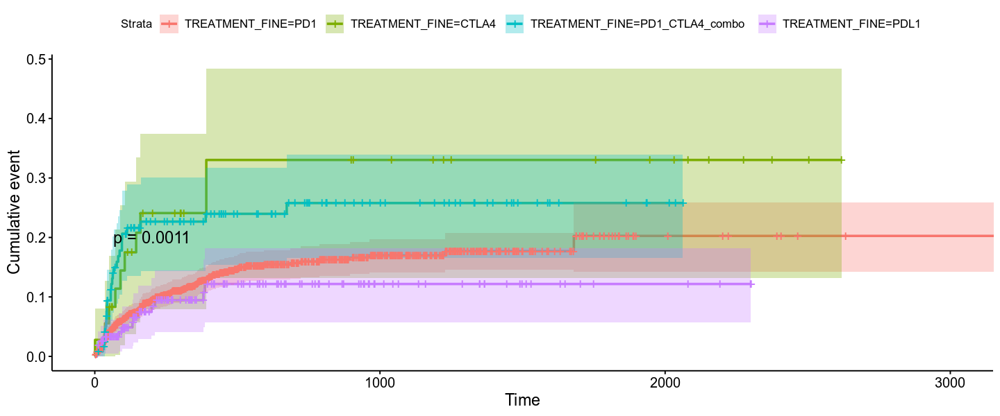

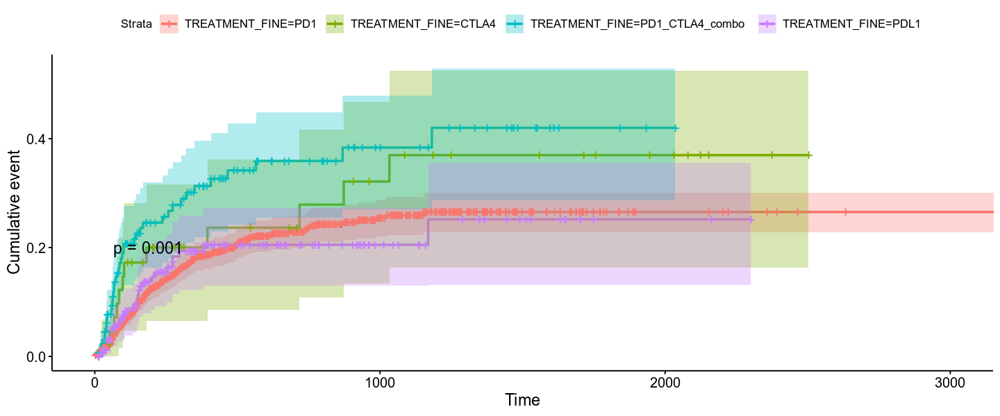

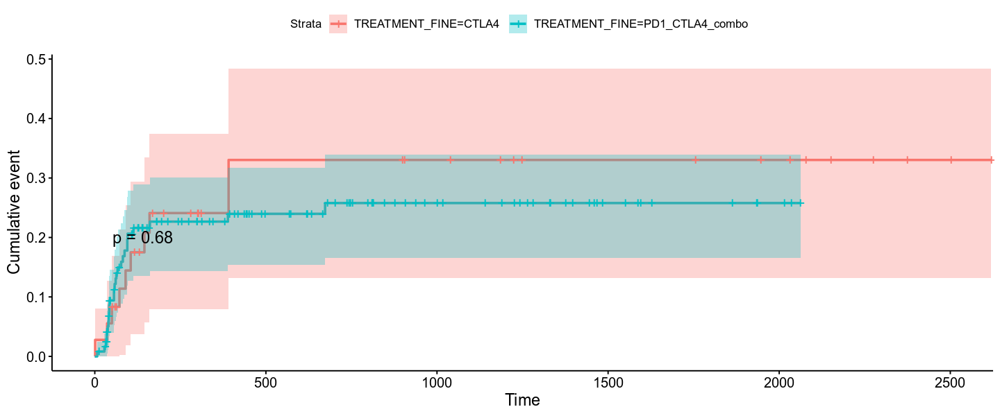

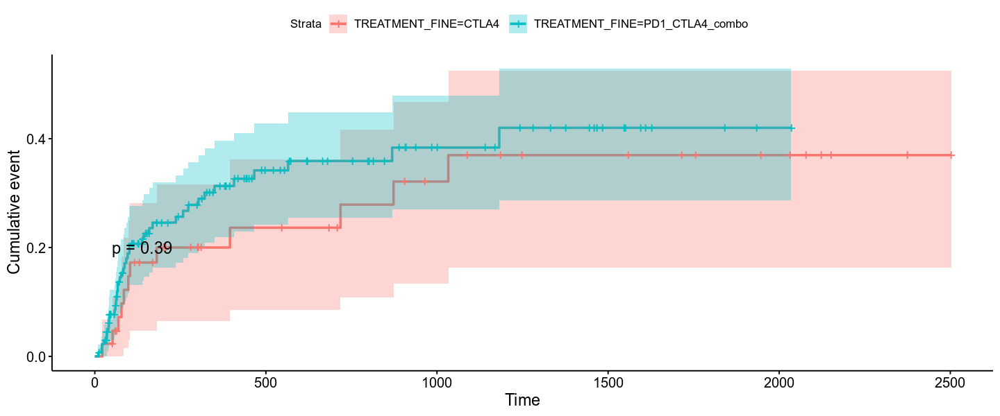

In [166]:
temp <- OS_mult_cur %>% filter(before_2018==1,GWAS_avail) %>% filter(trans==1)
fit <- survfit(Surv(Tstop,status) ~ TREATMENT_FINE, temp)
ggsurvplot(fit,conf.int = T,pval = T, fun = "event")

temp <- OS_mult %>% filter(before_2018==1,GWAS_avail) %>% filter(trans==1)
fit <- survfit(Surv(Tstop,status) ~ TREATMENT_FINE, temp)
ggsurvplot(fit,conf.int = T,pval = T, fun = "event")

temp <- OS_mult_cur %>% filter(before_2018==1,GWAS_avail) %>% filter(trans==1) %>% filter(TREATMENT_CUM!="PD1_PDL1")
fit <- survfit(Surv(Tstop,status) ~ TREATMENT_FINE, temp)
ggsurvplot(fit,conf.int = T,pval = T, fun = "event")

temp <- OS_mult %>% filter(before_2018==1,GWAS_avail) %>% filter(trans==1) %>% filter(TREATMENT_CUM!="PD1_PDL1")
fit <- survfit(Surv(Tstop,status) ~ TREATMENT_FINE, temp)
ggsurvplot(fit,conf.int = T,pval = T, fun = "event")

# Association of Ancestry

NULL
NULL
NULL


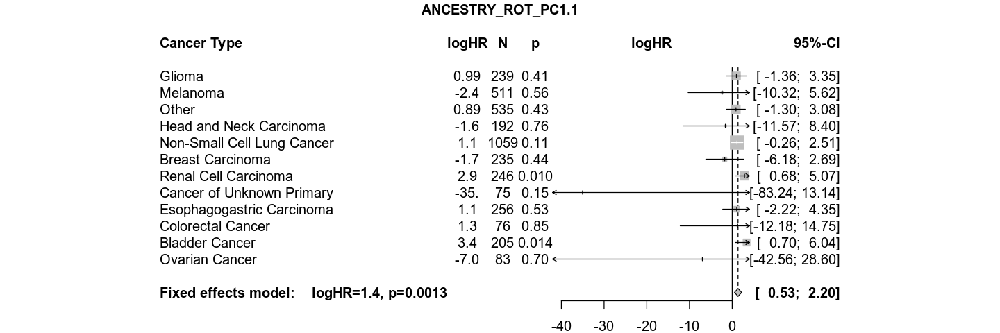

NULL


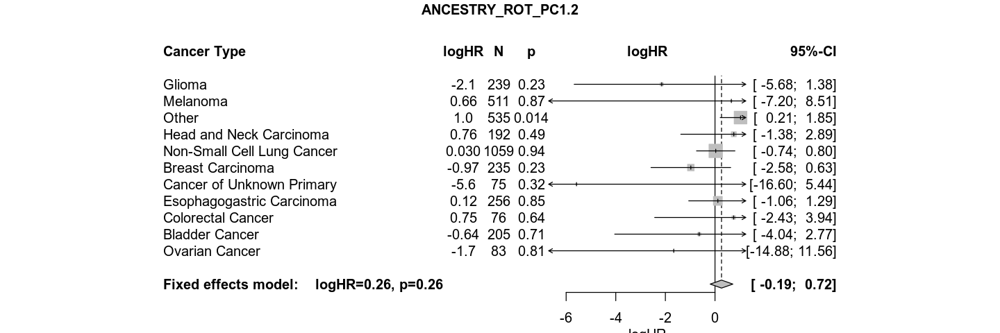

NULL


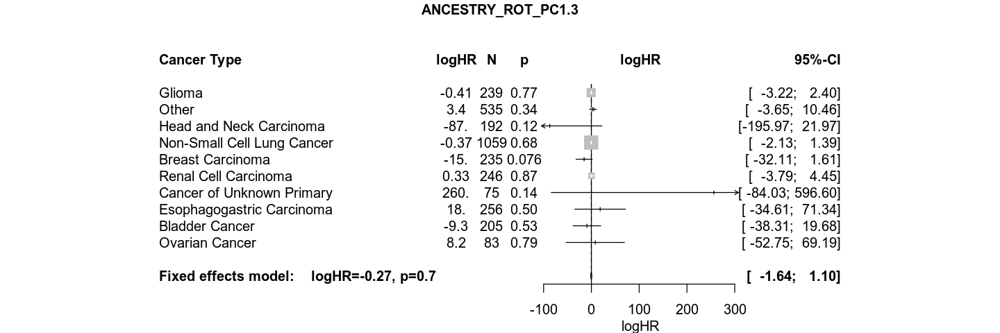

NULL


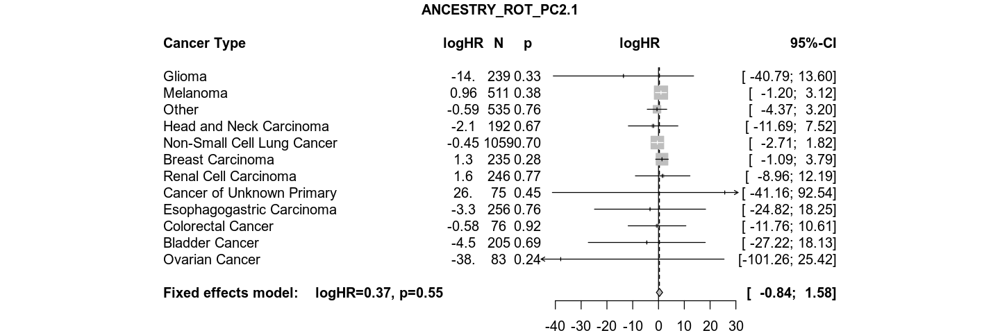

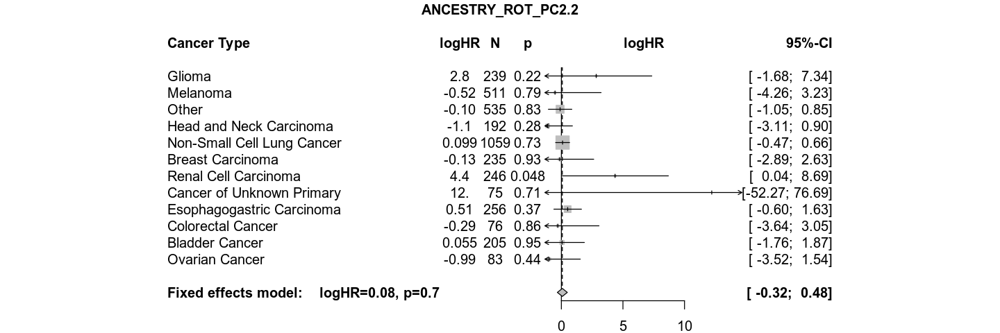

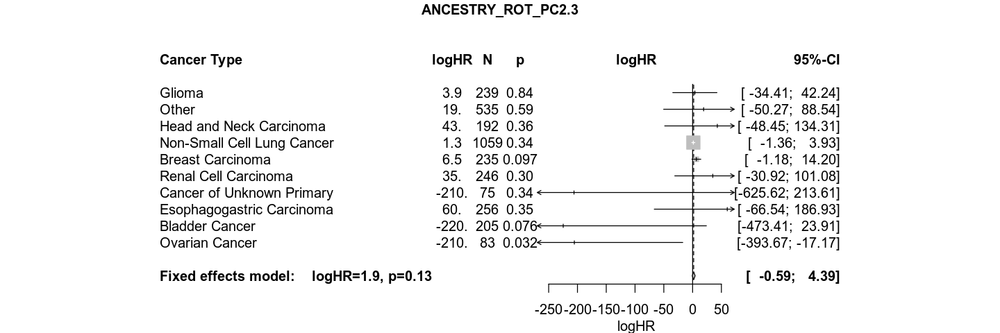

In [122]:
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT")

options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_AE(c("ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2"),transition="1|2|3",OS_mult_cur %>% filter(before_2018==1), vars_in_all = via_temp)
options(options_before)

In [73]:
GWAS_Profile <- fread('topsnp_fullcohort.raw') %>% select(IID,`8:79557237_C`,`8:79712998_G`)
GWAS_Profile <- data.frame(GWAS_Profile)
names(GWAS_Profile) <- c("PBP","rs7011565","rs16906115")
GWAS_Profile <- GWAS_Profile %>% mutate(PBP=gsub("^0_","",PBP))
temp <- GWAS_Profile

GWAS_Profile <- fread('topsnp_fullcohort_3.raw') %>% select(IID,`3:153827300_T`)
GWAS_Profile <- data.frame(GWAS_Profile)
names(GWAS_Profile) <- c("PBP","rs1624917")
GWAS_Profile <- GWAS_Profile %>% mutate(PBP=gsub("^0_","",PBP))

GWAS_Profile <- inner_join(GWAS_Profile,temp)

GWAS_Profile <- inner_join(inner_join(GWAS_Profile,translate_sid,by="PBP"),translate_pid,by="PATIENT_ID")
GWAS_Profile <- GWAS_Profile %>% select(MRN,rs7011565,rs16906115,rs1624917) %>% group_by(MRN) %>% summarise_all(first)
OS_ancestry_SNP <- inner_join(OS,GWAS_Profile)

OS_ancestry_SNP <- make_multistate_cur(OS_ancestry_SNP)

Joining, by = "PBP"
Joining, by = "MRN"
Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  222  1206      422           1850
  AE                0    0   169      107            276
  Death             0    0     0     1375           1375

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1200000 0.6518919 0.2281081
  AE        0.0000000 0.0000000 0.6123188 0.3876812
  Death     0.0000000 0.0000000 0.0000000 1.0000000



NULL
NULL
NULL


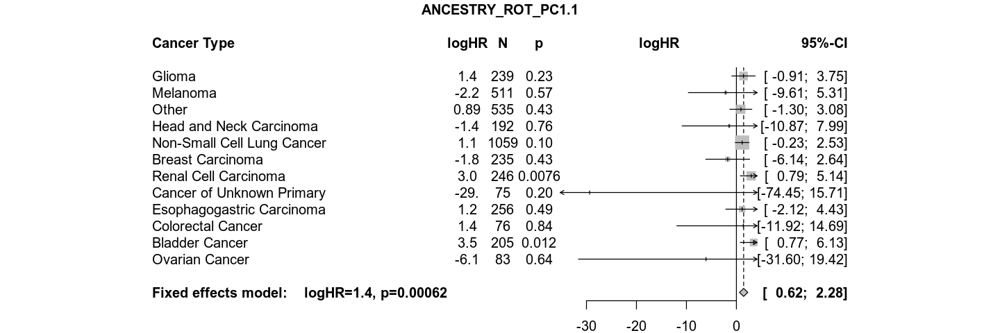

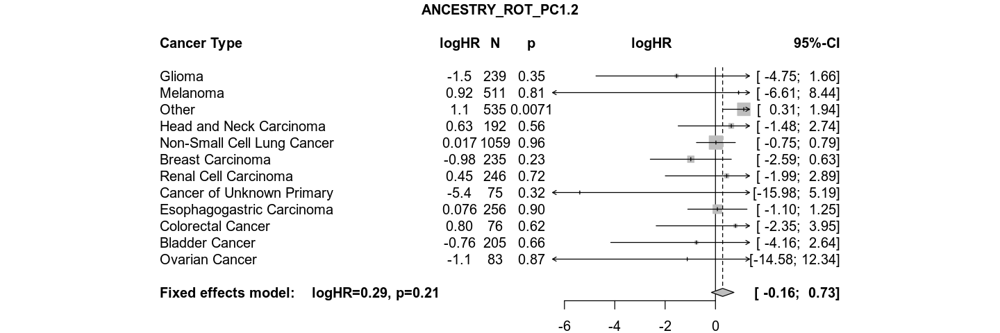

NULL
NULL


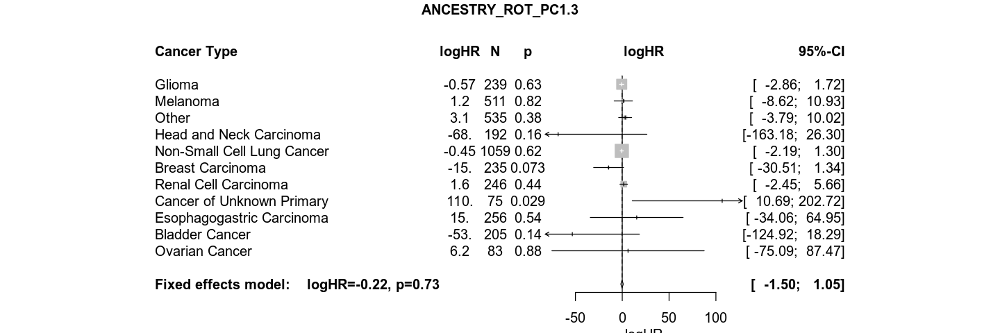

NULL


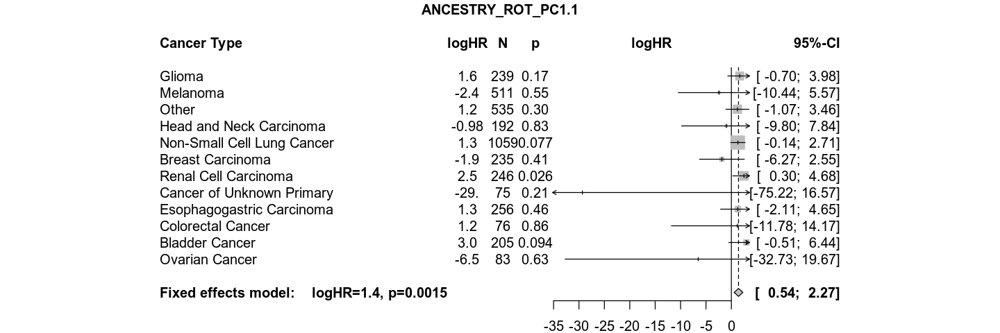

NULL


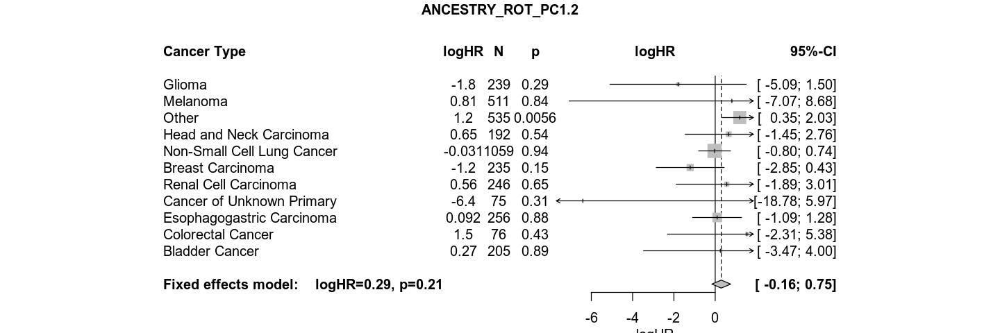

NULL


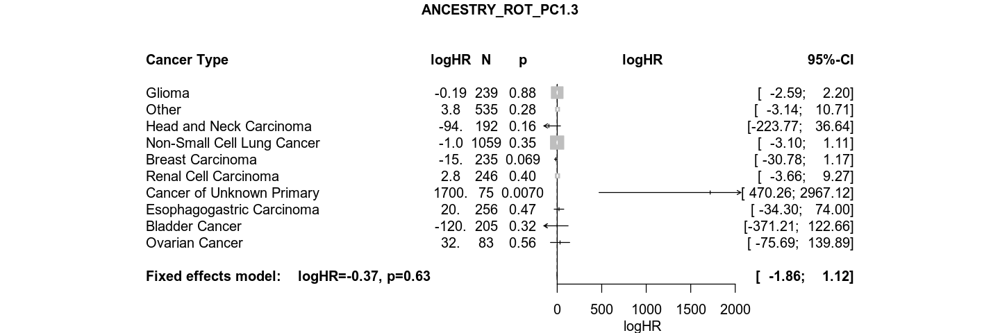

NULL


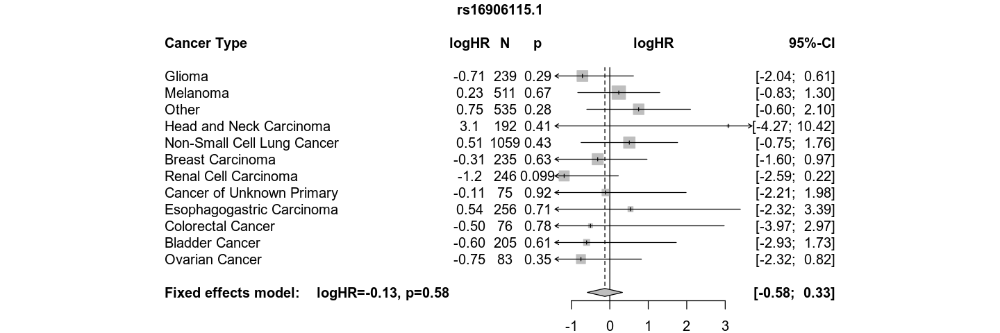

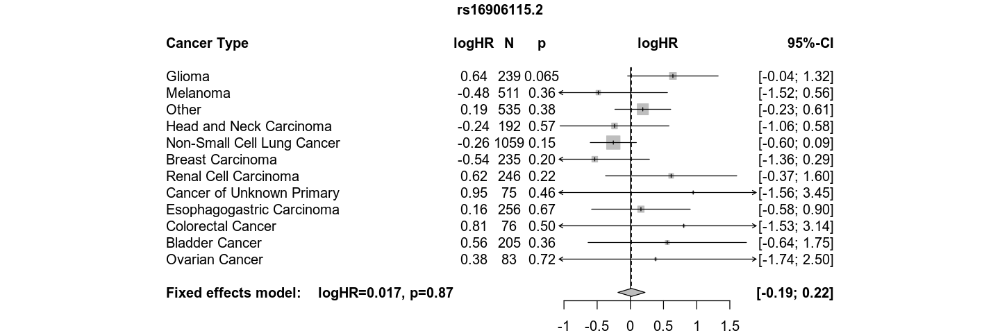

NULL
NULL


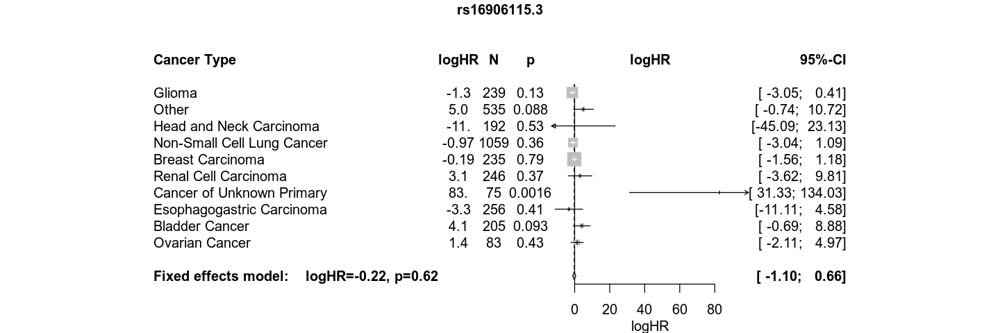

NULL


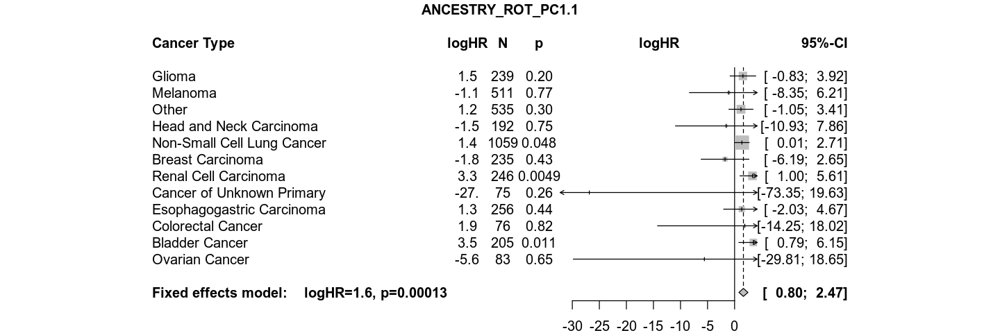

NULL


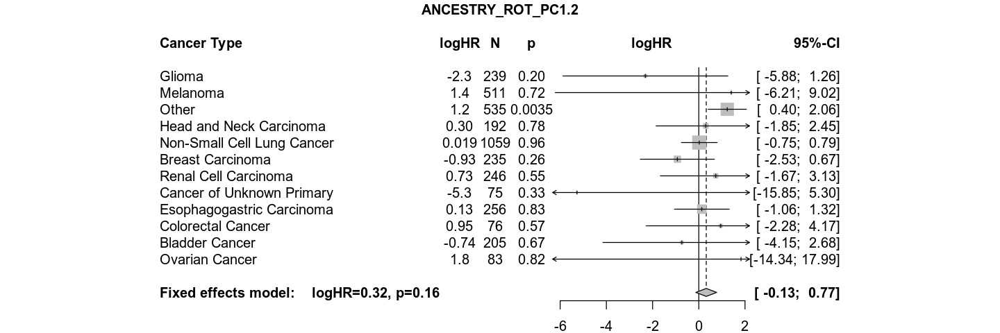

NULL


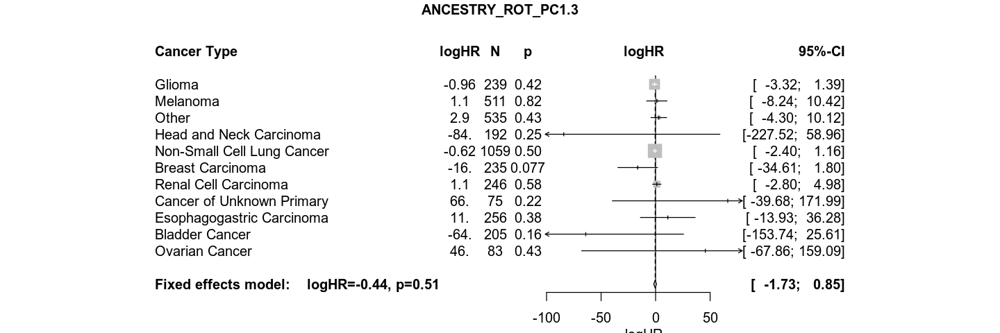

NULL


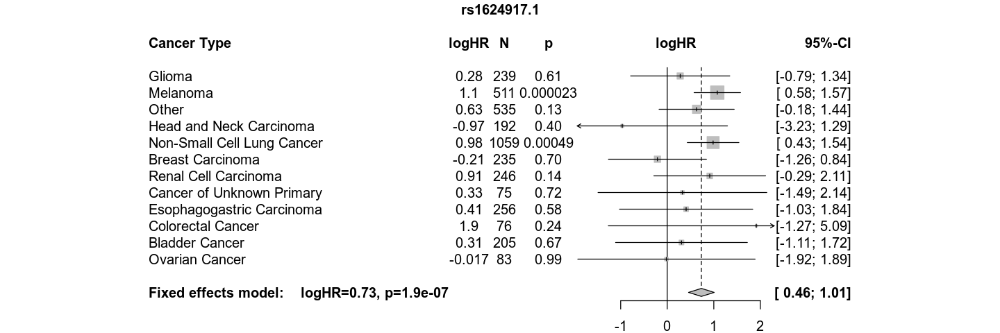

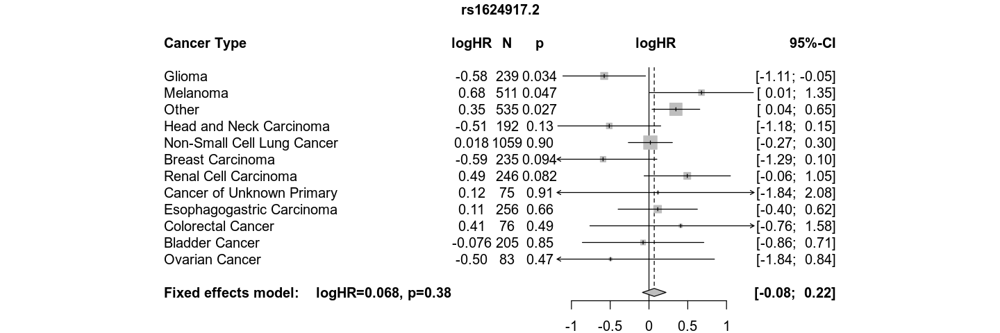

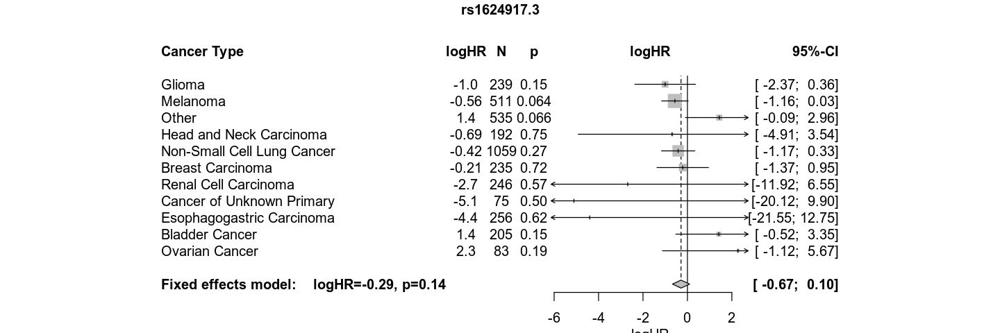

In [127]:
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT")

options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_AE(c("ANCESTRY_ROT_PC1"),transition="1|2|3",OS_ancestry_SNP %>% filter(before_2018==1), vars_in_all = via_temp)
options(options_before)

options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_AE(c("ANCESTRY_ROT_PC1","rs16906115"),transition="1|2|3",OS_ancestry_SNP %>% filter(before_2018==1), vars_in_all = via_temp)
options(options_before)

options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_AE(c("ANCESTRY_ROT_PC1","rs1624917"),transition="1|2|3",OS_ancestry_SNP %>% filter(before_2018==1), vars_in_all = via_temp)
options(options_before)

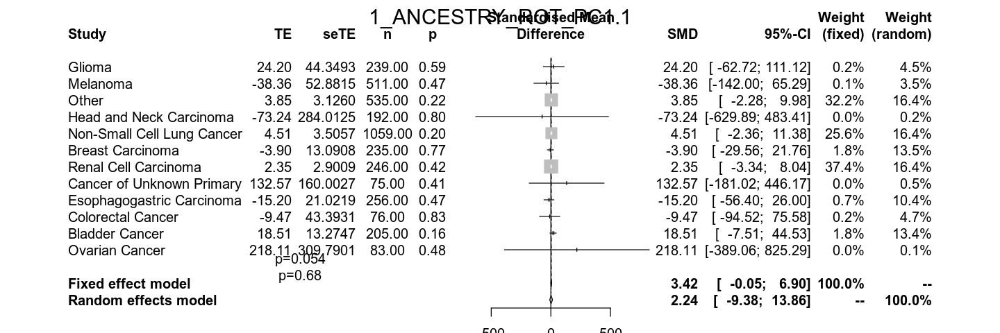

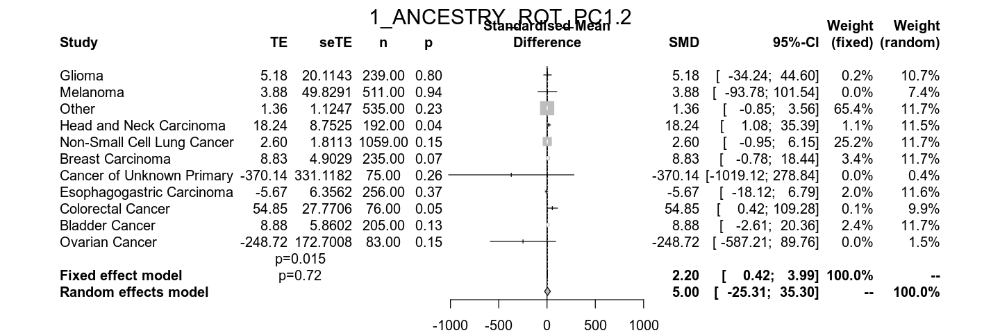

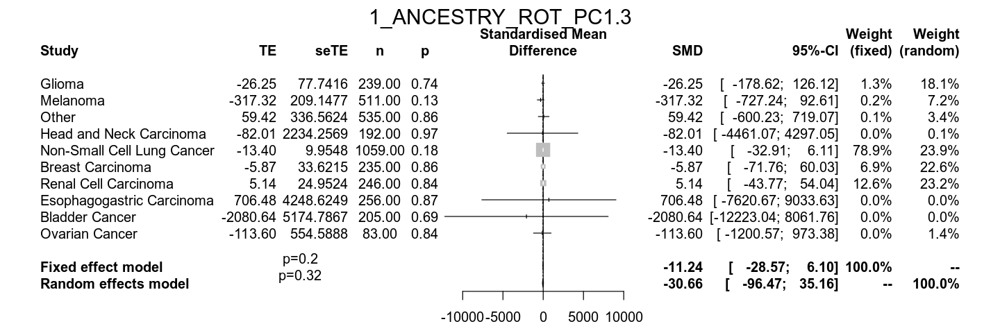

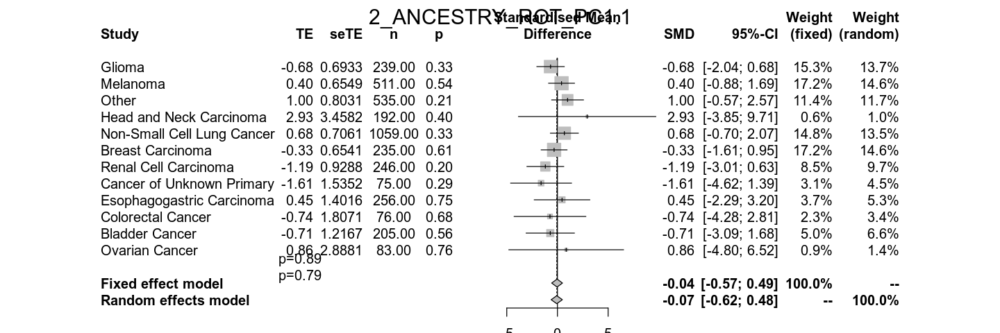

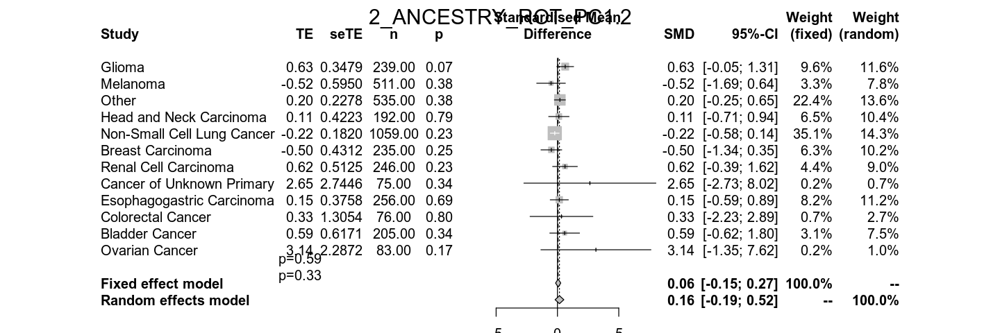

...

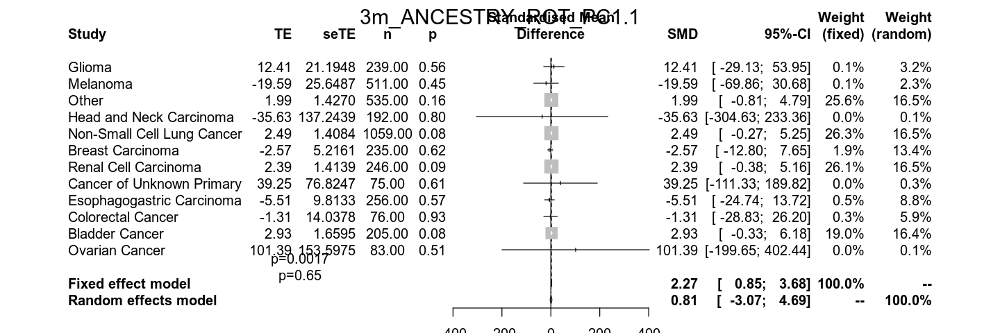

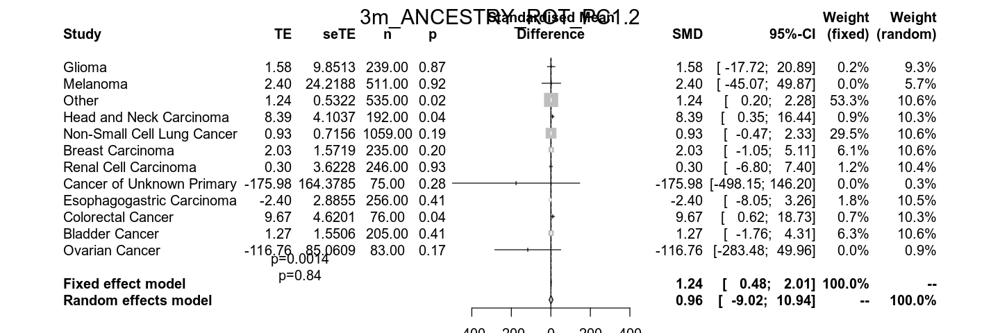

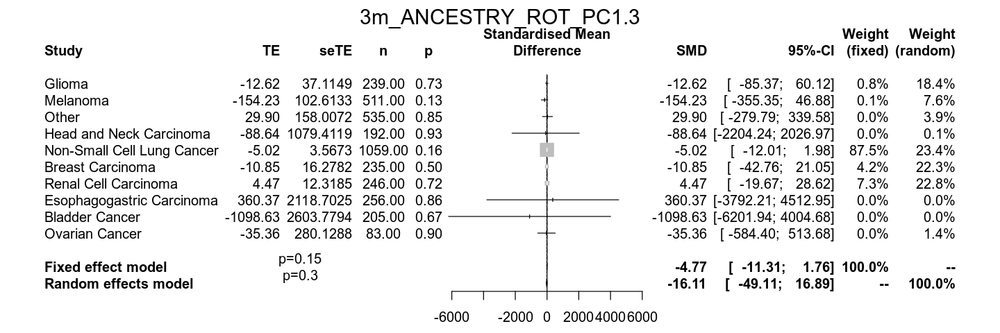

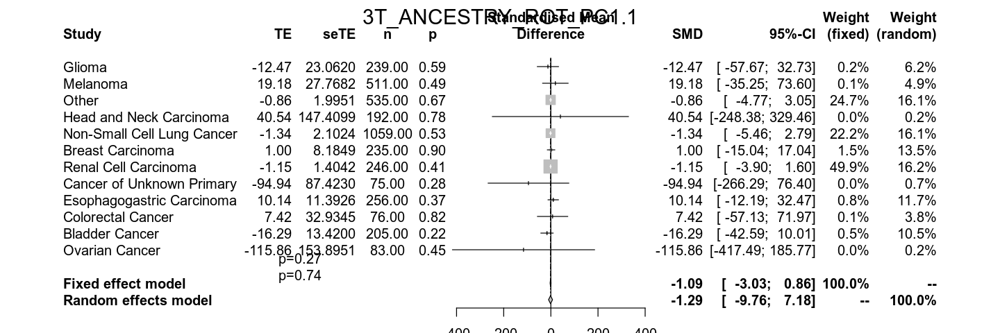

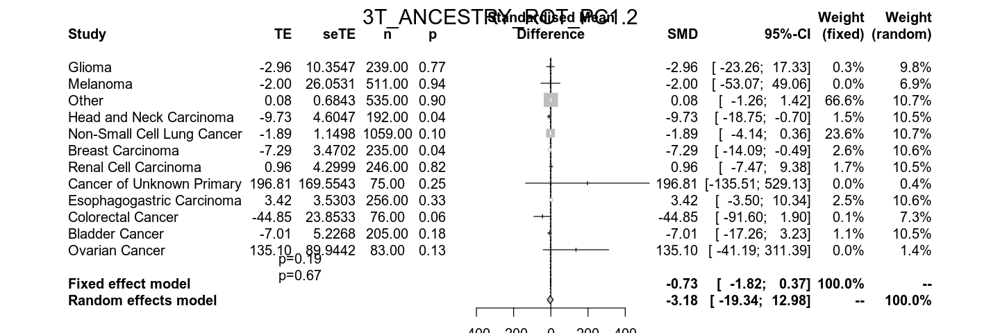

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"


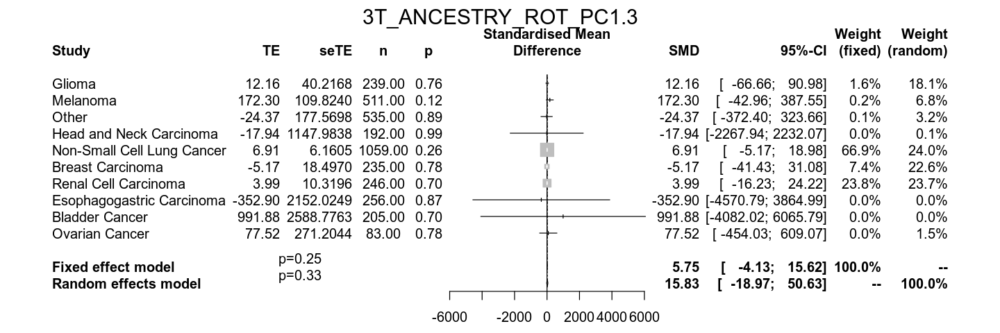

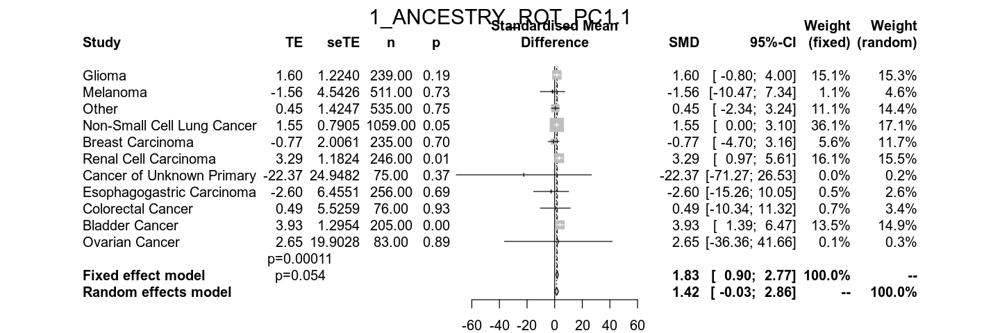

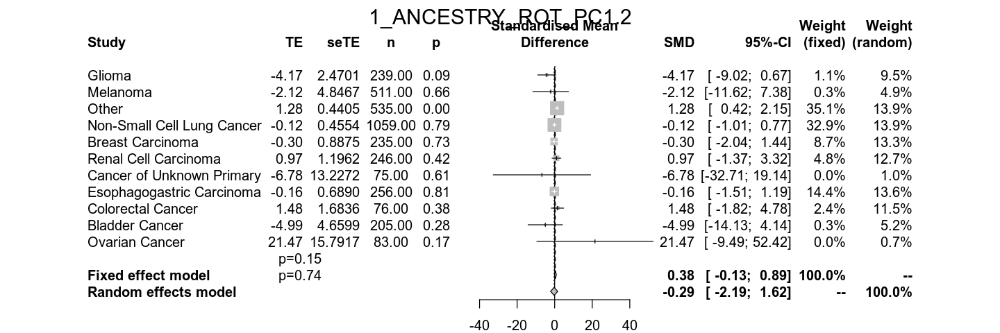

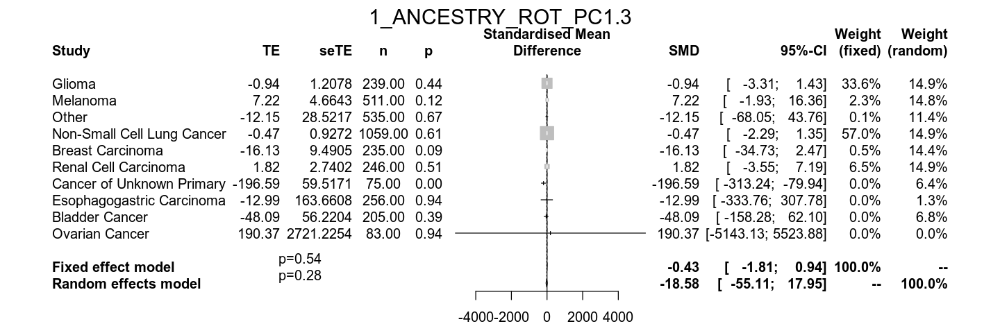

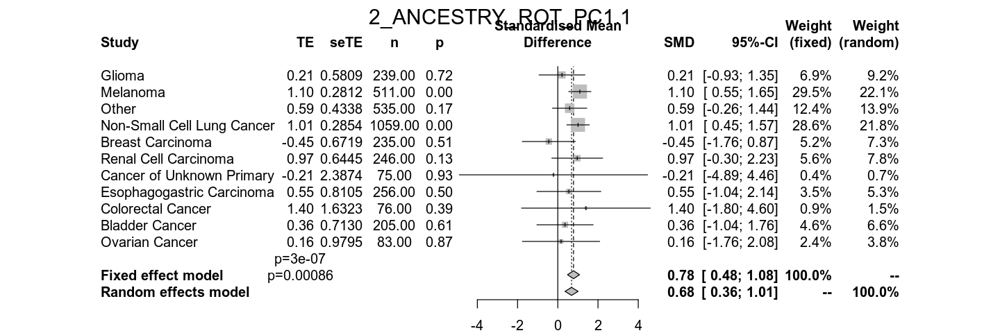

...

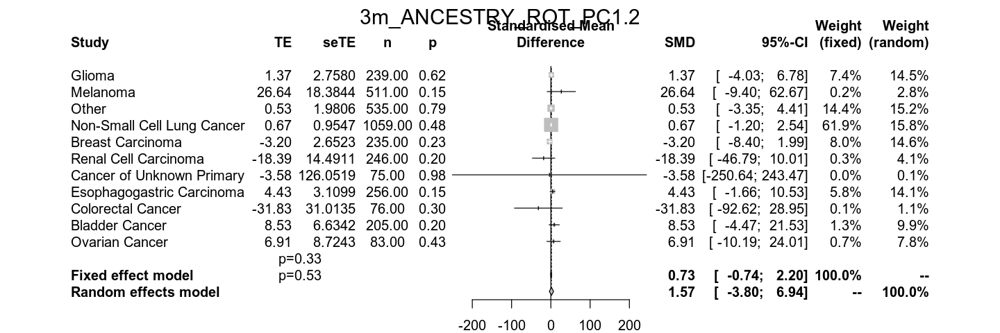

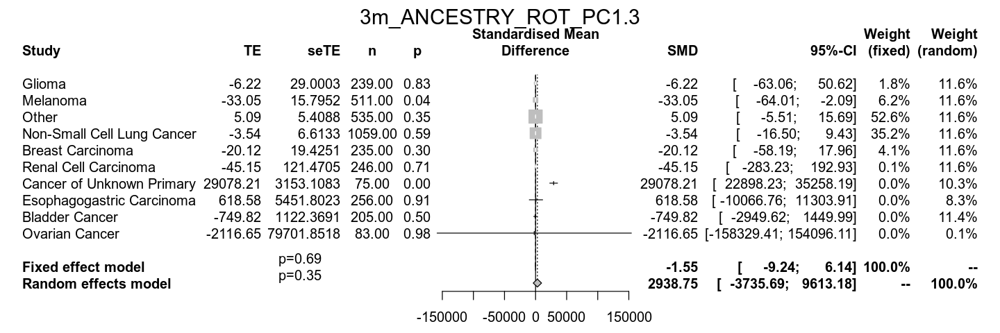

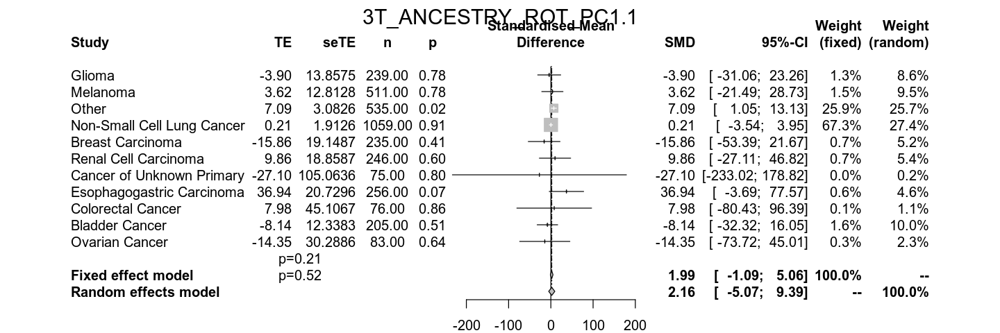

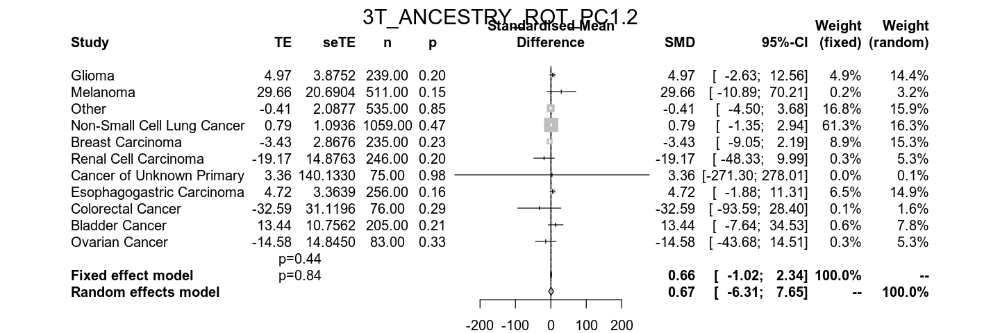

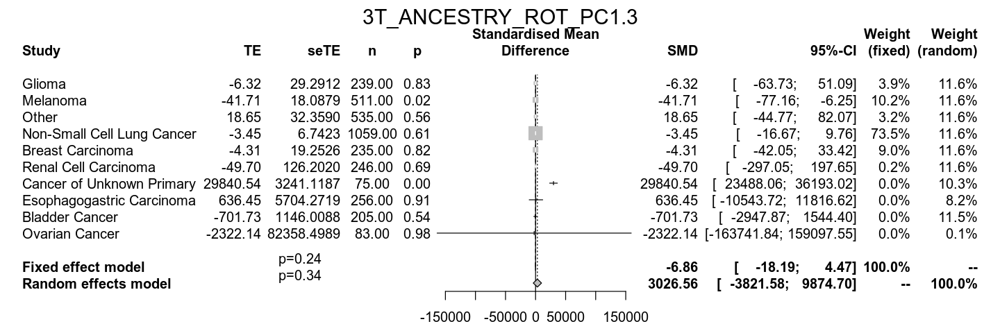

In [135]:
options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("ANCESTRY_ROT_PC1","rs16906115"),OS_ancestry_SNP %>% filter(before_2018==1), interaction_var="rs16906115", vars_in_all = via_temp)
options(options_before)


options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("ANCESTRY_ROT_PC1","rs1624917"),OS_ancestry_SNP %>% filter(before_2018==1), interaction_var="rs1624917", vars_in_all = via_temp)
options(options_before)

# Associations p<5e-5

In [27]:
snp_pred <- fread("IL7_coxmeg_suggestiveSNPs.csv") %>% mutate(CHR = as.integer(gsub("(.*)_.*","\\1",allele)), POS = as.integer(gsub(".*_(.*)","\\1",allele)))
snp_pred <- snp_pred %>% arrange(CHR,POS)

In [28]:
snp_pred %>% group_by(CHR) %>% count

CHR,n
<int>,<int>
1,104
2,26
3,11
4,149
5,29
7,46
8,40
9,6
10,28


In [58]:
GWAS <- data.frame(PBP=gsub("0_","",names(fread("head -n 1 /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1))[grep("PBP",names(fread("head -n 1 /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1)))]))
for (chr in unique(snp_pred$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_pred %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.',chr,".QC.traw",sep="")
    GWAS_temp <- fread(cmd=read_str) 
    GWAS_temp <- GWAS_temp %>% filter(POS %in% (snp_pred %>% filter(CHR==chr))$POS)
    GWAS_temp <- GWAS_temp %>% t
    GWAS_temp <- data.frame(GWAS_temp)
    GWAS_temp$PBP <- rownames(GWAS_temp)
    names(GWAS_temp) <- c((snp_pred %>% filter(CHR==chr))$SNP,"PBP")
    GWAS_temp <- GWAS_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
    GWAS_temp <- GWAS_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_temp <- GWAS_temp %>% mutate(PBP=gsub("^0_","",PBP))
    GWAS <- full_join(GWAS,GWAS_temp)
}

Joining, by = "PBP"
Warning message:
“Column `PBP` joining factor and character vector, coercing into character vector”Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"


In [59]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS <- inner_join(inner_join(OS,temp_trans),GWAS) %>% select(-PBP)
OS_GWAS_noleft <- make_multistate_noleft(OS_GWAS)
OS_GWAS_cur <- make_multistate_cur(OS_GWAS)
OS_GWAS <- make_multistate(OS_GWAS)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"


$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  497  1353      602           2452
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.2026917 0.5517945 0.2455139
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [60]:
snps <- names(OS_GWAS)[grepl("^rs",names(OS_GWAS)) & !grepl("\\.[1-3]",names(OS_GWAS))]
pvec_snps <- data.frame()
pb <- txtProgressBar(min = 0, max = length(snps), style = 3)
counter <- 0
for (name in snps) {
    meta <- meta_survival_AE(c(name),OS_GWAS %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    if (!is.null(dim(meta)[1])) {
       if (dim(meta)[1]>0) {
            names <- meta$variables
            pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
            haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
            temp <- data.frame(driver=names,hazard=haz,pval=pval)
            pvec_snps <- rbind(pvec_snps,temp)
        } 
    }
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}
                                 
pvec_snps <- inner_join(snp_pred,pvec_snps %>% mutate(SNP=gsub("(.*)\\.[1-3]","\\1",driver)))                                 
pvec_snps$pval_adjusted <- p.adjust(pvec_snps$pval, method = "BH")

pvec_snps %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |                                                                      |   1%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |=                                                                     |   1%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to n

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |============                                                          |  17%

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |=============                                                         |  18%

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |=============                                                         |  19%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |==============                                                        |  19%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |==============                                                        |  20%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in 

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n

  |================================                                      |  45%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |================================                                      |  46%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=================================                                     |  47%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |=========================================                             |  58%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=========================================                             |  59%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |==========================================                            |  59%[1] "Error

  |===============================================                       |  68%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |================================================                      |  68%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offs

  |====================================================                  |  75%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |=====================================================                 |  75%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |=====================================================                 |  76%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed d

  |===========================================================           |  84%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Err

  |==================================================================    |  95%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===================================================================   |  95%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===================================================================   |  96%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to n

Joining, by = "SNP"


allele,beta,HR,sd_beta,p,SNP,CHR,POS,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>
8_79712998,-0.7764404,0.4600407,0.1583995,9.496875e-07,rs16906115,8,79712998,rs16906115.1,-1.0642826,3.792547e-09,1.371342e-06
8_79557237,-0.9254063,0.3963703,0.1850539,5.711084e-07,rs7011565,8,79557237,rs7011565.1,-1.2406947,3.834902e-09,1.371342e-06
8_79659182,-0.8475601,0.4284590,0.1737464,1.070879e-06,rs16906062,8,79659182,rs16906062.1,-1.1462050,7.754937e-09,1.371342e-06
1_24464626,-0.7164209,0.4884975,0.1499036,1.759832e-06,rs75824728,1,24464626,rs75824728.1,-0.9635767,9.071852e-09,1.371342e-06
1_24464592,-0.7162412,0.4885853,0.1500095,1.800297e-06,rs75032062,1,24464592,rs75032062.1,-0.9634600,9.311920e-09,1.371342e-06
4_34448039,-0.6154995,0.5403709,0.1387381,9.147067e-06,rs113861051,4,34448039,rs113861051.1,-0.8844755,1.125531e-08,1.371342e-06
1_24471579,-0.7295071,0.4821466,0.1535199,2.015418e-06,rs115203657,1,24471579,rs115203657.1,-0.9777271,1.137381e-08,1.371342e-06
4_34449543,-0.6246202,0.5354648,0.1387057,6.693589e-06,rs113491211,4,34449543,rs113491211.1,-0.8824854,1.197602e-08,1.371342e-06
4_34448159,-0.6247052,0.5354193,0.1388476,6.820494e-06,rs111502567,4,34448159,rs111502567.1,-0.8828740,1.223875e-08,1.371342e-06


In [61]:
pvec_snps %>% filter(pval < 5e-8) %>% arrange(CHR,pval)
fwrite(pvec_snps %>% filter(pval < 5e-8),"IL7_genomewidesignif.csv")

allele,beta,HR,sd_beta,p,SNP,CHR,POS,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<int>,<int>,<fct>,<dbl>,<dbl>,<dbl>
1_24464626,-0.7164209,0.4884975,0.1499036,1.759832e-06,rs75824728,1,24464626,rs75824728.1,-0.9635767,9.071852e-09,1.371342e-06
1_24464592,-0.7162412,0.4885853,0.1500095,1.800297e-06,rs75032062,1,24464592,rs75032062.1,-0.9634600,9.311920e-09,1.371342e-06
1_24471579,-0.7295071,0.4821466,0.1535199,2.015418e-06,rs115203657,1,24471579,rs115203657.1,-0.9777271,1.137381e-08,1.371342e-06
1_24472064,-0.7261833,0.4837518,0.1534913,2.233019e-06,rs77279721,1,24472064,rs77279721.1,-0.9745137,1.241377e-08,1.371342e-06
1_24463359,-0.7226034,0.4854867,0.1507479,1.639325e-06,rs78086250,1,24463359,rs78086250.1,-0.9547991,1.498154e-08,1.371342e-06
1_24458914,-0.7155155,0.4889400,0.1513263,2.264140e-06,rs144697207,1,24458914,rs144697207.1,-0.9536254,1.586309e-08,1.371342e-06
1_24458278,-0.7167751,0.4883245,0.1517490,2.319032e-06,rs75345424,1,24458278,rs75345424.1,-0.9553967,1.644388e-08,1.371342e-06
1_24454902,-0.7270533,0.4833311,0.1538404,2.289614e-06,rs79895649,1,24454902,rs79895649.1,-0.9678485,1.716166e-08,1.371342e-06
1_24451720,-0.7243811,0.4846244,0.1532127,2.268051e-06,rs75492368,1,24451720,rs75492368.1,-0.9618186,1.855674e-08,1.371342e-06


[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
NULL
NULL
NULL


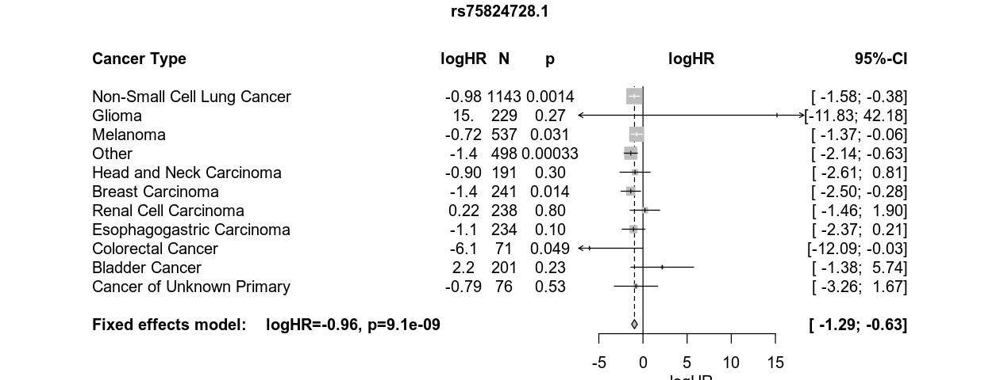

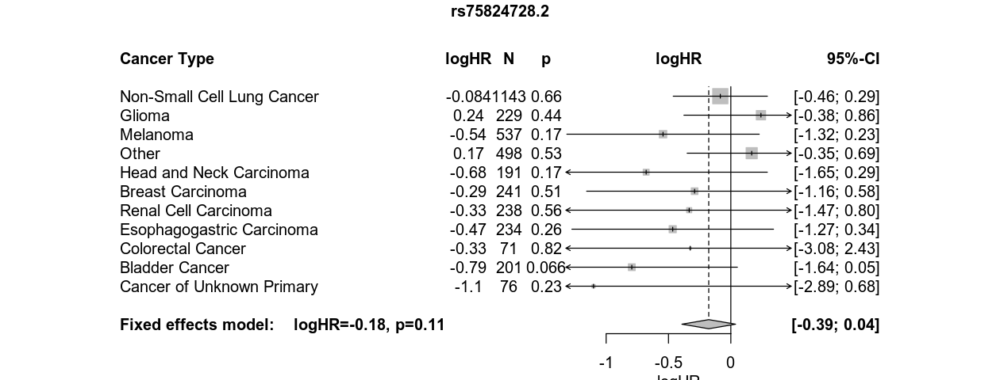

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
NULL
NULL


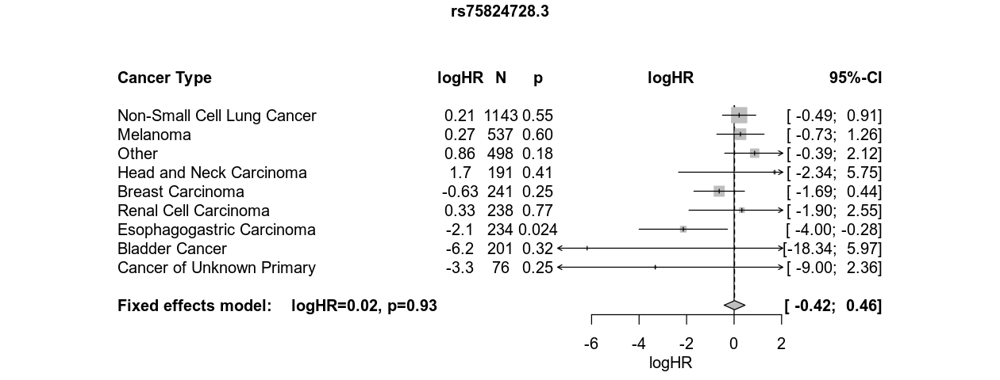

NULL


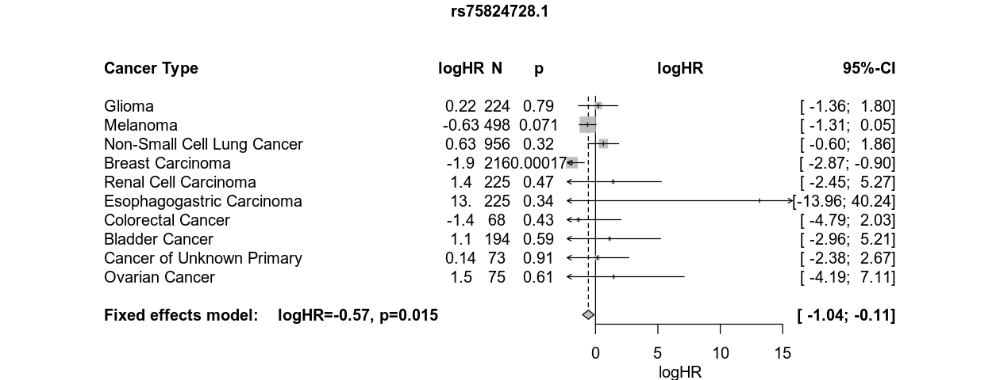

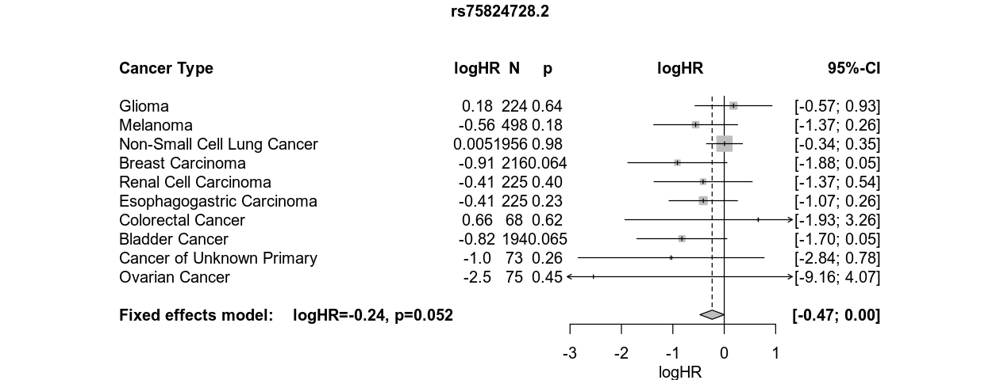

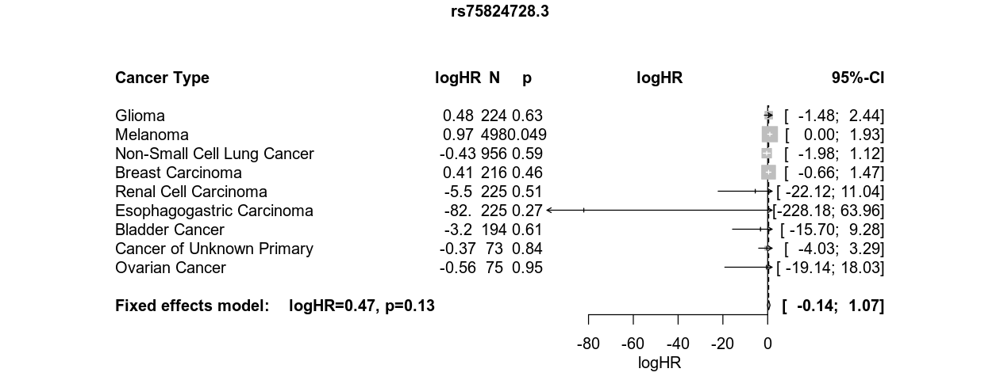

In [9]:
options(repr.plot.width=10.5,repr.plot.height=4)
tr <- meta_survival_AE(c("rs75824728"),OS_GWAS %>% filter(before_2018==1),plot=T)
tr <- meta_survival_AE(c("rs75824728"),OS_GWAS_cur %>% filter(before_2018==1),plot=T)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


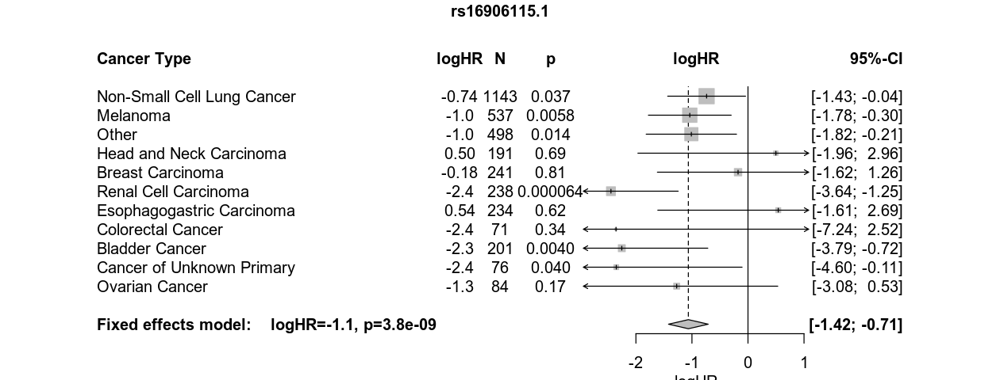

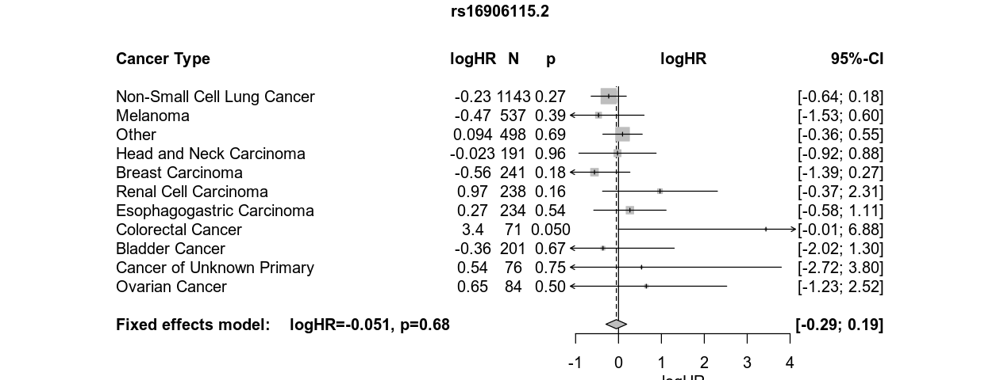

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL


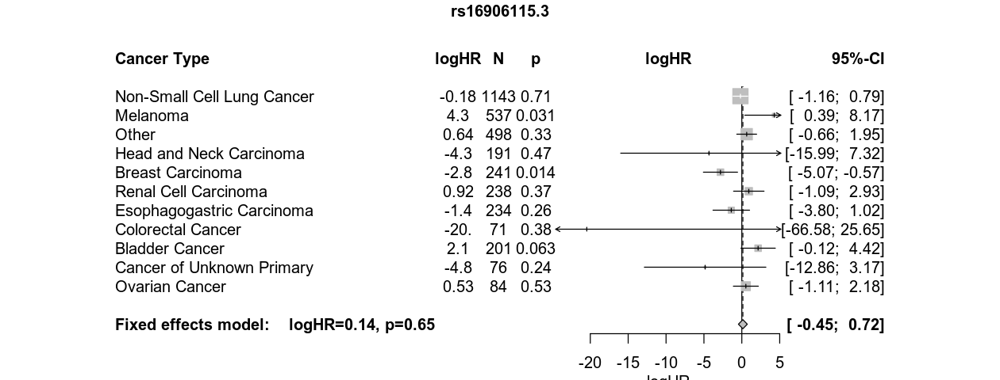

NULL


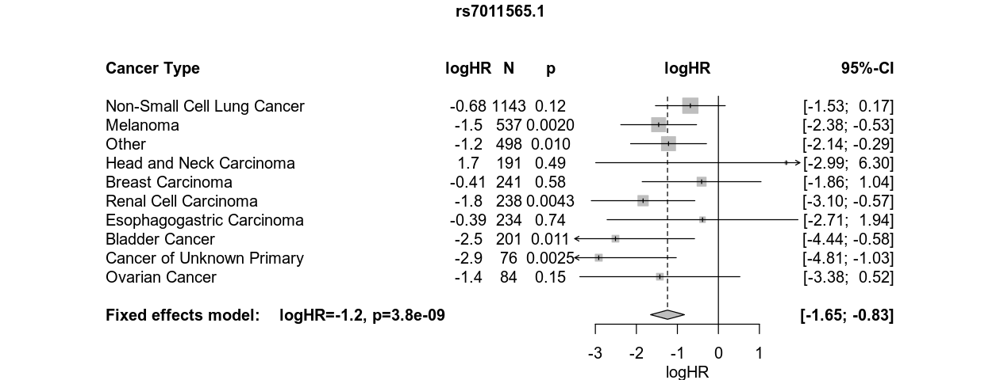

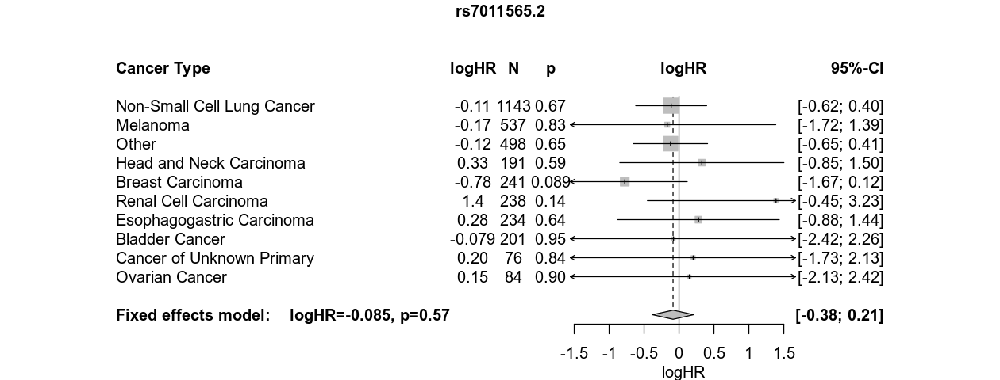

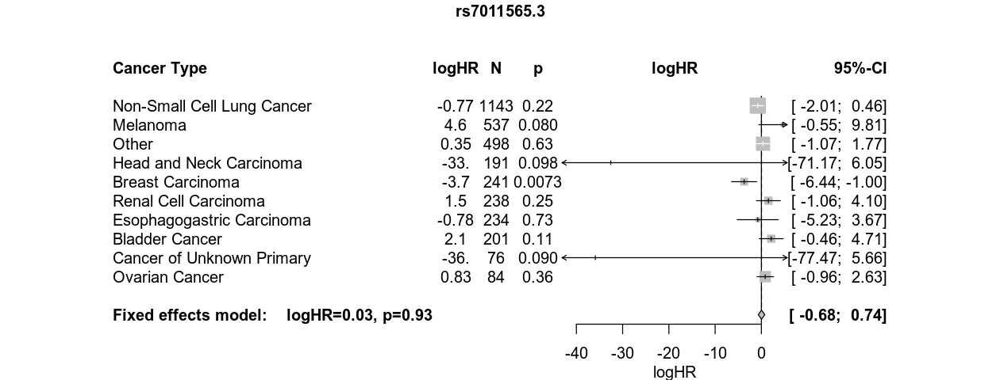

In [13]:
options(repr.plot.width=10.5,repr.plot.height=4)
tr <- meta_survival_AE(c("rs16906115"),OS_GWAS %>% filter(before_2018==1),plot=T)
tr <- meta_survival_AE(c("rs7011565"),OS_GWAS %>% filter(before_2018==1),plot=T)

Info scores

In [14]:
fread('grep "79712998\\|79557237" /data/gusev/PROFILE/2020_04/IMPUTE/PROFILE_2020_04.8.pvar')

V1,V2,V3,V4,V5,V6,V7,V8
<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
8,79557237,8:79557237,C,G,.,PASS,EAF=0.07098;INFO_SCORE=0.45394;HWE=0.216;ERC=56.1169;EAC=715.516;PAF=0.07272;REF_PANEL=1
8,79712998,8:79712998,G,A,.,PASS,EAF=0.09613;INFO_SCORE=0.55961;HWE=0.00985;ERC=244.293;EAC=2639.6;PAF=0.08471;REF_PANEL=1


In [16]:
fread('grep "24464626" /data/gusev/PROFILE/2020_04/IMPUTE/PROFILE_2020_04.1.pvar')

V1,V2,V3,V4,V5,V6,V7,V8
<int>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
1,24464626,1:24464626,G,A,.,PASS,EAF=0.10492;INFO_SCORE=0.58562;HWE=0.00257;ERC=932.337;EAC=6638.15;PAF=0.12315;REF_PANEL=1


In [19]:
fread("head -n 1 /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1)
fread('grep "24464626" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw',nrows=1)

Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”Warning message in cbind(parts$left, ellip_h, parts$right, deparse.level = 0L):
“number of rows of result is not a multiple of vector length (arg 2)”

CHR,SNP,(C)M,POS,COUNTED,ALT,0_PBP-000c782c-ee3a-401d-85d9-094f6a326db0,0_PBP-0035710c-851c-4f35-8d93-72780e449ddf,0_PBP-006db785-fdd5-47ec-a3b7-86855cc181db,0_PBP-0076d115-9ee8-40c8-9aaf-3b5098f07fdc,⋯,0_PBP-fece304d-48e4-4784-80e0-b2f694f9b299,0_PBP-fedf0ad2-12d1-4868-af84-04d57dfd977e,0_PBP-feea4a45-a9ad-4604-aae6-d81579849718,0_PBP-fef3409a-f185-4ab5-a061-87937842727e,0_PBP-ff312db1-258c-4330-864f-4582ea44dc18,0_PBP-ff856b14-f14e-4d64-8f48-ef8d486836d8,0_PBP-ff942537-cff8-41ea-bf7a-b9835829f13f,0_PBP-ffca7086-8a34-4a51-ade4-ee4556bfd1ed,0_PBP-ffd7f8b1-a158-4629-9c7f-b38d09f4c99a,0_PBP-ffe60c67-415b-41ce-ae42-e093aa518721
<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,⋯,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>,<lgl>


V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,⋯,V2470,V2471,V2472,V2473,V2474,V2475,V2476,V2477,V2478,V2479
<int>,<chr>,<int>,<int>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
1,.,0,24464626,G,A,1.96,1.859,1.994,1.974,⋯,1.805,1.958,1.806,1.825,1.989,1.991,1.847,1.965,1.99,1.992


curated

In [7]:
snp_pred <- fread("IL7_coxmeg_suggestiveSNPs_curated.csv") %>% mutate(CHR = gsub("(.*)_.*","\\1",allele), POS = gsub(".*_(.*)","\\1",allele))
snp_pred <- snp_pred %>% arrange(CHR,POS)

In [8]:
GWAS <- data.frame(PBP=gsub("0_","",names(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1))[grep("PBP",names(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1)))]))
for (chr in unique(snp_pred$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_pred %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.',chr,".QC.traw",sep="")
    GWAS_temp <- fread(cmd=read_str) %>% t
    GWAS_temp <- data.frame(GWAS_temp)
    GWAS_temp$PBP <- rownames(GWAS_temp)
    names(GWAS_temp) <- c((snp_pred %>% filter(CHR==chr))$SNP,"PBP")
    GWAS_temp <- GWAS_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
    GWAS_temp <- GWAS_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_temp <- GWAS_temp %>% mutate(PBP=gsub("^0_","",PBP))
    GWAS <- full_join(GWAS,GWAS_temp)
}

Joining, by = "PBP"
Warning message:
“Column `PBP` joining factor and character vector, coercing into character vector”Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"
Joining, by = "PBP"


In [9]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS <- inner_join(inner_join(OS,temp_trans),GWAS) %>% select(-PBP)
OS_GWAS_noleft <- make_multistate_noleft(OS_GWAS)
OS_GWAS_cur <- make_multistate_cur(OS_GWAS)
OS_GWAS <- make_multistate(OS_GWAS)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"


$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  497  1353      602           2452
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.2026917 0.5517945 0.2455139
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [10]:
snps <- names(OS_GWAS)[grepl("^rs",names(OS_GWAS)) & !grepl("\\.[1-3]",names(OS_GWAS))]
pvec_snps <- data.frame()
pb <- txtProgressBar(min = 0, max = length(snps), style = 3)
counter <- 0
for (name in snps) {
    meta <- meta_survival_AE(c(name),OS_GWAS_cur %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    if (!is.null(dim(meta)[1])) {
       if (dim(meta)[1]>0) {
            names <- meta$variables
            pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
            haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
            temp <- data.frame(driver=names,hazard=haz,pval=pval)
            pvec_snps <- rbind(pvec_snps,temp)
        } 
    }
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}
                                 
pvec_snps <- inner_join(snp_pred,pvec_snps %>% mutate(SNP=gsub("(.*)\\.[1-3]","\\1",driver)))                                 
pvec_snps$pval_adjusted <- p.adjust(pvec_snps$pval, method = "BH")

pvec_snps %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |=                                                                     |   2%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine faile

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=====                                                                 |   7%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=====                                                                 |   8%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |======                                                                |   8%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=======                                                               |  11%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=========                                                             |  13%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===========                                                           |  16%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |============                                                          |  17%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=============                                                         |  19%

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |==============                                                        |  19%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |==============                                                        |  20%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |===============                                                       |  21%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"


Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"


Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
  |===============                                                       |  22%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
  |================                                                      |  23%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
  |=================                                                     |  25%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
  |==================                                                    |  25%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |==================                                                    |  26%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
  |===================                                                   |  27%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |===================                                                   |  28%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |====================                                                  |  29%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=====================                                                 |  29%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=====================                                                 |  30%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carc

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |========================                                              |  35%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=========================                                             |  36%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |==========================                                            |  37%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |===========================                                           |  38%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was 

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |==============================                                        |  43%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |===============================                                       |  44%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=================================                                     |  47%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===================================                                   |  50%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Other was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |====================================                                  |  51%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |====================================                                  |  52%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
  |=====================================                                 |  52%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
  |=====================================                                 |  53%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=====================================                                 |  54%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |======================================                                |  54%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |======================================                                |  55%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=======================================                               |  55%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |=======================================                               |  56%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in fore

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in forei

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |===========================================                           |  62%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please c

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
  |============================================                          |  62%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "E

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
  |=============================================                         |  64%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign fun

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=================================================                     |  69%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=================================================                     |  70%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |==================================================                    |  71%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |==================================================                    |  72%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfe

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |===================================================                   |  73%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Can

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |====================================================   

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=====================================================                 |  75%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"):

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |====================================================== 

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=========================================================             |  82%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===========================================================           |  85%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |============================================================          |  86%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===============================================================       |  90%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |===============================================================       |  91%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |================================================================      |  91%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |================================================================      |  92%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |=================================================================     |  93%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma w

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |==================================================================    |  95%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |===================================================================   |  95%[1] "Error: Error in fitter(X, Y, strats, offset, in

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |====================================================================  |  96%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |====================================================================  |  97%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"sch

Joining, by = "SNP"


allele,beta,HR,sd_beta,p,SNP,CHR,POS,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<fct>,<dbl>,<dbl>,<dbl>
20_16159924,-0.8692046,0.4192849,0.2035075,1.944948e-05,rs36085973,20,16159924,rs36085973.1,-1.2643739,4.713851e-07,6.392520e-05
20_16165550,-0.8827420,0.4136471,0.2061908,1.858959e-05,rs11699168,20,16165550,rs11699168.1,-1.2727466,5.047830e-07,6.392520e-05
20_16164081,-0.8871561,0.4118253,0.2077104,1.944930e-05,rs17655092,20,16164081,rs17655092.1,-1.2612079,6.035057e-07,6.392520e-05
20_16156854,-0.8558744,0.4249115,0.2002779,1.924856e-05,rs79815920,20,16156854,rs79815920.1,-1.2329371,7.142017e-07,6.392520e-05
20_16161911,-0.8865612,0.4120704,0.2052842,1.569499e-05,rs77476705,20,16161911,rs77476705.1,-1.2494219,7.921664e-07,6.392520e-05
20_16156520,-0.8604027,0.4229917,0.2008219,1.832267e-05,rs75641349,20,16156520,rs75641349.1,-1.2174948,8.783117e-07,6.392520e-05
3_153882865,0.7235750,2.0617909,0.1517950,1.871842e-06,rs1727945,3,153882865,rs1727945.1,0.7097180,9.036045e-07,6.392520e-05
20_16167395,-0.9053607,0.4043960,0.2119682,1.944145e-05,rs11698334,20,16167395,rs11698334.1,-1.2800123,9.181792e-07,6.392520e-05
20_16154843,-0.8581715,0.4239365,0.2010364,1.965821e-05,rs75174196,20,16154843,rs75174196.1,-1.2301130,9.359809e-07,6.392520e-05


In [15]:
pvec_snps %>% filter(pval < 5e-6) %>% arrange(CHR,pval)
fwrite(pvec_snps %>% filter(pval < 5e-8),"IL7_genomewidesignif_curated.csv")
fwrite(pvec_snps %>% filter(pval < 5e-6),"IL7_suggestive_curated.csv")

allele,beta,HR,sd_beta,p,SNP,CHR,POS,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<fct>,<dbl>,<dbl>,<dbl>
20_16159924,-0.8692046,0.4192849,0.2035075,1.944948e-05,rs36085973,20,16159924,rs36085973.1,-1.2643739,4.713851e-07,6.392520e-05
20_16165550,-0.8827420,0.4136471,0.2061908,1.858959e-05,rs11699168,20,16165550,rs11699168.1,-1.2727466,5.047830e-07,6.392520e-05
20_16164081,-0.8871561,0.4118253,0.2077104,1.944930e-05,rs17655092,20,16164081,rs17655092.1,-1.2612079,6.035057e-07,6.392520e-05
20_16156854,-0.8558744,0.4249115,0.2002779,1.924856e-05,rs79815920,20,16156854,rs79815920.1,-1.2329371,7.142017e-07,6.392520e-05
20_16161911,-0.8865612,0.4120704,0.2052842,1.569499e-05,rs77476705,20,16161911,rs77476705.1,-1.2494219,7.921664e-07,6.392520e-05
20_16156520,-0.8604027,0.4229917,0.2008219,1.832267e-05,rs75641349,20,16156520,rs75641349.1,-1.2174948,8.783117e-07,6.392520e-05
20_16167395,-0.9053607,0.4043960,0.2119682,1.944145e-05,rs11698334,20,16167395,rs11698334.1,-1.2800123,9.181792e-07,6.392520e-05
20_16154843,-0.8581715,0.4239365,0.2010364,1.965821e-05,rs75174196,20,16154843,rs75174196.1,-1.2301130,9.359809e-07,6.392520e-05
20_16162330,-0.8686308,0.4195256,0.2037692,2.018655e-05,rs11697341,20,16162330,rs11697341.1,-1.2221884,9.641793e-07,6.392520e-05


### GWAS of locus chrom 8

In [198]:
GWAS_locus <- fread("cat /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.8.QC.traw | awk '$4<79557237+500000 && $4>79557237-500000'") %>% t
GWAS_locus <- data.frame(GWAS_locus)
GWAS_locus$PBP <- colnames(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.8.QC.traw",nrows=1))

chr <- data.frame(t(GWAS_locus[1,]))$V1
pos <- data.frame(t(GWAS_locus[4,]))$V4
chrpos <- paste("SNP",chr,pos,sep="_")
chrpos <- chrpos[chrpos!="SNP_CHR_POS"]

GWAS_locus <- GWAS_locus %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
colnames(GWAS_locus) <- c(chrpos,"PBP")
GWAS_locus <- GWAS_locus %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
GWAS_locus <- GWAS_locus %>% mutate(PBP=gsub("^0_","",PBP))

In [199]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_locus <- inner_join(inner_join(OS,temp_trans),GWAS_locus) %>% select(-PBP)
OS_GWAS_locus_cur <- make_multistate_cur(OS_GWAS_locus)
OS_GWAS_locus <- make_multistate(OS_GWAS_locus)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"
Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [73]:
pvecs_meta <- data.frame()

names_GWAS <- names(GWAS_locus)[grepl("^SNP_",names(GWAS_locus))]
pvec_temp <- data.frame(GWAS=c(),pval=c())
pb <- txtProgressBar(min = 0, max = length(names_GWAS), style = 3)
counter <- 0
for (name in names_GWAS) {
    meta <- meta_survival_AE(c(name),OS_GWAS_locus %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    names <- meta$variables
    haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
    haz_sd <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$seTE.fixed))
    pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
    temp <- data.frame(GWAS=names,loghaz=haz,se_loghaz=haz_sd,pval=pval)
    pvecs_meta <- rbind(pvecs_meta,temp)
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}
pvecs_meta_AE <- pvecs_meta %>% mutate(transition=gsub(".*\\.([1-3])","\\1",GWAS),GWAS_name=gsub("(.*)\\.[1-3]","\\1",GWAS))
pvecs_meta_AE <- pvecs_meta_AE %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH"))
pvecs_meta_AE %>% filter(transition==1) %>% arrange(pval_adjusted,pval)
pvecs_meta_AE %>% filter(transition==2) %>% arrange(pval_adjusted,pval)
pvecs_meta_AE %>% filter(transition==3) %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |                                                                      |   1%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 

  |==                                                                    |   4%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |===                                                                   |   4%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: 

  |=====                                                                 |   6%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |=====                                                                 |   7%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg

  |=======                                                               |   9%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=======                                                               |  10%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf

  |=========                                                             |  13%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in resi

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |============                                                          |  17%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numer

  |==============                                                        |  19%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |==============                                                        |  20%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offs

  |================                                                      |  23%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, con

  |==================                                                    |  26%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This shoul

  |====================                                                  |  29%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.

  |========================                                              |  35%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): 

  |==========================                                            |  38%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |===========================                                           |  38%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |============================                                          |  41%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |=============================                                         |  41%[1] "Error: Error in fitter(X, Y, s

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |==============================                                        |  42%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, i

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |==============================                                        |  43%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorec

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This 

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |==============================                                        |  44%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===============================                                       |  45%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |================================                                      |  45%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |================================                                      |  46%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer

  |===================================                                   |  51%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |====================================                                  |  51%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glio

  |======================================                                |  55%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): 

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/Na

  |==========================================                            |  61%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |===========================================                           |  61%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"

  |=============================================                         |  64%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf

  |===============================================                       |  68%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |================================================                  

  |==================================================                    |  71%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |===================================================                   |  72%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |===================================================               

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "E

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |====================================================                  |  75%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "E

  |========================================================              |  81%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
  |=========================================================             |  81%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Ca

  |===========================================================           |  85%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |============================================================          |  85%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, 

  |==============================================================        |  89%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===============================================================       |  90%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma wa

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |================================================================      |  91%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in res

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric ove

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |==================================================================    |  94%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma 

  |====================================================================  |  98%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===================================================================== |  98%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offs

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===================================================================== |  99%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer

GWAS,loghaz,se_loghaz,pval,transition,GWAS_name,pval_adjusted
<fct>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
SNP_8_79202975.1,1.2039453,0.1276973,4.175125e-21,1,SNP_8_79202975,7.352395e-18
SNP_8_79712998.1,-1.0642826,0.1806013,3.792547e-09,1,SNP_8_79712998,2.251087e-06
SNP_8_79557237.1,-1.2406947,0.2106027,3.834902e-09,1,SNP_8_79557237,2.251087e-06
SNP_8_79659182.1,-1.1462050,0.1985217,7.754937e-09,1,SNP_8_79659182,2.979728e-06
SNP_8_79658906.1,-1.1399034,0.2004426,1.293417e-08,1,SNP_8_79658906,2.979728e-06
SNP_8_79694464.1,-1.0529929,0.1853250,1.332275e-08,1,SNP_8_79694464,2.979728e-06
SNP_8_79626275.1,-1.1574295,0.2037632,1.344832e-08,1,SNP_8_79626275,2.979728e-06
SNP_8_79656182.1,-1.1390676,0.2005701,1.353653e-08,1,SNP_8_79656182,2.979728e-06
SNP_8_79665307.1,-0.8859051,0.1567020,1.572698e-08,1,SNP_8_79665307,3.077246e-06


GWAS,loghaz,se_loghaz,pval,transition,GWAS_name,pval_adjusted
<fct>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
SNP_8_79890193.2,-0.1930584,0.08916805,0.03037946,2,SNP_8_79890193,0.8028866
SNP_8_79864990.2,-0.1747876,0.08075563,0.03043359,2,SNP_8_79864990,0.8028866
SNP_8_79887764.2,-0.1842600,0.08556748,0.03128822,2,SNP_8_79887764,0.8028866
SNP_8_79866761.2,-0.1991126,0.09294376,0.03217010,2,SNP_8_79866761,0.8028866
SNP_8_79876589.2,-0.1721204,0.08095887,0.03350139,2,SNP_8_79876589,0.8028866
SNP_8_79888705.2,0.1454715,0.07260366,0.04510875,2,SNP_8_79888705,0.8028866
SNP_8_79880147.2,-0.1621719,0.08131580,0.04611412,2,SNP_8_79880147,0.8028866
SNP_8_79958905.2,-0.2033211,0.10233158,0.04693509,2,SNP_8_79958905,0.8028866
SNP_8_80011391.2,-0.1664347,0.08392169,0.04734356,2,SNP_8_80011391,0.8028866


GWAS,loghaz,se_loghaz,pval,transition,GWAS_name,pval_adjusted
<fct>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
SNP_8_79178314.3,24.5877056,0.1598417,0.000000e+00,3,SNP_8_79178314,0.000000e+00
SNP_8_79879714.3,1.4311050,0.2290046,4.124502e-10,3,SNP_8_79879714,3.631624e-07
SNP_8_79254888.3,-0.3928176,0.1386002,4.594388e-03,3,SNP_8_79254888,1.638296e-01
SNP_8_79254910.3,-0.3939766,0.1390413,4.603819e-03,3,SNP_8_79254910,1.638296e-01
SNP_8_79233208.3,-0.4006471,0.1422614,4.858437e-03,3,SNP_8_79233208,1.638296e-01
SNP_8_79252302.3,-0.3953482,0.1411028,5.081128e-03,3,SNP_8_79252302,1.638296e-01
SNP_8_79229720.3,-0.3944929,0.1410169,5.150194e-03,3,SNP_8_79229720,1.638296e-01
SNP_8_79068642.3,-0.8612707,0.3088521,5.293332e-03,3,SNP_8_79068642,1.638296e-01
SNP_8_79206819.3,-0.4023082,0.1447891,5.459701e-03,3,SNP_8_79206819,1.638296e-01


NULL
NULL
NULL


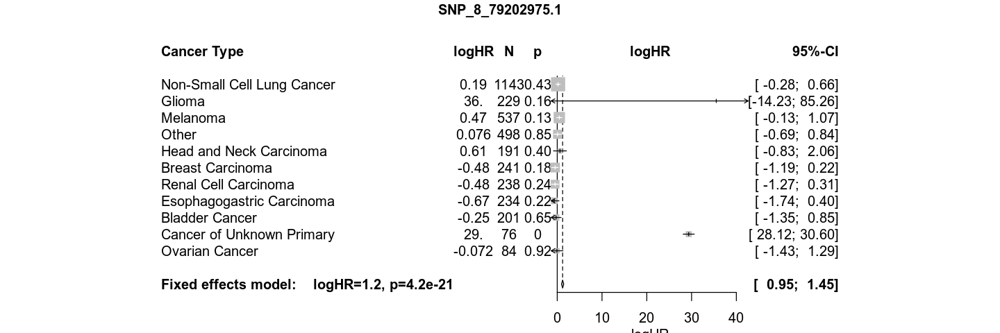

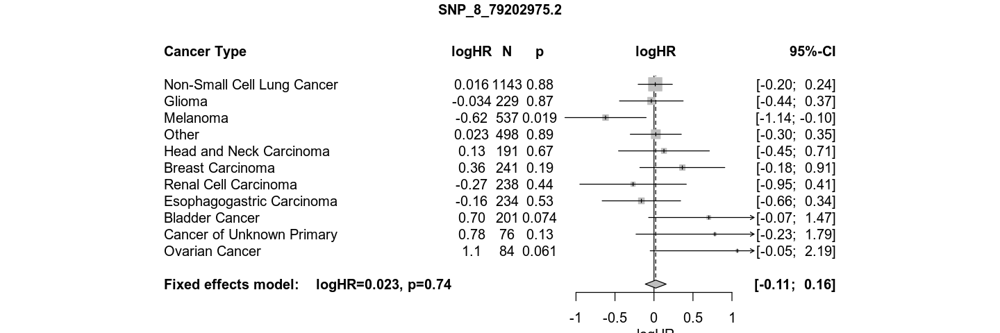

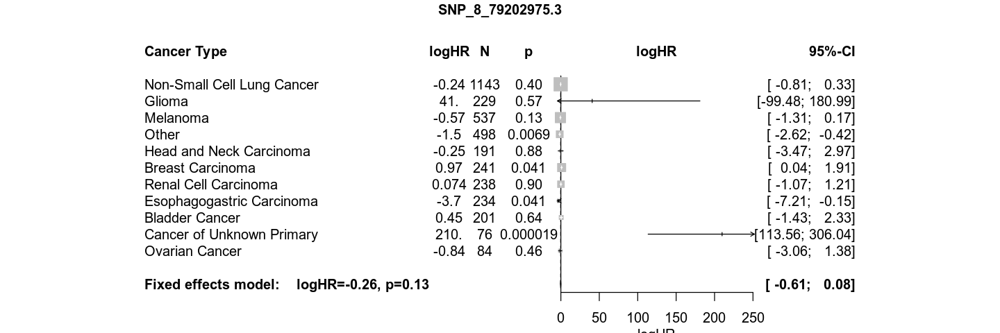

In [78]:
meta <- meta_survival_AE(c("SNP_8_79202975"),OS_GWAS_locus %>% filter(before_2018==1),plot=T)

In [90]:
pvecs_meta_AE <- inner_join(snptrans,pvecs_meta_AE %>% ungroup %>% filter(GWAS_name!="SNP_8_79202975",transition==1) %>% rename(allele=GWAS_name) %>% select(allele,loghaz,se_loghaz,pval))
fwrite(pvecs_meta_AE,"IL7_GWAS_multistate_chrom8.csv")

Joining, by = "allele"


In [200]:
pvecs_meta_AE <- fread("IL7_GWAS_multistate_chrom8.csv")

In [201]:
temp <- pvecs_meta_AE %>% mutate(POS=gsub(".*_.*_(.*)","\\1",allele)) %>% arrange(POS)
R <- cor(GWAS_locus %>% select(one_of(temp$allele)))
z_score <- temp$loghaz/temp$se_loghaz

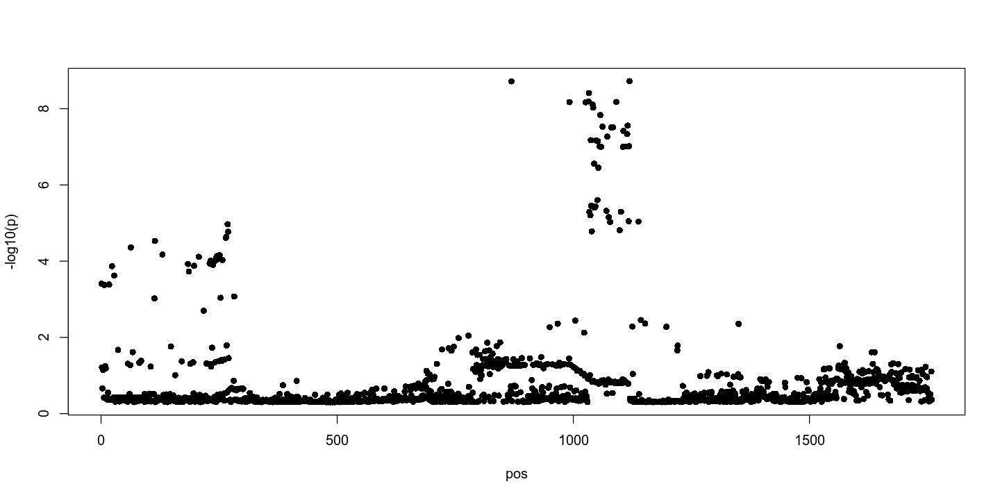

Joining, by = "allele"
Joining, by = c("allele", "SNP")


allele,SNP,variable_prob,loghaz,se_loghaz,pval
<chr>,<chr>,<dbl>,<dbl>,<dbl>,<dbl>
SNP_8_79712998,rs16906115,0.197841541,-1.0642826,0.1806013,3.792547e-09
SNP_8_79557237,rs7011565,0.195779014,-1.2406947,0.2106027,3.834902e-09
SNP_8_79659182,rs16906062,0.100770621,-1.1462050,0.1985217,7.754937e-09
SNP_8_79658906,rs7816685,0.062230267,-1.1399034,0.2004426,1.293417e-08
SNP_8_79694464,rs73251644,0.060519300,-1.0529929,0.1853250,1.332275e-08
SNP_8_79626275,rs73249933,0.059986936,-1.1574295,0.2037632,1.344832e-08
SNP_8_79656182,rs74197776,0.059618722,-1.1390676,0.2005701,1.353653e-08
SNP_8_79665307,rs117355070,0.051765788,-0.8859051,0.1567020,1.572698e-08
SNP_8_79665329,rs116228140,0.043996332,-0.8930635,0.1588039,1.869240e-08


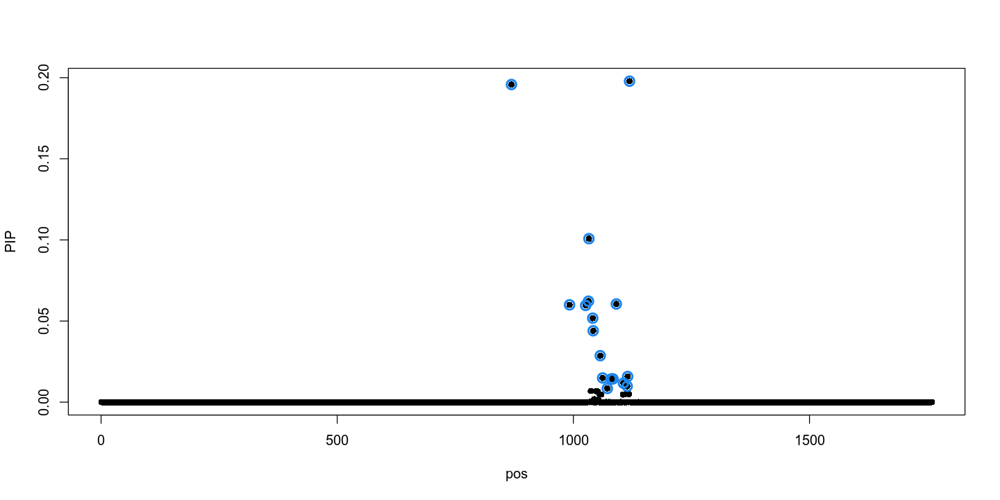

In [202]:
library(susieR)

susie_plot(z_score, y = "z")
fitted_rss <- susie_rss(z_score, R, L = 3,
                          estimate_residual_variance = TRUE, 
                          estimate_prior_variance = TRUE)
susie_plot(fitted_rss, y="PIP")

snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=paste("SNP_",gsub(":","_",V1),sep="")) %>% rename(allele=V1,SNP=V3)

credible_set <- inner_join(snptrans,summary(fitted_rss)$vars %>% mutate(allele=names(GWAS_locus %>% select(one_of(temp$allele)))[variable])) %>% arrange(desc(variable_prob))

inner_join(credible_set %>% filter(cs==1) %>% select(-variable,-cs),pvecs_meta_AE)

Joining, by = c("allele", "SNP")


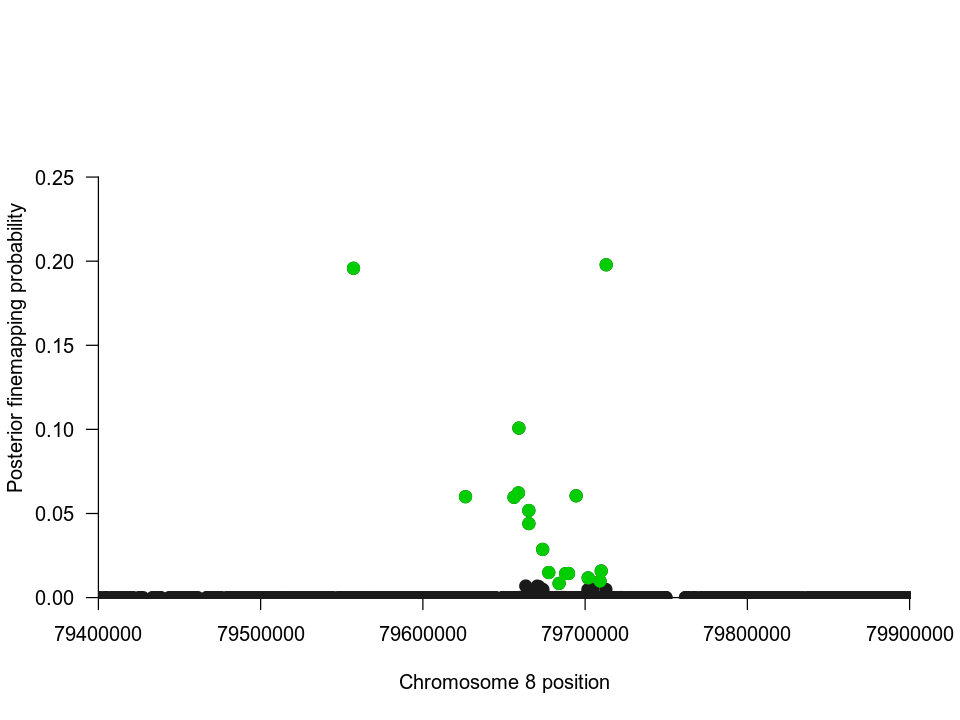

In [238]:
temp <- inner_join(credible_set,pvecs_meta_AE) %>% mutate(CHR=as.integer(gsub("SNP_([0-9]{1,2})_.*","\\1",allele)),POS=as.integer(gsub("SNP_[0-9]{1,2}_(.*)","\\1",allele)))
fwrite(temp,"credible_set_chrom8.csv")

snpsOfInterest <- (temp %>% filter(cs==1))$SNP

options(repr.plot.width=8,repr.plot.height=6)
manhattan(temp, chr="CHR", bp="POS", snp="SNP", p="variable_prob", ylab = "Posterior finemapping probability", highlight = snpsOfInterest, logp=F, xlim=c(79400000,79900000),ylim=c(0,1.5*max(temp$variable_prob)), cex = 2, genomewideline = FALSE, suggestiveline = FALSE)

### GWAS of locus on chrom 1

In [19]:
GWAS_locus <- fread("cat /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw | awk '$4<24464626+500000 && $4>24464626-500000'") %>% t
GWAS_locus <- data.frame(GWAS_locus)
GWAS_locus$PBP <- colnames(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1))

chr <- data.frame(t(GWAS_locus[1,]))$V1
pos <- data.frame(t(GWAS_locus[4,]))$V4
chrpos <- paste("SNP",chr,pos,sep="_")
chrpos <- chrpos[chrpos!="SNP_CHR_POS"]

GWAS_locus <- GWAS_locus %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
colnames(GWAS_locus) <- c(chrpos,"PBP")
GWAS_locus <- GWAS_locus %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
GWAS_locus <- GWAS_locus %>% mutate(PBP=gsub("^0_","",PBP))

In [20]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_locus <- inner_join(inner_join(OS,temp_trans),GWAS_locus) %>% select(-PBP)
OS_GWAS_locus_cur <- make_multistate_cur(OS_GWAS_locus)
OS_GWAS_locus <- make_multistate(OS_GWAS_locus)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"
Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [ ]:
pvecs_meta_chrom1 <- data.frame()

names_GWAS <- names(GWAS_locus)[grepl("^SNP_",names(GWAS_locus))]
pvec_temp <- data.frame(GWAS=c(),pval=c())
pb <- txtProgressBar(min = 0, max = length(names_GWAS), style = 3)
counter <- 0
for (name in names_GWAS) {
    meta <- meta_survival_AE(c(name),OS_GWAS_locus %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    names <- meta$variables
    haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
    haz_sd <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$seTE.fixed))
    pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
    temp <- data.frame(GWAS=names,loghaz=haz,se_loghaz=haz_sd,pval=pval)
    pvecs_meta_chrom1 <- rbind(pvecs_meta_chrom1,temp)
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}
pvec_meta_AE_chrom1 <- pvecs_meta_chrom1 %>% mutate(transition=gsub(".*\\.([1-3])","\\1",GWAS),GWAS_name=gsub("(.*)\\.[1-3]","\\1",GWAS))
pvec_meta_AE_chrom1 <- pvec_meta_AE_chrom1 %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH"))
pvec_meta_AE_chrom1 %>% filter(transition==1) %>% arrange(pval_adjusted,pval)
pvec_meta_AE_chrom1 %>% filter(transition==2) %>% arrange(pval_adjusted,pval)
pvec_meta_AE_chrom1 %>% filter(transition==3) %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5

  |===                                                                   |   5%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"scho

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |======                                                                |   9%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |=======                                                               |   9%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glio

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |==========                                                            |  14%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |==========                                                            |  15%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===========                                                           |  15%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to n

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |=============                                                         |  18%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |=============                                                         |  19%[1] "Error: Error in fitter(X, Y, strats, offset, init, 

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |==============                                                        |  19%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |==============                                                        |  20%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |==============                                                        |  21%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===============                                                       |  21%[1] "Error: Error in residuals

  |==================                                                    |  26%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |===================                                                   |  27%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was uns

  |=======================                                               |  34%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |========================                                              |  34%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"scho

  |============================                                          |  39%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |============================                                          |  40%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter

  |===============================                                       |  45%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |================================                                      |  45%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |================================                                      |  46%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function

  |====================================                                  |  51%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.Th

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |=====================================                                 |  54%

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

  |=======================================                               |  56%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |========================================                              |  57%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X,

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should n

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |============================================                          |  63%

In [ ]:
snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=gsub(":","_",V1)) %>% rename(allele=V1,SNP=V3)

In [ ]:
snptrans %>% head

In [32]:
pvecs_meta_AE_chrom1 <- inner_join(snptrans,pvec_meta_AE_chrom1 %>% ungroup %>% filter(transition==1) %>% rename(allele=GWAS_name) %>% mutate(allele=gsub("SNP_","",allele)) %>% select(allele,loghaz,se_loghaz,pval))
fwrite(pvecs_meta_AE_chrom1,"IL7_GWAS_multistate_chrom1.csv")

Joining, by = "allele"


In [33]:
pvecs_meta_AE_chrom1

allele,SNP,loghaz,se_loghaz,pval
<chr>,<chr>,<dbl>,<dbl>,<dbl>
1_23964809,rs12760004,-0.076624177,0.1365098,0.5745869
1_23965115,rs60379440,0.065905634,0.1483405,0.6568358
1_23965517,rs61777309,0.040653272,0.1427189,0.7757601
1_23965704,rs10917403,0.043281940,0.1478560,0.7697282
1_23965829,rs10917404,0.079080077,0.1510408,0.6005792
1_23966837,rs1317329,0.032583888,0.1453509,0.8226220
1_23967159,rs1317345,-0.101323150,0.1168821,0.3860060
1_23969336,rs61777311,0.066472300,0.1540534,0.6661130
1_23970130,rs55656416,-0.202821760,0.1491817,0.1739687


### GWAS of locus on chrom 4

In [16]:
GWAS_locus <- fread("cat /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.4.QC.traw | awk '$4<34415682+500000 && $4>34415682-500000'") %>% t
GWAS_locus <- data.frame(GWAS_locus)
GWAS_locus$PBP <- colnames(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.4.QC.traw",nrows=1))

chr <- data.frame(t(GWAS_locus[1,]))$V1
pos <- data.frame(t(GWAS_locus[4,]))$V4
chrpos <- paste("SNP",chr,pos,sep="_")
chrpos <- chrpos[chrpos!="SNP_CHR_POS"]

GWAS_locus <- GWAS_locus %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
colnames(GWAS_locus) <- c(chrpos,"PBP")
GWAS_locus <- GWAS_locus %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
GWAS_locus <- GWAS_locus %>% mutate(PBP=gsub("^0_","",PBP))

In [17]:
GWAS_locus %>% dim

[1] 2473 1775

In [18]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_locus <- inner_join(inner_join(OS,temp_trans),GWAS_locus) %>% select(-PBP)
OS_GWAS_locus_cur <- make_multistate_cur(OS_GWAS_locus)
OS_GWAS_locus <- make_multistate(OS_GWAS_locus)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"
Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [19]:
pvecs_meta_chrom4 <- data.frame()

names_GWAS <- names(GWAS_locus)[grepl("^SNP_",names(GWAS_locus))]
pvec_temp <- data.frame(GWAS=c(),pval=c())
pb <- txtProgressBar(min = 0, max = length(names_GWAS), style = 3)
counter <- 0
for (name in names_GWAS) {
    meta <- meta_survival_AE(c(name),OS_GWAS_locus %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    names <- meta$variables
    haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
    haz_sd <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$seTE.fixed))
    pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
    temp <- data.frame(GWAS=names,loghaz=haz,se_loghaz=haz_sd,pval=pval)
    pvecs_meta_chrom4 <- rbind(pvecs_meta_chrom4,temp)
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}
pvec_meta_AE_chrom4 <- pvecs_meta_chrom4 %>% mutate(transition=gsub(".*\\.([1-3])","\\1",GWAS),GWAS_name=gsub("(.*)\\.[1-3]","\\1",GWAS))
pvec_meta_AE_chrom4 <- pvec_meta_AE_chrom4 %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH"))
pvec_meta_AE_chrom4 %>% filter(transition==1) %>% arrange(pval_adjusted,pval)
pvec_meta_AE_chrom4 %>% filter(transition==2) %>% arrange(pval_adjusted,pval)
pvec_meta_AE_chrom4 %>% filter(transition==3) %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Ca

  |=                                                                     |   2%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset,

  |==                                                                    |   4%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |===                                                                   |   4%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(f

  |====                                                                  |   6%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset,

  |======                                                                |   8%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric o

  |=======                                                               |  11%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |========                                      

  |=========                                                             |  13%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma 

Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Ratio of largest to smallest sampling variance extremely large. May not be able to obtain stable results.”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |==========                                                            |  15%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoe

  |============                                                          |  16%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |============                                                          |  17%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glio

  |==============                                                        |  19%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |==============                                                        |  20%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offs

  |===============                                                       |  22%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma 

  |=================                                                     |  25%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.

  |====================                                                  |  29%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset,

  |=======================                                               |  34%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |========================                                              |  34%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offs

  |==========================                                            |  38%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset,

  |=============================                                         |  41%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma 

  |===============================                                       |  45%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numer

  |==================================                                    |  48%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma 

  |===================================                                   |  51%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
  |====================================                                  |  51%[1] "Error: Error in residuals.coxph(fit, \"sc

  |======================================                                |  55%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, s

  |=========================================                             |  59%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
  |=================================

  |============================================                          |  63%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesfu

  |===============================================                       |  66%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |===============================================                       |  67%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] 

  |=====================================================                 |  75%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=====================================================                 |  76%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Gli

  |============================================================          |  85%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights,

  |==============================================================        |  88%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf

  |===================================================================== |  98%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsucc

GWAS,loghaz,se_loghaz,pval,transition,GWAS_name,pval_adjusted
<fct>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
SNP_4_34448039.1,-0.8844755,0.1548821,1.125531e-08,1,SNP_4_34448039,3.755583e-06
SNP_4_34449543.1,-0.8824854,0.1548202,1.197602e-08,1,SNP_4_34449543,3.755583e-06
SNP_4_34448159.1,-0.8828740,0.1549890,1.223875e-08,1,SNP_4_34448159,3.755583e-06
SNP_4_34445612.1,-0.8983469,0.1578765,1.269006e-08,1,SNP_4_34445612,3.755583e-06
SNP_4_34426273.1,-0.8599559,0.1540449,2.370828e-08,1,SNP_4_34426273,3.755583e-06
SNP_4_34441992.1,-0.8923642,0.1599236,2.406014e-08,1,SNP_4_34441992,3.755583e-06
SNP_4_34439229.1,-0.9797539,0.1758944,2.545549e-08,1,SNP_4_34439229,3.755583e-06
SNP_4_34430625.1,-0.8658190,0.1560371,2.876359e-08,1,SNP_4_34430625,3.755583e-06
SNP_4_34421184.1,-0.8746147,0.1576777,2.908629e-08,1,SNP_4_34421184,3.755583e-06


GWAS,loghaz,se_loghaz,pval,transition,GWAS_name,pval_adjusted
<fct>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
SNP_4_34618582.2,0.4648063,0.12627584,0.0002324297,2,SNP_4_34618582,0.2947839
SNP_4_34576127.2,0.2278969,0.07020942,0.0011705565,2,SNP_4_34576127,0.2947839
SNP_4_34571647.2,0.2388681,0.07412599,0.0012709446,2,SNP_4_34571647,0.2947839
SNP_4_34567053.2,0.2382395,0.07452573,0.0013898921,2,SNP_4_34567053,0.2947839
SNP_4_34565822.2,0.2414247,0.07599311,0.0014884325,2,SNP_4_34565822,0.2947839
SNP_4_34570874.2,0.2424167,0.07698395,0.0016387239,2,SNP_4_34570874,0.2947839
SNP_4_34547374.2,0.2325308,0.07541326,0.0020463598,2,SNP_4_34547374,0.2947839
SNP_4_34600901.2,0.2027486,0.06655226,0.0023155570,2,SNP_4_34600901,0.2947839
SNP_4_34567709.2,0.2163161,0.07111857,0.0023530369,2,SNP_4_34567709,0.2947839


GWAS,loghaz,se_loghaz,pval,transition,GWAS_name,pval_adjusted
<fct>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
SNP_4_34865838.3,-1.393517,0.3432279,4.906557e-05,3,SNP_4_34865838,0.006694962
SNP_4_34865798.3,-1.388630,0.3423653,4.992239e-05,3,SNP_4_34865798,0.006694962
SNP_4_34866769.3,-1.383020,0.3418043,5.204826e-05,3,SNP_4_34866769,0.006694962
SNP_4_34858160.3,-1.384551,0.3425922,5.313370e-05,3,SNP_4_34858160,0.006694962
SNP_4_34855949.3,-1.384070,0.3425920,5.345263e-05,3,SNP_4_34855949,0.006694962
SNP_4_34858103.3,-1.380351,0.3422038,5.490338e-05,3,SNP_4_34858103,0.006694962
SNP_4_34855853.3,-1.382565,0.3430566,5.574421e-05,3,SNP_4_34855853,0.006694962
SNP_4_34862092.3,-1.380564,0.3425662,5.576112e-05,3,SNP_4_34862092,0.006694962
SNP_4_34855464.3,-1.439398,0.3571828,5.580956e-05,3,SNP_4_34855464,0.006694962


In [20]:
snptrans <- fread("cat /data/gusev/PROFILE/STITCH/1000GP_Phase3_chr*.snpid")
snptrans <- snptrans %>% select(V1,V3) %>% mutate(V1=gsub(":","_",V1)) %>% rename(allele=V1,SNP=V3)

In [21]:
pvecs_meta_AE_chrom4 <- inner_join(snptrans,pvec_meta_AE_chrom4 %>% ungroup %>% filter(transition==1) %>% rename(allele=GWAS_name) %>% mutate(allele=gsub("SNP_","",allele)) %>% select(allele,loghaz,se_loghaz,pval))
fwrite(pvecs_meta_AE_chrom4,"IL7_GWAS_multistate_chrom4.csv")

Joining, by = "allele"


In [22]:
pvecs_meta_AE_chrom4 %>% arrange(pval)

allele,SNP,loghaz,se_loghaz,pval
<chr>,<chr>,<dbl>,<dbl>,<dbl>
4_34448039,rs113861051,-0.8844755,0.1548821,1.125531e-08
4_34449543,rs113491211,-0.8824854,0.1548202,1.197602e-08
4_34448159,rs111502567,-0.8828740,0.1549890,1.223875e-08
4_34445612,rs111406186,-0.8983469,0.1578765,1.269006e-08
4_34426273,rs76819305,-0.8599559,0.1540449,2.370828e-08
4_34441992,rs1895773,-0.8923642,0.1599236,2.406014e-08
4_34439229,rs56343694,-0.9797539,0.1758944,2.545549e-08
4_34430625,rs11944486,-0.8658190,0.1560371,2.876359e-08
4_34421184,rs11947519,-0.8746147,0.1576777,2.908629e-08


INFO score of top variant: INFO_SCORE=0.73719

### GWAS of locus on chrom 3

In [ ]:
GWAS_locus <- fread("cat /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.3.QC.traw | awk '$4<153827300+1000000 && $4>153827300-1000000'") %>% t
GWAS_locus <- data.frame(GWAS_locus)
GWAS_locus$PBP <- colnames(fread("head -n1 /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.3.QC.traw",nrows=1))

chr <- data.frame(t(GWAS_locus[1,]))$V1
pos <- data.frame(t(GWAS_locus[4,]))$V4
chrpos <- paste("SNP",chr,pos,sep="_")
chrpos <- chrpos[chrpos!="SNP_CHR_POS"]

GWAS_locus <- GWAS_locus %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
colnames(GWAS_locus) <- c(chrpos,"PBP")
GWAS_locus <- GWAS_locus %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
GWAS_locus <- GWAS_locus %>% mutate(PBP=gsub("^0_","",PBP))

In [ ]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_locus <- inner_join(inner_join(OS,temp_trans),GWAS_locus) %>% select(-PBP)
OS_GWAS_locus_cur <- make_multistate_cur(OS_GWAS_locus)
OS_GWAS_locus <- make_multistate(OS_GWAS_locus)

In [ ]:
pvecs_meta_chrom3 <- data.frame()

names_GWAS <- names(GWAS_locus)[grepl("^SNP_",names(GWAS_locus))]
pvec_temp <- data.frame(GWAS=c(),pval=c())
pb <- txtProgressBar(min = 0, max = length(names_GWAS), style = 3)
counter <- 0
for (name in names_GWAS) {
    meta <- meta_survival_AE(c(name),OS_GWAS_locus_cur %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    names <- meta$variables
    haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
    haz_sd <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$seTE.fixed))
    pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
    temp <- data.frame(GWAS=names,loghaz=haz,se_loghaz=haz_sd,pval=pval)
    pvecs_meta_chrom3 <- rbind(pvecs_meta_chrom3,temp)
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}
pvec_meta_AE_chrom3 <- pvecs_meta_chrom3 %>% mutate(transition=gsub(".*\\.([1-3])","\\1",GWAS),GWAS_name=gsub("(.*)\\.[1-3]","\\1",GWAS))
pvec_meta_AE_chrom3 <- pvec_meta_AE_chrom3 %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH"))
pvec_meta_AE_chrom3 %>% filter(transition==1) %>% arrange(pval_adjusted,pval)
pvec_meta_AE_chrom3 %>% filter(transition==2) %>% arrange(pval_adjusted,pval)
pvec_meta_AE_chrom3 %>% filter(transition==3) %>% arrange(pval_adjusted,pval)

In [34]:
pvecs_meta_AE_chrom3 <- inner_join(snptrans,pvec_meta_AE_chrom3 %>% ungroup %>% filter(transition==1) %>% rename(allele=GWAS_name) %>% mutate(allele=gsub("SNP_","",allele)) %>% select(allele,loghaz,se_loghaz,pval))
fwrite(pvecs_meta_AE_chrom3,"IL7_GWAS_multistate_chrom3.csv")

Joining, by = "allele"


### GWAS

In [16]:
transplant <- fread("/PHShome/szg99/immuno/Profile/OncDRS_data/ALL/DEMOGRAPHICS_REGISTRATION.csv") %>% inner_join(translate_pid) %>% select(MRN,TRANSPLANT_IND) %>% na_if("") %>% mutate(TRANSPLANT_IND = TRANSPLANT_IND=="Y")

Joining, by = "PATIENT_ID"


In [17]:
# normalize all genome wide significant

snp_pred <- fread("IL7_genomewidesignif.csv") %>% mutate(CHR = gsub("(.*)_.*","\\1",allele), POS = gsub(".*_(.*)","\\1",allele))
snp_pred <- snp_pred %>% arrange(CHR,POS)

GWAS <- data.frame(PBP=gsub("0_","",names(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1))[grep("PBP",names(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1)))]))
for (chr in unique(snp_pred$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_pred %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.',chr,".QC.traw",sep="")
    GWAS_temp <- fread(cmd=read_str) %>% t
    GWAS_temp <- data.frame(GWAS_temp)
    GWAS_temp$PBP <- rownames(GWAS_temp)
    names(GWAS_temp) <- c((snp_pred %>% filter(CHR==chr))$SNP,"PBP")
    GWAS_temp <- GWAS_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
    GWAS_temp <- GWAS_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_temp <- GWAS_temp %>% mutate(PBP=gsub("^0_","",PBP))
    GWAS <- full_join(GWAS,GWAS_temp)
}
                                         
translate_BB_BLNUM <- fread("/data/gusev/PROFILE/2020_04/IMPUTE/ACCURACY/PBB/SNP.uniq.remap") %>% rename(Biobank.ID=V2,BLNUM=V3) %>% select(Biobank.ID,BLNUM) %>% mutate(Biobank.ID=as.integer(gsub(".*-","",Biobank.ID)))
GWAS_PBB <- data.frame(Biobank.ID=as.double(gsub(".*-","",names(fread("/data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.1.traw",nrows=1))))) %>% drop_na#[grep("PBP",names(fread("/data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.1.traw",nrows=1)))]))
for (chr in unique(snp_pred$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_pred %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.',chr,".traw",sep="")
    GWAS_temp <- fread(cmd=read_str) %>% t
    GWAS_temp <- data.frame(GWAS_temp)
    GWAS_temp$PBP <- rownames(GWAS_temp)
    names(GWAS_temp) <- c((snp_pred %>% filter(CHR==chr))$SNP,"Biobank.ID")
    GWAS_temp <- GWAS_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",Biobank.ID))
    GWAS_temp <- GWAS_temp %>% mutate(Biobank.ID=as.double(gsub(".*-","",Biobank.ID)))
    GWAS_temp <- GWAS_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_temp <- GWAS_temp %>% mutate(Biobank.ID=as.integer(Biobank.ID))
    GWAS_PBB <- full_join(GWAS_PBB,GWAS_temp)
}
GWAS_PBB <- inner_join(translate_BB_BLNUM %>% drop_na(Biobank.ID),GWAS_PBB)
                                        
GWAS_Profile <- data.frame(PBP=gsub(".*_(.*)","\\1",names(fread("/data/gusev/PROFILE/2020_04/IMPUTE/DOSAGE/PROFILE_2020_IL7signif.1.traw",nrows=1))[grep("PBP",names(fread("/data/gusev/PROFILE/2020_04/IMPUTE/DOSAGE/PROFILE_2020_IL7signif.1.traw",nrows=1)))]))
for (chr in unique(snp_pred$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_pred %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PROFILE/2020_04/IMPUTE/DOSAGE/PROFILE_2020_IL7signif.',chr,".traw",sep="")
    GWAS_Profile_temp <- fread(cmd=read_str) %>% t
    GWAS_Profile_temp <- data.frame(GWAS_Profile_temp)
    GWAS_Profile_temp$PBP <- rownames(GWAS_Profile_temp)
    names(GWAS_Profile_temp) <- c((snp_pred %>% filter(CHR==chr))$SNP,"PBP")
    GWAS_Profile_temp <- GWAS_Profile_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
    GWAS_Profile_temp <- GWAS_Profile_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_Profile_temp <- GWAS_Profile_temp %>% mutate(PBP=gsub(".*_(.*)","\\1",PBP))
    GWAS_Profile <- full_join(GWAS_Profile,GWAS_Profile_temp)
}

Joining, by = "PBP"
Warning message:
“Column `PBP` joining factor and character vector, coercing into character vector”Joining, by = "PBP"
Joining, by = "PBP"
Warning message in data.frame(Biobank.ID = as.double(gsub(".*-", "", names(fread("/data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.1.traw", :
“NAs introduced by coercion”Joining, by = "Biobank.ID"
Joining, by = "Biobank.ID"
Joining, by = "Biobank.ID"
Joining, by = "Biobank.ID"
Joining, by = "PBP"
Warning message:
“Column `PBP` joining factor and character vector, coercing into character vector”Joining, by = "PBP"
Joining, by = "PBP"


normalizing the dosage

Joining, by = "PBP"


[1] "rs75492368"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 37.977, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7791555 0.8285470
sample estimates:
      cor 
0.8052437 


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.23507 -0.05655  0.04263  0.07963  0.86322 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.59678    0.03199   18.65   <2e-16 ***
rs75492368.y  0.65730    0.01731   37.98   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2147 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6484,	Adjusted R-squared:  0.648 
F-statistic:  1442 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs79895649"

	Pearson's product-moment corr

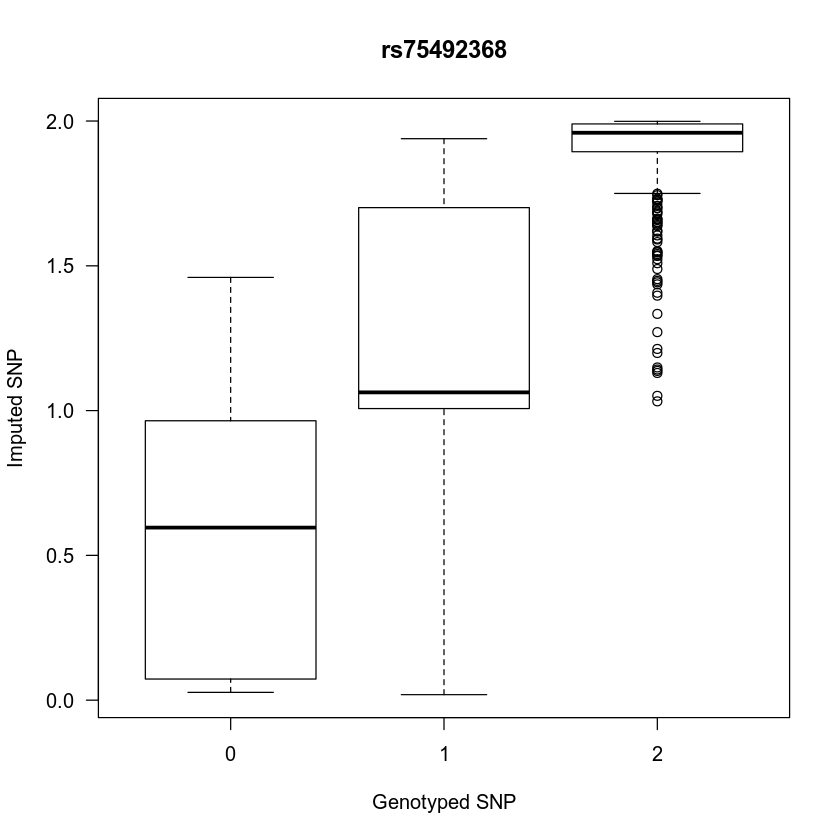


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.21772 -0.05476  0.04324  0.07824  0.85532 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.60668    0.03178   19.09   <2e-16 ***
rs79895649.y  0.65404    0.01719   38.05   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2133 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6492,	Adjusted R-squared:  0.6488 
F-statistic:  1447 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs75345424"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.546, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7917332 0.8385669
sample estimates:
      cor 
0.8164888 



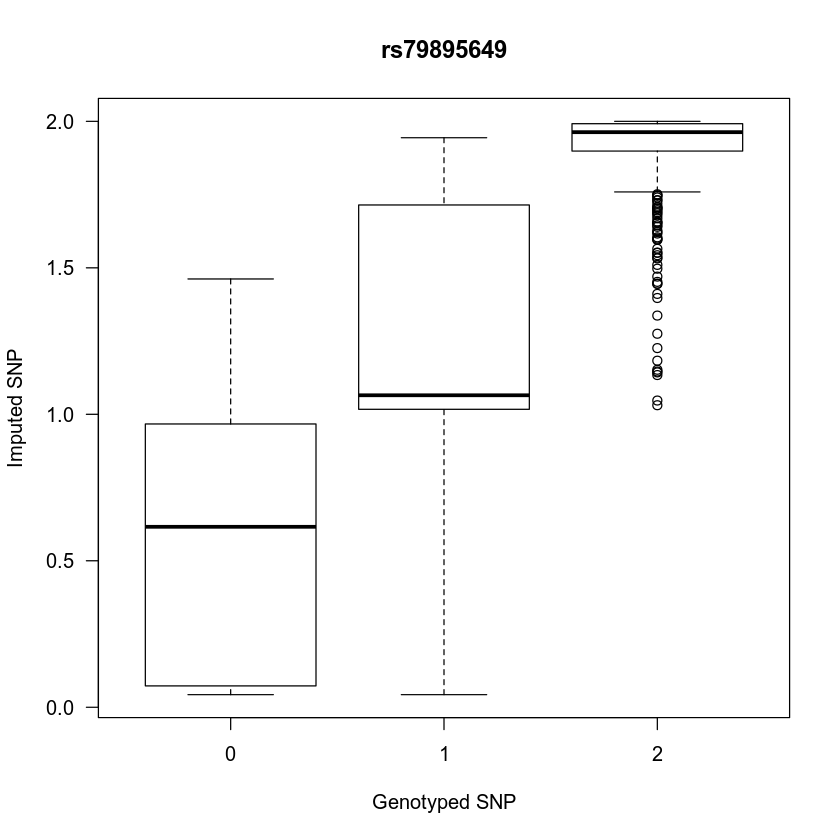


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.24035 -0.05903  0.03872  0.07322  0.86608 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.58992    0.03102   19.02   <2e-16 ***
rs75345424.y  0.66543    0.01683   39.55   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2107 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6667,	Adjusted R-squared:  0.6662 
F-statistic:  1564 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs144697207"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.77, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7934477 0.8399303
sample estimates:
      cor 
0.8180202 



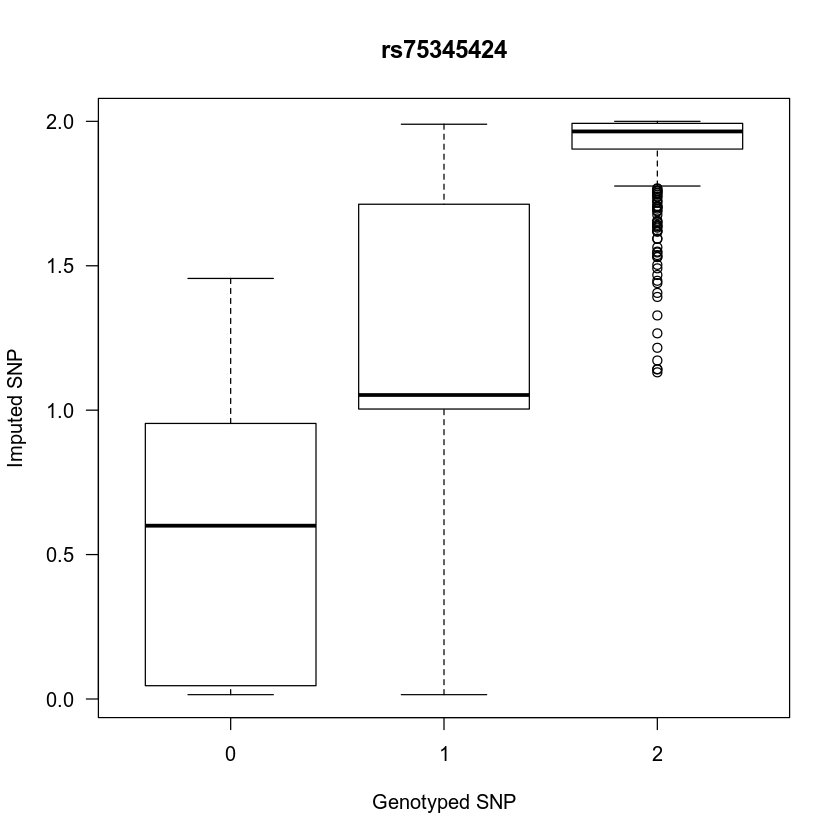


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.24194 -0.05743  0.03882  0.07282  0.87031 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.58269    0.03097   18.81   <2e-16 ***
rs144697207.y  0.66824    0.01680   39.77   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2104 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6692,	Adjusted R-squared:  0.6687 
F-statistic:  1582 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs78086250"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 40.559, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7993443 0.8446149
sample estimates:
      cor 
0.8232844 



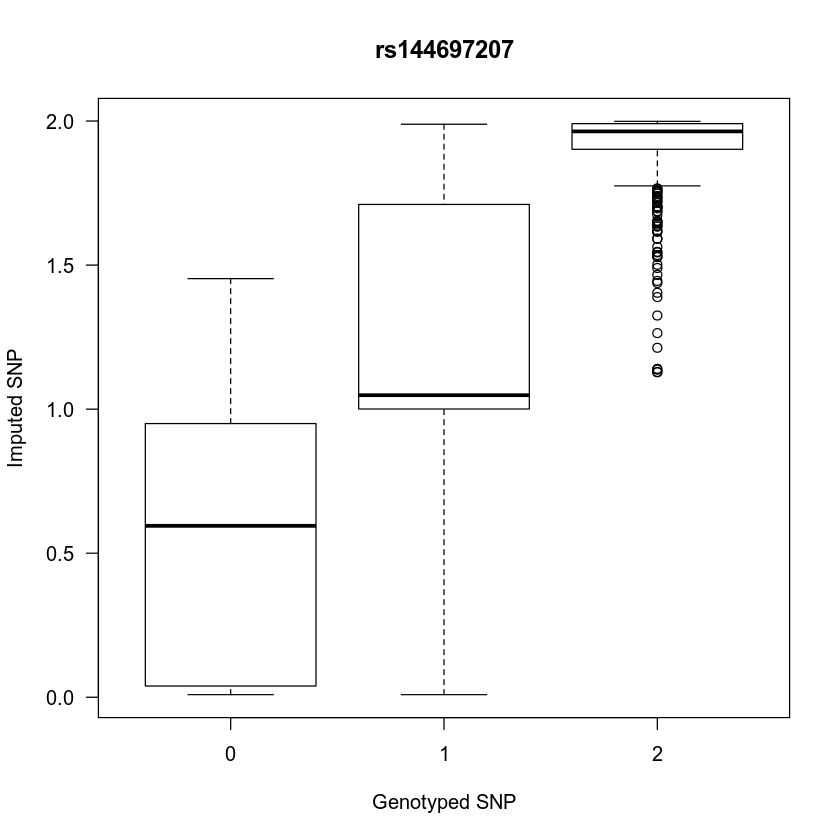


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.23184 -0.05709  0.03691  0.06791  0.86740 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.57660    0.03044   18.94   <2e-16 ***
rs78086250.y  0.67024    0.01653   40.56   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2073 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6778,	Adjusted R-squared:  0.6774 
F-statistic:  1645 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs7418238"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 32.558, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7272031 0.7868214
sample estimates:
      cor 
0.7585956 



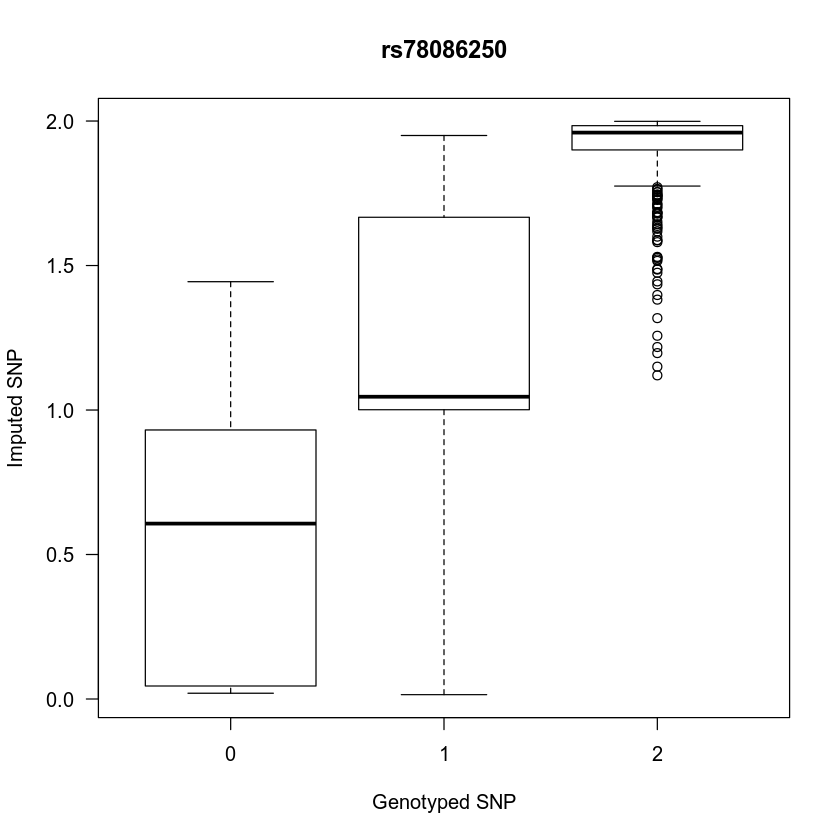


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.31135 -0.06641  0.02428  0.08553  0.66802 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.75998    0.03135   24.24   <2e-16 ***
rs7418238.y  0.56437    0.01733   32.56   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2351 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.5755,	Adjusted R-squared:  0.5749 
F-statistic:  1060 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs75032062"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 40.656, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8000555 0.8451794
sample estimates:
     cor 
0.823919 



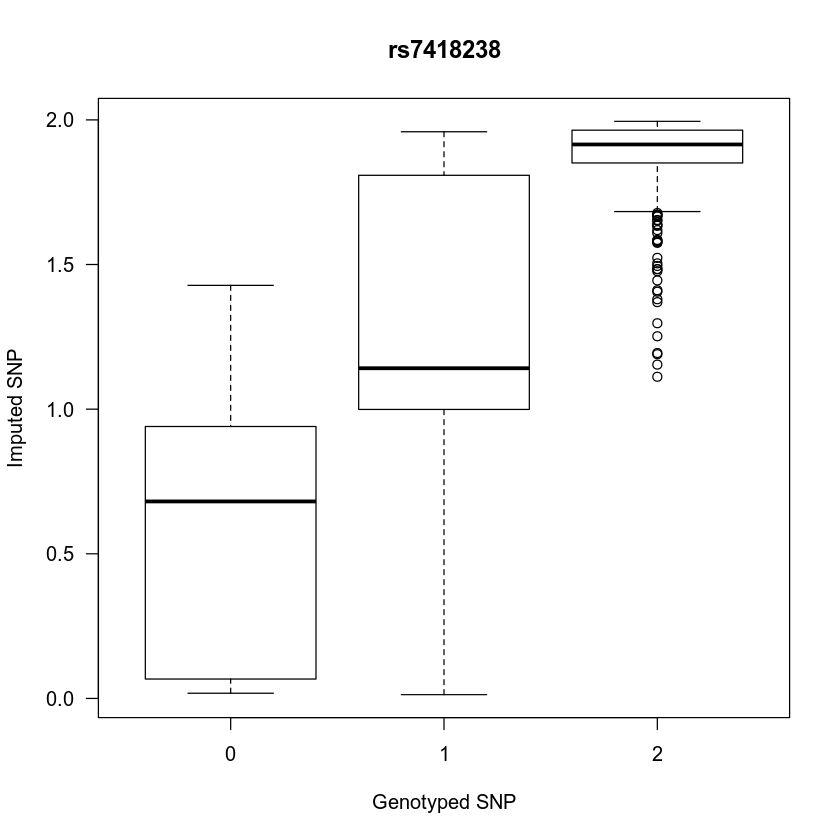


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.25080 -0.05275  0.03950  0.06350  0.86690 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.58110    0.03057   19.01   <2e-16 ***
rs75032062.y  0.67470    0.01660   40.66   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2082 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6788,	Adjusted R-squared:  0.6784 
F-statistic:  1653 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs75824728"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 40.657, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8000575 0.8451810
sample estimates:
      cor 
0.8239208 



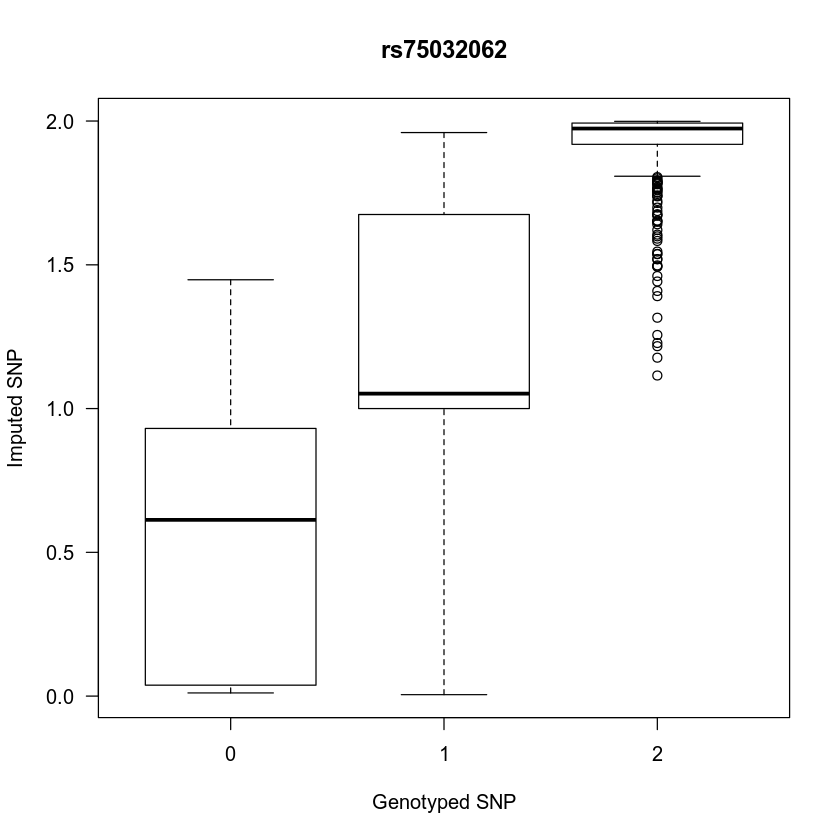


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.25215 -0.05077  0.03973  0.06273  0.86797 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.58003    0.03059   18.96   <2e-16 ***
rs75824728.y  0.67512    0.01661   40.66   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2083 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6788,	Adjusted R-squared:  0.6784 
F-statistic:  1653 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs115203657"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 41.342, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8049712 0.8490788
sample estimates:
     cor 
0.828304 



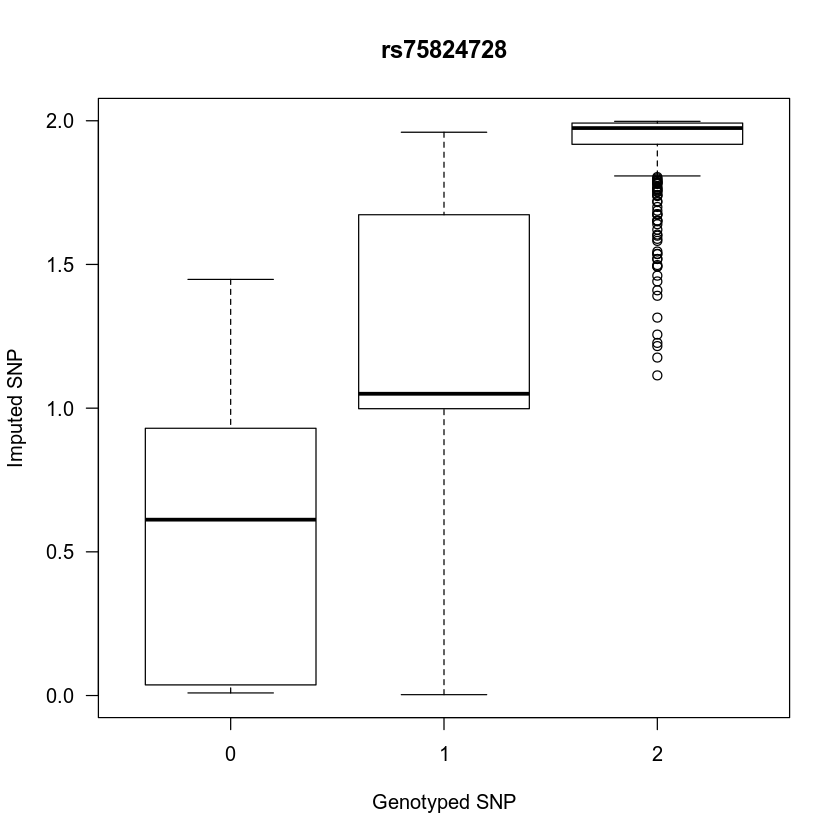


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.26212 -0.03958  0.03842  0.05342  0.84535 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.62065    0.02948   21.05   <2e-16 ***
rs115203657.y  0.66147    0.01600   41.34   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2008 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6861,	Adjusted R-squared:  0.6857 
F-statistic:  1709 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs77279721"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 41.317, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8047968 0.8489405
sample estimates:
      cor 
0.8281485 



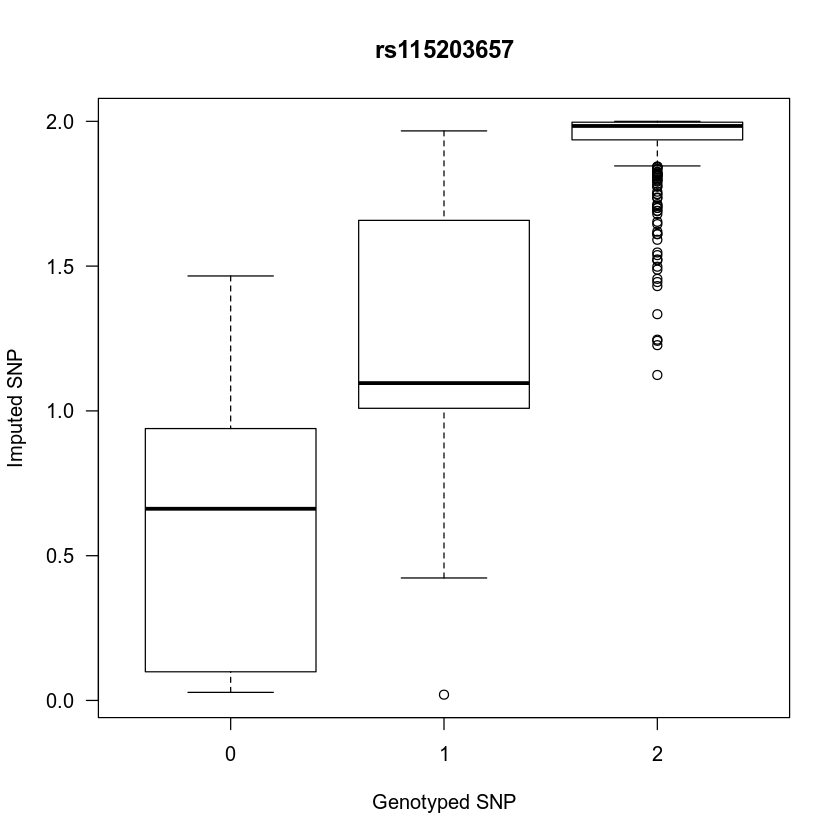


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.26458 -0.03994  0.03856  0.05356  0.84028 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.62272    0.02947   21.13   <2e-16 ***
rs77279721.y  0.66086    0.01599   41.32   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2007 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6858,	Adjusted R-squared:  0.6854 
F-statistic:  1707 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs6424157"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.281, df = 782, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7896755 0.8369298
sample estimates:
      cor 
0.8146504 



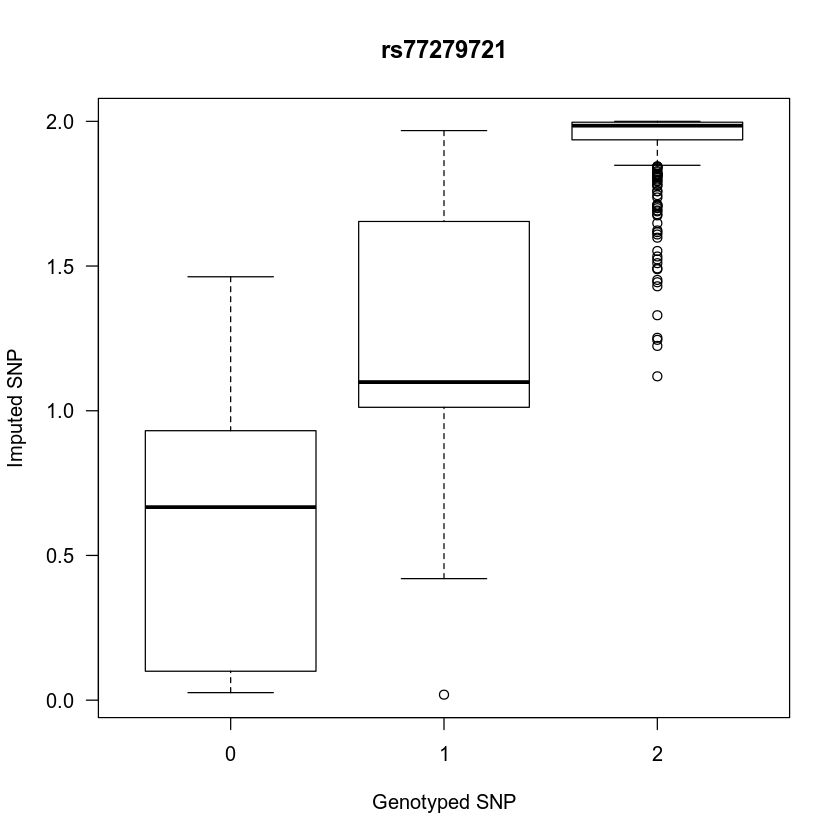


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.66867 -0.06657 -0.01757  0.04943  1.26533 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept) 0.090574   0.008046   11.26   <2e-16 ***
rs6424157.y 0.632093   0.016092   39.28   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.2024 on 782 degrees of freedom
  (49 observations deleted due to missingness)
Multiple R-squared:  0.6637,	Adjusted R-squared:  0.6632 
F-statistic:  1543 on 1 and 782 DF,  p-value: < 2.2e-16

[1] "rs11930543"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 71.402, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9171202 0.9362361
sample estimates:
      cor 
0.9272802 



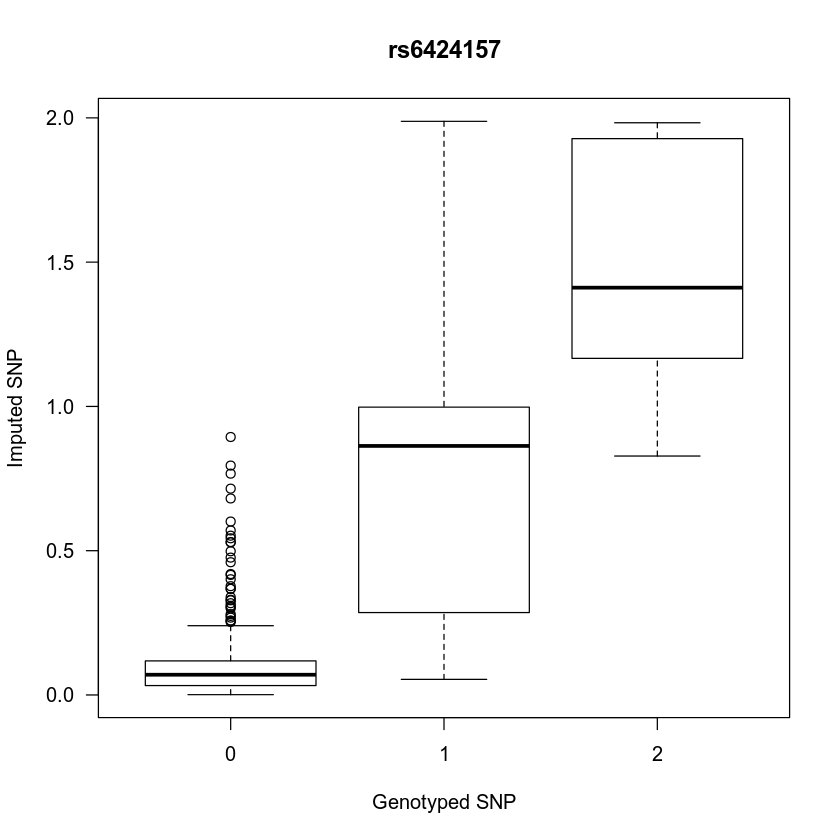


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.93254  0.00646  0.01546  0.01946  0.92187 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.17572    0.02377   7.391 3.54e-13 ***
rs11930543.y  0.89341    0.01251  71.402  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1277 on 831 degrees of freedom
Multiple R-squared:  0.8598,	Adjusted R-squared:  0.8597 
F-statistic:  5098 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs11936247"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 71.419, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9171540 0.9362623
sample estimates:
      cor 
0.9273099 



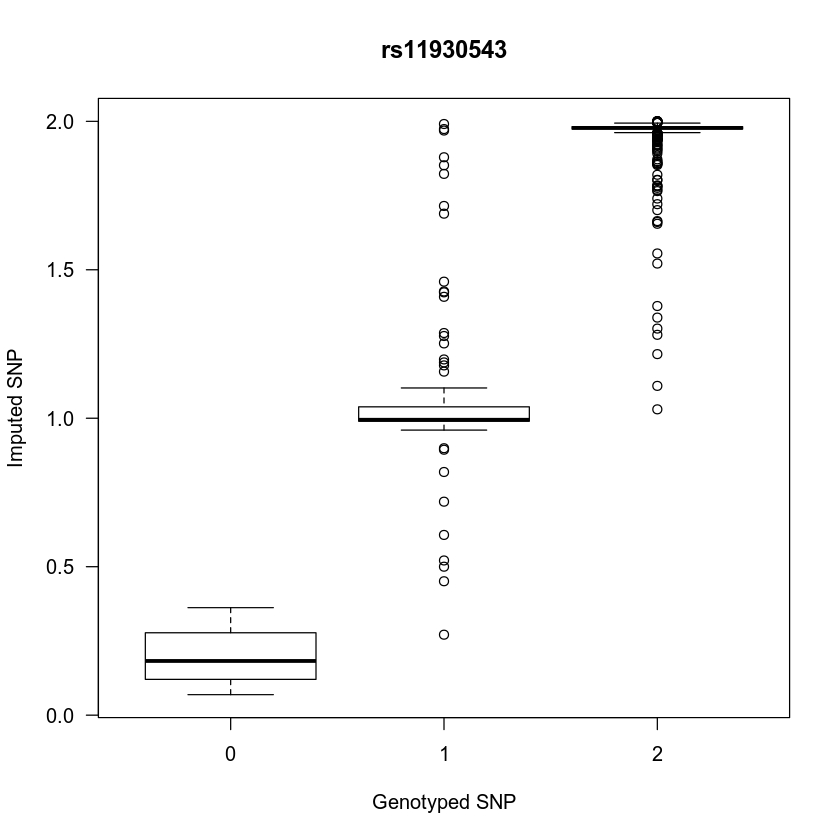


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.94682  0.00618  0.01718  0.02118  0.90556 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.18406    0.02377   7.745 2.79e-14 ***
rs11936247.y  0.89338    0.01251  71.419  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1277 on 831 degrees of freedom
Multiple R-squared:  0.8599,	Adjusted R-squared:  0.8597 
F-statistic:  5101 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs74448895"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 71.468, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9172547 0.9363406
sample estimates:
      cor 
0.9273988 



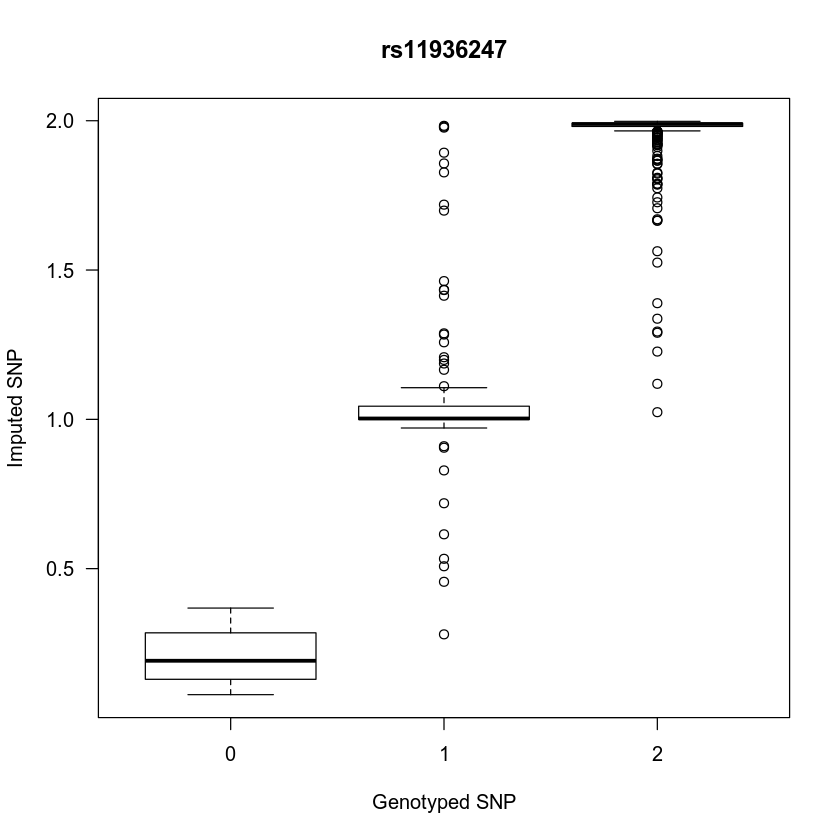


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.77669  0.00731  0.01531  0.01631  0.75550 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.50231    0.01968   25.53   <2e-16 ***
rs74448895.y  0.74019    0.01036   71.47   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1057 on 831 degrees of freedom
Multiple R-squared:  0.8601,	Adjusted R-squared:  0.8599 
F-statistic:  5108 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs74666929"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.547, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9153282 0.9348433
sample estimates:
      cor 
0.9256993 



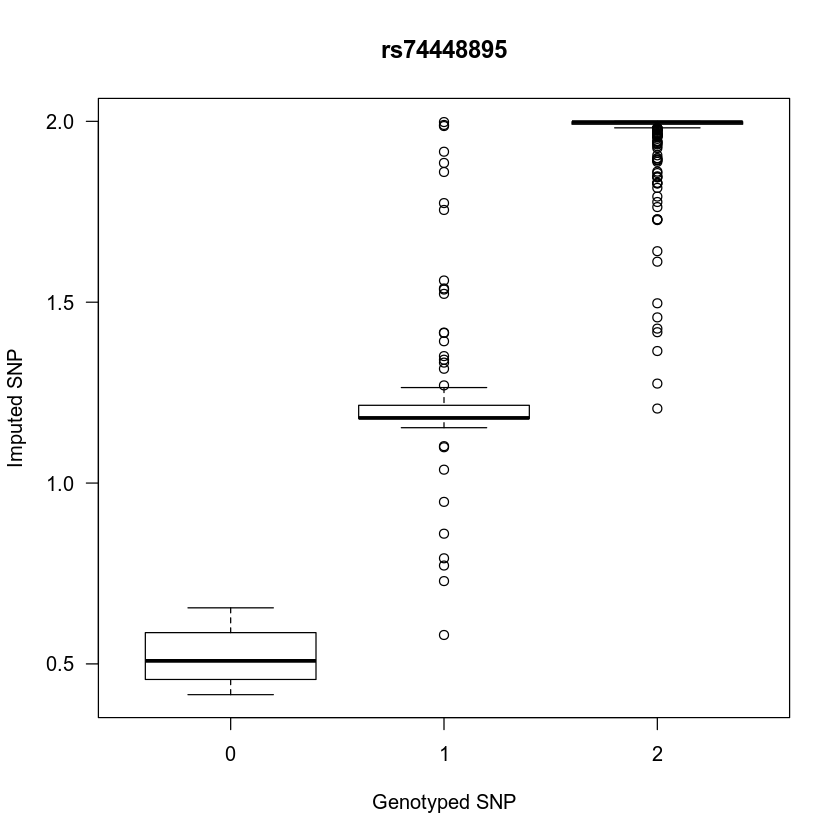


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.92815  0.00285  0.02085  0.02585  0.92001 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.18584    0.02400   7.743 2.82e-14 ***
rs74666929.y  0.89116    0.01263  70.547  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.129 on 831 degrees of freedom
Multiple R-squared:  0.8569,	Adjusted R-squared:  0.8567 
F-statistic:  4977 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs12500062"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.833, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9159328 0.9353133
sample estimates:
      cor 
0.9262327 



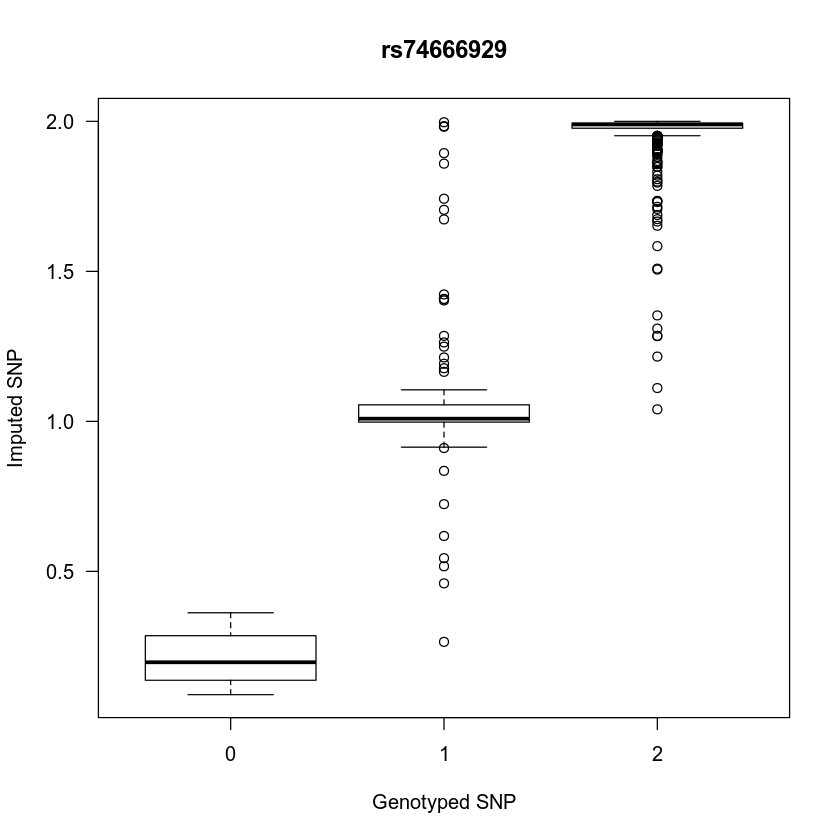


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.97685 -0.00185  0.01815  0.02515  0.90837 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.18141    0.02391   7.589 8.68e-14 ***
rs12500062.y  0.89122    0.01258  70.833  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1284 on 831 degrees of freedom
Multiple R-squared:  0.8579,	Adjusted R-squared:  0.8577 
F-statistic:  5017 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs7664431"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 71.104, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9165016 0.9357553
sample estimates:
      cor 
0.9267345 



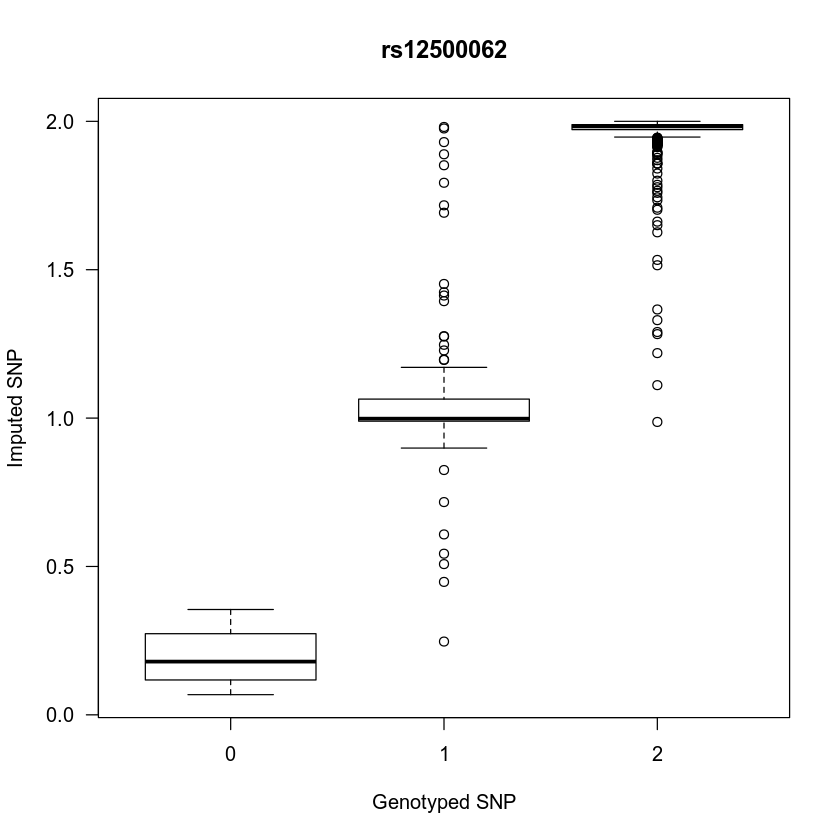


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.93804  0.00396  0.01596  0.02096  0.91834 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.18428    0.02382   7.737 2.95e-14 ***
rs7664431.y  0.89138    0.01254  71.104  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.128 on 831 degrees of freedom
Multiple R-squared:  0.8588,	Adjusted R-squared:  0.8587 
F-statistic:  5056 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs7664809"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.289, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9147771 0.9344149
sample estimates:
      cor 
0.9252131 



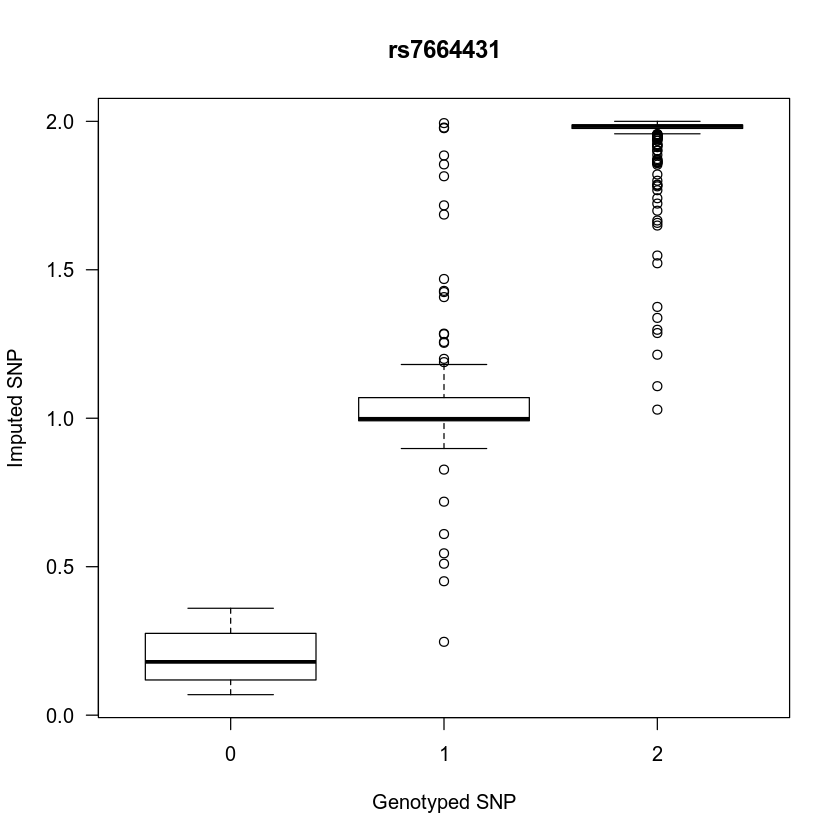


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.92955  0.00945  0.01745  0.01945  0.91927 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.18491    0.02403   7.696 3.97e-14 ***
rs7664809.y  0.88882    0.01265  70.289  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1291 on 831 degrees of freedom
Multiple R-squared:  0.856,	Adjusted R-squared:  0.8558 
F-statistic:  4941 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs7692077"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 64.995, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9022171 0.9246351
sample estimates:
      cor 
0.9141221 



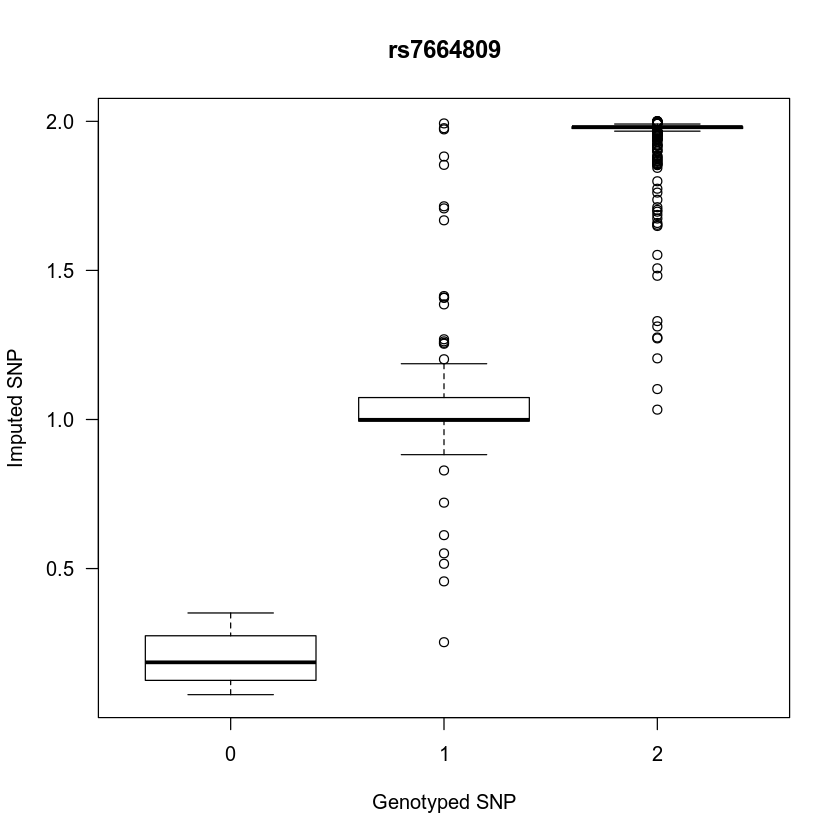


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.85719  0.00281  0.00981  0.01081  0.77391 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.46400    0.02213   20.96   <2e-16 ***
rs7692077.y  0.76209    0.01173   65.00   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1249 on 831 degrees of freedom
Multiple R-squared:  0.8356,	Adjusted R-squared:  0.8354 
F-statistic:  4224 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs56338475"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.964, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9162092 0.9355281
sample estimates:
      cor 
0.9264766 



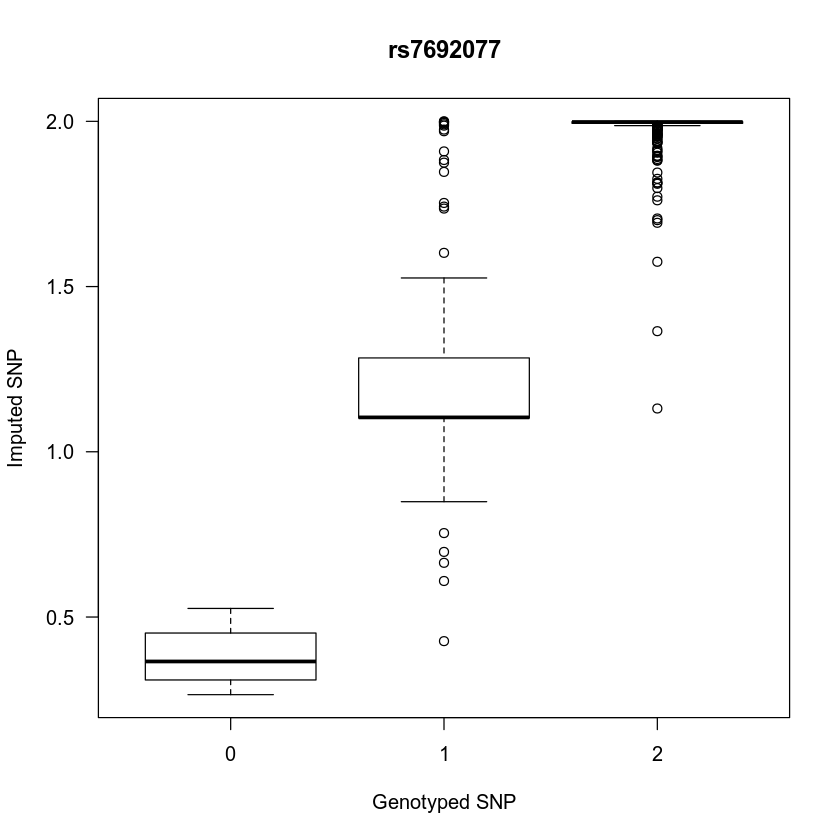


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.94236  0.00864  0.01764  0.01964  0.90747 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.19570    0.02388   8.196 9.38e-16 ***
rs56338475.y  0.89183    0.01257  70.964  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1283 on 831 degrees of freedom
Multiple R-squared:  0.8584,	Adjusted R-squared:  0.8582 
F-statistic:  5036 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs11947519"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.202, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9145891 0.9342687
sample estimates:
      cor 
0.9250472 



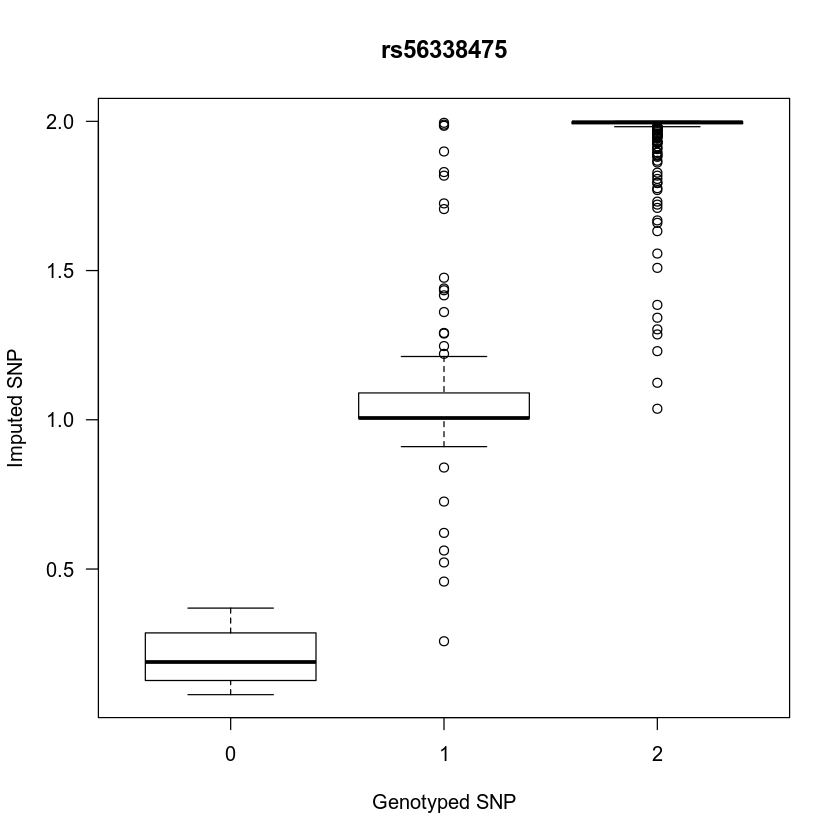


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.91938  0.00262  0.01762  0.02362  0.90091 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.21781    0.02369   9.195   <2e-16 ***
rs11947519.y  0.87529    0.01247  70.202   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1273 on 831 degrees of freedom
Multiple R-squared:  0.8557,	Adjusted R-squared:  0.8555 
F-statistic:  4928 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs76819305"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 69.467, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9129834 0.9330200
sample estimates:
      cor 
0.9236302 



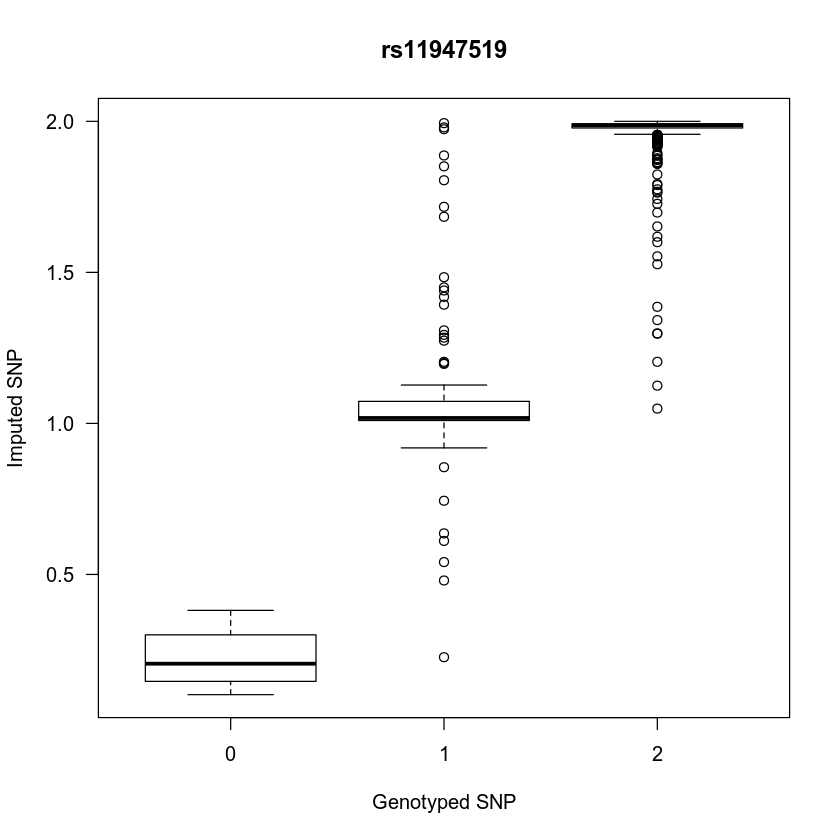


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.89596  0.01213  0.01713  0.01813  0.91004 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.19805    0.02441   8.115 1.75e-15 ***
rs76819305.y  0.89191    0.01284  69.467  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1306 on 831 degrees of freedom
Multiple R-squared:  0.8531,	Adjusted R-squared:  0.8529 
F-statistic:  4826 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs11944486"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 68.919, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9117595 0.9320680
sample estimates:
      cor 
0.9225501 



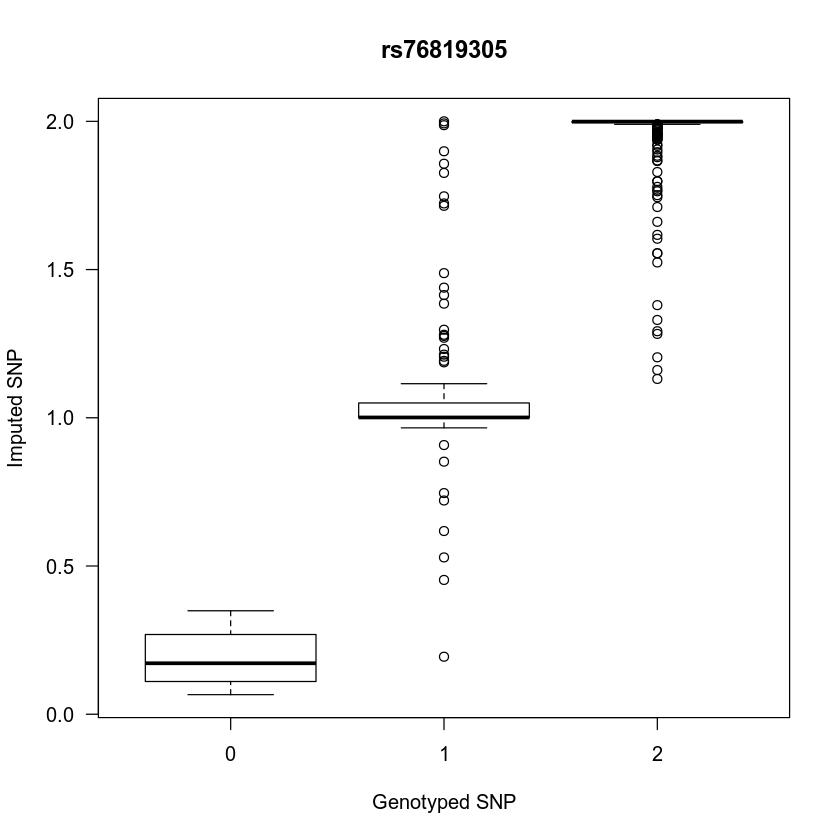


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.92129  0.00761  0.01661  0.01961  0.89971 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.21919    0.02425    9.04   <2e-16 ***
rs11944486.y  0.87910    0.01276   68.92   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1298 on 831 degrees of freedom
Multiple R-squared:  0.8511,	Adjusted R-squared:  0.8509 
F-statistic:  4750 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs56343694"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 68.35, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9104601 0.9310569
sample estimates:
     cor 
0.921403 



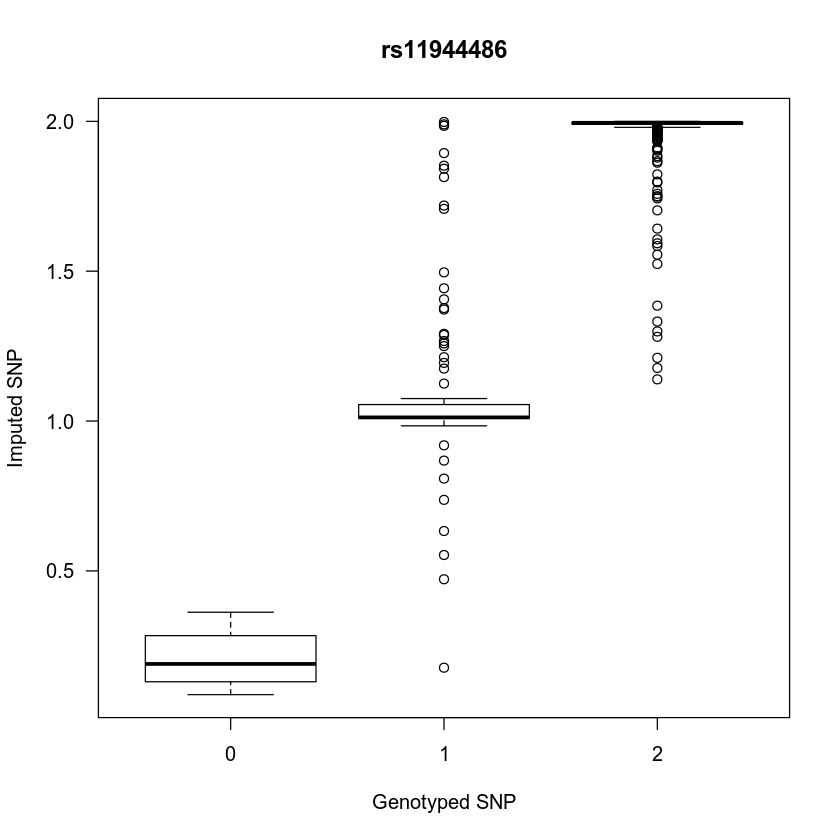


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.82847  0.00325  0.01725  0.01825  0.79553 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.42720    0.02162   19.76   <2e-16 ***
rs56343694.y  0.77728    0.01137   68.35   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1157 on 831 degrees of freedom
Multiple R-squared:  0.849,	Adjusted R-squared:  0.8488 
F-statistic:  4672 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs1895773"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.729, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9157128 0.9351423
sample estimates:
      cor 
0.9260386 



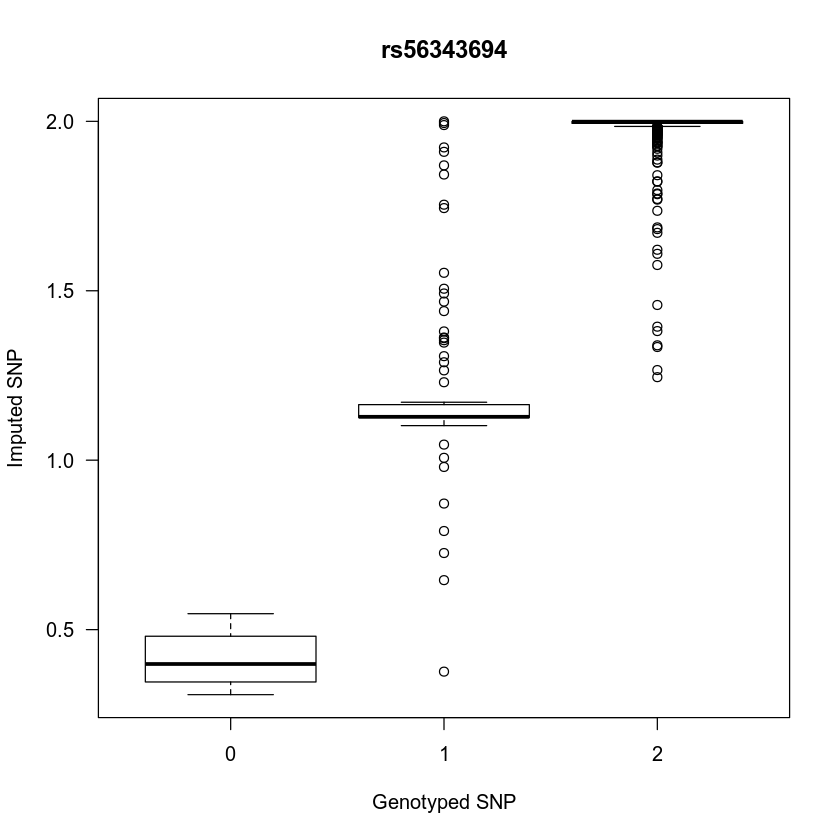


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.90677  0.01214  0.01614  0.01614  0.87923 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.25768    0.02318   11.12   <2e-16 ***
rs1895773.y  0.86209    0.01219   70.73   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1235 on 831 degrees of freedom
Multiple R-squared:  0.8575,	Adjusted R-squared:  0.8574 
F-statistic:  5003 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs111406186"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 68.103, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9098880 0.9306116
sample estimates:
     cor 
0.920898 



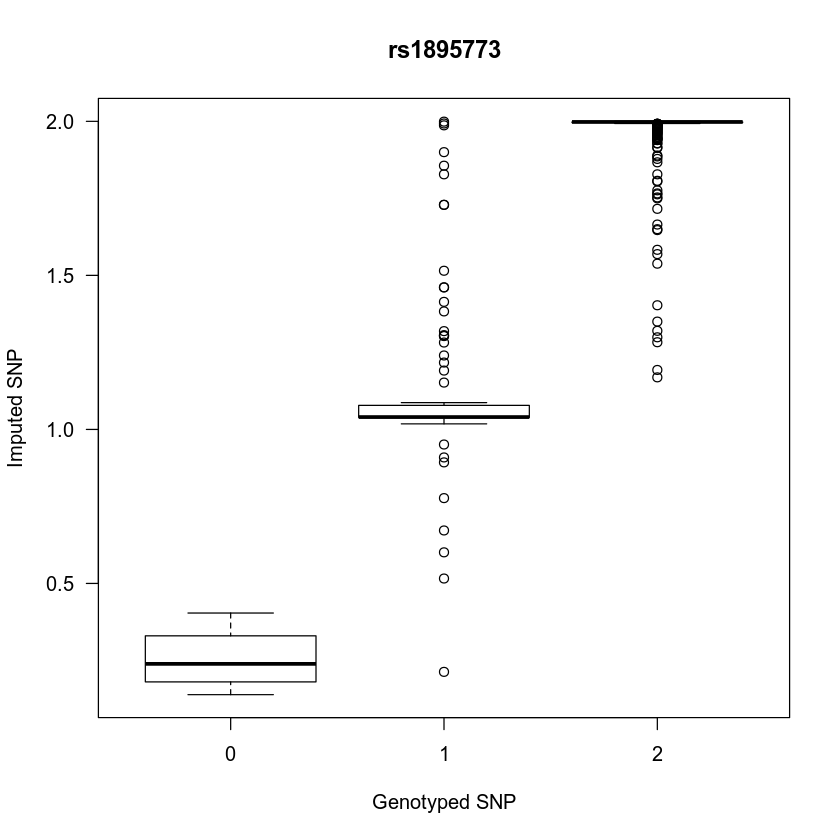


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.95767  0.01433  0.01733  0.01833  0.89504 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.22825    0.02451   9.314   <2e-16 ***
rs111406186.y  0.87671    0.01287  68.103   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1295 on 831 degrees of freedom
Multiple R-squared:  0.8481,	Adjusted R-squared:  0.8479 
F-statistic:  4638 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs113861051"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 52.68, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8606004 0.8920180
sample estimates:
      cor 
0.8772453 



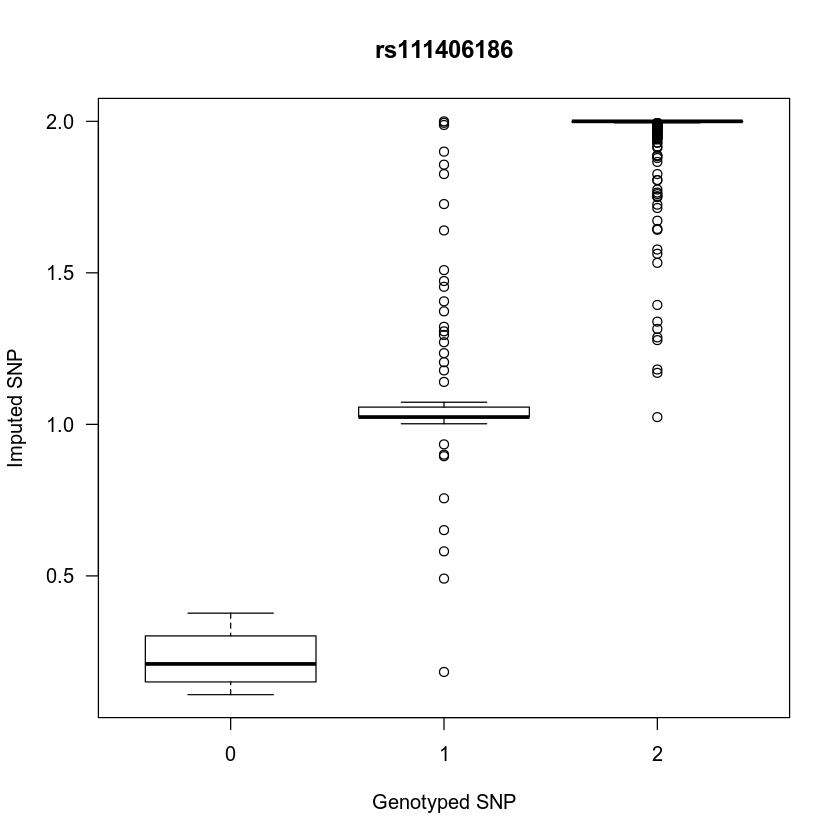


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.03634  0.01499  0.01999  0.02099  0.82466 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.37168    0.02887   12.87   <2e-16 ***
rs113861051.y  0.80366    0.01526   52.68   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1634 on 831 degrees of freedom
Multiple R-squared:  0.7696,	Adjusted R-squared:  0.7693 
F-statistic:  2775 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs111502567"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 63.686, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8987065 0.9218964
sample estimates:
     cor 
0.911019 



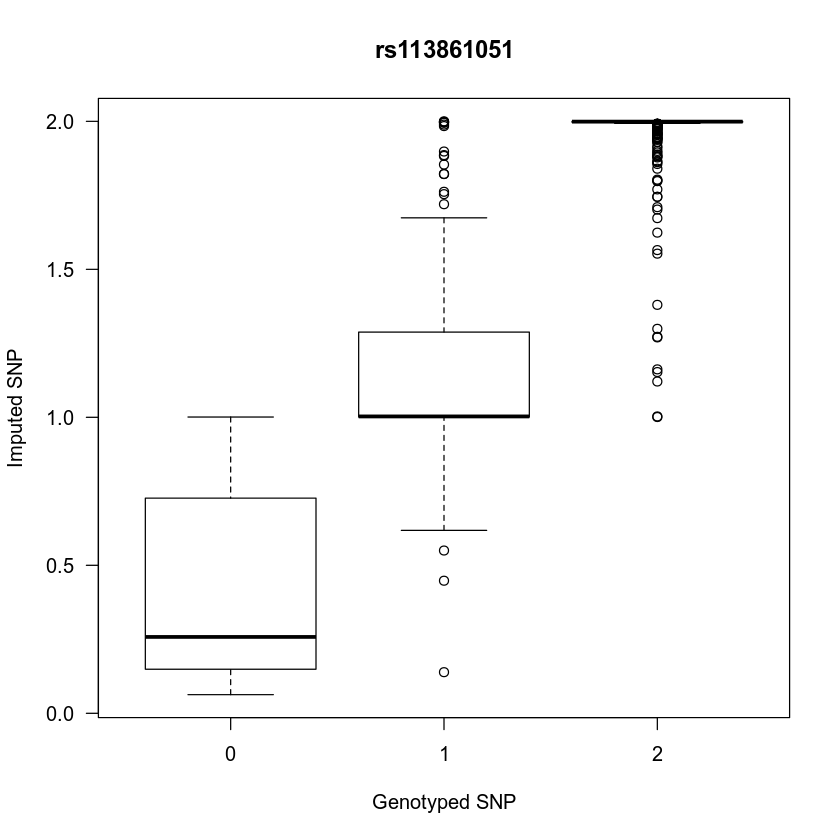


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.97273  0.01627  0.01927  0.02027  0.91549 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.19230    0.02661   7.227 1.12e-12 ***
rs111502567.y  0.88922    0.01396  63.686  < 2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1395 on 831 degrees of freedom
Multiple R-squared:   0.83,	Adjusted R-squared:  0.8298 
F-statistic:  4056 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs113491211"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 53.059, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8622272 0.8932992
sample estimates:
      cor 
0.8786905 



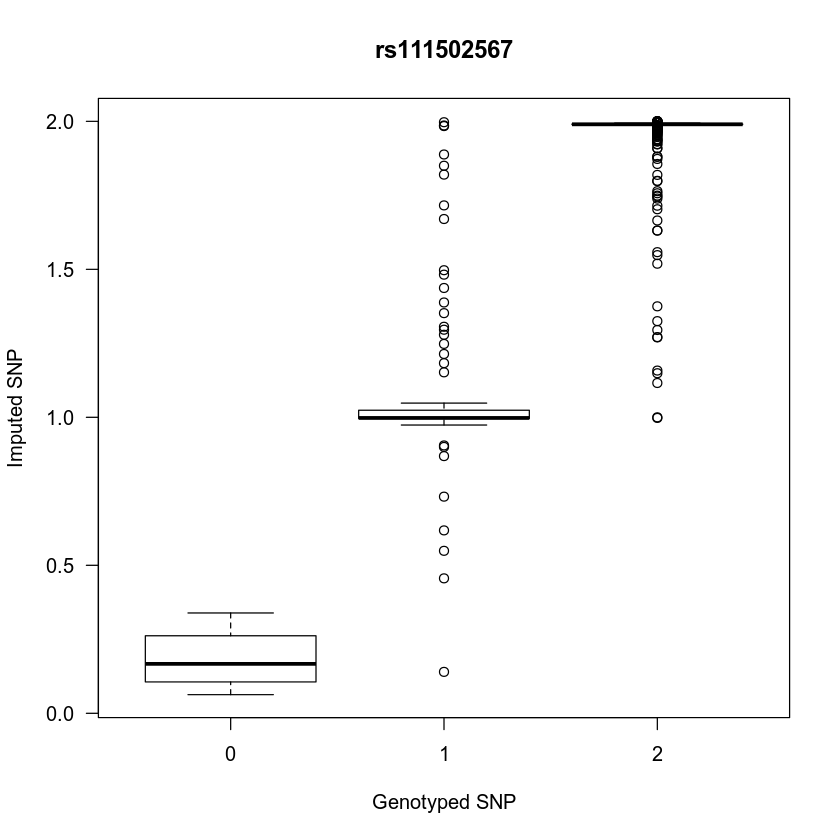


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.03646  0.01389  0.01589  0.01789  0.82454 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.37382    0.02856   13.09   <2e-16 ***
rs113491211.y  0.80064    0.01509   53.06   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1616 on 831 degrees of freedom
Multiple R-squared:  0.7721,	Adjusted R-squared:  0.7718 
F-statistic:  2815 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs7011565"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 40.394, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7897167 0.8356993
sample estimates:
      cor 
0.8139792 



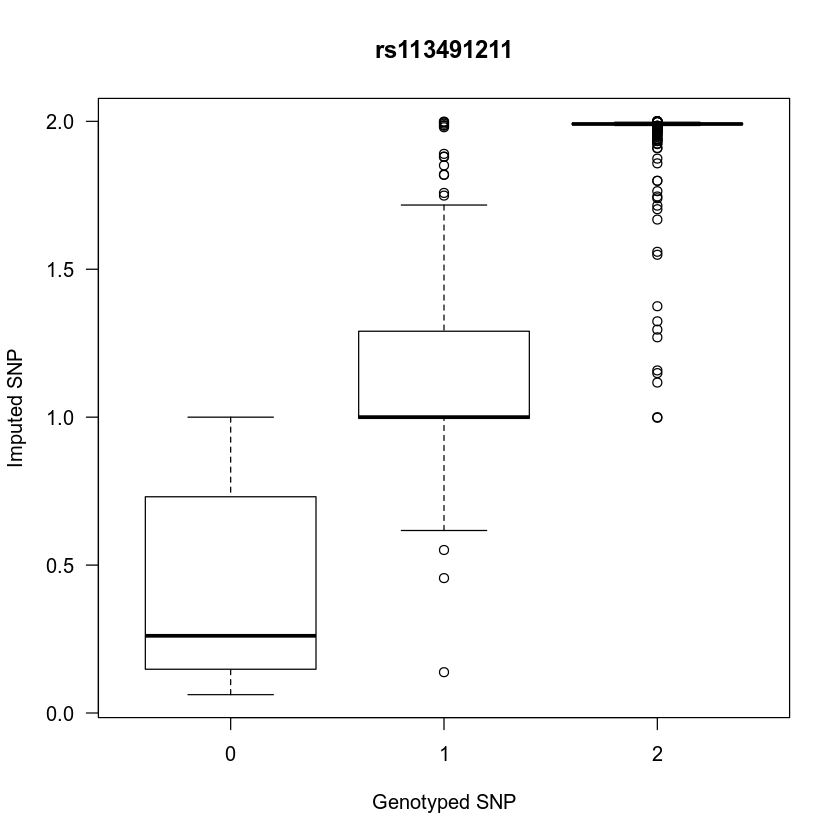


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
    Min      1Q  Median      3Q     Max 
-0.8364 -0.0104  0.0256  0.0426  0.6248 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.75803    0.02771   27.36   <2e-16 ***
rs7011565.y  0.59119    0.01464   40.39   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.153 on 831 degrees of freedom
Multiple R-squared:  0.6626,	Adjusted R-squared:  0.6622 
F-statistic:  1632 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs73249933"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 43.274, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8101182 0.8520085
sample estimates:
      cor 
0.8322474 



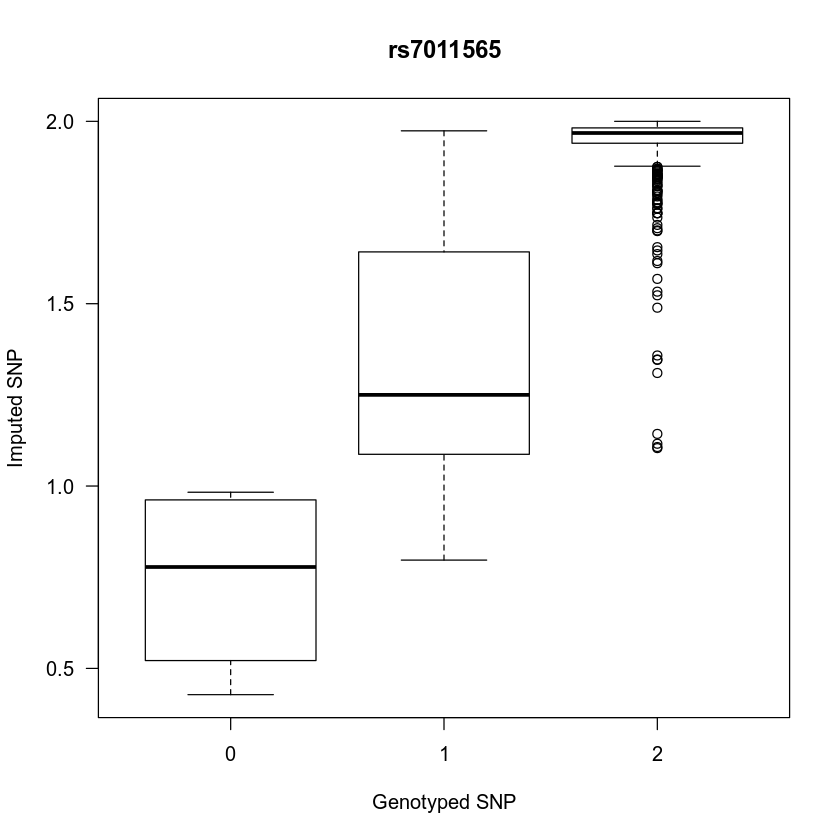


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.87916 -0.01416  0.02484  0.03984  0.67304 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.67577    0.02773   24.37   <2e-16 ***
rs73249933.y  0.63420    0.01466   43.27   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1537 on 831 degrees of freedom
Multiple R-squared:  0.6926,	Adjusted R-squared:  0.6923 
F-statistic:  1873 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs74197776"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 43.489, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8115296 0.8531338
sample estimates:
      cor 
0.8335095 



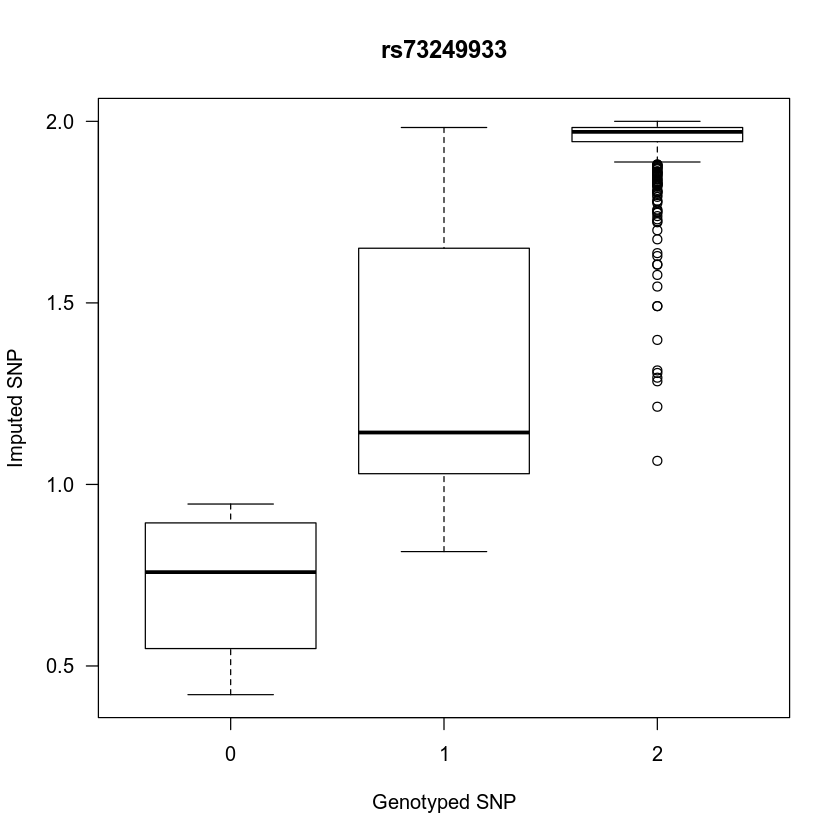


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.92518 -0.01018  0.03082  0.04182  0.68435 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.62913    0.02886   21.80   <2e-16 ***
rs74197776.y  0.66053    0.01519   43.49   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.155 on 831 degrees of freedom
Multiple R-squared:  0.6947,	Adjusted R-squared:  0.6944 
F-statistic:  1891 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs7816685"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 45.565, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8244801 0.8634410
sample estimates:
      cor 
0.8450788 



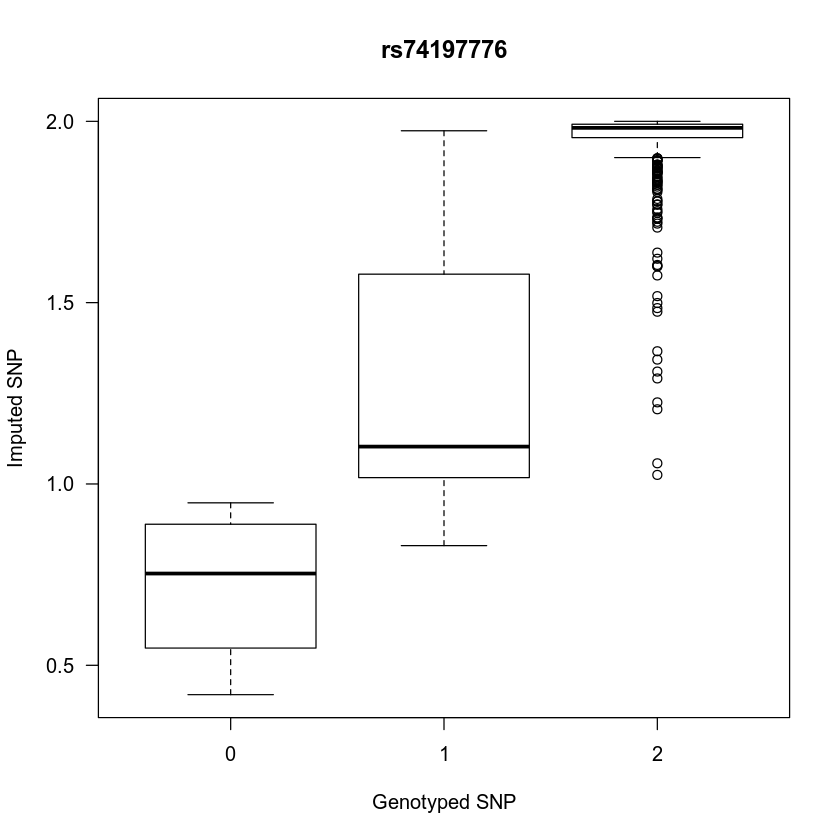


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-0.90135 -0.01035  0.02465  0.03365  0.66985 

Coefficients:
            Estimate Std. Error t value Pr(>|t|)    
(Intercept)  0.64795    0.02718   23.84   <2e-16 ***
rs7816685.y  0.65420    0.01436   45.56   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1501 on 831 degrees of freedom
Multiple R-squared:  0.7142,	Adjusted R-squared:  0.7138 
F-statistic:  2076 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs16906062"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 46.945, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8324173 0.8697422
sample estimates:
    cor 
0.85216 



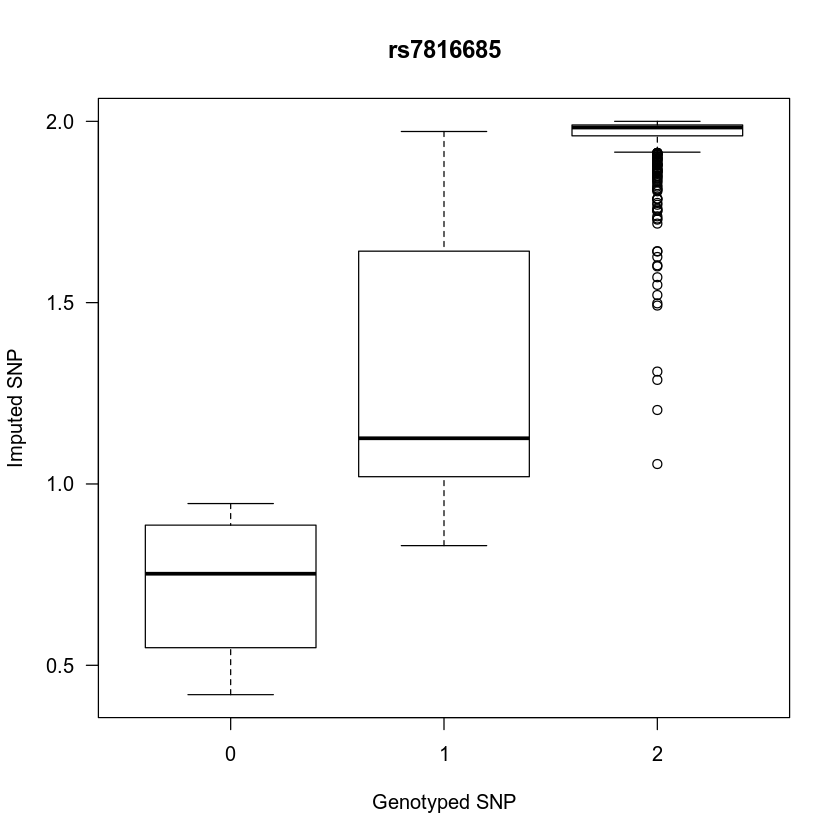


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
    Min      1Q  Median      3Q     Max 
-0.9008 -0.0108  0.0272  0.0362  0.6875 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.62123    0.02702   22.99   <2e-16 ***
rs16906062.y  0.66928    0.01426   46.95   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1481 on 831 degrees of freedom
Multiple R-squared:  0.7262,	Adjusted R-squared:  0.7258 
F-statistic:  2204 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs117355070"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 51.342, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8546503 0.8873278
sample estimates:
      cor 
0.8719568 



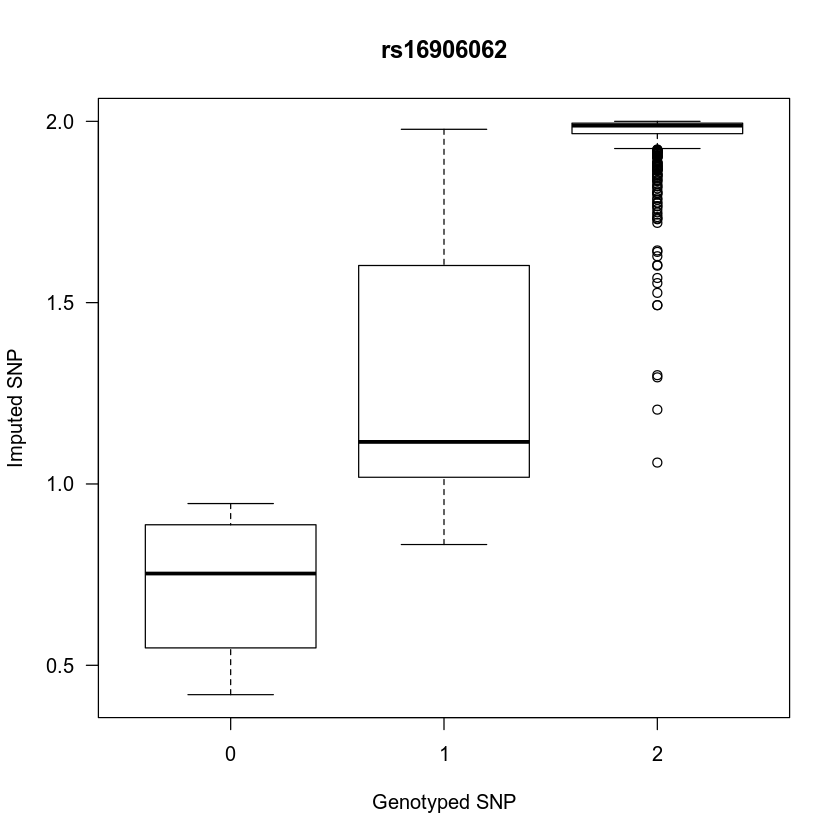


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.00373 -0.04773  0.03906  0.05806  0.80127 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.42052    0.02698   15.59   <2e-16 ***
rs117355070.y  0.75821    0.01477   51.34   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1935 on 831 degrees of freedom
Multiple R-squared:  0.7603,	Adjusted R-squared:   0.76 
F-statistic:  2636 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs116228140"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 50.829, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8522768 0.8854549
sample estimates:
     cor 
0.869846 



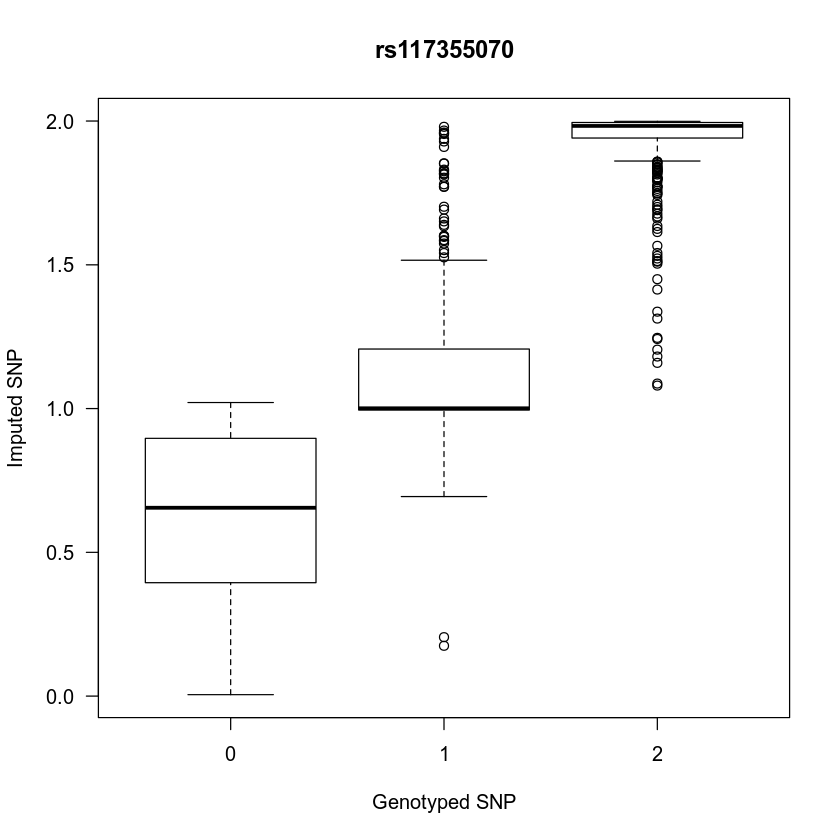


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.16242 -0.04942  0.03958  0.05858  0.79327 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.43705    0.02690   16.25   <2e-16 ***
rs116228140.y  0.74769    0.01471   50.83   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1922 on 831 degrees of freedom
Multiple R-squared:  0.7566,	Adjusted R-squared:  0.7563 
F-statistic:  2584 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs141792902"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 51.223, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8541070 0.8868991
sample estimates:
      cor 
0.8714737 



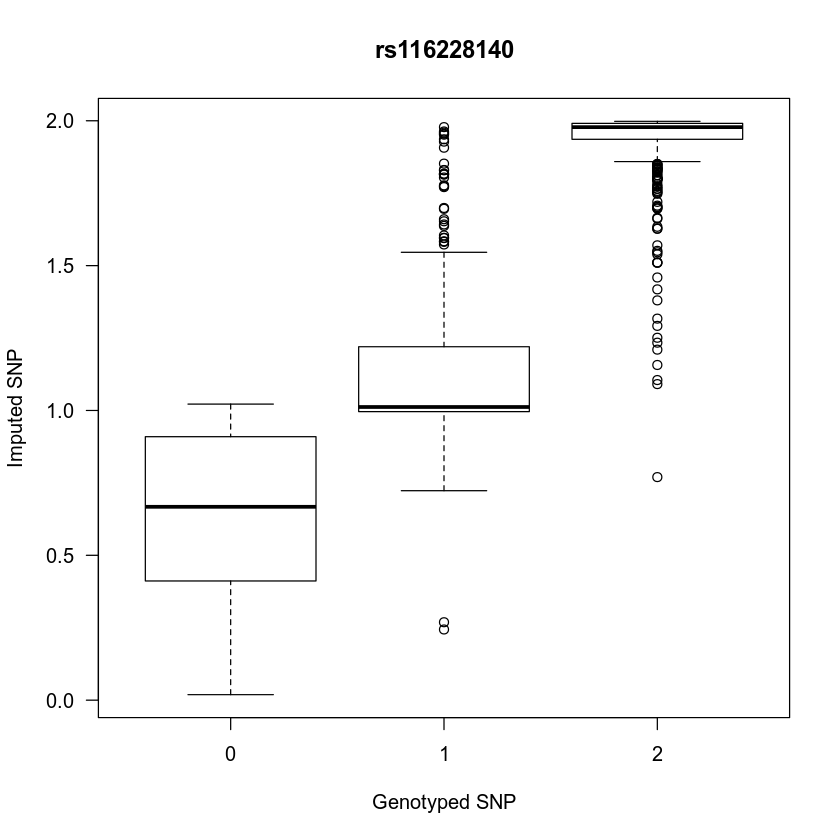


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.00315 -0.04578  0.03922  0.05722  0.80985 

Coefficients:
              Estimate Std. Error t value Pr(>|t|)    
(Intercept)    0.41753    0.02711   15.40   <2e-16 ***
rs141792902.y  0.76062    0.01485   51.22   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1949 on 831 degrees of freedom
Multiple R-squared:  0.7595,	Adjusted R-squared:  0.7592 
F-statistic:  2624 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs73251644"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 47.801, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8370971 0.8734516
sample estimates:
      cor 
0.8563317 



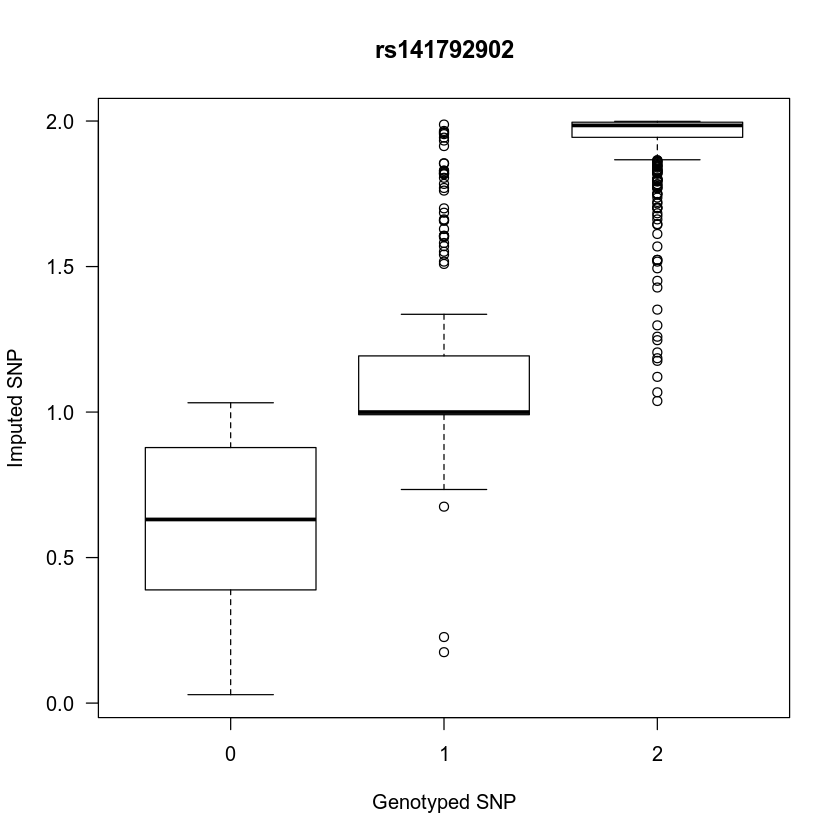


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.05568 -0.00868  0.03632  0.04332  0.75959 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.46813    0.02946   15.89   <2e-16 ***
rs73251644.y  0.74327    0.01555   47.80   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.1635 on 831 degrees of freedom
Multiple R-squared:  0.7333,	Adjusted R-squared:  0.733 
F-statistic:  2285 on 1 and 831 DF,  p-value: < 2.2e-16

[1] "rs16906115"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 41.825, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8002028 0.8440922
sample estimates:
      cor 
0.8233748 



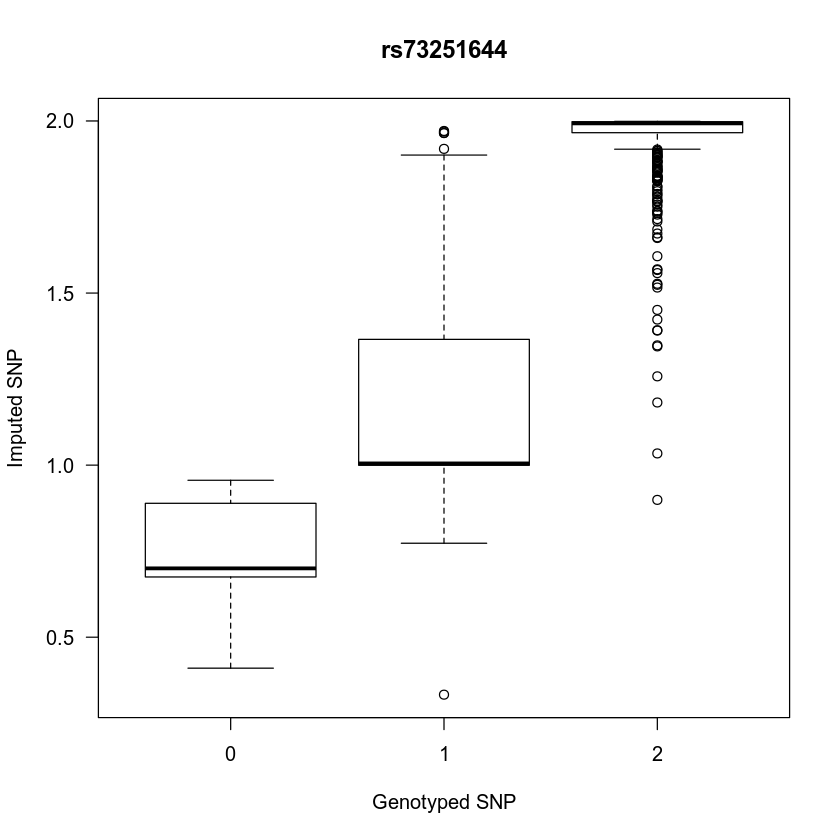


Call:
lm(formula = as.formula(formul), data = temp)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.10481 -0.01214  0.04886  0.06086  0.67719 

Coefficients:
             Estimate Std. Error t value Pr(>|t|)    
(Intercept)   0.64248    0.02872   22.37   <2e-16 ***
rs16906115.y  0.64633    0.01545   41.83   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

Residual standard error: 0.188 on 831 degrees of freedom
Multiple R-squared:  0.6779,	Adjusted R-squared:  0.6776 
F-statistic:  1749 on 1 and 831 DF,  p-value: < 2.2e-16



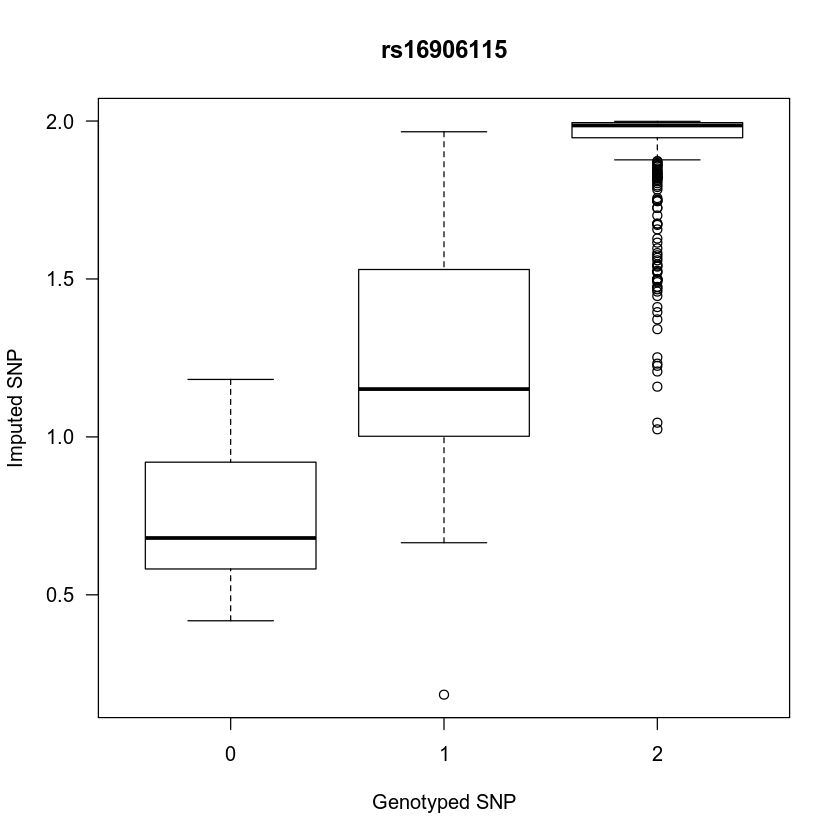

In [18]:
options(repr.plot.width=7,repr.plot.height=7)

temp <- inner_join(inner_join(translate_sid,GWAS_Profile),GWAS_PBB,by=c("BLNUM"="BLNUM"))
transform_df <- data.frame()
for (snp in snp_pred$SNP) {
    formul <- paste(snp,".x ~ ",snp,".y",sep="")
    print(snp)
    cor_res <- cor.test(temp[,paste(snp,".x",sep="")],temp[,paste(snp,".y",sep="")])
    print(cor_res)
    boxplot(as.formula(formul),temp, xlab="Genotyped SNP" , ylab="Imputed SNP", main=snp , las=1)
    lm.result <- summary(lm(as.formula(formul),temp))
    print(lm.result)
    temp_df <- data.frame(SNP=snp,cor=unlist(cor_res$estimate[[1]]),intercept=lm.result$coefficients[1,1],coef=lm.result$coefficients[2,1])
    transform_df <- rbind(transform_df,temp_df)
    GWAS[,paste(snp,"_norm",sep="")] <- ((GWAS[,snp]-lm.result$coefficients[1,1])/lm.result$coefficients[2,1])
}

In [19]:
transform_df %>% filter(SNP %in% c("rs16906115","rs75824728","rs113861051"))

SNP,cor,intercept,coef
<fct>,<dbl>,<dbl>,<dbl>
rs75824728,0.8239208,0.5800281,0.6751227
rs113861051,0.8772453,0.3716772,0.8036642
rs16906115,0.8233748,0.6424770,0.6463307


In [20]:
sum(GWAS$rs16906115_norm)/(2*length(GWAS$rs16906115_norm))
sum(GWAS$rs75824728_norm)/(2*length(GWAS$rs75824728_norm))
sum(GWAS$rs113861051_norm)/(2*length(GWAS$rs113861051_norm))

[1] 0.9183061

[1] 0.9019913

[1] 0.9349369

###### find map to REF/anyALT

In [21]:
temp <- inner_join(inner_join(translate_sid,GWAS_Profile),GWAS_PBB,by=c("BLNUM"="BLNUM"))

temp <- glm(rs16906115.y<2 ~ rs16906115.x, temp %>% select(rs16906115.x,rs16906115.y),family="binomial")
summary(temp)
decision_boundary <- -temp$coefficients[[1]]/temp$coefficients[[2]]
print(decision_boundary)

Joining, by = "PBP"



Call:
glm(formula = rs16906115.y < 2 ~ rs16906115.x, family = "binomial", 
    data = temp %>% select(rs16906115.x, rs16906115.y))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-2.7273  -0.2395  -0.2153  -0.2097   2.6789  

Coefficients:
             Estimate Std. Error z value Pr(>|z|)    
(Intercept)   11.5808     1.0079   11.49   <2e-16 ***
rs16906115.x  -7.7015     0.5861  -13.14   <2e-16 ***
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

(Dispersion parameter for binomial family taken to be 1)

    Null deviance: 779.43  on 832  degrees of freedom
Residual deviance: 296.69  on 831  degrees of freedom
AIC: 300.69

Number of Fisher Scoring iterations: 6


[1] 1.503709


In [22]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS <- inner_join(inner_join(OS,temp_trans),GWAS) %>% select(-PBP)
OS_GWAS_noleft <- make_multistate_noleft(OS_GWAS)
OS_GWAS_cur <- make_multistate_cur(OS_GWAS)
OS_GWAS_colitis <- make_multistate_type(OS_GWAS,"colitis")
OS_GWAS_skin <- make_multistate_type(OS_GWAS,"dermatitis")
OS_GWAS_thyroid <- make_multistate_type(OS_GWAS,"thyroid")
OS_GWAS_pneumo <- make_multistate_type(OS_GWAS,"pneu")
OS_GWAS_general <- make_multistate_type(OS_GWAS,"general")
OS_GWAS_hepa <- make_multistate_type(OS_GWAS,"hepa")
OS_GWAS_adrenal <- make_multistate_type(OS_GWAS,"adrenal")
OS_GWAS_other <- make_multistate_type(OS_GWAS,"mucositis|auto-immune|carditis|myositis|polyneuropathy|pancreatitis|nephritis|ketoacidosis|uveitis|sialadentitis")
OS_GWAS <- make_multistate(OS_GWAS)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"


$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  497  1353      602           2452
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.2026917 0.5517945 0.2455139
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  115  1353      602           2070
  AE                0    0    71       64            135
  Death             0    0     0     1424           1424

$Proportions
           to
from         Treatment         AE      Death   no event
  Treatment 0.00000000 0.05555556 0.65362319 0.29082126
  AE        0.00000000 0.00000000 0.52592593 0.47407407
  Death     0.00000000 0.00000000 0.00000000 1.00000000



In [21]:
get_irAE_freq <- function(dataframe,name) {
    temp_col <- dataframe %>% select(MRN,before_2018,trans,status,rs16906115,rs75824728,rs113861051) %>% mutate(rs16906115=ifelse(rs16906115>decision_boundary,"REF","ALT"),rs75824728=ifelse(rs75824728>decision_boundary,"REF","ALT"),rs113861051=ifelse(rs113861051>decision_boundary,"REF","ALT")) %>% filter(trans==1,before_2018==1) %>% select(-before_2018,-trans)
    t1 <- temp_col %>% group_by(rs16906115,status) %>% count %>% group_by(rs16906115) %>% mutate(freq=signif(n/sum(n),2)) %>% select(-n) %>% filter(status==1) %>% spread(rs16906115,freq,sep="_") %>% select(-status)
    t2 <- temp_col %>% group_by(rs75824728,status) %>% count %>% group_by(rs75824728) %>% mutate(freq=signif(n/sum(n),2)) %>% select(-n) %>% filter(status==1) %>% spread(rs75824728,freq,sep="_") %>% select(-status)
    t3 <- temp_col %>% group_by(rs113861051,status) %>% count %>% group_by(rs113861051) %>% mutate(freq=signif(n/sum(n),2)) %>% select(-n) %>% filter(status==1) %>% spread(rs113861051,freq,sep="_") %>% select(-status)
    return(cbind(data.frame(Carrier=as.character(paste0(name," frequency"))),cbind(cbind(t1,t2),t3)) %>% t)
}
temp_col <- get_irAE_freq(OS_GWAS_colitis,"Colitis")
temp_skin <- get_irAE_freq(OS_GWAS_skin,"Dermatitis/Rash")
temp_adren <- get_irAE_freq(OS_GWAS_adrenal,"Adrenal insufficiency")
temp_thyroid <- get_irAE_freq(OS_GWAS_thyroid,"Thyroid irAE")
temp_pneumo <- get_irAE_freq(OS_GWAS_pneumo,"Pneumonitis")
temp_hepa <- get_irAE_freq(OS_GWAS_hepa,"Hepatitis")
temp_other <- get_irAE_freq(OS_GWAS_other,"Other irAE")

cbind(cbind(cbind(cbind(cbind(cbind(temp_col,temp_other),temp_thyroid),temp_hepa),temp_adren),temp_pneumo),temp_skin)

Carrier,Colitis frequency,Other irAE frequency,Thyroid irAE frequency,Hepatitis frequency,Adrenal insufficiency frequency,Pneumonitis frequency,Dermatitis/Rash frequency
rs16906115_ALT,0.075,0.086,0.08,0.024,0.024,0.042,0.07
rs16906115_REF,0.057,0.042,0.025,0.014,0.016,0.031,0.04
rs75824728_ALT,0.07,0.11,0.042,0.036,0.036,0.048,0.075
rs75824728_REF,0.058,0.039,0.03,0.013,0.015,0.03,0.039
rs113861051_ALT,0.095,0.11,0.061,0.024,0.008,0.11,0.081
rs113861051_REF,0.056,0.04,0.029,0.015,0.018,0.024,0.04


In [22]:
snps <- names(OS_GWAS)[grepl("^rs",names(OS_GWAS)) & grepl("_norm",names(OS_GWAS)) & !grepl("\\.[1-3]",names(OS_GWAS))]
pvec_snps <- data.frame()
pb <- txtProgressBar(min = 0, max = length(snps), style = 3)
counter <- 0
for (name in snps) {
    meta <- meta_survival_AE(c(name),OS_GWAS %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    if (!is.null(dim(meta)[1])) {
       if (dim(meta)[1]>0) {
            names <- meta$variables
            pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
            haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
            temp <- data.frame(driver=names,hazard=haz,pval=pval)
            pvec_snps <- rbind(pvec_snps,temp)
        } 
    }
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}

pvec_snps <- pvec_snps %>% mutate(trans=gsub(".*\\.([1-3])","\\1",driver)) %>% filter(trans==1) %>% select(-trans)
pvec_snps <- inner_join(snp_pred %>% select(-driver,-pval_adjusted) %>% rename(hazard_notnorm=hazard,pval_notnorm=pval),pvec_snps %>% mutate(SNP=gsub("(.*)_norm\\.[1-3]","\\1",driver)),by="SNP")                                 
pvec_snps$pval_adjusted <- p.adjust(pvec_snps$pval, method = "BH")

pvec_snps %>% filter %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |==                                                                    |   3%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |====                                                                  |   5%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
  |=====                                                                 |   8%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign fun

allele,beta,HR,sd_beta,p,SNP,CHR,POS,hazard_notnorm,pval_notnorm,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>
8_79712998,-0.7764404,0.4600407,0.1583995,9.496875e-07,rs16906115,8,79712998,-1.0642826,3.792547e-09,rs16906115_norm.1,-0.6878785,3.792547e-09,3.313652e-08
8_79557237,-0.9254063,0.3963703,0.1850539,5.711084e-07,rs7011565,8,79557237,-1.2406947,3.834902e-09,rs7011565_norm.1,-0.7334881,3.833661e-09,3.313652e-08
1_24464626,-0.7164209,0.4884975,0.1499036,1.759832e-06,rs75824728,1,24464626,-0.9635767,9.071852e-09,rs75824728_norm.1,-0.6521463,8.358853e-09,3.313652e-08
1_24464592,-0.7162412,0.4885853,0.1500095,1.800297e-06,rs75032062,1,24464592,-0.9634600,9.311920e-09,rs75032062_norm.1,-0.6500462,9.311920e-09,3.313652e-08
4_34448039,-0.6154995,0.5403709,0.1387381,9.147067e-06,rs113861051,4,34448039,-0.8844755,1.125531e-08,rs113861051_norm.1,-0.7108213,1.125531e-08,3.313652e-08
1_24471579,-0.7295071,0.4821466,0.1535199,2.015418e-06,rs115203657,1,24471579,-0.9777271,1.137381e-08,rs115203657_norm.1,-0.6467368,1.137381e-08,3.313652e-08
4_34449543,-0.6246202,0.5354648,0.1387057,6.693589e-06,rs113491211,4,34449543,-0.8824854,1.197602e-08,rs113491211_norm.1,-0.7065544,1.197602e-08,3.313652e-08
4_34448159,-0.6247052,0.5354193,0.1388476,6.820494e-06,rs111502567,4,34448159,-0.8828740,1.223875e-08,rs111502567_norm.1,-0.7850652,1.223875e-08,3.313652e-08
1_24472064,-0.7261833,0.4837518,0.1534913,2.233019e-06,rs77279721,1,24472064,-0.9745137,1.241377e-08,rs77279721_norm.1,-0.6440158,1.241377e-08,3.313652e-08


In [94]:
fwrite(pvec_snps %>% filter(pval < 5e-8),"IL7_genomewidesignif_norm.csv")

In [202]:
temp <- OS_GWAS %>%
        mutate(rs16906115_norm=2-rs16906115_norm,
               rs75824728_norm=2-rs75824728_norm,
               rs113861051_norm=2-rs113861051_norm) %>% 
        filter(before_2018==1,GWAS_avail)
temp <- inner_join(
    temp %>% distinct(MRN) %>% mutate(ID=c(1:length(MRN))),temp,by="MRN") %>%
        select(ID,Tstart,Tstop,trans,status,CANCER_TYPE,PROFILE_AFTER_TREATMENT,GENDER,AGE_AT_TREATMENTSTART,PANEL_VERSION,START_YEAR,LINE_OF_TREATMENT,TREATMENT_CUM,CONC_CHEMO,ANCESTRY_ROT_PC1,ANCESTRY_ROT_PC2,ANCESTRY_PC_ASH,ANCESTRY_PC_NS,rs16906115_norm,rs75824728_norm,rs113861051_norm)
fwrite(temp,"irAE_data_deidentified.csv")   

temp <- OS_GWAS_cur %>%
        mutate(rs16906115_norm=2-rs16906115_norm,
               rs75824728_norm=2-rs75824728_norm,
               rs113861051_norm=2-rs113861051_norm) %>% 
        filter(before_2018==1,GWAS_avail)
temp <- inner_join(
    temp %>% distinct(MRN) %>% mutate(ID=c(1:length(MRN))),temp,by="MRN") %>%
        select(ID,Tstart,Tstop,trans,status,CANCER_TYPE,PROFILE_AFTER_TREATMENT,GENDER,AGE_AT_TREATMENTSTART,PANEL_VERSION,START_YEAR,LINE_OF_TREATMENT,TREATMENT_CUM,CONC_CHEMO,ANCESTRY_ROT_PC1,ANCESTRY_ROT_PC2,ANCESTRY_PC_ASH,ANCESTRY_PC_NS,rs16906115_norm,rs75824728_norm,rs113861051_norm)
fwrite(temp,"irAE_curated_data_deidentified.csv")

In [23]:
temp <- OS_GWAS %>%
        mutate(rs16906115_norm=2-rs16906115_norm,
               rs75824728_norm=2-rs75824728_norm,
               rs113861051_norm=2-rs113861051_norm) %>% 
        filter(before_2018==1,GWAS_avail)
temp <- inner_join(
    temp %>% distinct(MRN) %>% mutate(ID=c(1:length(MRN))),temp,by="MRN") %>%
        select(MRN,Tstart,Tstop,trans,status,CANCER_TYPE,PROFILE_AFTER_TREATMENT,GENDER,AGE_AT_TREATMENTSTART,PANEL_VERSION,START_YEAR,LINE_OF_TREATMENT,TREATMENT_CUM,CONC_CHEMO,ANCESTRY_ROT_PC1,ANCESTRY_ROT_PC2,ANCESTRY_PC_ASH,ANCESTRY_PC_NS,rs16906115_norm,rs75824728_norm,rs113861051_norm)
fwrite(temp,"irAE_data_identified.csv")

temp <- OS_GWAS_cur %>%
        mutate(rs16906115_norm=2-rs16906115_norm,
               rs75824728_norm=2-rs75824728_norm,
               rs113861051_norm=2-rs113861051_norm) %>% 
        filter(before_2018==1,GWAS_avail)
temp <- inner_join(
    temp %>% distinct(MRN) %>% mutate(ID=c(1:length(MRN))),temp,by="MRN") %>%
        select(MRN,Tstart,Tstop,trans,status,CANCER_TYPE,PROFILE_AFTER_TREATMENT,GENDER,AGE_AT_TREATMENTSTART,PANEL_VERSION,START_YEAR,LINE_OF_TREATMENT,TREATMENT_CUM,CONC_CHEMO,ANCESTRY_ROT_PC1,ANCESTRY_ROT_PC2,ANCESTRY_PC_ASH,ANCESTRY_PC_NS,rs16906115_norm,rs75824728_norm,rs113861051_norm)
fwrite(temp,"irAE_curated_data_identified.csv")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"


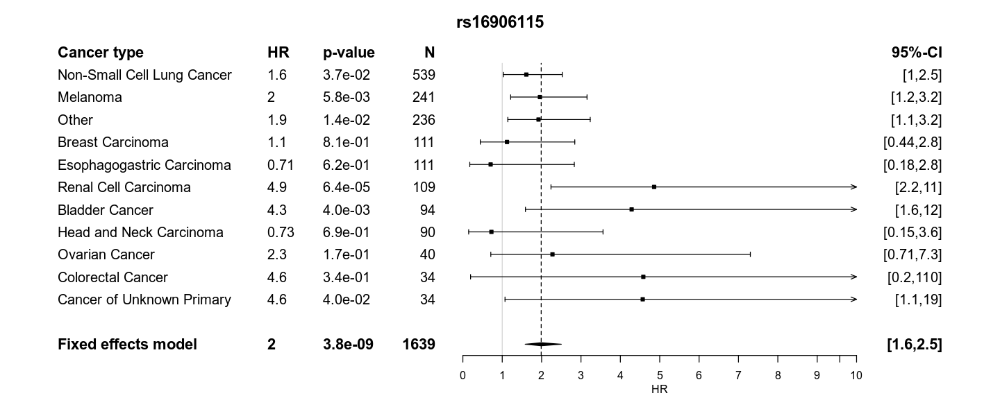

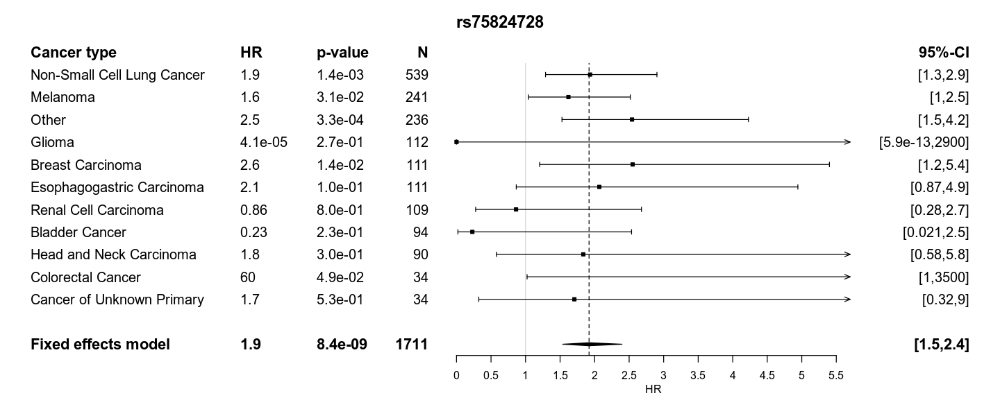

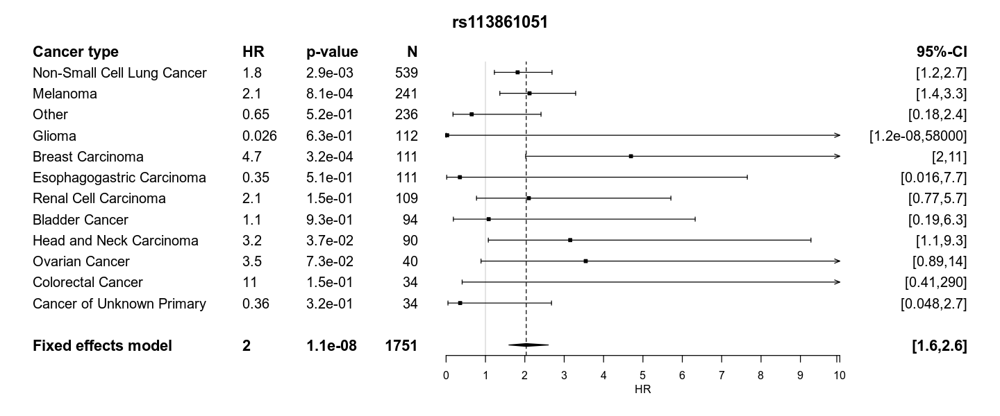

In [38]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs16906115_norm"),OS_GWAS %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1),plot=F)
tr2 <- meta_survival_AE(c("rs75824728_norm"),OS_GWAS %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% filter(before_2018==1),plot=F)
tr3 <- meta_survival_AE(c("rs113861051_norm"),OS_GWAS %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3) %>% filter(before_2018==1),plot=F)
options(options_save)

my_forest(tr1,"rs16906115_norm.1","rs16906115")
my_forest(tr2,"rs75824728_norm.1","rs75824728")
my_forest(tr3,"rs113861051_norm.1","rs113861051")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"


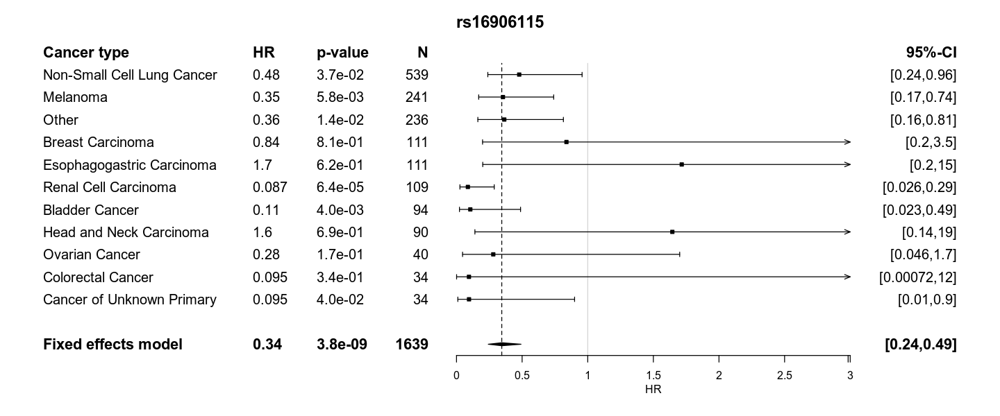

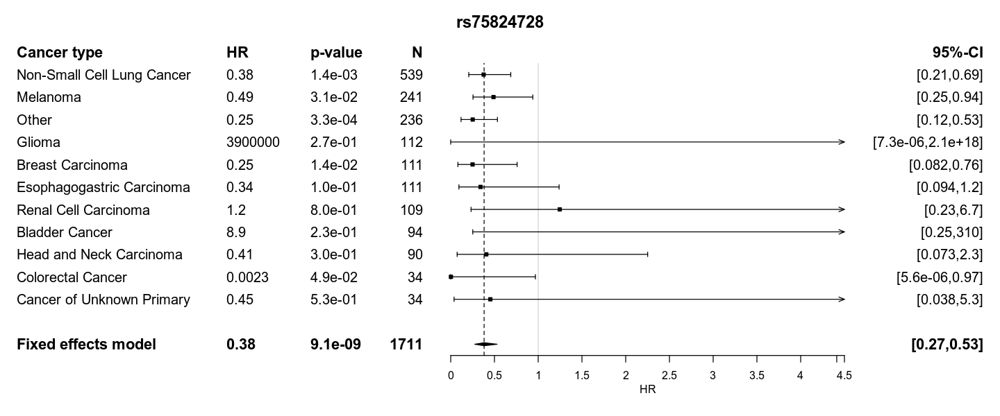

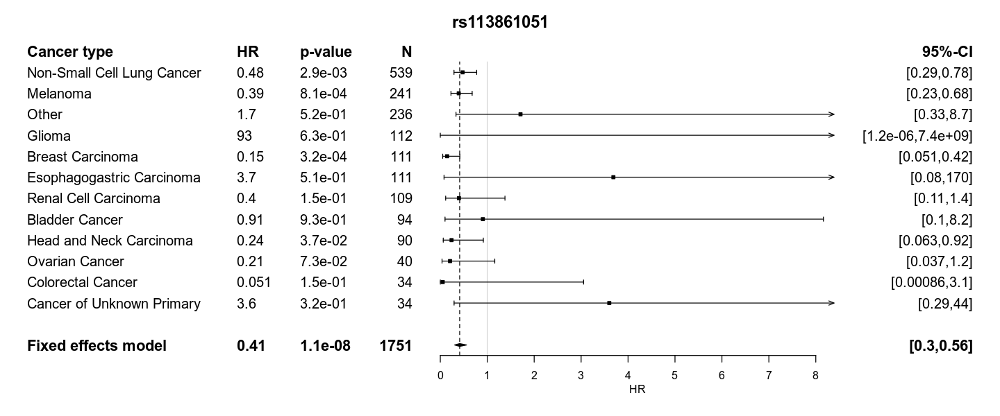

In [141]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs16906115"),OS_GWAS %>% filter(before_2018==1),plot=F)#,OS_GWAS %>% mutate(rs16906115.1=2-rs16906115.1,rs16906115.2=2-rs16906115.2,rs16906115.3=2-rs16906115.3) %>% filter(before_2018==1),plot=F)
tr2 <- meta_survival_AE(c("rs75824728"),OS_GWAS %>% filter(before_2018==1),plot=F)#,OS_GWAS %>% mutate(rs75824728.1=2-rs75824728.1,rs75824728.2=2-rs75824728.2,rs75824728.3=2-rs75824728.3) %>% filter(before_2018==1),plot=F)
tr3 <- meta_survival_AE(c("rs113861051"),OS_GWAS %>% filter(before_2018==1),plot=F)#,OS_GWAS %>% mutate(rs113861051.1=2-rs113861051.1,rs113861051.2=2-rs113861051.2,rs113861051.3=2-rs113861051.3) %>% filter(before_2018==1),plot=F)
options(options_save)

my_forest(tr1,"rs16906115.1","rs16906115")
my_forest(tr2,"rs75824728.1","rs75824728")
my_forest(tr3,"rs113861051.1","rs113861051")

In [16]:
dbinom(2, 11, 0.5)

[1] 0.02685547

In [39]:
OS_GWAS_colitis <- OS_GWAS_colitis %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_skin <- OS_GWAS_skin %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_thyroid <- OS_GWAS_thyroid %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_pneumo <- OS_GWAS_pneumo %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_general <- OS_GWAS_general %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_hepa <- OS_GWAS_hepa %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_adrenal <- OS_GWAS_adrenal %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)
OS_GWAS_other <- OS_GWAS_other %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Melanoma was unsuccesful"
[1] "Err

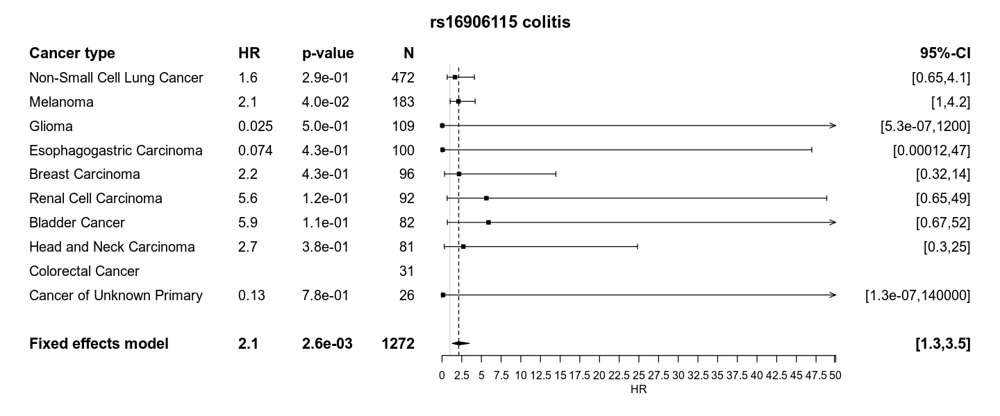

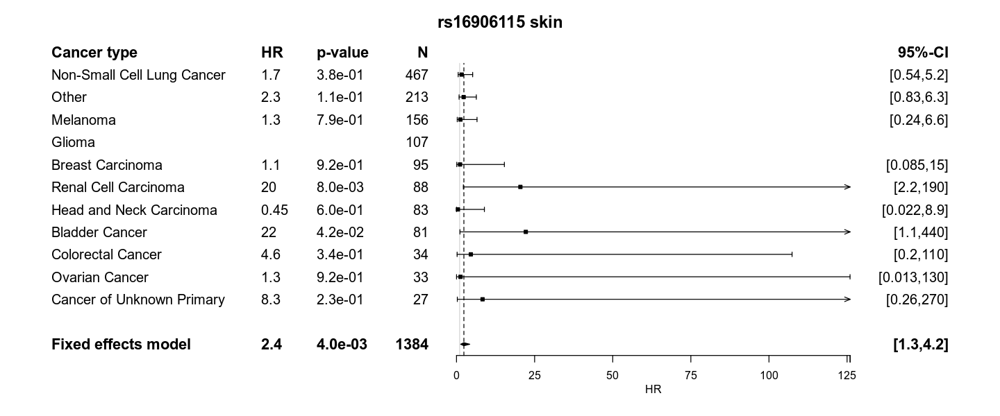

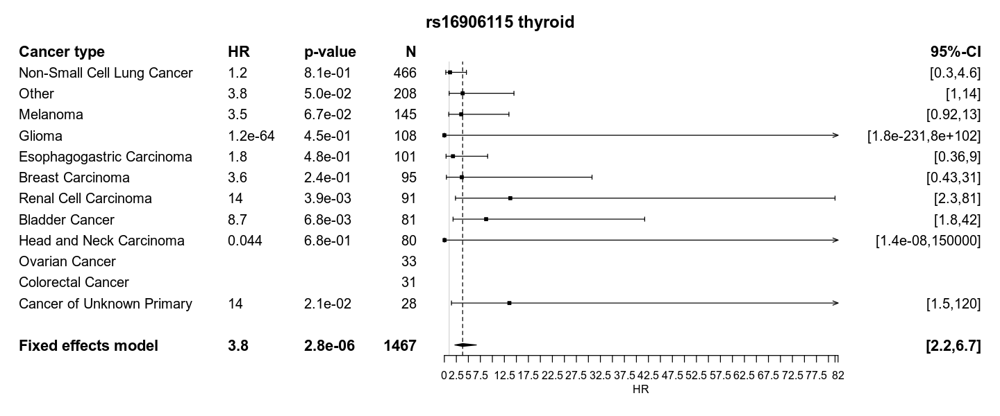

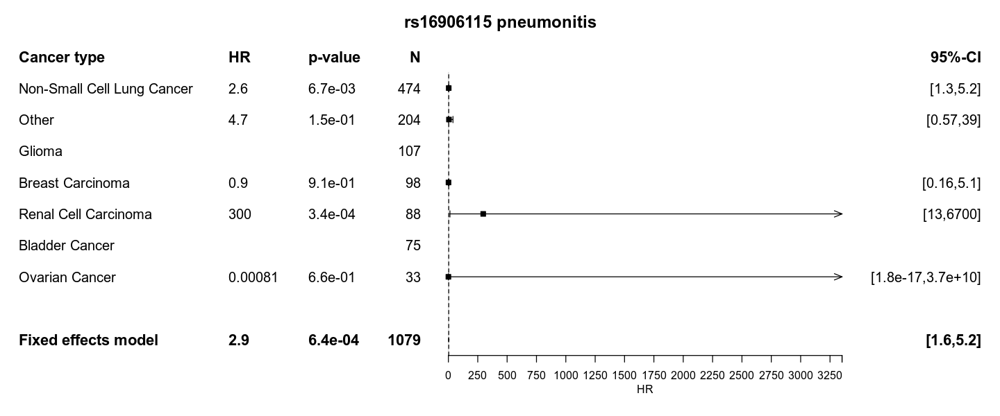

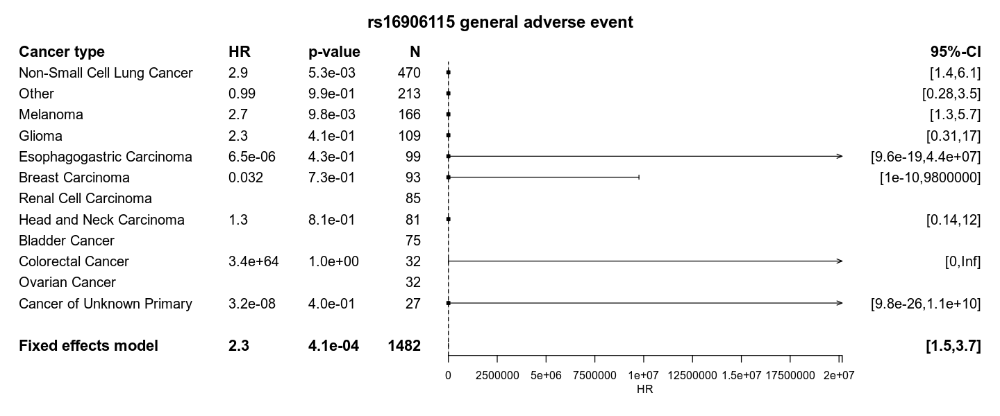

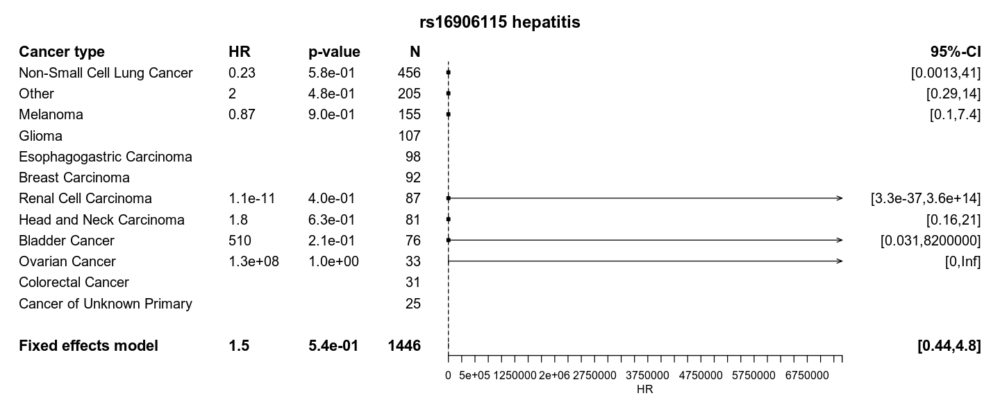

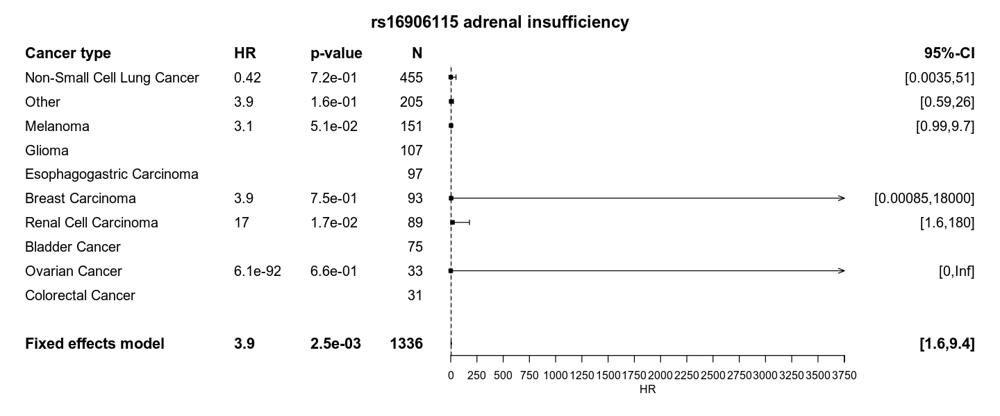

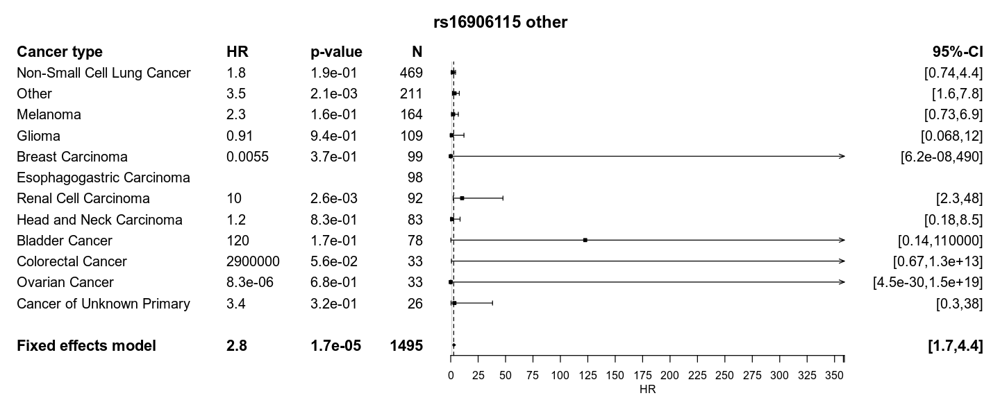

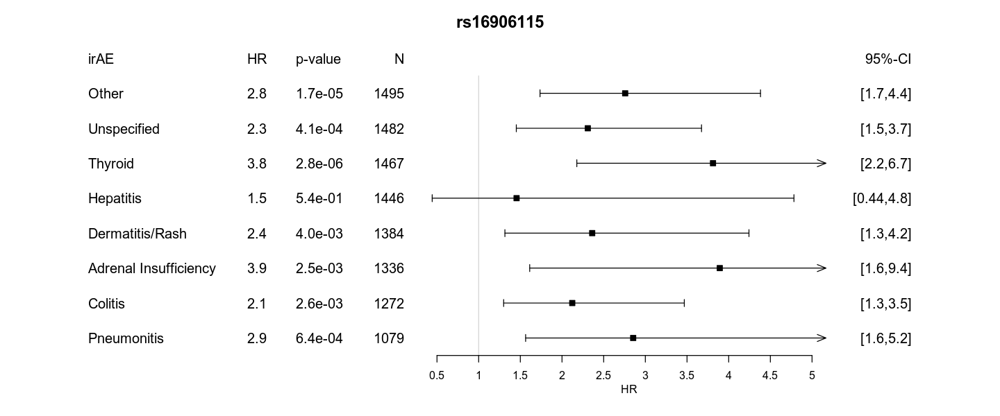

In [40]:
irAE_type_forest("rs16906115_norm","rs16906115")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"


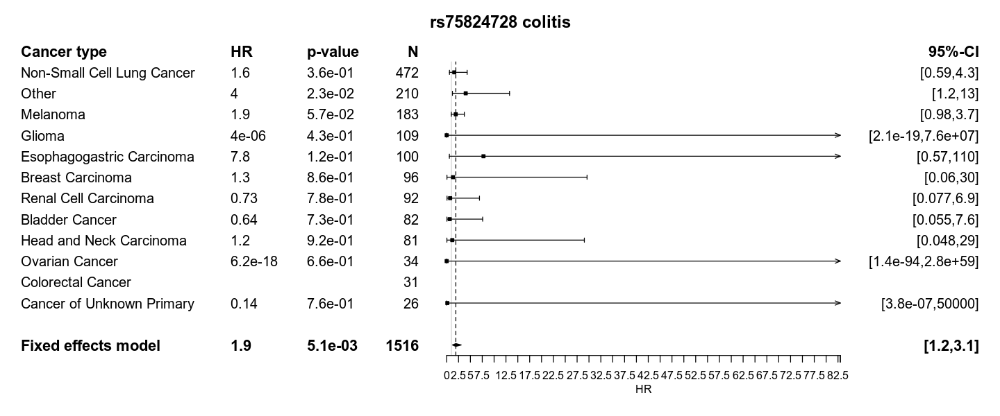

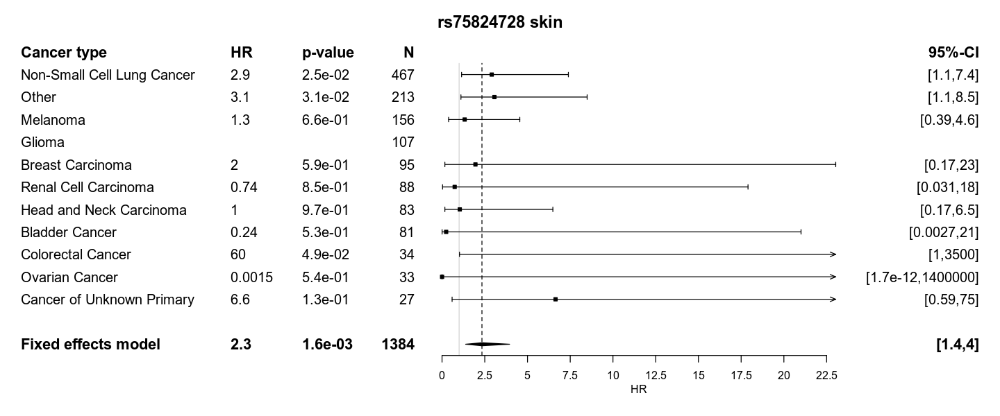

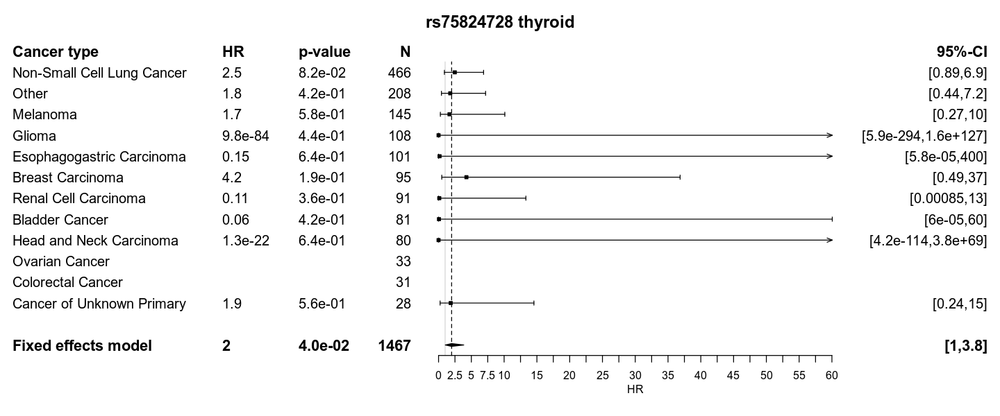

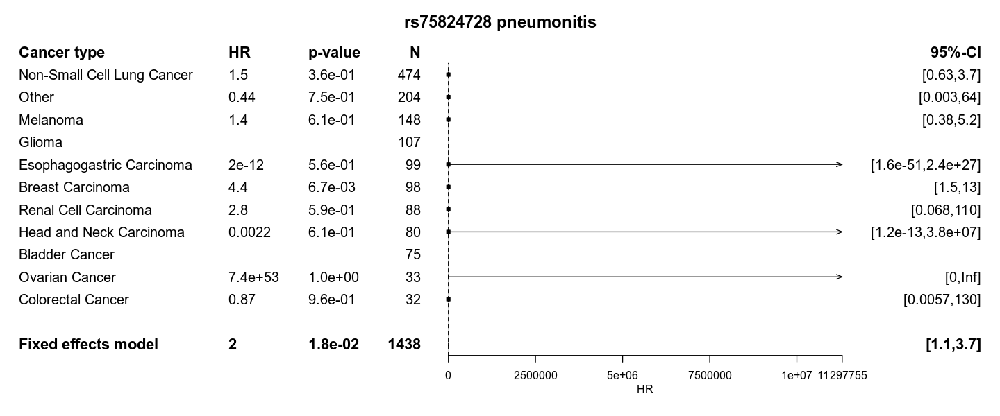

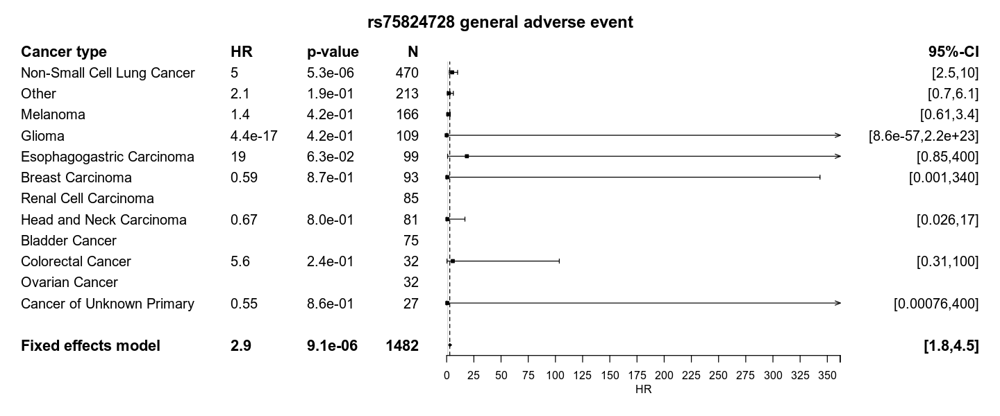

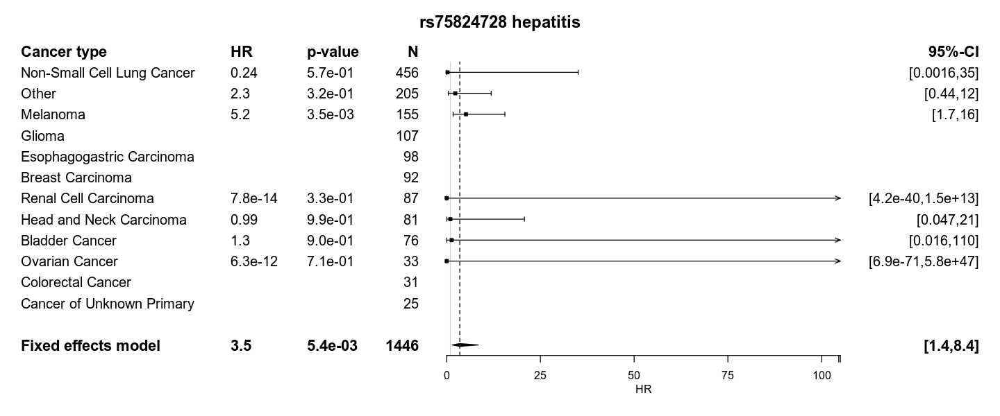

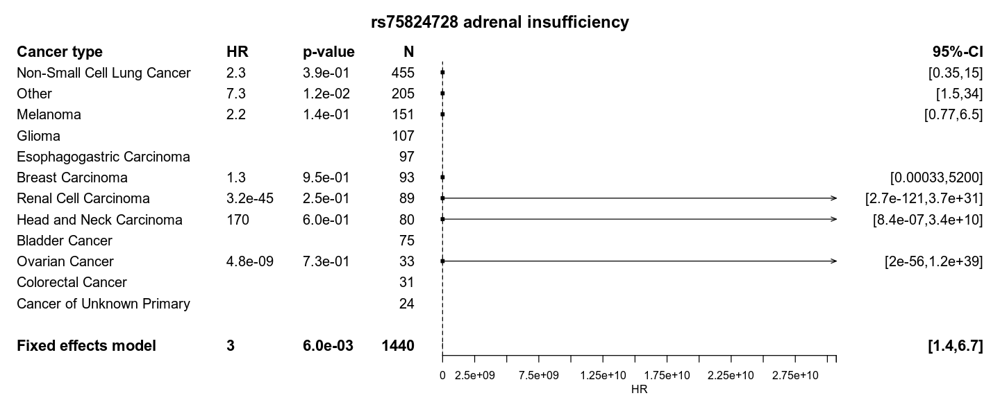

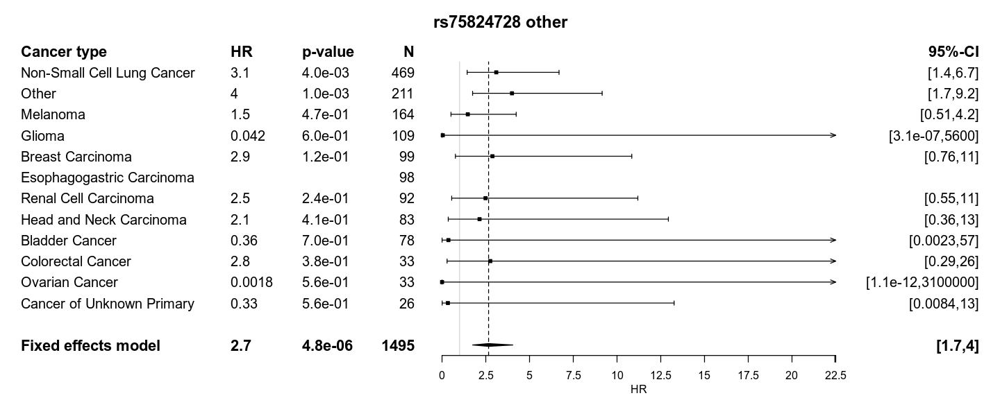

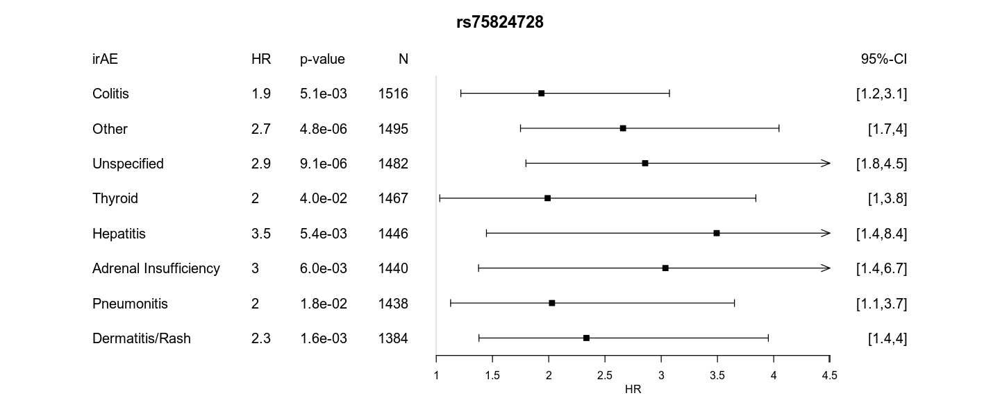

In [41]:
irAE_type_forest("rs75824728_norm","rs75824728")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Breast Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Bladder Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1]

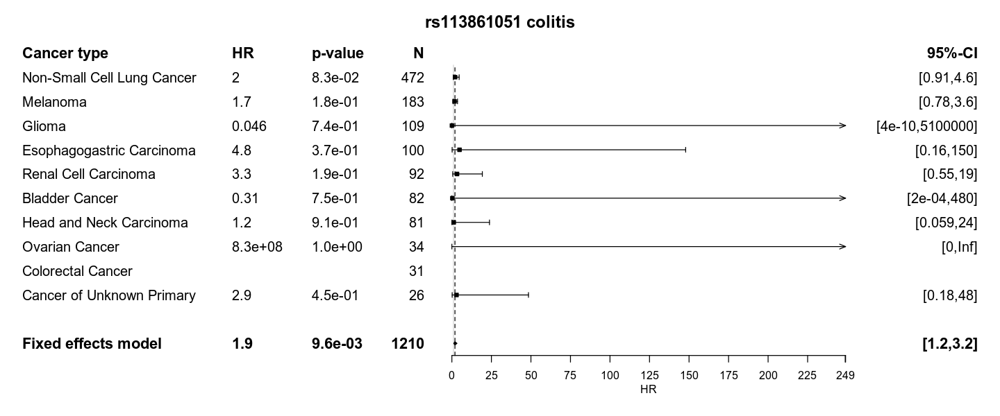

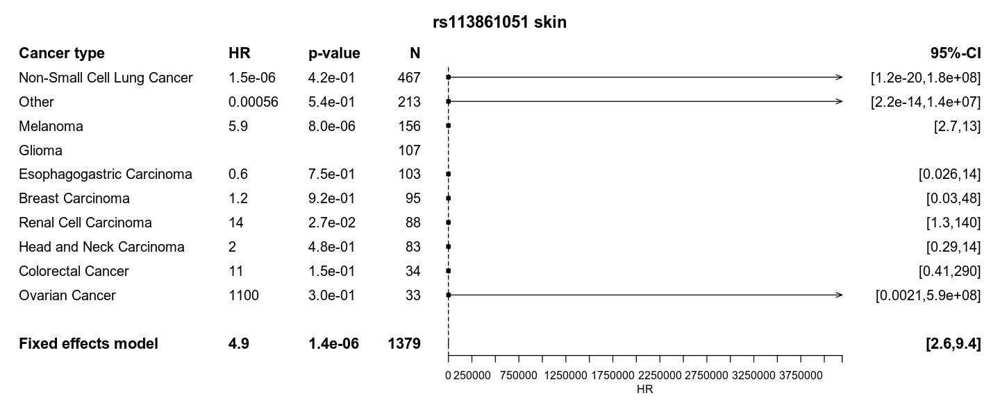

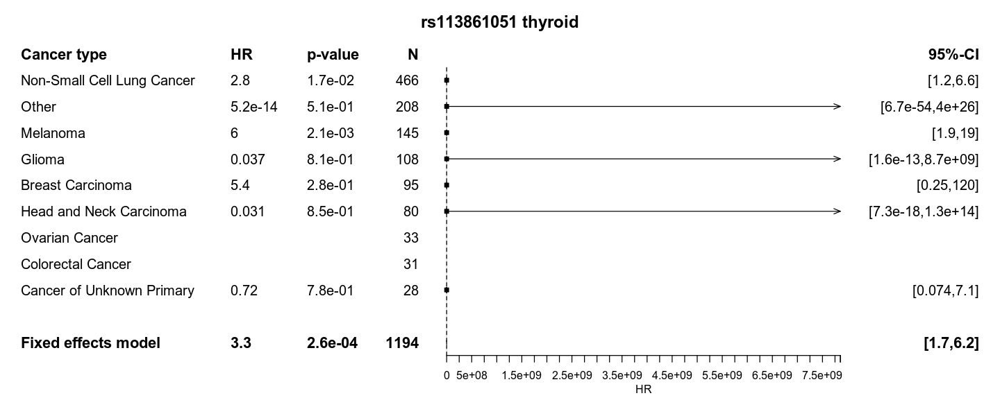

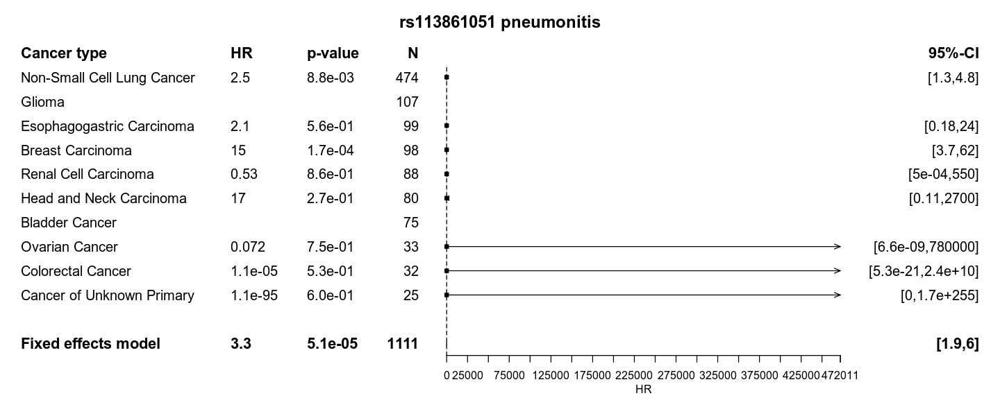

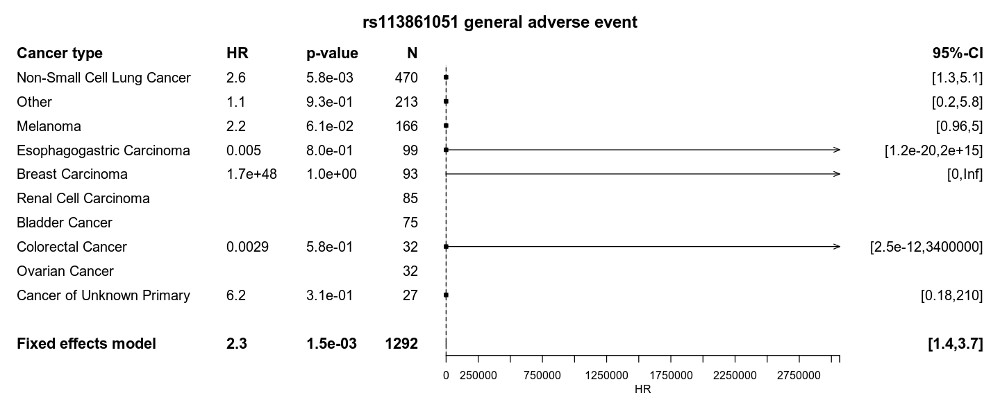

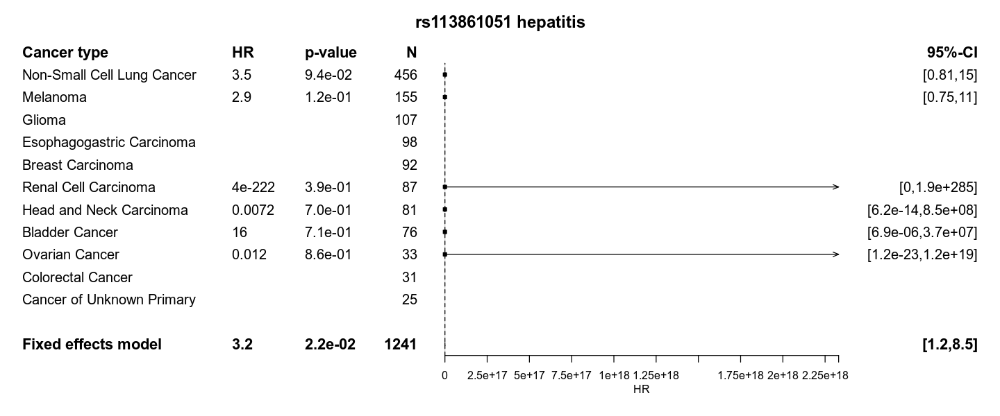

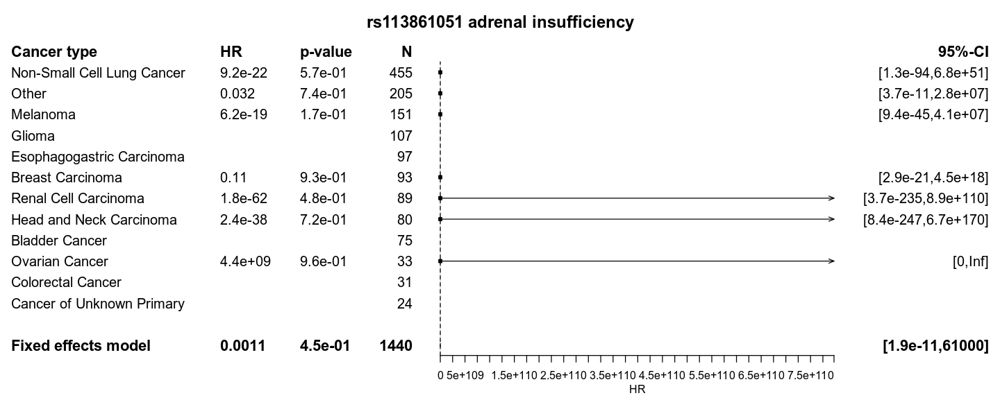

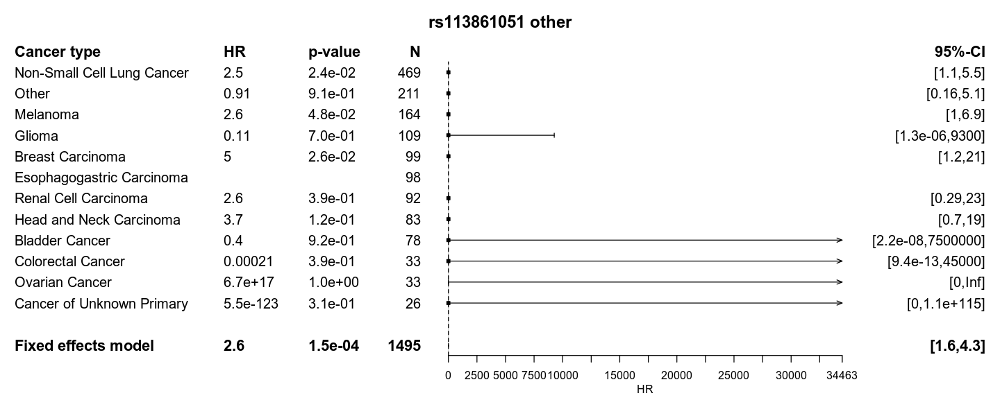

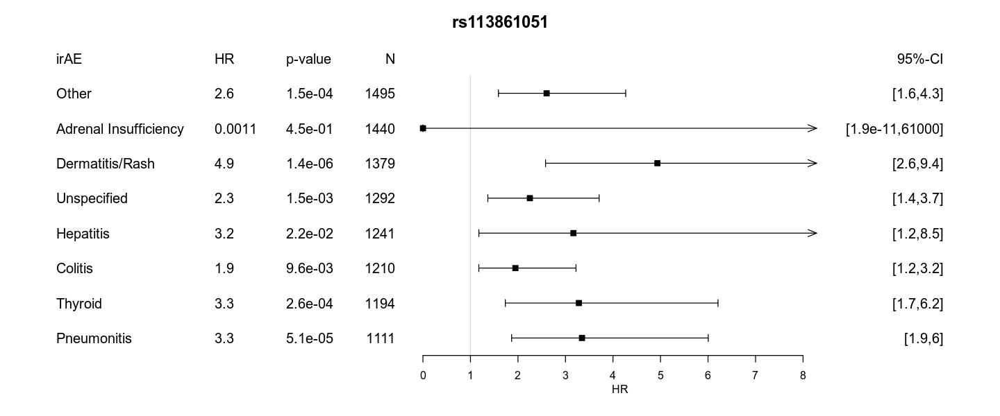

In [42]:
irAE_type_forest("rs113861051_norm","rs113861051")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


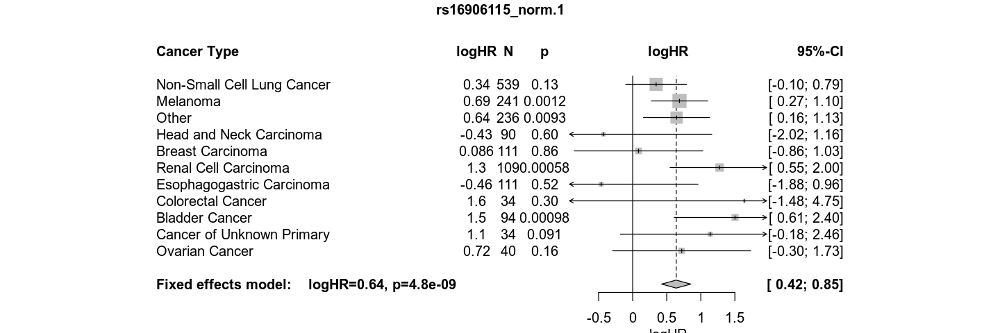

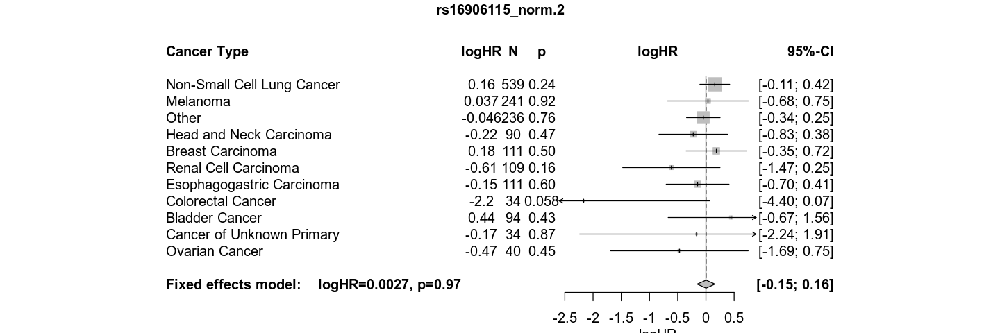

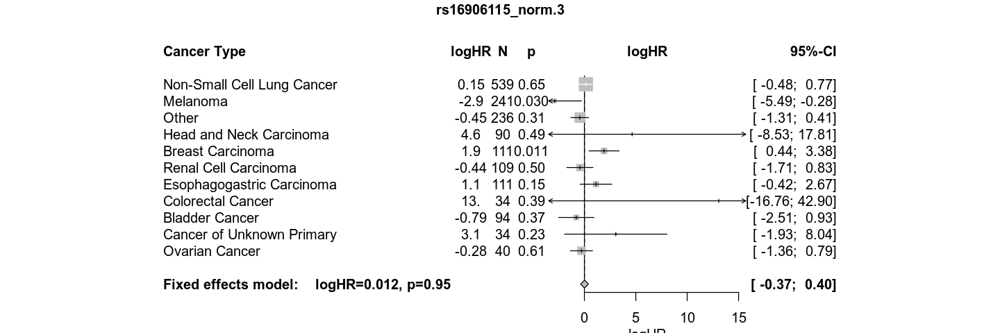

In [43]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs16906115_norm"),OS_GWAS_noleft %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1))
# tr2 <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS_noleft %>% filter(before_2018==1))
options(options_save)

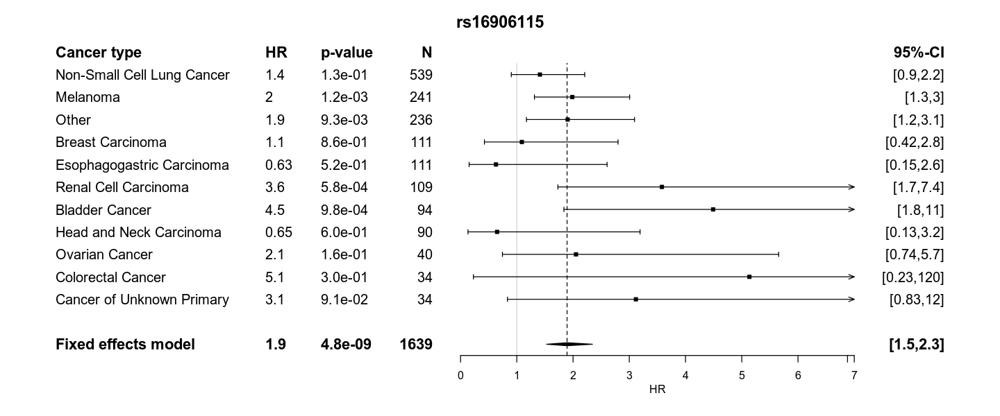

In [44]:
my_forest(tr1,"rs16906115_norm.1","rs16906115")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
NULL
NULL
NULL


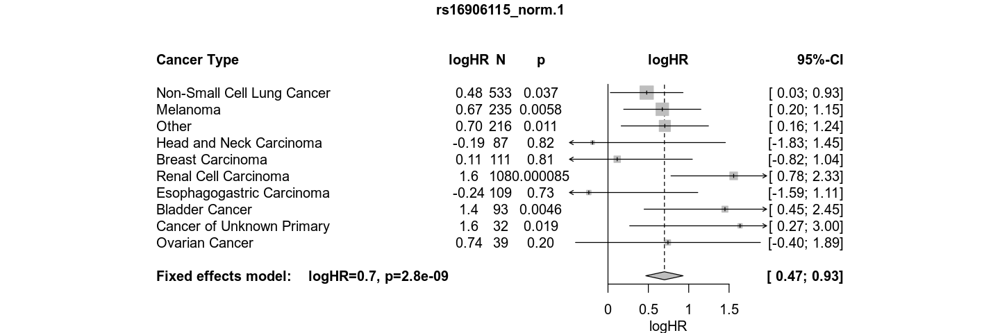

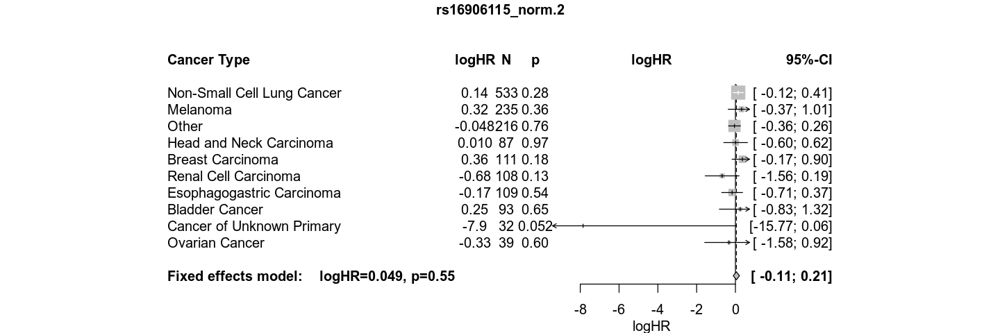

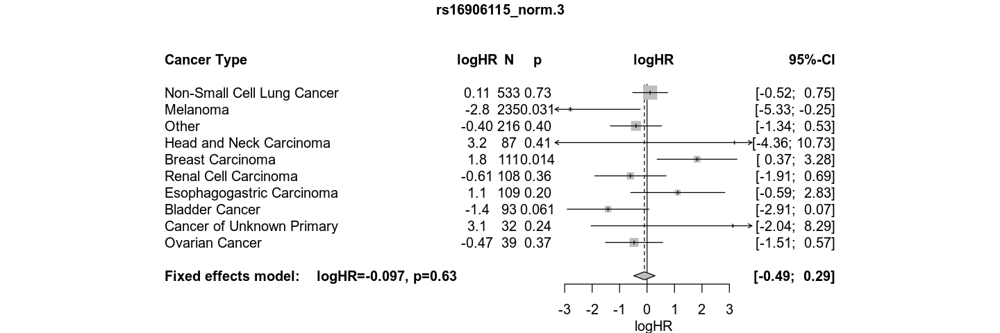

In [45]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs16906115_norm"),OS_GWAS %>% filter(TRANSPLANT_IND==F,immune_suppressant==0) %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1))
# tr2 <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS %>% filter(TRANSPLANT_IND==F,immune_suppressant==0) %>% filter(before_2018==1))
options(options_save)

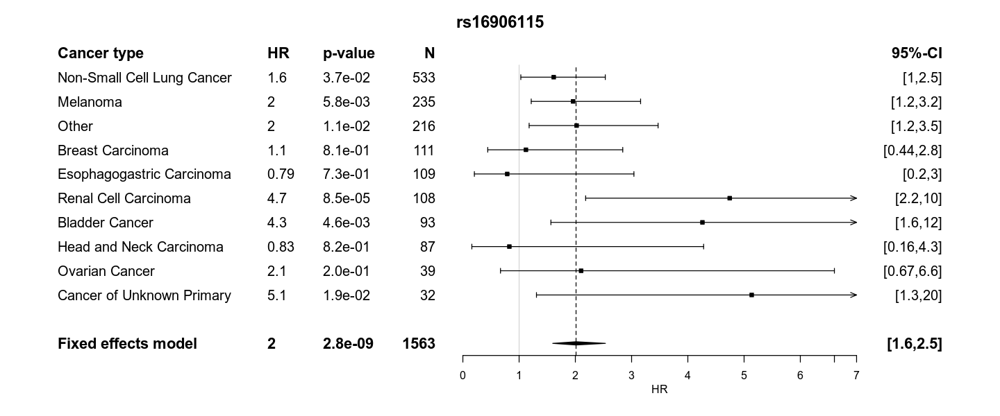

In [46]:
my_forest(tr1,"rs16906115_norm.1","rs16906115")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
NULL
NULL


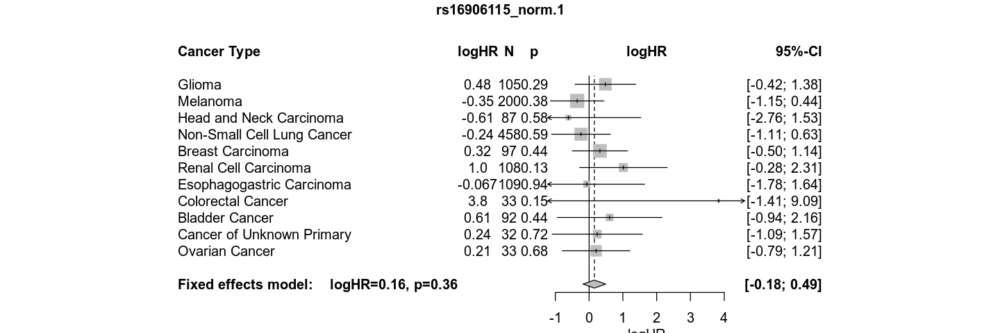

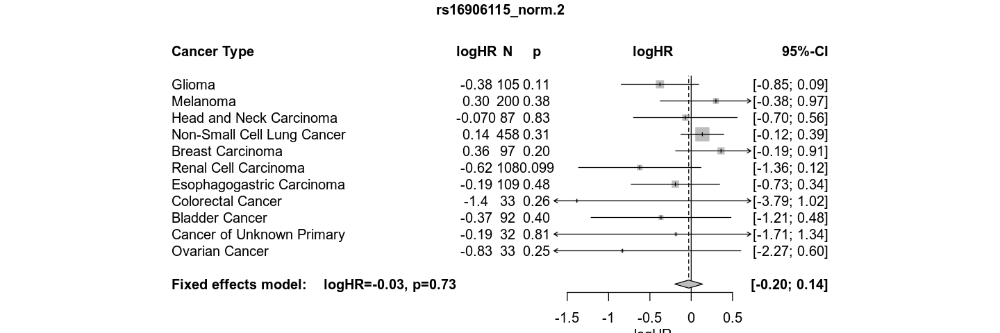

In [47]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs16906115_norm"),OS_GWAS_cur %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1), trans="1|2")
# tr2 <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS_cur %>% filter(before_2018==1), trans="1|2")
options(options_save)

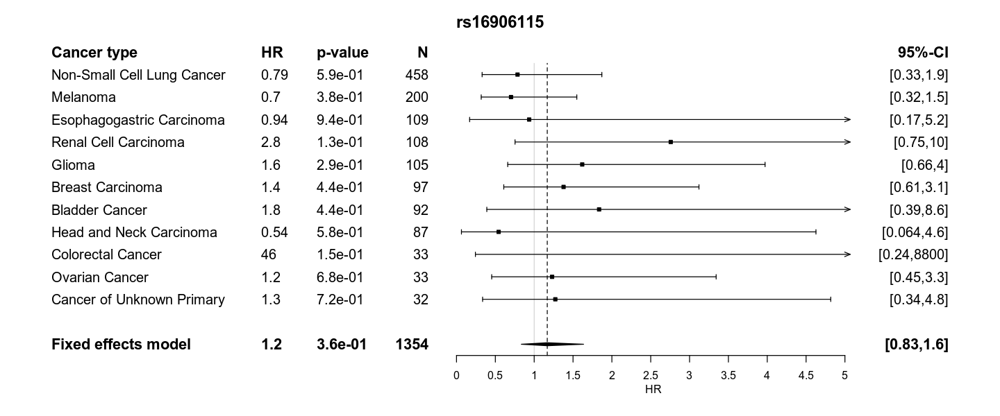

In [48]:
my_forest(tr1,"rs16906115_norm.1","rs16906115")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
NULL
NULL


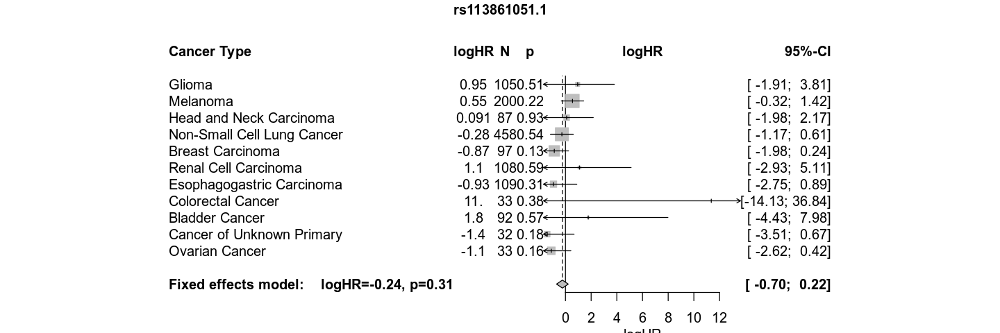

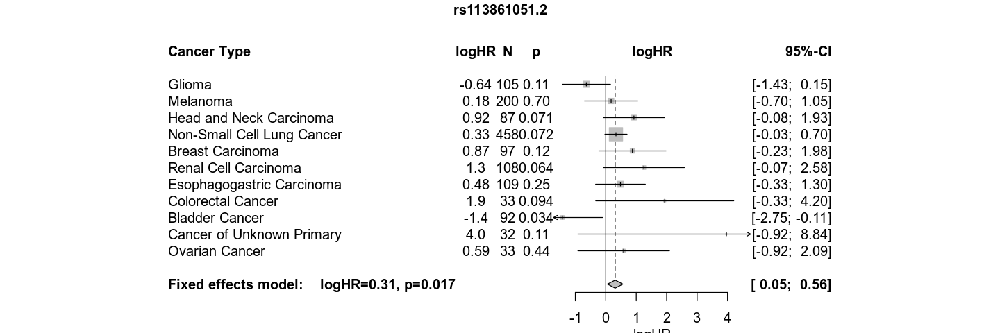

In [144]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs113861051"),OS_GWAS_cur %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1), trans="1|2")
# tr2 <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS_cur %>% filter(before_2018==1), trans="1|2")
options(options_save)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
NULL
NULL


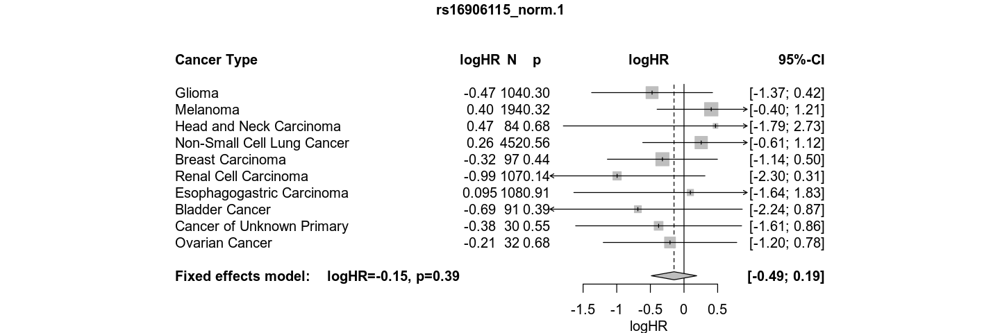

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
NULL
NULL


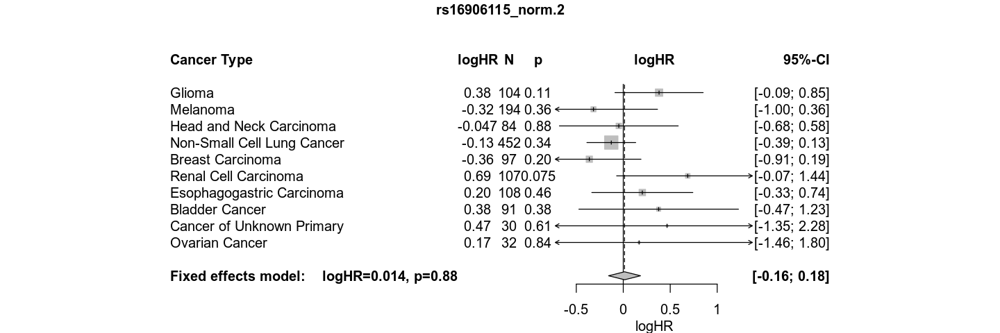

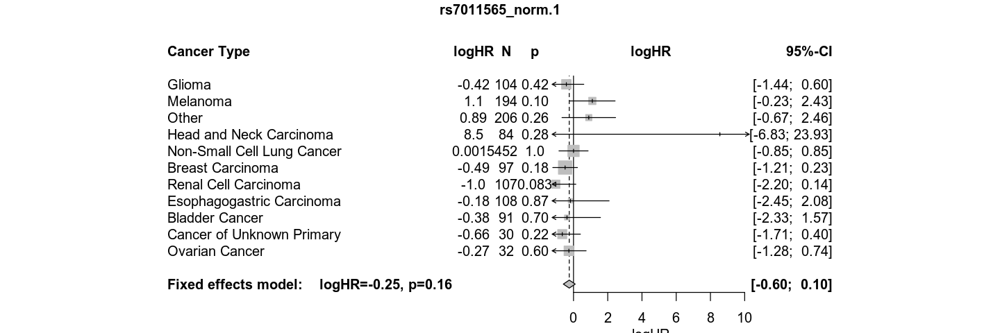

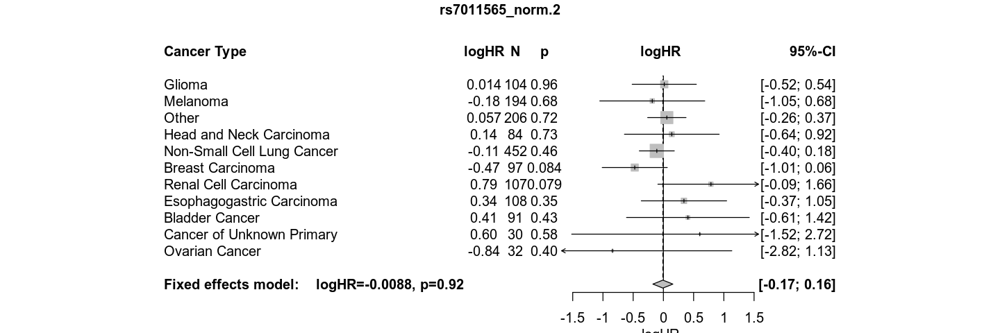

In [110]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs16906115_norm"),OS_GWAS_cur %>% filter(TRANSPLANT_IND==F,immune_suppressant==0) %>% filter(before_2018==1), trans="1|2")
tr2 <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS_cur %>% filter(TRANSPLANT_IND==F,immune_suppressant==0) %>% filter(before_2018==1), trans="1|2")
options(options_save)

Joining, by = "MRN"


NULL


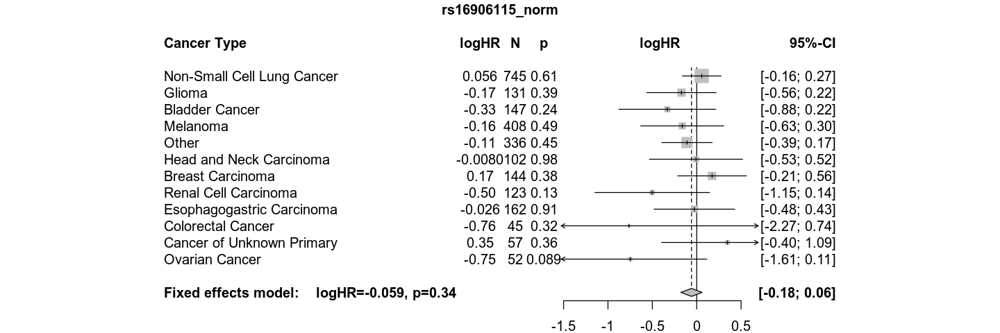

In [50]:
temp <- inner_join(OS,OS_GWAS %>% select(MRN,rs16906115_norm) %>% distinct) %>% mutate(rs16906115_norm=2-rs16906115_norm)

options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_onehot(c("rs16906115_norm"),temp)

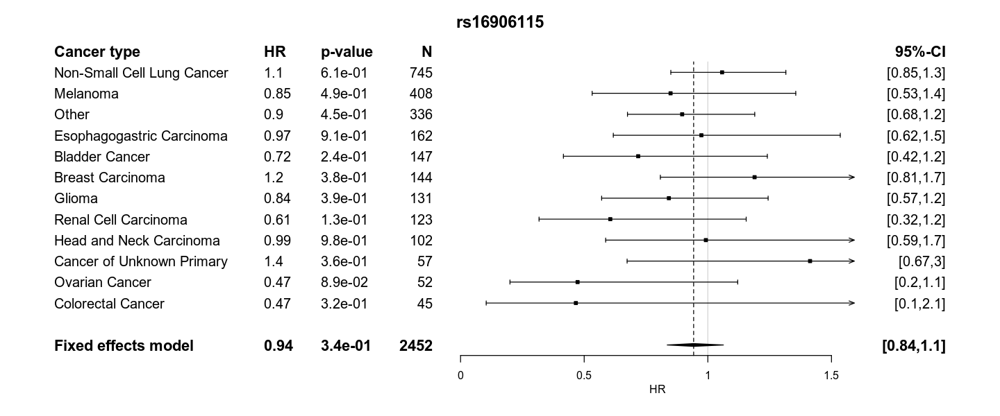

In [51]:
my_forest(tr,"rs16906115_norm","rs16906115")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
NULL
NULL
NULL


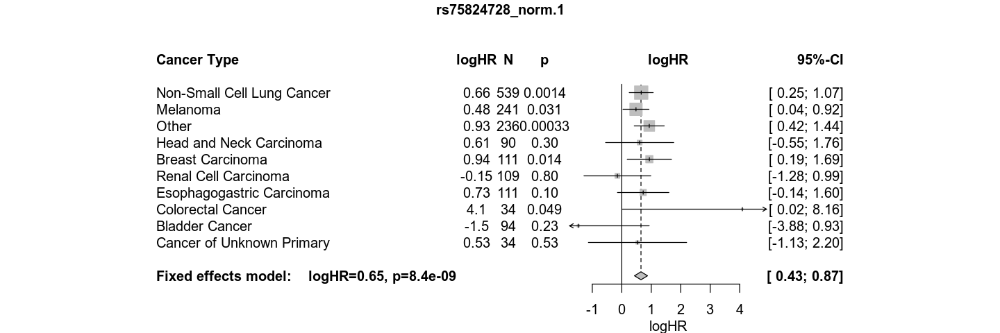

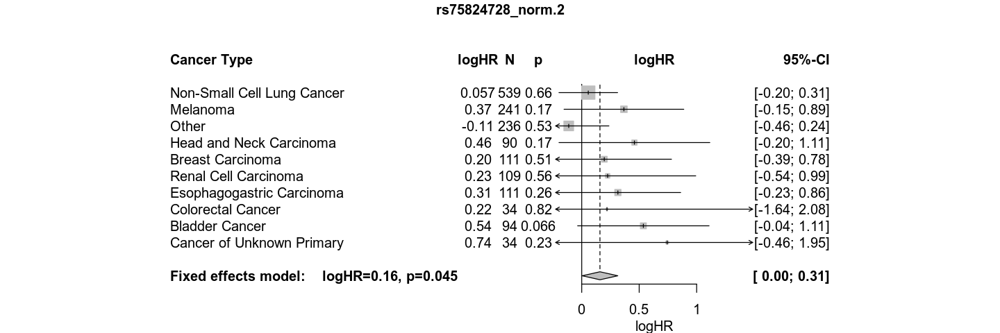

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
NULL
NULL


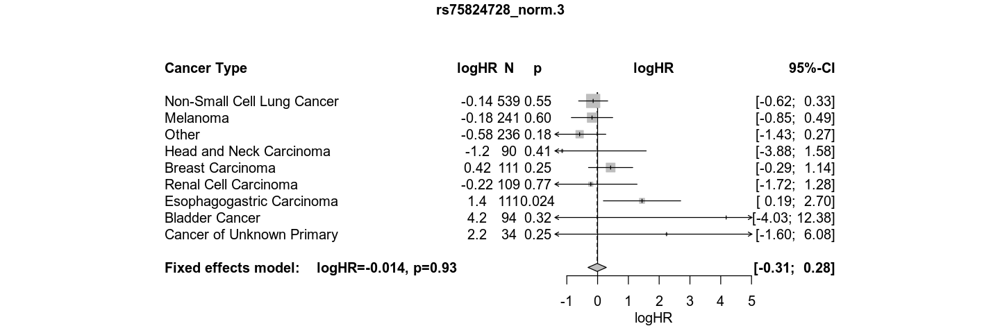

NULL


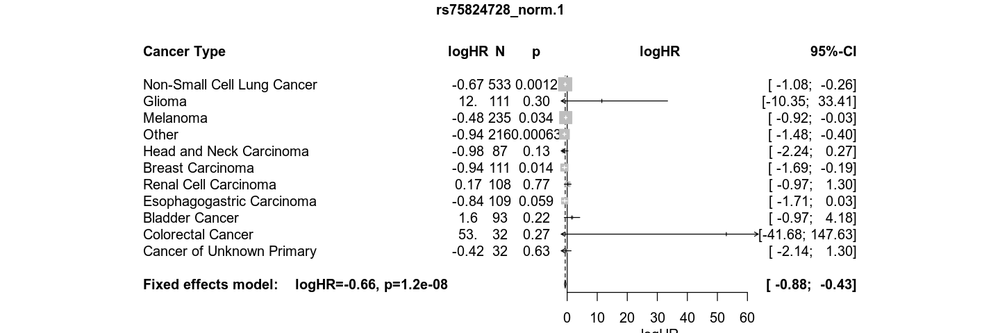

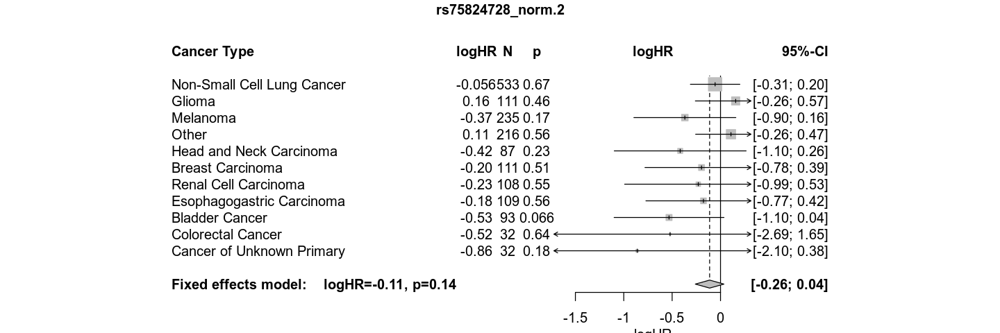

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
NULL
NULL


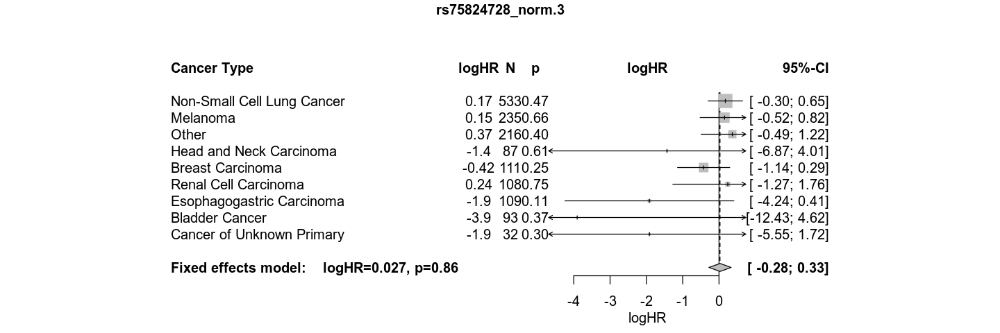

NULL


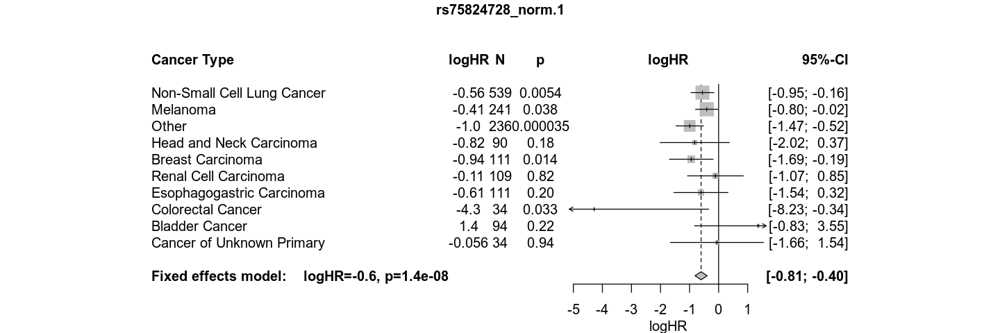

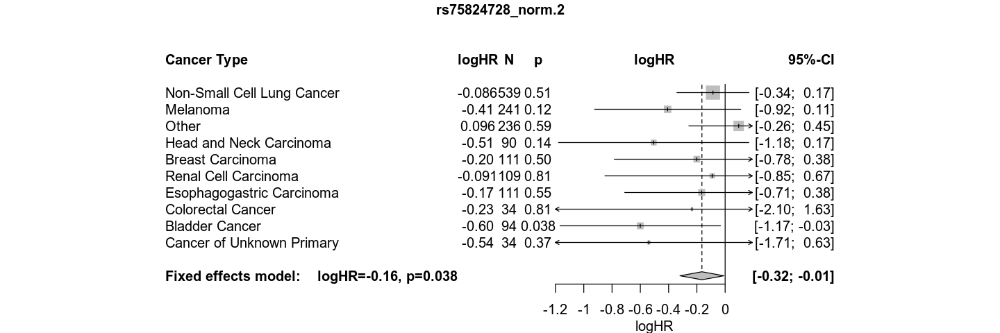

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
NULL
NULL


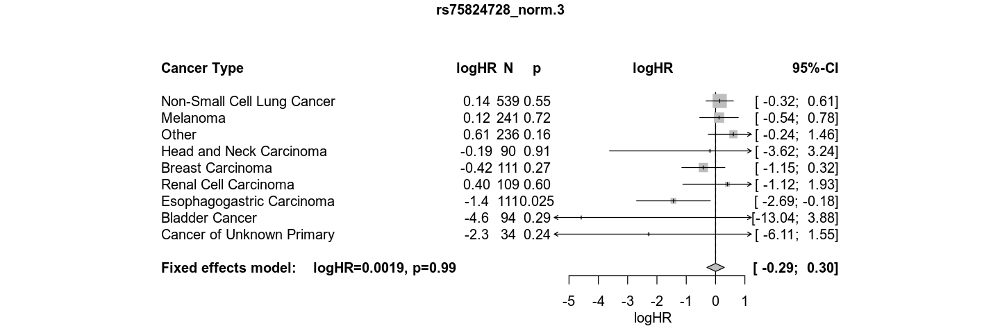

NULL


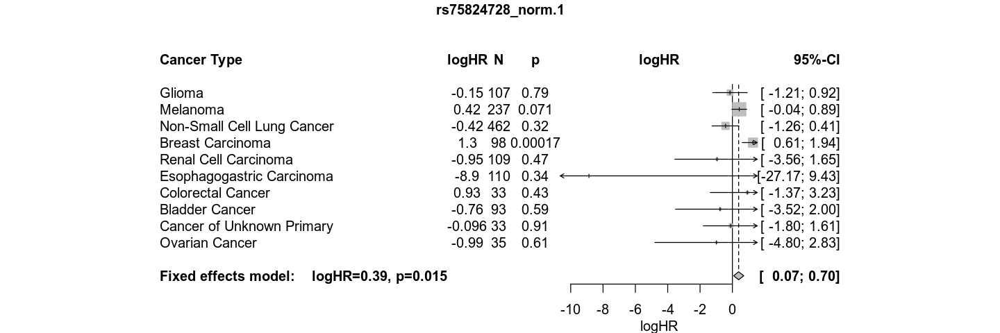

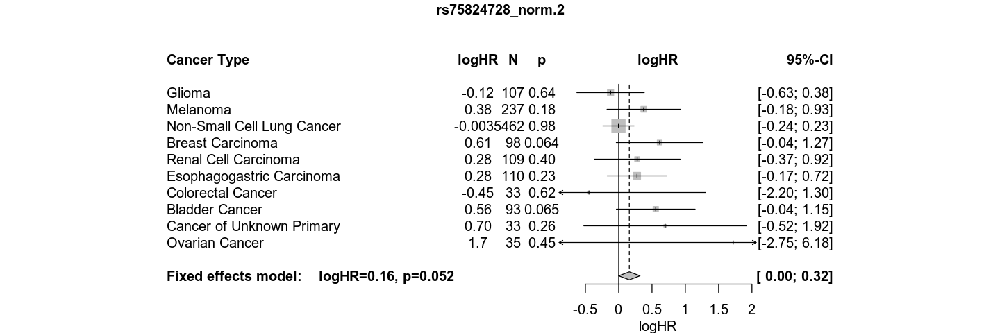

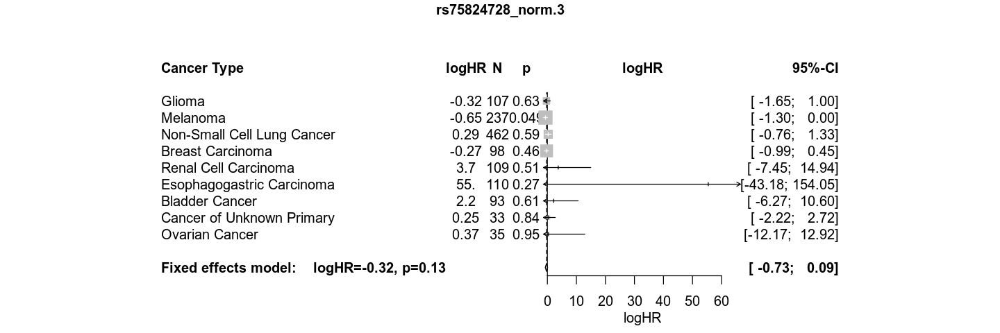

In [52]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs75824728_norm"),OS_GWAS %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% filter(before_2018==1))
tr2 <- meta_survival_AE(c("rs75824728_norm"),OS_GWAS %>% filter(TRANSPLANT_IND==F,immune_suppressant==0) %>% filter(before_2018==1))
tr3 <- meta_survival_AE(c("rs75824728_norm"),OS_GWAS_noleft %>% filter(before_2018==1))
tr4 <- meta_survival_AE(c("rs75824728_norm"),OS_GWAS_cur %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% filter(before_2018==1))
options(options_save)

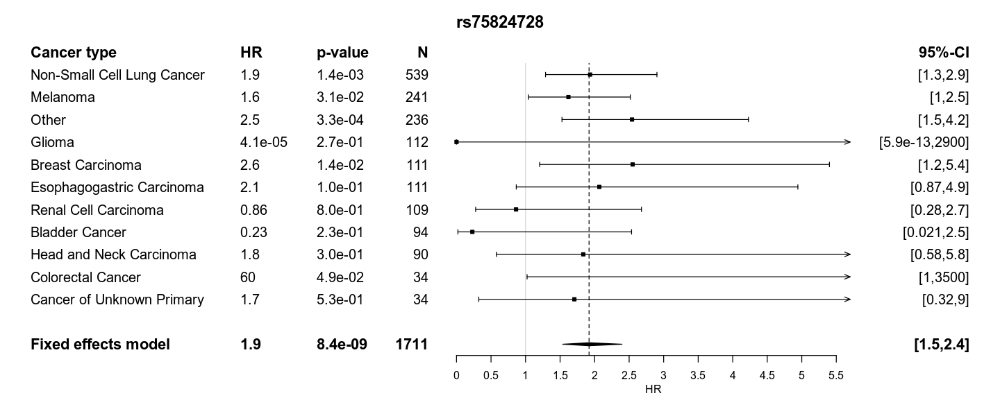

In [53]:
my_forest(tr1,"rs75824728_norm.1","rs75824728")

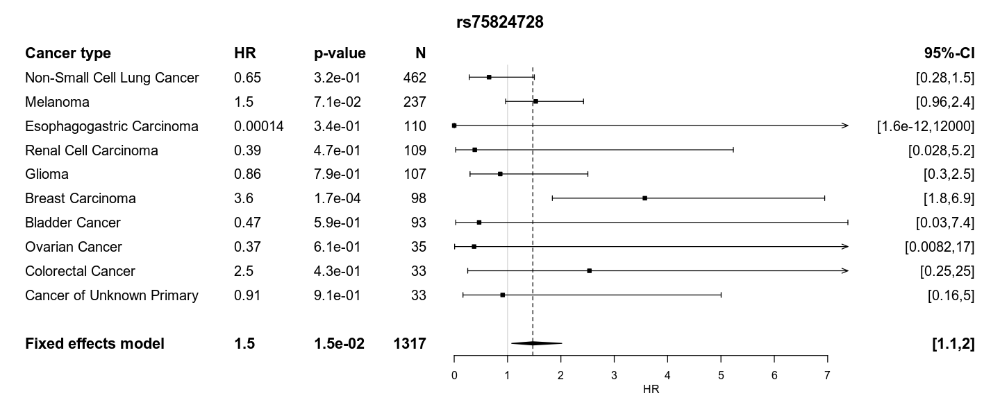

In [54]:
my_forest(tr4,"rs75824728_norm.1","rs75824728")

Joining, by = "MRN"


NULL


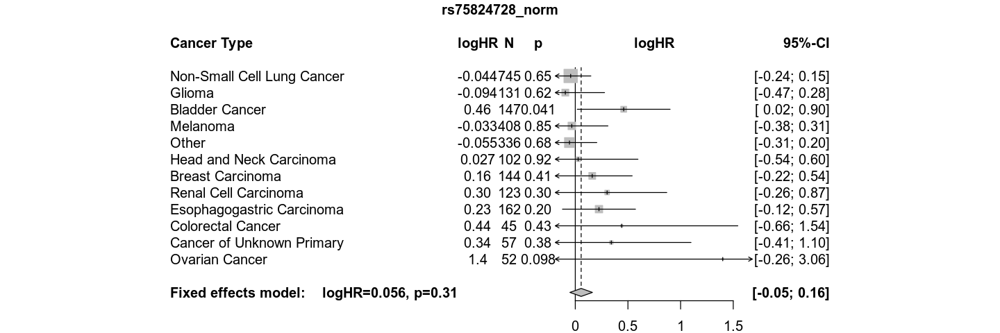

In [55]:
temp <- inner_join(OS,OS_GWAS %>% select(MRN,rs75824728_norm) %>% distinct) %>% mutate(rs75824728_norm=2-rs75824728_norm)

options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_onehot(c("rs75824728_norm"),temp)

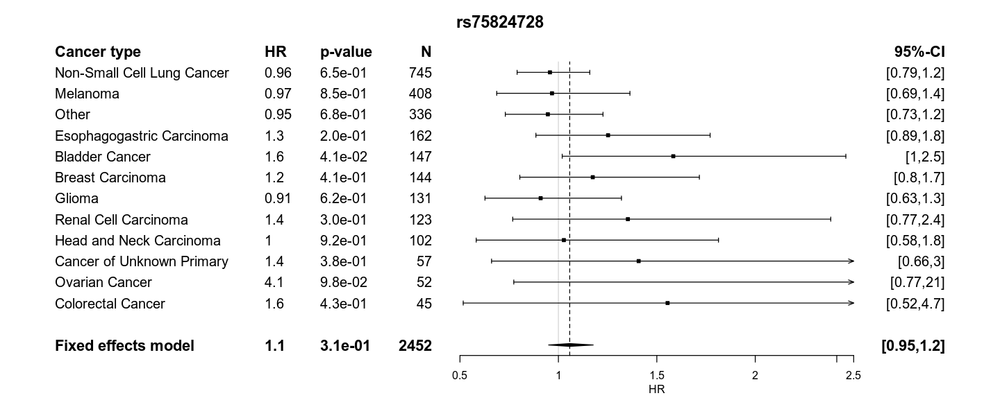

In [56]:
my_forest(tr,"rs75824728_norm","rs75824728")

Joining, by = "MRN"


NULL


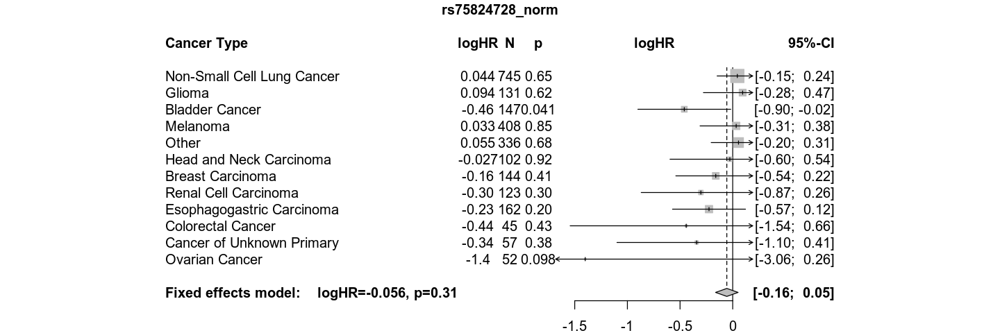

In [116]:
temp <- inner_join(OS,OS_GWAS %>% select(MRN,rs75824728_norm) %>% distinct)

options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_onehot(c("rs75824728_norm"),temp)

#### curated

In [34]:
snp_cur <- fread("IL7_suggestive_curated.csv") %>% mutate(CHR = gsub("(.*)_.*","\\1",allele), POS = gsub(".*_(.*)","\\1",allele))
snp_cur <- snp_cur %>% arrange(CHR,POS)
snp_cur %>% group_by(CHR) %>% count

CHR,n
<chr>,<int>
20,25
3,41
5,1


In [98]:
# normalize all genome wide significant

snp_cur <- fread("IL7_suggestive_curated.csv") %>% mutate(CHR = gsub("(.*)_.*","\\1",allele), POS = gsub(".*_(.*)","\\1",allele))
snp_cur <- snp_cur %>% arrange(CHR,POS)

GWAS <- data.frame(PBP=gsub("0_","",names(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1))[grep("PBP",names(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.1.QC.traw",nrows=1)))]))
for (chr in unique(snp_cur$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_cur %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.',chr,".QC.traw",sep="")
    GWAS_temp <- fread(cmd=read_str) %>% t
    GWAS_temp <- data.frame(GWAS_temp)
    GWAS_temp$PBP <- rownames(GWAS_temp)
    names(GWAS_temp) <- c((snp_cur %>% filter(CHR==chr))$SNP,"PBP")
    GWAS_temp <- GWAS_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
    GWAS_temp <- GWAS_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_temp <- GWAS_temp %>% mutate(PBP=gsub("^0_","",PBP))
    GWAS <- full_join(GWAS,GWAS_temp)
}
                                         
translate_BB_BLNUM <- fread("/data/gusev/PROFILE/2020_04/IMPUTE/ACCURACY/PBB/SNP.uniq.remap") %>% rename(Biobank.ID=V2,BLNUM=V3) %>% select(Biobank.ID,BLNUM) %>% mutate(Biobank.ID=as.integer(gsub(".*-","",Biobank.ID)))
GWAS_PBB <- data.frame(Biobank.ID=as.double(gsub(".*-","",names(fread("/data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.1.traw",nrows=1))))) %>% drop_na#[grep("PBP",names(fread("/data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.1.traw",nrows=1)))]))
for (chr in unique(snp_cur$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_cur %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.',chr,".traw",sep="")
    GWAS_temp <- fread(cmd=read_str) %>% filter(as.integer(POS) %in% as.integer((snp_cur %>% filter(CHR==chr))$POS)) %>% t
    GWAS_temp <- data.frame(GWAS_temp)
    GWAS_temp$PBP <- rownames(GWAS_temp)
    names(GWAS_temp) <- c((snp_cur %>% filter(as.integer(POS) %in% as.integer(unlist(transpose(GWAS_temp["POS",])))))$SNP,"Biobank.ID")#c((snp_cur %>% filter(CHR==chr))$SNP,"Biobank.ID")
    GWAS_temp <- GWAS_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",Biobank.ID))
    GWAS_temp <- GWAS_temp %>% mutate(Biobank.ID=as.double(gsub(".*-","",Biobank.ID)))
    GWAS_temp <- GWAS_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_temp <- GWAS_temp %>% mutate(Biobank.ID=as.integer(Biobank.ID))
    GWAS_PBB <- full_join(GWAS_PBB,GWAS_temp)
}
GWAS_PBB <- inner_join(translate_BB_BLNUM %>% drop_na(Biobank.ID),GWAS_PBB)
                                        
GWAS_Profile <- data.frame(PBP=gsub(".*_(.*)","\\1",names(fread("/data/gusev/PROFILE/2020_04/IMPUTE/DOSAGE/PROFILE_2020_IL7suggestive_cur.3.traw",nrows=1))[grep("PBP",names(fread("/data/gusev/PROFILE/2020_04/IMPUTE/DOSAGE/PROFILE_2020_IL7signif.1.traw",nrows=1)))]))
for (chr in unique(snp_cur$CHR)) {
    read_str <- paste('grep "CHR\\|',paste((snp_cur %>% filter(CHR==chr))$POS,collapse="\\|"),'" /data/gusev/PROFILE/2020_04/IMPUTE/DOSAGE/PROFILE_2020_IL7suggestive_cur.',chr,".traw",sep="")
    GWAS_Profile_temp <- fread(cmd=read_str) %>% t
    GWAS_Profile_temp <- data.frame(GWAS_Profile_temp)
    GWAS_Profile_temp$PBP <- rownames(GWAS_Profile_temp)
    names(GWAS_Profile_temp) <- c((snp_cur %>% filter(CHR==chr))$SNP,"PBP")
    GWAS_Profile_temp <- GWAS_Profile_temp %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
    GWAS_Profile_temp <- GWAS_Profile_temp %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
    GWAS_Profile_temp <- GWAS_Profile_temp %>% mutate(PBP=gsub(".*_(.*)","\\1",PBP))
    GWAS_Profile <- full_join(GWAS_Profile,GWAS_Profile_temp)
}

Joining, by = "PBP"
Warning message:
“Column `PBP` joining factor and character vector, coercing into character vector”Joining, by = "PBP"
Joining, by = "PBP"
Warning message in data.frame(Biobank.ID = as.double(gsub(".*-", "", names(fread("/data/gusev/PARTNERS_BB/ALL/DOSAGE/PBB.1.traw", :
“NAs introduced by coercion”Warning message in as.integer(POS) %in% as.integer(unlist(transpose(GWAS_temp["POS", :
“NAs introduced by coercion”Joining, by = "Biobank.ID"
Warning message in as.integer(POS) %in% as.integer(unlist(transpose(GWAS_temp["POS", :
“NAs introduced by coercion”Joining, by = "Biobank.ID"
Warning message in as.integer(POS) %in% as.integer(unlist(transpose(GWAS_temp["POS", :
“NAs introduced by coercion”Joining, by = "Biobank.ID"
Joining, by = "Biobank.ID"
Joining, by = "PBP"
Warning message:
“Column `PBP` joining factor and character vector, coercing into character vector”Joining, by = "PBP"
Joining, by = "PBP"


Joining, by = "PBP"


[1] "rs16997277"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 37.55, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7665884 0.8171116
sample estimates:
      cor 
0.7932111 

[1] "rs74814007"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 40.802, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7927798 0.8381531
sample estimates:
      cor 
0.8167251 



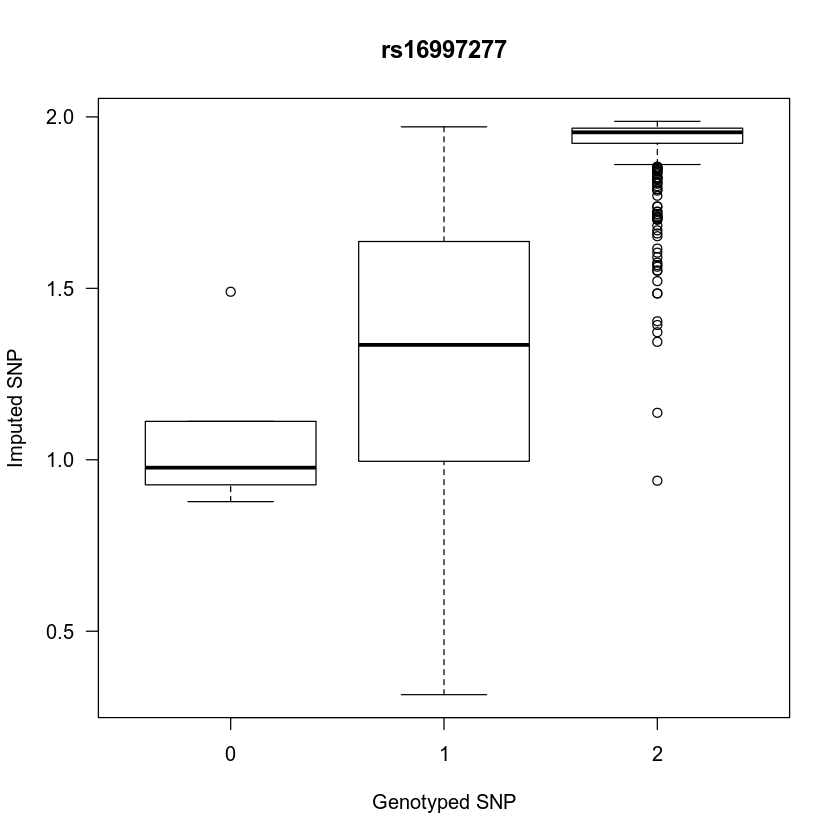

[1] "rs77748110"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.469, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7744121 0.8234111
sample estimates:
      cor 
0.8002433 



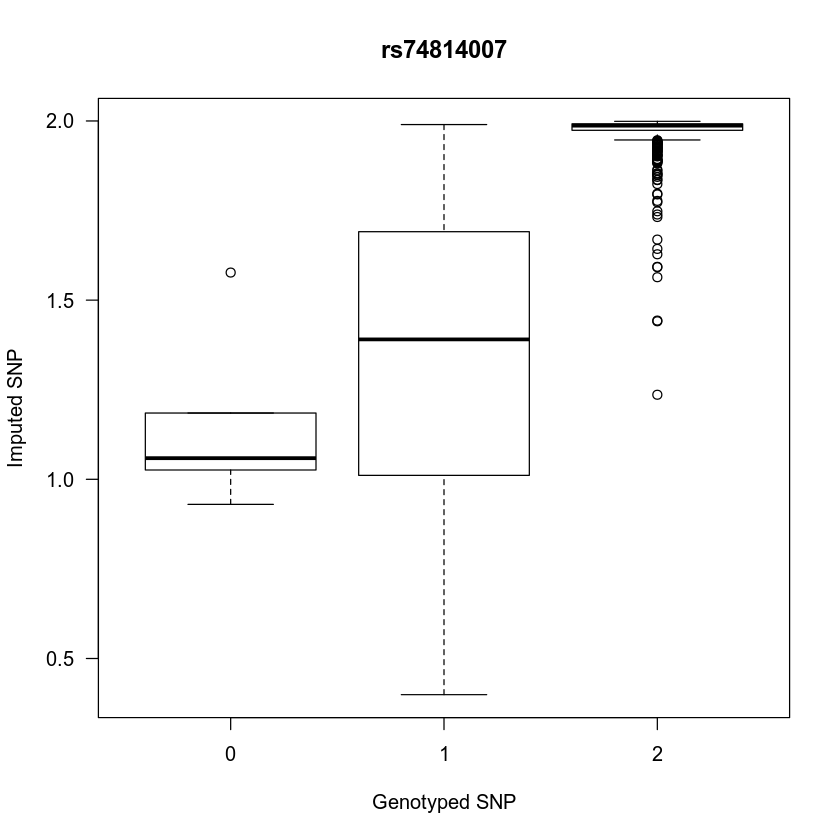

[1] "rs77886450"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.474, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7744568 0.8234471
sample estimates:
      cor 
0.8002835 



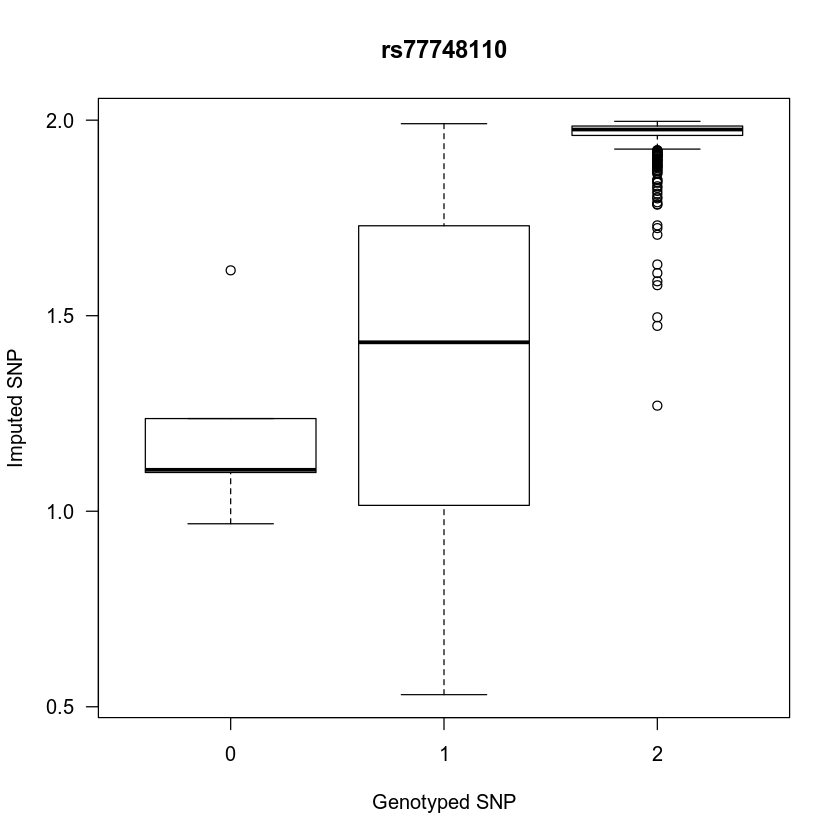

[1] "rs17728209"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.043, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7791319 0.8272056
sample estimates:
      cor 
0.8044823 



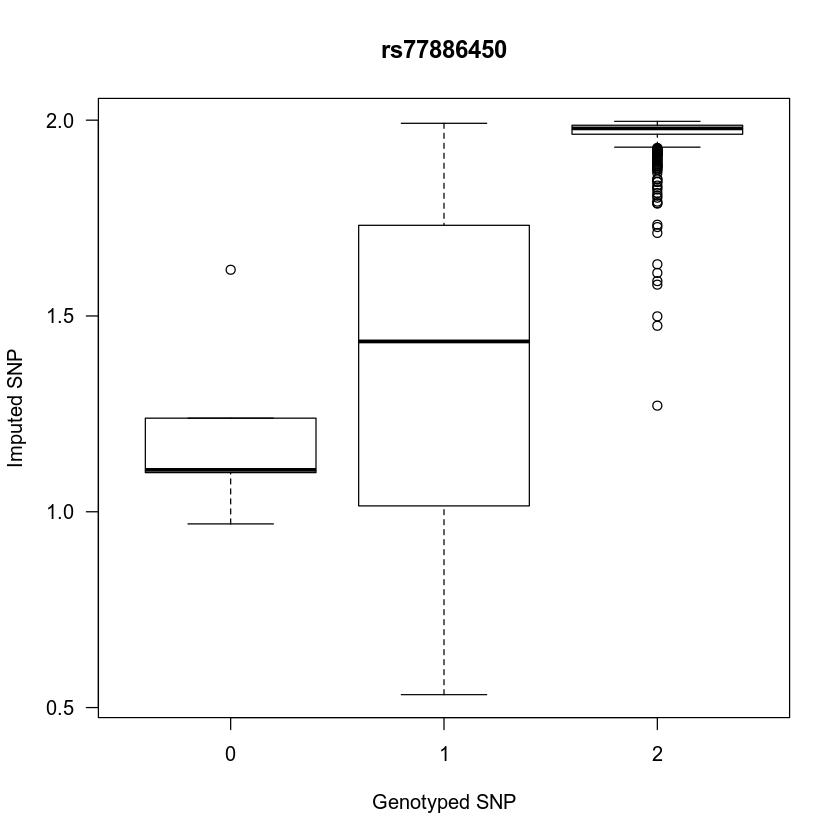

[1] "rs80261161"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.056, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7792333 0.8272871
sample estimates:
      cor 
0.8045733 



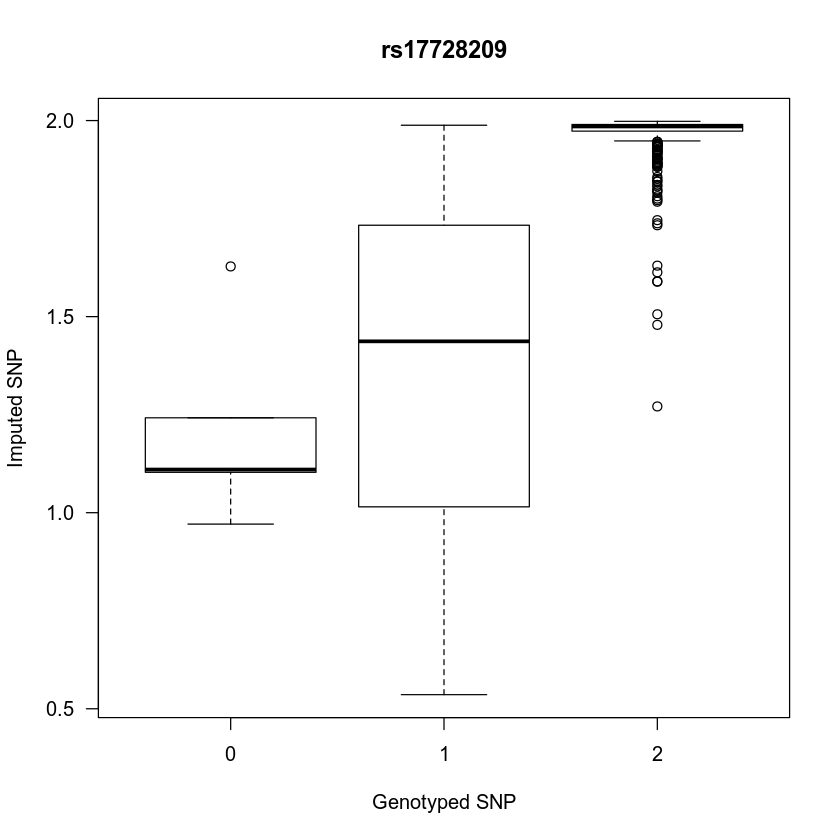

[1] "rs75174196"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.041, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7791120 0.8271896
sample estimates:
      cor 
0.8044644 



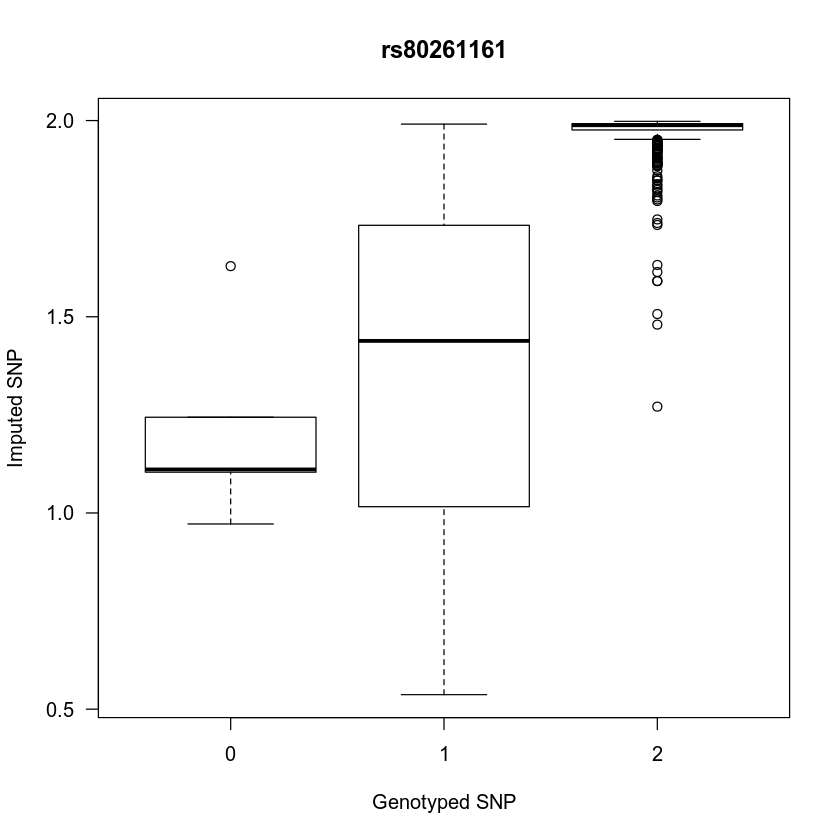

[1] "rs79573710"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.83, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7853797 0.8322217
sample estimates:
      cor 
0.8100895 



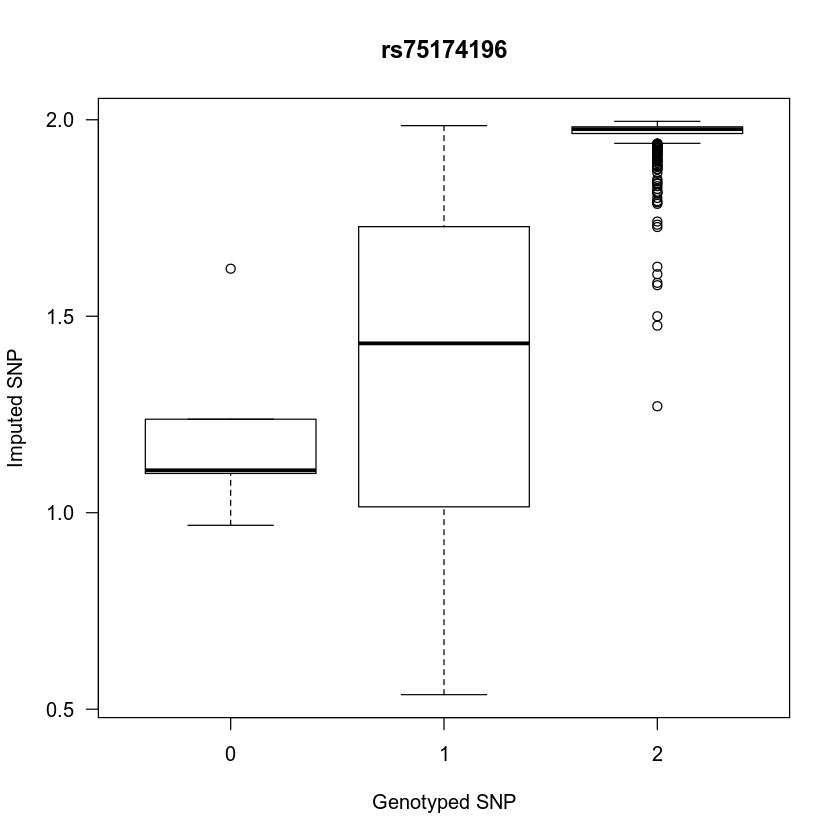

[1] "rs75641349"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.35, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7815969 0.8291856
sample estimates:
      cor 
0.8066951 



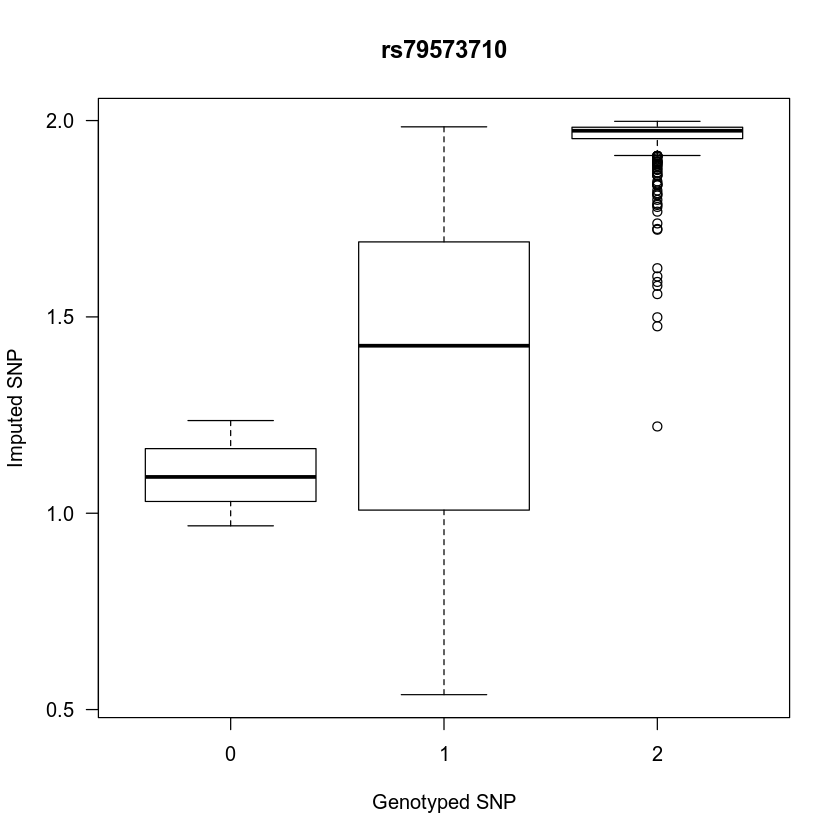

[1] "rs17728269"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.544, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7831389 0.8304235
sample estimates:
      cor 
0.8080789 



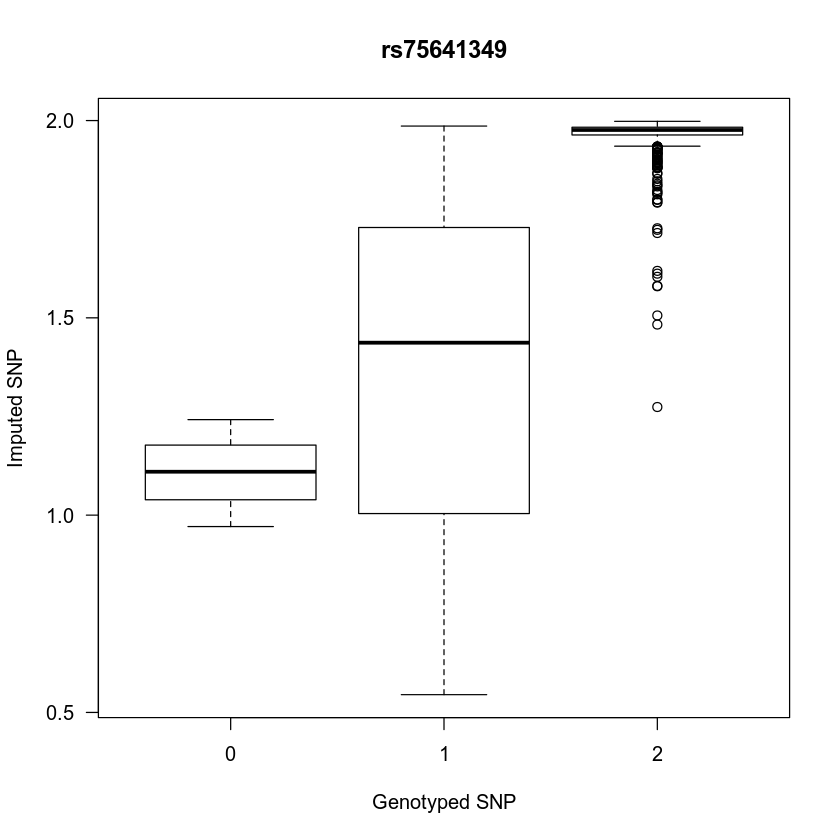

[1] "rs79815920"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.45, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7823945 0.8298260
sample estimates:
     cor 
0.807411 



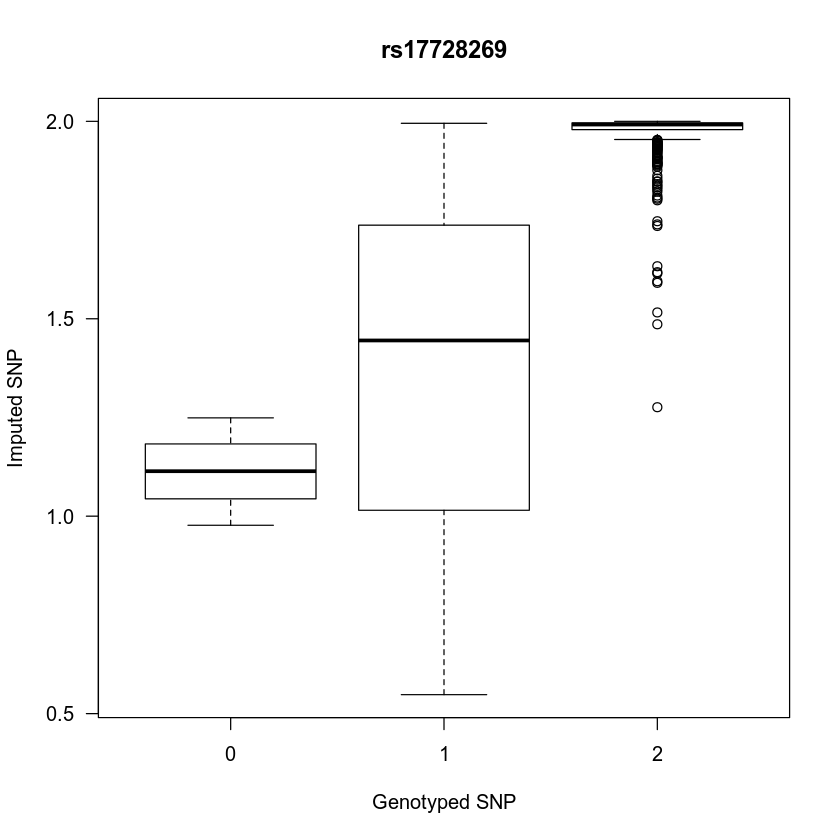

[1] "rs77078228"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.844, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7775115 0.8259034
sample estimates:
      cor 
0.8030273 



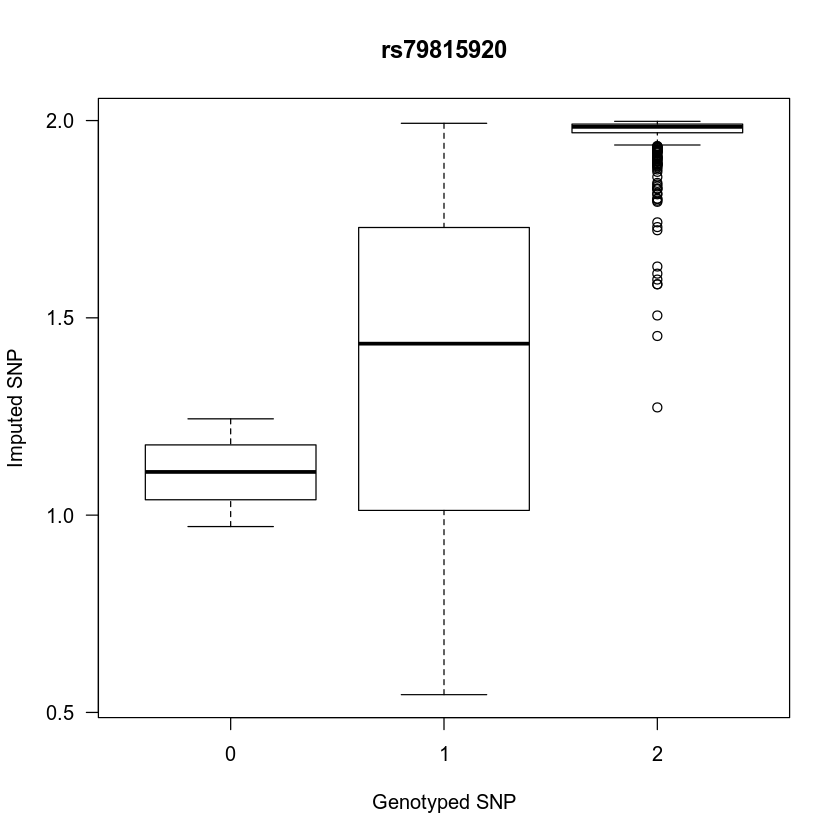

[1] "rs75052465"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 36.497, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7571755 0.8095165
sample estimates:
     cor 
0.784741 



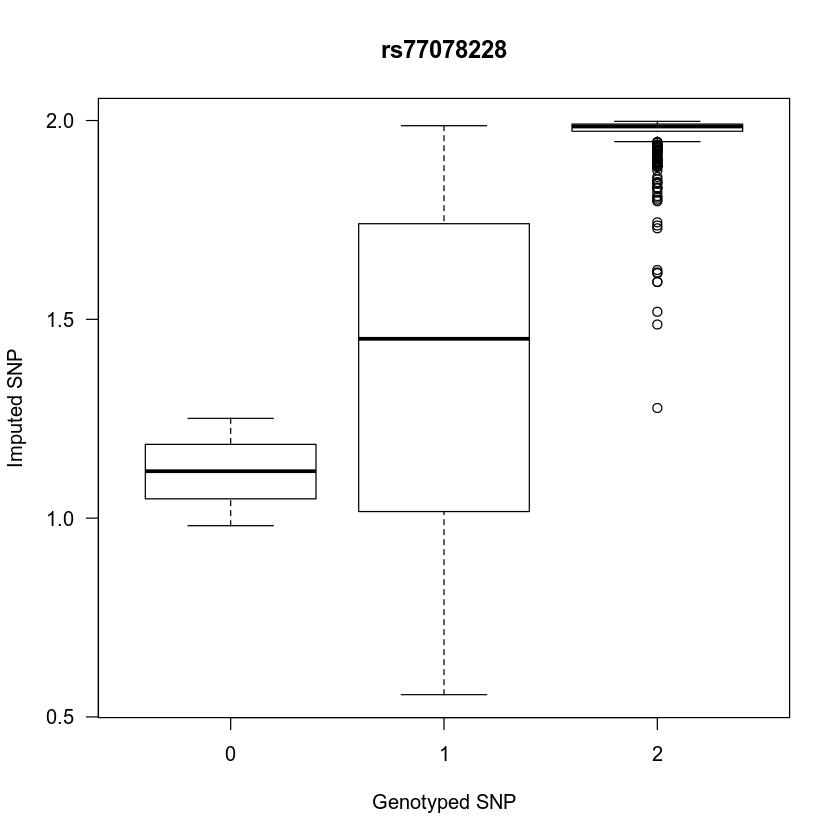

[1] "rs36085973"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.648, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7758966 0.8246050
sample estimates:
      cor 
0.8015769 



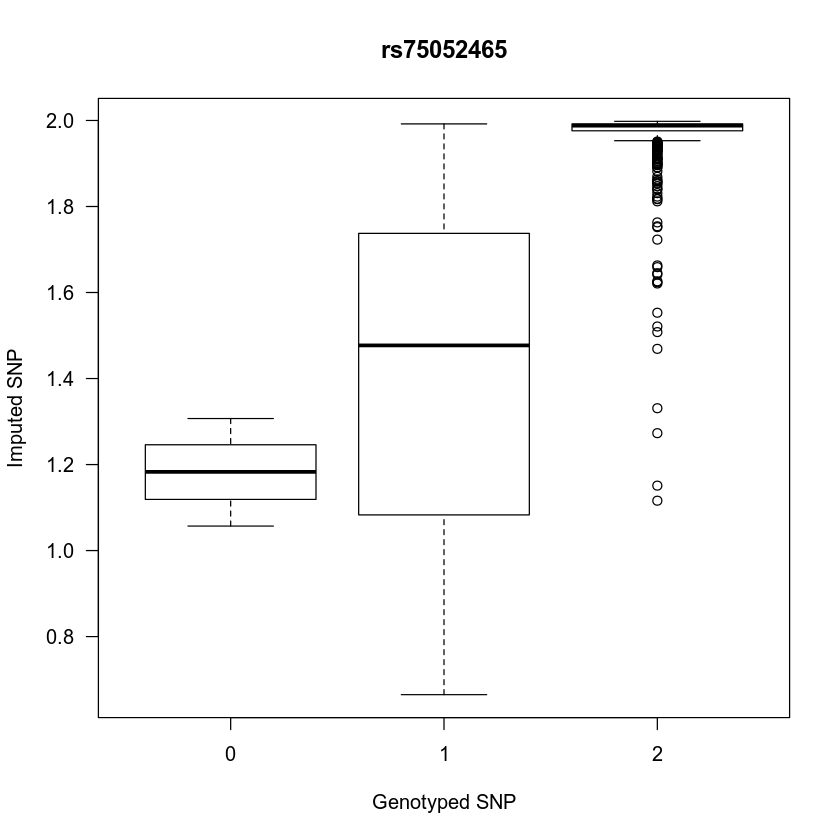

[1] "rs79420725"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 36.025, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7527941 0.8059752
sample estimates:
      cor 
0.7807949 



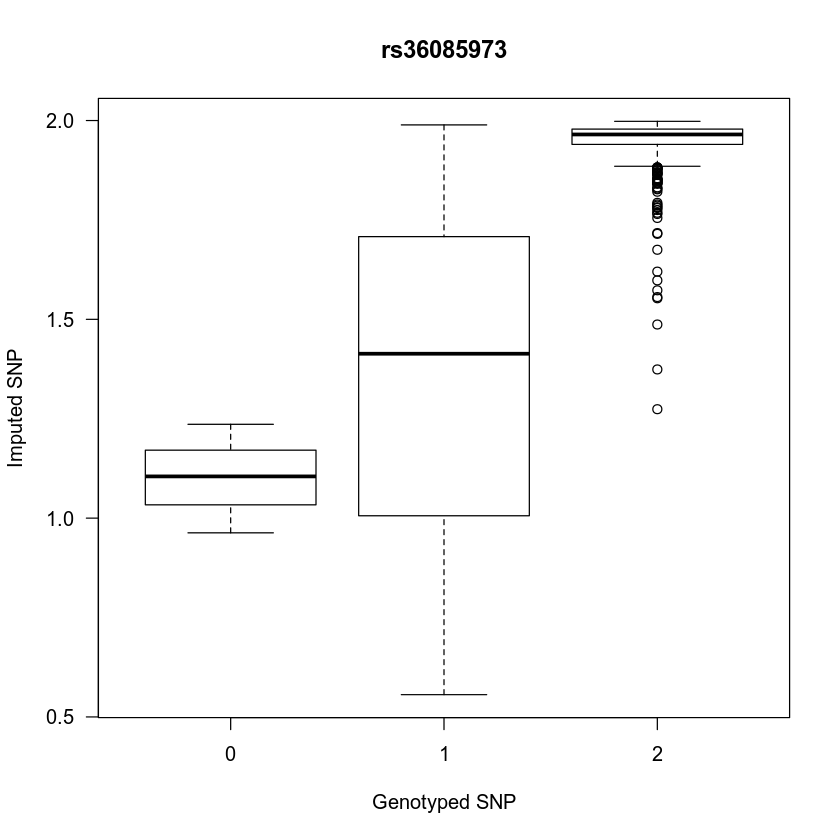

[1] "rs77476705"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 36.735, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7593425 0.8112666
sample estimates:
      cor 
0.7866919 



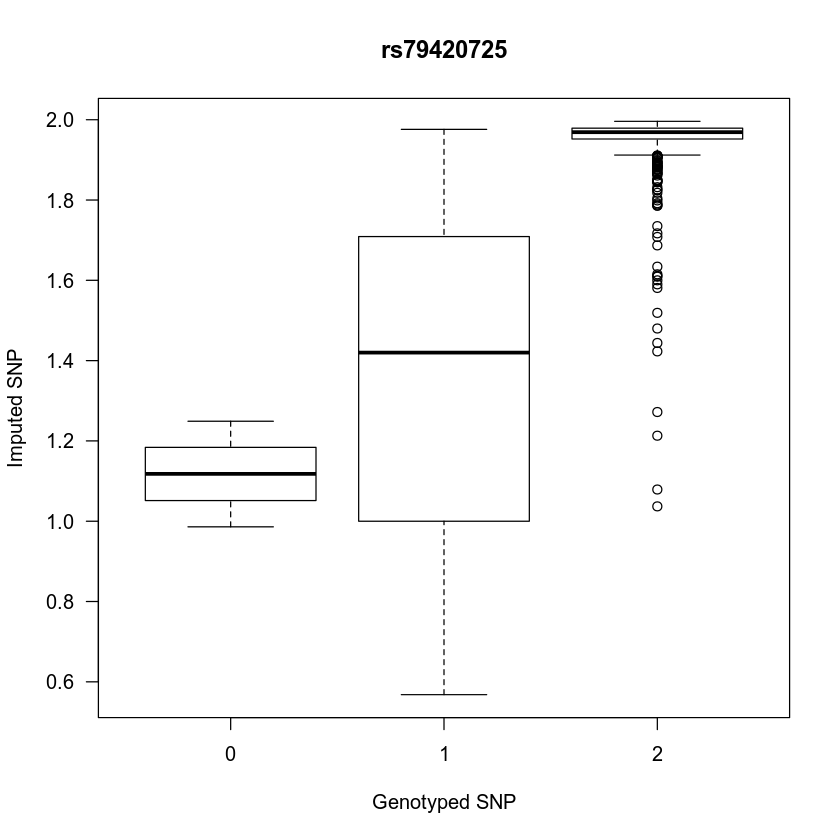

[1] "rs11697305"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.247, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7807746 0.8285252
sample estimates:
     cor 
0.805957 



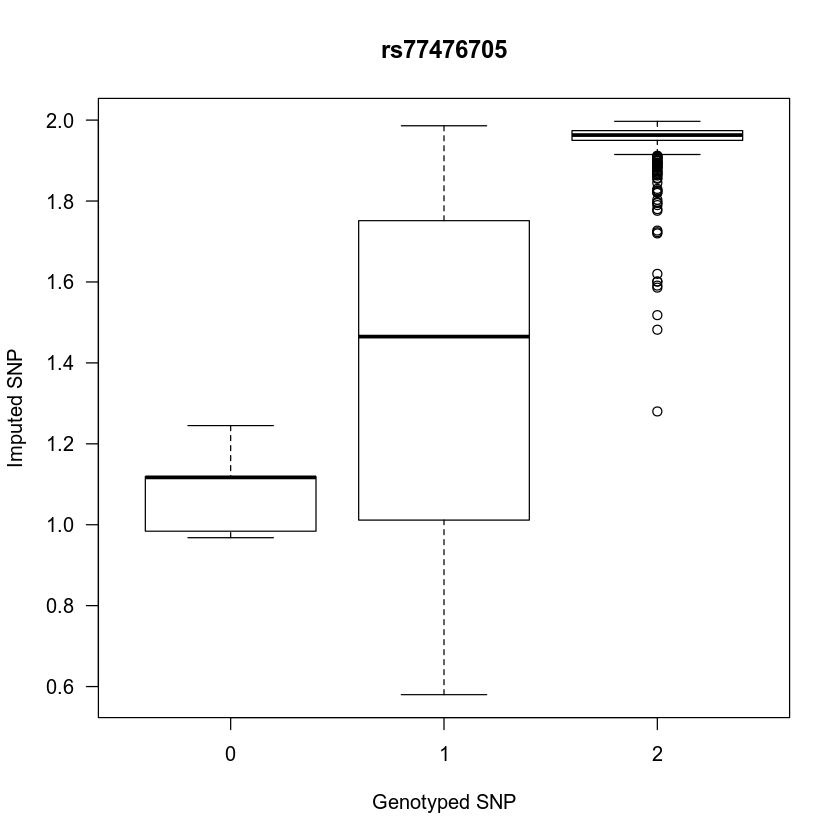

[1] "rs11697341"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.496, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7746414 0.8235956
sample estimates:
      cor 
0.8004494 



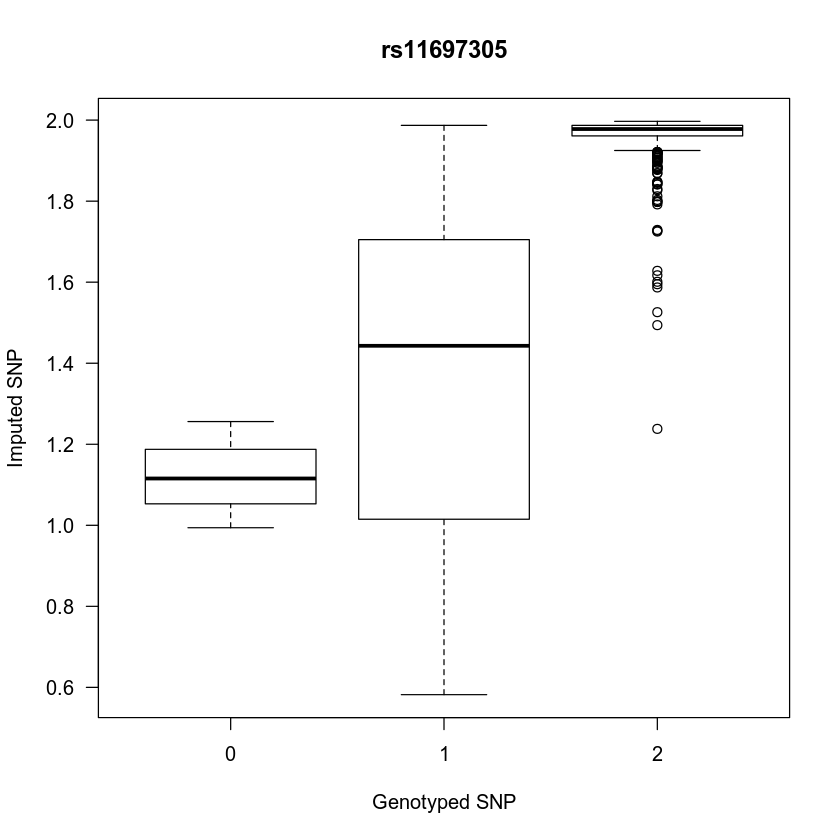

[1] "rs11697365"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.026, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7789928 0.8270938
sample estimates:
      cor 
0.8043574 



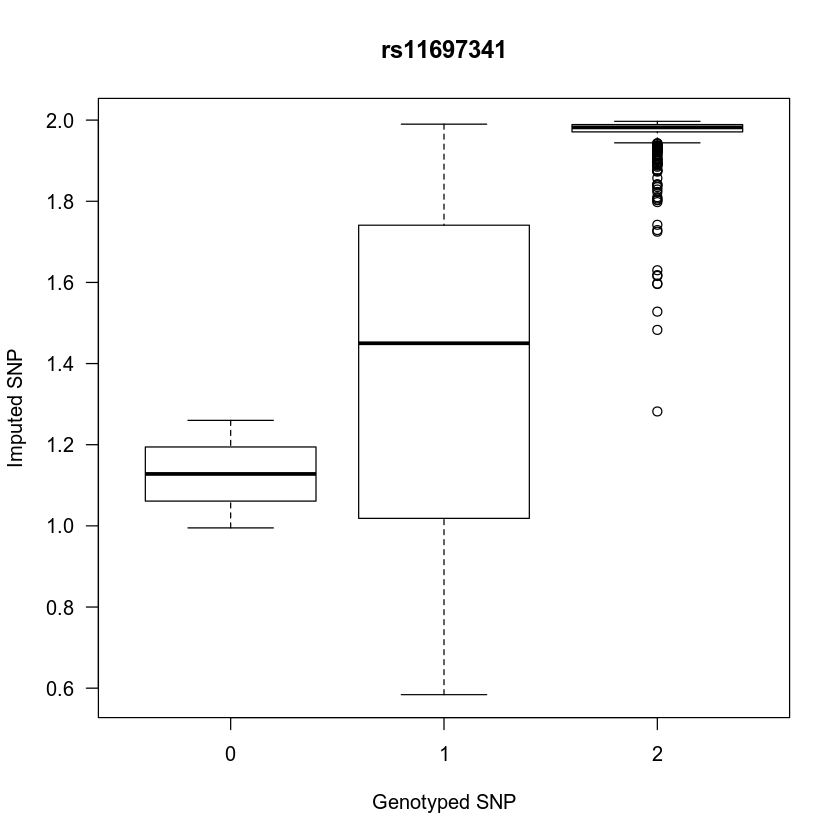

[1] "rs75414058"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.068, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7793300 0.8273647
sample estimates:
      cor 
0.8046601 



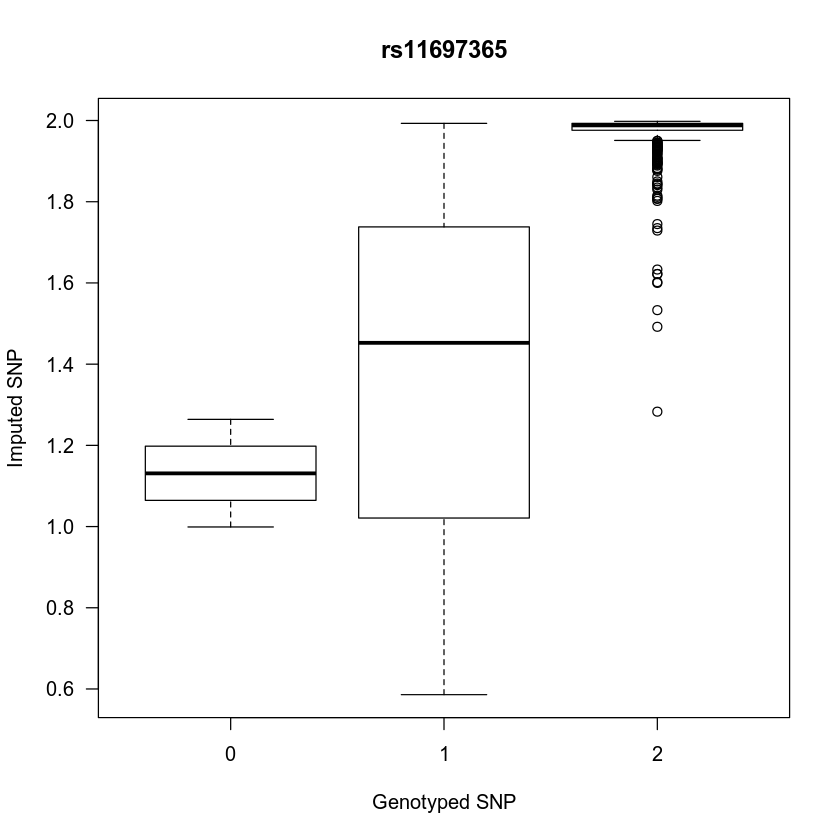

[1] "rs17655074"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 39.02, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7789388 0.8270504
sample estimates:
      cor 
0.8043088 



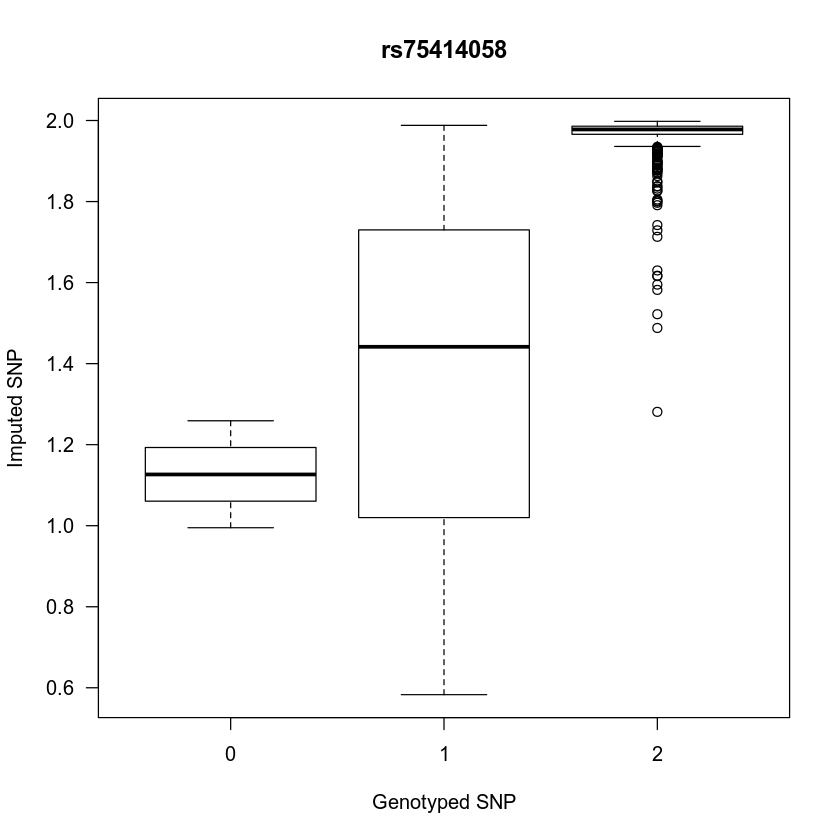

[1] "rs17655092"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 33.423, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7267063 0.7848106
sample estimates:
      cor 
0.7572528 



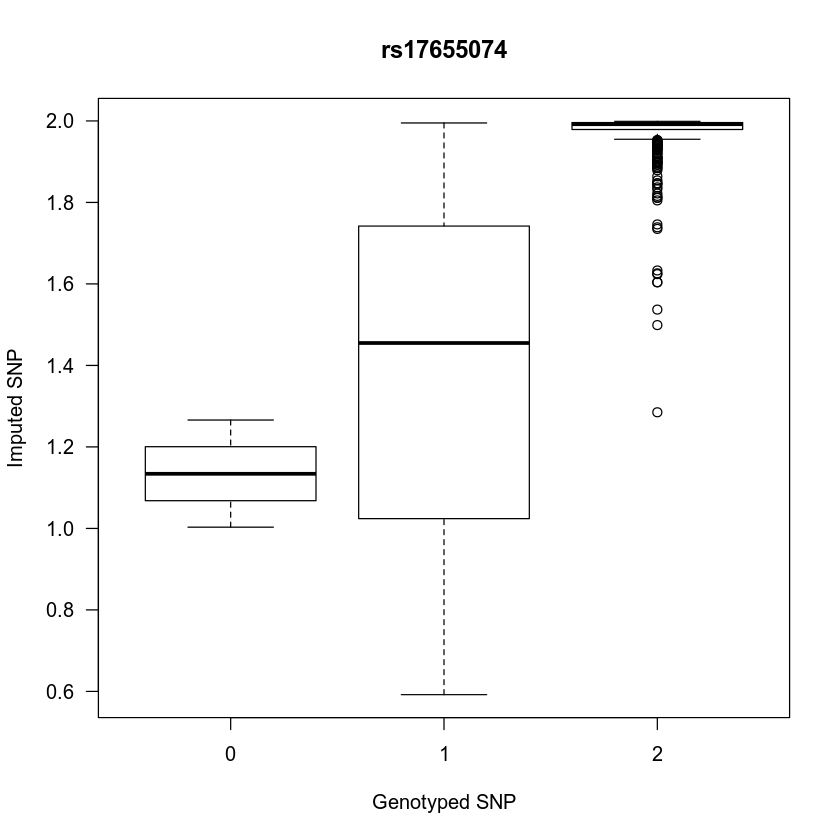

[1] "rs11699168"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.572, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7752745 0.8241048
sample estimates:
      cor 
0.8010181 



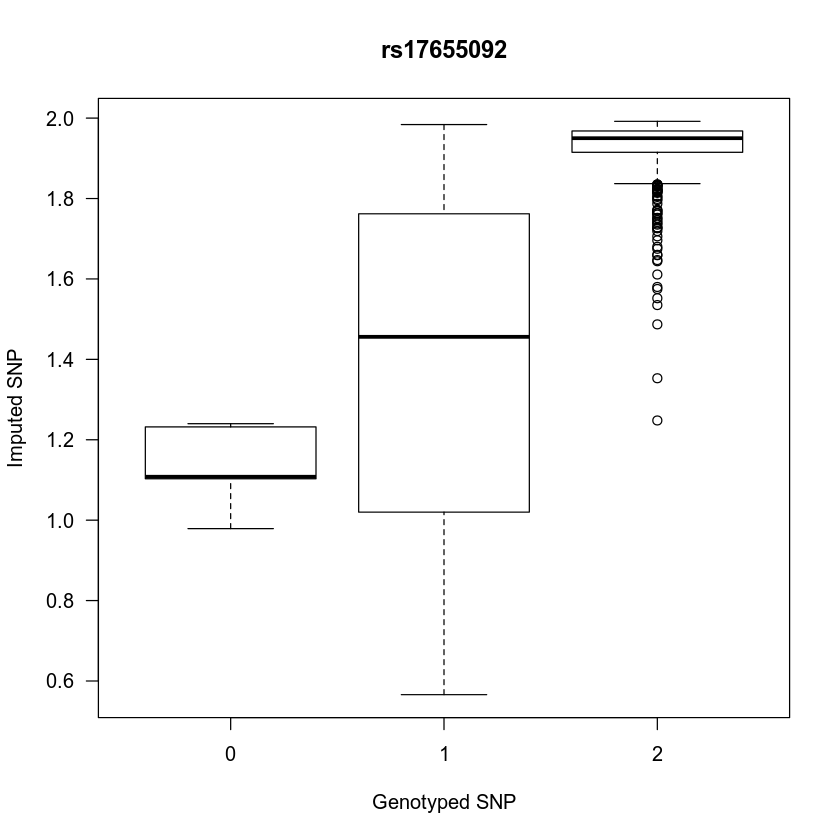

[1] "rs17655170"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.845, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7775204 0.8259105
sample estimates:
      cor 
0.8030353 



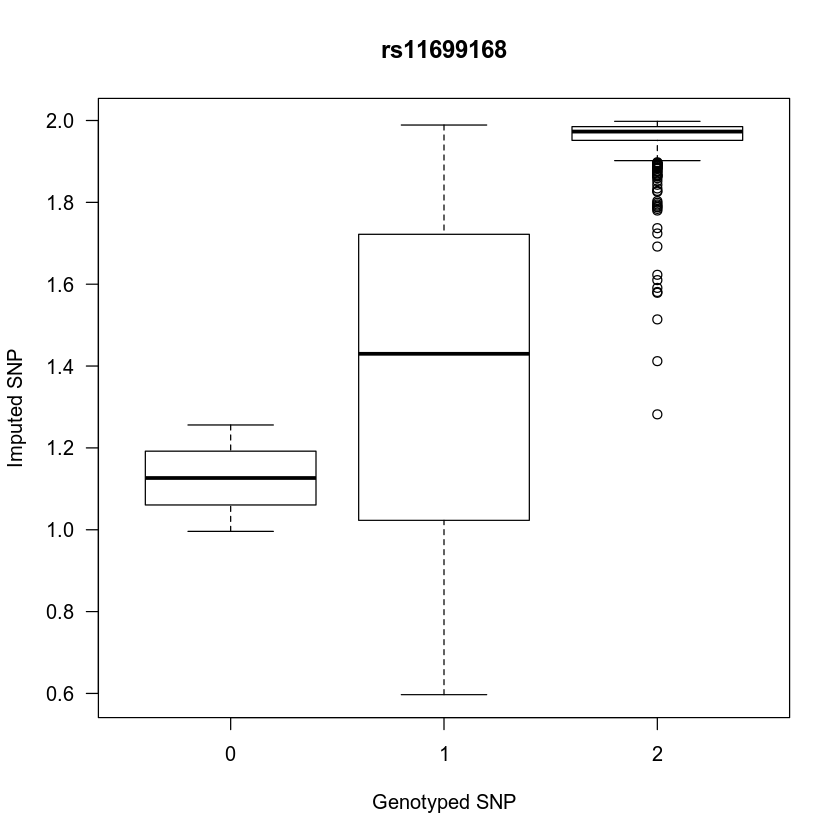

[1] "rs11698334"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 38.77, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7769069 0.8254174
sample estimates:
      cor 
0.8024843 



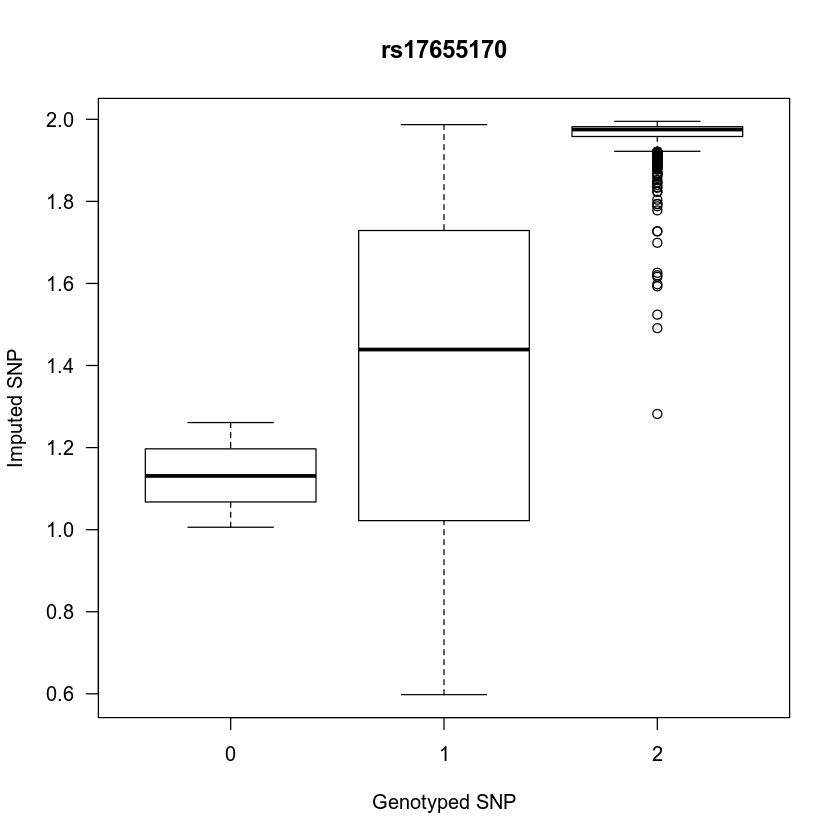

[1] "rs11924564"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = -27.769, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 -0.7274124 -0.6567899
sample estimates:
       cor 
-0.6937652 



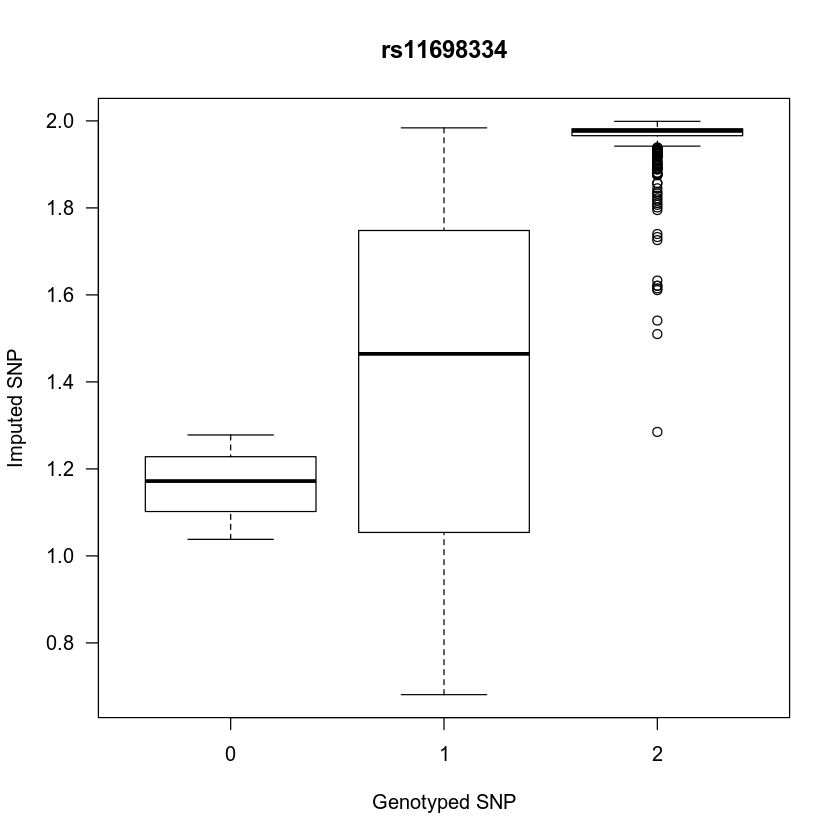

[1] "rs61790955"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = -0.94822, df = 831, p-value = 0.3433
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 -0.10057772  0.03512929
sample estimates:
        cor 
-0.03287574 



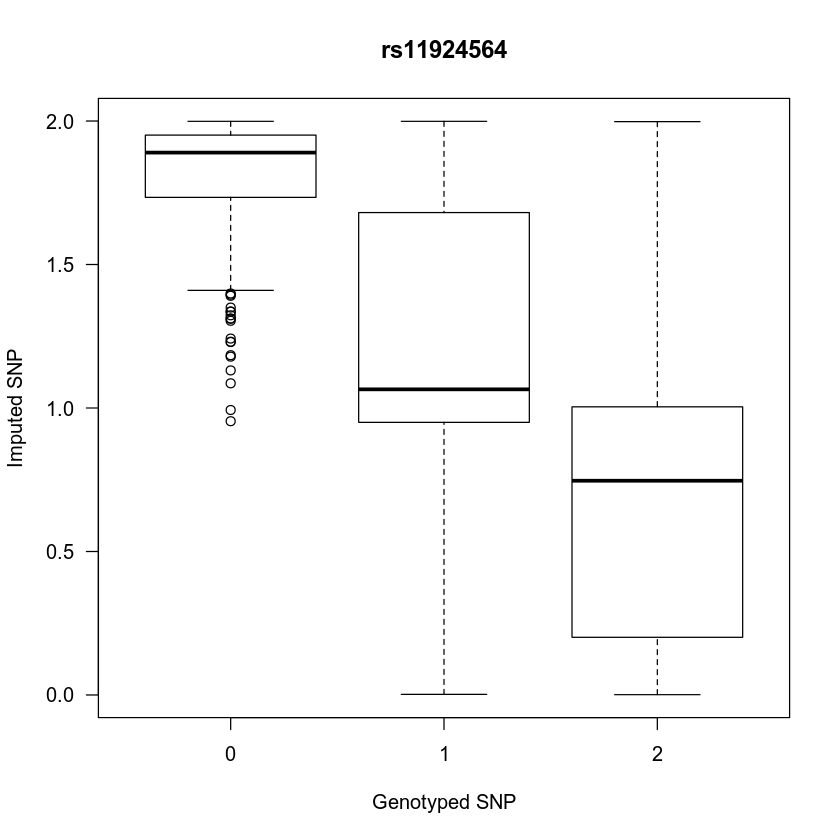

[1] "rs115892257"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.984, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9162502 0.9355600
sample estimates:
      cor 
0.9265127 



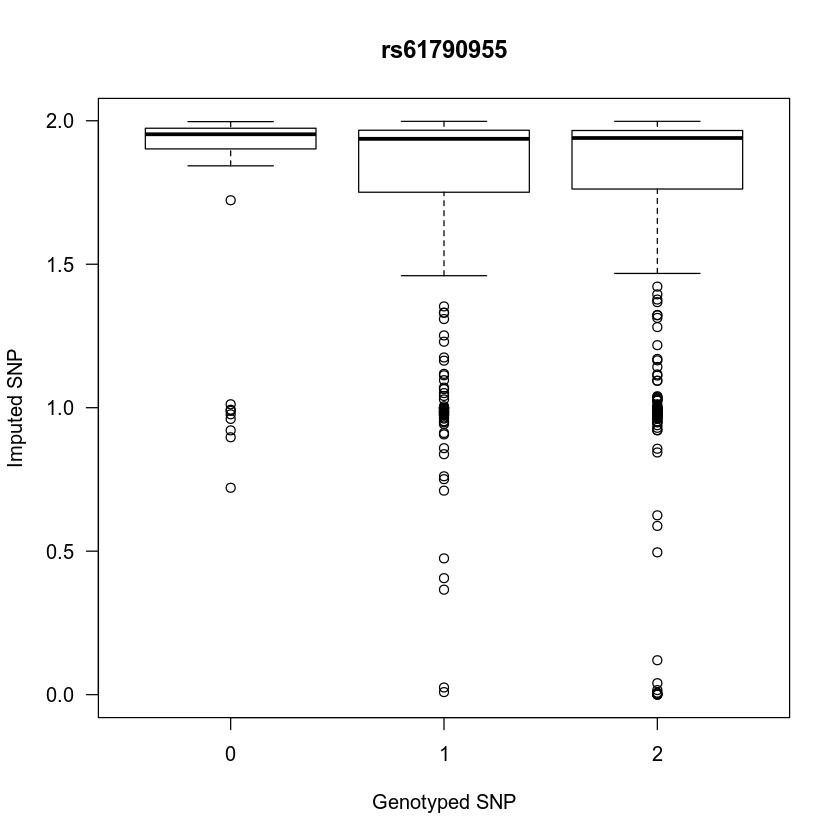

[1] "rs61790956"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.882, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9160358 0.9353933
sample estimates:
      cor 
0.9263236 



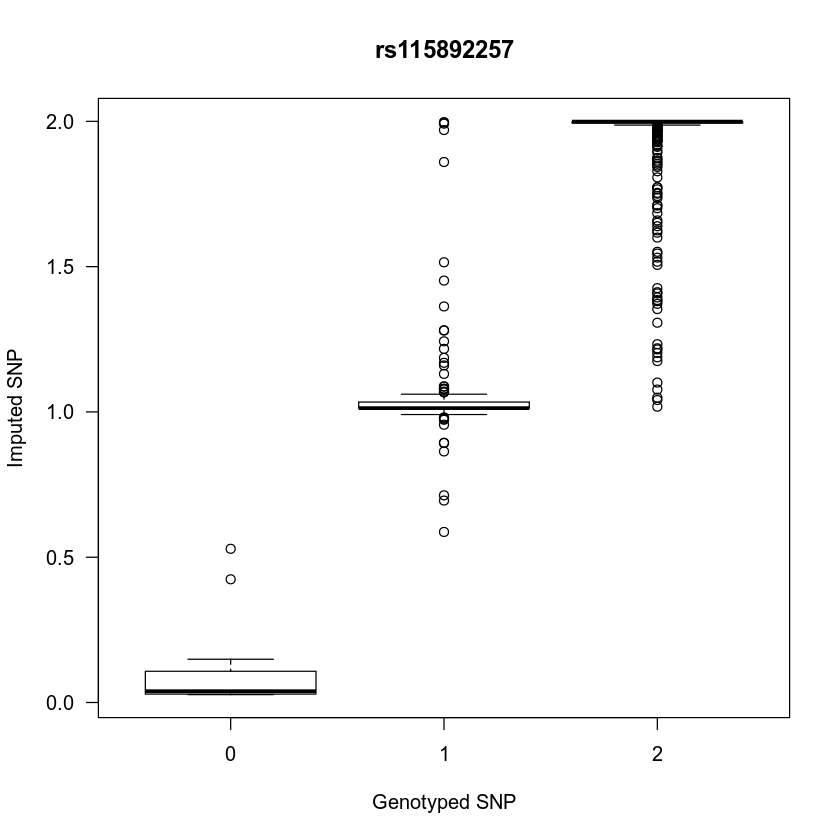

[1] "rs79180290"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.833, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9159322 0.9353129
sample estimates:
      cor 
0.9262322 



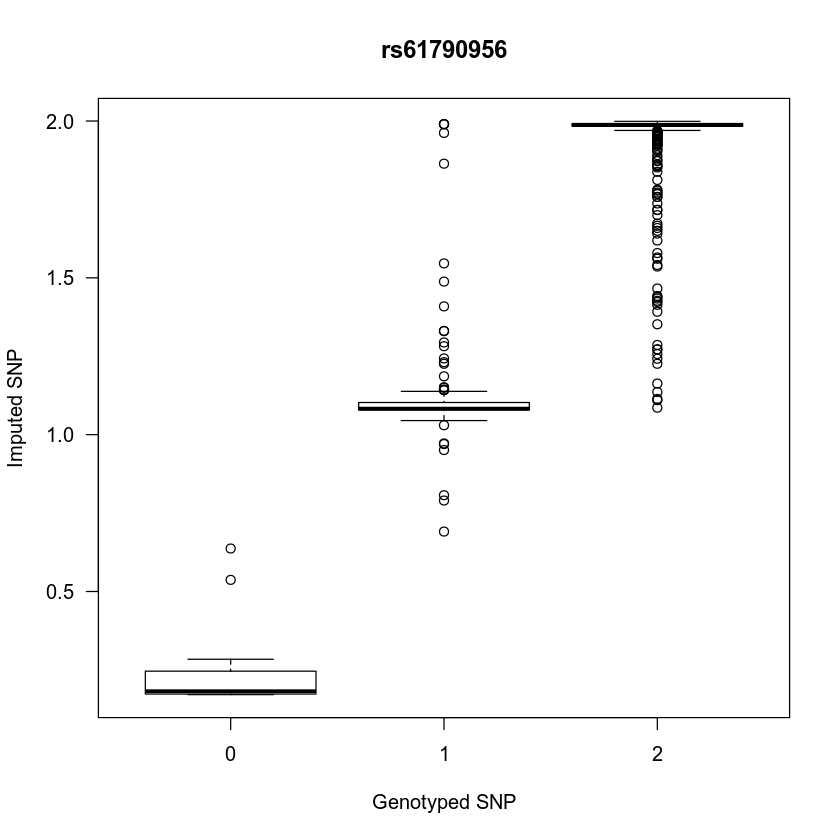

[1] "rs76971107"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.829, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9159252 0.9353074
sample estimates:
     cor 
0.926226 



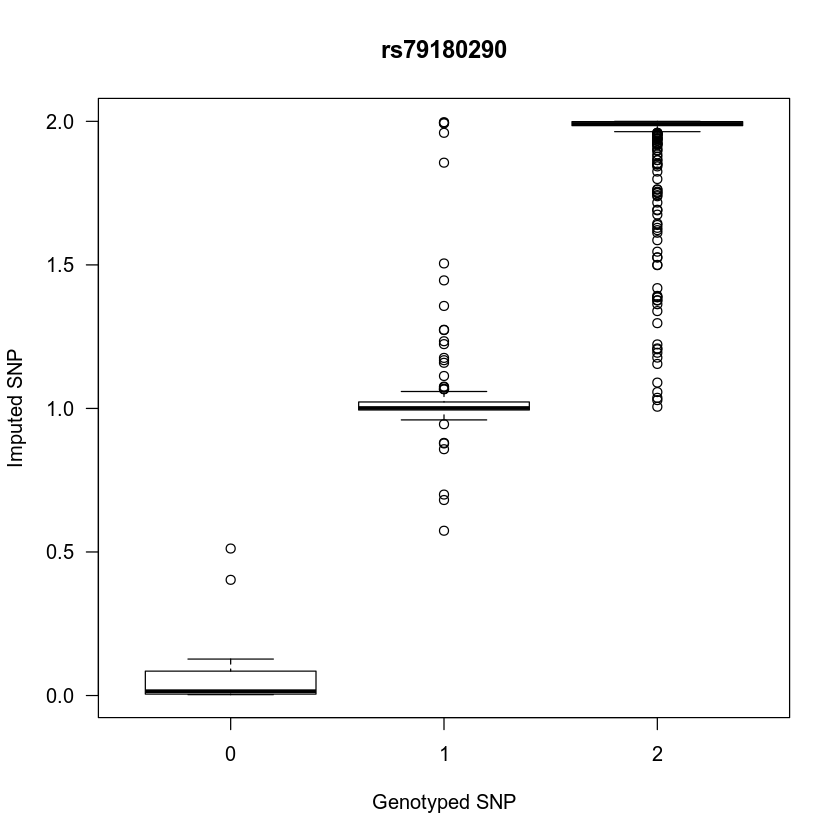

[1] "rs61792262"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 56.537, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8759606 0.9040948
sample estimates:
      cor 
0.8908789 



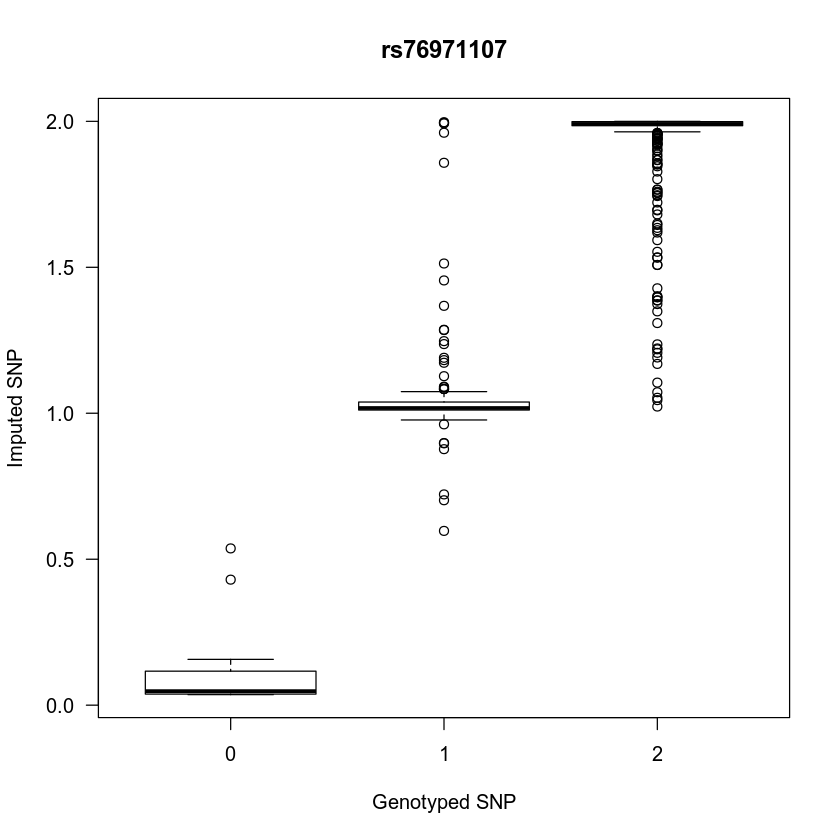

[1] "rs61792263"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 72.571, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9194813 0.9380701
sample estimates:
      cor 
0.9293624 



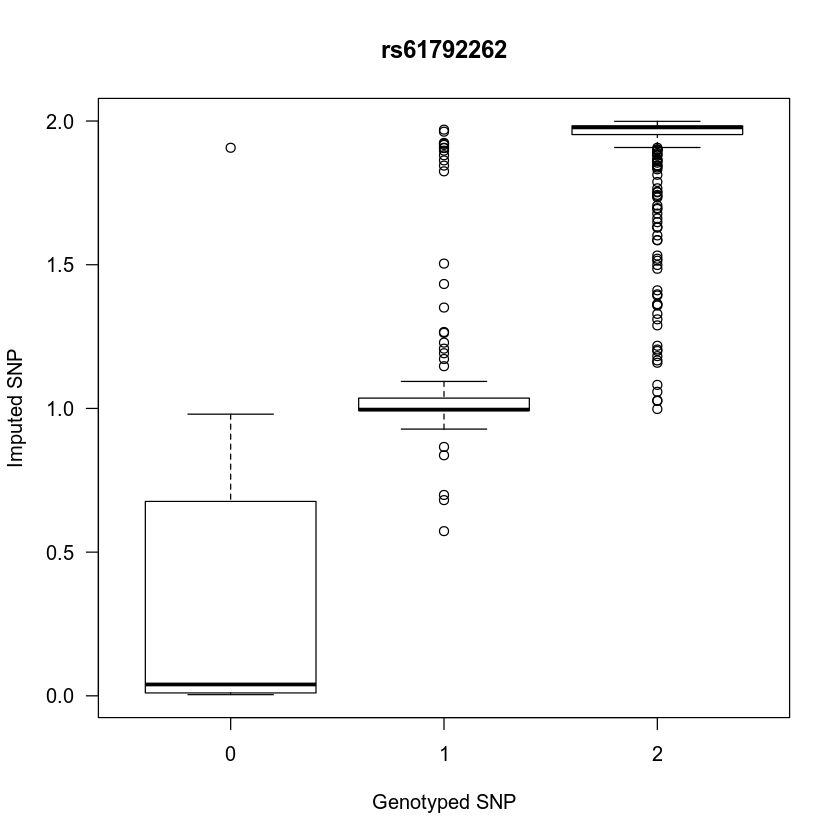

[1] "rs56367723"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 72.94, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9202080 0.9386345
sample estimates:
      cor 
0.9300033 



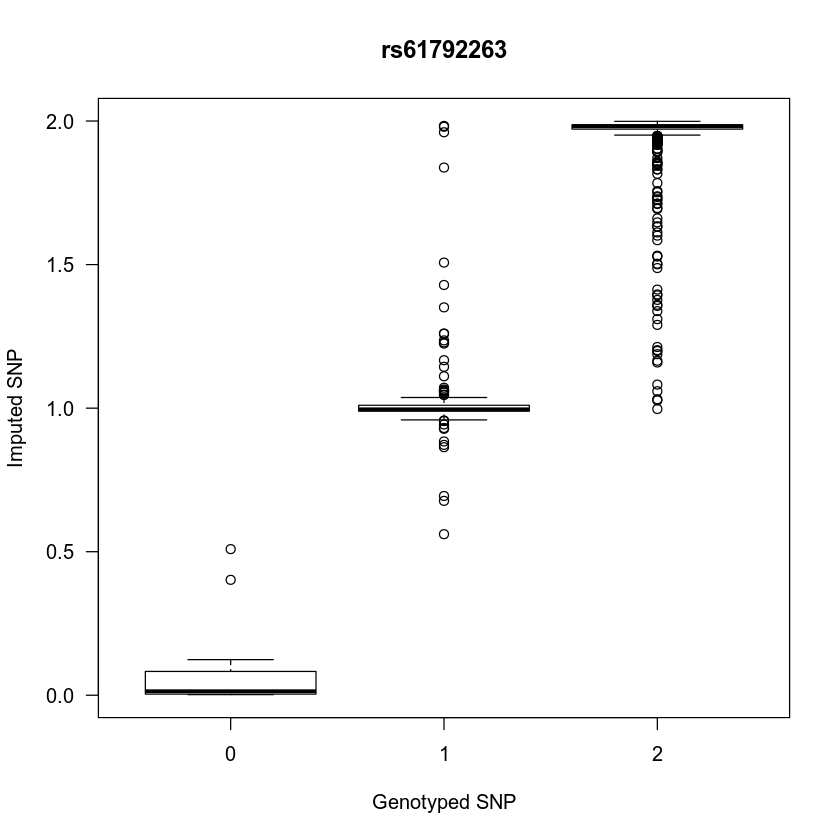

[1] "rs73870937"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 73.762, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9217908 0.9398632
sample estimates:
      cor 
0.9313987 



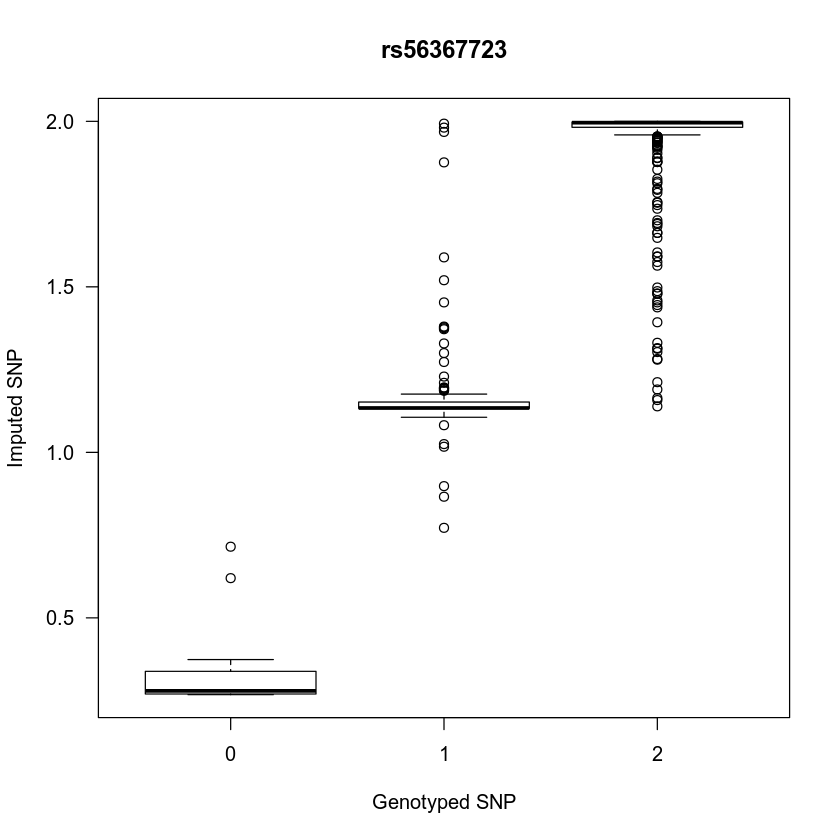

[1] "rs61792265"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 71.056, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9164016 0.9356777
sample estimates:
      cor 
0.9266463 



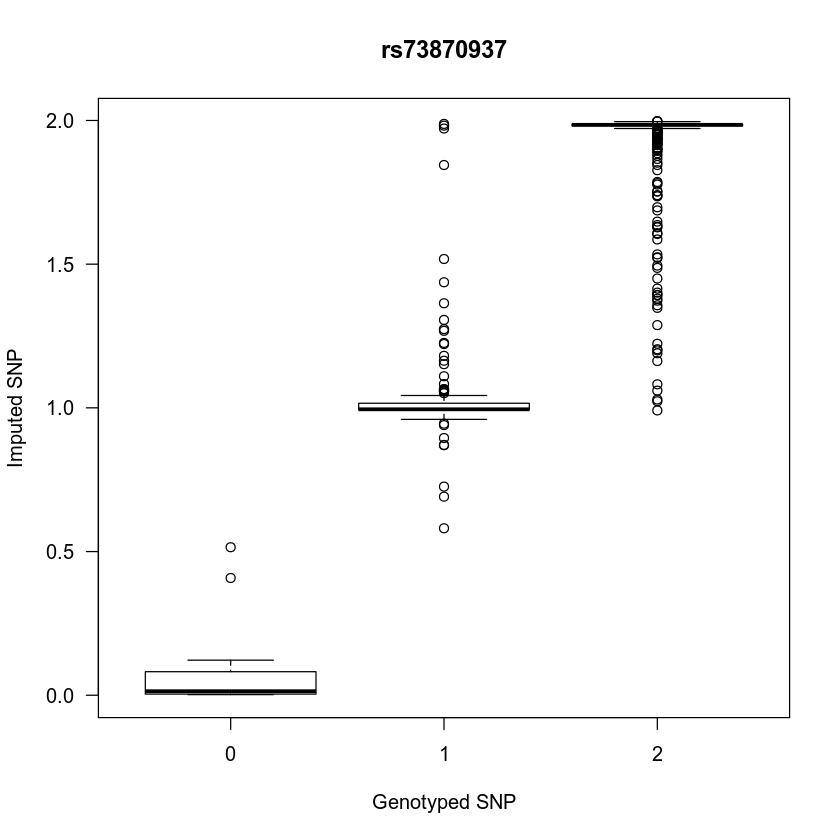

[1] "rs11926043"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 71.801, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9179375 0.9368711
sample estimates:
     cor 
0.928001 



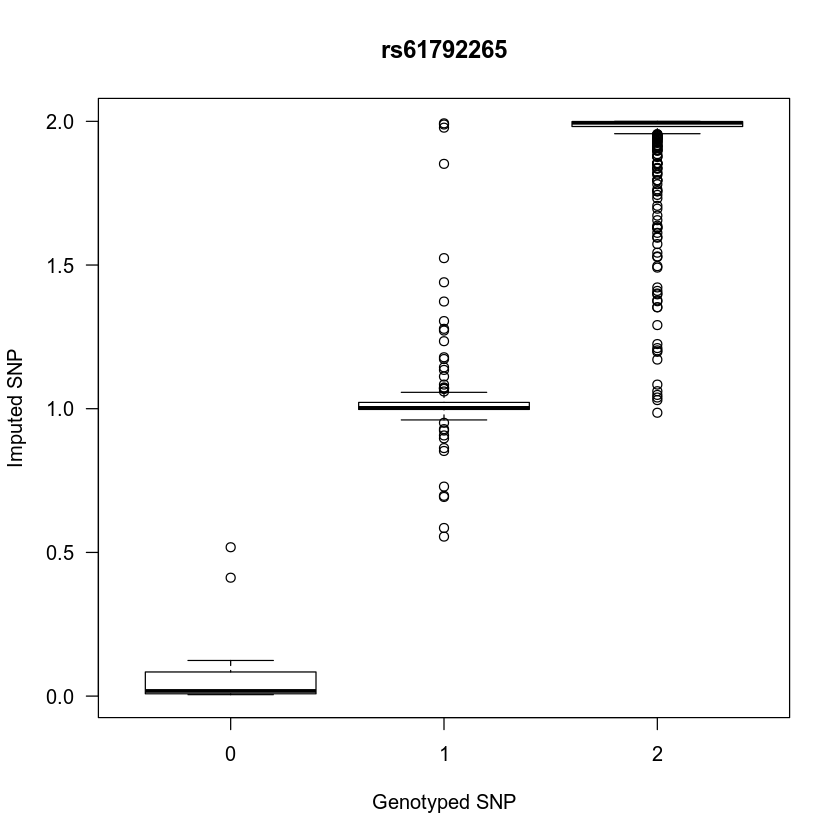

[1] "rs11914785"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 74.044, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9223236 0.9402767
sample estimates:
      cor 
0.9318684 



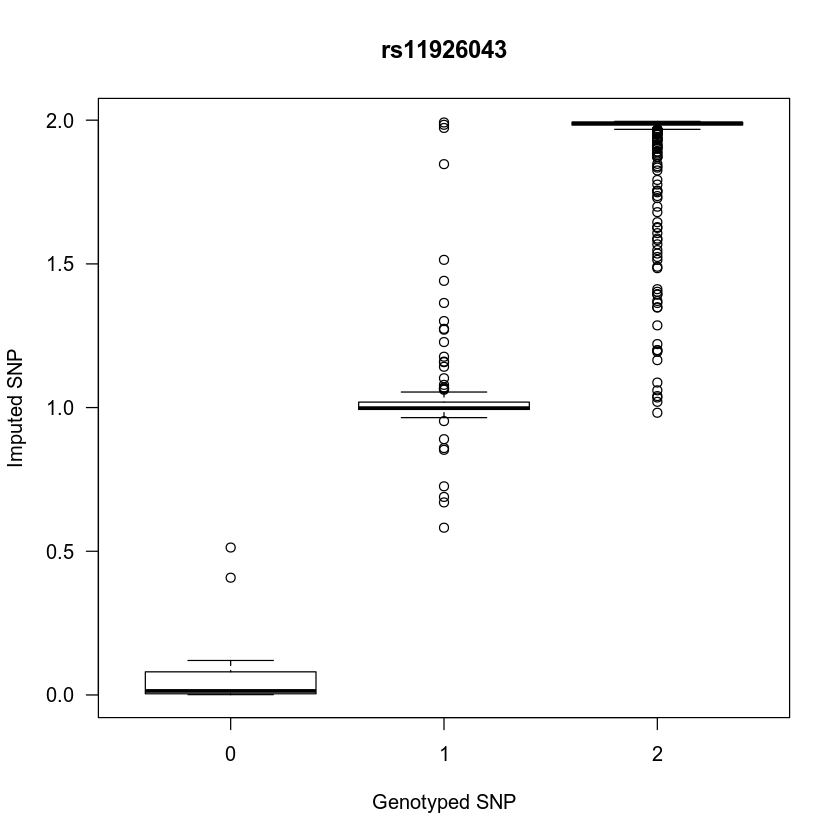

[1] "rs61792267"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 74.088, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9224062 0.9403408
sample estimates:
      cor 
0.9319412 



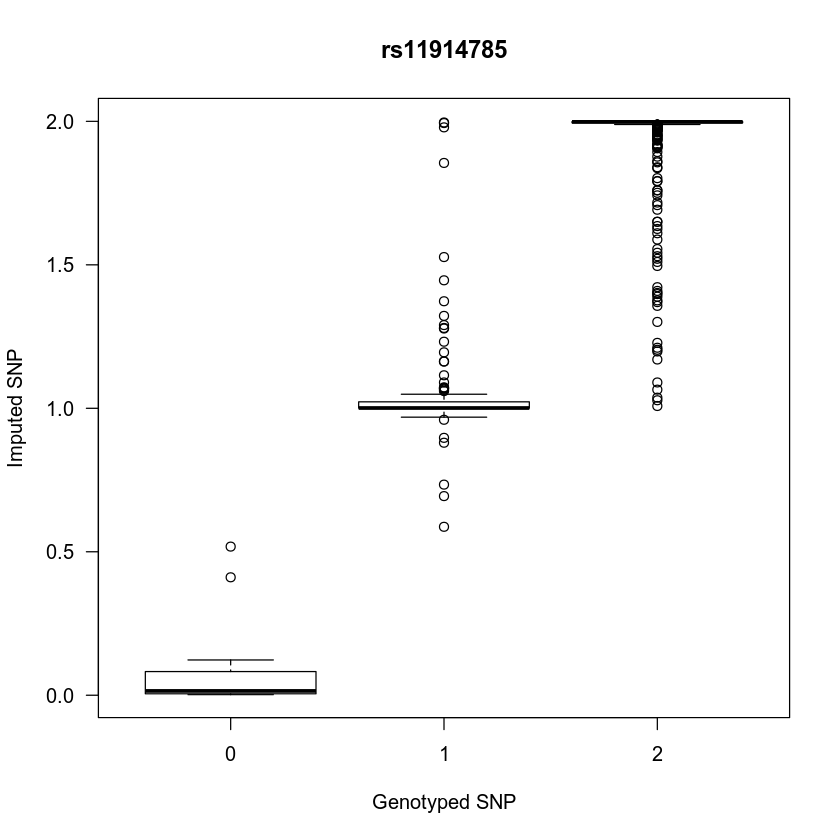

[1] "rs11915886"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 74.031, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9222977 0.9402566
sample estimates:
      cor 
0.9318456 



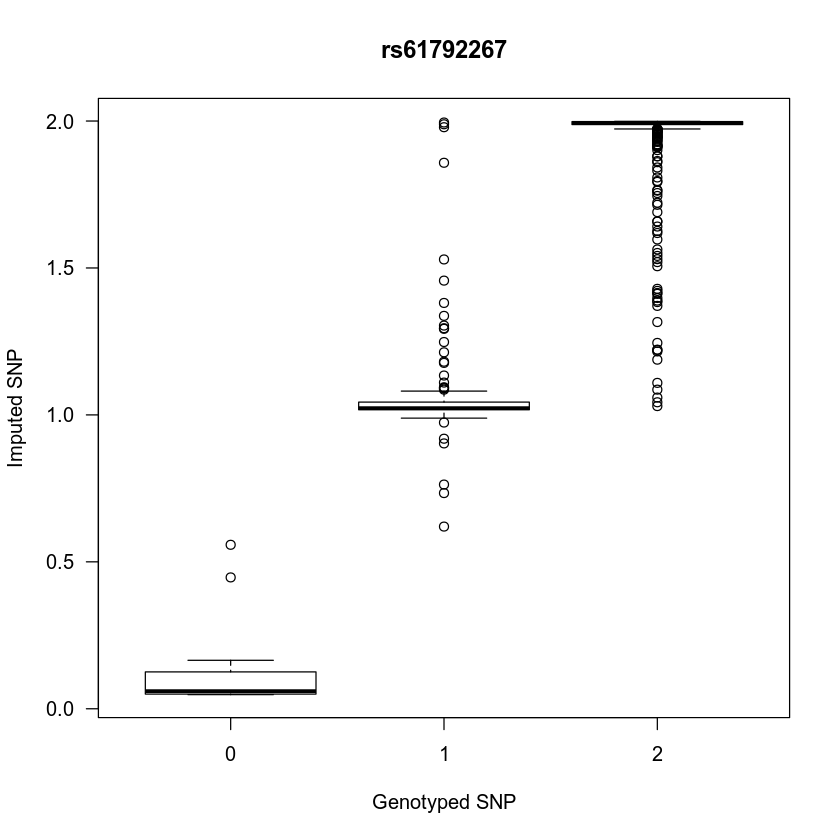

[1] "rs61792268"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 73.964, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9221730 0.9401598
sample estimates:
      cor 
0.9317356 



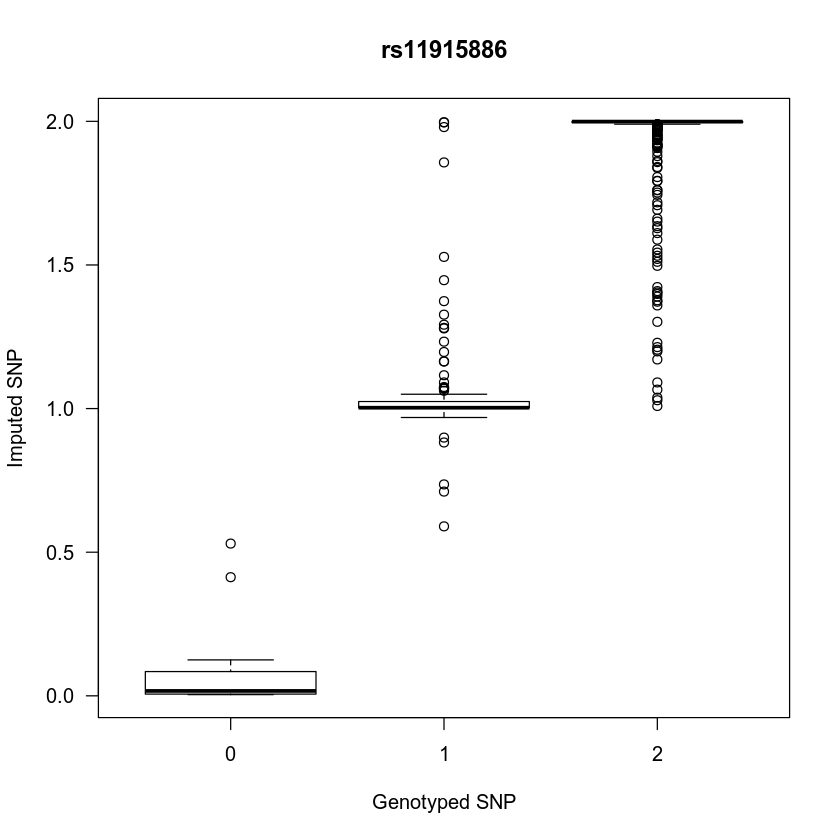

[1] "rs61792269"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 73.97, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9221844 0.9401687
sample estimates:
      cor 
0.9317457 



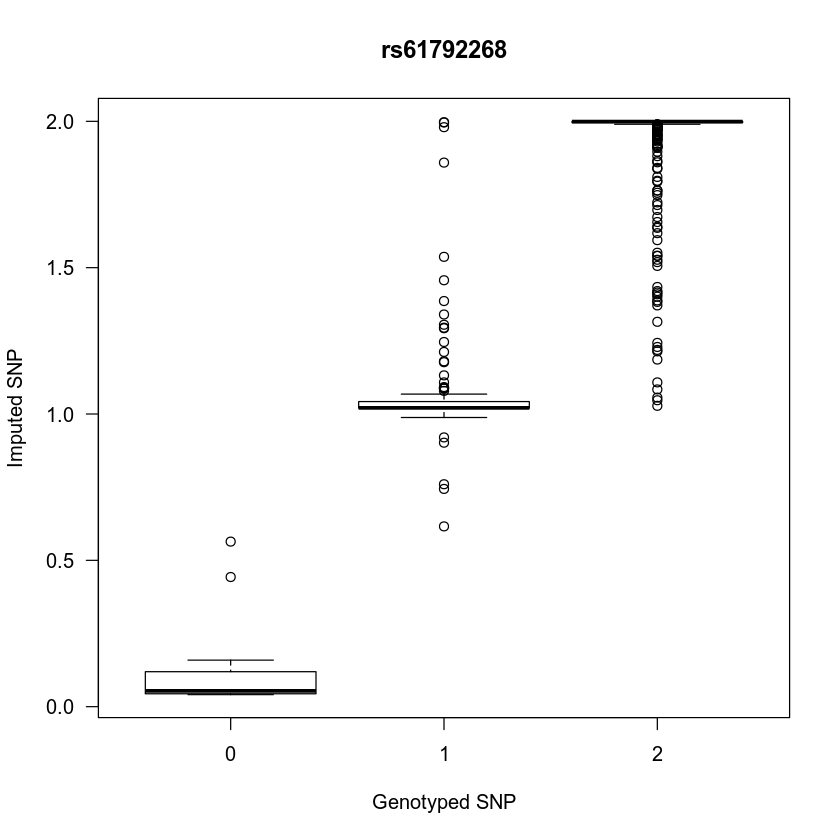

[1] "rs61792270"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 74.033, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9223021 0.9402600
sample estimates:
      cor 
0.9318494 



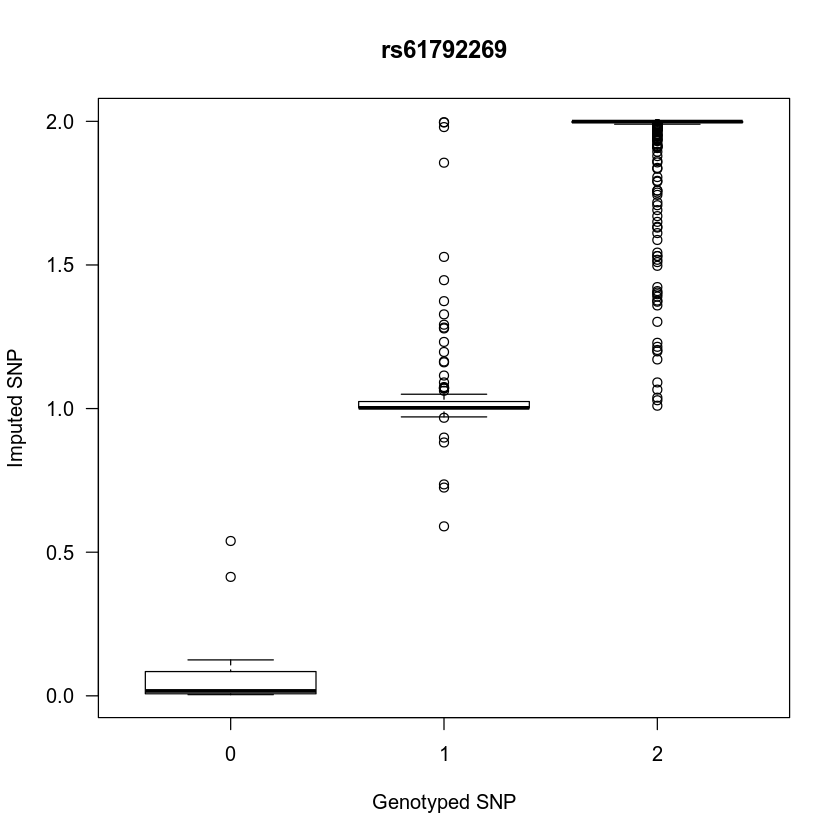

[1] "rs61792271"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 73.953, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9221508 0.9401426
sample estimates:
      cor 
0.9317161 



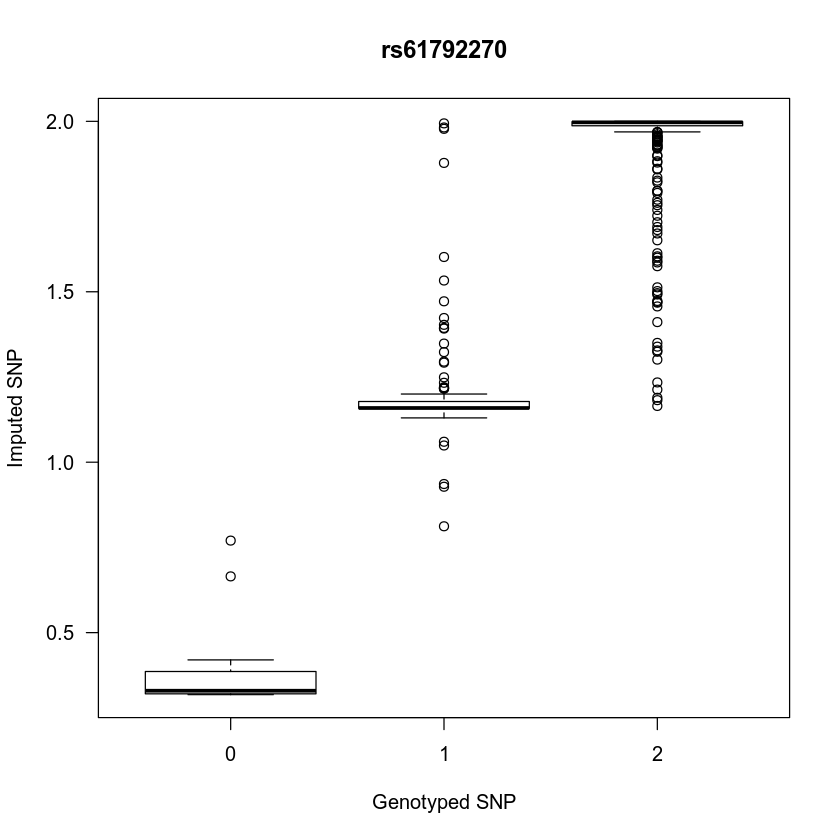

[1] "rs61792303"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 73.953, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9221517 0.9401433
sample estimates:
      cor 
0.9317168 



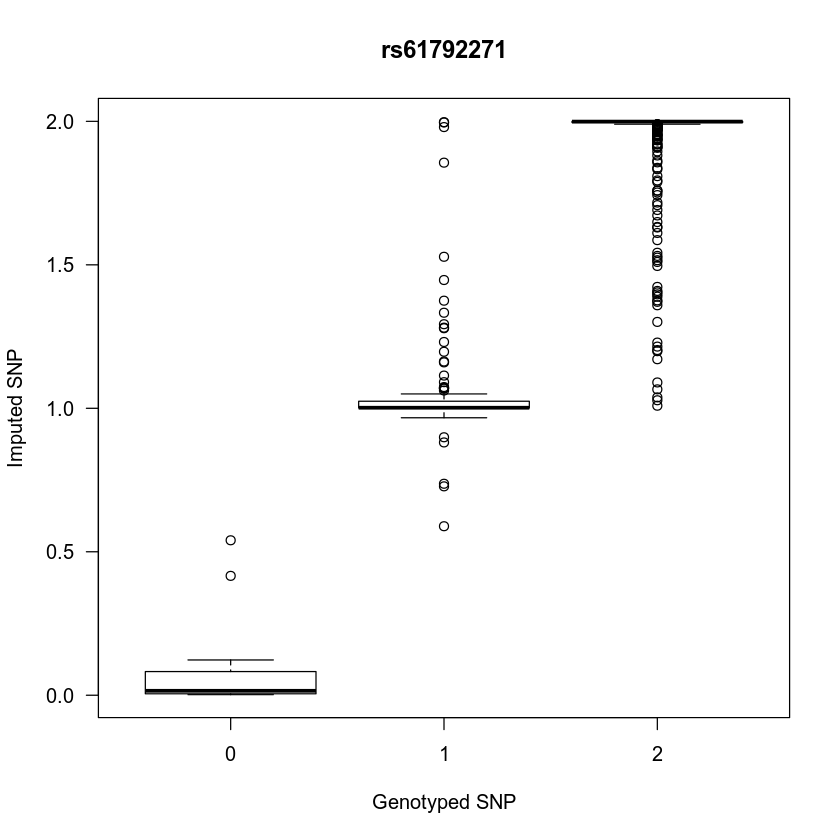

[1] "rs138568838"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 73.866, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9219882 0.9400164
sample estimates:
      cor 
0.9315727 



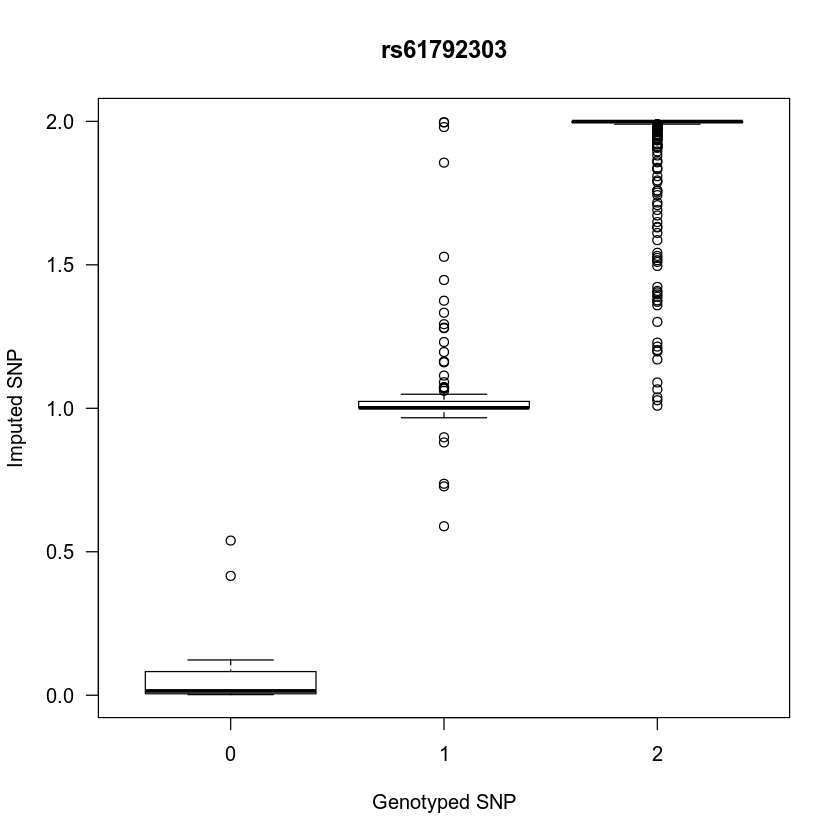

[1] "rs61792306"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 67.517, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9085097 0.9295385
sample estimates:
      cor 
0.9196809 



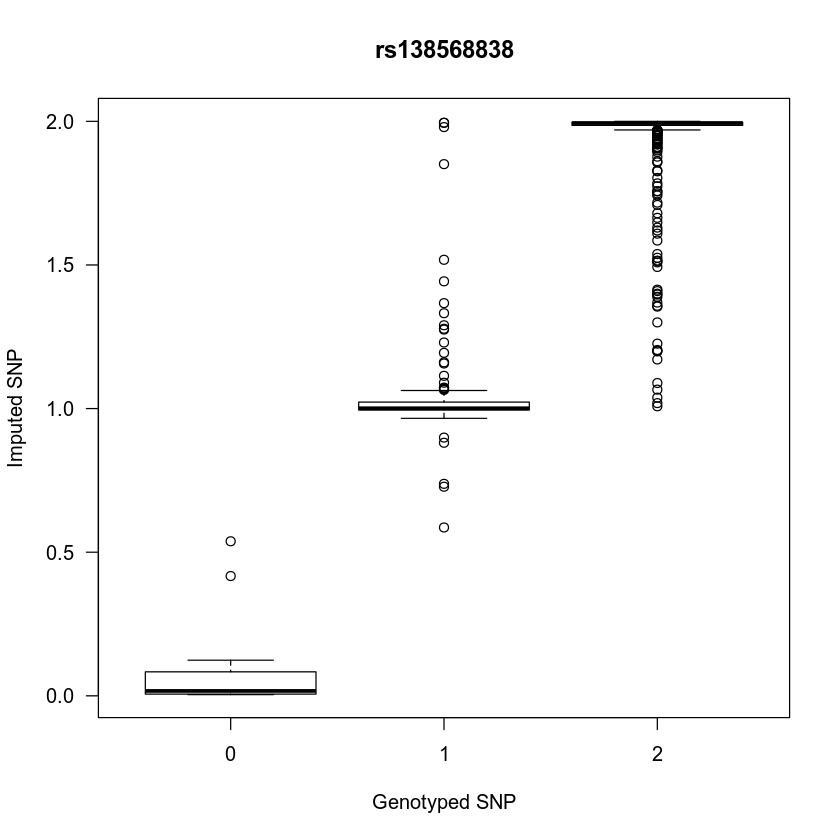

[1] "rs76082952"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 67.602, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9087102 0.9296947
sample estimates:
     cor 
0.919858 



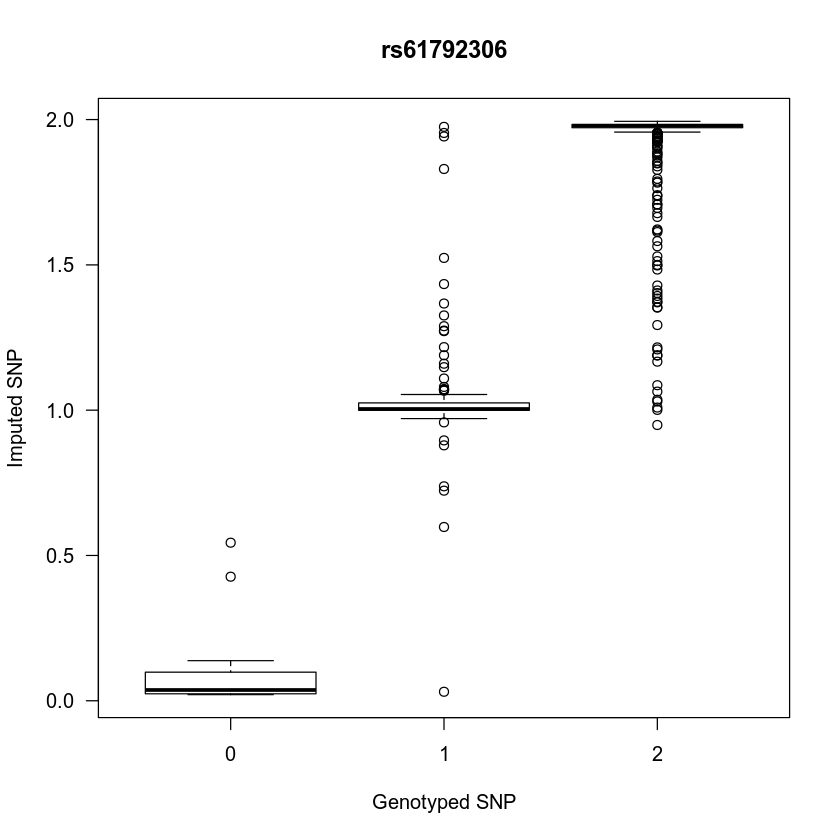

[1] "rs61792308"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 69.774, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9136599 0.9335462
sample estimates:
      cor 
0.9242273 



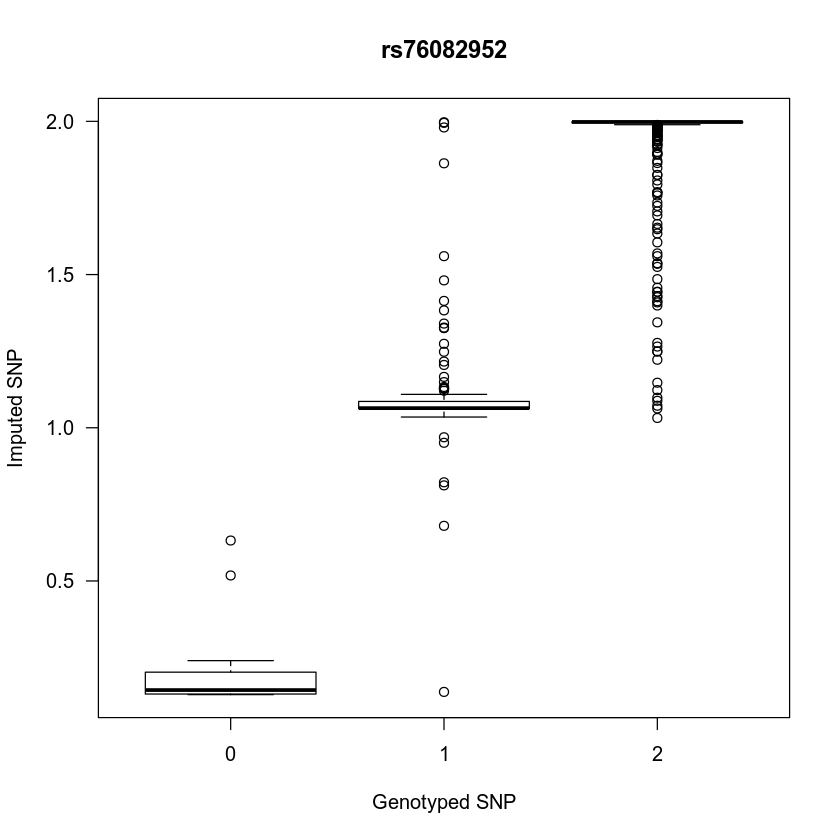

[1] "rs61792309"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 69.121, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9122127 0.9324205
sample estimates:
      cor 
0.9229501 



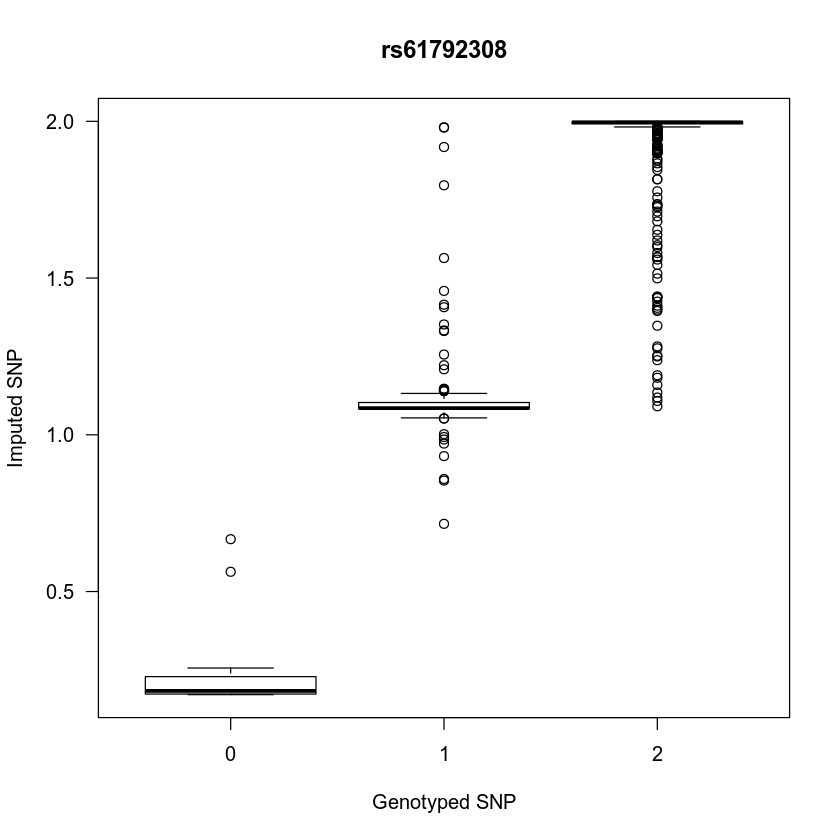

[1] "rs61792310"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 69.418, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9128752 0.9329359
sample estimates:
      cor 
0.9235348 



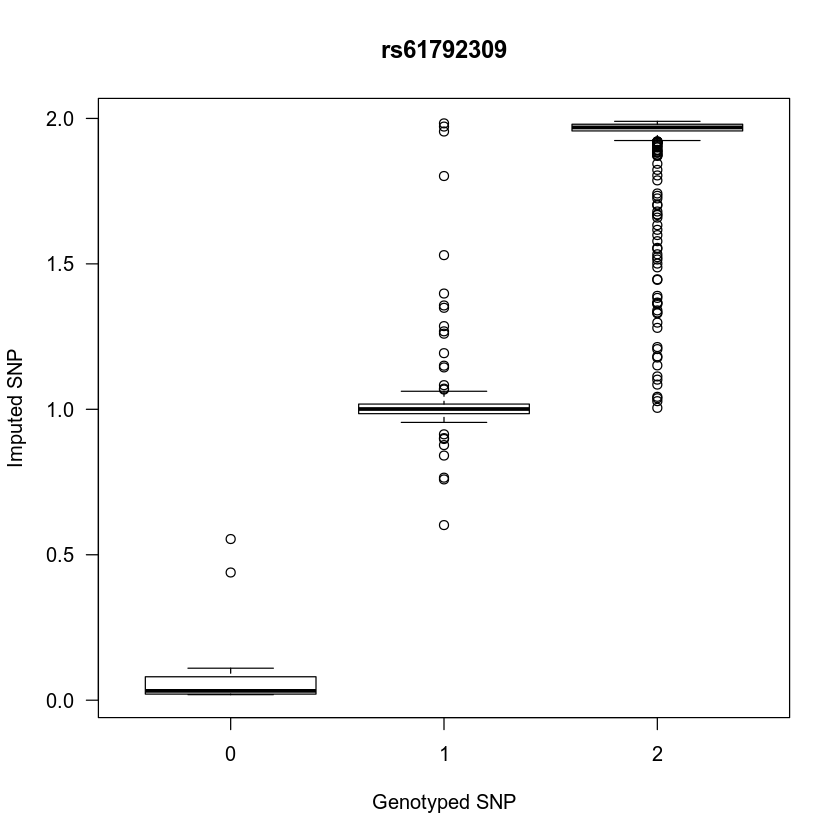

[1] "rs61792312"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 69.073, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9121065 0.9323380
sample estimates:
      cor 
0.9228564 



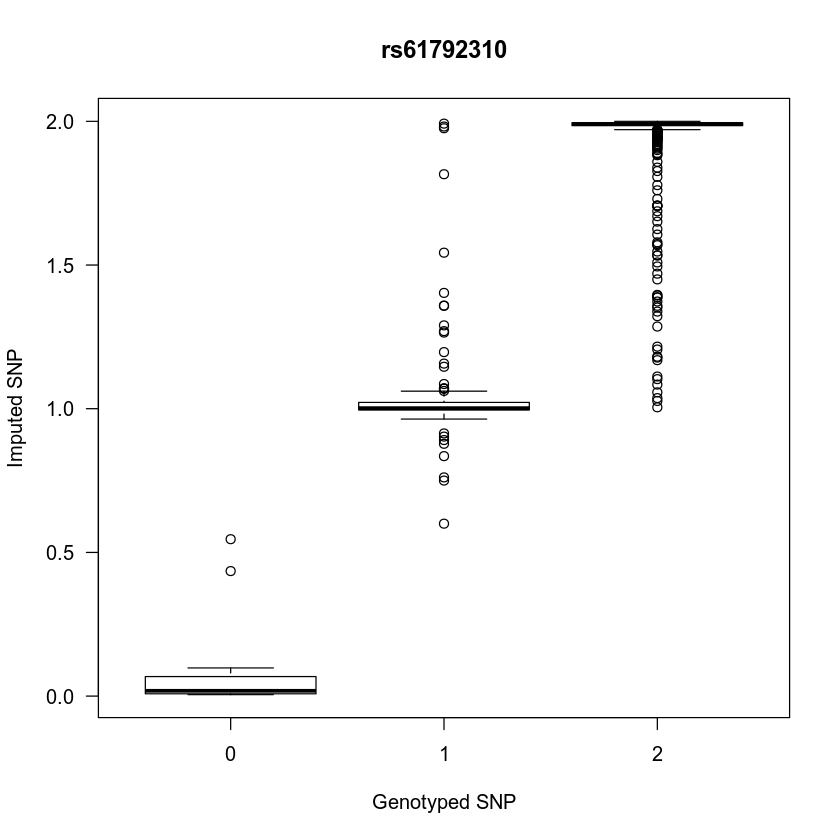

[1] "rs61792314"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.676, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9156023 0.9350564
sample estimates:
      cor 
0.9259412 



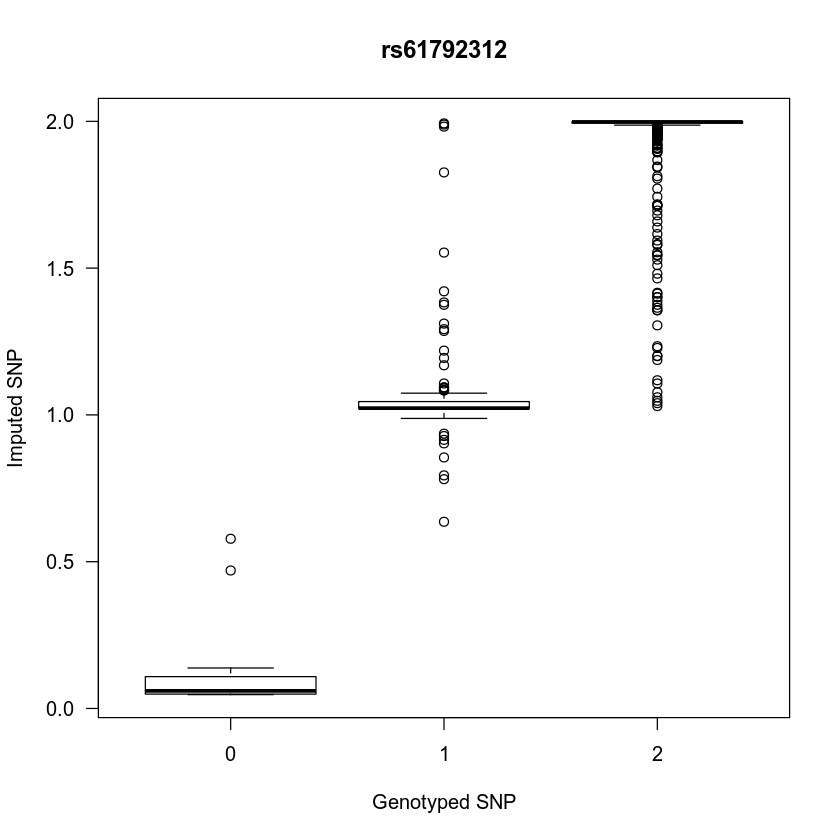

[1] "rs61792318"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.603, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9154474 0.9349360
sample estimates:
      cor 
0.9258044 



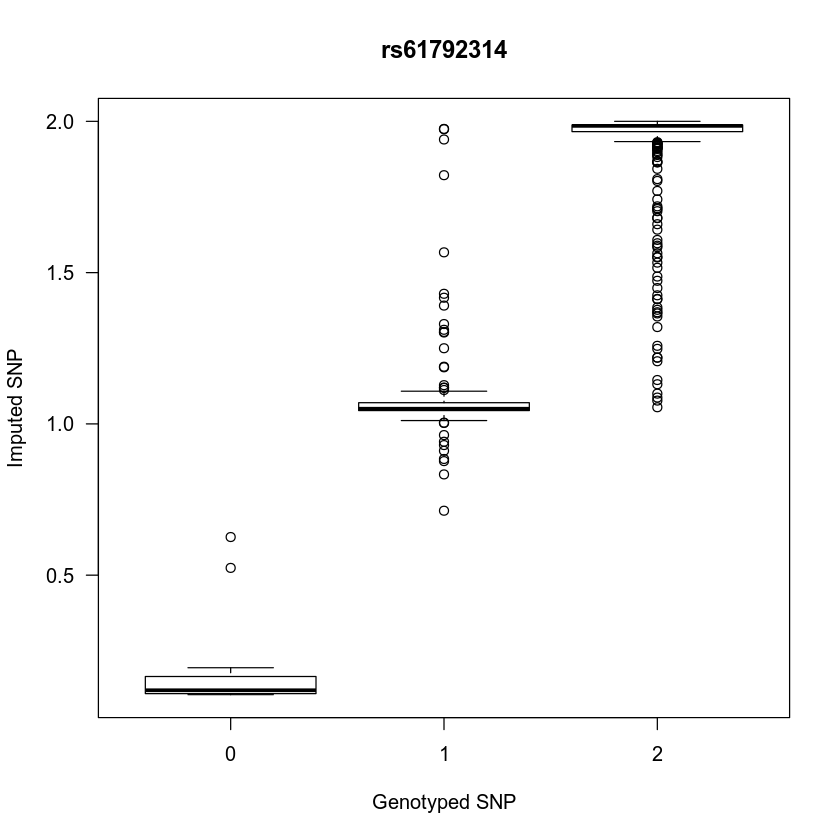

[1] "rs73156603"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.565, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9153667 0.9348733
sample estimates:
      cor 
0.9257333 



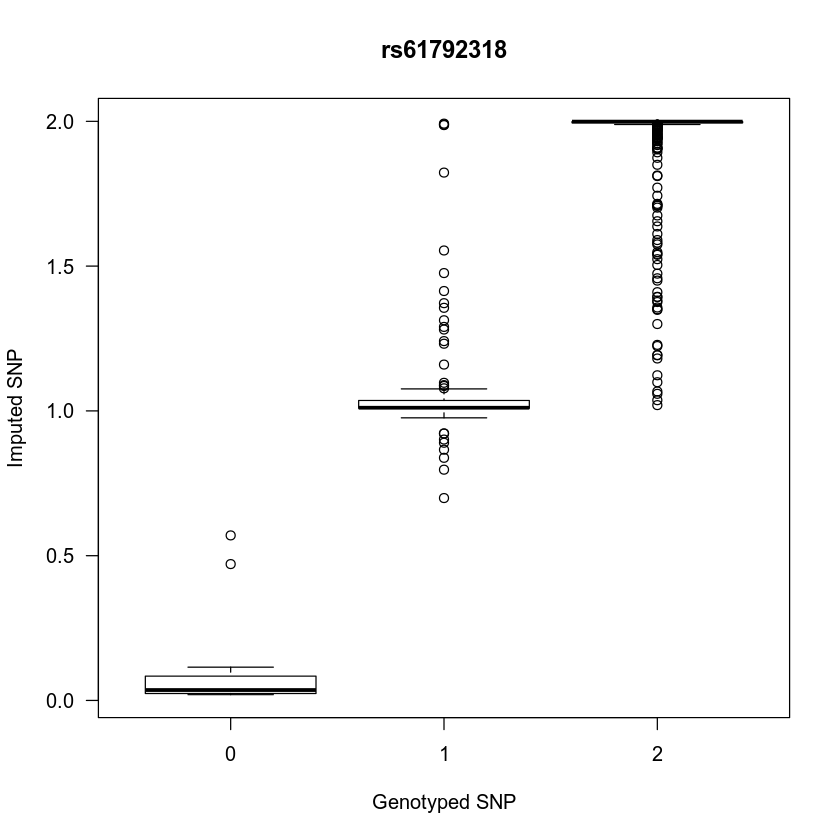

[1] "rs61792342"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 70.102, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9143739 0.9341014
sample estimates:
      cor 
0.9248573 



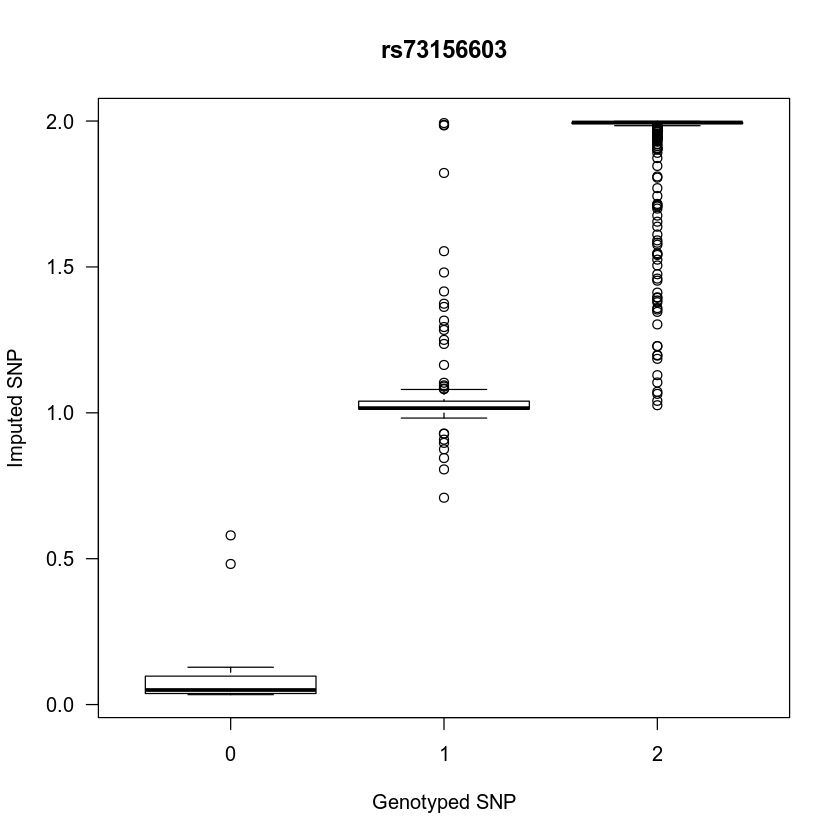

[1] "rs4680113"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 62.928, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8965881 0.9202426
sample estimates:
      cor 
0.9091458 



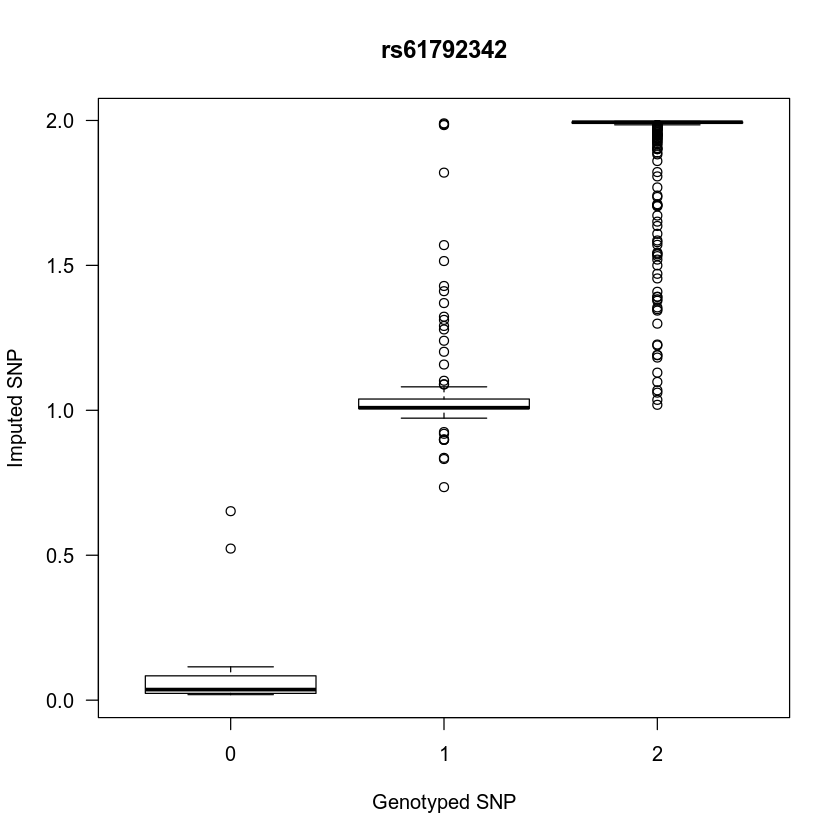

[1] "rs61791493"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 130.34, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9730123 0.9793756
sample estimates:
     cor 
0.976405 



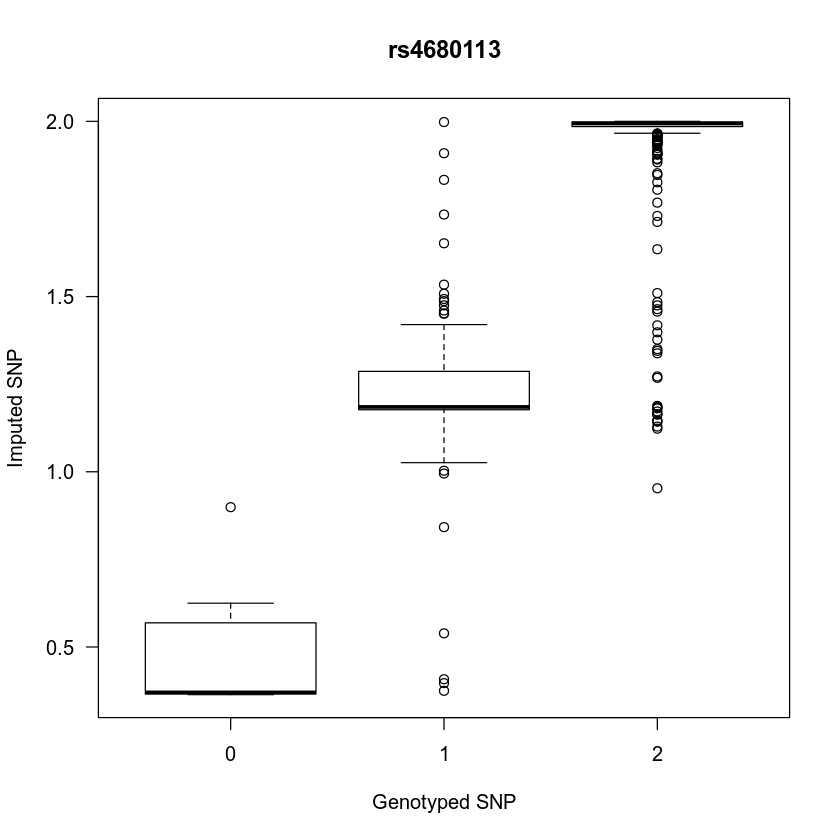

[1] "rs1624917"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 180.09, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9856106 0.9890200
sample estimates:
      cor 
0.9874296 



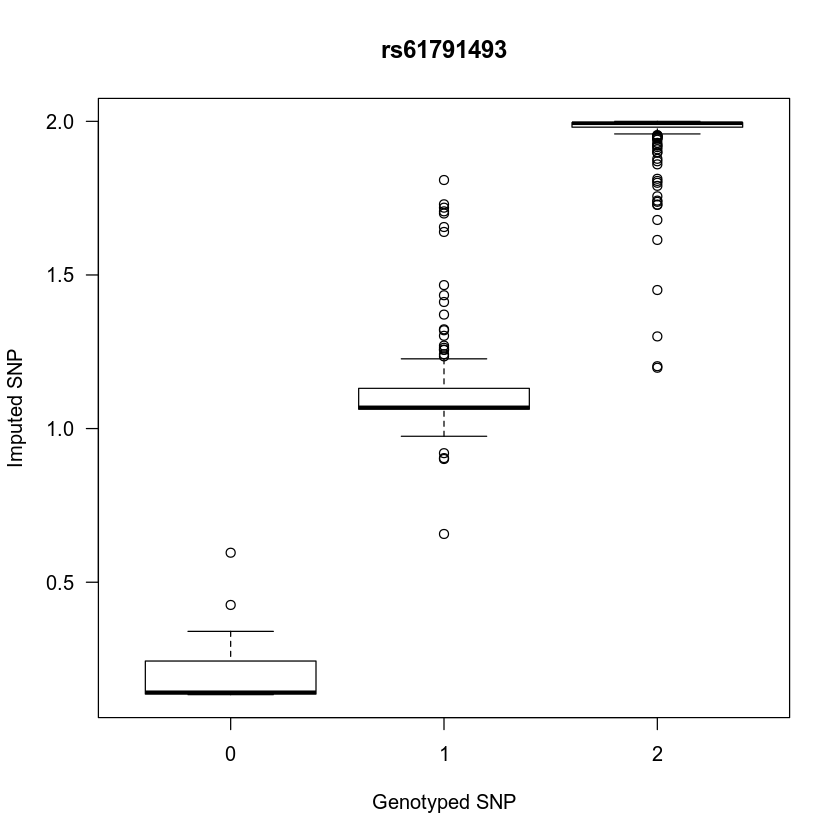

[1] "rs1727880"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 160.59, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9819963 0.9862561
sample estimates:
      cor 
0.9842686 



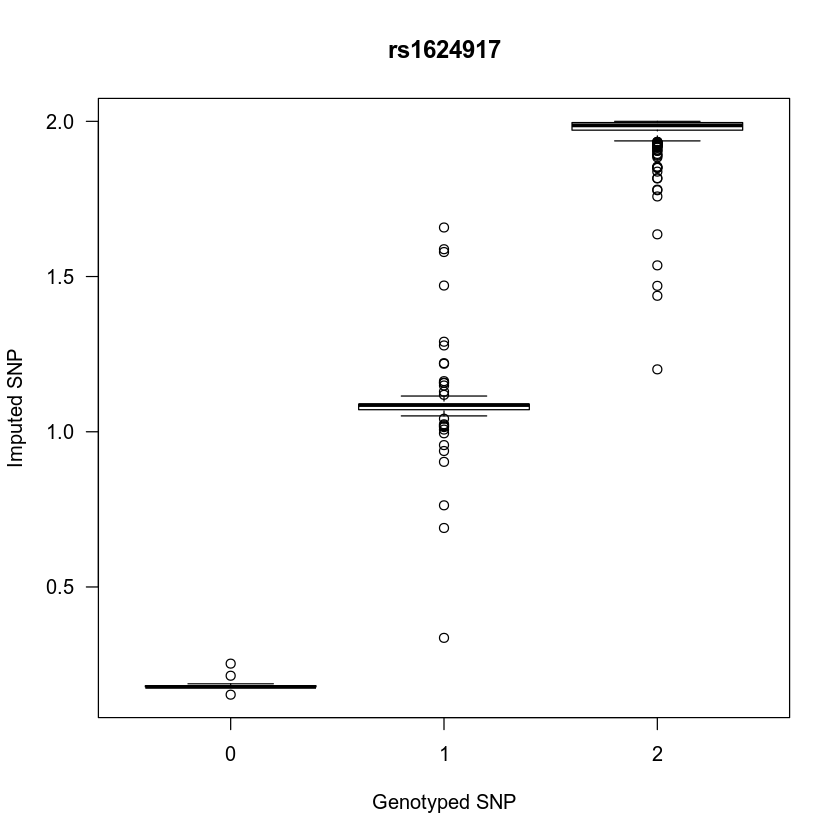

[1] "rs1727945"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 159.32, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9817146 0.9860405
sample estimates:
      cor 
0.9840221 



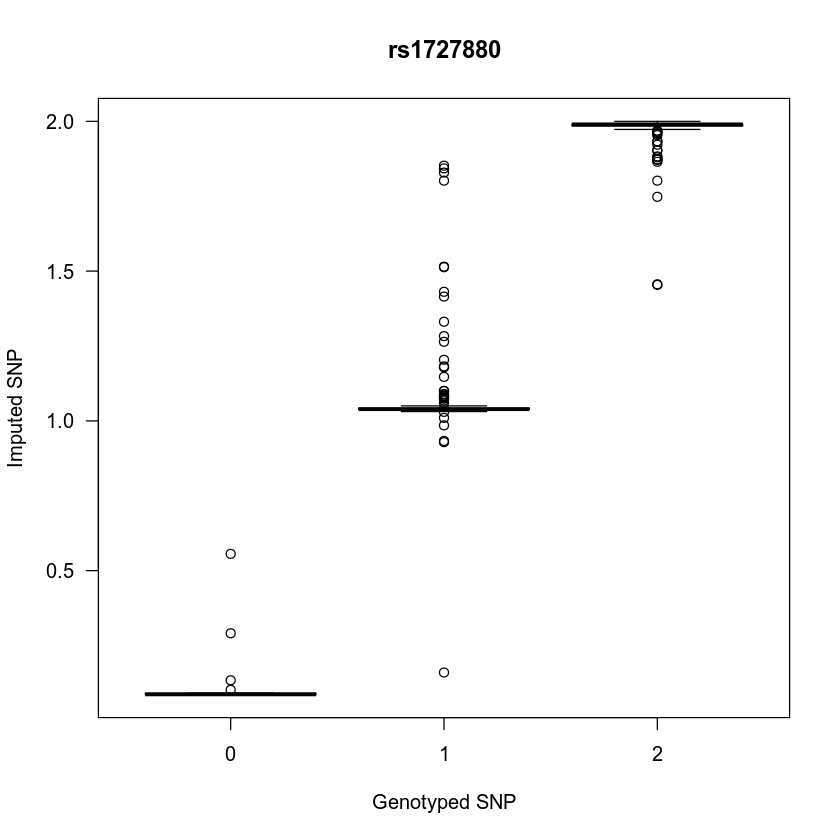

[1] "rs62279489"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 149.45, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9792911 0.9841858
sample estimates:
      cor 
0.9819017 



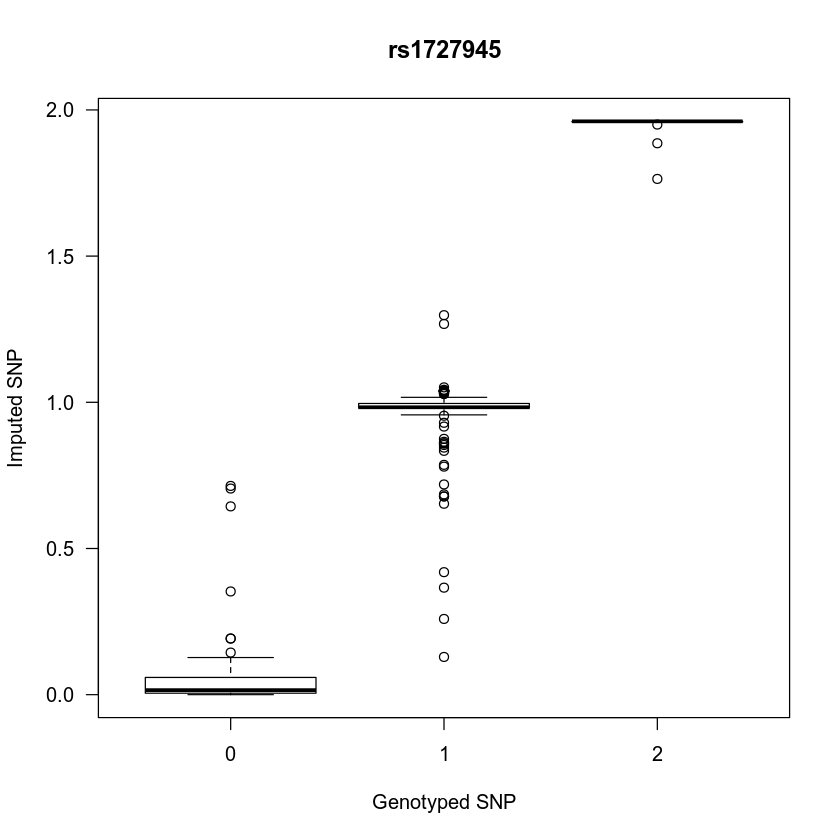

[1] "rs450115"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 112.23, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9640614 0.9725058
sample estimates:
      cor 
0.9685614 



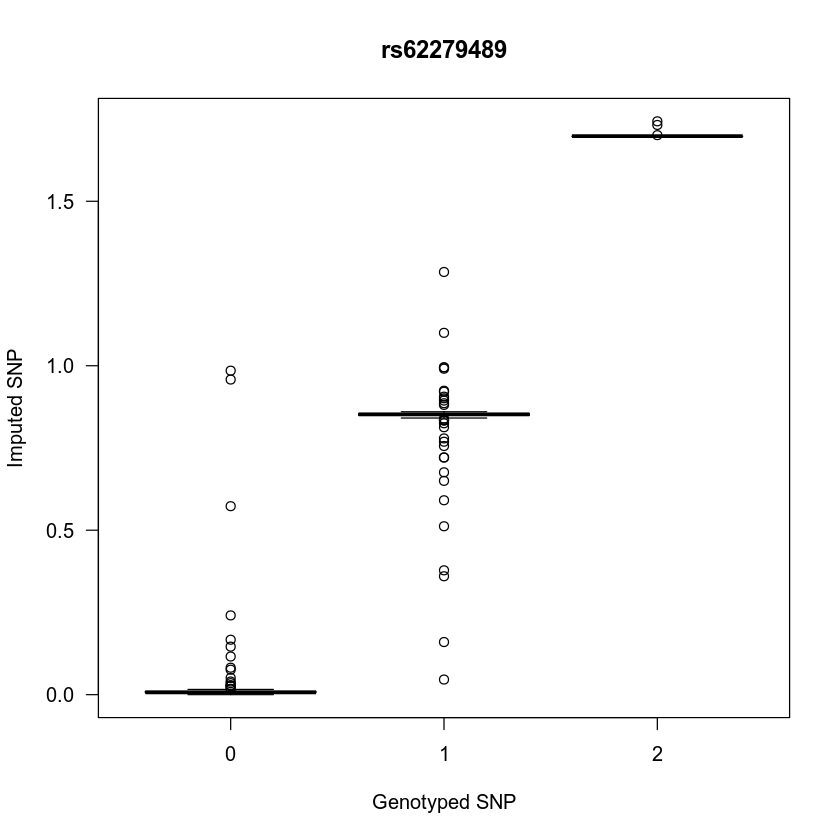

[1] "rs35026817"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 37.277, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.7641952 0.8151822
sample estimates:
      cor 
0.7910586 



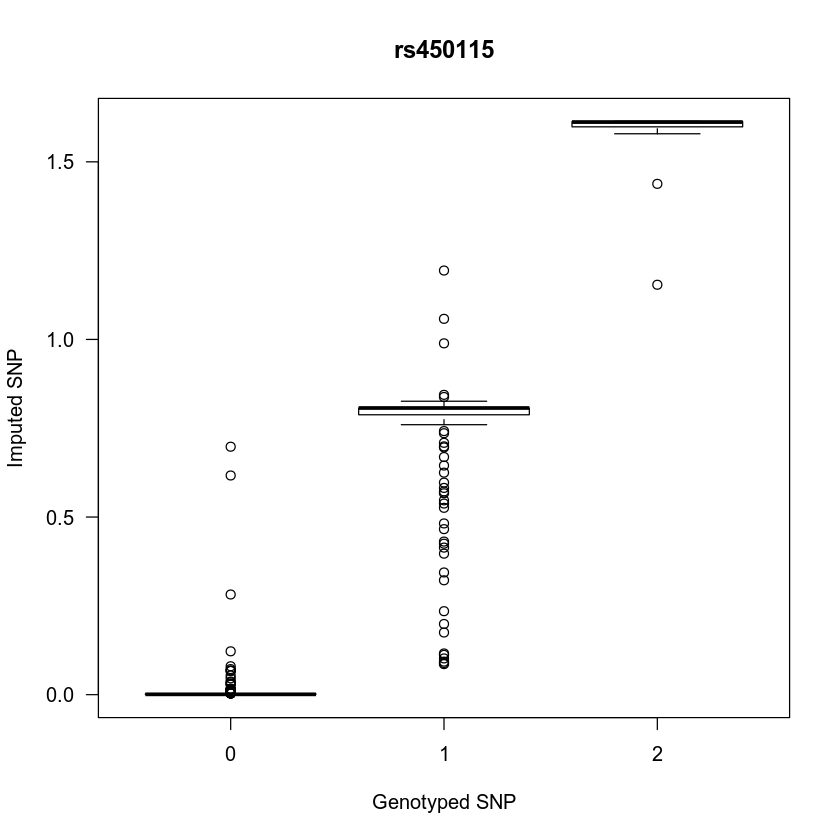

[1] "rs9855111"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 113.33, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.9647205 0.9730121
sample estimates:
      cor 
0.9691393 



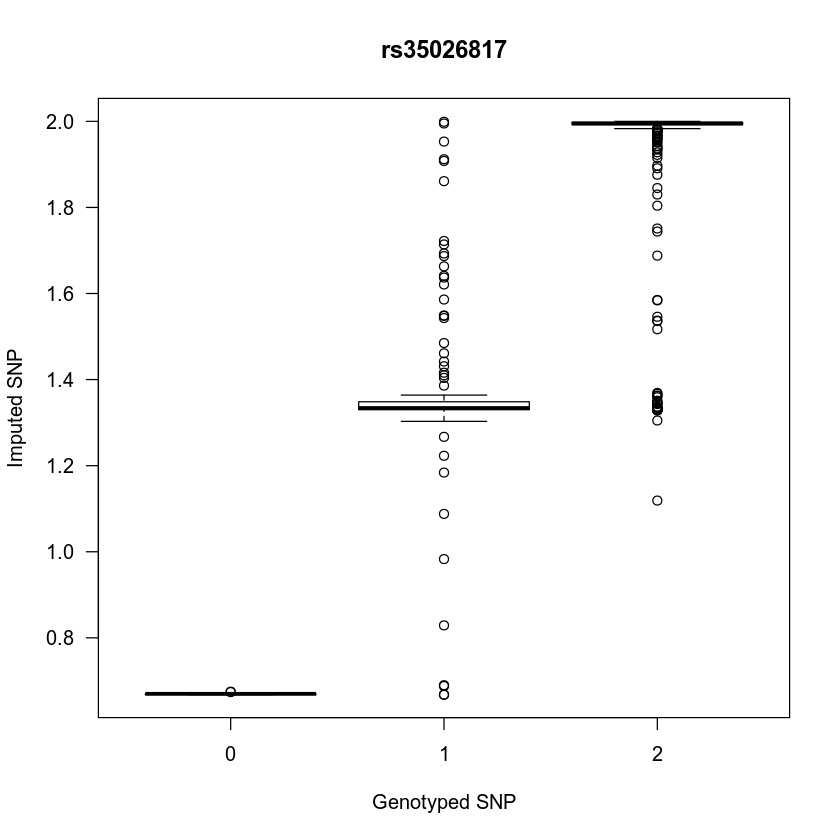

[1] "rs56100852"

	Pearson's product-moment correlation

data:  temp[, paste(snp, ".x", sep = "")] and temp[, paste(snp, ".y", sep = "")]
t = 45.218, df = 831, p-value < 2.2e-16
alternative hypothesis: true correlation is not equal to 0
95 percent confidence interval:
 0.8223975 0.8617856
sample estimates:
      cor 
0.8432196 



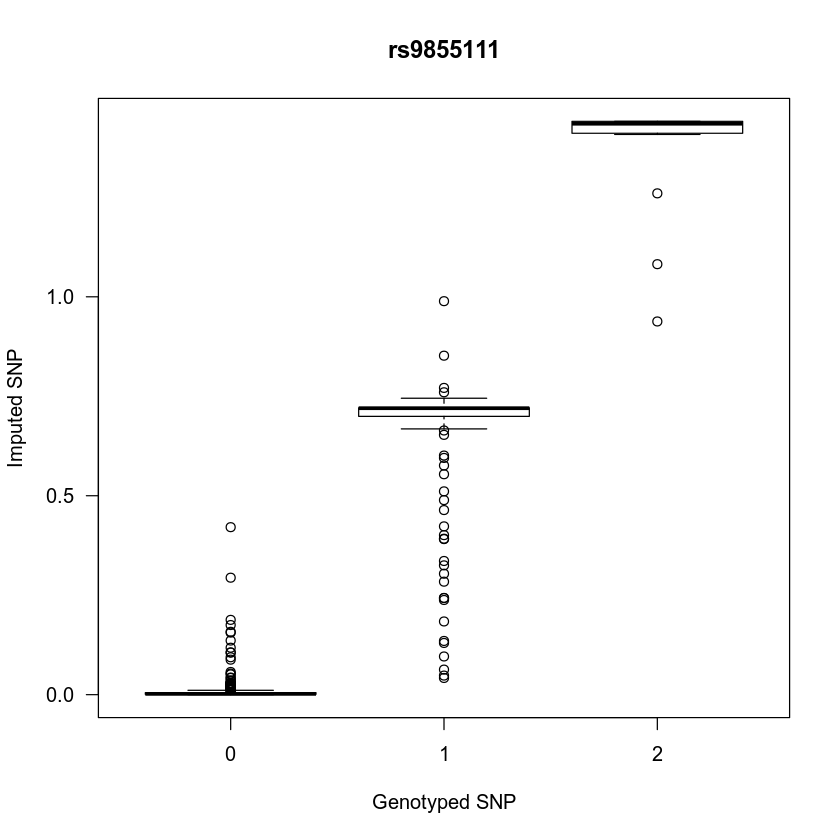

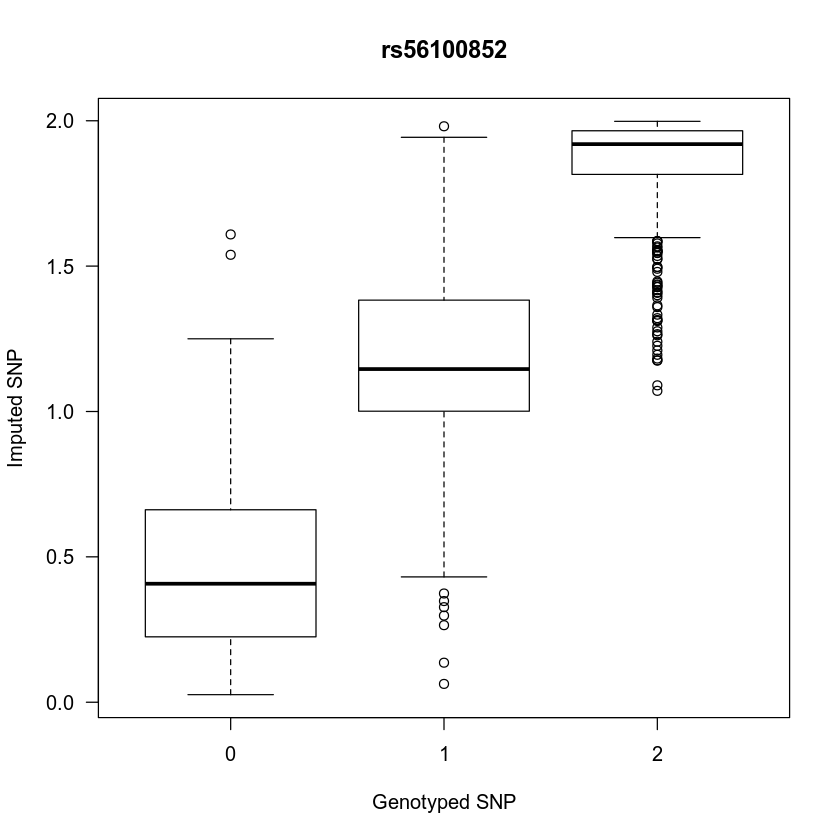

In [99]:
options(repr.plot.width=7,repr.plot.height=7)

temp <- inner_join(inner_join(translate_sid,GWAS_Profile),GWAS_PBB,by=c("BLNUM"="BLNUM"))
for (snp in intersect(names(GWAS_PBB)[grepl("rs",names(GWAS_PBB))],names(GWAS_Profile)[grepl("rs",names(GWAS_Profile))])) {
    formul <- paste(snp,".x ~ ",snp,".y",sep="")
    print(snp)
    print(cor.test(temp[,paste(snp,".x",sep="")],temp[,paste(snp,".y",sep="")]))
    boxplot(as.formula(formul),temp, xlab="Genotyped SNP" , ylab="Imputed SNP", main=snp , las=1)
    lm.result <- summary(lm(as.formula(formul),temp))
    GWAS[,paste(snp,"_norm",sep="")] <- ((GWAS[,snp]-lm.result$coefficients[1,1])/lm.result$coefficients[2,1])
}

In [100]:
sum(GWAS$rs61791493_norm)/(2*length(GWAS$rs61791493_norm))

[1] 0.8735487

In [101]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS <- inner_join(inner_join(OS,temp_trans),GWAS) %>% select(-PBP)
OS_GWAS_cur <- make_multistate_cur(OS_GWAS)
OS_GWAS <- make_multistate(OS_GWAS)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"
Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 764728 at times 407; smallest receiving state chosen”

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  205  1098      389           1692
  AE                0    0   159       99            258
  Death             0    0     0     1257           1257

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1211584 0.6489362 0.2299054
  AE        0.0000000 0.0000000 0.6162791 0.3837209
  Death     0.0000000 0.0000000 0.0000000 1.0000000

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [102]:
snps <- names(OS_GWAS_cur)[grepl("^rs",names(OS_GWAS_cur)) & grepl("_norm",names(OS_GWAS_cur)) & !grepl("\\.[1-3]",names(OS_GWAS_cur))]
pvec_snps <- data.frame()
pb <- txtProgressBar(min = 0, max = length(snps), style = 3)
counter <- 0
for (name in snps) {
    meta <- meta_survival_AE(c(name),OS_GWAS_cur %>% filter(before_2018==1),plot=F)
    meta <- meta[[1]]
    if (!is.null(dim(meta)[1])) {
       if (dim(meta)[1]>0) {
            names <- meta$variables
            pval <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$pval.fixed))
            haz <- unlist(lapply(1:length(names),function(j) meta$result[[j]]$TE.fixed))
            temp <- data.frame(driver=names,hazard=haz,pval=pval)
            pvec_snps <- rbind(pvec_snps,temp)
        } 
    }
    setTxtProgressBar(pb, counter)
    counter <- counter + 1
}

pvec_snps <- pvec_snps %>% mutate(trans=gsub(".*\\.([1-3])","\\1",driver)) %>% filter(trans==1) %>% select(-trans)
pvec_snps <- inner_join(snp_cur %>% select(-driver,-pval_adjusted) %>% rename(hazard_notnorm=hazard,pval_notnorm=pval),pvec_snps %>% mutate(SNP=gsub("(.*)_norm\\.[1-3]","\\1",driver)),by="SNP")                                 
pvec_snps$pval_adjusted <- p.adjust(pvec_snps$pval, method = "BH")

pvec_snps %>% filter %>% arrange(pval_adjusted,pval)

  |                                                                      |   0%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
  |=====                                                                 |   8%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |==========                                                            |  14%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |============                                                          |  17%

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |=============                                                         |  18%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |===============                                                       |  21%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |======================                                                |  32%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |========================                                              |  35%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Renal Cell Carcinoma was unsuccesful"
  |===========================                              

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
  |==========================================                            |  61%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
  |===========================================                           |  62%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/In

Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
  |==================================================                    |  71%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”

  |===================================================                   |  73%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |====================================================                  |  74%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
  |=====================================================                 |  76%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Other was unsuccesful"
[1] "Error: Error in f

allele,beta,HR,sd_beta,p,SNP,CHR,POS,hazard_notnorm,pval_notnorm,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>
20_16159924,-0.8692046,0.4192849,0.2035075,1.944948e-05,rs36085973,20,16159924,-1.2643739,4.713851e-07,rs36085973_norm.1,-0.6810298,4.713851e-07,3.301301e-06
20_16165550,-0.8827420,0.4136471,0.2061908,1.858959e-05,rs11699168,20,16165550,-1.2727466,5.047830e-07,rs11699168_norm.1,-0.6775922,5.047830e-07,3.301301e-06
20_16164081,-0.8871561,0.4118253,0.2077104,1.944930e-05,rs17655092,20,16164081,-1.2612079,6.035057e-07,rs17655092_norm.1,-0.6125461,6.035057e-07,3.301301e-06
20_16156854,-0.8558744,0.4249115,0.2002779,1.924856e-05,rs79815920,20,16156854,-1.2329371,7.142017e-07,rs79815920_norm.1,-0.6747351,7.142017e-07,3.301301e-06
20_16161911,-0.8865612,0.4120704,0.2052842,1.569499e-05,rs77476705,20,16161911,-1.2494219,7.921664e-07,rs77476705_norm.1,-0.6330451,7.921664e-07,3.301301e-06
20_16156520,-0.8604027,0.4229917,0.2008219,1.832267e-05,rs75641349,20,16156520,-1.2174948,8.783117e-07,rs75641349_norm.1,-0.6623793,8.783117e-07,3.301301e-06
3_153882865,0.7235750,2.0617909,0.1517950,1.871842e-06,rs1727945,3,153882865,0.7097180,9.036045e-07,rs1727945_norm.1,0.6624330,9.036045e-07,3.301301e-06
20_16167395,-0.9053607,0.4043960,0.2119682,1.944145e-05,rs11698334,20,16167395,-1.2800123,9.181792e-07,rs11698334_norm.1,-0.6607400,9.181792e-07,3.301301e-06
20_16154843,-0.8581715,0.4239365,0.2010364,1.965821e-05,rs75174196,20,16154843,-1.2301130,9.359809e-07,rs75174196_norm.1,-0.6552004,9.359809e-07,3.301301e-06


In [103]:
fwrite(pvec_snps %>% filter(pval < 5e-6),"IL7_suggestive_curated_norm.csv")

In [87]:
pvec_snps %>% filter(SNP=="rs1624917")
pvec_snps %>% filter(SNP=="rs61791493")

allele,beta,HR,sd_beta,p,SNP,CHR,POS,hazard_notnorm,pval_notnorm,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>
3_153827300,0.6069028,1.83474,0.1248658,1.171238e-06,rs1624917,3,153827300,-0.7038192,2.432358e-06,rs1624917_norm.1,0.5995336,5.702484e-06,1.0172e-05


allele,beta,HR,sd_beta,p,SNP,CHR,POS,hazard_notnorm,pval_notnorm,driver,hazard,pval,pval_adjusted
<chr>,<dbl>,<dbl>,<dbl>,<dbl>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<fct>,<dbl>,<dbl>,<dbl>
3_153743573,-0.5566065,0.5731508,0.1254656,9.150646e-06,rs61791493,3,153743573,-0.8656397,1.728863e-06,rs61791493_norm.1,-0.6679656,2.093132e-06,4.60489e-06


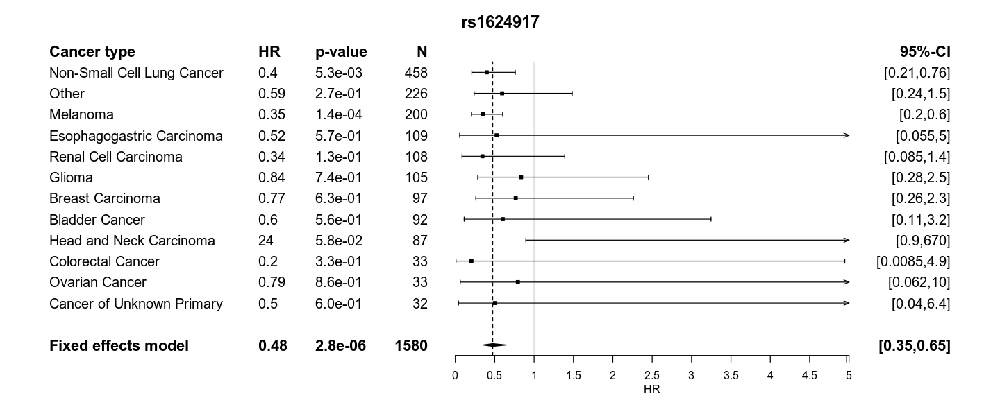

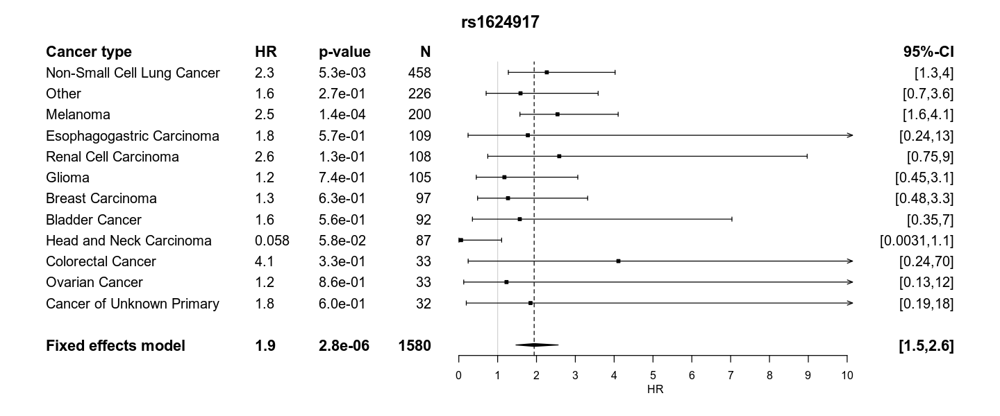

In [78]:
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs1624917"),OS_GWAS_cur %>% filter(before_2018==1),trans="1",plot=F)
tr2 <- meta_survival_AE(c("rs1624917_norm"),OS_GWAS_cur %>% filter(before_2018==1),trans="1",plot=F)

my_forest(tr1,"rs1624917.1","rs1624917")
my_forest(tr2,"rs1624917_norm.1","rs1624917")

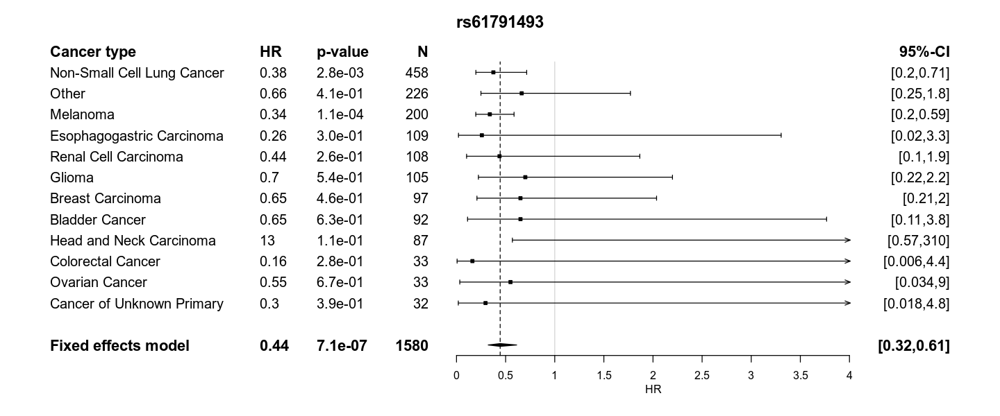

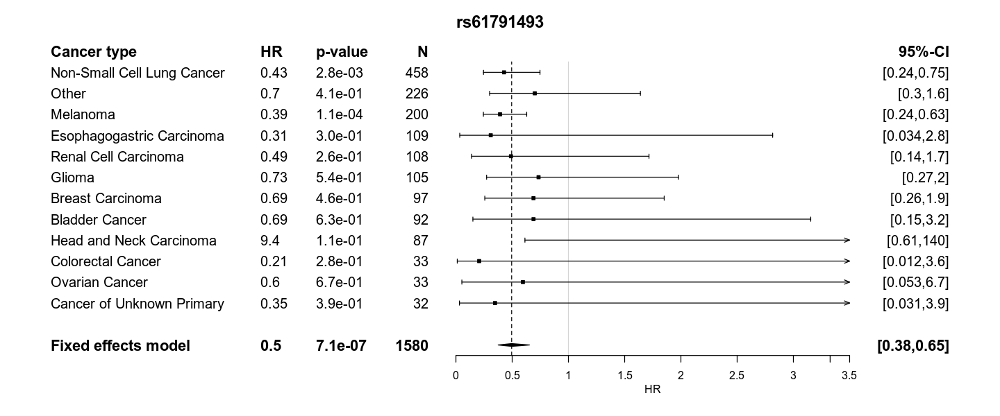

In [79]:
options(repr.plot.width=12, repr.plot.height=4)
tr1 <- meta_survival_AE(c("rs61791493"),OS_GWAS_cur %>% filter(before_2018==1),trans="1",plot=F)
tr2 <- meta_survival_AE(c("rs61791493_norm"),OS_GWAS_cur %>% filter(before_2018==1),trans="1",plot=F)

my_forest(tr1,"rs61791493.1","rs61791493")
my_forest(tr2,"rs61791493_norm.1","rs61791493")

### GWAS with non-European

In [103]:
GWAS_all <- fread('grep "CHR\\|79557237" /data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/PROF_2020_04.8.QC.ALL.traw') %>% t
GWAS_all <- data.frame(GWAS_all)
GWAS_all$PBP <- rownames(GWAS_all)
names(GWAS_all) <- c("rs7011565","PBP")
GWAS_all <- GWAS_all %>% filter(!grepl("CHR|SNP|\\(C\\)M|POS|COUNTED|ALT",PBP))
GWAS_all <- GWAS_all %>% mutate_if(is.factor,function(x) as.double(as.character(x)))
GWAS_all <- GWAS_all %>% mutate(PBP=gsub(".*_","",PBP))  

seq_date <- fread("../../../OncDRS_data/ALL/GENOMIC_SPECIMEN.csv") %>% select(PATIENT_ID,TEST_ORDER_DT) %>% mutate(TEST_ORDER_DT=as.Date(TEST_ORDER_DT,format="%d-%b-%y")) %>% inner_join(translate_sid %>% select(PBP,PATIENT_ID))
GWAS_all <- inner_join(GWAS_all,seq_date) %>% arrange(PATIENT_ID,TEST_ORDER_DT) %>% group_by(PATIENT_ID) %>% summarise_all(last) %>% select(-TEST_ORDER_DT,-PATIENT_ID)                               

GWAS_all <- GWAS_all %>% mutate(rs7011565_norm=(rs7011565-lm.result_rs7011565$coefficients[1,1])/lm.result_rs7011565$coefficients[2,1])
GWAS_all <- GWAS_all %>% mutate(rs7011565_norm = 2-rs7011565_norm)
                           
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_all <- inner_join(inner_join(OS,temp_trans),GWAS_all)
# OS_GWAS_cur <- make_multistate_cur(OS_GWAS_all)
OS_GWAS_all <- make_multistate(OS_GWAS_all)                        

Joining, by = "PATIENT_ID"
Joining, by = "PBP"
Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"


$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  463  1491      646           2600
  AE                0    0   258      277            535
  Death             0    0     0     1749           1749

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1780769 0.5734615 0.2484615
  AE        0.0000000 0.0000000 0.4822430 0.5177570
  Death     0.0000000 0.0000000 0.0000000 1.0000000



NULL
NULL


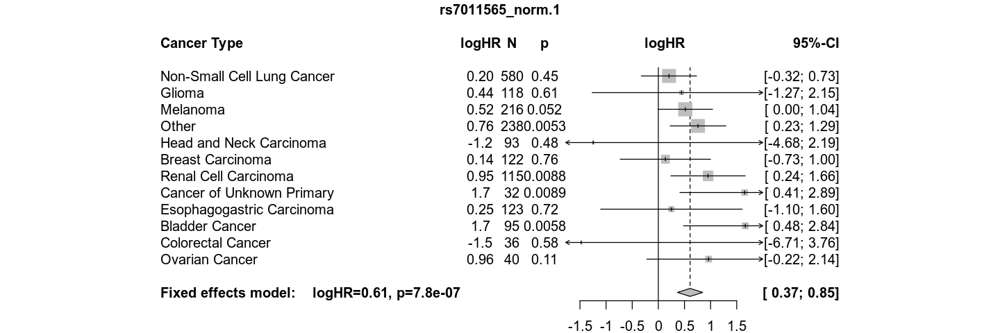

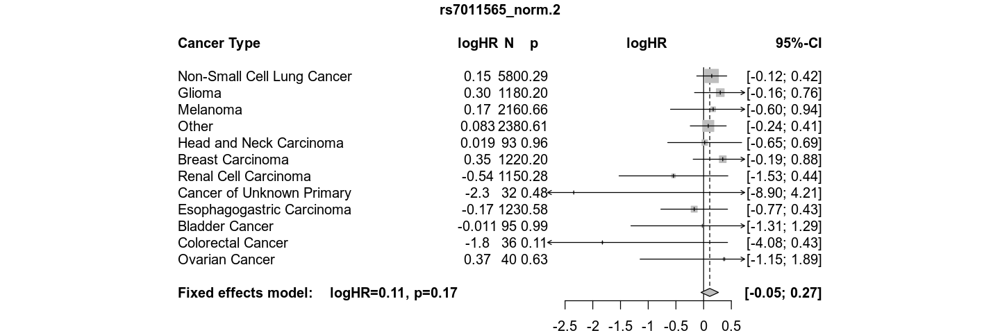

In [104]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS_all %>% filter(before_2018==1) %>% filter(TRANSPLANT_IND==F,immune_suppressant==0), trans="1|2")
options(options_save)

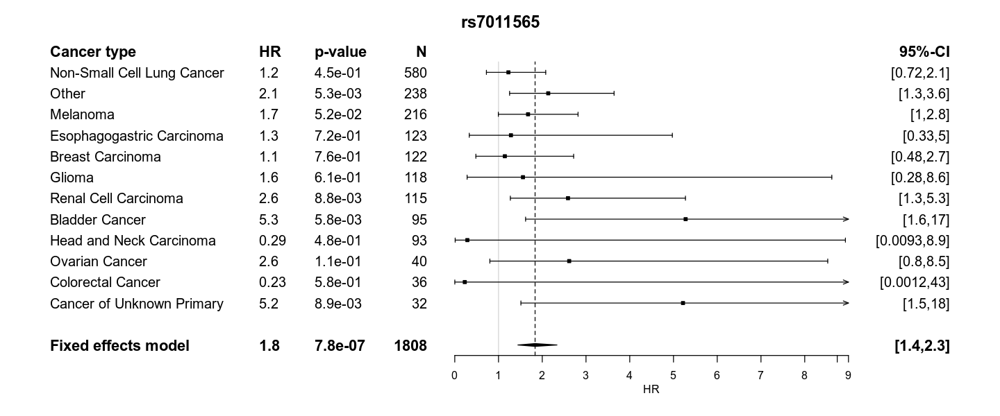

In [106]:
my_forest(tr,"rs7011565_norm.1","rs7011565")

### association with prior autoimmune disease

In [19]:
DIAGNOSIS_ALL <- fread("../../../OncDRS_data/ALL/EHR_DIAGNOSIS.csv",fill=T) %>% right_join(translate_pid,by="PATIENT_ID") %>% select(MRN,START_DT,END_DT,DIAGNOSIS_DISPLAY_TXT,DIAGNOSIS_ICD10_LIST,DIAGNOSIS_ICD10_CD,DIAGNOSIS_ICD10_CD2,DIAGNOSIS_ICD10_CD3) %>% mutate(START_DT=as.Date(START_DT,format="%d-%b-%y"),END_DT=as.Date(END_DT,format="%d-%b-%y"))
DIAGNOSIS_ALL <- DIAGNOSIS_ALL %>% inner_join(OS %>% select(MRN,IO_START,IO_STOP) %>% mutate(IO_START=as.Date(IO_START),IO_STOP=as.Date(IO_STOP)),by="MRN")
DIAGNOSIS_ALL <- DIAGNOSIS_ALL %>% filter(difftime(START_DT,IO_START)<0)

autoimmune <- DIAGNOSIS_ALL %>% filter(grepl(paste(fread("../../../../autoimmune.icd10",header=F)$V1,collapse="|"),DIAGNOSIS_ICD10_LIST) & !grepl("drug-induced",tolower(DIAGNOSIS_DISPLAY_TXT)) & difftime(START_DT,IO_START)<0)
autoimmune <- autoimmune %>% select(MRN) %>% distinct
autoimmune$autoimmune <- 1
((autoimmune %>% select(MRN) %>% distinct %>% count)$n)/((DIAGNOSIS_ALL %>% select(MRN) %>% distinct %>% count)$n)

autoimmune <- left_join(OS,autoimmune) %>% mutate(autoimmune=replace_na(autoimmune,0))
autoimmune <- inner_join(autoimmune,inner_join(translate_pid %>% select(MRN,PATIENT_ID),inner_join(translate_sid %>% select(PBP,PATIENT_ID),GWAS) %>% select(-PBP)) %>% select(-PATIENT_ID))

[1] 0.1477484

Joining, by = "MRN"
Joining, by = "PBP"
Joining, by = "PATIENT_ID"
Joining, by = "MRN"


In [24]:
OS_diag %>% names

[1] "MRN"                                                                                
   [2] "from"                                                                               
   [3] "to"                                                                                 
   [4] "trans"                                                                              
   [5] "Tstart"                                                                             
   [6] "Tstop"                                                                              
   [7] "time"                                                                               
   [8] "status"                                                                             
   [9] "PROFILE_AFTER_TREATMENT"                                                            
  [10] "LAST_DATE"                                                                          
  [11] "IO_START"                                                                           
  [12] "IO_STOP"                                                                            
  [13] "othertreatment_after_io"                                                            
  [14] "othertreatment_while_io"                                                            
  [15] "othertreatment_before_io"                                                           
  [16] "PROFILE_AFTER_DEATH"                                                                
  [17] "AGE_AT_TREATMENTSTART"                                                              
  [18] "AGE_AT_TREATMENTSTART_BINNED"                                                       
  [19] "GENDER"                                                                             
  [20] "treatment_type"                                                                     
  [21] "MEDICATION_CUM"                                                                     
  [22] "TREATMENT_CUM"                                                                      
  [23] "CONC_CHEMO"                                                                         
  [24] "MET_BEFORE_TREATMENTSTART"                                                          
  [25] "PANEL_VERSION"                                                                      
  [26] "BIOPSY_SITE_TYPE"                                                                   
  [27] "PRIOR_TREATMENT"                                                                    
  [28] "LINE_OF_TREATMENT"                                                                  
  [29] "ANCESTRY_PC1"                                                                       
  [30] "ANCESTRY_PC2"                                                                       
  [31] "ANCESTRY_SELFREPORTED"                                                              
  [32] "ANCESTRY_ROT_PC2"                                                                   
  [33] "ANCESTRY_ROT_PC1"                                                                   
  [34] "ANCESTRY_GENETICS"                                                                  
  [35] "START_YEAR"                                                                         
  [36] "CANCER_TYPE"                                                                        
  [37] "PRIMARY_CANCER_DIAGNOSIS"                                                           
  [38] "targeted_before_IO"                                                                 
  [39] "targeted_egfr_before_IO"                                                            
  [40] "TMB"                                                                                
  [41] "TMB_binned"                                                                         
  [42] "TMB_rank"                                                                           
  [43] "STAGE"                                                                              
  [4

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


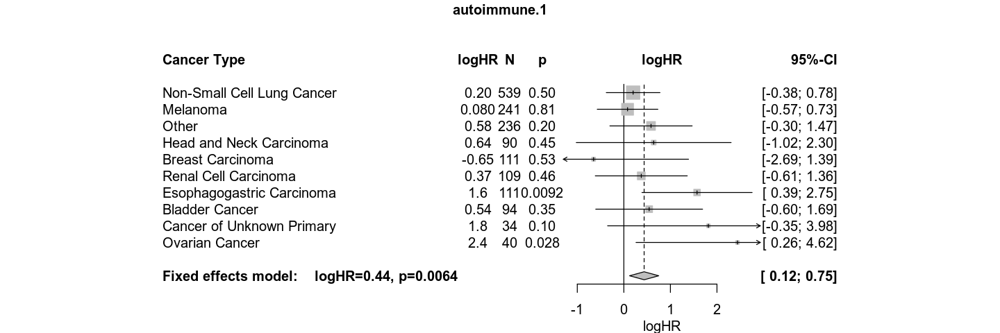

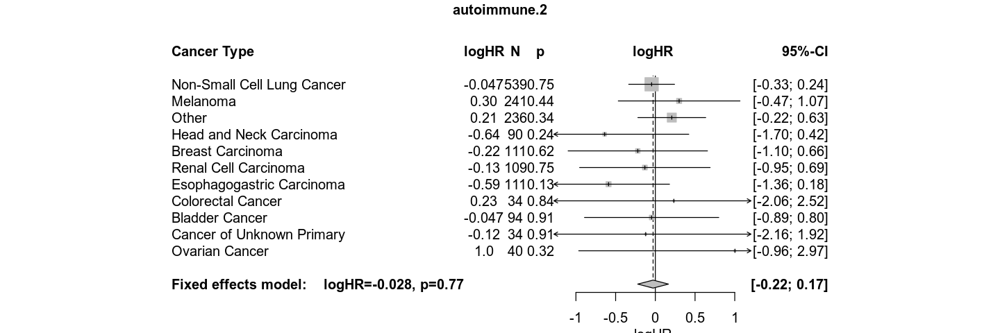

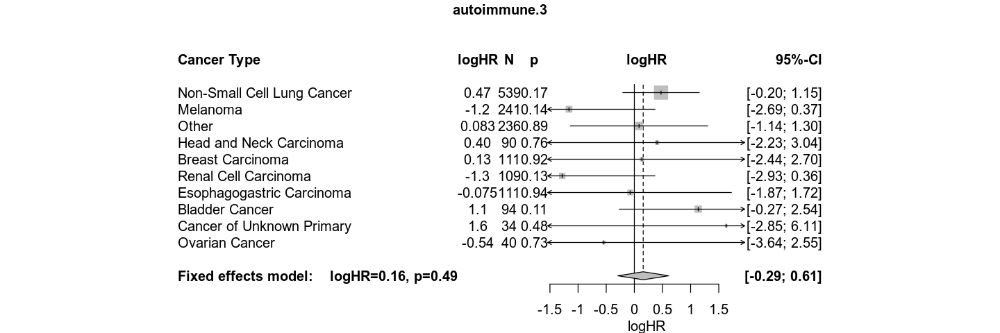

In [27]:
OS_diag <- autoimmune
OS_diag <- OS_diag %>% mutate(autoimmune=replace_na(autoimmune,0))

OS_diag <- make_multistate(OS_diag)

options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_AE(c("autoimmune"),transition="1|2|3",OS_diag %>% filter(GWAS_avail==T,before_2018==T))
options(options_before)

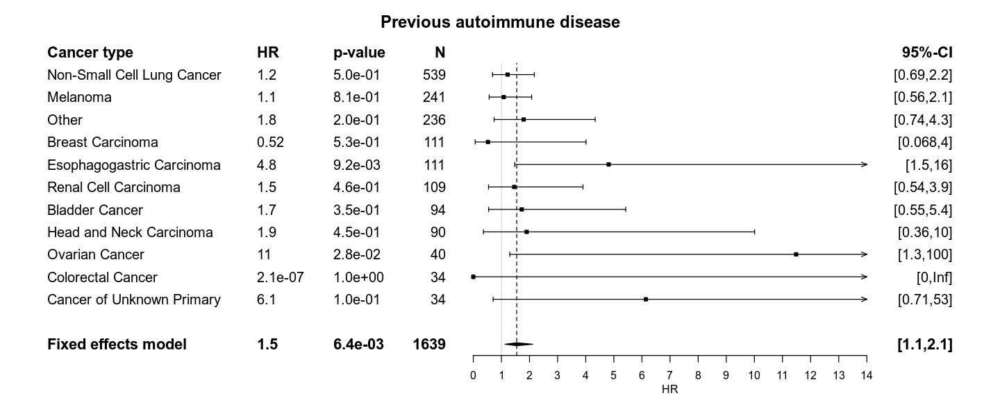

In [28]:
my_forest(tr,"autoimmune.1","Previous autoimmune disease")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
NULL
NULL
NULL


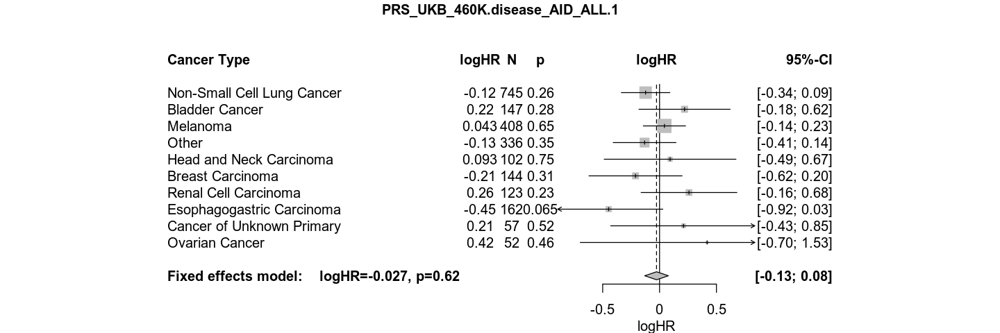

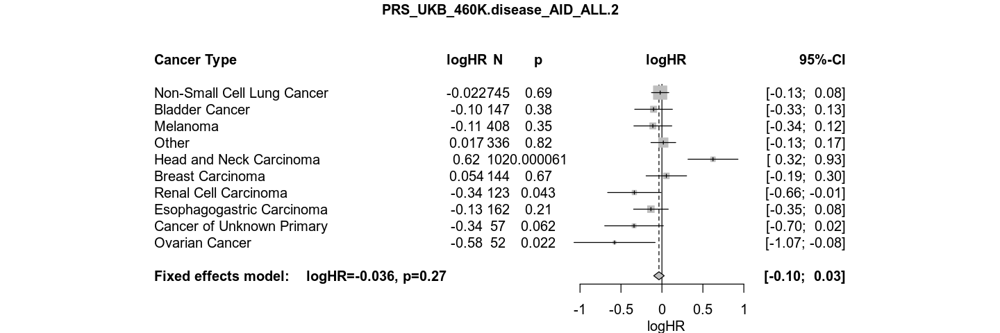

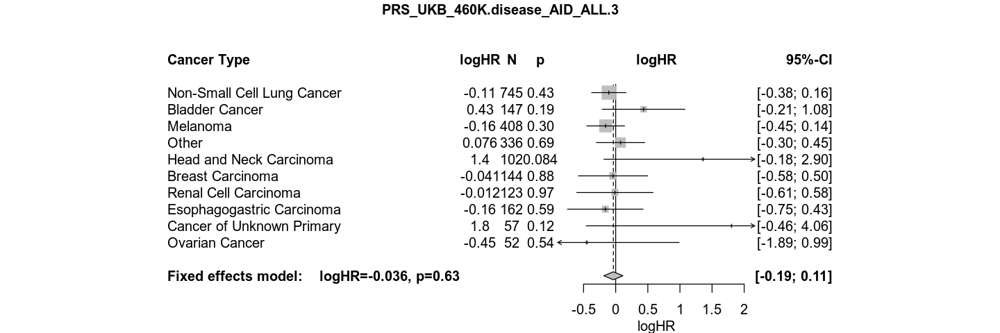

In [23]:
options_before <- options()
options(repr.plot.width=12,repr.plot.height=4)
tr <- meta_survival_AE(c("PRS_UKB_460K.disease_AID_ALL"),transition="1|2|3",OS_diag)
options(options_before)

In [ ]:
my_forest(tr,"autoimmune.1","Previous autoimmune disease")

In [63]:
summary(glm(autoimmune ~ PRS_UKB_460K.disease_AID_ALL + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune,family="binomial"))


Call:
glm(formula = autoimmune ~ PRS_UKB_460K.disease_AID_ALL + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + 
    TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT + 
    ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2, family = "binomial", 
    data = autoimmune)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.2967  -0.6018  -0.4802  -0.3478   2.8184  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)    
(Intercept)                           -3.382529   0.517070  -6.542 6.08e-11 ***
PRS_UKB_460K.disease_AID_ALL           0.200004   0.060137   3.326 0.000882 ***
CANCER_TYPEBreast Carcinoma           -0.324398   0.388918  -0.834 0.404223    
CANCER_TYPECancer of Unknown Primary   0.118261   0.447003   0.265 0.791345    
CANCER_TYPEColorectal Cancer          -0.002372   0.513478  -0.005 0.996315    
CANCER_TYPEEsophagogastric Carcinoma   0.002741   0.334417   0.008 0.993460   

In [64]:
summary(glm(autoimmune ~ rs16906115_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT,autoimmune %>% filter(before_2018==1),family="binomial"))
summary(glm(autoimmune ~ rs75824728_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT,autoimmune %>% filter(before_2018==1),family="binomial"))
summary(glm(autoimmune ~ rs113861051_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT,autoimmune %>% filter(before_2018==1),family="binomial"))


Call:
glm(formula = autoimmune ~ rs16906115_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + 
    GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + 
    CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT, family = "binomial", 
    data = autoimmune %>% filter(before_2018 == 1))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.2662  -0.6214  -0.4849  -0.3413   2.6656  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)    
(Intercept)                           -3.148501   0.648895  -4.852 1.22e-06 ***
rs16906115_norm                       -0.215304   0.141476  -1.522 0.128048    
CANCER_TYPEBreast Carcinoma           -0.448376   0.453261  -0.989 0.322554    
CANCER_TYPECancer of Unknown Primary   0.261987   0.527431   0.497 0.619384    
CANCER_TYPEColorectal Cancer          -0.060161   0.579398  -0.104 0.917302    
CANCER_TYPEEsophagogastric Carcinoma  -0.124504   0.392009  -0.318 0.750785    
CANCER_TYPEGlioma        


Call:
glm(formula = autoimmune ~ rs75824728_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + 
    GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + 
    CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT, family = "binomial", 
    data = autoimmune %>% filter(before_2018 == 1))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.2492  -0.6234  -0.4850  -0.3443   2.6865  

Coefficients:
                                      Estimate Std. Error z value Pr(>|z|)    
(Intercept)                           -3.51644    0.64176  -5.479 4.27e-08 ***
rs75824728_norm                       -0.02796    0.14606  -0.191  0.84819    
CANCER_TYPEBreast Carcinoma           -0.41247    0.45201  -0.913  0.36150    
CANCER_TYPECancer of Unknown Primary   0.29281    0.52648   0.556  0.57810    
CANCER_TYPEColorectal Cancer          -0.07182    0.57950  -0.124  0.90137    
CANCER_TYPEEsophagogastric Carcinoma  -0.11785    0.39207  -0.301  0.76374    
CANCER_TYPEGlioma               


Call:
glm(formula = autoimmune ~ rs113861051_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + 
    GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + 
    CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT, family = "binomial", 
    data = autoimmune %>% filter(before_2018 == 1))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.2598  -0.6263  -0.4834  -0.3415   2.6871  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)    
(Intercept)                           -3.287793   0.664865  -4.945 7.61e-07 ***
rs113861051_norm                      -0.150474   0.167263  -0.900  0.36832    
CANCER_TYPEBreast Carcinoma           -0.417942   0.451507  -0.926  0.35462    
CANCER_TYPECancer of Unknown Primary   0.280432   0.527422   0.532  0.59493    
CANCER_TYPEColorectal Cancer          -0.085685   0.580123  -0.148  0.88258    
CANCER_TYPEEsophagogastric Carcinoma  -0.121344   0.391932  -0.310  0.75686    
CANCER_TYPEGlioma       

In [66]:
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs16906115_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT,autoimmune %>% filter(before_2018==1)))
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs75824728_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT,autoimmune %>% filter(before_2018==1)))
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs113861051_norm + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + LINE_OF_TREATMENT,autoimmune %>% filter(before_2018==1)))


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs16906115_norm + 
    CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + 
    PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + 
    LINE_OF_TREATMENT, data = autoimmune %>% filter(before_2018 == 
    1))

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4531 -0.6331 -0.0083  0.5840  3.5175 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)  
(Intercept)                            0.2206427  0.2116128   1.043   0.2972  
rs16906115_norm                       -0.0118671  0.0489101  -0.243   0.8083  
CANCER_TYPEBreast Carcinoma            0.0742425  0.1427831   0.520   0.6032  
CANCER_TYPECancer of Unknown Primary   0.1649237  0.1892995   0.871   0.3837  
CANCER_TYPEColorectal Cancer          -0.4201368  0.1904656  -2.206   0.0275 *
CANCER_TYPEEsophagogastric Carcinoma   0.0199011  0.1325279   0.150   0.8807  
CANCER_TYPEGlioma                     -0.1479474  0


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs75824728_norm + 
    CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + 
    PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + 
    LINE_OF_TREATMENT, data = autoimmune %>% filter(before_2018 == 
    1))

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4711 -0.6351  0.0013  0.5753  3.5144 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)  
(Intercept)                            0.0265422  0.2072123   0.128   0.8981  
rs75824728_norm                        0.0950248  0.0475967   1.996   0.0460 *
CANCER_TYPEBreast Carcinoma            0.0849935  0.1424796   0.597   0.5509  
CANCER_TYPECancer of Unknown Primary   0.1694461  0.1890332   0.896   0.3702  
CANCER_TYPEColorectal Cancer          -0.4177620  0.1902386  -2.196   0.0282 *
CANCER_TYPEEsophagogastric Carcinoma   0.0173173  0.1323799   0.131   0.8959  
CANCER_TYPEGlioma                     -0.1377139  0


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs113861051_norm + 
    CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + START_YEAR + 
    PROFILE_AFTER_TREATMENT + TREATMENT_CUM + CONC_CHEMO + PANEL_VERSION + 
    LINE_OF_TREATMENT, data = autoimmune %>% filter(before_2018 == 
    1))

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4490 -0.6329 -0.0125  0.5847  3.5389 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)  
(Intercept)                            0.2528672  0.2178602   1.161   0.2459  
rs113861051_norm                      -0.0295158  0.0578693  -0.510   0.6101  
CANCER_TYPEBreast Carcinoma            0.0746209  0.1425935   0.523   0.6008  
CANCER_TYPECancer of Unknown Primary   0.1642859  0.1892609   0.868   0.3855  
CANCER_TYPEColorectal Cancer          -0.4221039  0.1904539  -2.216   0.0268 *
CANCER_TYPEEsophagogastric Carcinoma   0.0198407  0.1325157   0.150   0.8810  
CANCER_TYPEGlioma                     -0.1463557  

In [67]:
DIAGNOSIS_ALL <- fread("../../../OncDRS_data/ALL/EHR_DIAGNOSIS.csv",fill=T) %>% right_join(translate_pid,by="PATIENT_ID") %>% select(MRN,START_DT,END_DT,DIAGNOSIS_DISPLAY_TXT,DIAGNOSIS_ICD10_LIST,DIAGNOSIS_ICD10_CD,DIAGNOSIS_ICD10_CD2,DIAGNOSIS_ICD10_CD3) %>% mutate(START_DT=as.Date(START_DT,format="%d-%b-%y"),END_DT=as.Date(END_DT,format="%d-%b-%y"))
DIAGNOSIS_ALL <- DIAGNOSIS_ALL %>% inner_join(fread("../OS/OS_ALL.csv") %>% filter(anyIO==0,before_2018==1))

autoimmune_PRS <- DIAGNOSIS_ALL %>% filter(grepl(paste(fread("../../../../autoimmune.icd10",header=F)$V1,collapse="|"),DIAGNOSIS_ICD10_LIST) & !grepl("drug-induced",tolower(DIAGNOSIS_DISPLAY_TXT)))
autoimmune_PRS <- autoimmune_PRS %>% select(MRN) %>% distinct
autoimmune_PRS$autoimmune <- 1
((autoimmune_PRS %>% select(MRN) %>% distinct %>% count)$n)/((DIAGNOSIS_ALL %>% select(MRN) %>% distinct %>% count)$n)

autoimmune_PRS <- left_join(fread("../OS/OS_ALL.csv") %>% filter(anyIO==0,before_2018==1),autoimmune_PRS) %>% mutate(autoimmune=replace_na(autoimmune,0))
autoimmune_PRS <- inner_join(autoimmune_PRS,inner_join(translate_pid %>% select(MRN,PATIENT_ID),inner_join(translate_sid %>% select(PBP,PATIENT_ID),GWAS_Profile) %>% select(-PBP)) %>% select(-PATIENT_ID))

Joining, by = "MRN"


[1] 0.1812683

Joining, by = "MRN"
Joining, by = "PBP"
Joining, by = "PATIENT_ID"
Joining, by = "MRN"


In [68]:
summary(glm(autoimmune ~ PRS_UKB_460K.disease_AID_ALL + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS,family="binomial"))


Call:
glm(formula = autoimmune ~ PRS_UKB_460K.disease_AID_ALL + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, family = "binomial", data = autoimmune_PRS)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.9928  -0.6692  -0.6013  -0.5019   2.2885  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)    
(Intercept)                           -2.196475   0.169031 -12.995  < 2e-16 ***
PRS_UKB_460K.disease_AID_ALL           0.043661   0.021148   2.065 0.038965 *  
CANCER_TYPEBreast Carcinoma           -0.192837   0.127677  -1.510 0.130953    
CANCER_TYPECancer of Unknown Primary  -0.374377   0.202231  -1.851 0.064135 .  
CANCER_TYPEColorectal Cancer          -0.356858   0.125790  -2.837 0.004555 ** 
CANCER_TYPEEndometrial Cancer         -0.205305   0.144000  -1.426 0.153946    
CANCER_TYPEEsophagogastric Carcinoma  -0.480999   0.156912  -3.065 0.002174 ** 
CANCER_TYPEG

In [69]:
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs16906115 + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS))
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs75824728 + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS))
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs113861051 + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS))


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs16906115 + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = autoimmune_PRS)

Residuals:
    Min      1Q  Median      3Q     Max 
-4.3401 -0.6459 -0.0078  0.6419  4.0369 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                            0.2509363  0.0774557   3.240  0.00120
rs16906115                            -0.0138835  0.0239157  -0.581  0.56157
CANCER_TYPEBreast Carcinoma           -0.0786215  0.0510759  -1.539  0.12375
CANCER_TYPECancer of Unknown Primary   0.0586220  0.0753943   0.778  0.43685
CANCER_TYPEColorectal Cancer          -0.1062115  0.0498894  -2.129  0.03327
CANCER_TYPEEndometrial Cancer         -0.0757264  0.0575008  -1.317  0.18787
CANCER_TYPEEsophagogastric Carcinoma  -0.0014152  0.0595023  -0.024  0.98102
CANCER_TYPEGlioma                     -0.0121017  0.0560163  -0.216  0.82896
C


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs75824728 + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = autoimmune_PRS)

Residuals:
    Min      1Q  Median      3Q     Max 
-4.3384 -0.6459 -0.0074  0.6417  4.0302 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                            0.1874154  0.0755389   2.481  0.01311
rs75824728                             0.0217672  0.0225563   0.965  0.33455
CANCER_TYPEBreast Carcinoma           -0.0787926  0.0510749  -1.543  0.12293
CANCER_TYPECancer of Unknown Primary   0.0587720  0.0753916   0.780  0.43566
CANCER_TYPEColorectal Cancer          -0.1066475  0.0498888  -2.138  0.03256
CANCER_TYPEEndometrial Cancer         -0.0758858  0.0574981  -1.320  0.18692
CANCER_TYPEEsophagogastric Carcinoma  -0.0011827  0.0595001  -0.020  0.98414
CANCER_TYPEGlioma                     -0.0120053  0.0560154  -0.214  0.83030
C


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs113861051 + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = autoimmune_PRS)

Residuals:
    Min      1Q  Median      3Q     Max 
-4.3403 -0.6456 -0.0064  0.6415  4.0370 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                            0.2518411  0.0772176   3.261  0.00111
rs113861051                           -0.0141208  0.0232476  -0.607  0.54359
CANCER_TYPEBreast Carcinoma           -0.0784326  0.0510776  -1.536  0.12467
CANCER_TYPECancer of Unknown Primary   0.0592331  0.0753950   0.786  0.43209
CANCER_TYPEColorectal Cancer          -0.1061732  0.0498896  -2.128  0.03334
CANCER_TYPEEndometrial Cancer         -0.0761364  0.0574996  -1.324  0.18548
CANCER_TYPEEsophagogastric Carcinoma  -0.0008151  0.0595046  -0.014  0.98907
CANCER_TYPEGlioma                     -0.0120727  0.0560164  -0.216  0.82936


In [21]:
DIAGNOSIS_ALL <- fread("../../../OncDRS_data/ALL/EHR_DIAGNOSIS.csv",fill=T) %>% right_join(translate_pid,by="PATIENT_ID") %>% select(MRN,START_DT,END_DT,DIAGNOSIS_DISPLAY_TXT,DIAGNOSIS_ICD10_LIST,DIAGNOSIS_ICD10_CD,DIAGNOSIS_ICD10_CD2,DIAGNOSIS_ICD10_CD3) %>% mutate(START_DT=as.Date(START_DT,format="%d-%b-%y"),END_DT=as.Date(END_DT,format="%d-%b-%y"))
DIAGNOSIS_ALL <- DIAGNOSIS_ALL %>% inner_join(fread("../OS/OS_ALL.csv") %>% filter(anyIO==1,before_2018==1))

autoimmune_PRS <- DIAGNOSIS_ALL %>% filter(grepl(paste(fread("../../../../autoimmune.icd10",header=F)$V1,collapse="|"),DIAGNOSIS_ICD10_LIST) & !grepl("drug-induced",tolower(DIAGNOSIS_DISPLAY_TXT)))
autoimmune_PRS <- autoimmune_PRS %>% select(MRN) %>% distinct
autoimmune_PRS$autoimmune <- 1
((autoimmune_PRS %>% select(MRN) %>% distinct %>% count)$n)/((DIAGNOSIS_ALL %>% select(MRN) %>% distinct %>% count)$n)

autoimmune_PRS <- left_join(fread("../OS/OS_ALL.csv") %>% filter(anyIO==1,before_2018==1),autoimmune_PRS) %>% mutate(autoimmune=replace_na(autoimmune,0))
autoimmune_PRS <- inner_join(autoimmune_PRS,inner_join(translate_pid %>% select(MRN,PATIENT_ID),inner_join(translate_sid %>% select(PBP,PATIENT_ID),GWAS_Profile) %>% select(-PBP)) %>% select(-PATIENT_ID))

Joining, by = "MRN"


[1] 0.2731604

Joining, by = "MRN"
Joining, by = "PBP"
Joining, by = "PATIENT_ID"
Joining, by = "MRN"


In [27]:
summary(glm(autoimmune ~ PRS_UKB_460K.disease_AID_ALL + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS %>% filter(before_2018==1),family="binomial"))


Call:
glm(formula = autoimmune ~ PRS_UKB_460K.disease_AID_ALL + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, family = "binomial", data = autoimmune_PRS %>% 
    filter(before_2018 == 1))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.5574  -0.8244  -0.7060   1.3112   2.4450  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)    
(Intercept)                           -1.354496   0.404182  -3.351 0.000805 ***
PRS_UKB_460K.disease_AID_ALL           0.119214   0.053803   2.216 0.026709 *  
CANCER_TYPEBreast Carcinoma           -0.399810   0.330336  -1.210 0.226158    
CANCER_TYPECancer of Unknown Primary   0.202875   0.426769   0.475 0.634520    
CANCER_TYPEColorectal Cancer           0.295767   0.401876   0.736 0.461753    
CANCER_TYPEEndometrial Cancer          0.453476   0.540958   0.838 0.401871    
CANCER_TYPEEsophagogastric Carcinoma   0.169353   0.293107

In [23]:
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs16906115 + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS))
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs75824728 + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS))
summary(lm(PRS_UKB_460K.disease_AID_ALL ~ rs113861051 + CANCER_TYPE + AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,autoimmune_PRS))


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs16906115 + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = autoimmune_PRS)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4808 -0.6040  0.0074  0.5868  3.6053 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                            0.2757561  0.2082057   1.324   0.1855
rs16906115                            -0.0729751  0.0667454  -1.093   0.2744
CANCER_TYPEBreast Carcinoma            0.0952425  0.1285887   0.741   0.4590
CANCER_TYPECancer of Unknown Primary   0.2625269  0.1815259   1.446   0.1483
CANCER_TYPEColorectal Cancer          -0.1085204  0.1686417  -0.643   0.5200
CANCER_TYPEEndometrial Cancer          0.5839534  0.2392980   2.440   0.0148
CANCER_TYPEEsophagogastric Carcinoma  -0.0116630  0.1217994  -0.096   0.9237
CANCER_TYPEGlioma                      0.0309610  0.1320406   0.234   0.8146
C


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs75824728 + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = autoimmune_PRS)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4992 -0.5993  0.0085  0.5923  3.6438 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                           -0.0516682  0.2019438  -0.256   0.7981
rs75824728                             0.1053939  0.0647300   1.628   0.1036
CANCER_TYPEBreast Carcinoma            0.1042026  0.1284829   0.811   0.4174
CANCER_TYPECancer of Unknown Primary   0.2658164  0.1814760   1.465   0.1431
CANCER_TYPEColorectal Cancer          -0.1045862  0.1685477  -0.621   0.5350
CANCER_TYPEEndometrial Cancer          0.5887561  0.2392361   2.461   0.0139
CANCER_TYPEEsophagogastric Carcinoma  -0.0173231  0.1217834  -0.142   0.8869
CANCER_TYPEGlioma                      0.0383722  0.1320032   0.291   0.7713
C


Call:
lm(formula = PRS_UKB_460K.disease_AID_ALL ~ rs113861051 + CANCER_TYPE + 
    AGE_AT_TREATMENTSTART + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = autoimmune_PRS)

Residuals:
    Min      1Q  Median      3Q     Max 
-3.4734 -0.5958  0.0060  0.5999  3.6607 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                            0.2355425  0.2064518   1.141   0.2540
rs113861051                           -0.0500458  0.0630228  -0.794   0.4272
CANCER_TYPEBreast Carcinoma            0.0992863  0.1285295   0.772   0.4399
CANCER_TYPECancer of Unknown Primary   0.2528951  0.1819180   1.390   0.1646
CANCER_TYPEColorectal Cancer          -0.1046968  0.1686302  -0.621   0.5348
CANCER_TYPEEndometrial Cancer          0.5861900  0.2393567   2.449   0.0144
CANCER_TYPEEsophagogastric Carcinoma  -0.0133507  0.1218133  -0.110   0.9127
CANCER_TYPEGlioma                      0.0317252  0.1320580   0.240   0.8102


## Continuation/Steroid

In [48]:
contsteroid <- inner_join(fread("carrier_irAE_forcuration_fromStefan.csv") %>% select(MRN,`Stopped ICI for irAE?`,`Systemic steroids?`) %>% rename(stopped_therapy=`Stopped ICI for irAE?`,steroids=`Systemic steroids?`) %>% na_if("") %>% drop_na,inner_join(translate_pid %>% select(MRN,PATIENT_ID),inner_join(GWAS,translate_sid %>% select(PATIENT_ID,PBP)) %>% select(-PBP)) %>% select(-PATIENT_ID))
contsteroid <- contsteroid %>% select(MRN,stopped_therapy,steroids,rs16906115,rs75824728,rs113861051) %>% mutate(rs16906115=ifelse(rs16906115>decision_boundary,"REF","ALT"),rs75824728=ifelse(rs75824728>decision_boundary,"REF","ALT"),rs113861051=ifelse(rs113861051>decision_boundary,"REF","ALT"))
contsteroid %>% group_by(rs16906115,stopped_therapy) %>% count() %>% group_by(rs16906115) %>% mutate(freq=n/sum(n))
contsteroid %>% group_by(rs16906115,steroids) %>% count() %>% group_by(rs16906115) %>% mutate(freq=n/sum(n))
contsteroid %>% group_by(rs75824728,stopped_therapy) %>% count() %>% group_by(rs75824728) %>% mutate(freq=n/sum(n))
contsteroid %>% group_by(rs75824728,steroids) %>% count() %>% group_by(rs75824728) %>% mutate(freq=n/sum(n))
contsteroid %>% group_by(rs113861051,stopped_therapy) %>% count() %>% group_by(rs113861051) %>% mutate(freq=n/sum(n))
contsteroid %>% group_by(rs113861051,steroids) %>% count() %>% group_by(rs113861051) %>% mutate(freq=n/sum(n))

Joining, by = "PBP"
Joining, by = "PATIENT_ID"
Joining, by = "MRN"


rs16906115,stopped_therapy,n,freq
<chr>,<chr>,<int>,<dbl>
ALT,No,24,0.5454545
ALT,Yes,20,0.4545455
REF,No,1,0.5000000
REF,Yes,1,0.5000000


rs16906115,steroids,n,freq
<chr>,<chr>,<int>,<dbl>
ALT,No,23,0.5227273
ALT,Yes,21,0.4772727
REF,No,1,0.5000000
REF,Yes,1,0.5000000


rs75824728,stopped_therapy,n,freq
<chr>,<chr>,<int>,<dbl>
ALT,No,7,0.6363636
ALT,Yes,4,0.3636364
REF,No,18,0.5142857
REF,Yes,17,0.4857143


rs75824728,steroids,n,freq
<chr>,<chr>,<int>,<dbl>
ALT,No,7,0.6363636
ALT,Yes,4,0.3636364
REF,No,17,0.4857143
REF,Yes,18,0.5142857


rs113861051,stopped_therapy,n,freq
<chr>,<chr>,<int>,<dbl>
ALT,No,7,1.0000000
REF,No,18,0.4615385
REF,Yes,21,0.5384615


rs113861051,steroids,n,freq
<chr>,<chr>,<int>,<dbl>
ALT,No,7,1.0000000
REF,No,17,0.4358974
REF,Yes,22,0.5641026


# Metastasis/OS in Melanoma

In [31]:
trans_temp <- inner_join(translate_sid,translate_pid,by="PATIENT_ID") %>% select(MRN,PBP)
OS_tempGWAS <- inner_join(OS,inner_join(trans_temp,GWAS) %>% select(-PBP))

Joining, by = "PBP"
Joining, by = "MRN"


Call:
coxph(formula = Surv(tstart, tstop, event) ~ rs16906115_norm + 
    GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CONC_CHEMO + 
    LINE_OF_TREATMENT + START_YEAR + PANEL_VERSION + TUMOR_PURITY + 
    ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2, data = OS_tempGWAS %>% 
    filter(CANCER_TYPE == "Melanoma"))

  n= 408, number of events= 147 

                                   coef  exp(coef)   se(coef)      z Pr(>|z|)  
rs16906115_norm               1.916e-01  1.211e+00  2.409e-01  0.796   0.4263  
GENDERMALE                   -6.650e-03  9.934e-01  1.746e-01 -0.038   0.9696  
AGE_AT_TREATMENTSTART         1.516e-02  1.015e+00  6.592e-03  2.300   0.0215 *
TREATMENT_CUMCTLA4            4.517e-01  1.571e+00  2.993e-01  1.509   0.1312  
TREATMENT_CUMPD1_CTLA4_combo  3.965e-01  1.487e+00  2.270e-01  1.746   0.0808 .
CONC_CHEMOTRUE                5.765e-01  1.780e+00  2.950e-01  1.954   0.0507 .
LINE_OF_TREATMENT             7.279e-01  2.071e+00  3.027e-01  2.405   0.0162 *
START_YEARbefor

                                  rho    chisq       p
rs16906115_norm               0.18237  6.69472 0.00967
GENDERMALE                    0.05499  0.48868 0.48452
AGE_AT_TREATMENTSTART        -0.16226  3.86427 0.04932
TREATMENT_CUMCTLA4           -0.09178  1.36693 0.24234
TREATMENT_CUMPD1_CTLA4_combo -0.10767  2.10816 0.14652
CONC_CHEMOTRUE               -0.00981  0.01521 0.90184
LINE_OF_TREATMENT             0.06010  0.52437 0.46898
START_YEARbefore2016          0.09130  1.23991 0.26549
START_YEARafter2018           0.01342  0.02918 0.86437
START_YEAR2017                0.01779  0.05453 0.81536
START_YEAR2018               -0.00727  0.00874 0.92550
PANEL_VERSION1               -0.07752  0.94720 0.33043
PANEL_VERSION2               -0.01847  0.06498 0.79879
TUMOR_PURITY                 -0.02019  0.06897 0.79285
ANCESTRY_ROT_PC1              0.03034  0.14818 0.70028
ANCESTRY_ROT_PC2              0.10893  1.29641 0.25487
GLOBAL                             NA 16.96061 0.38815

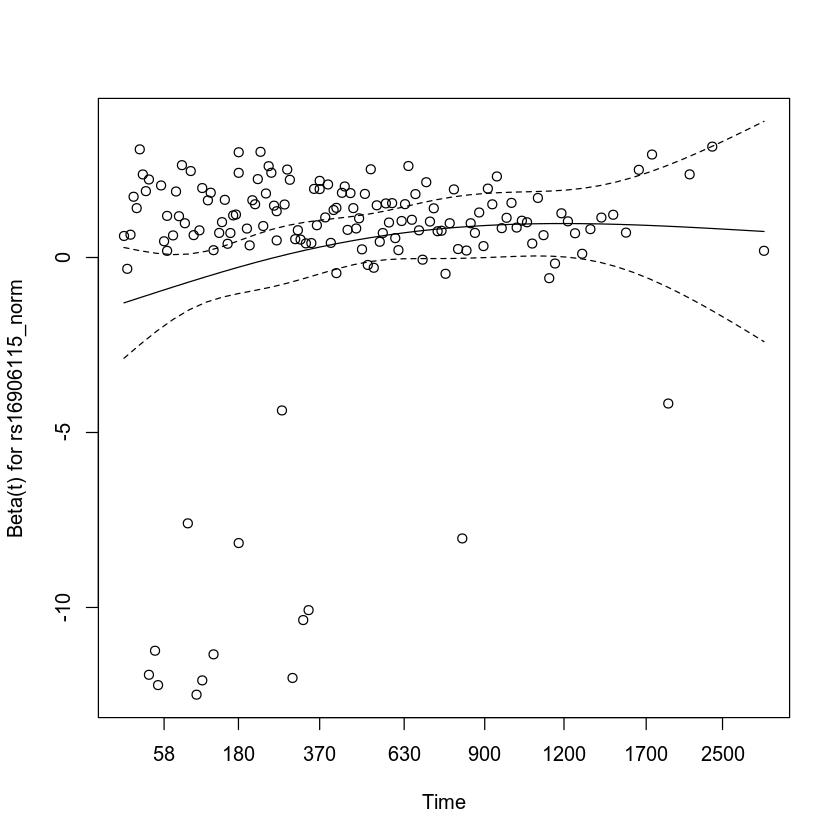

In [47]:
res <- coxph(Surv(tstart,tstop,event) ~ rs16906115_norm + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CONC_CHEMO + LINE_OF_TREATMENT + START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,OS_tempGWAS %>% filter(CANCER_TYPE=="Melanoma"))
summary(res)
cox.zph(res)

plot(cox.zph(res)[1])

In [50]:
res <- glm(latestage_or_met ~ rs16906115_norm + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CONC_CHEMO + LINE_OF_TREATMENT + START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,OS_tempGWAS %>% filter(CANCER_TYPE=="Melanoma"),family="binomial")
summary(res)

res <- glm(latestage_or_met ~ rs16906115_norm,OS_tempGWAS %>% filter(CANCER_TYPE=="Melanoma"),family="binomial")
summary(res)


Call:
glm(formula = latestage_or_met ~ rs16906115_norm + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CONC_CHEMO + LINE_OF_TREATMENT + START_YEAR + 
    PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2, 
    family = "binomial", data = OS_tempGWAS %>% filter(CANCER_TYPE == 
        "Melanoma"))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-2.4630   0.3543   0.5311   0.7266   1.1714  

Coefficients:
                              Estimate Std. Error z value Pr(>|z|)  
(Intercept)                   3.052398   1.578497   1.934   0.0531 .
rs16906115_norm              -0.455967   0.348381  -1.309   0.1906  
GENDERMALE                    0.055838   0.264140   0.211   0.8326  
AGE_AT_TREATMENTSTART        -0.015422   0.010122  -1.524   0.1276  
TREATMENT_CUMCTLA4            0.310781   0.545569   0.570   0.5689  
TREATMENT_CUMPD1_CTLA4_combo  0.218755   0.337852   0.647   0.5173  
CONC_CHEMOTRUE               -0.248654   0.488012  -0.510   0.61


Call:
glm(formula = latestage_or_met ~ rs16906115_norm, family = "binomial", 
    data = OS_tempGWAS %>% filter(CANCER_TYPE == "Melanoma"))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-2.1258   0.4859   0.6933   0.7131   0.7202  

Coefficients:
                Estimate Std. Error z value Pr(>|z|)    
(Intercept)       2.4437     0.6635   3.683  0.00023 ***
rs16906115_norm  -0.5844     0.3428  -1.705  0.08825 .  
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

(Dispersion parameter for binomial family taken to be 1)

    Null deviance: 414.89  on 407  degrees of freedom
Residual deviance: 411.50  on 406  degrees of freedom
AIC: 415.5

Number of Fisher Scoring iterations: 4


In [51]:
names(OS)

[1] "MRN"                                                                              
   [2] "id"                                                                               
   [3] "tstart"                                                                           
   [4] "tstop"                                                                            
   [5] "event"                                                                            
   [6] "PROFILE_AFTER_TREATMENT"                                                          
   [7] "LAST_DATE"                                                                        
   [8] "IO_START"                                                                         
   [9] "IO_STOP"                                                                          
  [10] "othertreatment_after_io"                                                          
  [11] "othertreatment_while_io"                                                          
  [12] "othertreatment_before_io"                                                         
  [13] "PROFILE_AFTER_DEATH"                                                              
  [14] "AGE_AT_TREATMENTSTART"                                                            
  [15] "AGE_AT_TREATMENTSTART_BINNED"                                                     
  [16] "GENDER"                                                                           
  [17] "treatment_type"                                                                   
  [18] "MEDICATION_CUM"                                                                   
  [19] "TREATMENT_CUM"                                                                    
  [20] "CONC_CHEMO"                                                                       
  [21] "MET_BEFORE_TREATMENTSTART"                                                        
  [22] "PANEL_VERSION"                                                                    
  [23] "BIOPSY_SITE_TYPE"                                                                 
  [24] "PRIOR_TREATMENT"                                                                  
  [25] "LINE_OF_TREATMENT"                                                                
  [26] "ANCESTRY_PC1"                                                                     
  [27] "ANCESTRY_PC2"                                                                     
  [28] "ANCESTRY_SELFREPORTED"                                                            
  [29] "ANCESTRY_ROT_PC2"                                                                 
  [30] "ANCESTRY_ROT_PC1"                                                                 
  [31] "ANCESTRY_GENETICS"                                                                
  [32] "START_YEAR"                                                                       
  [33] "CANCER_TYPE"                                                                      
  [34] "PRIMARY_CANCER_DIAGNOSIS"                                                         
  [35] "targeted_before_IO"                                                               
  [36] "targeted_egfr_before_IO"                                                          
  [37] "TMB"                                                                              
  [38] "TMB_binned"                                                                       
  [39] "TMB_rank"                                                                         
  [40] "STAGE"                                                                            
  [41] "TUMOR_PURITY"                                                                     
  [42] "immune_suppressant"                                                               
  [43] "before_2018"                                                                      
  [44] "TPLAN_GOAL"                                                                       

In [56]:
OS_tempGWAS %>% filter(CANCER_TYPE=="Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART=ifelse(MET_BEFORE_TREATMENTSTART=="METASTASIS",1,MET_BEFORE_TREATMENTSTART),MET_BEFORE_TREATMENTSTART=na_if(MET_BEFORE_TREATMENTSTART,"UNKNOWN")) %>% group_by(MET_BEFORE_TREATMENTSTART) %>% count

MET_BEFORE_TREATMENTSTART,n
<chr>,<int>
1,40
REGIONAL,193
NA,175


In [61]:
res <- glm(MET_BEFORE_TREATMENTSTART ~ rs16906115_norm + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CONC_CHEMO + LINE_OF_TREATMENT + START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,OS_tempGWAS %>% filter(CANCER_TYPE=="Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART=ifelse(MET_BEFORE_TREATMENTSTART=="METASTASIS",1,ifelse(MET_BEFORE_TREATMENTSTART=="REGIONAL",0,NA))),family="binomial")
summary(res)

res <- glm(MET_BEFORE_TREATMENTSTART ~ rs16906115_norm,OS_tempGWAS %>% filter(CANCER_TYPE=="Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART=ifelse(MET_BEFORE_TREATMENTSTART=="METASTASIS",1,ifelse(MET_BEFORE_TREATMENTSTART=="REGIONAL",0,NA))),family="binomial")
summary(res)


Call:
glm(formula = MET_BEFORE_TREATMENTSTART ~ rs16906115_norm + GENDER + 
    AGE_AT_TREATMENTSTART + TREATMENT_CUM + CONC_CHEMO + LINE_OF_TREATMENT + 
    START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, family = "binomial", data = OS_tempGWAS %>% 
    filter(CANCER_TYPE == "Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART = ifelse(MET_BEFORE_TREATMENTSTART == 
    "METASTASIS", 1, ifelse(MET_BEFORE_TREATMENTSTART == "REGIONAL", 
    0, NA))))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.1914  -0.6521  -0.4427  -0.2772   2.4587  

Coefficients:
                              Estimate Std. Error z value Pr(>|z|)  
(Intercept)                  -1.555009   1.702696  -0.913   0.3611  
rs16906115_norm               0.531798   0.553941   0.960   0.3370  
GENDERMALE                    0.087194   0.377741   0.231   0.8174  
AGE_AT_TREATMENTSTART         0.003324   0.013189   0.252   0.8010  
TREATMENT_CUMCTLA4           -1.002440


Call:
glm(formula = MET_BEFORE_TREATMENTSTART ~ rs16906115_norm, family = "binomial", 
    data = OS_tempGWAS %>% filter(CANCER_TYPE == "Melanoma") %>% 
        mutate(MET_BEFORE_TREATMENTSTART = ifelse(MET_BEFORE_TREATMENTSTART == 
            "METASTASIS", 1, ifelse(MET_BEFORE_TREATMENTSTART == 
            "REGIONAL", 0, NA))))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.6480  -0.6437  -0.6298  -0.5069   2.2040  

Coefficients:
                Estimate Std. Error z value Pr(>|z|)   
(Intercept)      -2.7142     1.0330  -2.627   0.0086 **
rs16906115_norm   0.6004     0.5279   1.137   0.2554   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.01 ‘*’ 0.05 ‘.’ 0.1 ‘ ’ 1

(Dispersion parameter for binomial family taken to be 1)

    Null deviance: 213.68  on 232  degrees of freedom
Residual deviance: 212.12  on 231  degrees of freedom
  (175 observations deleted due to missingness)
AIC: 216.12

Number of Fisher Scoring iterations: 4


### all of Melanoma

In [104]:
osall <- fread("../OS/OS_ALL_2021.csv")
trans_temp <- inner_join(translate_sid,translate_pid,by="PATIENT_ID") %>% select(MRN,PBP)
osall <- left_join(osall,inner_join(trans_temp,GWAS_Profile) %>% select(-PBP))

osall$PANEL_VERSION <- factor(osall$PANEL_VERSION)
osall$PANEL_VERSION <- relevel(osall$PANEL_VERSION,"3")

Joining, by = "PBP"
Joining, by = "MRN"


In [105]:
gwas2022 <- fread("/data/gusev/PROFILE/2022_03/IMPUTE/DOSAGE/PROFILE_2022_IL7signif.8.raw") %>% select(FID,`8:79712998_G`)
names(gwas2022) <- c("PBP","rs16906115")
gwas2022 <- inner_join(fread("/data/gusev/PROFILE/CLINICAL/PROFILE_MRN_BL_PANEL.PBP.tab") %>% select(DFCI_MRN,PBP) %>% rename(MRN=DFCI_MRN),gwas2022) %>% select(-PBP)

Joining, by = "PBP"


In [111]:
osall_new <- fread("../OS/OS_ALL_2021.csv")
osall_new <- inner_join(osall_new,gwas2022)
osall_new$PANEL_VERSION <- factor(osall_new$PANEL_VERSION)
osall_new$PANEL_VERSION <- relevel(osall_new$PANEL_VERSION,"3")

Joining, by = "MRN"


In [107]:
osall %>% filter(CANCER_TYPE=="Melanoma") %>% group_by(MET_BEFORE_TREATMENTSTART) %>% count
osall_new %>% filter(CANCER_TYPE=="Melanoma") %>% group_by(MET_BEFORE_TREATMENTSTART) %>% count

MET_BEFORE_TREATMENTSTART,n
<chr>,<int>
METASTASIS,59
REGIONAL,379
UNKNOWN,511


MET_BEFORE_TREATMENTSTART,n
<chr>,<int>
METASTASIS,8
REGIONAL,42
UNKNOWN,189


In [113]:
osall_all <- full_join(osall,osall_new)

Joining, by = c("MRN", "id", "tstart", "tstop", "event", "PROFILE_AFTER_TREATMENT", "LAST_DATE", "START_DATE", "AGE_AT_TREATMENTSTART", "AGE_AT_TREATMENTSTART_BINNED", "GENDER", "anyIO", "anyIO_firstdate", "MET_BEFORE_TREATMENTSTART", "PANEL_VERSION", "PANEL_SUBVERSION", "BIOPSY_SITE_TYPE", "LINE_OF_TREATMENT", "BMI", "TBC_packyear", "TBC_years", "ALC_Usage", "ALC_drinksperweek", "ANCESTRY_PC1", "ANCESTRY_PC2", "ANCESTRY_SELFREPORTED", "ANCESTRY_ROT_PC2", "ANCESTRY_ROT_PC1", "ANCESTRY_GENETICS", "START_YEAR", "CANCER_TYPE", "PRIMARY_CANCER_DIAGNOSIS", "targeted_before_IO", "targeted_egfr_before_IO", "TMB", "TMB_binned", "TMB_rank", "STAGE", "TUMOR_PURITY", "CAUSE_OF_DEATH", "TPLAN_GOAL", "ANCESTRY_EA_PC1", "ANCESTRY_EA_PC2", "ANCESTRY_PC_ASH", "ANCESTRY_PC_NS", "SUBTYPE", "latestage_or_met", "LAB_STAGE", "STAGE_DIAG", "LAB_ECOG", "DIAG_ECOG", "targeted_gene_mutation", "CANONICAL_GENE_ABCB11", "CANONICAL_GENE_ABL1", "CANONICAL_GENE_AKT3", "CANONICAL_GENE_ALK", "CANONICAL_GENE_APC", "CAN

In [117]:
res <- glm(MET_BEFORE_TREATMENTSTART ~ rs16906115 + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,osall %>% filter(CANCER_TYPE=="Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART=ifelse(MET_BEFORE_TREATMENTSTART=="METASTASIS",1,ifelse(MET_BEFORE_TREATMENTSTART=="REGIONAL",0,NA))),family="binomial")
summary(res)

res <- glm(MET_BEFORE_TREATMENTSTART ~ rs16906115 + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,osall_new %>% filter(CANCER_TYPE=="Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART=ifelse(MET_BEFORE_TREATMENTSTART=="METASTASIS",1,ifelse(MET_BEFORE_TREATMENTSTART=="REGIONAL",0,NA))),family="binomial")
summary(res)

res <- glm(MET_BEFORE_TREATMENTSTART ~ rs16906115 + GENDER + PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,osall_all %>% filter(CANCER_TYPE=="Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART=ifelse(MET_BEFORE_TREATMENTSTART=="METASTASIS",1,ifelse(MET_BEFORE_TREATMENTSTART=="REGIONAL",0,NA))),family="binomial")
summary(res)


Call:
glm(formula = MET_BEFORE_TREATMENTSTART ~ rs16906115 + GENDER + 
    PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2, family = "binomial", 
    data = osall %>% filter(CANCER_TYPE == "Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART = ifelse(MET_BEFORE_TREATMENTSTART == 
        "METASTASIS", 1, ifelse(MET_BEFORE_TREATMENTSTART == 
        "REGIONAL", 0, NA))))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.7624  -0.5791  -0.5193  -0.3946   2.4196  

Coefficients:
                 Estimate Std. Error z value Pr(>|z|)   
(Intercept)       -5.2205     1.6177  -3.227  0.00125 **
rs16906115         1.6398     0.8403   1.951  0.05101 . 
GENDERMALE         0.3119     0.3137   0.994  0.32020   
PANEL_VERSION1     0.5440     0.5420   1.004  0.31552   
PANEL_VERSION2     0.1555     0.3336   0.466  0.64106   
ANCESTRY_ROT_PC1   0.2532     4.9049   0.052  0.95882   
ANCESTRY_ROT_PC2  -1.9702     3.6338  -0.542  0.58769   
---
Signif. codes:  0 ‘***’ 0.001 ‘**’ 0.


Call:
glm(formula = MET_BEFORE_TREATMENTSTART ~ rs16906115 + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, family = "binomial", data = osall_new %>% 
    filter(CANCER_TYPE == "Melanoma") %>% mutate(MET_BEFORE_TREATMENTSTART = ifelse(MET_BEFORE_TREATMENTSTART == 
    "METASTASIS", 1, ifelse(MET_BEFORE_TREATMENTSTART == "REGIONAL", 
    0, NA))))

Deviance Residuals: 
         1           2           7          30          31  
-6.547e-06  -6.547e-06  -6.547e-06  -6.547e-06  -6.547e-06  

Coefficients:
                   Estimate Std. Error z value Pr(>|z|)
(Intercept)      -2.457e+01  2.340e+06       0        1
rs16906115       -1.586e-13  1.019e+06       0        1
ANCESTRY_ROT_PC1  6.288e-12  3.727e+07       0        1
ANCESTRY_ROT_PC2 -8.761e-12  5.155e+07       0        1

(Dispersion parameter for binomial family taken to be 1)

    Null deviance: 0.0000e+00  on 4  degrees of freedom
Residual deviance: 2.1434e-10  on 1  degrees of freedom
  (234 observations deleted due to missingnes


Call:
glm(formula = MET_BEFORE_TREATMENTSTART ~ rs16906115 + GENDER + 
    PANEL_VERSION + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2, family = "binomial", 
    data = osall_all %>% filter(CANCER_TYPE == "Melanoma") %>% 
        mutate(MET_BEFORE_TREATMENTSTART = ifelse(MET_BEFORE_TREATMENTSTART == 
            "METASTASIS", 1, ifelse(MET_BEFORE_TREATMENTSTART == 
            "REGIONAL", 0, NA))))

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.7284  -0.5800  -0.5199  -0.3945   2.4179  

Coefficients:
                 Estimate Std. Error z value Pr(>|z|)   
(Intercept)       -5.2559     1.6269  -3.231  0.00124 **
rs16906115         1.6583     0.8456   1.961  0.04988 * 
GENDERMALE         0.3106     0.3133   0.992  0.32142   
PANEL_VERSION1     0.4491     0.5379   0.835  0.40376   
PANEL_VERSION2     0.1384     0.3333   0.415  0.67787   
ANCESTRY_ROT_PC1   0.5670     4.8552   0.117  0.90704   
ANCESTRY_ROT_PC2  -1.8880     3.5641  -0.530  0.59630   
---
Signif. codes:  

Call:
coxph(formula = Surv(tstart, tstop, event) ~ rs16906115 + GENDER + 
    AGE_AT_TREATMENTSTART + strata(anyIO) + LINE_OF_TREATMENT + 
    START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = osall %>% filter(CANCER_TYPE == 
    "Melanoma"))

  n= 713, number of events= 268 
   (236 observations deleted due to missingness)

                           coef exp(coef)  se(coef)      z Pr(>|z|)    
rs16906115            -0.001839  0.998162  0.210003 -0.009 0.993012    
GENDERMALE             0.158704  1.171991  0.128058  1.239 0.215229    
AGE_AT_TREATMENTSTART  0.017974  1.018136  0.004713  3.814 0.000137 ***
LINE_OF_TREATMENT      0.844826  2.327573  0.235386  3.589 0.000332 ***
START_YEAR>2018        0.435934  1.546407  0.407675  1.069 0.284926    
START_YEAR2016         0.235011  1.264922  0.221768  1.060 0.289275    
START_YEAR2017         0.389682  1.476511  0.391179  0.996 0.319166    
START_YEAR2018         0.456098  1.577905  0.405986  1

                          rho    chisq     p
rs16906115             0.0224  0.14833 0.700
GENDERMALE            -0.0925  2.37056 0.124
AGE_AT_TREATMENTSTART -0.0288  0.24690 0.619
LINE_OF_TREATMENT     -0.1411  6.16624 0.013
START_YEAR>2018       -0.0734  1.53816 0.215
START_YEAR2016        -0.0720  1.47938 0.224
START_YEAR2017        -0.0027  0.00215 0.963
START_YEAR2018        -0.0522  0.80396 0.370
PANEL_VERSION1        -0.0460  0.60959 0.435
PANEL_VERSION2        -0.0256  0.18745 0.665
TUMOR_PURITY          -0.0275  0.22569 0.635
ANCESTRY_ROT_PC1       0.0479  0.54386 0.461
ANCESTRY_ROT_PC2      -0.0232  0.15532 0.694
GLOBAL                     NA 19.11114 0.120

Warning message in fitter(X, Y, strats, offset, init, control, weights = weights, :
“Loglik converged before variable  2 ; beta may be infinite. ”

Call:
coxph(formula = Surv(tstart, tstop, event) ~ rs16906115 + GENDER + 
    AGE_AT_TREATMENTSTART + strata(anyIO) + LINE_OF_TREATMENT + 
    START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + 
    ANCESTRY_ROT_PC2, data = osall_new %>% filter(CANCER_TYPE == 
    "Melanoma"))

  n= 8, number of events= 1 
   (231 observations deleted due to missingness)

                            coef  exp(coef)   se(coef)      z Pr(>|z|)
rs16906115             1.244e-11  1.000e+00  1.717e+03  0.000    1.000
GENDERMALE            -1.272e+01  2.999e-06  5.870e+02 -0.022    0.983
AGE_AT_TREATMENTSTART -3.022e-13  1.000e+00  5.418e+01  0.000    1.000
LINE_OF_TREATMENT             NA         NA  0.000e+00     NA       NA
START_YEAR>2018               NA         NA  0.000e+00     NA       NA
START_YEAR2018        -9.632e-12  1.000e+00  7.988e+02  0.000    1.000
PANEL_VERSION                 NA         NA  0.000e+00     NA       NA
TUMOR_PURITY                  NA         NA  0.000e+00     NA 

                      rho chisq   p
rs16906115             NA   NaN NaN
GENDERMALE             NA   NaN NaN
AGE_AT_TREATMENTSTART  NA   NaN NaN
LINE_OF_TREATMENT      NA   NaN NaN
START_YEAR>2018        NA   NaN NaN
START_YEAR2018         NA   NaN NaN
PANEL_VERSION          NA   NaN NaN
TUMOR_PURITY           NA   NaN NaN
ANCESTRY_ROT_PC1       NA   NaN NaN
ANCESTRY_ROT_PC2       NA   NaN NaN
GLOBAL                 NA   NaN NaN

ERROR: Error in qr.default(t(const)): NA/NaN/Inf in foreign function call (arg 1)


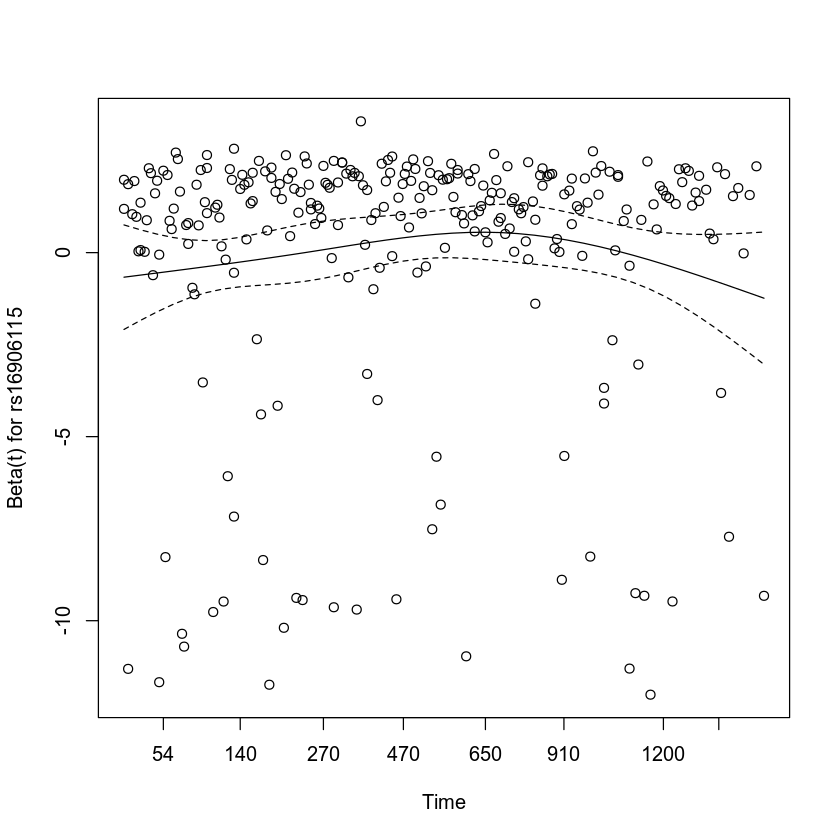

In [109]:
res <- coxph(Surv(tstart,tstop,event) ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + strata(anyIO) + LINE_OF_TREATMENT + START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,osall %>% filter(CANCER_TYPE=="Melanoma"))
summary(res)
cox.zph(res)

plot(cox.zph(res)[1])

res <- coxph(Surv(tstart,tstop,event) ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + strata(anyIO) + LINE_OF_TREATMENT + START_YEAR + PANEL_VERSION + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2,osall_new %>% filter(CANCER_TYPE=="Melanoma"))
summary(res)
cox.zph(res)

plot(cox.zph(res)[1])

# Aalen-Johansen estimator

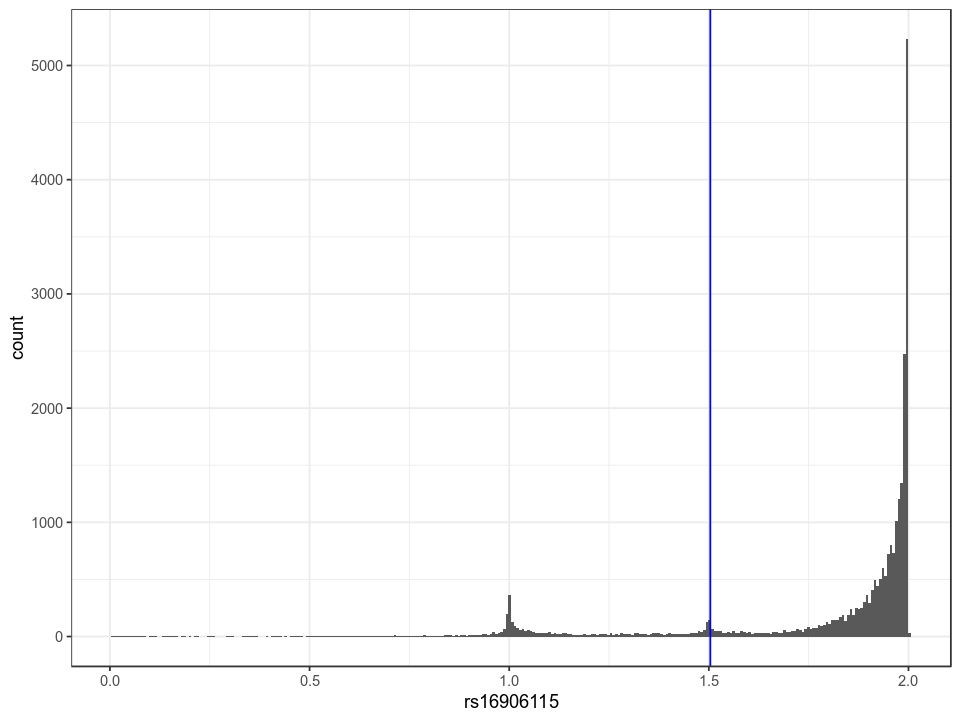

In [343]:
options(repr.plot.width=8, repr.plot.height=6)
ggplot(GWAS_Profile,aes(x=rs16906115)) + geom_histogram(,bins=300) + geom_vline(aes(xintercept=decision_boundary),col='blue') + theme_bw()

Warning message in sqrt(diag(varP)):
“NaNs produced”Warning message in sqrt(diag(varP)):
“NaNs produced”

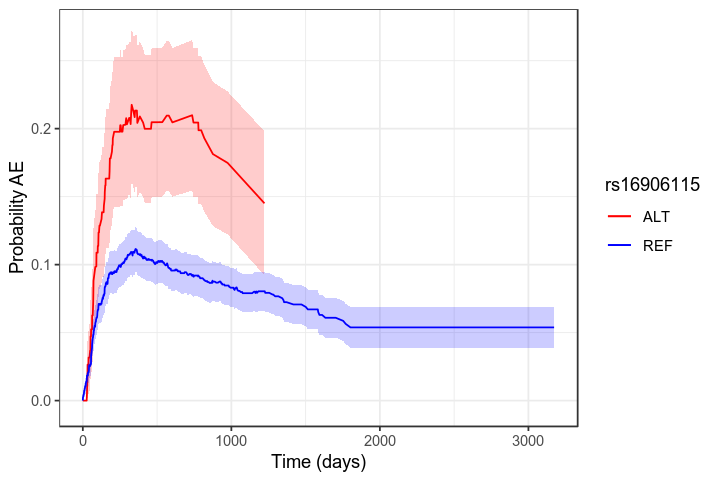

time,REF_pstate1,REF_pstate2,REF_pstate3,REF_se1,REF_se2,REF_se3,ALT_pstate1,ALT_pstate2,ALT_pstate3,ALT_se1,ALT_se2,ALT_se3
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
361,0.3885458,0.1108307,0.5006236,0.01296925,0.008325433,0.01330597,NA,NA,NA,NA,NA,NA
363,0.3878665,0.1108307,0.5013029,0.01296432,0.008325433,0.01330514,NA,NA,NA,NA,NA,NA
364,0.3878665,0.1101825,0.5019510,0.01296432,0.008301790,0.01330364,0.3273845,0.2132979,0.4593176,0.03270873,0.02849613,0.03474615
365,0.3871872,0.1095344,0.5032784,0.01295937,0.008278069,0.01330122,NA,NA,NA,NA,NA,NA
366,0.3865079,0.1088863,0.5046058,0.01295439,0.008254270,0.01329873,0.3273845,0.2087596,0.4638558,0.03270873,0.02824131,0.03474464
367,0.3865079,0.1082381,0.5052540,0.01295439,0.008230393,0.01329716,0.3273845,0.2042214,0.4683941,0.03270873,0.02798180,0.03474123
368,0.3858286,0.1082381,0.5059332,0.01294939,0.008230393,0.01329617,NA,NA,NA,NA,NA,NA
369,0.3851494,0.1082381,0.5066125,0.01294437,0.008230393,0.01329516,NA,NA,NA,NA,NA,NA


Warning message in probtrans(msf0, predt = 0):
“Warning! Negative diagonal elements of (I+dA); the estimate may not be meaningful. 
”

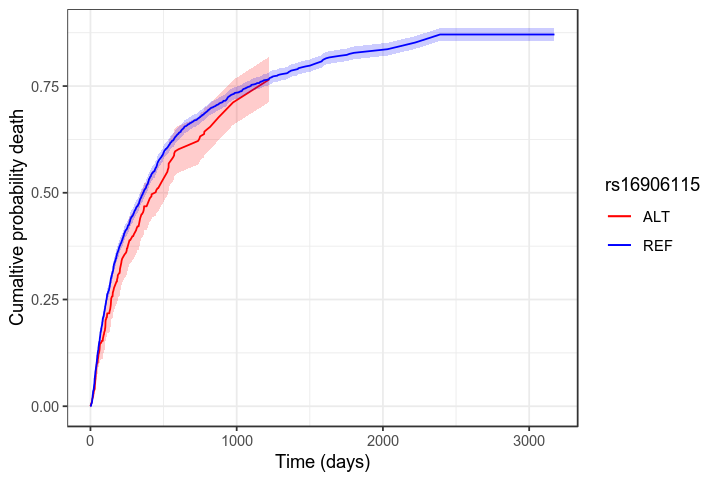

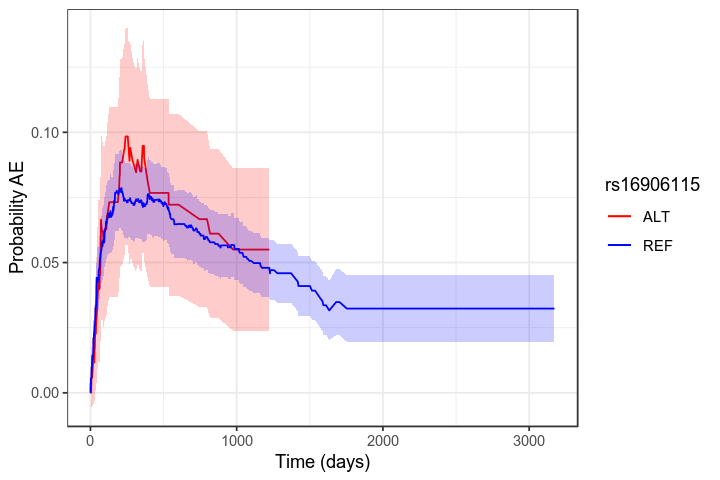

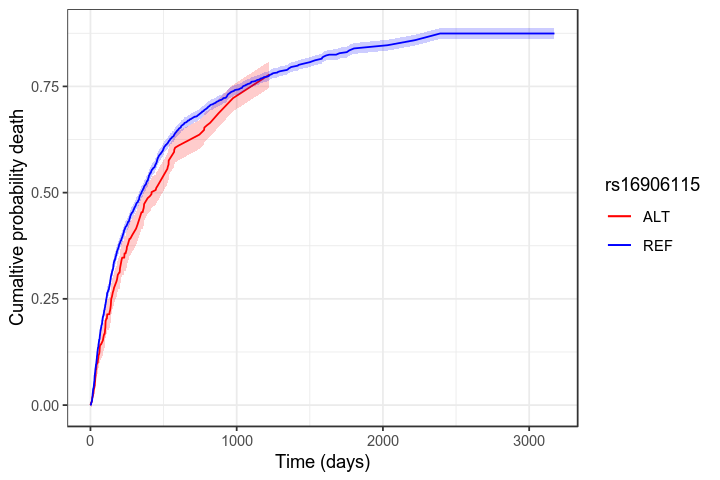

In [265]:
library(purrr)

prob_ae <- list()
temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115>decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115<=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Probability AE",x="Time (days)") + theme_bw()
options(options_before)

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,y=ALT_pstate3,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,ymax=ALT_pstate3+qnorm(0.975)*ALT_se2,ymin=ALT_pstate3-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,y=REF_pstate3,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,ymax=REF_pstate3+qnorm(0.975)*REF_se2,ymin=REF_pstate3-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability death",x="Time (days)") + theme_bw()
options(options_before)

temp %>% filter(time>360,time<370)

### Curated
library(purrr)

prob_ae <- list()
temp <- OS_GWAS_cur %>% filter(before_2018==1) %>% filter(rs16906115>decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

temp <- OS_GWAS_cur %>% filter(before_2018==1) %>% filter(rs16906115<=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Probability AE",x="Time (days)") + theme_bw()
options(options_before)

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,y=ALT_pstate3,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,ymax=ALT_pstate3+qnorm(0.975)*ALT_se2,ymin=ALT_pstate3-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,y=REF_pstate3,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,ymax=REF_pstate3+qnorm(0.975)*REF_se2,ymin=REF_pstate3-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability death",x="Time (days)") + theme_bw()
options(options_before)

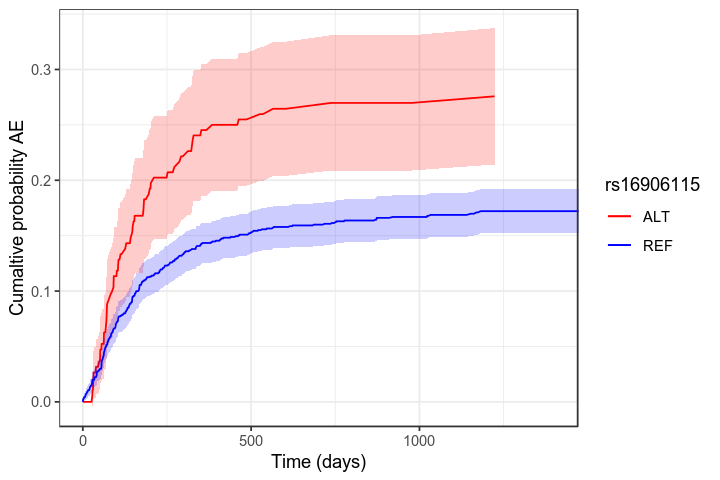

time,REF_pstate1,REF_pstate2,REF_pstate3,REF_se1,REF_se2,REF_se3,ALT_pstate1,ALT_pstate2,ALT_pstate3,ALT_se1,ALT_se2,ALT_se3
<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
361,0.3885458,0.1433944,0.4680599,0.01296925,0.009421343,0.01333972,NA,NA,NA,NA,NA,NA
363,0.3878665,0.1433944,0.4687392,0.01296432,0.009421343,0.01334010,NA,NA,NA,NA,NA,NA
364,0.3878665,0.1433944,0.4687392,0.01296432,0.009421343,0.01334010,0.3273845,0.2452946,0.4273209,0.03270873,0.03020287,0.03470923
365,0.3871872,0.1433944,0.4694184,0.01295937,0.009421343,0.01334047,NA,NA,NA,NA,NA,NA
366,0.3865079,0.1433944,0.4700977,0.01295439,0.009421343,0.01334081,0.3273845,0.2452946,0.4273209,0.03270873,0.03020287,0.03470923
367,0.3865079,0.1433944,0.4700977,0.01295439,0.009421343,0.01334081,0.3273845,0.2452946,0.4273209,0.03270873,0.03020287,0.03470923
368,0.3858286,0.1433944,0.4707770,0.01294939,0.009421343,0.01334113,NA,NA,NA,NA,NA,NA
369,0.3851494,0.1433944,0.4714563,0.01294437,0.009421343,0.01334143,NA,NA,NA,NA,NA,NA


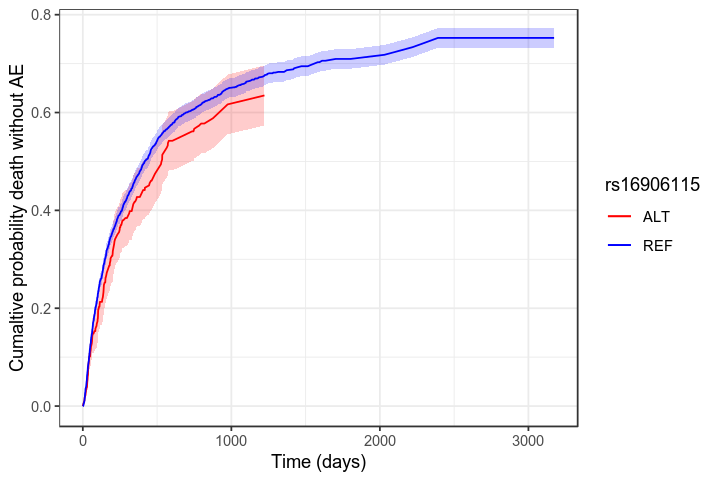

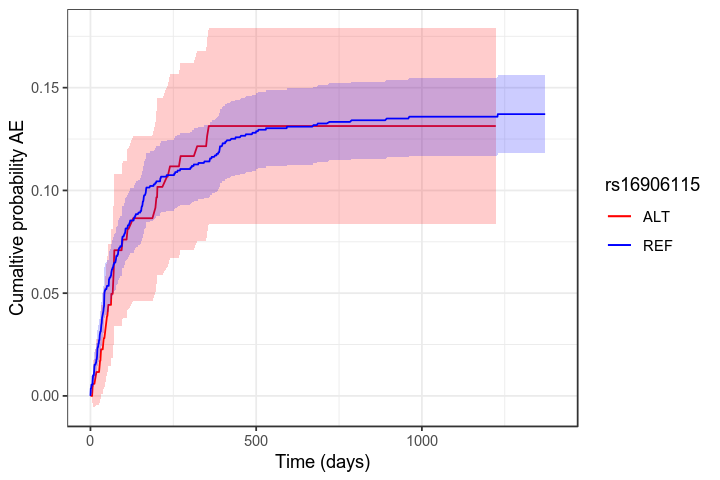

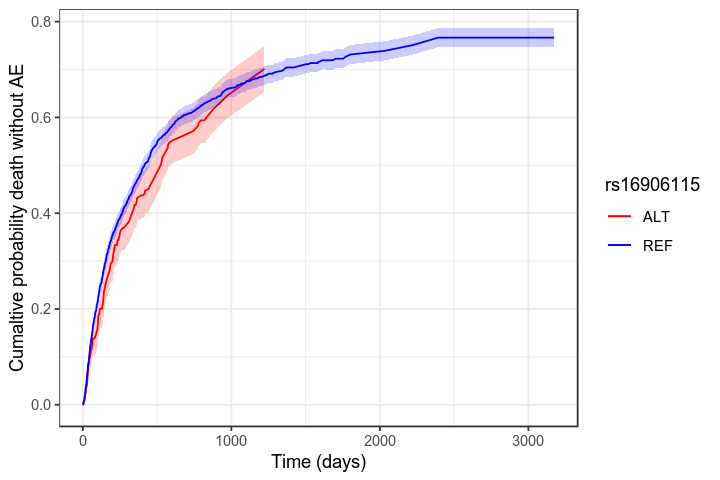

In [268]:
library(purrr)

prob_ae <- list()
temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115>decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115<=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability AE",x="Time (days)") + theme_bw() + coord_cartesian(xlim = c(0, 1400)) 
options(options_before)

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,y=ALT_pstate3,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,ymax=ALT_pstate3+qnorm(0.975)*ALT_se2,ymin=ALT_pstate3-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,y=REF_pstate3,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,ymax=REF_pstate3+qnorm(0.975)*REF_se2,ymin=REF_pstate3-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability death without AE",x="Time (days)") + theme_bw()
options(options_before)

temp %>% filter(time>360,time<370)

library(purrr)

prob_ae <- list()
temp <- OS_GWAS_cur %>% filter(before_2018==1) %>% filter(rs16906115>decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

temp <- OS_GWAS_cur %>% filter(before_2018==1) %>% filter(rs16906115<=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability AE",x="Time (days)") + theme_bw() + xlim(0,1400)
options(options_before)

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,y=ALT_pstate3,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,ymax=ALT_pstate3+qnorm(0.975)*ALT_se2,ymin=ALT_pstate3-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,y=REF_pstate3,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,ymax=REF_pstate3+qnorm(0.975)*REF_se2,ymin=REF_pstate3-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs16906115", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability death without AE",x="Time (days)") + theme_bw()
options(options_before)

In [276]:
# library(purrr)

# prob_ae <- list()
# temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs75824728>median(rs75824728))
# c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
# tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
# msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
# #     plot(msf0)
# pt0 <- probtrans(msf0,predt=0)
# prob_ae[["REF"]] <- pt0

# temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs75824728<=median(rs75824728))
# c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
# tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
# msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
# #     plot(msf0)
# pt0 <- probtrans(msf0,predt=0)
# prob_ae[["ALT"]] <- pt0

# temp <- list()
# for (i in 1:length(names(prob_ae))) {
#     ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
#     names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
#     temp[[names(prob_ae)[i]]] <- ttemp
    
# }
# temp <- temp %>% reduce(left_join, by = "time")

# options_before <- options()
# options(repr.plot.width=6,repr.plot.height=4)
# ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs75824728", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability AE",x="Time (days)") + theme_bw()
# options(options_before)

# options_before <- options()
# options(repr.plot.width=6,repr.plot.height=4)
# ggplot(temp) + geom_line(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,y=ALT_pstate3,color="ALT")) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate3"]),],aes(x=time,ymax=ALT_pstate3+qnorm(0.975)*ALT_se2,ymin=ALT_pstate3-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + geom_line(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,y=REF_pstate3,color="REF"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate3"]),],aes(x=time,ymax=REF_pstate3+qnorm(0.975)*REF_se2,ymin=REF_pstate3-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs75824728", values=c("ALT"="red","REF"="blue")) + labs(y="Cumaltive probability death without AE",x="Time (days)") + theme_bw()
# options(options_before)

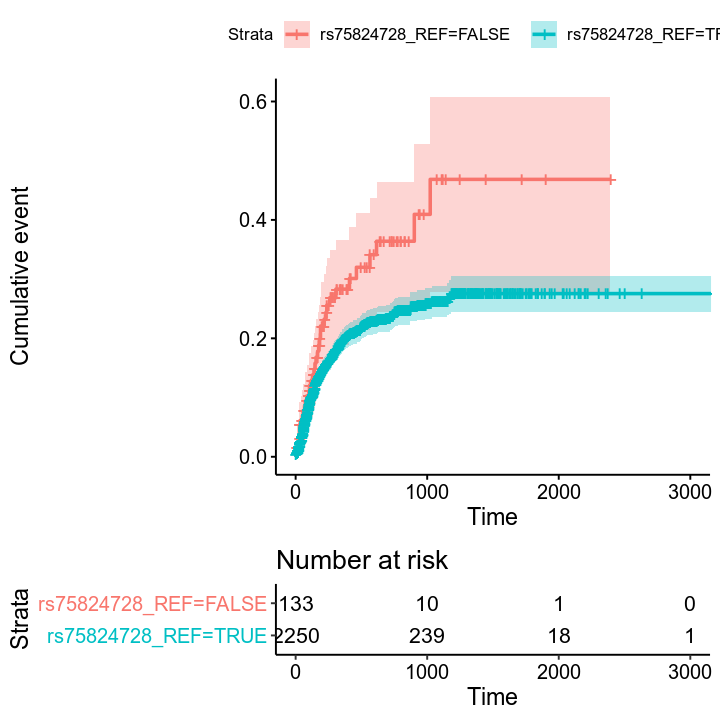

In [135]:
library(survminer)
library(survival)

fit <- survfit(Surv(Tstop, status) ~ rs75824728_REF,
               data = OS_GWAS %>% filter(trans==1) %>% mutate(rs75824728_REF=rs75824728>1))
# Visualize with survminer
options(repr.plot.width=6,repr.plot.height=6)
ggsurvplot(fit, data = OS_GWAS %>% filter(trans==1) %>% mutate(rs75824728_REF=rs75824728>1), risk.table = TRUE, conf.int = TRUE, fun = "event")

Warning message:
“Removed 3 rows containing missing values (geom_bar).”

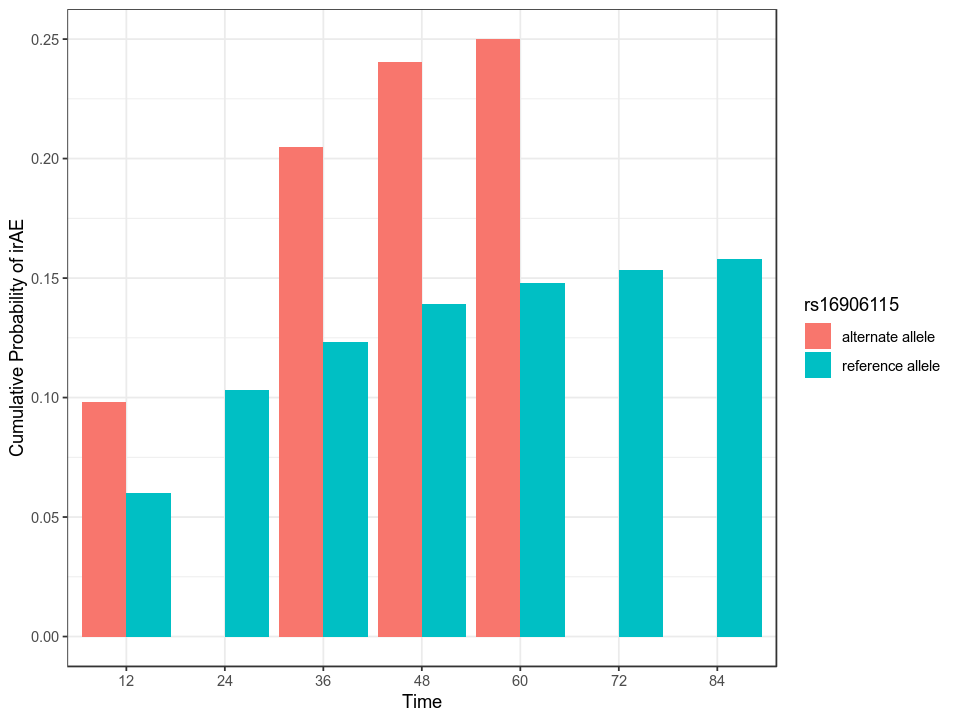

In [346]:
library(purrr)

prob_ae <- list()
temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115>decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["high"]] <- pt0

temp <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115<=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["low"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

bin_probs <- data.frame()
for (i in 1:7) {
    prob_high <- mean((temp %>% filter(time>i*7*12-5,time<i*7*12+5))$high_pstate2,na.rm=T)
    prob_low <- mean((temp %>% filter(time>i*7*12-5,time<i*7*12+5))$low_pstate2,na.rm=T)
    temp_df <- data.frame(t=i*12,prob_high=prob_high,prob_low=prob_low)
    bin_probs <- rbind(bin_probs,temp_df)
}
bin_probs <- bin_probs %>% rename(`reference allele`=prob_high,`alternate allele`=prob_low) %>% gather("rs16906115","Cumulative Probability of irAE",-t)

bin_probs %>% mutate(t=as.factor(t)) %>% rename(Time=t) %>% ggplot(.) + geom_bar(aes(x=Time,y=`Cumulative Probability of irAE`,fill=rs16906115),stat="identity",position="dodge") + theme_bw()

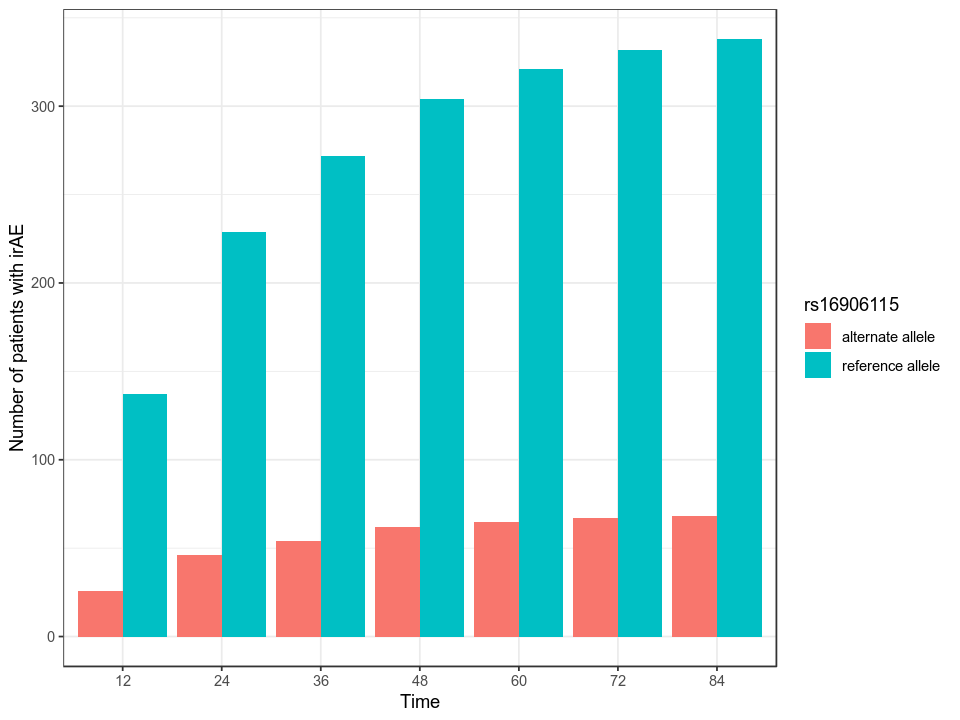

In [347]:
bin_probs <- data.frame()
for (i in 1:7) {
    num_high <- dim(OS_GWAS %>% filter(rs16906115>decision_boundary,trans==1,status==1) %>% filter(Tstop<i*7*12+5))[1]
    num_low <- dim(OS_GWAS %>% filter(rs16906115<=decision_boundary,trans==1,status==1) %>% filter(Tstop<i*7*12+5))[1]
    temp_df <- data.frame(t=i*12,num_high=num_high,num_low=num_low)
    bin_probs <- rbind(bin_probs,temp_df)
}
bin_probs <- bin_probs %>% rename(`reference allele`=num_high,`alternate allele`=num_low) %>% gather("rs16906115","Number of patients with irAE",-t)
# bin_probs <- bin_probs %>% group_by(rs16906115) %>% mutate(`Number of patients with irAE`=`Number of patients with irAE`/sum(`Number of patients with irAE`))
bin_probs %>% mutate(t=as.factor(t)) %>% rename(Time=t) %>% ggplot(.) + geom_bar(aes(x=Time,y=`Number of patients with irAE`,fill=rs16906115),stat="identity",position="dodge") + theme_bw()

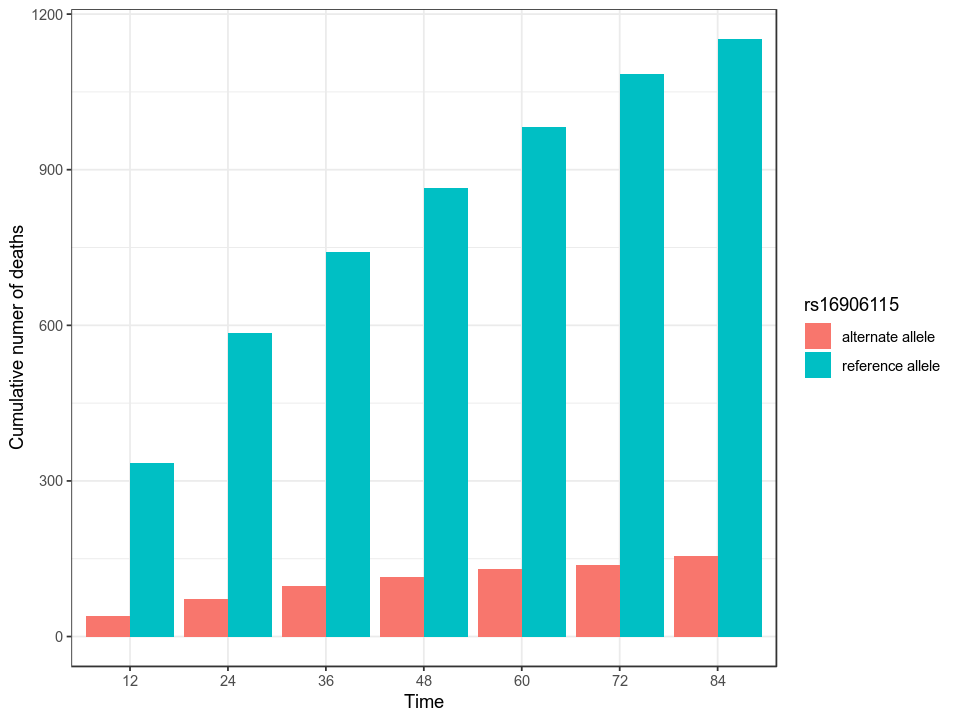

In [348]:
bin_probs <- data.frame()
for (i in 1:7) {
    num_high <- dim(OS_GWAS %>% filter(rs16906115>decision_boundary,trans==2 | trans==3,status==1) %>% filter(Tstop<i*7*12+5))[1]
    num_low <- dim(OS_GWAS %>% filter(rs16906115<=decision_boundary,trans==2 | trans==3,status==1) %>% filter(Tstop<i*7*12+5))[1]
    temp_df <- data.frame(t=i*12,num_high=num_high,num_low=num_low)
    bin_probs <- rbind(bin_probs,temp_df)
}
bin_probs <- bin_probs %>% rename(`reference allele`=num_high,`alternate allele`=num_low) %>% gather("rs16906115","Cumulative numer of deaths",-t)
# bin_probs <- bin_probs %>% group_by(rs16906115) %>% mutate(`Cumulative numer of deaths`=`Cumulative numer of deaths`/sum(`Cumulative numer of deaths`))
bin_probs %>% mutate(t=as.factor(t)) %>% rename(Time=t) %>% ggplot(.) + geom_bar(aes(x=Time,y=`Cumulative numer of deaths`,fill=rs16906115),stat="identity",position="dodge") + theme_bw()

### meta analysis over treatment

In [61]:
meta_survival_AE_stratcancer <- function(cov_vec_in,OS_temp,vars_in_each=vie,vars_in_all=via,vars_direct=c(),transition="1|2|3",plot=TRUE,name=c(),minx=c(),maxx=c(),cancer_variable="CANCER_TYPE",cancer_leaveout=c()) {
    temp <- OS_temp %>% select(MRN,trans,one_of(vars_in_all)) %>% drop_na
    x <- model.matrix(as.formula(paste("~ MRN + trans + ",paste(vars_in_all,collapse=" + "),sep="")), temp)
    OS_temp <- OS_temp %>% select(-one_of(vars_in_all)) #%>% cbind(x)
    OS_temp <- merge(OS_temp,x,by=c("MRN","trans"))

    vars_trans1 <- vars_in_each$trans1
    vars_trans1 <- names(OS_temp)[grepl(paste(vars_trans1,collapse="|"),names(OS_temp)) & grepl("\\.1$",names(OS_temp))]
    vars_trans2 <- vars_in_each$trans2
    vars_trans2 <- names(OS_temp)[grepl(paste(vars_trans2,collapse="|"),names(OS_temp)) & grepl("\\.2$",names(OS_temp))]
    vars_trans3 <- vars_in_each$trans3
    vars_trans3 <- names(OS_temp)[grepl(paste(vars_trans3,collapse="|"),names(OS_temp)) & grepl("\\.3$",names(OS_temp))]

    cov_vec <- names(OS_temp)[grepl(paste("^",paste(cov_vec_in,collapse="\\.[1-3]$|^"),"\\.[1-3]$",sep=""),names(OS_temp)) & grepl(paste("\\.",transition,"$",sep=""),names(OS_temp))]
    vars_trans1 <- vars_trans1[!grepl(paste(cov_vec,collapse="|"),vars_trans1)]
    vars_trans2 <- vars_trans2[!grepl(paste(cov_vec,collapse="|"),vars_trans2)]
    vars_trans3 <- vars_trans3[!grepl(paste(cov_vec,collapse="|"),vars_trans3)]
    
    vars_in_all <- names(OS_temp)[grepl(paste(vars_in_all,collapse="|"),names(OS_temp))& !grepl("\\.[1-3]$",names(OS_temp))]
    vars_in_all <- vars_in_all[!grepl(paste(cov_vec,collapse="|"),vars_in_all)]
    
    vars <- c(vars_trans1,vars_trans2,vars_trans3,vars_in_all,vars_direct)
    
    OS_temp <- OS_temp %>% select(MRN,CANCER_TYPE,matches(cancer_variable),Tstart,Tstop,status,trans,one_of(vars),one_of(cov_vec)) %>% drop_na %>% filter(grepl(transition,as.character(trans)))
    
    df_hazard <- data.frame(cancer=c(),variables=c(),log_hr=c(),log_hr_sd=c(),pval=c(),n=c(),pval_prophaz=c())
    if (length(cancer_leaveout)>0) {
        cancers <- unique(OS_temp[,cancer_variable])[!grepl(paste(cancer_leaveout,collapse="|"),unique(OS_temp[,cancer_variable]))]
    } else {
        cancers <- unique(OS_temp[,cancer_variable])
    }
    for (c in cancers) {
        tryCatch({
            OS_C <- OS_temp %>% filter(get(cancer_variable)==c)
    #         OS_C <- OS_temp %>% filter(CANCER_TYPE==c) # %>% filter(trans==1)
            if (sum(OS_C$status)>0) {
                # make formula
                fit <- find_vars_fit(vars,cov_vec,OS_C,strat_cancer=T)
                vars_meta <- unlist(lapply(cov_vec,function(x) rownames(summary(fit)$coefficients)[grepl(x,rownames(summary(fit)$coefficients))]))
                temp <- data.table(cancer=c,variables=vars_meta,log_hr=summary(fit)$coefficients[vars_meta,c("coef")],log_hr_sd=summary(fit)$coefficients[vars_meta,c("se(coef)")],pval=summary(fit)$coefficients[vars_meta,c("Pr(>|z|)")])
                temp$n <- dim(OS_C %>% distinct(MRN))[[1]]
                temp$pval_prophaz <- suppressWarnings(cox.zph(fit))$table[vars_meta,"p"]
                df_hazard <- rbind(df_hazard,temp)
            }
        }, 
            error=function (e) {
                print(paste("Error:",e))
                print(paste("Cancer",c,"was unsuccesful"))}
        )
    }
    df_hazard_ret <- df_hazard                              
    df_hazard <- df_hazard %>% drop_na(pval_prophaz) %>% filter(pval_prophaz>prophazard_pval_cutoff_meta) %>% filter(!is.na(log_hr)) %>% filter(!(abs(log_hr_sd/log_hr)>100 & abs(log_hr)>0.01))

    df_hazard$p <- df_hazard$pval
    df_hazard$p_prophaz <- df_hazard$pval_prophaz
#     df_hazard$p <- signif(df_hazard$pval,2)
#     df_hazard$p_prophaz <- signif(df_hazard$pval_prophaz,2)
    res <- df_hazard %>% group_by(variables) %>% do(result=metagen(log_hr,log_hr_sd,data=.,studlab=paste(cancer),comb.random=F,comb.fixed=T,method.tau = "SJ",hakn = TRUE,prediction=F,sm="SMD"))
#     if(plot) {
#         if (length(res$result)>0) {
#             for (i in 1:length(res$result)) {
#      forest(res$result[[i]],leftcols=c("studlab","TE","seTE","n","p","p_prophaz"),print.tau2=F,print.pval.Q=F,print.I2=F,digits=4)
#                     grid.text(res$variables[[i]], 0.5,0.95, gp=gpar(cex=1.5))
#                     grid.text(paste("p=",signif(res$result[[i]]$pval.fixed,2),sep=""), 0.3,0.225, gp=gpar(cex=1))
#                     grid.text(paste("p=",signif(res$result[[i]]$pval.random,2),sep=""), 0.3,0.175, gp=gpar(cex=1))
#             }
#         }
#     }
    if(plot) {
        if (length(res$result)>0) {
            for (i in 1:length(res$result)) {
                res$result[[i]]$n_print <- as.character(as.integer(res$result[[i]]$data$n))
                res$result[[i]]$pval_print <- as.character(formatC(signif(as.double(res$result[[i]]$pval),2),digits=2,format="fg", flag="#"))
                res$result[[i]]$TE_print <- as.character(formatC(signif(as.double(res$result[[i]]$TE),2),digits=2,format="fg", flag="#"))
#                 print(names(res$result[[i]]$df.Q))
                fp <- grid.grabExpr(print(forest(res$result[[i]],colgap=unit(0,"points"),comb.random=F,leftcols=c("studlab","TE_print","n_print","pval_print"),leftlabs=c("Cancer Type","logHR","N","p"),rightcols=c("ci"),ref=0,print.tau2=F,print.pval.Q=F,print.I2=F,smlab="logHR",xlab="logHR",xlim=c(ifelse(length(minx)==0,ifelse(min(res$result[[i]]$TE) < -1,1.2,ifelse(min(res$result[[i]]$TE)>0,0.8,2))*min(res$result[[i]]$TE),minx[[i]]),ifelse(length(maxx)==0,ifelse(max(res$result[[i]]$TE)>1,1.2,ifelse(max(res$result[[i]]$TE)<0,0.8,2))*max(res$result[[i]]$TE),maxx[[i]])),text.fixed=paste("Fixed effects model:    logHR=",signif(res$result[[i]]$TE.fixed,2),", p=",signif(res$result[[i]]$pval.fixed,2),sep=""))))
#                 fp <- grid.grabExpr(print(forest(res$result[[i]],fontsize=24,plotwidth=unit(250, "points"),squaresize=0.8,colgap=unit(0,"points"),comb.random=F,leftcols=c("studlab","TE_print","n_print","pval_print"),leftlabs=c("Cancer Type","logHR","N","p"),rightcols=c("ci"),ref=0,print.tau2=F,print.pval.Q=F,print.I2=F,smlab="logHR",xlab="logHR",xlim=c(ifelse(length(min)==0,ifelse(min(res$result[[i]]$TE) < -1,1.2,ifelse(min(res$result[[i]]$TE)>0,0.8,2))*min(res$result[[i]]$TE),min[[i]]),ifelse(length(max)==0,ifelse(max(res$result[[i]]$TE)>1,1.2,ifelse(max(res$result[[i]]$TE)<0,0.8,2))*max(res$result[[i]]$TE),max[[i]])),text.fixed=paste("Fixed effects model:    logHR=",signif(res$result[[i]]$TE.fixed,2),", p=",signif(res$result[[i]]$pval.fixed,2),sep=""))))
                title <- textGrob(ifelse(length(name)==0,res$variables[[i]],name[[i]]), gp=gpar(fontface="bold"))
#                 png(paste(res$variables[[i]],".png",sep=""),width=1124,height=560,pointsize = 28)
                grid.arrange(top=title, fp)
#                 dev.off()
            }
        }
    }
    return(list(res,df_hazard_ret))
}                                      

NULL
NULL
NULL


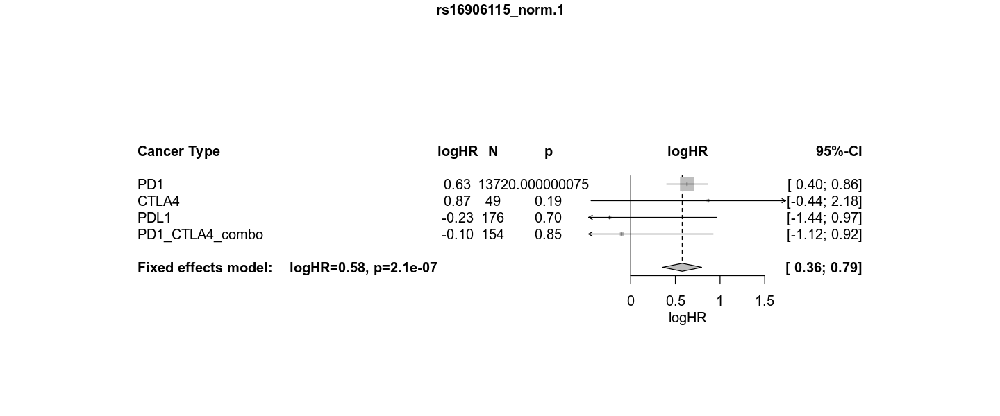

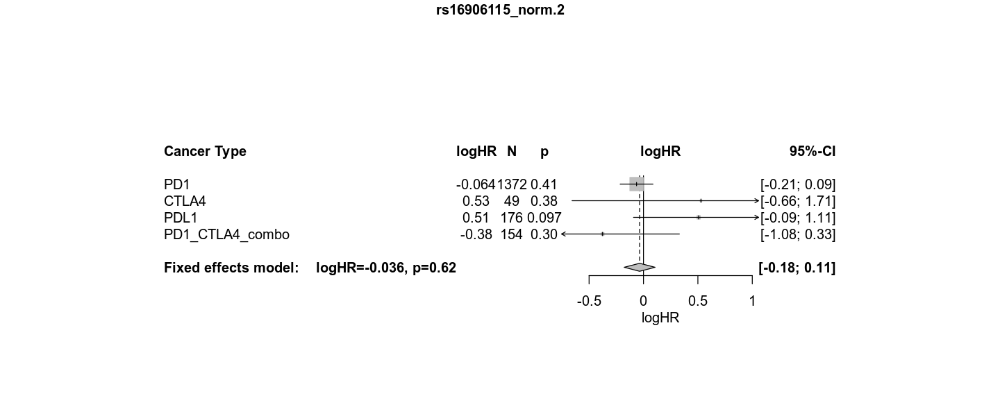

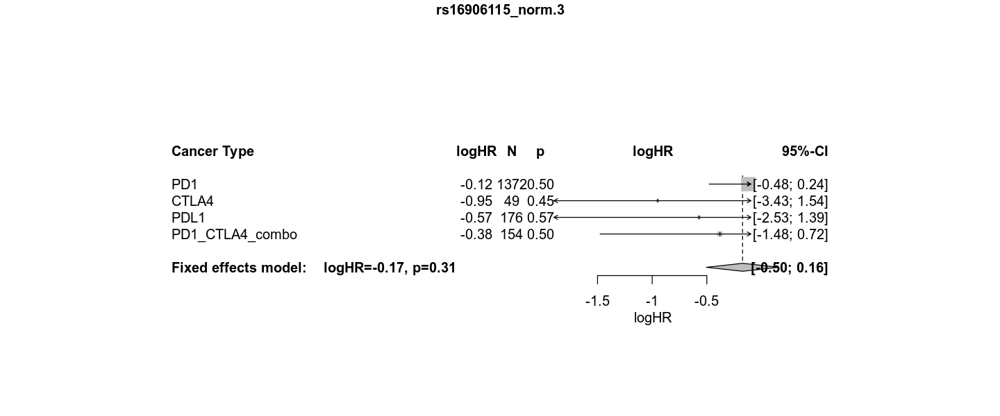

In [62]:
vie_treatment <- list(trans1=c("AGE_AT_TREATMENTSTART","GENDER"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_treatment <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")


tr <- meta_survival_AE_stratcancer("rs16906115_norm",cancer_variable = "TREATMENT_FINE",vars_in_all = via_treatment,vars_in_each = vie_treatment,OS_GWAS %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1),trans="1|2|3")



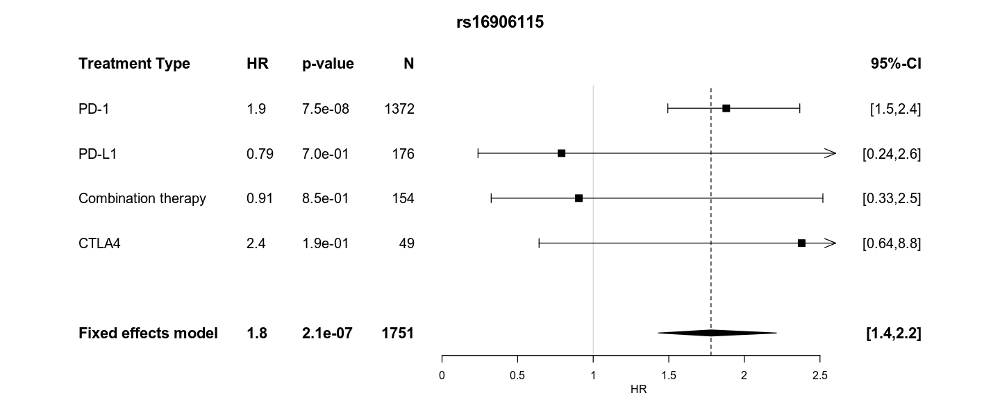

In [63]:
tr[[2]] <- tr[[2]] %>% filter(variables=="rs16906115_norm.1") %>% mutate(cancer=ifelse(cancer=="PD1","PD-1",ifelse(cancer=="PDL1","PD-L1",ifelse(cancer=="CTLA4","CTLA4","Combination therapy"))))
my_forest(tr,"rs16906115_norm.1","rs16906115",by="Treatment Type")

NULL
NULL
NULL


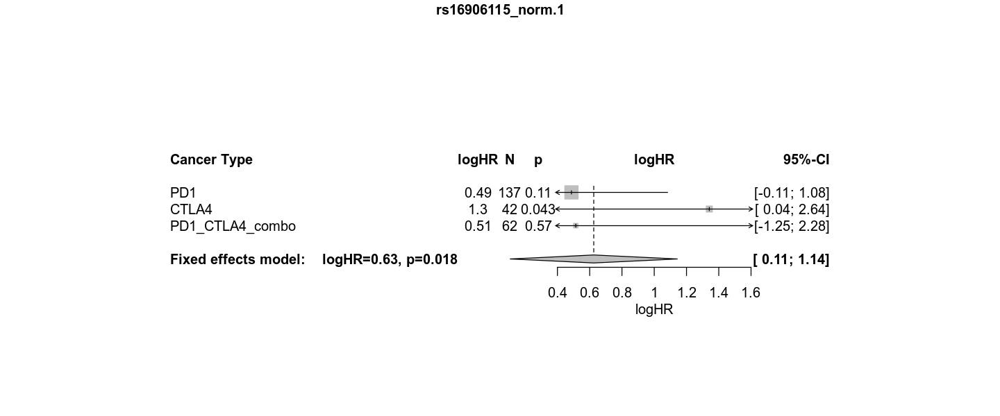

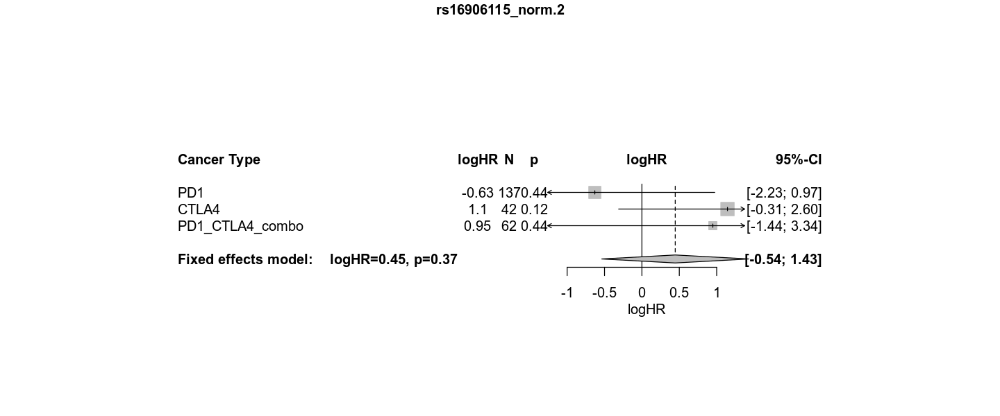

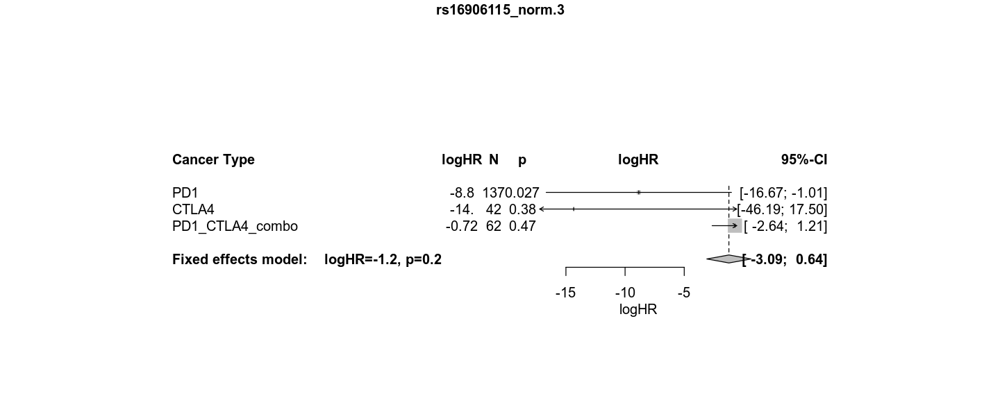

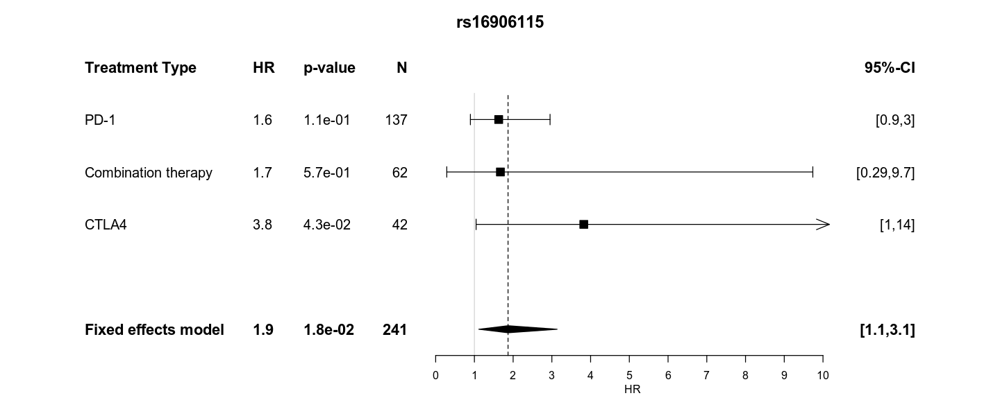

In [64]:
vie_treatment <- list(trans1=c("AGE_AT_TREATMENTSTART","GENDER"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_treatment <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")


tr <- meta_survival_AE_stratcancer("rs16906115_norm",cancer_variable = "TREATMENT_FINE",vars_in_all = via_treatment,vars_in_each = vie_treatment,OS_GWAS %>% mutate(rs16906115_norm.1=2-rs16906115_norm.1,rs16906115_norm.2=2-rs16906115_norm.2,rs16906115_norm.3=2-rs16906115_norm.3) %>% filter(before_2018==1,CANCER_TYPE=="Melanoma"),trans="1|2|3")

tr[[2]] <- tr[[2]] %>% filter(variables=="rs16906115_norm.1") %>% mutate(cancer=ifelse(cancer=="PD1","PD-1",ifelse(cancer=="PDL1","PD-L1",ifelse(cancer=="CTLA4","CTLA4","Combination therapy"))))
my_forest(tr,"rs16906115_norm.1","rs16906115",by="Treatment Type")

NULL
NULL
NULL


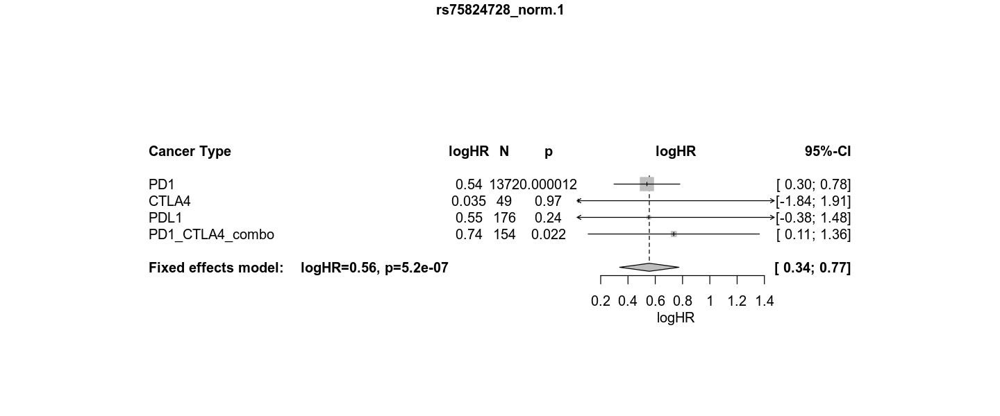

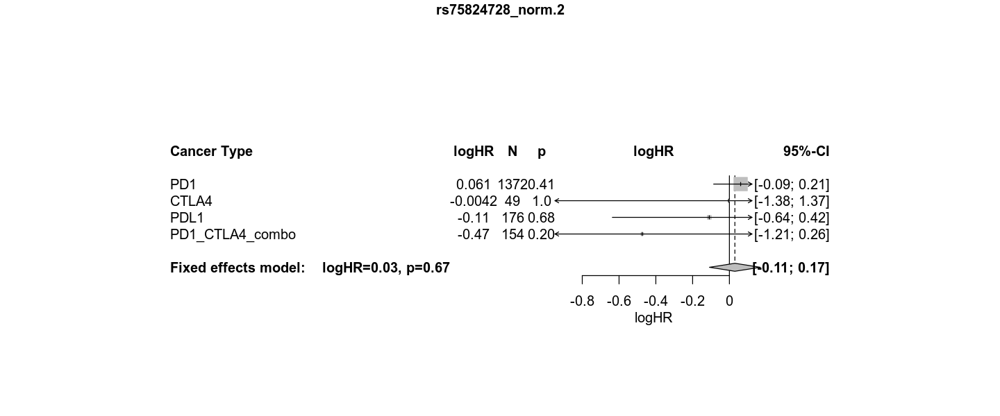

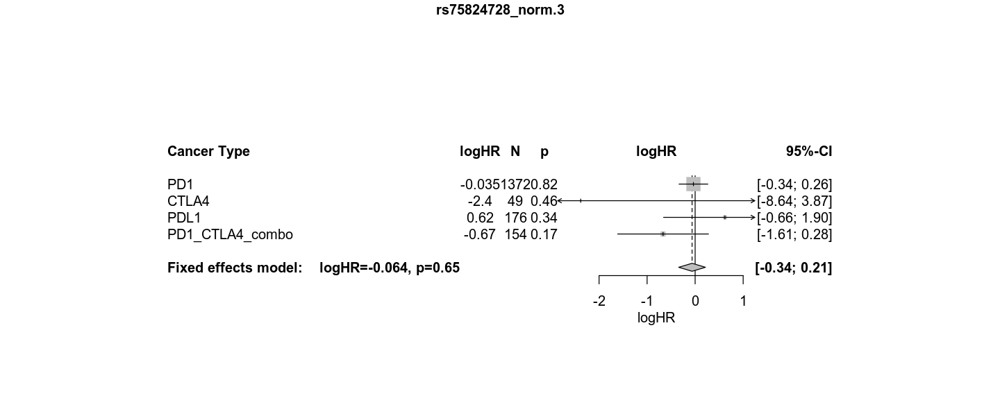

In [67]:
vie_treatment <- list(trans1=c("AGE_AT_TREATMENTSTART","GENDER"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_treatment <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")


tr <- meta_survival_AE_stratcancer("rs75824728_norm",cancer_variable = "TREATMENT_FINE",vars_in_all = via_treatment,vars_in_each = vie_treatment,OS_GWAS %>% mutate(rs75824728_norm.1=2-rs75824728_norm.1,rs75824728_norm.2=2-rs75824728_norm.2,rs75824728_norm.3=2-rs75824728_norm.3) %>% filter(before_2018==1),trans="1|2|3")

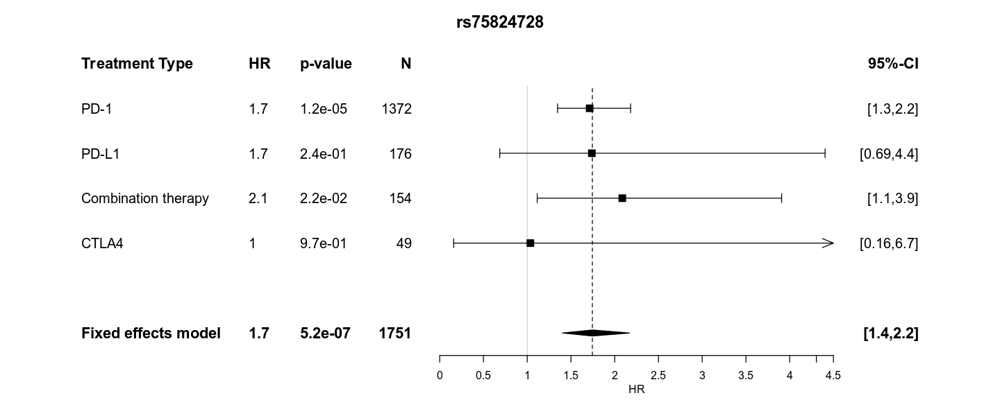

In [68]:
tr[[2]] <- tr[[2]] %>% filter(variables=="rs75824728_norm.1") %>% mutate(cancer=ifelse(cancer=="PD1","PD-1",ifelse(cancer=="PDL1","PD-L1",ifelse(cancer=="CTLA4","CTLA4","Combination therapy"))))
my_forest(tr,"rs75824728_norm.1","rs75824728",by="Treatment Type")

NULL
NULL
NULL


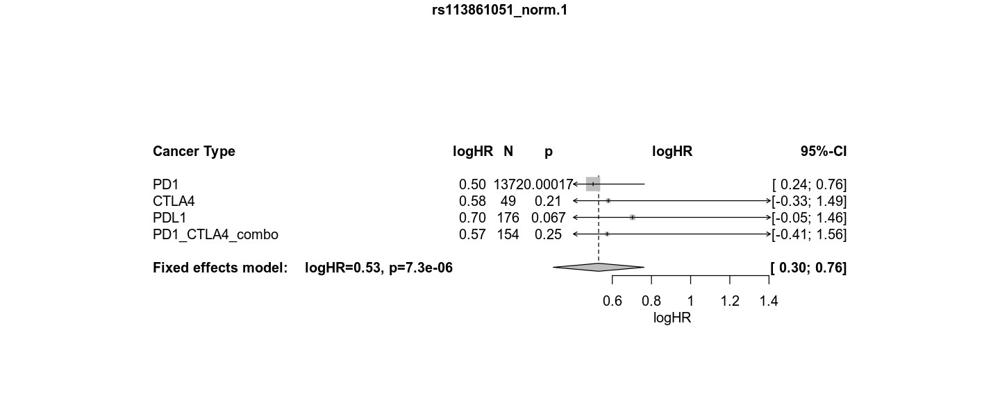

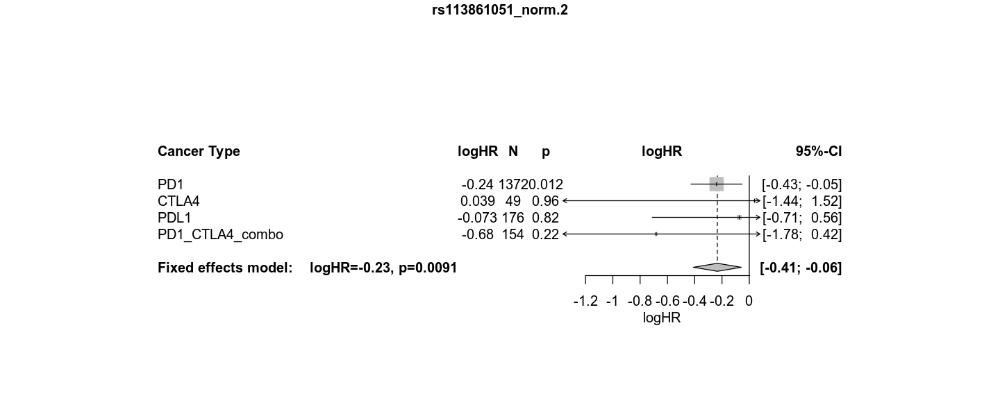

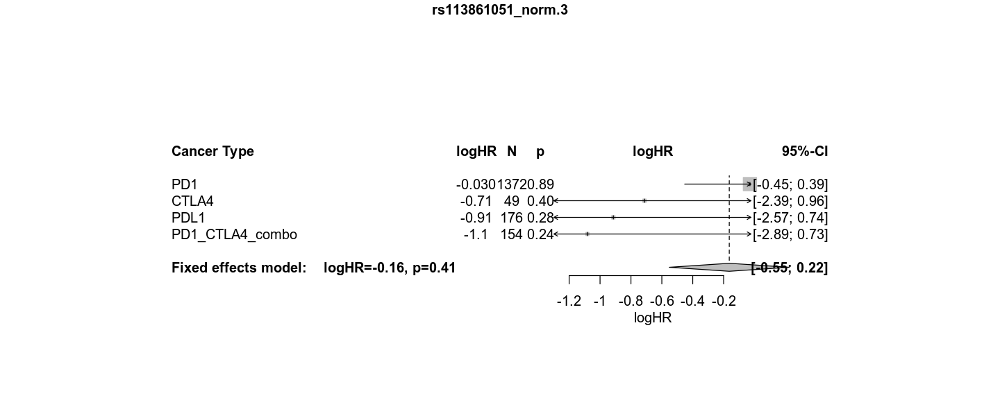

In [69]:
vie_treatment <- list(trans1=c("AGE_AT_TREATMENTSTART","GENDER"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_treatment <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")


tr <- meta_survival_AE_stratcancer("rs113861051_norm",cancer_variable = "TREATMENT_FINE",vars_in_all = via_treatment,vars_in_each = vie_treatment,OS_GWAS %>% mutate(rs113861051_norm.1=2-rs113861051_norm.1,rs113861051_norm.2=2-rs113861051_norm.2,rs113861051_norm.3=2-rs113861051_norm.3) %>% filter(before_2018==1),trans="1|2|3")

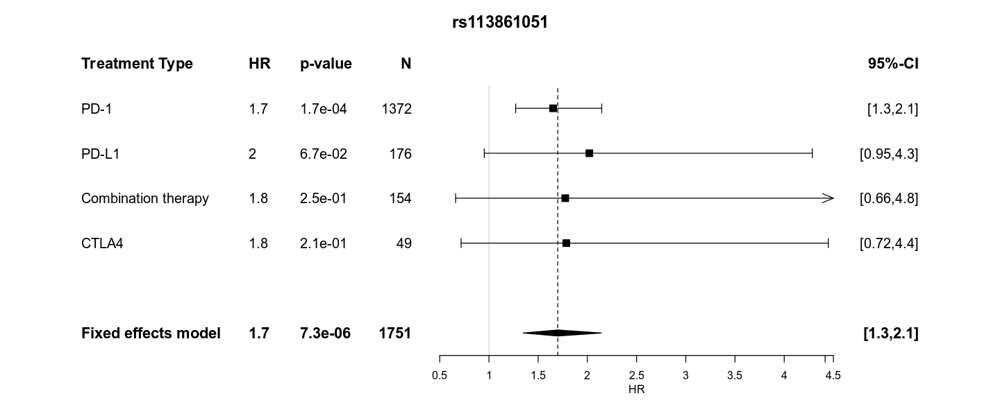

In [70]:
tr[[2]] <- tr[[2]] %>% filter(variables=="rs113861051_norm.1") %>% mutate(cancer=ifelse(cancer=="PD1","PD-1",ifelse(cancer=="PDL1","PD-L1",ifelse(cancer=="CTLA4","CTLA4","Combination therapy"))))
my_forest(tr,"rs113861051_norm.1","rs113861051",by="Treatment Type")

In [84]:
med_cum <- fread("../OS/MEDICATION_CUM.csv")
inner_join(OS_GWAS %>% filter(before_2018==1) %>% select(-MEDICATION_CUM), med_cum %>% select(MRN,MEDICATION_CUM)) %>% distinct(MRN,TREATMENT_FINE,MEDICATION_CUM) %>% group_by(TREATMENT_FINE,MEDICATION_CUM) %>% count


Joining, by = "MRN"


TREATMENT_FINE,MEDICATION_CUM,n
<fct>,<chr>,<int>
PD1,nivolumab,505
PD1,pembrolizumab,867
CTLA4,ipilimumab,46
CTLA4,tremelimumab,3
PD1_CTLA4_combo,durvalumab/tremelimumab,15
PD1_CTLA4_combo,ipilimumab/nivolumab,134
PD1_CTLA4_combo,ipilimumab/pembrolizumab,5
PDL1,atezolizumab,151
PDL1,durvalumab,25


In [75]:
OS_GWAS %>% filter(before_2018==1) %>% distinct(MRN,TREATMENT_FINE,MEDICATION_CUM) %>% group_by(TREATMENT_FINE,MEDICATION_CUM) %>% count

TREATMENT_FINE,MEDICATION_CUM,n
<fct>,<fct>,<int>
PD1,pembrolizumab,582
PD1,io_combination,39
PD1,nivolumab,393
PD1,other/io,358
CTLA4,io_combination,4
CTLA4,ipilimumab,42
CTLA4,other/io,3
PD1_CTLA4_combo,io_combination,146
PD1_CTLA4_combo,other/io,8


In [ ]:
fread("")

## Somatic association in IL7R

NULL
NULL
NULL


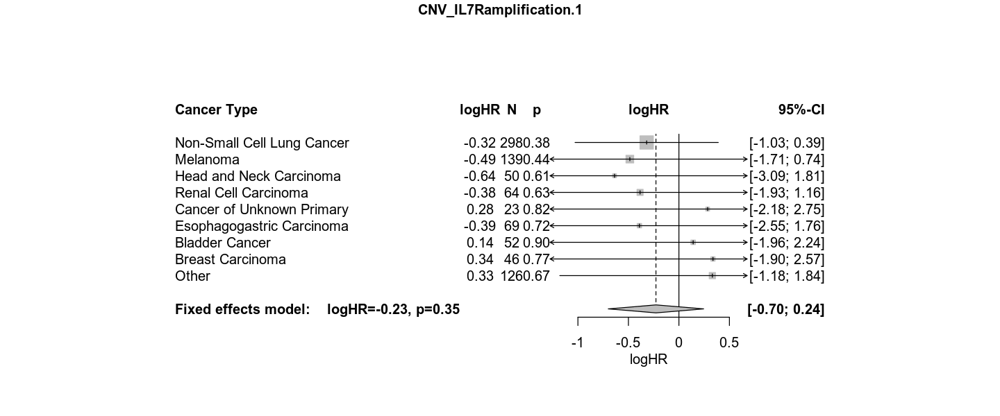

NULL


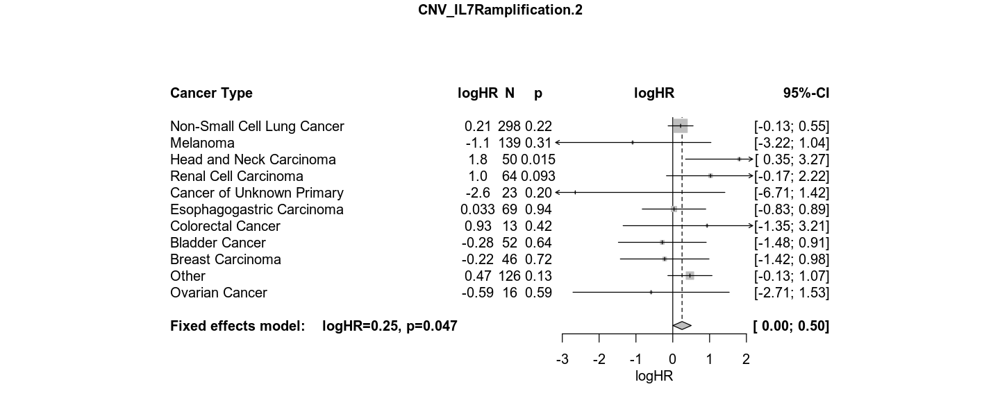

NULL


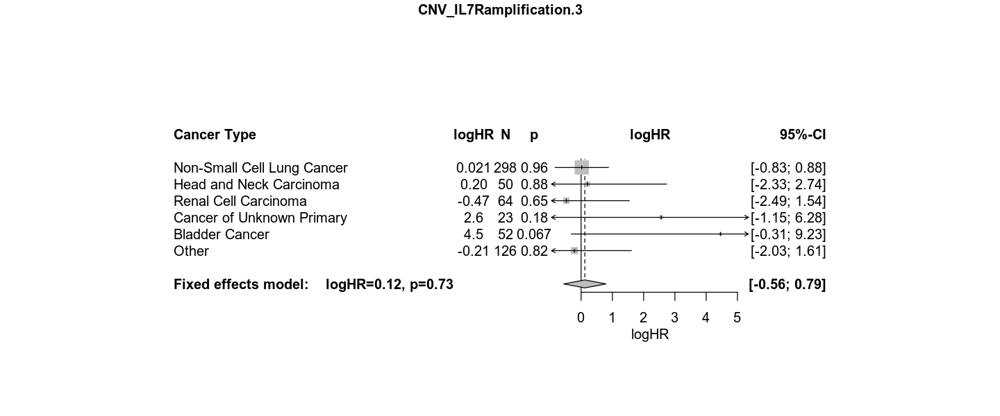

NULL


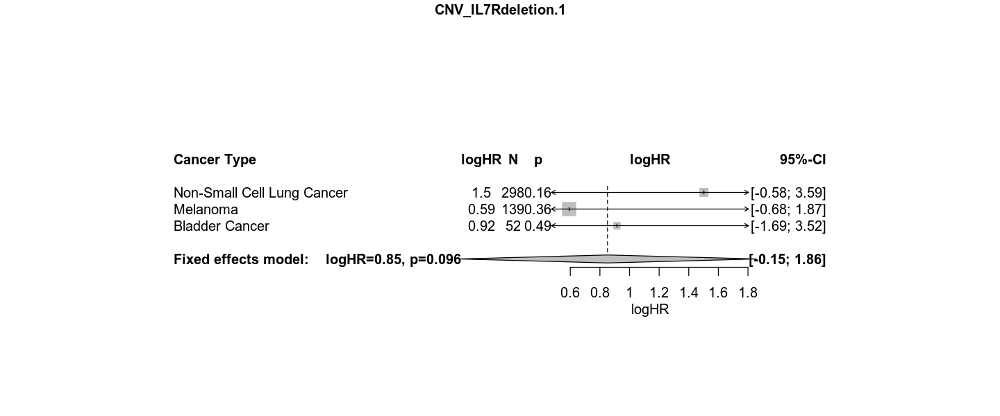

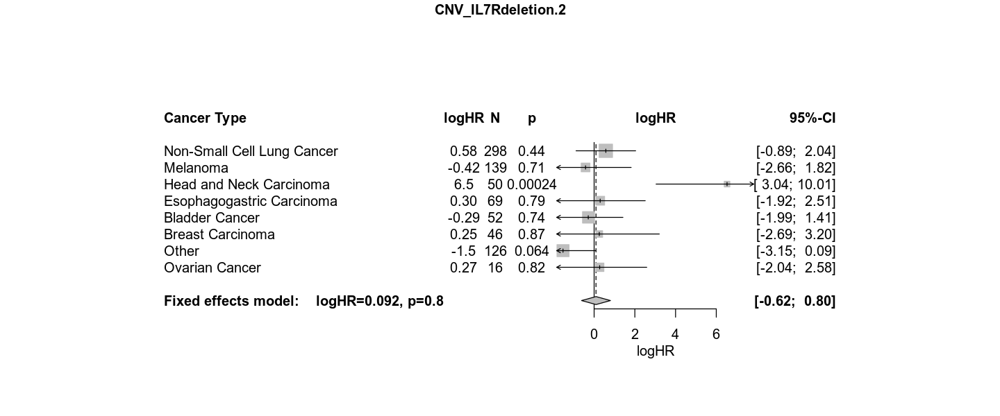

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Bladder Cancer was unsuccesful"
NULL
NULL


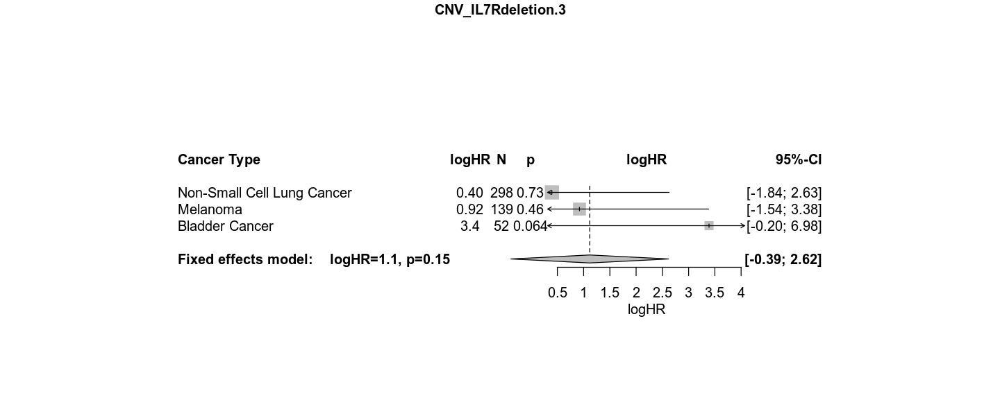

NULL


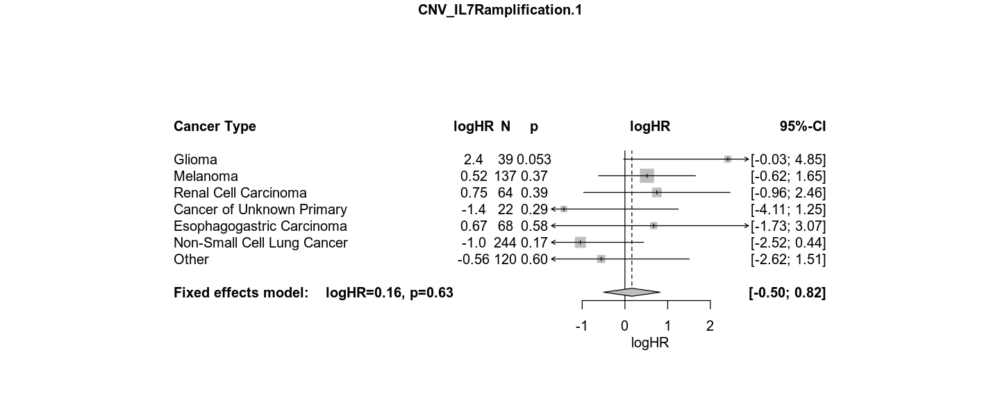

NULL


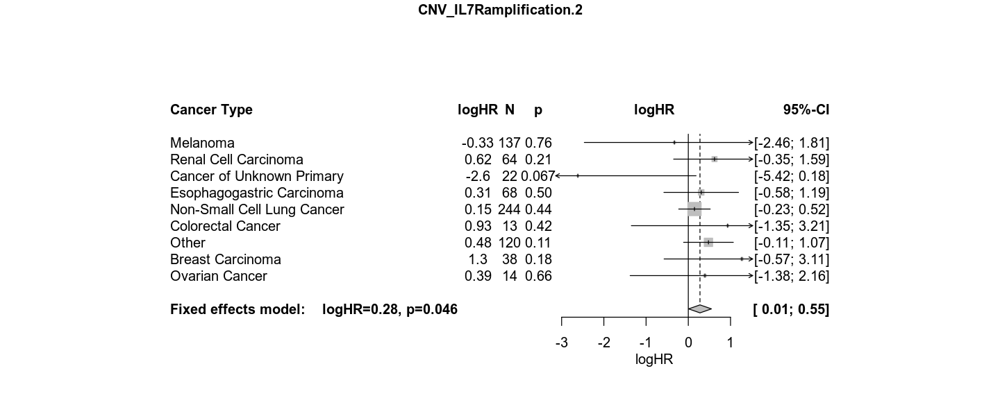

NULL


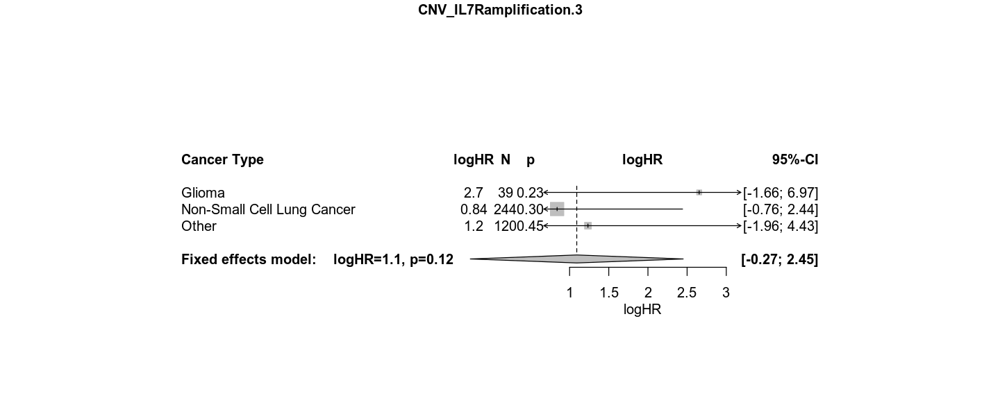

NULL


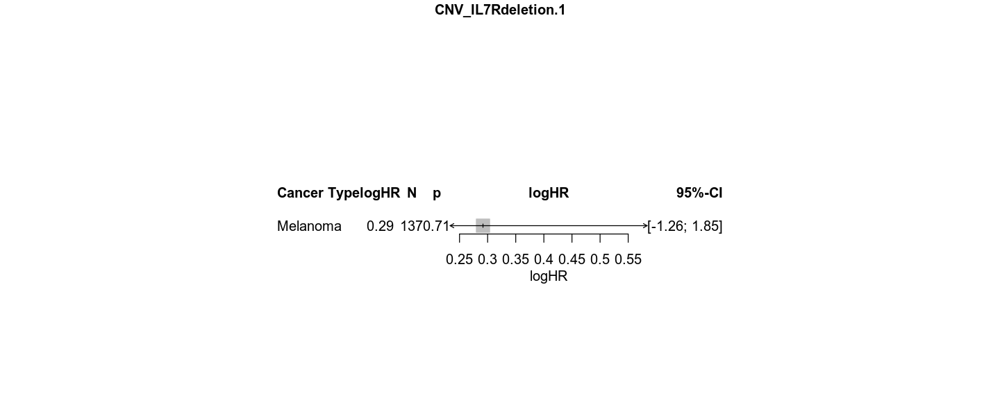

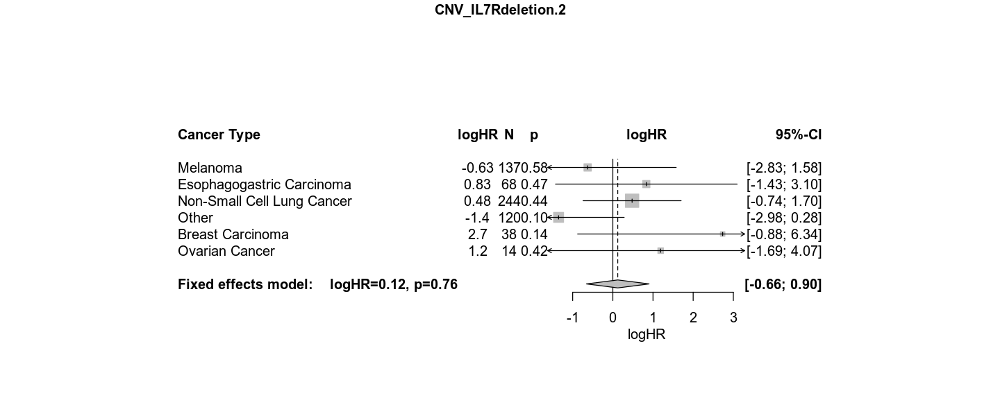

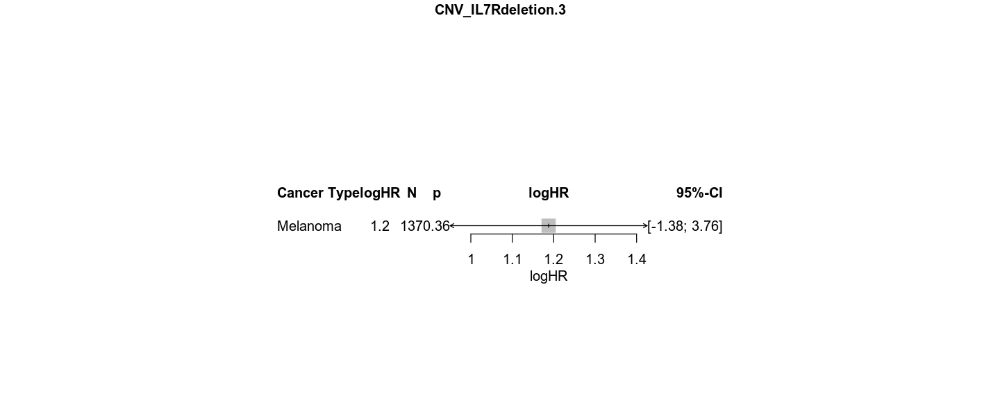

In [279]:
tr <- meta_survival_AE(c("CNV_IL7Ramplification","CNV_IL7Rdeletion"),OS_mult %>% filter(before_2018==1))
tr_cr <- meta_survival_AE(c("CNV_IL7Ramplification","CNV_IL7Rdeletion"),OS_mult_cur %>% filter(before_2018==1))

Warning message in if (is.na(xlim)) {:
“the condition has length > 1 and only the first element will be used”Warning message in if (is.na(xlim)) {:
“the condition has length > 1 and only the first element will be used”

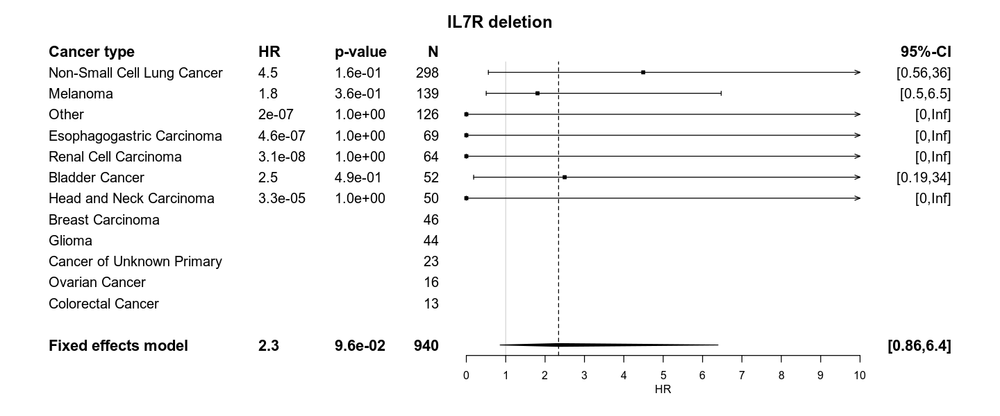

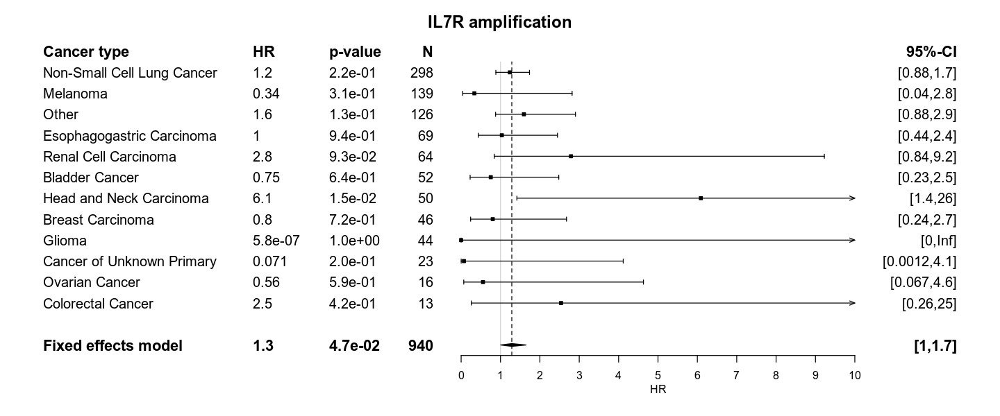

In [280]:
my_forest(tr,"CNV_IL7Rdeletion.1","IL7R deletion",xlim=c(0,10))
my_forest(tr,"CNV_IL7Ramplification.2","IL7R amplification",xlim=c(0,10))

### eQTL IL7R: rs6897932

In [26]:
temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_rs6897932 <- inner_join(inner_join(OS,temp_trans),GWAS %>% select(PBP,rs16906115_norm)) %>% select(-PBP)

Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"


In [36]:
new_snp <- inner_join(fread("/data/gusev/PROFILE/GWAS_Surv/IO_COHORT/DOSAGES/rs6897932.raw") %>% select(IID,`._C`) %>% rename(PBP=IID,rs6897932=`._C`),temp_trans) %>% select(MRN,rs6897932)
OS_GWAS_rs6897932 <- inner_join(OS_GWAS_rs6897932,new_snp)

Joining, by = "PBP"
Joining, by = "MRN"


In [37]:
OS_GWAS_rs6897932 <- make_multistate(OS_GWAS_rs6897932)

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  428  1353      602           2383
  AE                0    0   240      257            497
  Death             0    0     0     1593           1593

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1796055 0.5677717 0.2526227
  AE        0.0000000 0.0000000 0.4828974 0.5171026
  Death     0.0000000 0.0000000 0.0000000 1.0000000



[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
NULL
NULL
NULL


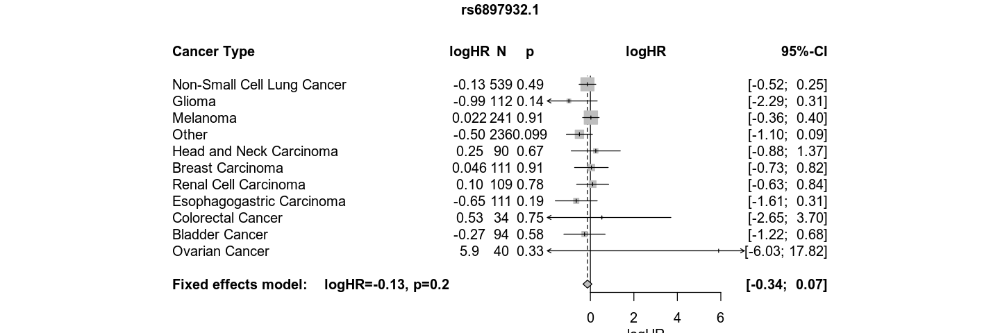

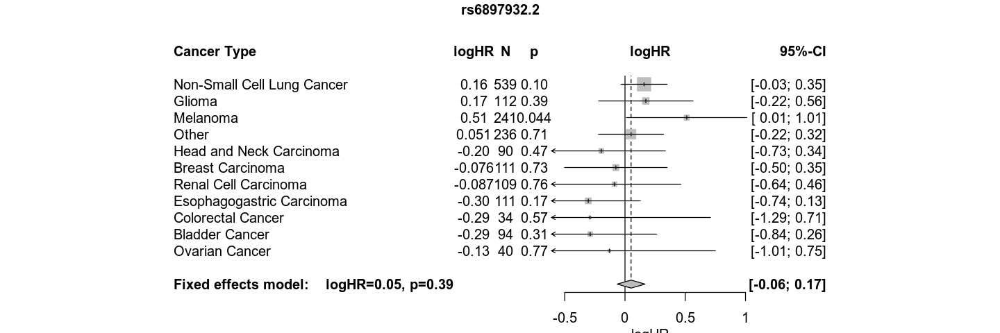

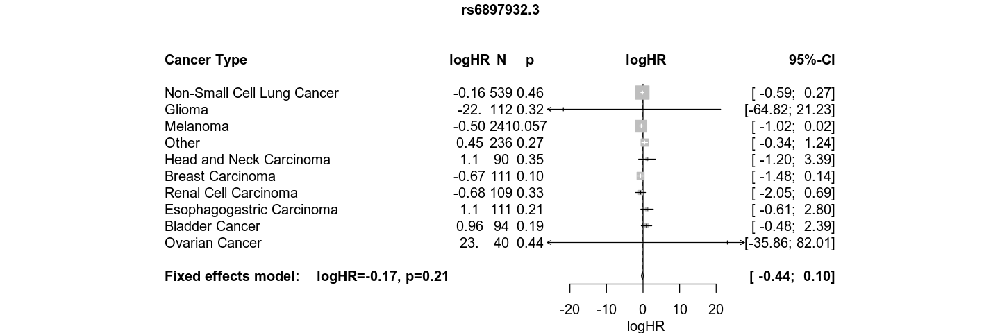

In [39]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_AE(c("rs6897932"),OS_GWAS_rs6897932 %>% filter(before_2018==1))
options(options_save)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Head and Neck Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Ovarian Cancer was unsuccesful"


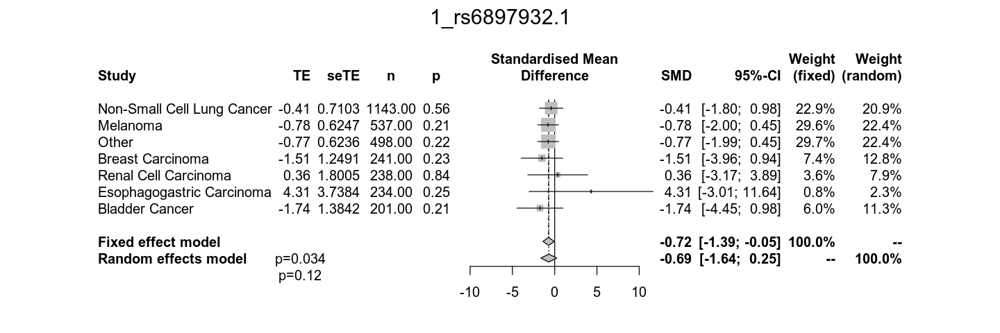

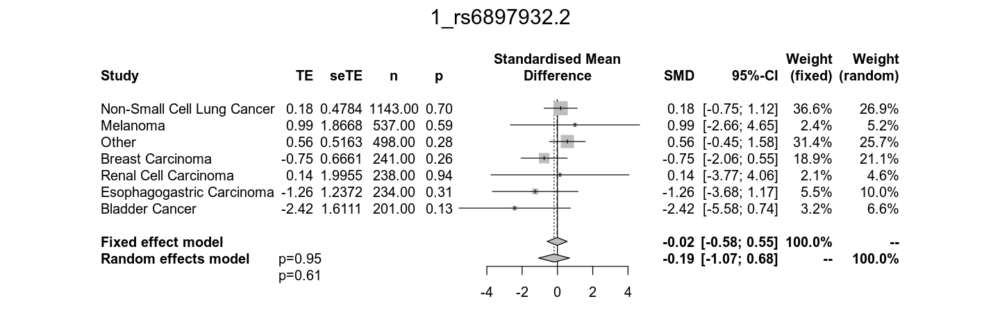

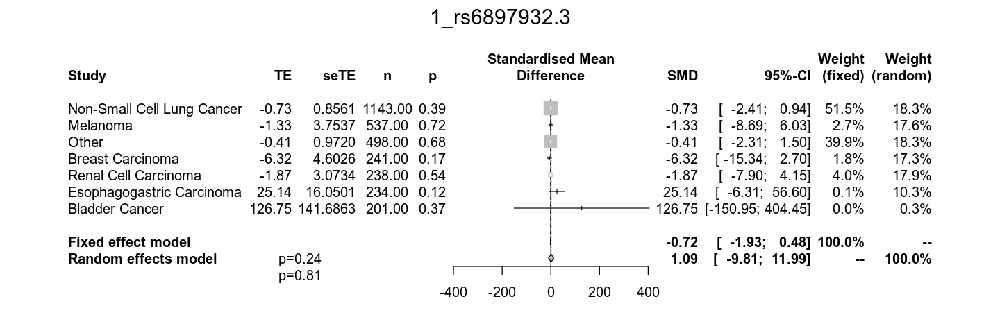

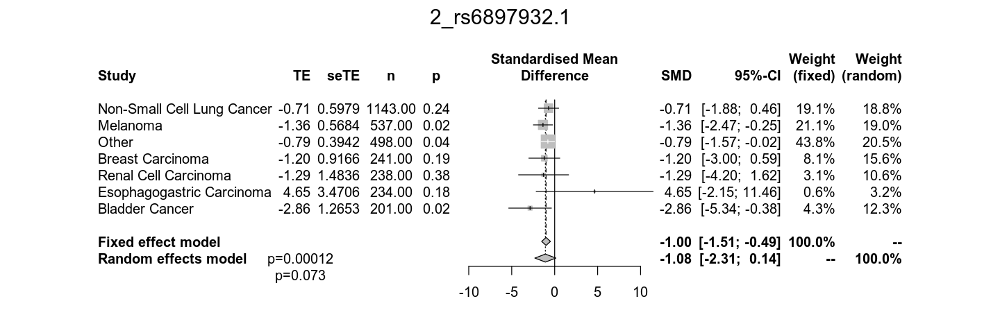

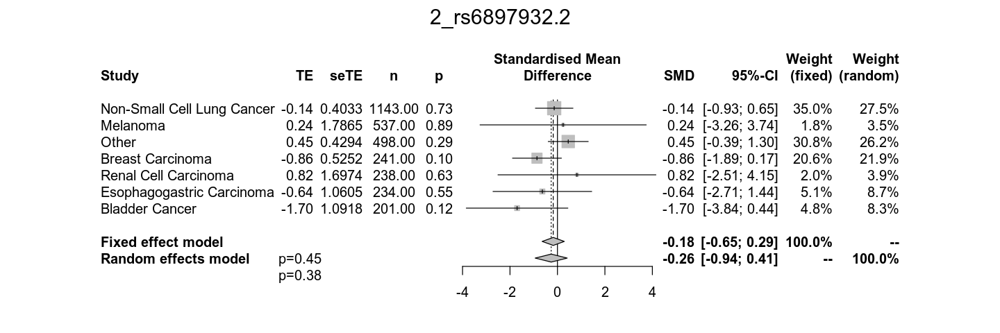

...

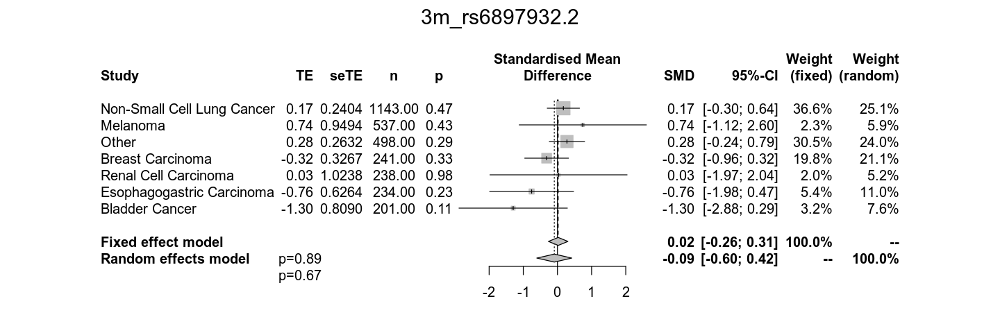

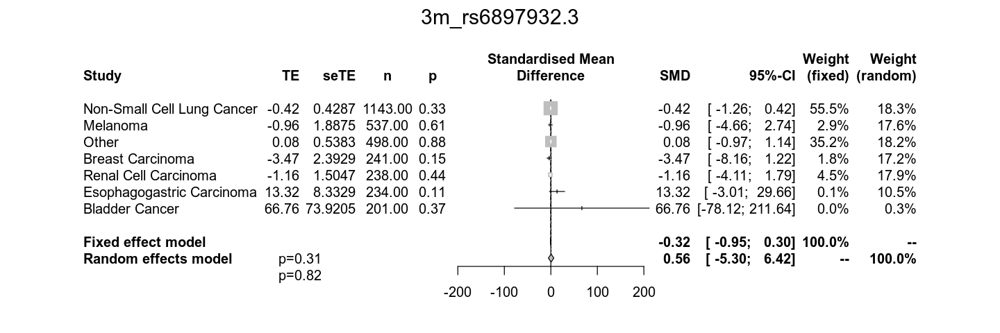

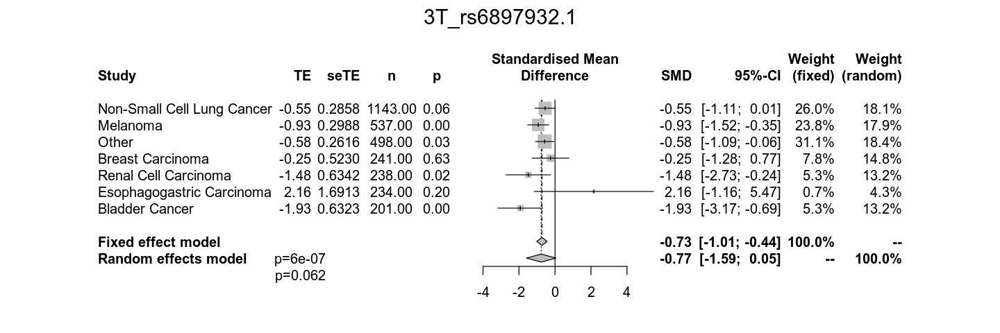

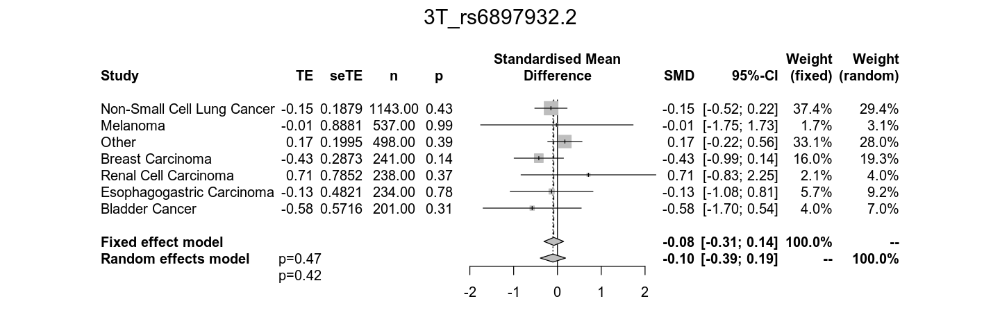

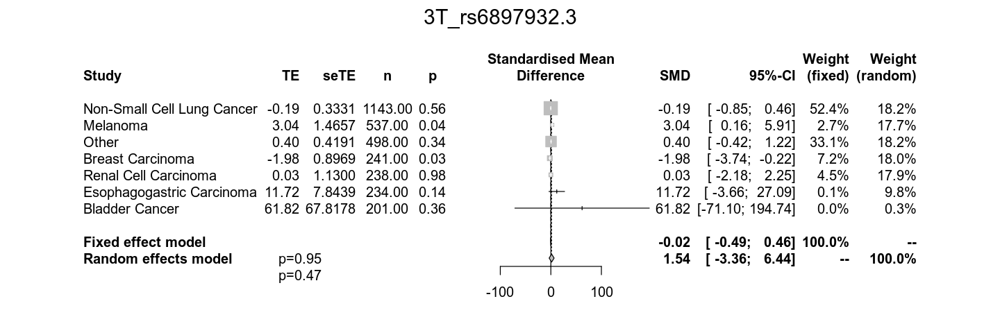

In [40]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("rs6897932","rs16906115_norm"),OS_GWAS_rs6897932 %>% filter(before_2018==1),interaction_var = "rs16906115_norm")
options(options_save)

# SNP characterization

## Type of irAE

### predicted

In [69]:
irae_type <- OS_GWAS  %>% filter(before_2018==1) %>% select(MRN,matches("^rs[0-9]*$"))
irae_type <- inner_join(irae_type,fread("adverse_events_truenegcorrected.csv"))
DIAGNOSIS_ALL <- fread("../../../OncDRS_data/ALL/EHR_DIAGNOSIS.csv",fill=T) %>% right_join(translate_pid,by="PATIENT_ID") %>% select(MRN,START_DT,DIAGNOSIS_DISPLAY_TXT,DIAGNOSIS_ICD10_LIST) %>% mutate(START_DT=as.Date(START_DT,format="%d-%b-%y"))
irae_type <- left_join(irae_type %>% filter(ADV_EVENT==T) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),DIAGNOSIS_ALL,by=c("MRN","ADV_EVENT_DT"="START_DT"))

Joining, by = "MRN"


In [70]:
irae_type <- irae_type %>% distinct %>% filter(!grepl("melanoma|immunotherapy|chemotherapy|therapy|drug level monitoring|neoplasm",tolower(DIAGNOSIS_DISPLAY_TXT)))

In [71]:
irae_type %>% group_by(DIAGNOSIS_DISPLAY_TXT) %>% count %>% arrange(desc(n))

DIAGNOSIS_DISPLAY_TXT,n
<chr>,<int>
COLITIS,31
"THYROTOXICOSIS, UNSPECIFIED WITHOUT THYROTOXIC CRISIS OR STORM",26
"PNEUMONIA, UNSPECIFIED ORGANISM",25
"NONINFECTIVE GASTROENTERITIS AND COLITIS, UNSPECIFIED",23
PNEUMONITIS,22
ADRENAL INSUFFICIENCY,15
GENERALIZED SKIN ERUPTION DUE TO DRUGS AND MEDICAMENTS TAKEN INTERNALLY,15
OTHER SPECIFIED DERMATITIS,15
"DERMATITIS, UNSPECIFIED",14


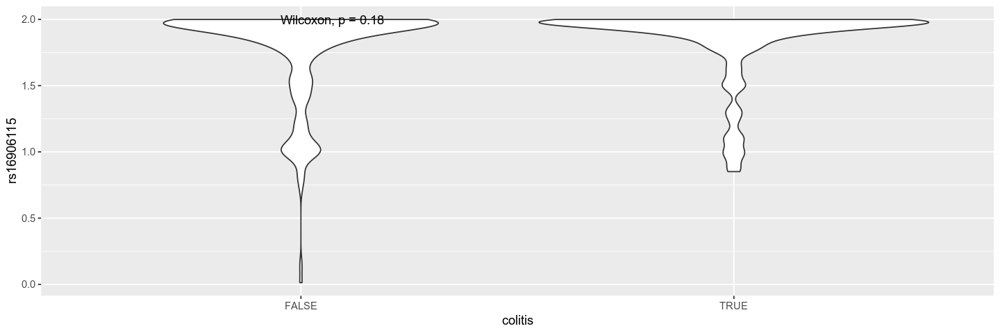

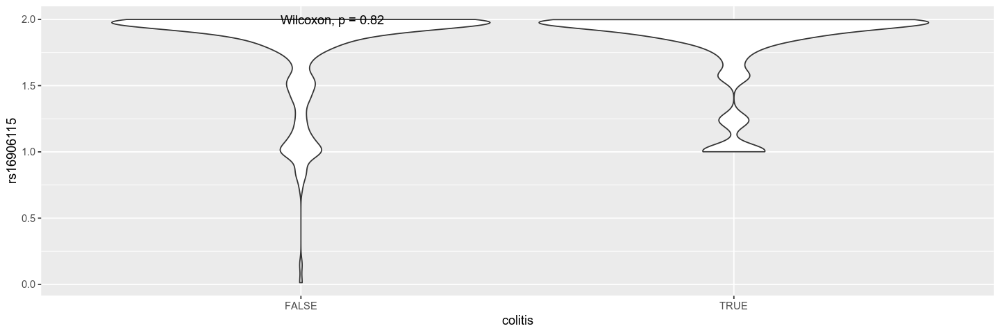

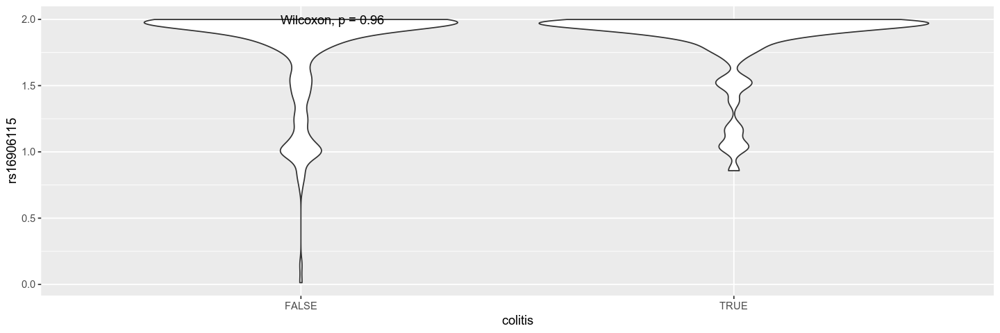

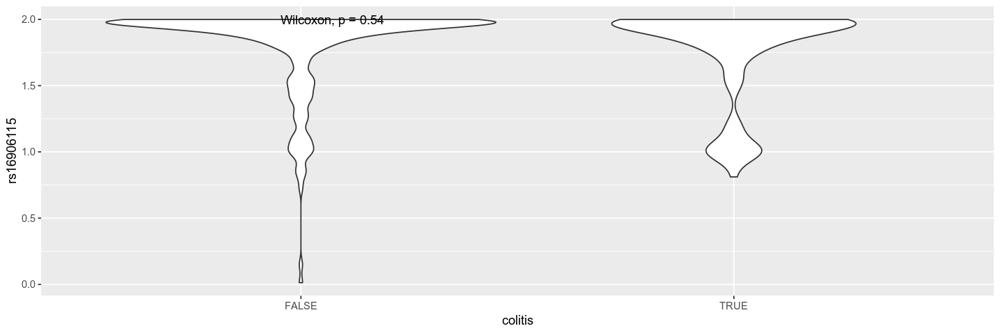

In [72]:
temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("colitis|colon|gastro",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))
temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("pneumo",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))
temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("derma|skin|rash|pruritus|itching|psoriasis",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))
temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("hypo|hyper|thyroid",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))

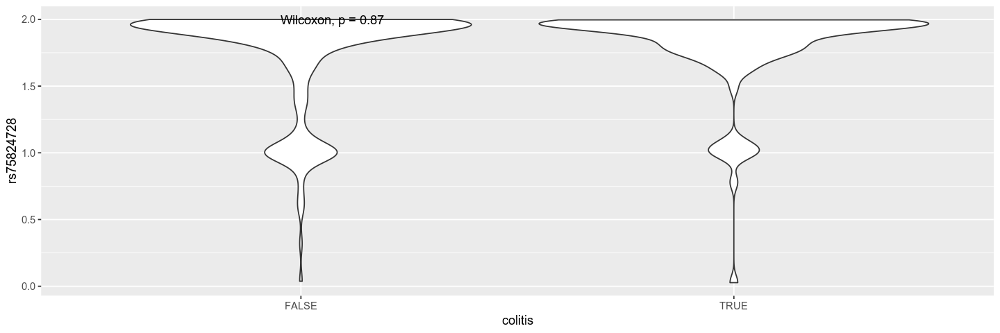

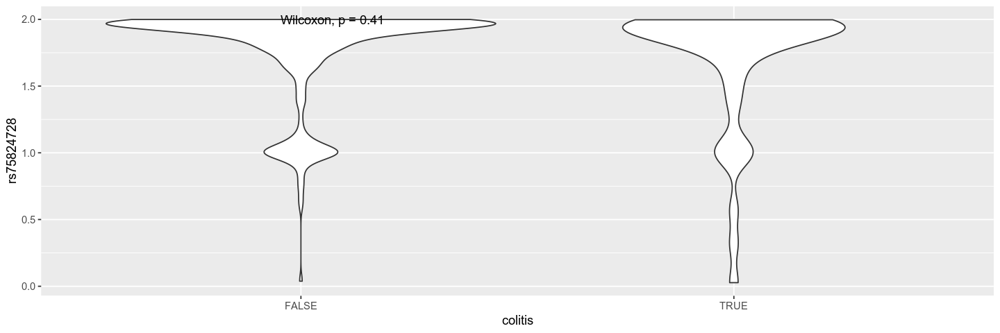

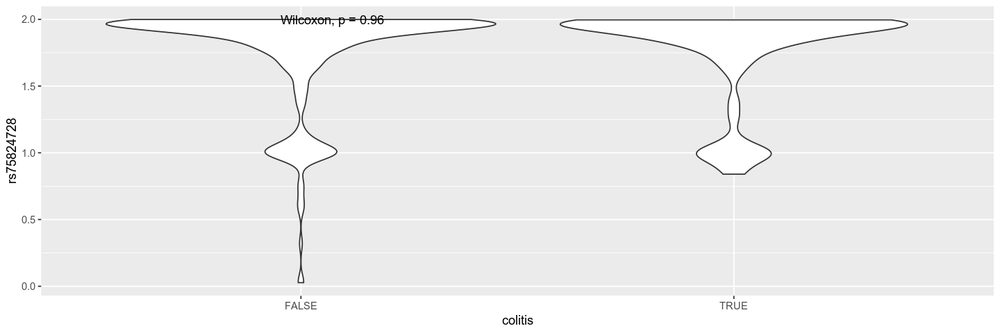

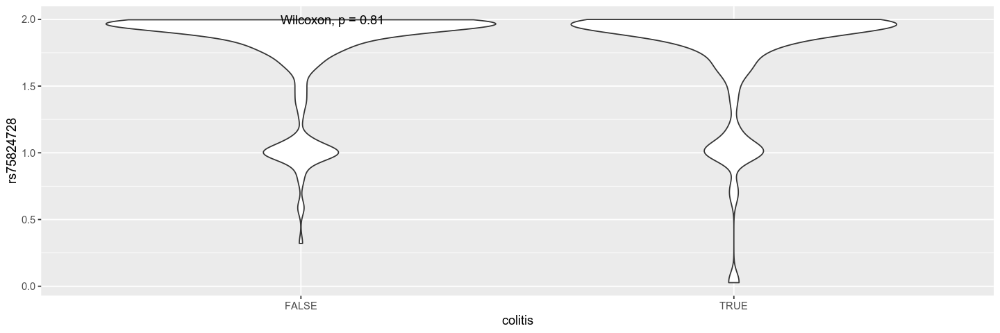

In [73]:
temp <- irae_type %>% group_by(MRN) %>% summarise(rs75824728=first(rs75824728),colitis=any(grepl("colitis|colon|gastro",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs75824728)) + stat_compare_means(aes(x=colitis,y=rs75824728))
temp <- irae_type %>% group_by(MRN) %>% summarise(rs75824728=first(rs75824728),colitis=any(grepl("pneumo",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs75824728)) + stat_compare_means(aes(x=colitis,y=rs75824728))
temp <- irae_type %>% group_by(MRN) %>% summarise(rs75824728=first(rs75824728),colitis=any(grepl("derma|skin|rash|pruritus|itching|psoriasis",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs75824728)) + stat_compare_means(aes(x=colitis,y=rs75824728))
temp <- irae_type %>% group_by(MRN) %>% summarise(rs75824728=first(rs75824728),colitis=any(grepl("hypo|hyper|thyroid",tolower(DIAGNOSIS_DISPLAY_TXT))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs75824728)) + stat_compare_means(aes(x=colitis,y=rs75824728))

In [74]:
temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("colitis|colon|gastro",tolower(DIAGNOSIS_DISPLAY_TXT))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("hypo|hyper|thyroid",tolower(DIAGNOSIS_DISPLAY_TXT))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("pneumo",tolower(DIAGNOSIS_DISPLAY_TXT))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

temp <- irae_type %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("derma|skin|rash|pruritus|itching|psoriasis",tolower(DIAGNOSIS_DISPLAY_TXT))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.3199  -0.8340  -0.6546   1.1851   2.1407  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)  
(Intercept)                            -2.53446    1.25504  -2.019   0.0434 *
rs16906115                              0.54032    0.41783   1.293   0.1960  
GENDERMALE                              0.01263    0.27584   0.046   0.9635  
AGE_AT_TREATMENTSTART                   0.01431    0.01106   1.294   0.1956  
TREATMENT_CUMCTLA4                      1.03036    0.58868   1.750   0.0801 .
TREATMENT_CUMPD1_CTLA4_combo            0.71086    0.36716   1.936   0.0529 .
CANCER_TYPEBreast Carcinoma            -0.44389    0.79554  -0.558   0.5769  
CANCER_TYPECancer of Unknown Primary   -1.60738    1.18148  -1.360  

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.4711  -0.9265  -0.6742   1.2532   2.3641  

Coefficients:
                                        Estimate Std. Error z value Pr(>|z|)  
(Intercept)                           -1.397e-01  1.143e+00  -0.122   0.9028  
rs16906115                            -1.788e-01  3.469e-01  -0.516   0.6062  
GENDERMALE                            -2.364e-01  2.632e-01  -0.898   0.3690  
AGE_AT_TREATMENTSTART                 -2.916e-06  1.070e-02   0.000   0.9998  
TREATMENT_CUMCTLA4                     6.592e-01  5.990e-01   1.101   0.2711  
TREATMENT_CUMPD1_CTLA4_combo           8.857e-02  3.846e-01   0.230   0.8179  
CANCER_TYPEBreast Carcinoma           -4.706e-01  7.425e-01  -0.634   0.5262  
CANCER_TYPECancer of Unknown Primary   1.283e-01  8.226e-01 

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.9338  -0.6375  -0.3873  -0.1211   2.5610  

Coefficients:
                                        Estimate Std. Error z value Pr(>|z|)  
(Intercept)                           -1.843e+01  1.477e+03  -0.012   0.9900  
rs16906115                             7.625e-02  5.623e-01   0.136   0.8921  
GENDERMALE                            -9.573e-02  3.764e-01  -0.254   0.7993  
AGE_AT_TREATMENTSTART                 -4.160e-04  1.522e-02  -0.027   0.9782  
TREATMENT_CUMCTLA4                     2.370e-01  8.906e-01   0.266   0.7902  
TREATMENT_CUMPD1_CTLA4_combo          -1.213e+00  6.808e-01  -1.781   0.0749 .
CANCER_TYPEBreast Carcinoma            1.741e+01  1.477e+03   0.012   0.9906  
CANCER_TYPECancer of Unknown Primary  -4.962e-02  2.523e+03 

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.2153  -0.7114  -0.5502  -0.3618   2.2486  

Coefficients:
                                       Estimate Std. Error z value Pr(>|z|)   
(Intercept)                            -4.01589    1.51559  -2.650  0.00806 **
rs16906115                              0.64231    0.48014   1.338  0.18098   
GENDERMALE                             -0.15195    0.30588  -0.497  0.61936   
AGE_AT_TREATMENTSTART                   0.03182    0.01394   2.282  0.02248 * 
TREATMENT_CUMCTLA4                      0.17377    0.76276   0.228  0.81978   
TREATMENT_CUMPD1_CTLA4_combo            0.56132    0.40039   1.402  0.16093   
CANCER_TYPEBreast Carcinoma            -0.38066    1.00190  -0.380  0.70399   
CANCER_TYPECancer of Unknown Primary   -0.70026    1.22703  

### curated

Joining, by = "MRN"


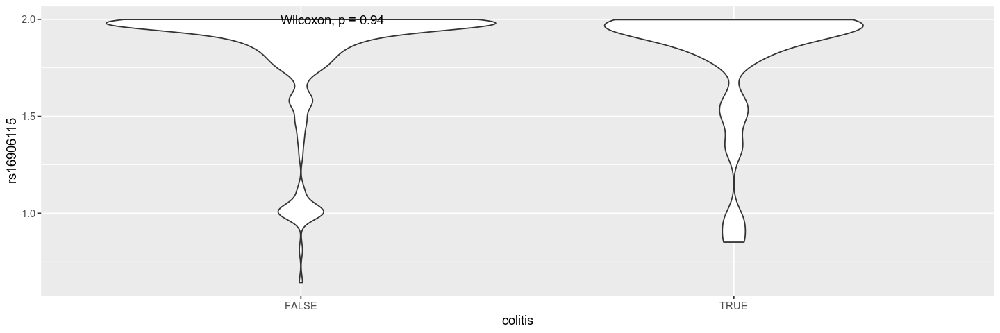

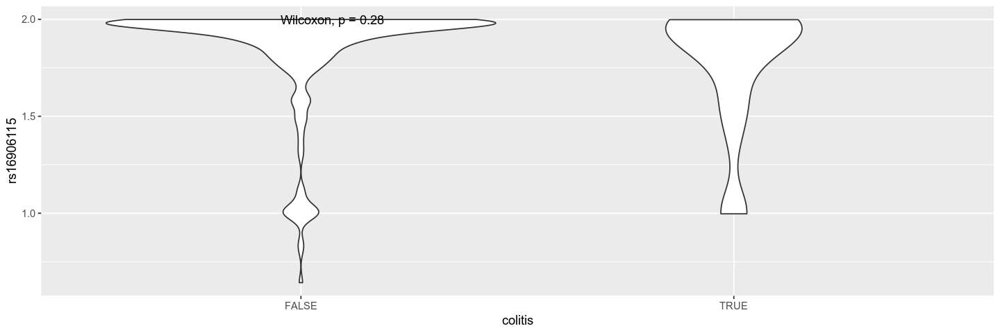

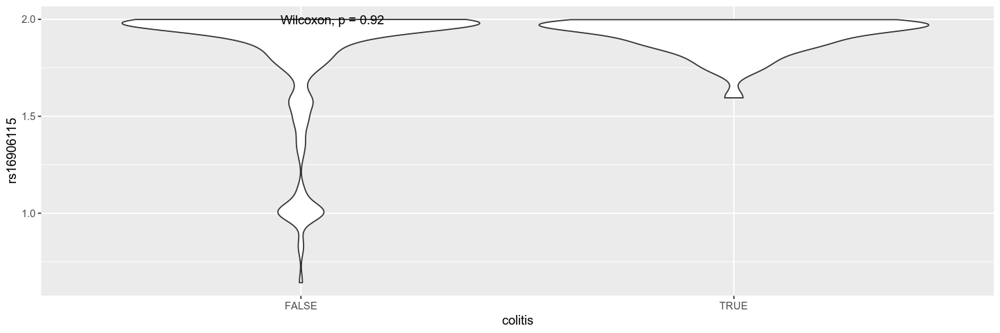

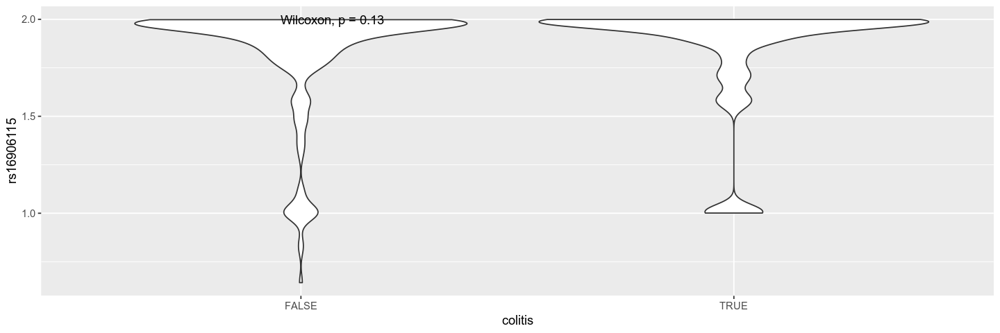

In [123]:
irae_type_cur <- inner_join(OS_GWAS,fread("curated_types.csv"))

temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("colitis|colon|gastro",tolower(Type.of.irAE))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))
temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("pneumo",tolower(Type.of.irAE))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))
temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("derma|skin|rash|pruritus|itching|psoriasis",tolower(Type.of.irAE))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))
temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("hypo|hyper|thyroid",tolower(Type.of.irAE))))
ggplot(temp) + geom_violin(aes(x=colitis,y=rs16906115)) + stat_compare_means(aes(x=colitis,y=rs16906115))

In [124]:
temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("colitis|colon|gastro",tolower(Type.of.irAE))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("hypo|hyper|thyroid",tolower(Type.of.irAE))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("pneumo",tolower(Type.of.irAE))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

temp <- irae_type_cur %>% group_by(MRN) %>% summarise(rs16906115=first(rs16906115),colitis=any(grepl("derma|skin|rash|pruritus|itching|psoriasis",tolower(Type.of.irAE))))
temp <- inner_join(OS,temp)
summary(glm(colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR,temp,family="binomial"))

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-0.8847  -0.4871  -0.4093  -0.3317   2.4167  

Coefficients:
                                        Estimate Std. Error z value Pr(>|z|)
(Intercept)                           -3.081e-01  2.082e+00  -0.148    0.882
rs16906115                            -1.649e-01  7.424e-01  -0.222    0.824
GENDERMALE                            -3.373e-01  4.587e-01  -0.735    0.462
AGE_AT_TREATMENTSTART                 -7.541e-03  2.022e-02  -0.373    0.709
TREATMENT_CUMPD1_CTLA4_combo           7.387e-01  6.576e-01   1.123    0.261
CANCER_TYPEBreast Carcinoma           -1.742e+01  6.523e+03  -0.003    0.998
CANCER_TYPECancer of Unknown Primary  -1.702e+01  2.641e+03  -0.006    0.995
CANCER_TYPEColorectal Cancer          -1.702e+01  6.523e+03  -0.003    0.998

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.0478  -0.5725  -0.4543  -0.3500   2.3565  

Coefficients:
                                        Estimate Std. Error z value Pr(>|z|)  
(Intercept)                           -8.783e-01  1.906e+00  -0.461   0.6449  
rs16906115                             3.180e-01  7.063e-01   0.450   0.6526  
GENDERMALE                            -6.996e-02  4.020e-01  -0.174   0.8618  
AGE_AT_TREATMENTSTART                 -7.381e-03  1.761e-02  -0.419   0.6751  
TREATMENT_CUMPD1_CTLA4_combo           4.400e-01  6.389e-01   0.689   0.4910  
CANCER_TYPEBreast Carcinoma           -1.559e+01  2.400e+03  -0.006   0.9948  
CANCER_TYPECancer of Unknown Primary  -6.260e-01  1.228e+00  -0.510   0.6102  
CANCER_TYPEColorectal Cancer          -1.515e+01  2.400e+03 

Joining, by = "MRN"
Warning message:
“glm.fit: fitted probabilities numerically 0 or 1 occurred”


Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
     Min        1Q    Median        3Q       Max  
-1.09491  -0.56980  -0.40077  -0.00009   2.35763  

Coefficients:
                                        Estimate Std. Error z value Pr(>|z|)  
(Intercept)                           -1.988e+01  2.034e+03  -0.010   0.9922  
rs16906115                            -1.129e+00  6.273e-01  -1.799   0.0720 .
GENDERMALE                             7.725e-01  4.301e-01   1.796   0.0725 .
AGE_AT_TREATMENTSTART                  1.887e-02  2.036e-02   0.927   0.3539  
TREATMENT_CUMPD1_CTLA4_combo          -1.756e+01  2.268e+03  -0.008   0.9938  
CANCER_TYPEBreast Carcinoma            9.272e-01  1.094e+04   0.000   0.9999  
CANCER_TYPECancer of Unknown Primary   1.754e+01  2.034e+03   0.009   0.9931  
CANCER_TYPEColorectal Cancer           3.881e+01  

Joining, by = "MRN"



Call:
glm(formula = colitis ~ rs16906115 + GENDER + AGE_AT_TREATMENTSTART + 
    TREATMENT_CUM + CANCER_TYPE + PANEL_VERSION + START_YEAR, 
    family = "binomial", data = temp)

Deviance Residuals: 
    Min       1Q   Median       3Q      Max  
-1.1756  -0.6540  -0.4960  -0.1497   2.3995  

Coefficients:
                                        Estimate Std. Error z value Pr(>|z|)   
(Intercept)                             -7.48449    2.70757  -2.764   0.0057 **
rs16906115                               2.46906    1.18525   2.083   0.0372 * 
GENDERMALE                               0.12136    0.37956   0.320   0.7492   
AGE_AT_TREATMENTSTART                    0.01961    0.01811   1.083   0.2790   
TREATMENT_CUMPD1_CTLA4_combo            -0.66266    0.82218  -0.806   0.4202   
CANCER_TYPEBreast Carcinoma            -16.90376 3956.18039  -0.004   0.9966   
CANCER_TYPECancer of Unknown Primary   -15.64102 1518.89297  -0.010   0.9918   
CANCER_TYPEColorectal Cancer           -16.91230 395

## Association of SNP

### in cohort

In [50]:
OS_assoc <- inner_join(inner_join(OS,temp_trans),GWAS) %>% filter(before_2018==1)

Joining, by = "MRN"
Joining, by = "PBP"


In [51]:
df_assoc <- data.frame()
for (n in names(OS_assoc)[grepl("CANONICAL_GENE",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + TREATMENT_CUM + TUMOR_PURITY + PROFILE_AFTER_TREATMENT",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[n,])))
    })
}
for (n in names(OS_assoc)[grepl("HLA",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + TREATMENT_CUM + TUMOR_PURITY + PROFILE_AFTER_TREATMENT",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[n,])))
    })
}
for (n in names(OS_assoc)[grepl("CNV_",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + TREATMENT_CUM + TUMOR_PURITY + PROFILE_AFTER_TREATMENT",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[2,])))
    })
}
for (n in names(OS_assoc)[grepl("LAB_",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + TREATMENT_CUM + TUMOR_PURITY + PROFILE_AFTER_TREATMENT",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[2,])))
    })
}
for (n in names(OS_assoc)[grepl("DIAG_",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + TREATMENT_CUM + TUMOR_PURITY + PROFILE_AFTER_TREATMENT",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[2,])))
    })
}

df_assoc <- df_assoc %>% rename(beta=Estimate,sd=Std..Error,p=Pr...t..) %>% select(name,beta,sd,p)

Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn

Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn

In [52]:
df_assoc %>% mutate(p.adj = p.adjust(p)) %>% arrange(p)

name,beta,sd,p,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
CANONICAL_GENE_MSH2,-3.233246e-01,9.442570e-02,0.0006311123,0.6424723
DIAG_Z51.12,-1.803384e-01,5.598568e-02,0.0013003424,1.0000000
LAB_UWBC,-1.551594e-03,4.853832e-04,0.0016209832,1.0000000
DIAG_C18.9,-2.521998e-01,8.022443e-02,0.0016965454,1.0000000
LAB_CRE,-5.354981e-02,1.739571e-02,0.0021181269,1.0000000
CNV_GATA6,-9.164004e-02,3.052955e-02,0.0027231518,1.0000000
CNV_ERBB2,-7.196154e-02,2.456960e-02,0.0034460792,1.0000000
DIAG_C16.9,-1.737056e-01,5.976006e-02,0.0036986510,1.0000000
HLA_A_2301_homo,-2.363308e+01,8.299301e+00,0.0044567648,1.0000000


### in full cohort

In [55]:
topsnp_fullcohort <- fread("topsnp_fullcohort.raw") %>% rename(rs7011565=`8:79557237_C`,rs16906115=`8:79712998_G`,PBP=FID) %>% select(PBP,rs7011565,rs16906115) %>% inner_join(translate_sid) %>% inner_join(translate_pid,by="PATIENT_ID") %>% select(MRN,BLNUM,rs7011565,rs16906115)
PROFILE_DATE <- fread("../../../OncDRS_data/ALL/GENOMIC_SPECIMEN.csv",fill=T) %>% rename(BLNUM=SAMPLE_ACCESSION_NBR) %>% right_join(translate_pid,by="PATIENT_ID") %>% select(MRN,BLNUM,TEST_ORDER_DT) %>% mutate(TEST_ORDER_DT=as.Date(TEST_ORDER_DT,format="%d-%b-%y"))
topsnp_fullcohort <- inner_join(topsnp_fullcohort,PROFILE_DATE) %>% arrange(MRN,TEST_ORDER_DT) %>% group_by(MRN) %>% summarise(rs7011565=first(rs7011565),rs16906115=first(rs16906115))

OS_ALL <- fread("../OS/OS_ALL_2021.csv")
OS_assoc <- inner_join(OS_ALL,topsnp_fullcohort)

Joining, by = "PBP"
Joining, by = c("MRN", "BLNUM")
Joining, by = "MRN"


In [57]:
df_assoc <- data.frame()
for (n in names(OS_assoc)[grepl("CANONICAL_GENE",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + PROFILE_AFTER_TREATMENT + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[n,])))
    })
}
for (n in names(OS_assoc)[grepl("HLA",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + PROFILE_AFTER_TREATMENT + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[n,])))
    })
}
for (n in names(OS_assoc)[grepl("CNV_",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + PROFILE_AFTER_TREATMENT + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[2,])))
    })
}
for (n in names(OS_assoc)[grepl("LAB_",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + PROFILE_AFTER_TREATMENT + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[2,])))
    })
}
for (n in names(OS_assoc)[grepl("DIAG_",names(OS_assoc))]) {
    try({
        result <- lm(paste("rs16906115 ~ ",n," + PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + PROFILE_AFTER_TREATMENT + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2",sep=""),OS_assoc)
        temp <- summary(result)
        df_assoc <- rbind(df_assoc,data.frame(name=n,t(temp$coefficients[2,])))
    })
}

df_assoc <- df_assoc %>% rename(beta=Estimate,sd=Std..Error,p=Pr...t..) %>% select(name,beta,sd,p)

Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn]]) : 
  contrasts can be applied only to factors with 2 or more levels
Error in `contrasts<-`(`*tmp*`, value = contr.funs[1 + isOF[nn

In [58]:
df_assoc %>% mutate(p.adj = p.adjust(p)) %>% arrange(p)

name,beta,sd,p,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
DIAG_C67.9,-0.070964247,0.020406866,0.0005070636,0.7458905
CNV_CD79B,0.025211339,0.007333343,0.0005872233,0.8632182
HLA_DPB1_0201_homo,0.071730157,0.020925454,0.0006093085,0.8950741
LAB_NRBCP_NORMAL,0.127658740,0.037379835,0.0006384569,0.9372547
HLA_DPB1_02_homo,0.063744091,0.019079566,0.0008361575,1.0000000
CNV_PRKAR1A,0.021100928,0.006935988,0.0023507865,1.0000000
CANONICAL_GENE_MECOM,-0.082509950,0.028060450,0.0032806226,1.0000000
CNV_CDH1,-0.030894839,0.010604940,0.0035801679,1.0000000
CANONICAL_GENE_ERCC3,-0.112227894,0.038886618,0.0039048288,1.0000000


Warning message:
“Removed 16 rows containing non-finite values (stat_bin).”

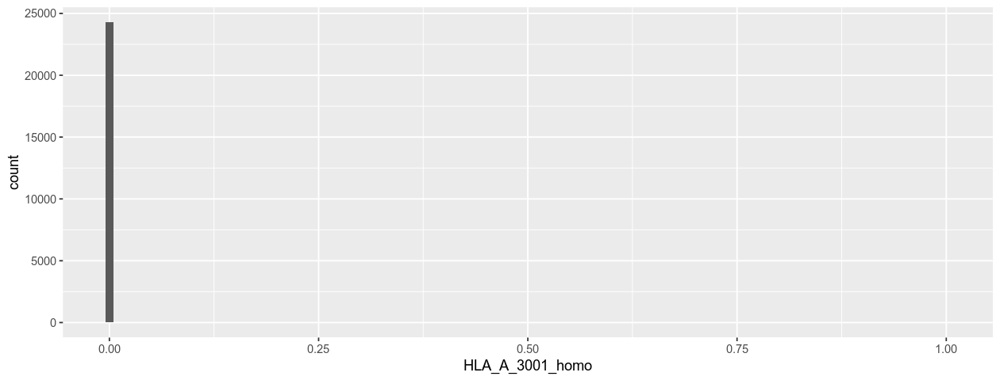

In [59]:
OS_assoc %>% ggplot(.) + geom_histogram(aes(x=HLA_A_3001_homo),bins=100)

In [60]:
df_assoc %>% filter(grepl("LAB_",name)) %>% mutate(p.adj = p.adjust(p)) %>% arrange(p)

name,beta,sd,p,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
LAB_NRBCP_NORMAL,1.276587e-01,3.737983e-02,0.0006384569,0.1238606
LAB_NRBCP,1.881670e-01,8.230669e-02,0.0223597916,1.0000000
LAB_VTP_NORMAL,4.438863e-02,2.090803e-02,0.0337604512,1.0000000
LAB_BANDS,-4.449929e-03,2.188107e-03,0.0421727258,1.0000000
LAB_HGB_NORMAL,-4.960784e-02,2.681373e-02,0.0643126512,1.0000000
LAB_CA199C,-1.511535e-07,8.529259e-08,0.0766663716,1.0000000
LAB_CA125_NORMAL,2.655963e-02,1.524040e-02,0.0813966932,1.0000000
LAB_UPH_NORMAL,-2.406594e-01,1.390802e-01,0.0835780752,1.0000000
LAB_HCT,-1.092291e-03,6.542613e-04,0.0950483541,1.0000000


Association with cancer type

In [61]:
result <- lm(paste("rs16906115 ~ PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2",sep=""),OS_assoc)
summary(result)


Call:
lm(formula = paste("rs16906115 ~ PANEL_VERSION + CANCER_TYPE + GENDER + AGE_AT_TREATMENTSTART + START_YEAR + LINE_OF_TREATMENT + anyIO + TUMOR_PURITY + ANCESTRY_ROT_PC1 + ANCESTRY_ROT_PC2", 
    sep = ""), data = OS_assoc)

Residuals:
     Min       1Q   Median       3Q      Max 
-1.84647  0.01478  0.12703  0.15546  0.63484 

Coefficients:
                                        Estimate Std. Error t value Pr(>|t|)
(Intercept)                            1.807e+00  1.918e-02  94.199   <2e-16
PANEL_VERSION                          2.823e-03  5.550e-03   0.509    0.611
CANCER_TYPEBreast Carcinoma            1.585e-03  1.365e-02   0.116    0.908
CANCER_TYPECancer of Unknown Primary   4.463e-03  1.430e-02   0.312    0.755
CANCER_TYPEColorectal Cancer           8.761e-03  1.338e-02   0.655    0.513
CANCER_TYPEEndometrial Cancer          1.273e-02  1.567e-02   0.812    0.417
CANCER_TYPEEsophagogastric Carcinoma  -9.957e-04  1.505e-02  -0.066    0.947
CANCER_TYPEGlioma                  

# Association in TCGA

In [62]:
immune <- fread("../../../../TCGA/ImmuneAtlas_mmc2_clusters.txt")
names(immune) <- gsub(" ","_",names(immune))
immune <- immune %>% data.frame %>% rename(ID = TCGA_Participant_Barcode)
tcgasnp <- fread("/data/gusev/TCGA/GENOTYPES/IMPUTED/DOSAGE/rs4739139.raw") %>% select(IID,rs4739139_C) %>% rename(ID = IID) %>% mutate(ID=gsub("(TCGA-.{2}-.{4}).*","\\1",ID))
immune_snp_tcga <- inner_join(tcgasnp,immune)

Joining, by = "ID"


In [44]:
nam <- names(immune_snp_tcga)[!grepl("ID|TCGA_Study|TCGA_Subtype|PRS",names(immune_snp_tcga))]

res_immune <- data.frame()
for (n in nam) {
    res <- summary(lm(as.formula(paste("rs4739139_C ~ ",n," + TCGA_Study",sep="")),immune_snp_tcga))
    names <- rownames(res$coefficients)
    names <- names[!grepl("(Intercept)|TCGA_Study",names)]
    pval <- res$coefficients[names,"Pr(>|t|)"]
    beta <- res$coefficients[names,"Estimate"]
    beta_sd <- res$coefficients[names,"Std. Error"]
    res_immune <- rbind(res_immune,data.frame(name=names,beta=beta,beta_sd=beta_sd,pval=pval))
}
rownames(res_immune) <- NULL
res_immune %>% mutate(p.adj = p.adjust(pval)) %>% arrange(pval)

Warning message in model.matrix.default(mt, mf, contrasts):
“the response appeared on the right-hand side and was dropped”Warning message in model.matrix.default(mt, mf, contrasts):
“problem with term 1 in model.matrix: no columns are assigned”

name,beta,beta_sd,pval,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
Silent_Mutation_Rate,-1.662501e-03,5.981619e-04,0.005459257,0.3548517
Nonsilent_Mutation_Rate,-5.212902e-04,2.183448e-04,0.016987736,1.0000000
SNV_Neoantigens,-2.345948e-05,1.242870e-05,0.059132078,1.0000000
Macrophages_M2,6.281397e-02,3.414801e-02,0.065885058,1.0000000
IFN.gamma_Response,8.360349e-03,5.041712e-03,0.097309981,1.0000000
Th2_Cells,-1.187076e-05,7.292372e-06,0.103600766,1.0000000
Intratumor_Heterogeneity,-4.040244e-02,2.706558e-02,0.135539475,1.0000000
Homologous_Recombination_Defects,3.979066e-04,2.775202e-04,0.151668235,1.0000000
Indel_Neoantigens,-2.047898e-05,1.433166e-05,0.153082295,1.0000000


In [45]:
nam <- names(immune_snp_tcga)[!grepl("ID|TCGA_Study|TCGA_Subtype|PRS",names(immune_snp_tcga))]

res_immune <- data.frame()
for (n in nam) {
    res <- summary(lm(as.formula(paste("rs4739139_C ~ ",n,sep="")),immune_snp_tcga %>% filter(TCGA_Study=="BRCA")))
    names <- rownames(res$coefficients)
    names <- names[!grepl("(Intercept)|TCGA_Study",names)]
    pval <- res$coefficients[names,"Pr(>|t|)"]
    beta <- res$coefficients[names,"Estimate"]
    beta_sd <- res$coefficients[names,"Std. Error"]
    res_immune <- rbind(res_immune,data.frame(name=names,beta=beta,beta_sd=beta_sd,pval=pval))
}
rownames(res_immune) <- NULL
res_immune %>% mutate(p.adj = p.adjust(pval)) %>% arrange(pval)

Warning message in model.matrix.default(mt, mf, contrasts):
“the response appeared on the right-hand side and was dropped”Warning message in model.matrix.default(mt, mf, contrasts):
“problem with term 1 in model.matrix: no columns are assigned”

name,beta,beta_sd,pval,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
Immune_SubtypeC3,-1.297787e-01,3.476418e-02,0.000202108,0.01293491
Indel_Neoantigens,-4.182842e-04,1.548776e-04,0.007093118,0.44686643
Macrophages_M2,2.549270e-01,1.078222e-01,0.018292635,1.00000000
Lymphocytes,-1.725654e-01,8.374053e-02,0.039642080,1.00000000
Immune_SubtypeC2,-6.201310e-02,3.027358e-02,0.040834515,1.00000000
TCR_Richness,-4.397080e-04,2.190074e-04,0.044996277,1.00000000
NK_Cells_Activated,-9.350325e-01,5.675681e-01,0.099847719,1.00000000
Neutrophils,2.452186e+00,1.561331e+00,0.116663632,1.00000000
T_Cells_Follicular_Helper,-5.014569e-01,3.196393e-01,0.117071630,1.00000000


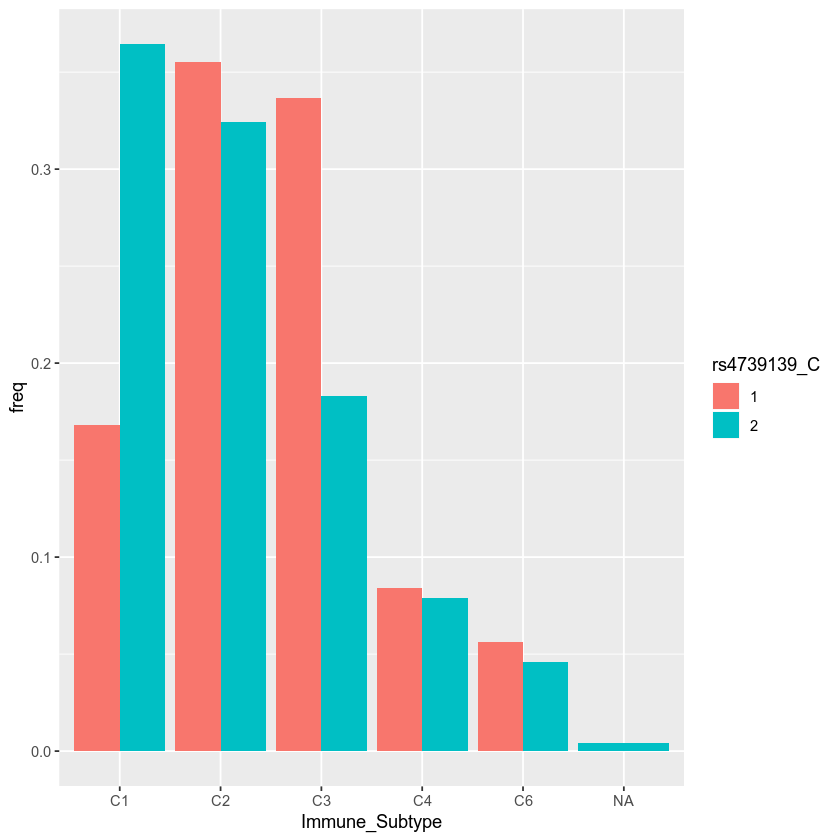

In [46]:
temp <- immune_snp_tcga %>% filter(rs4739139_C!=0) %>% mutate(rs4739139_C=as.factor(rs4739139_C)) %>% filter(TCGA_Study=="BRCA") %>% group_by(rs4739139_C,Immune_Subtype) %>% count %>% group_by(rs4739139_C) %>% mutate(freq=n/sum(n))
ggplot(temp) + geom_col(aes(x=Immune_Subtype,y=freq,fill=rs4739139_C),position="dodge")

Warning message:
“Ignoring unknown parameters: binwidth, bins, pad”

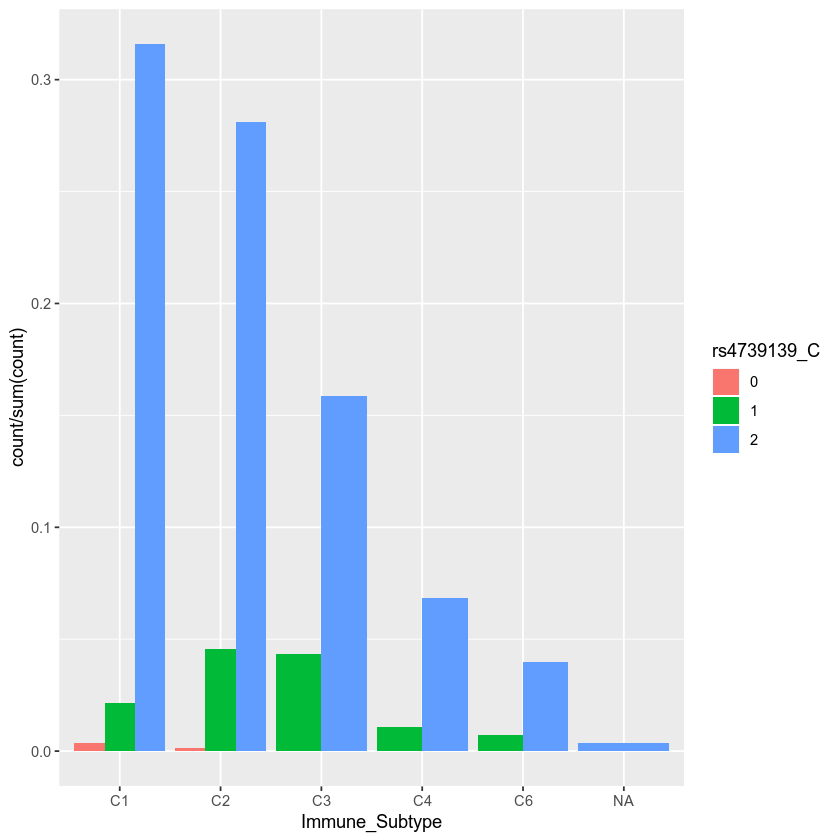

In [47]:
immune_snp_tcga %>% mutate(rs4739139_C=as.factor(rs4739139_C)) %>% filter(TCGA_Study=="BRCA") %>% ggplot(.,aes(x=Immune_Subtype,y=..count../sum(..count..),fill=rs4739139_C)) + geom_histogram(stat="count", position="dodge")

In [48]:
nam <- names(immune_snp_tcga)[!grepl("ID|TCGA_Study|TCGA_Subtype|PRS",names(immune_snp_tcga))]

res_immune <- data.frame()
for (n in nam) {
    res <- summary(lm(as.formula(paste("rs4739139_C ~ ",n,sep="")),immune_snp_tcga %>% filter(TCGA_Study=="LUAD" | TCGA_Study=="LUSC")))
    names <- rownames(res$coefficients)
    names <- names[!grepl("(Intercept)|TCGA_Study",names)]
    pval <- res$coefficients[names,"Pr(>|t|)"]
    beta <- res$coefficients[names,"Estimate"]
    beta_sd <- res$coefficients[names,"Std. Error"]
    res_immune <- rbind(res_immune,data.frame(name=names,beta=beta,beta_sd=beta_sd,pval=pval))
}
rownames(res_immune) <- NULL
res_immune %>% mutate(p.adj = p.adjust(pval)) %>% arrange(pval)

Warning message in model.matrix.default(mt, mf, contrasts):
“the response appeared on the right-hand side and was dropped”Warning message in model.matrix.default(mt, mf, contrasts):
“problem with term 1 in model.matrix: no columns are assigned”

name,beta,beta_sd,pval,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
Eosinophils.1,-1.193928e+01,3.059780e+00,0.0001024608,0.006557491
Eosinophils,-1.193235e+01,3.059453e+00,0.0001032337,0.006557491
Intratumor_Heterogeneity,-1.535981e-01,6.891114e-02,0.0260562799,1.000000000
Macrophages_M2,-2.493701e-01,1.126887e-01,0.0271523844,1.000000000
T_Cells_Regulatory_Tregs,-9.967675e-01,5.239140e-01,0.0574173979,1.000000000
Mast_Cells_Activated,6.626516e-01,3.647476e-01,0.0695872512,1.000000000
OS,4.038959e-02,2.357881e-02,0.0870385975,1.000000000
Macrophages_M1,4.531422e-01,2.648794e-01,0.0874697758,1.000000000
B_Cells_Naive,-3.101814e-01,1.932225e-01,0.1087748167,1.000000000


In [49]:
nam <- names(immune_snp_tcga)[!grepl("ID|TCGA_Study|TCGA_Subtype|PRS",names(immune_snp_tcga))]

res_immune <- data.frame()
for (n in nam) {
    try({
    res <- summary(lm(as.formula(paste("rs4739139_C ~ ",n,sep="")),immune_snp_tcga %>% filter(TCGA_Study=="OV")))
    names <- rownames(res$coefficients)
    names <- names[!grepl("(Intercept)|TCGA_Study",names)]
    pval <- res$coefficients[names,"Pr(>|t|)"]
    beta <- res$coefficients[names,"Estimate"]
    beta_sd <- res$coefficients[names,"Std. Error"]
    res_immune <- rbind(res_immune,data.frame(name=names,beta=beta,beta_sd=beta_sd,pval=pval))
    })
}
rownames(res_immune) <- NULL
res_immune %>% mutate(p.adj = p.adjust(pval)) %>% arrange(pval)

Warning message in model.matrix.default(mt, mf, contrasts):
“the response appeared on the right-hand side and was dropped”Warning message in model.matrix.default(mt, mf, contrasts):
“problem with term 1 in model.matrix: no columns are assigned”

Error in lm.fit(x, y, offset = offset, singular.ok = singular.ok, ...) : 
  0 (non-NA) cases
Error in lm.fit(x, y, offset = offset, singular.ok = singular.ok, ...) : 
  0 (non-NA) cases


name,beta,beta_sd,pval,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
Macrophages_M0,-5.222749e-01,2.210308e-01,0.01889548,1
NK_Cells_Resting,-4.154273e+00,1.907978e+00,0.03038882,1
Homologous_Recombination_Defects,1.560237e-03,8.212229e-04,0.05804842,1
NK_Cells_Activated,9.192038e-01,5.056519e-01,0.07027781,1
BCR_Richness,-2.259185e-04,1.245522e-04,0.07085425,1
Macrophages_M2,2.700317e-01,1.635736e-01,0.10002465,1
Th17_Cells,2.149546e-05,1.364037e-05,0.11649897,1
Eosinophils,6.922966e+00,4.483903e+00,0.12385789,1
Eosinophils.1,6.922966e+00,4.483903e+00,0.12385789,1


In [50]:
nam <- names(immune_snp_tcga)[!grepl("ID|TCGA_Study|TCGA_Subtype|PRS",names(immune_snp_tcga))]

res_immune <- data.frame()
for (n in nam) {
    try({
    res <- summary(lm(as.formula(paste("rs4739139_C ~ ",n,sep="")),immune_snp_tcga %>% filter(TCGA_Study=="KIRC")))
    names <- rownames(res$coefficients)
    names <- names[!grepl("(Intercept)|TCGA_Study",names)]
    pval <- res$coefficients[names,"Pr(>|t|)"]
    beta <- res$coefficients[names,"Estimate"]
    beta_sd <- res$coefficients[names,"Std. Error"]
    res_immune <- rbind(res_immune,data.frame(name=names,beta=beta,beta_sd=beta_sd,pval=pval))
    })
}
rownames(res_immune) <- NULL
res_immune %>% mutate(p.adj = p.adjust(pval)) %>% arrange(pval)

Warning message in model.matrix.default(mt, mf, contrasts):
“the response appeared on the right-hand side and was dropped”Warning message in model.matrix.default(mt, mf, contrasts):
“problem with term 1 in model.matrix: no columns are assigned”

Error in lm.fit(x, y, offset = offset, singular.ok = singular.ok, ...) : 
  0 (non-NA) cases


name,beta,beta_sd,pval,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
BCR_Shannon,4.789442e-02,0.0184922351,0.01023936,0.6553191
BCR_Richness,1.084942e-03,0.0004872039,0.02696904,1.0000000
IFN.gamma_Response,-6.817007e-02,0.0366250946,0.06339779,1.0000000
Neutrophils.1,-1.187327e+00,0.6583727407,0.07203421,1.0000000
Neutrophils,-1.186858e+00,0.6584004230,0.07215829,1.0000000
Mast_Cells_Activated,8.855260e-01,0.6184890134,0.15295359,1.0000000
Immune_SubtypeC6,-2.307692e-01,0.1694165857,0.17388704,1.0000000
B_Cells_Memory,1.885224e+00,1.3924121596,0.17648448,1.0000000
TCR_Evenness,3.162494e-01,0.2361620247,0.18128632,1.0000000


In [51]:
nam <- names(immune_snp_tcga)[!grepl("ID|TCGA_Study|TCGA_Subtype|PRS",names(immune_snp_tcga))]

res_immune <- data.frame()
for (n in nam) {
    try({
    res <- summary(lm(as.formula(paste("rs4739139_C ~ ",n,sep="")),immune_snp_tcga %>% filter(TCGA_Study=="PRAD")))
    names <- rownames(res$coefficients)
    names <- names[!grepl("(Intercept)|TCGA_Study",names)]
    pval <- res$coefficients[names,"Pr(>|t|)"]
    beta <- res$coefficients[names,"Estimate"]
    beta_sd <- res$coefficients[names,"Std. Error"]
    res_immune <- rbind(res_immune,data.frame(name=names,beta=beta,beta_sd=beta_sd,pval=pval))
    })
}
rownames(res_immune) <- NULL
res_immune %>% mutate(p.adj = p.adjust(pval)) %>% arrange(pval)

Warning message in model.matrix.default(mt, mf, contrasts):
“the response appeared on the right-hand side and was dropped”Warning message in model.matrix.default(mt, mf, contrasts):
“problem with term 1 in model.matrix: no columns are assigned”

name,beta,beta_sd,pval,p.adj
<fct>,<dbl>,<dbl>,<dbl>,<dbl>
Lymphocytes,-4.513925e-01,1.590062e-01,0.004780441,0.2963873
TCR_Shannon,-4.889830e-02,1.819327e-02,0.007536998,0.4597569
Mast_Cells_Resting,5.861615e-01,2.251859e-01,0.009616636,0.5769981
TCR_Richness,-3.020970e-03,1.174450e-03,0.010504488,0.6197648
Mast_Cells,6.180491e-01,2.404300e-01,0.010546907,0.6197648
Aneuploidy_Score,-1.097509e-02,4.612109e-03,0.017768619,1.0000000
Homologous_Recombination_Defects,-3.771175e-03,1.707519e-03,0.027735052,1.0000000
Number_of_Segments,-2.514372e-04,1.166816e-04,0.031710384,1.0000000
Dendritic_Cells_Activated,-4.973561e+00,2.438107e+00,0.042075114,1.0000000


# Interaction analysis

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"


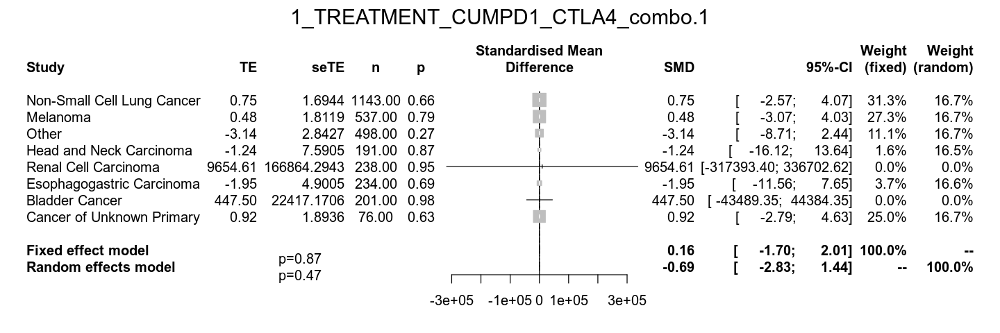

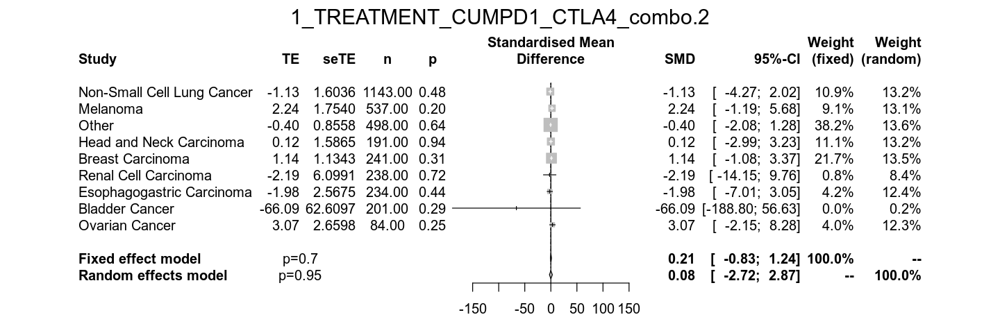

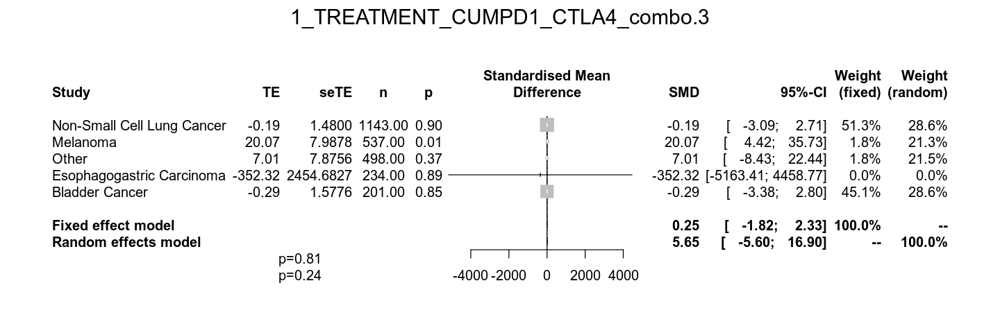

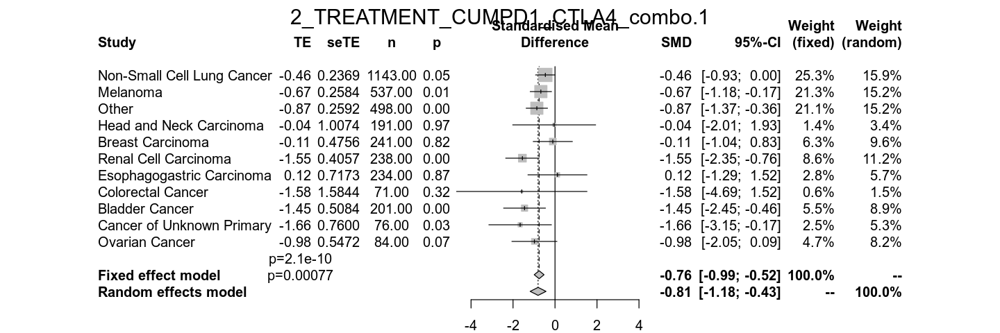

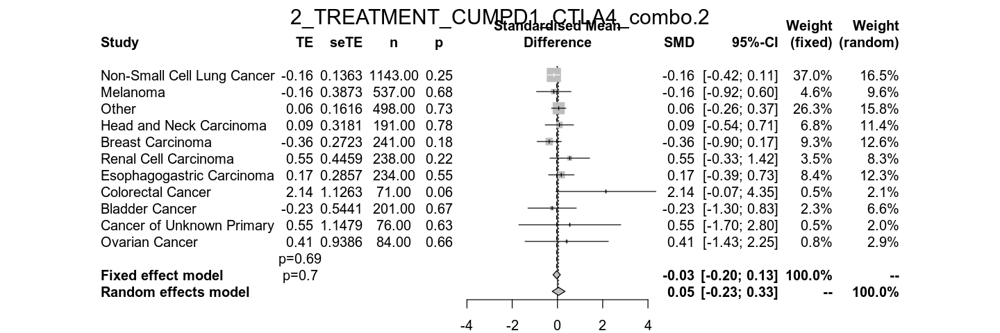

...

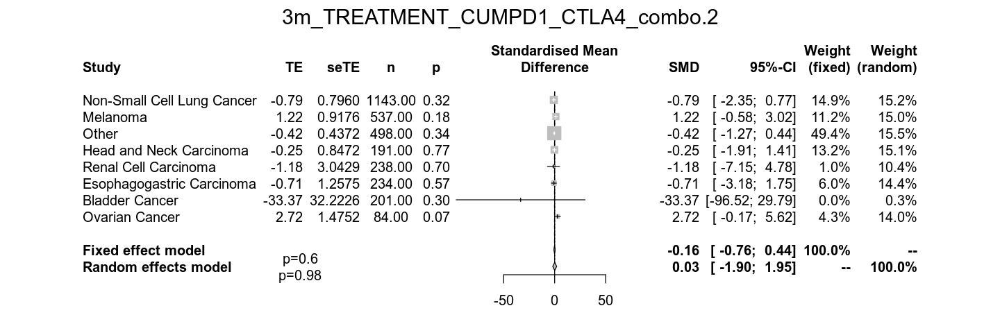

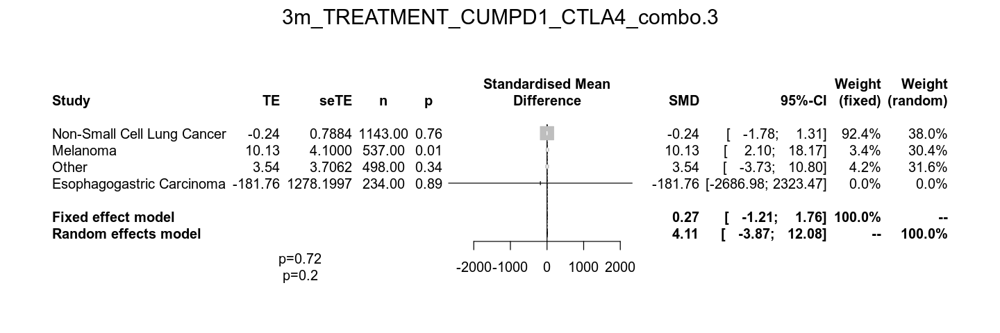

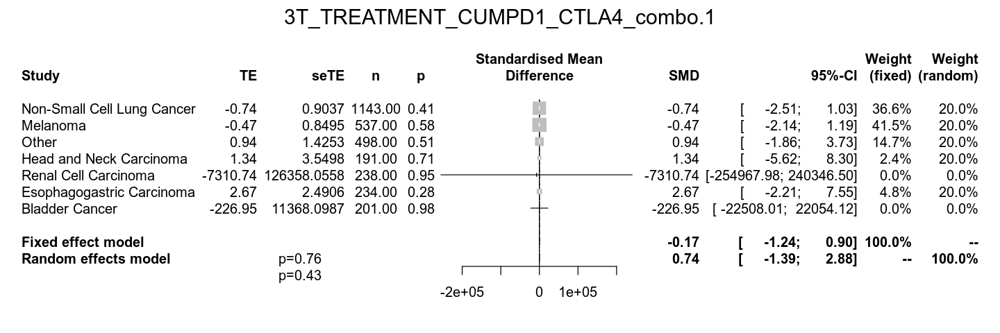

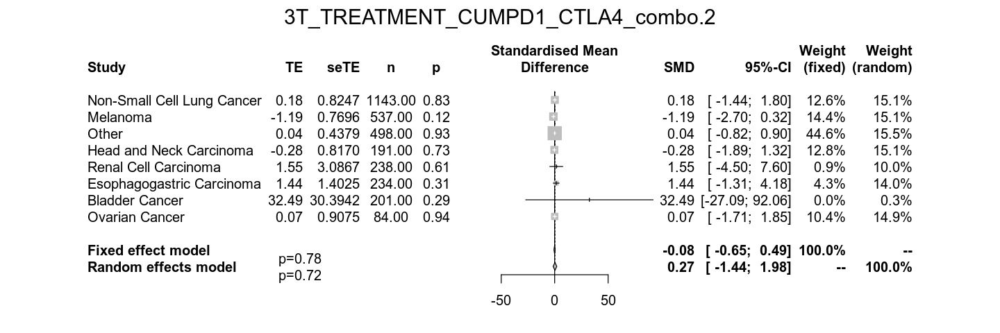

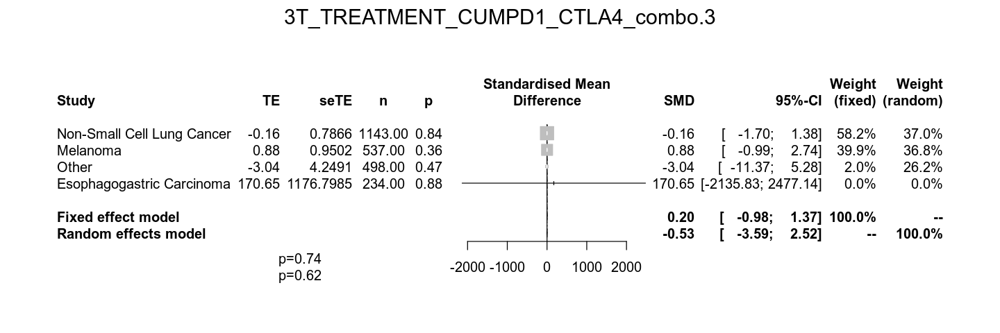

In [24]:
vie_temp <- list(trans1=c("AGE_AT_TREATMENTSTART","GENDER"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("TREATMENT_CUMPD1_CTLA4_combo","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

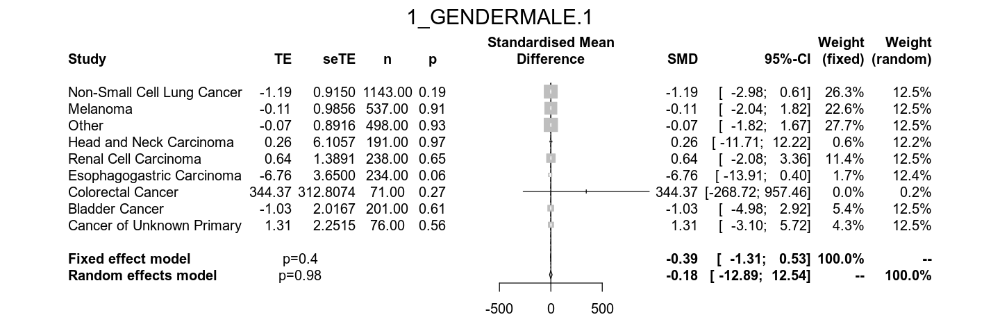

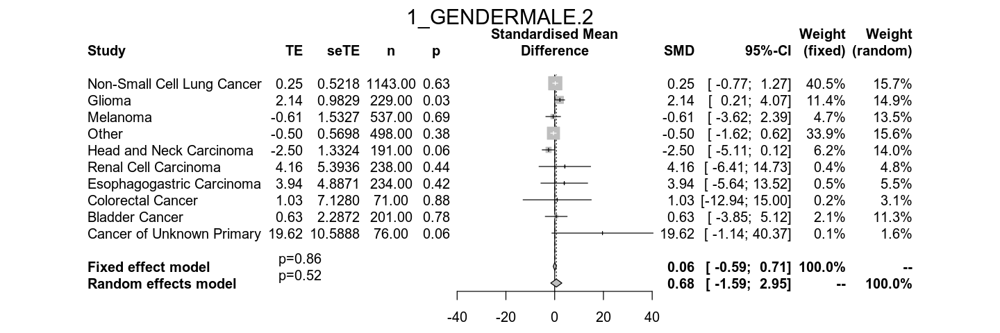

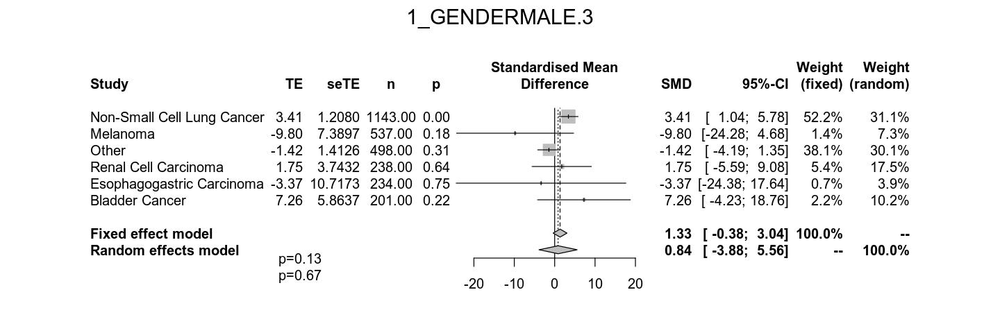

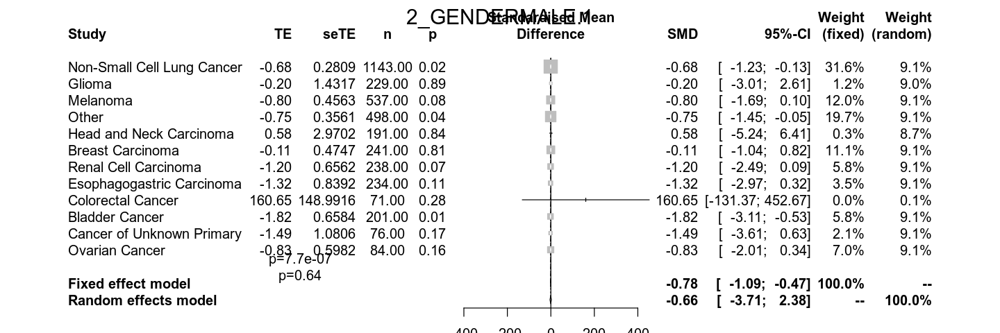

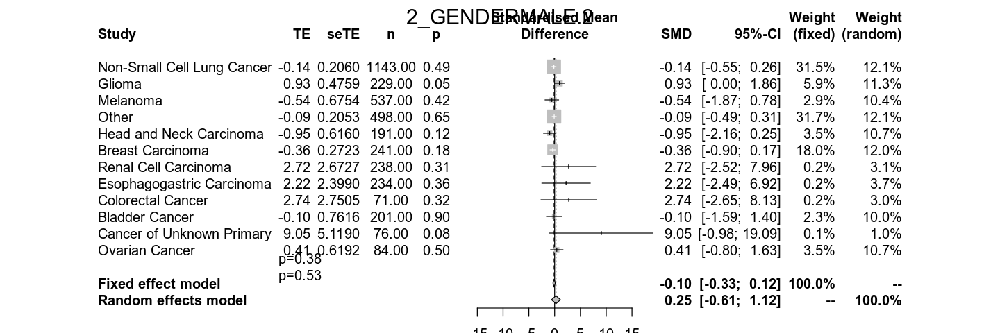

...

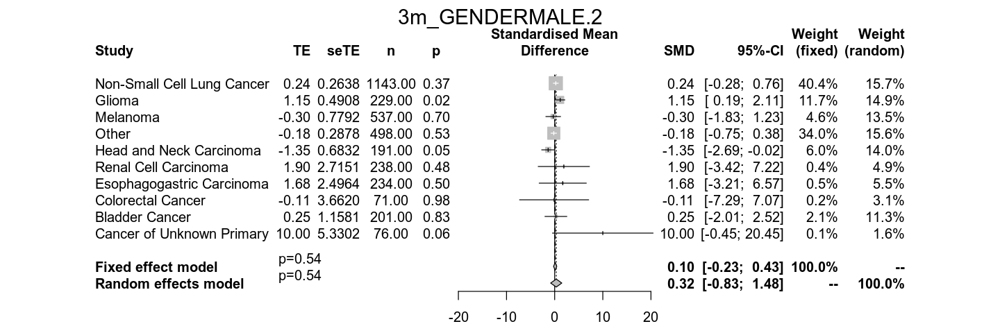

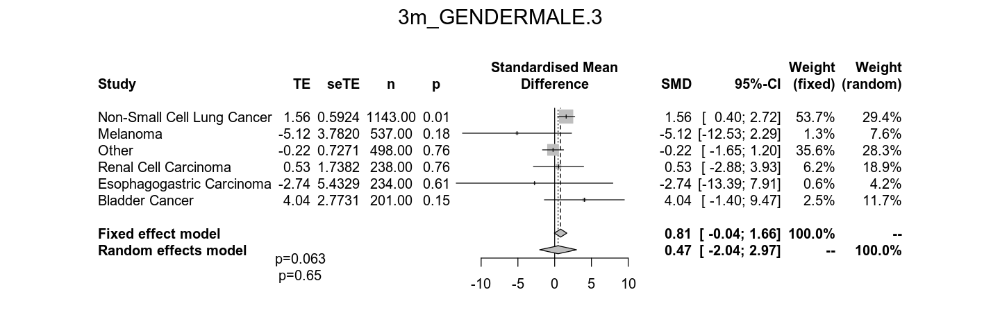

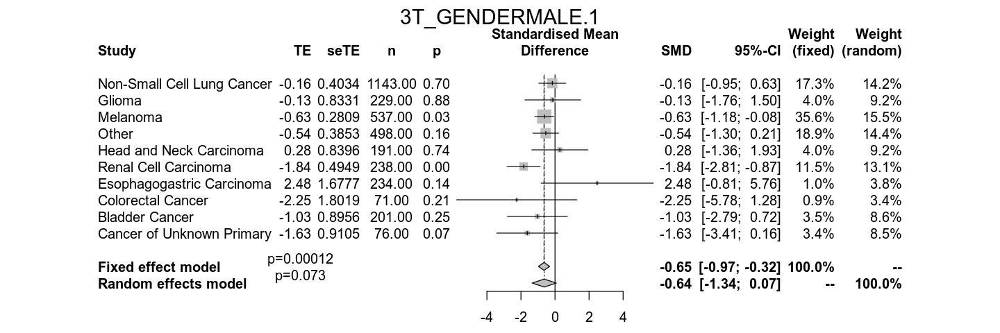

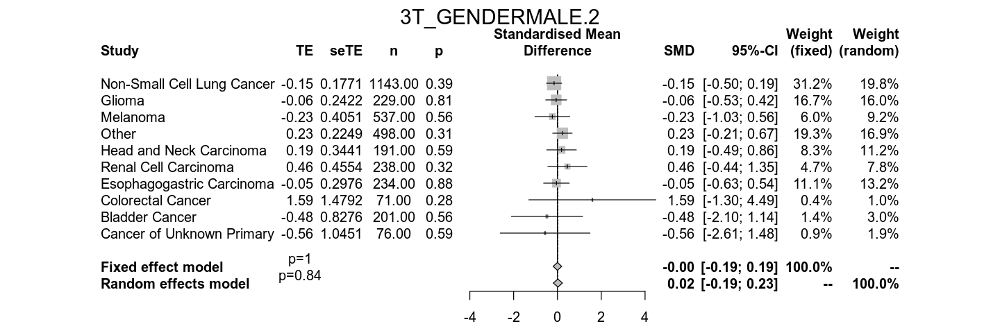

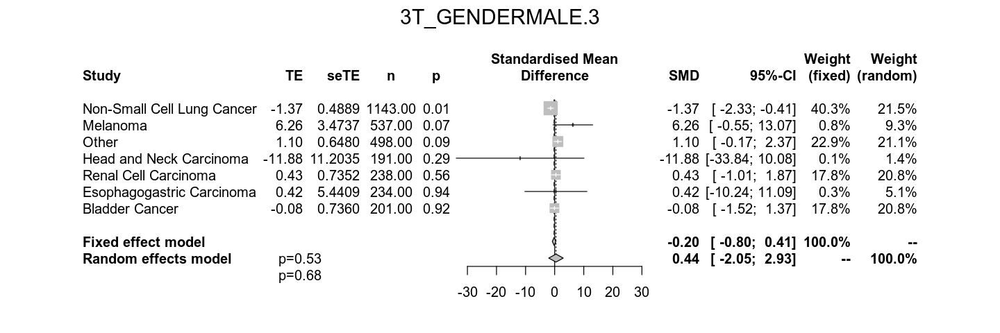

In [27]:
vie_temp <- list(trans1=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","TREATMENT_CUM"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("GENDERMALE","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"


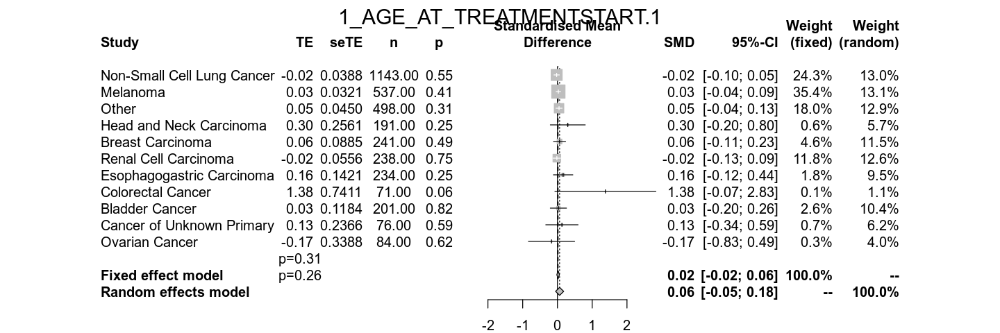

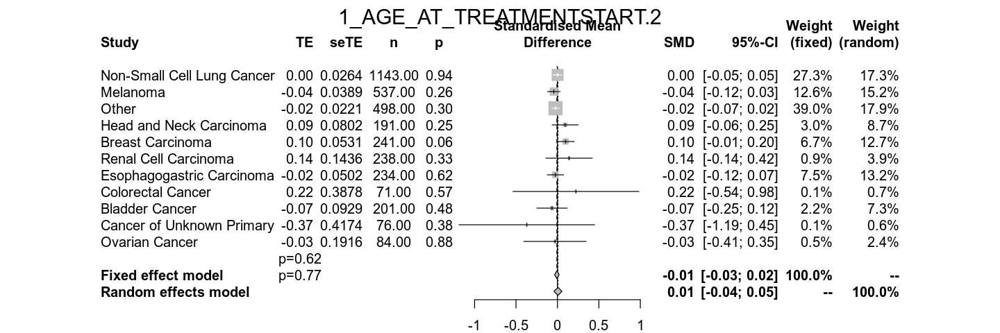

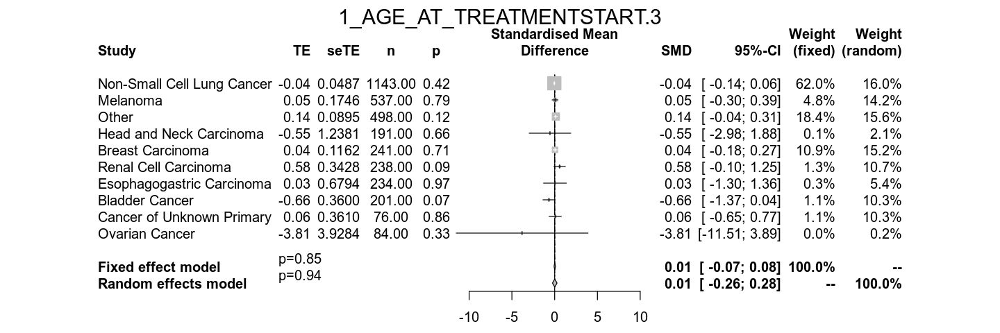

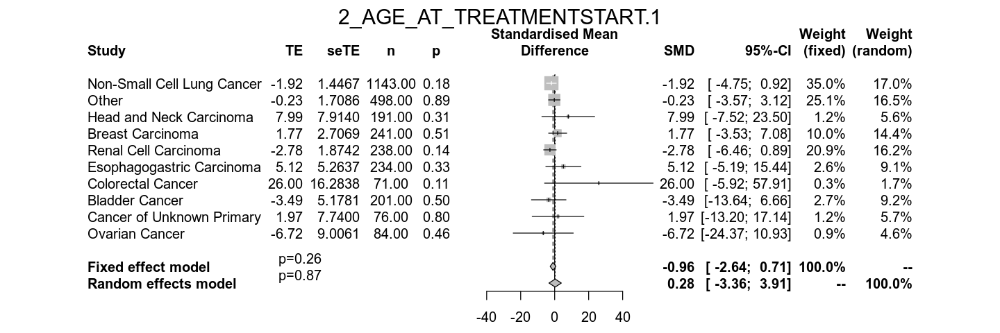

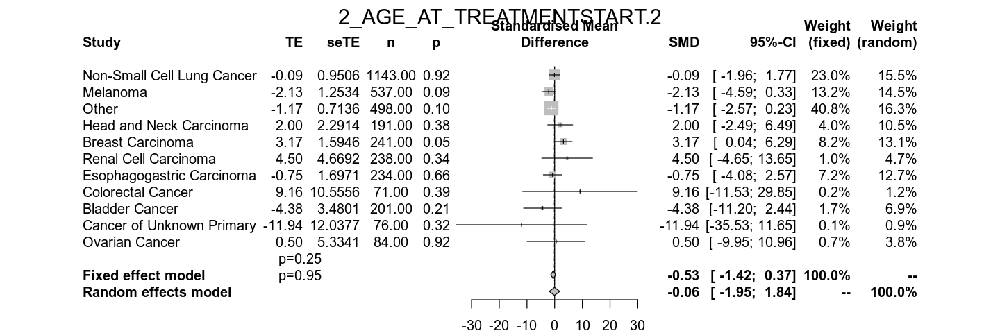

...

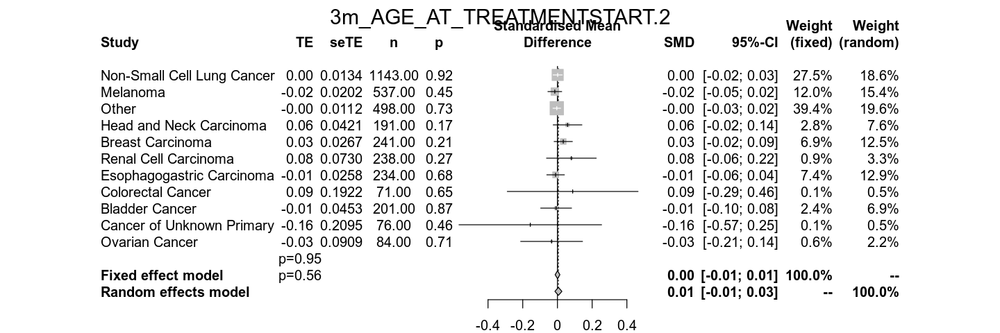

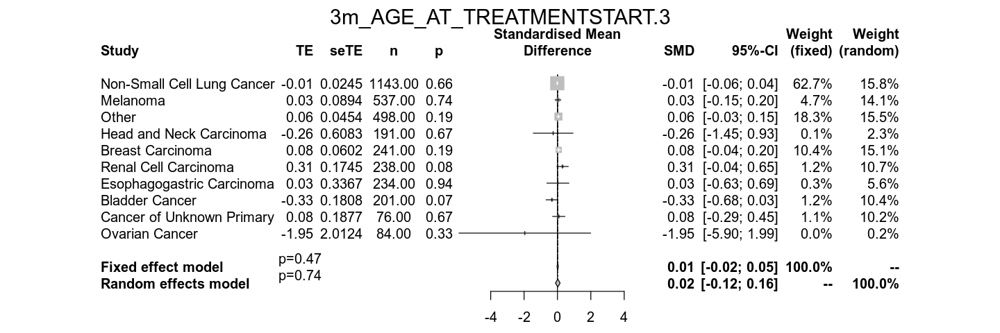

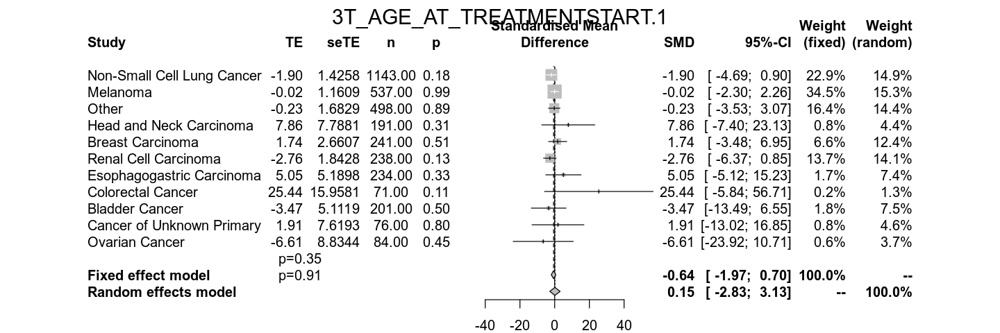

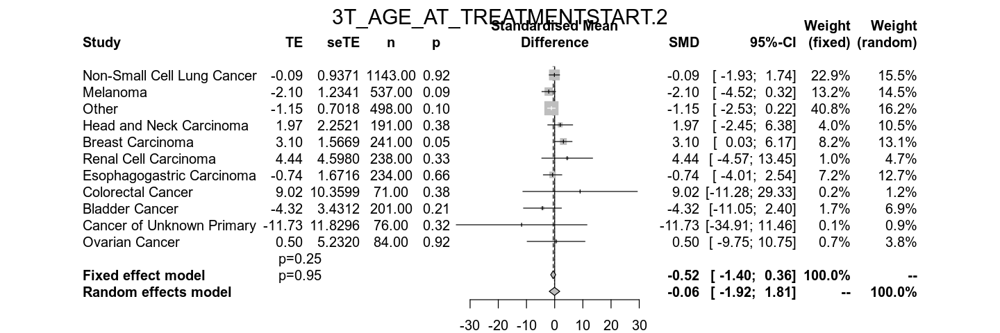

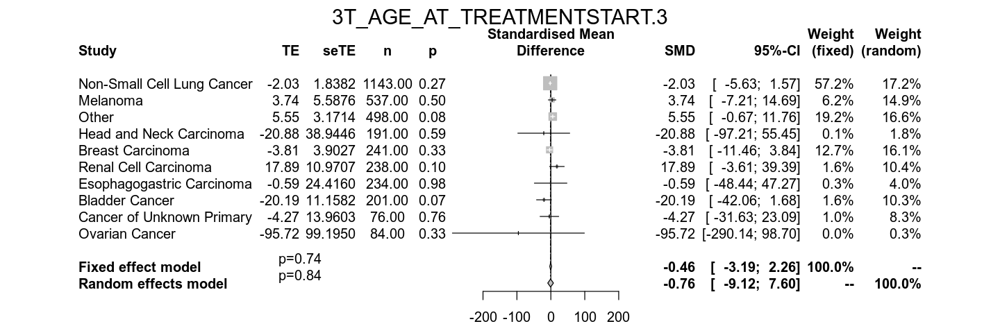

In [94]:
vie_temp <- list(trans1=c("GENDER","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("AGE_AT_TREATMENTSTART","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

NULL
NULL
NULL


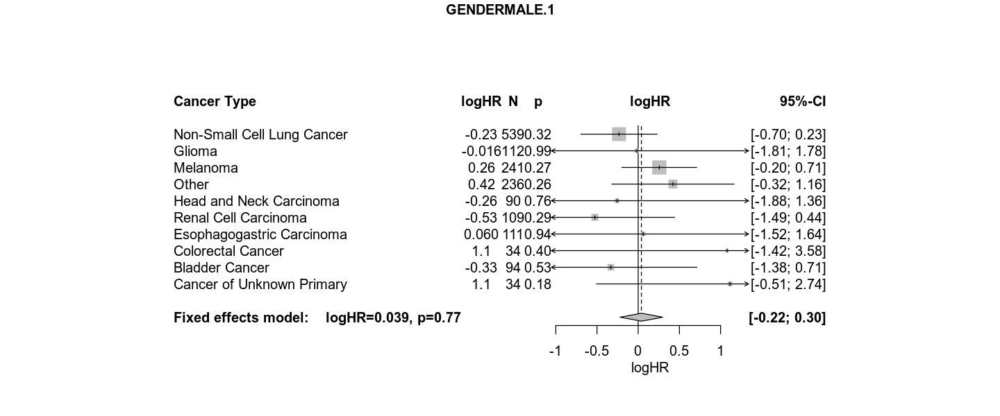

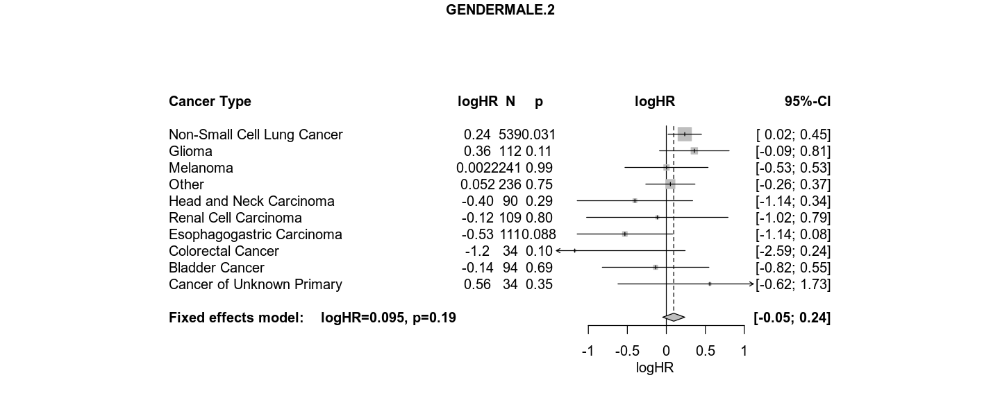

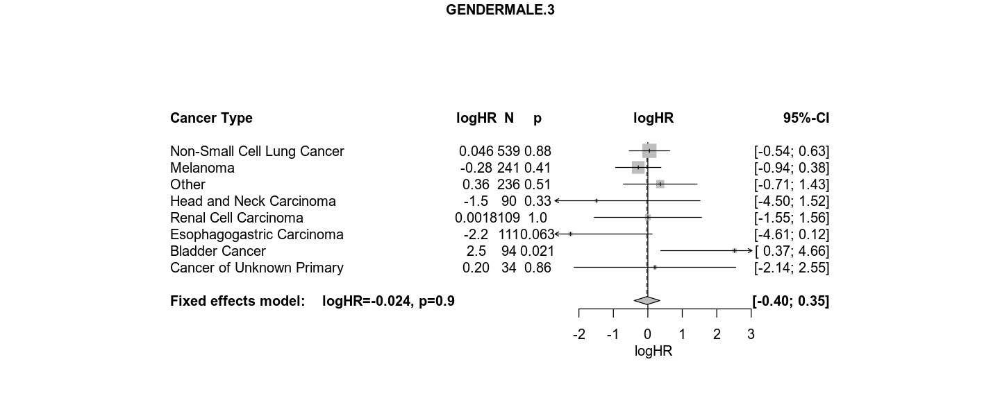

In [271]:
vie_temp <- list(trans1=c("GENDER","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

tr <- meta_survival_AE("GENDERMALE",OS_GWAS %>% filter(before_2018==1,GWAS_avail),vars_in_all = via_temp, vars_in_each = vie_temp)

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


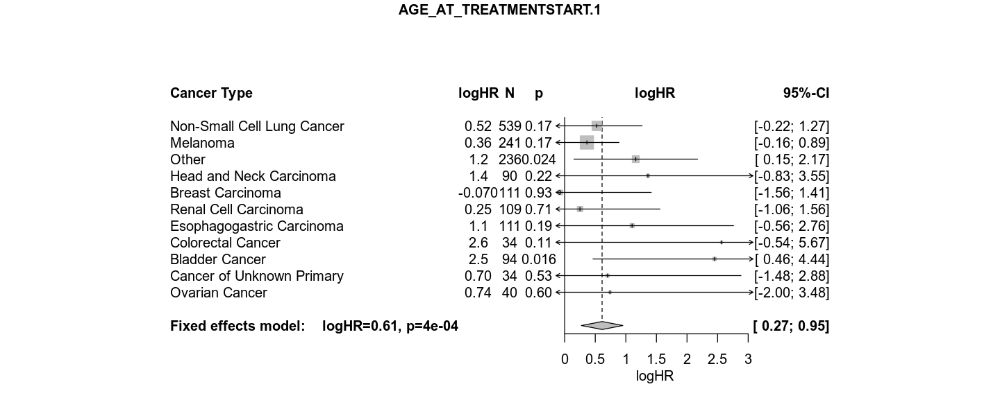

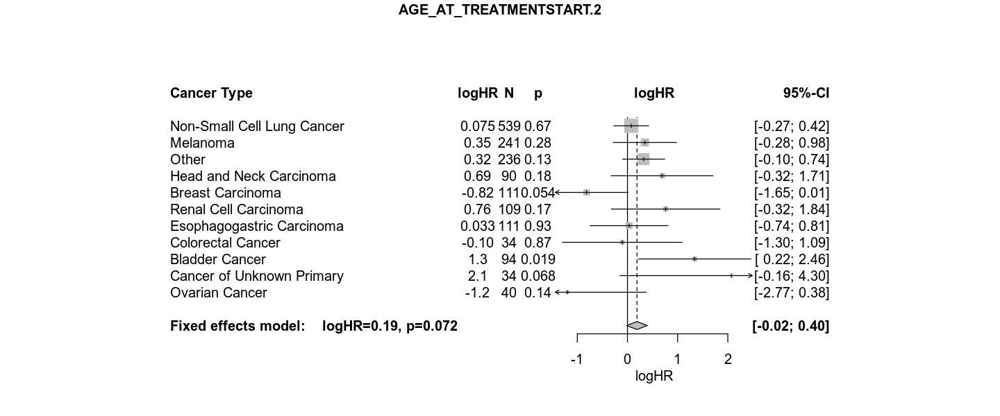

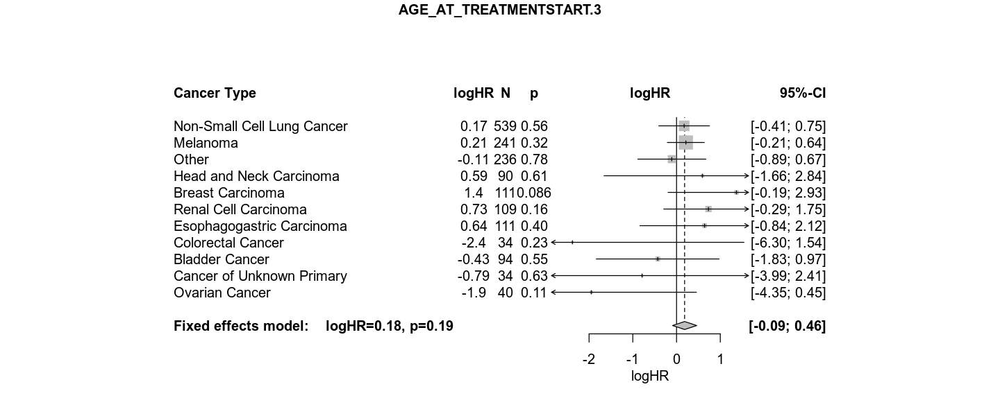

In [262]:
vie_temp <- list(trans1=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","TREATMENT_CUM"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

tr <- meta_survival_AE("AGE_AT_TREATMENTSTART",OS_GWAS %>% filter(before_2018==1,GWAS_avail) %>% mutate(AGE_AT_TREATMENTSTART.1=scale(AGE_AT_TREATMENTSTART.1),AGE_AT_TREATMENTSTART.2=scale(AGE_AT_TREATMENTSTART.2),AGE_AT_TREATMENTSTART.3=scale(AGE_AT_TREATMENTSTART.3)),vars_in_all = via_temp, vars_in_each = vie_temp)

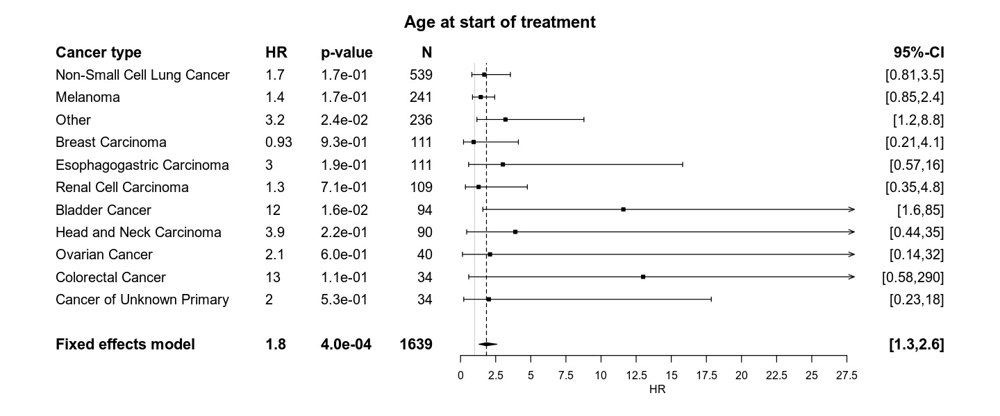

In [264]:
my_forest(tr,"AGE_AT_TREATMENTSTART.1","Age at start of treatment")

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"


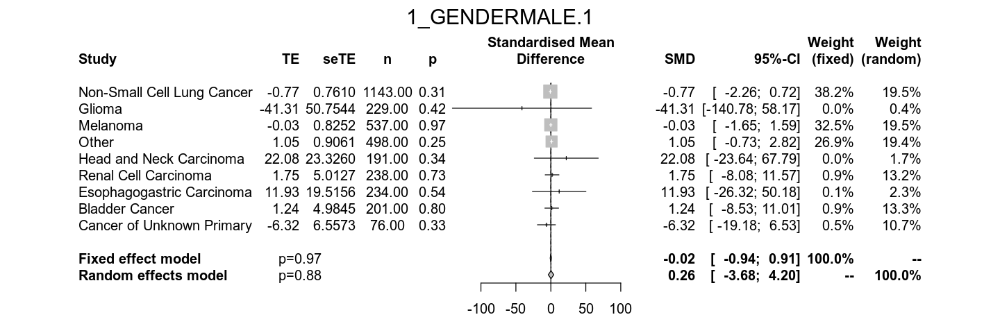

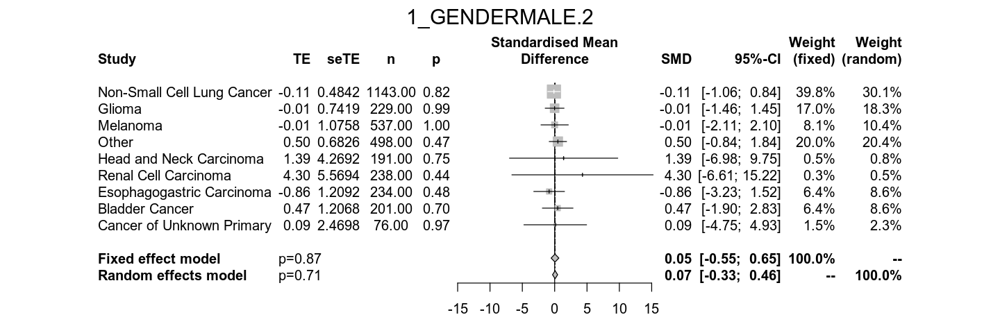

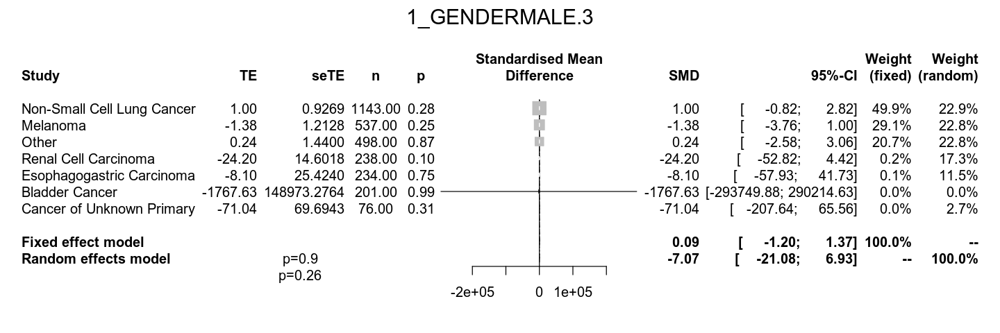

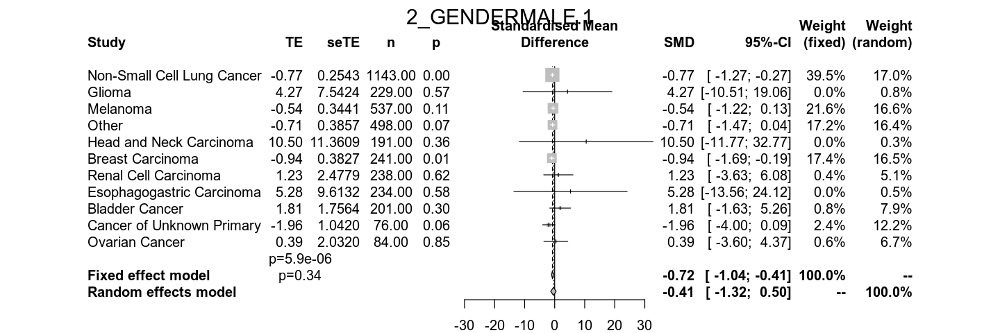

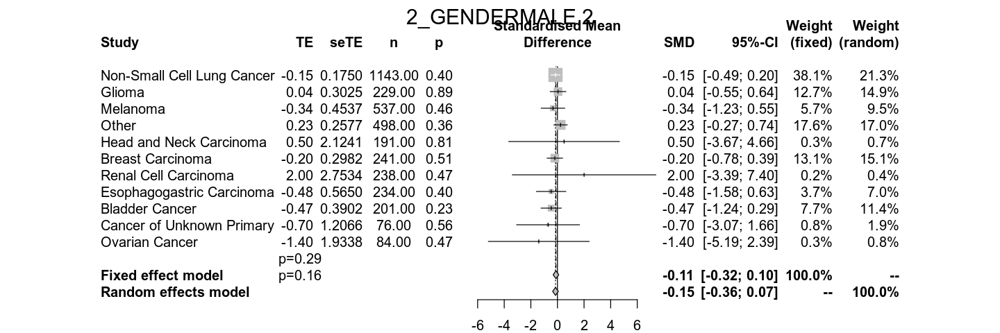

...

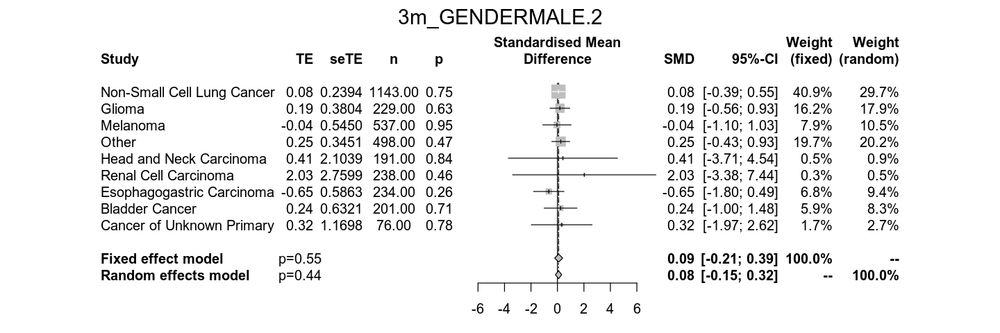

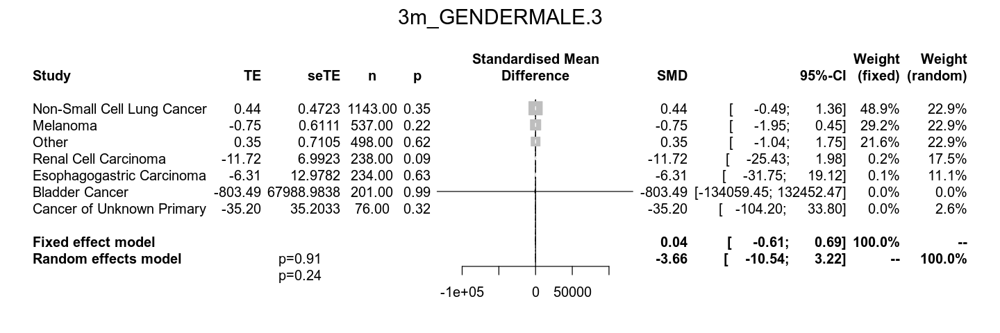

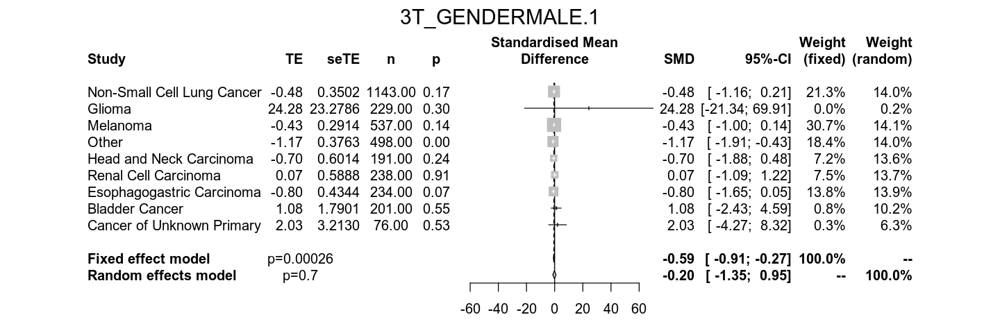

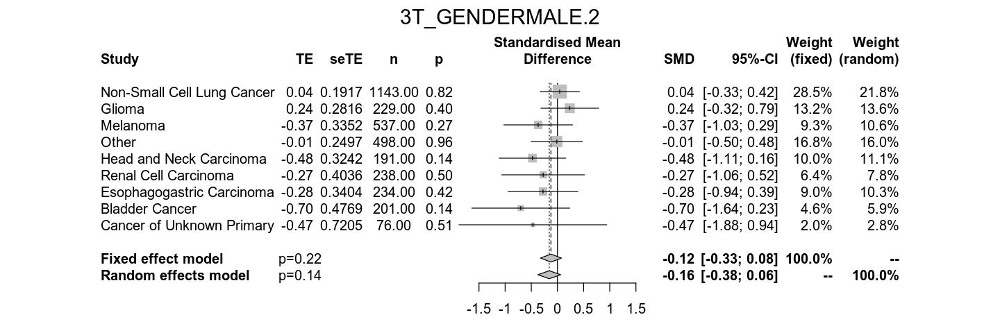

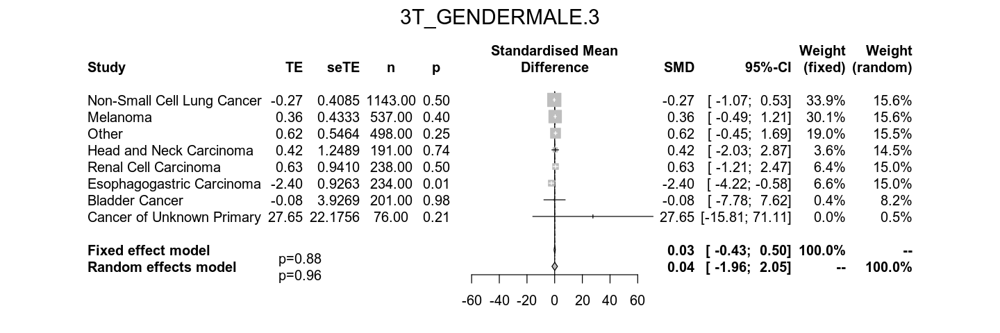

In [270]:
vie_temp <- list(trans1=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","TREATMENT_CUM"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("GENDERMALE","rs75824728_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs75824728_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

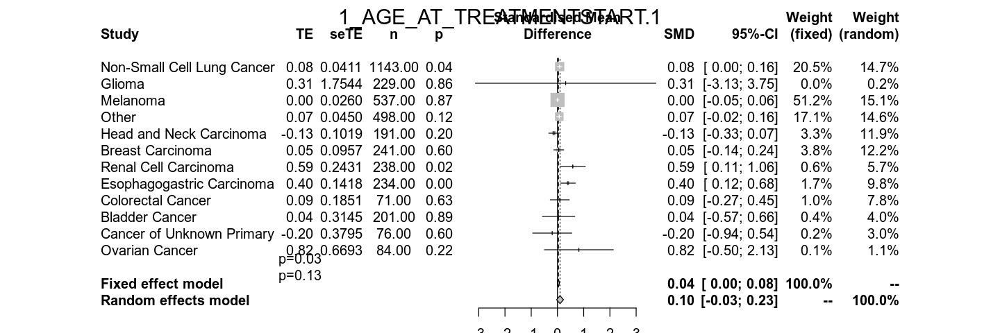

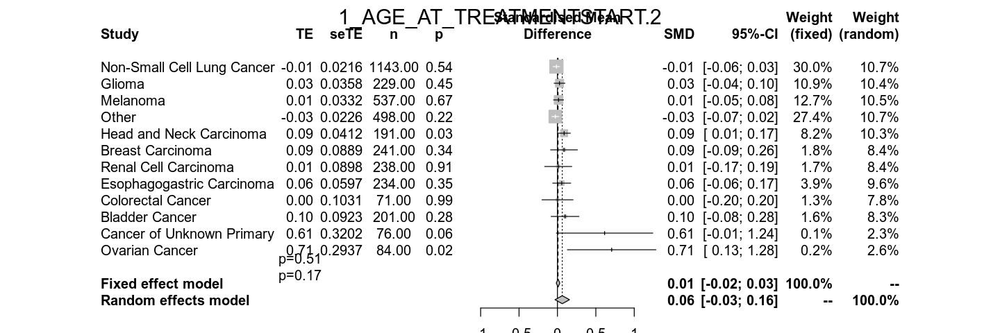

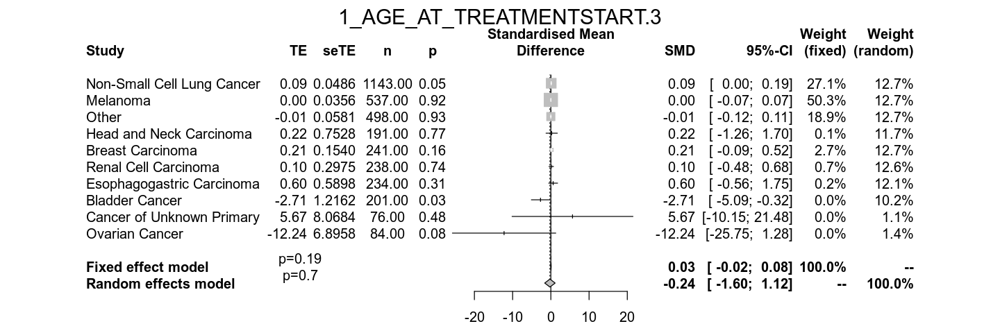

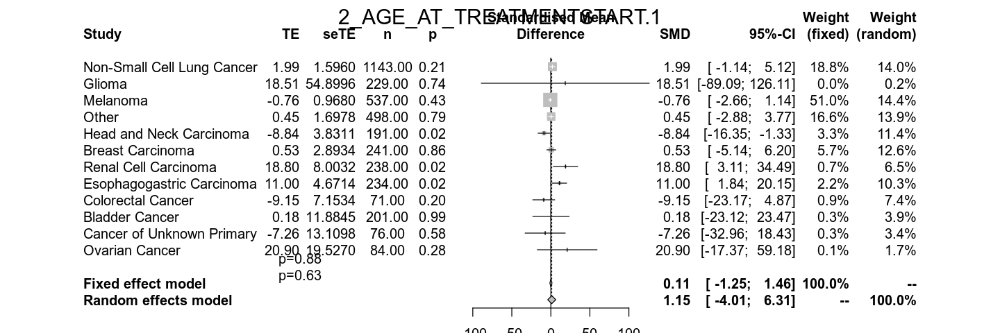

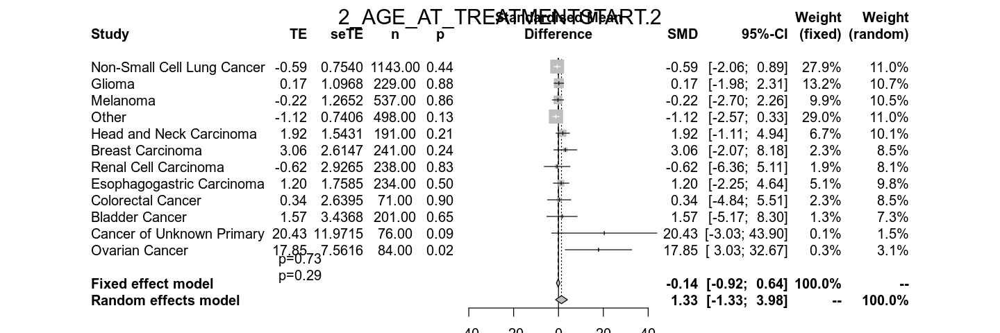

...

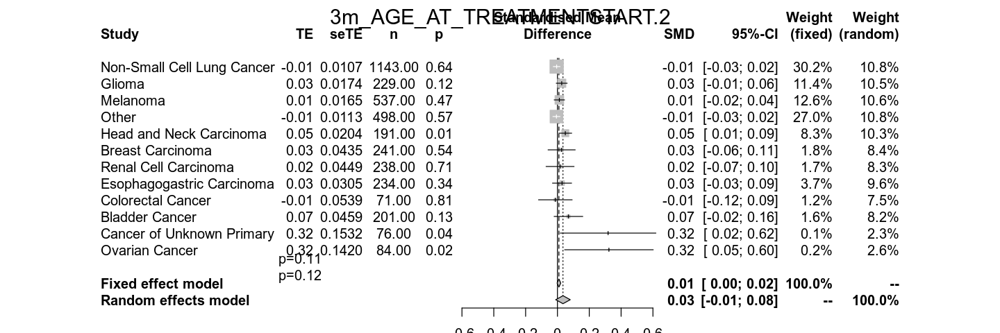

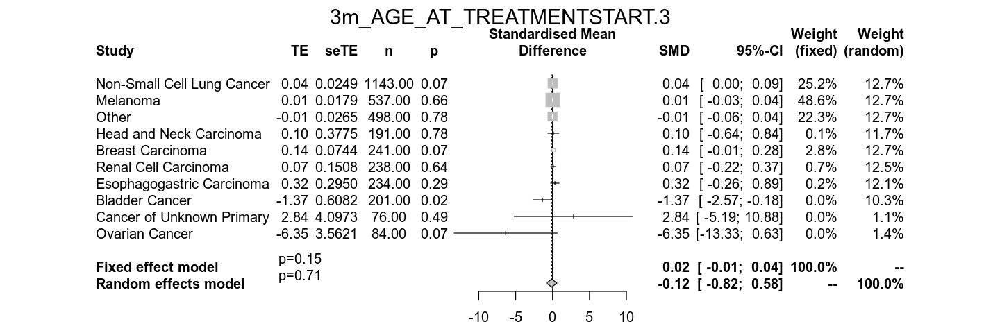

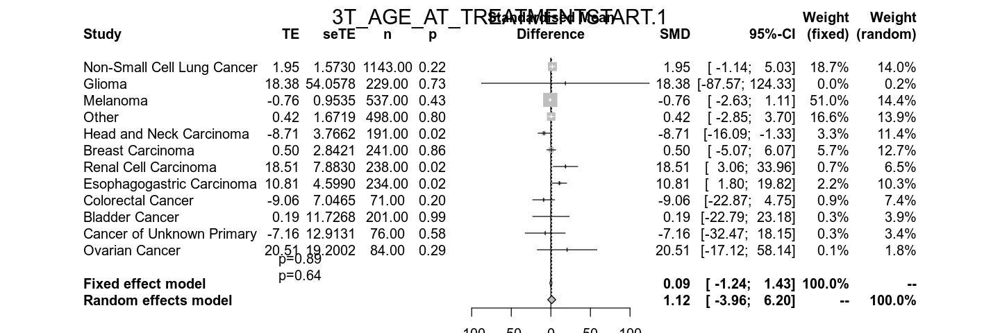

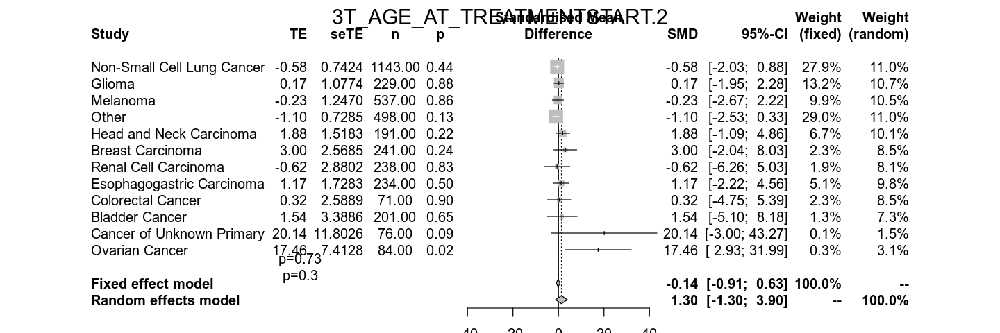

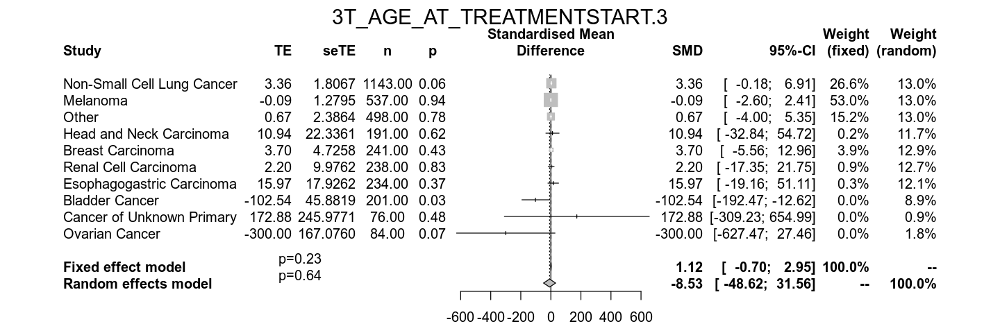

In [272]:
vie_temp <- list(trans1=c("GENDER","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("AGE_AT_TREATMENTSTART","rs75824728_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs75824728_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Cancer of Unknown Primary was unsuccesful"


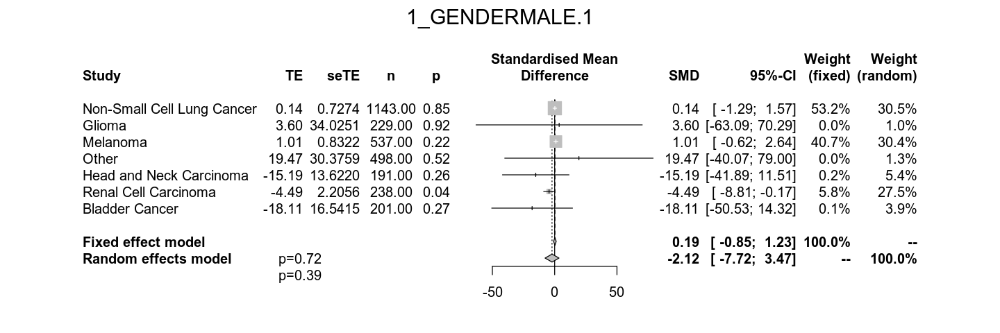

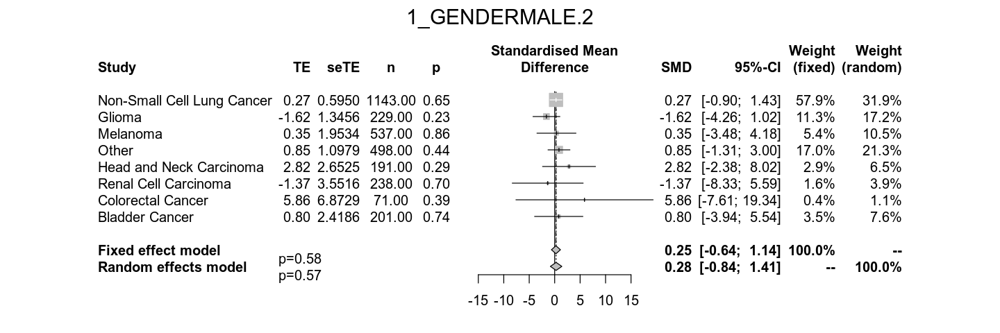

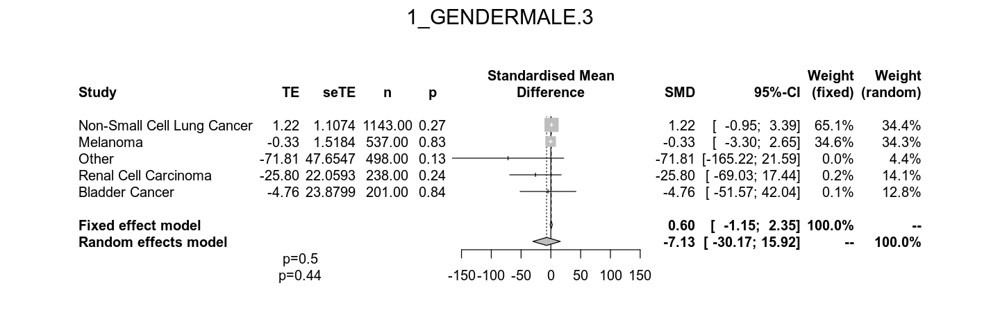

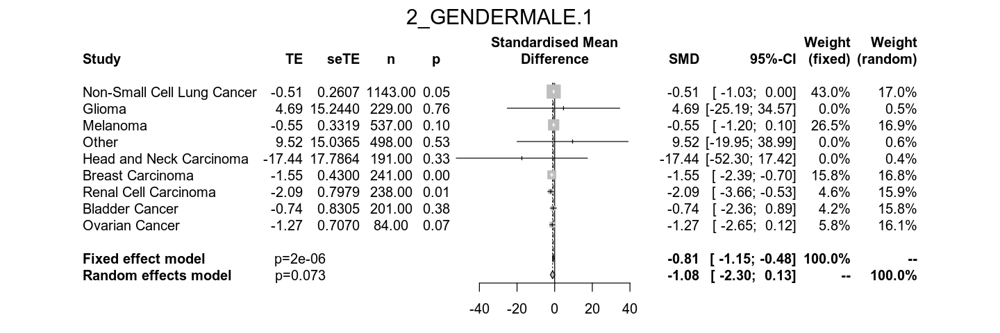

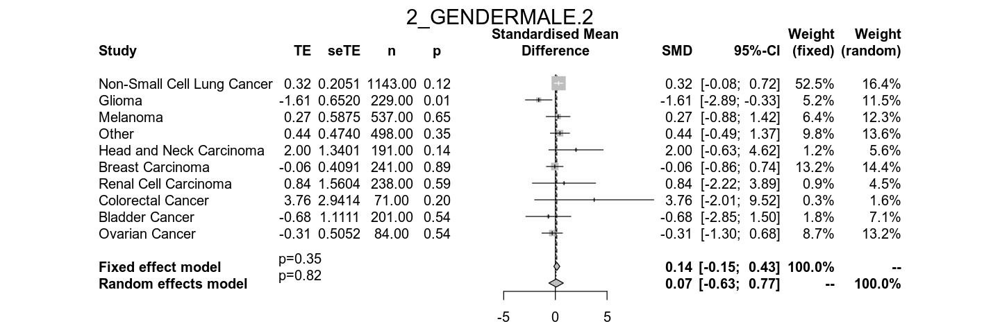

...

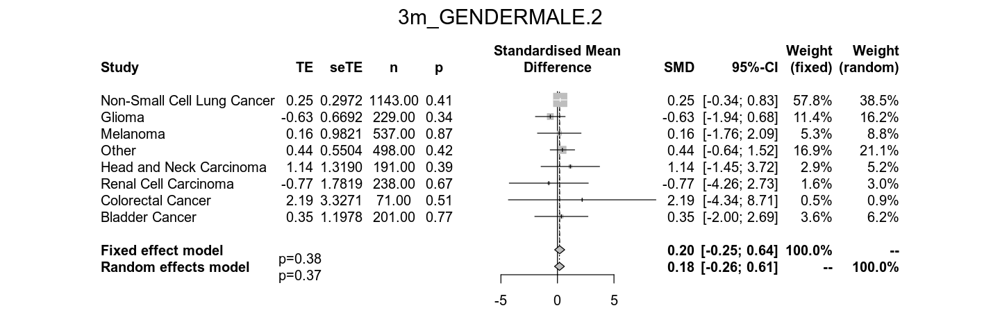

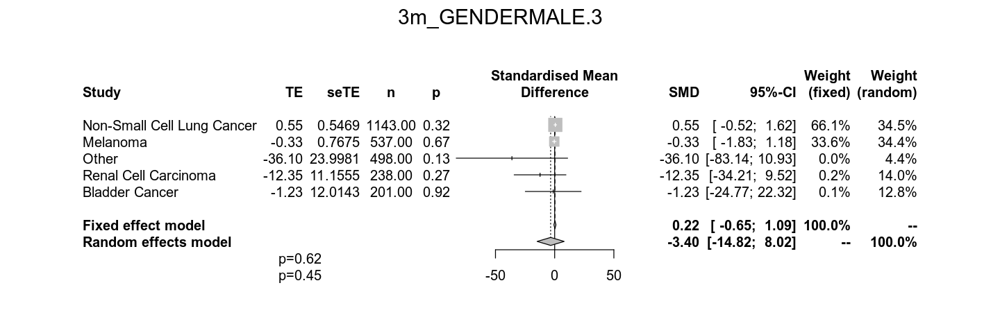

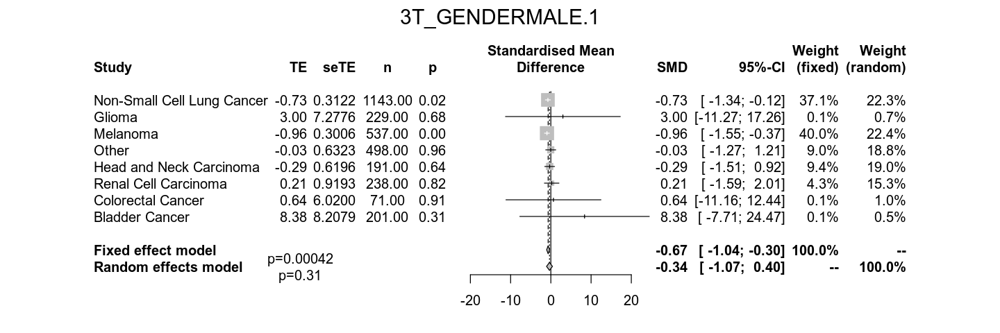

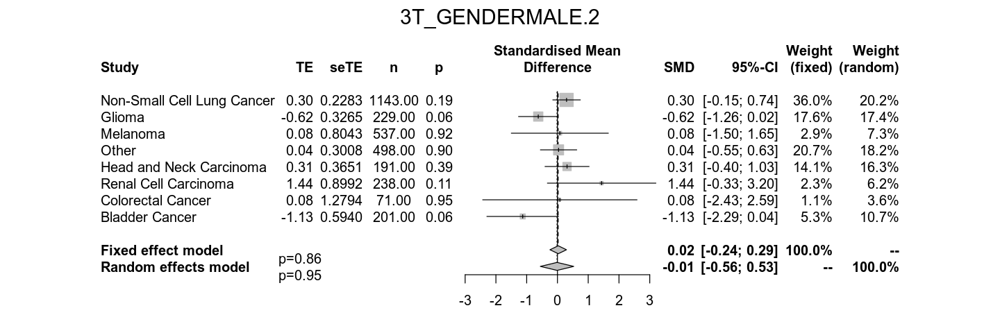

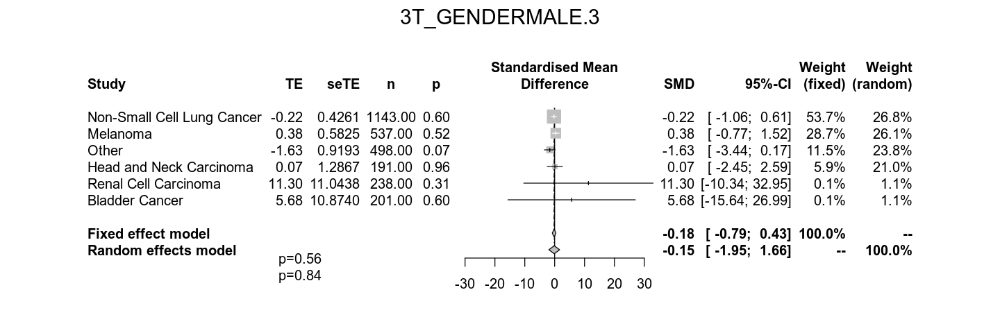

In [273]:
vie_temp <- list(trans1=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","TREATMENT_CUM"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("GENDERMALE","rs113861051_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs113861051_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Colorectal Cancer was unsuccesful"


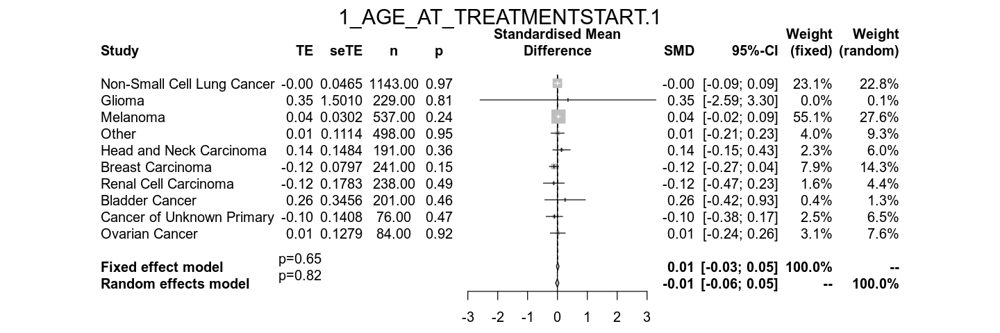

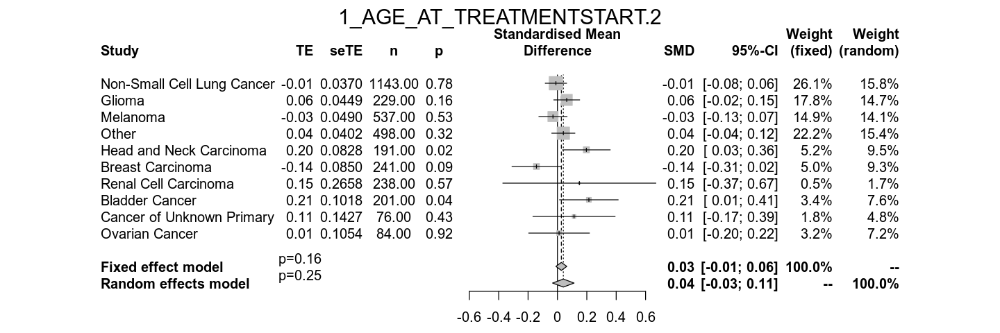

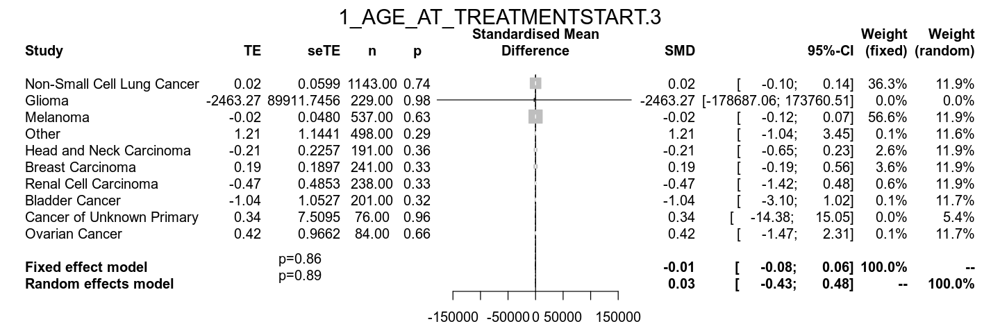

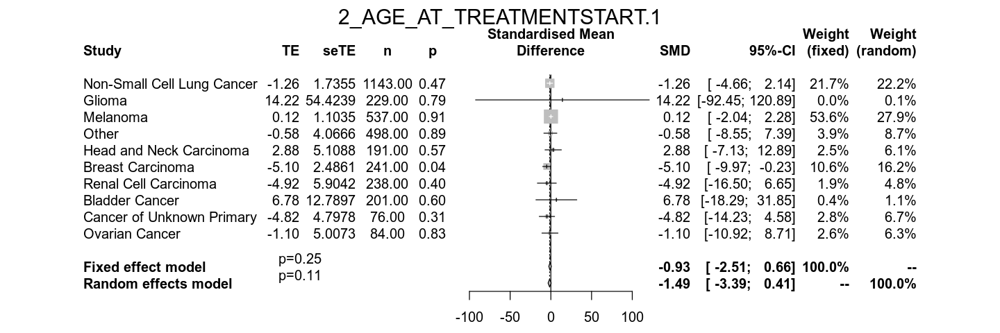

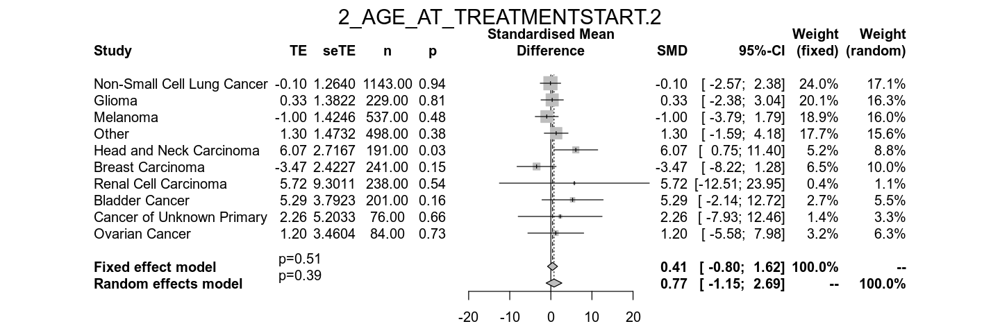

...

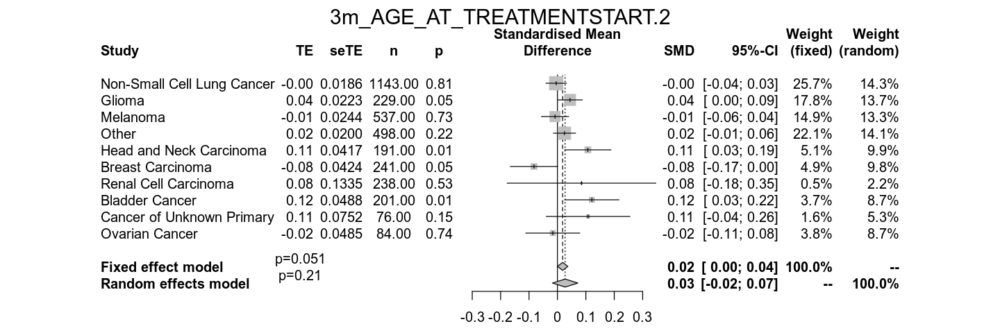

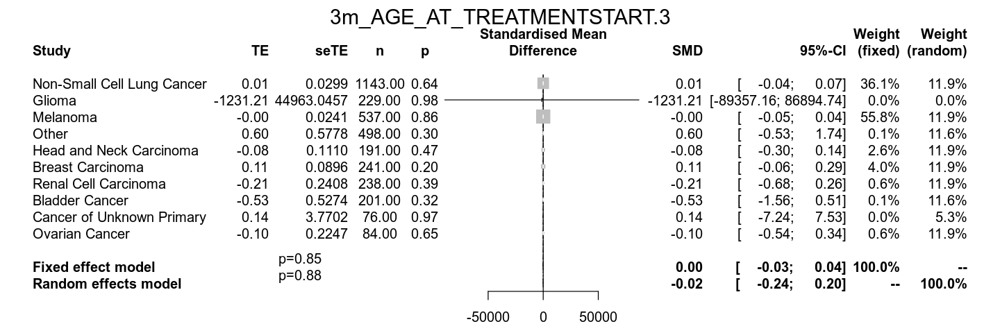

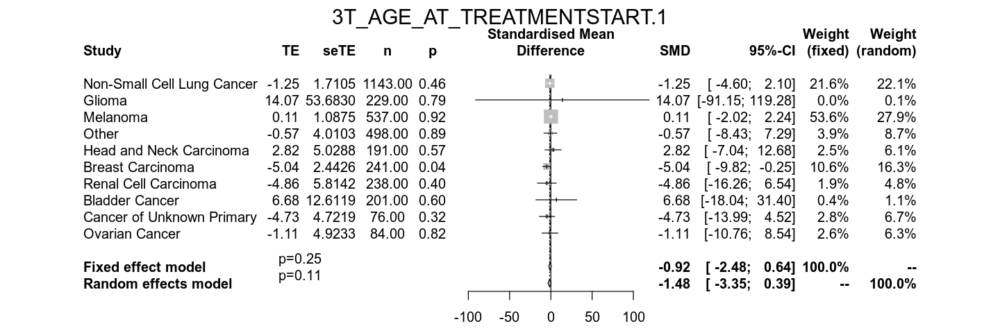

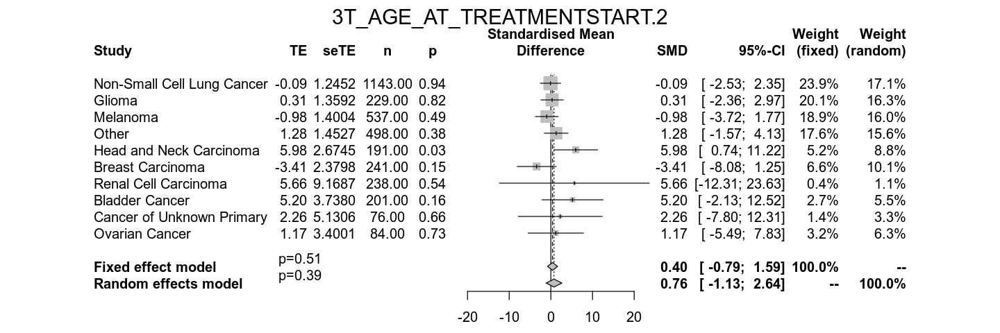

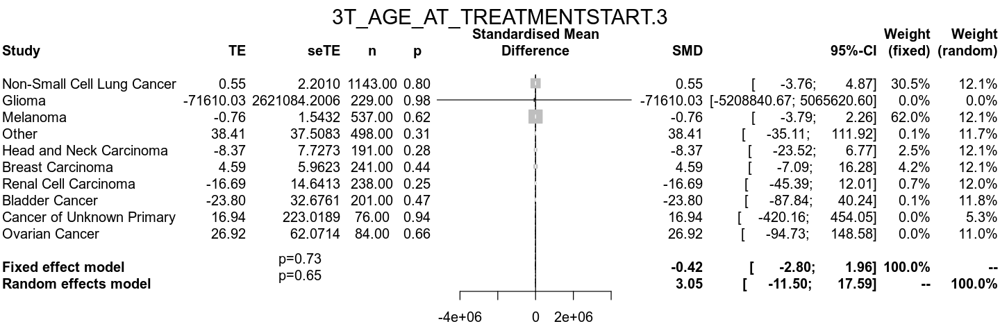

In [274]:
vie_temp <- list(trans1=c("GENDER","TREATMENT_CUM"),trans2=c("AGE_AT_TREATMENTSTART","TREATMENT_CUM","CONC_CHEMO","LINE_OF_TREATMENT","START_YEAR","GENDER"),trans3=c("AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","Tstart"))
via_temp <- c("PANEL_VERSION","PROFILE_AFTER_TREATMENT","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

options_save <- options()
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("AGE_AT_TREATMENTSTART","rs113861051_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs113861051_norm",vars_in_each = vie_temp, vars_in_all = via_temp)
options(options_save)

In [ ]:
TESTS <- names(OS)[grepl("TMB|totalCNV|^LAB_|^CNV_|^CANONICAL|^HLA_[A-Z,0-9]{1,4}_[0-9]{4}$",names(OS)) & !grepl("STAGE|ECOG",names(OS)) & !grepl("NORMAL",names(OS))]

pb <- txtProgressBar(min = 1, max = length(TESTS), style = 3)
counter <- 0

pval_df <- data.frame(lab_test=c(),pval=c())
for (l in TESTS) {
    tryCatch({
        temp <- meta_survival_interaction_AE(c(l,"rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
        temp <- temp[[1]]
        if (dim(temp)[[1]]>0) {
            for (t in 1:(dim(temp)[[1]])) {
                df_temp <- data.frame(test=temp$variables[[t]],hazard=temp$result[[t]]$TE.fixed,pval=temp$result[[t]]$pval.fixed)
                pval_df <- rbind(pval_df,df_temp)
            }
        }
        setTxtProgressBar(pb, counter)
        counter <- counter + 1
    }, 
        error=function (e) {
            print(paste("Error:",e))
            print(paste(l,"was unsuccesful"))}
    )#     temp <- meta_survival_onehot(c(l),OS_LAB)
}

pval_df_AE <- pval_df %>% mutate(transition=gsub(".*\\.([1-3])","\\1",test),test_name=gsub("(.*)\\.[1-3]","\\1",test))
pval_df_AE <- pval_df_AE %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH"))
pval_df_AE %>% filter(transition==1,grepl("3_",test)) %>% arrange(pval_adjusted,pval)

In [ ]:
pval_df_AE <- pval_df %>% mutate(transition=gsub(".*\\.([1-3])","\\1",test),test_name=gsub("(.*)\\.[1-3]","\\1",test))
pval_df_AE <- pval_df_AE %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH"))
pval_df_AE %>% filter(transition==1,grepl("3_",test)) %>% arrange(pval_adjusted,pval)

In [ ]:
pval_df_AE <- pval_df_AE %>% filter(test!="3_LAB_MEOS.1",test!="3_LAB_ANION.1",test!="3_CANONICAL_GENE_TET2.1",test!="3_LAB_SQUAM.1",test!="3_HLA_B_5501.1",test!="3_LAB_PHOS.1",test!="3_LAB_MABASO.1",test!="3_CANONICAL_GENE_EP300.1") %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH")) %>% filter(transition==1,grepl("3_",test)) %>% arrange(pval_adjusted,pval)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Colorectal Cancer was unsuccesful"


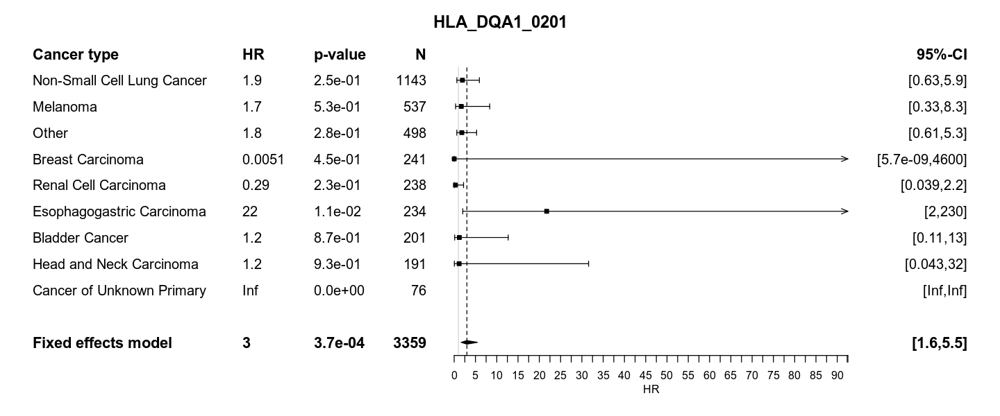

Warning message in if (is.na(xlim)) {:
“the condition has length > 1 and only the first element will be used”

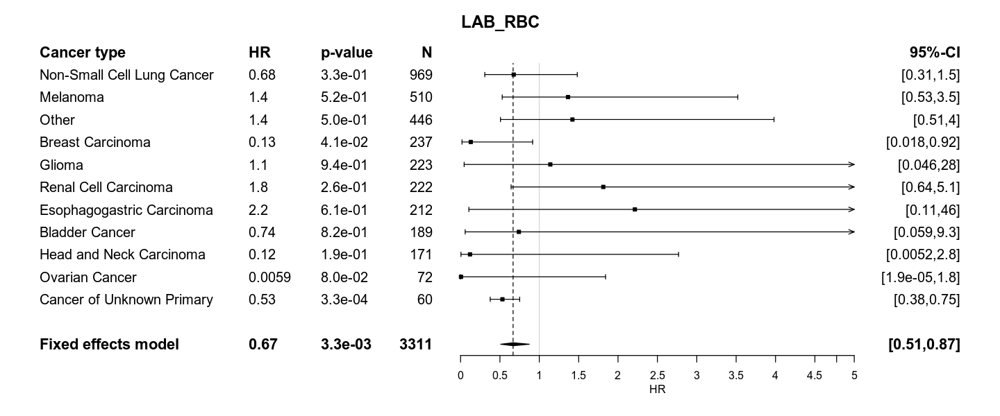

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Ovarian Cancer was unsuccesful"


Warning message in if (is.na(xlim)) {:
“the condition has length > 1 and only the first element will be used”

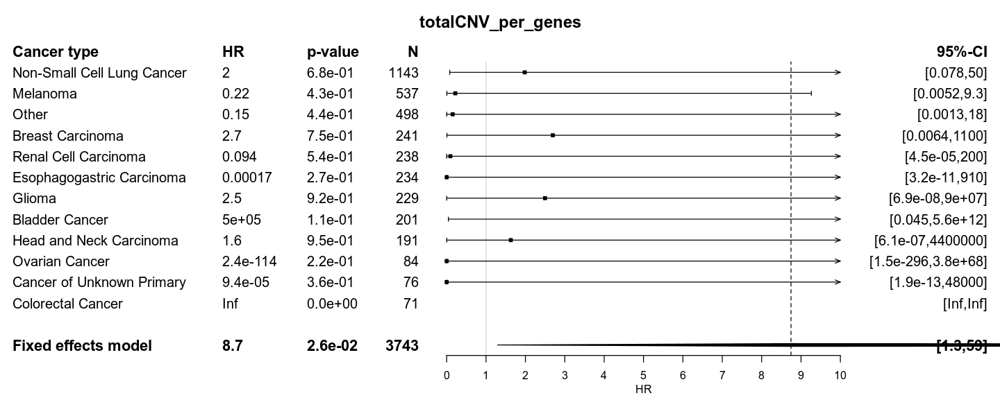

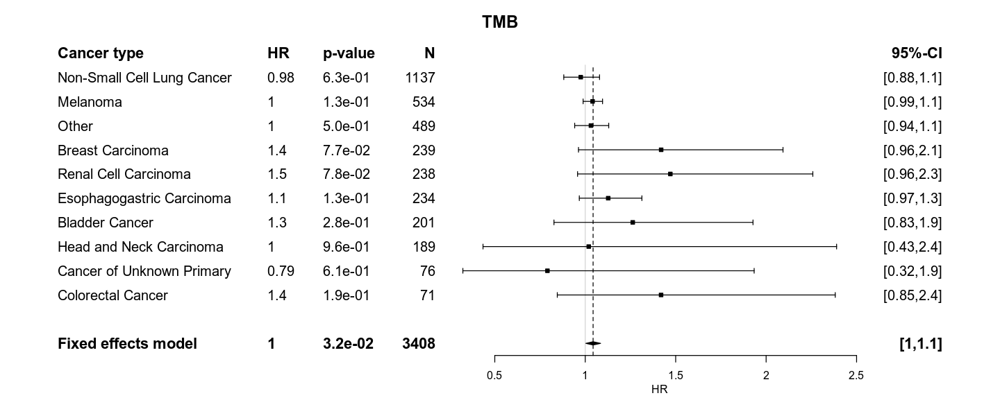

In [81]:
options(repr.plot.width=12, repr.plot.height=4)
tr <- meta_survival_interaction_AE(c("HLA_DQA1_0201","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
tr[[2]] <- tr[[2]] %>% rename(log_hr=beta,log_hr_sd=variance) %>% mutate(log_hr_sd=sqrt(log_hr_sd))
my_forest(tr,"3_HLA_DQA1_0201.1","HLA_DQA1_0201")

tr <- meta_survival_interaction_AE(c("LAB_RBC","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
tr[[2]] <- tr[[2]] %>% rename(log_hr=beta,log_hr_sd=variance) %>% mutate(log_hr_sd=sqrt(log_hr_sd))
my_forest(tr,"3_LAB_RBC.1","LAB_RBC")

tr <- meta_survival_interaction_AE(c("totalCNV_per_genes","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
tr[[2]] <- tr[[2]] %>% rename(log_hr=beta,log_hr_sd=variance) %>% mutate(log_hr_sd=sqrt(log_hr_sd))
my_forest(tr,"3_totalCNV_per_genes.1","totalCNV_per_genes",xlim=c(0,10))

tr <- meta_survival_interaction_AE(c("TMB","rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
tr[[2]] <- tr[[2]] %>% rename(log_hr=beta,log_hr_sd=variance) %>% mutate(log_hr_sd=sqrt(log_hr_sd))
my_forest(tr,"3_TMB.1","TMB",xlim=c(0,10))

In [80]:
pval_df_AE %>% filter(test!="3_LAB_MEOS.1",test!="3_LAB_ANION.1",test!="3_CANONICAL_GENE_TET2.1",test!="3_LAB_SQUAM.1",test!="3_HLA_B_5501.1",test!="3_LAB_PHOS.1",test!="3_LAB_MABASO.1",test!="3_CANONICAL_GENE_EP300.1") %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH")) %>% filter(transition==1,grepl("3_",test)) %>% arrange(pval_adjusted,pval)

test,hazard,pval,transition,test_name,pval_adjusted
<fct>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
3_HLA_DQA1_0201.1,1.09397745,0.0003747096,1,3_HLA_DQA1_0201,0.0700707
3_LAB_RBC.1,-0.40454423,0.0032599804,1,3_LAB_RBC,0.3048082
3_totalCNV_per_genes.1,2.16858843,0.0260183329,1,3_totalCNV_per_genes,0.8046754
3_TMB.1,0.04255099,0.0320691227,1,3_TMB,0.8046754
3_LAB_GLOB.1,-0.57620257,0.0328149251,1,3_LAB_GLOB,0.8046754
3_CANONICAL_GENE_ERBB4.1,2.95019608,0.0428303806,1,3_CANONICAL_GENE_ERBB4,0.8046754
3_CANONICAL_GENE_CDKN2A.1,1.20104751,0.0593599802,1,3_CANONICAL_GENE_CDKN2A,0.8046754
3_HLA_B_4403.1,0.74123116,0.0639403047,1,3_HLA_B_4403,0.8046754
3_CANONICAL_GENE_RBM10.1,1.64179896,0.0649379770,1,3_CANONICAL_GENE_RBM10,0.8046754


In [79]:
fwrite(pval_df_AE,"interaction_analysis_rs16906115.csv")

In [83]:
pval_df_AE %>% filter(grepl("HLA",test)) %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval,method="BH")) %>% arrange(pval,pval_adjusted)

test,hazard,pval,transition,test_name,pval_adjusted
<fct>,<dbl>,<dbl>,<chr>,<chr>,<dbl>
3_HLA_DQA1_0201.1,1.0939775,0.0003747096,1,3_HLA_DQA1_0201,0.02660438
3_HLA_B_4403.1,0.7412312,0.0639403047,1,3_HLA_B_4403,0.73351017
3_HLA_B_4901.1,1.2861787,0.0696984876,1,3_HLA_B_4901,0.73351017
3_HLA_C_0602.1,0.5853015,0.0736902076,1,3_HLA_C_0602,0.73351017
3_HLA_B_1501.1,-1.4288131,0.0740837172,1,3_HLA_B_1501,0.73351017
3_HLA_B_3502.1,-1.5705928,0.0764069485,1,3_HLA_B_3502,0.73351017
3_HLA_A_3001.1,17.6572870,0.0852776658,1,3_HLA_A_3001,0.73351017
3_HLA_B_5701.1,0.9054750,0.0970720070,1,3_HLA_B_5701,0.73351017
3_HLA_DQB1_0501.1,0.4446457,0.1060669863,1,3_HLA_DQB1_0501,0.73351017


stratifying over cancer types

In [14]:
meta_survival_interaction_strat_AE <- function(cov_vec_in,OS_temp,interaction_var="rs7011565_norm",transition="1|2|3",vars_in_each=vie,vars_in_all=via,vars_direct=c(),cancer_variable="CANCER_TYPE",cancer_leaveout=c(),plot=TRUE) {
    temp <- OS_temp %>% select(MRN,trans,one_of(vars_in_all)) %>% drop_na
    x <- model.matrix(as.formula(paste("~ MRN + trans + ",paste(vars_in_all,collapse=" + "),sep="")), temp)
    OS_temp <- OS_temp %>% select(-one_of(vars_in_all)) #%>% cbind(x)
    OS_temp <- merge(OS_temp,x,by=c("MRN","trans"))

    vars_trans1 <- vars_in_each$trans1
    vars_trans1 <- names(OS_temp)[grepl(paste(vars_trans1,collapse="|"),names(OS_temp)) & grepl("\\.1$",names(OS_temp))]
    vars_trans2 <- vars_in_each$trans2
    vars_trans2 <- names(OS_temp)[grepl(paste(vars_trans2,collapse="|"),names(OS_temp)) & grepl("\\.2$",names(OS_temp))]
    vars_trans3 <- vars_in_each$trans3
    vars_trans3 <- names(OS_temp)[grepl(paste(vars_trans3,collapse="|"),names(OS_temp)) & grepl("\\.3$",names(OS_temp))]

    cov_vec <- names(OS_temp)[grepl(paste("^",paste(cov_vec_in,collapse="\\.[1-3]$|^"),"\\.[1-3]$",sep=""),names(OS_temp)) & grepl(paste("\\.",transition,"$",sep=""),names(OS_temp))]
    vars_trans1 <- vars_trans1[!grepl(paste(cov_vec,collapse="|"),vars_trans1)]
    vars_trans2 <- vars_trans2[!grepl(paste(cov_vec,collapse="|"),vars_trans2)]
    vars_trans3 <- vars_trans3[!grepl(paste(cov_vec,collapse="|"),vars_trans3)]
    
    vars_in_all <- names(OS_temp)[grepl(paste(vars_in_all,collapse="|"),names(OS_temp))& !grepl("\\.[1-3]$",names(OS_temp))]
    vars_in_all <- vars_in_all[!grepl(paste(cov_vec,collapse="|"),vars_in_all)]
    
    vars_include <- c(vars_trans1,vars_trans2,vars_trans3,vars_in_all,vars_direct)
    
    OS_temp <- OS_temp %>% select(MRN,matches(cancer_variable),Tstart,Tstop,status,trans,one_of(vars_include),one_of(cov_vec)) %>% drop_na %>% filter(grepl(transition,as.character(trans)))
    
    df_hazard <- data.frame(variables=c(),log_hr=c(),log_hr_sd=c(),pval=c(),n=c(),pval_prophaz=c())
    tryCatch({
        OS_C <- OS_temp 
        if (sum(OS_C$status)>0) {
            # make formula
            fit <- find_vars_fit_int(vars_include,cov_vec,OS_C,strat_cancer = T)

            vars <- unique(unlist(lapply(cov_vec,function(x) rownames(summary(fit)$coefficients)[grepl(x,rownames(summary(fit)$coefficients))])))
            vars_interaction <- vars[grepl(":",vars)]
            for (var in vars_interaction) {
                vars <- unlist(strsplit(var,":"))
                var_nottreatment <- vars[!grepl(interaction_var,vars)]
                var_treatment <- vars[grepl(interaction_var,vars)]
                beta <- fit$coefficients[c(var_nottreatment,var_treatment,var)]
                beta <- c(beta,list(beta_diff1=sum(fit$coefficients[c(var_treatment,var)]),beta_diff2=sum(fit$coefficients[c(var_nottreatment,var)])))
                names(beta) <- c(paste("beta_1_",var_nottreatment,sep=""),paste("beta_2_",var_nottreatment,sep=""),paste("beta_3_",var_nottreatment,sep=""),paste("beta_3T_",var_nottreatment,sep=""),paste("beta_3m_",var_nottreatment,sep=""))
                variance_nottreatment <- fit$var[names(fit$coefficients)==var_nottreatment,names(fit$coefficients)==var_nottreatment]
                variance_treatment <- fit$var[names(fit$coefficients)==var_treatment,names(fit$coefficients)==var_treatment]
                variance_inter <- fit$var[names(fit$coefficients)==var,names(fit$coefficients)==var]
                variance_diff1 <- variance_treatment + variance_inter + 2*fit$var[names(fit$coefficients)==var_treatment,names(fit$coefficients)==var]
                variance_diff2 <- variance_nottreatment + variance_inter + 2*fit$var[names(fit$coefficients)==var_nottreatment,names(fit$coefficients)==var]
                variance <- list(variance_nottreatment,variance_treatment,variance_inter,variance_diff1,variance_diff2)
                names(variance) <- gsub("beta_","var_",names(beta))
                pval <- 2*pnorm(-abs(unlist(beta)/sqrt(unlist(variance))))
                names(pval) <- gsub("beta_","pval_",names(beta))
                l <- cbind(beta,variance,pval)
                temp <- data.frame(matrix(unlist(t(l)), nrow=dim(l)[1], byrow=T))
                names(temp) <- c("beta","variance","pval")
                temp[,"variables"] <- gsub("beta_","",names(beta))
                temp$n <- dim(OS_C %>% distinct(MRN))[[1]]
                df_hazard <- rbind(df_hazard,temp)
            }                           
        }
    }, 
        error=function (e) {
            print(paste("Error:",e))
            print(paste("Cancer",c,"was unsuccesful"))}
    )
    df_hazard_ret <- df_hazard
#     print(df_hazard)
    return(list(fit,df_hazard_ret))
} 

In [15]:
TESTS <- gsub("\\.1","",names(OS_GWAS)[grepl("\\.1",names(OS_GWAS)) & grepl("TMB|totalCNV|^CNV_|^CANONICAL_",names(OS_GWAS)) & !grepl("STAGE|ECOG",names(OS_GWAS)) & !grepl("NORMAL",names(OS_GWAS))])

pb <- txtProgressBar(min = 1, max = length(TESTS), style = 3)
counter <- 1

pval_df <- data.frame(variables=c(),pval=c())
for (l in TESTS) {
    tryCatch({
        temp <- meta_survival_interaction_strat_AE(c(l,"rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
        pval_df <- rbind(pval_df,temp[[2]])
        setTxtProgressBar(pb, counter)
        counter <- counter + 1
    }, 
        error=function (e) {
            print(paste("Error:",e))
            print(paste(l,"was unsuccesful"))}
    )#     temp <- meta_survival_onehot(c(l),OS_LAB)
}

pval_df_AE <- pval_df %>% mutate(transition=gsub(".*\\.([1-3])","\\1",variables),test_name=gsub("(.*)\\.[1-3]","\\1",variables))
pval_df_AE <- pval_df_AE %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval))
pval_df_AE %>% filter(transition==1,grepl("^3_",variables)) %>% arrange(pval_adjusted,pval)

  |===============================                                       |  44%[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Error: Error in paste(\"Cancer\", c, \"was unsuccesful\"): cannot coerce type 'builtin' to vector of type 'character'\n"
[1] "CNV_ID4deletion was unsuccesful"
  |======================================================================| 100%

beta,variance,pval,variables,n,transition,test_name,pval_adjusted
<dbl>,<dbl>,<dbl>,<chr>,<int>,<chr>,<chr>,<dbl>
1.7460156,0.36181508,0.003699400,3_CNV_ETV4deletion.1,1751,1,3_CNV_ETV4deletion,1
58.8848300,442.47347475,0.005120294,3_CNV_PSMD13amplification.1,887,1,3_CNV_PSMD13amplification,1
1.3310609,0.27820339,0.011616732,3_CANONICAL_GENE_PBRM1.1,1648,1,3_CANONICAL_GENE_PBRM1,1
3.1385269,1.58573640,0.012689820,3_CNV_FKBP9deletion.1,887,1,3_CNV_FKBP9deletion,1
-0.6731862,0.07782050,0.015814370,3_CNV_RAD21amplification.1,1751,1,3_CNV_RAD21amplification,1
-0.6381943,0.07073417,0.016413136,3_CNV_MYCamplification.1,1751,1,3_CNV_MYCamplification,1
-0.6492816,0.07540277,0.018054400,3_CNV_EXT1amplification.1,1751,1,3_CNV_EXT1amplification,1
0.8186813,0.12203850,0.019103355,3_CNV_TSC1deletion.1,1751,1,3_CNV_TSC1deletion,1
-1.0367158,0.20152733,0.020923290,3_CNV_RIT1amplification.1,864,1,3_CNV_RIT1amplification,1


In [16]:
TESTS <- names(OS)[grepl("^HLA_[A-Z,0-9]{1,4}_[0-9]{4}$|PRS_",names(OS)) & !grepl("STAGE|ECOG",names(OS)) & !grepl("NORMAL",names(OS))]

pb <- txtProgressBar(min = 1, max = length(TESTS), style = 3)
counter <- 1

# pval_df <- data.frame(variables=c(),pval=c())
for (l in TESTS) {
    tryCatch({
        temp <- meta_survival_interaction_strat_AE(c(l,"rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
        pval_df <- rbind(pval_df,temp[[2]])
        setTxtProgressBar(pb, counter)
        counter <- counter + 1
    }, 
        error=function (e) {
            print(paste("Error:",e))
            print(paste(l,"was unsuccesful"))}
    )#     temp <- meta_survival_onehot(c(l),OS_LAB)
}

pval_df_AE <- pval_df %>% mutate(transition=gsub(".*\\.([1-3])","\\1",variables),test_name=gsub("(.*)\\.[1-3]","\\1",variables))
pval_df_AE <- pval_df_AE %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval))
pval_df_AE %>% filter(transition==1,grepl("^3_",variables)) %>% arrange(pval_adjusted,pval)

  |======================================================================| 100%

beta,variance,pval,variables,n,transition,test_name,pval_adjusted
<dbl>,<dbl>,<dbl>,<chr>,<int>,<chr>,<chr>,<dbl>
1.7460156,3.618151e-01,0.003699400,3_CNV_ETV4deletion.1,1751,1,3_CNV_ETV4deletion,1
58.8848300,4.424735e+02,0.005120294,3_CNV_PSMD13amplification.1,887,1,3_CNV_PSMD13amplification,1
-0.2809118,1.189832e-02,0.010015437,3_PRS_PRSWEB_PHECODE201_20001.1052_PT_MGI_20200114_WEIGHTS.1,1751,1,3_PRS_PRSWEB_PHECODE201_20001.1052_PT_MGI_20200114_WEIGHTS,1
-0.3287404,1.648003e-02,0.010443436,3_PRS_BRCA.ERPOS.1,1751,1,3_PRS_BRCA.ERPOS,1
1.3310609,2.782034e-01,0.011616732,3_CANONICAL_GENE_PBRM1.1,1648,1,3_CANONICAL_GENE_PBRM1,1
0.2940000,1.364234e-02,0.011832054,3_PRS_UKB_460K.bp_SYSTOLICadjMEDz.1,1751,1,3_PRS_UKB_460K.bp_SYSTOLICadjMEDz,1
3.1385269,1.585736e+00,0.012689820,3_CNV_FKBP9deletion.1,887,1,3_CNV_FKBP9deletion,1
-0.2724886,1.252952e-02,0.014918989,3_PRS_PRSWEB_PHECODE145_UKBB.SAIGE.HRC.X145_LASSOSUM_MGI_20200114_WEIGHTS.1,1751,1,3_PRS_PRSWEB_PHECODE145_UKBB.SAIGE.HRC.X145_LASSOSUM_MGI_20200114_WEIGHTS,1
-0.6731862,7.782050e-02,0.015814370,3_CNV_RAD21amplification.1,1751,1,3_CNV_RAD21amplification,1


In [17]:
TESTS <- gsub("\\.1","",names(OS_GWAS)[grepl("\\.1",names(OS_GWAS)) & grepl("^LAB_",names(OS_GWAS)) & !grepl("STAGE|ECOG",names(OS_GWAS)) & !grepl("NORMAL",names(OS_GWAS))])
TESTS <- head(TESTS,89)

pb <- txtProgressBar(min = 1, max = length(TESTS), style = 3)
counter <- 1

# pval_df <- data.frame(variables=c(),pval=c())
for (l in TESTS) {
    tryCatch({
        temp <- meta_survival_interaction_strat_AE(c(l,"rs16906115_norm"),OS_GWAS %>% filter(before_2018==1),interaction_var = "rs16906115_norm", plot=F)
        pval_df <- rbind(pval_df,temp[[2]])
        setTxtProgressBar(pb, counter)
        counter <- counter + 1
    }, 
        error=function (e) {
            print(paste("Error:",e))
            print(paste(l,"was unsuccesful"))}
    )#     temp <- meta_survival_onehot(c(l),OS_LAB)
}

pval_df_AE <- pval_df %>% mutate(transition=gsub(".*\\.([1-3])","\\1",variables),test_name=gsub("(.*)\\.[1-3]","\\1",variables))
pval_df_AE <- pval_df_AE %>% group_by(transition) %>% mutate(pval_adjusted=p.adjust(pval))
pval_df_AE %>% filter(transition==1,grepl("^3_",variables)) %>% arrange(pval_adjusted,pval)

  |==========================================================            |  83%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Error: Error in paste(\"Cancer\", c, \"was unsuccesful\"): cannot coerce type 'builtin' to vector of type 'character'\n"
[1] "LAB_BANDS was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Error: Error in paste(\"Cancer\", c, \"was unsuccesful\"): cannot coerce type 'builtin' to vector of type 'character'\n"
[1] "LAB_CPK was unsuccesful"
  |============================================================          |  85%[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Error: Error in paste(\"Cancer\", c, \"was unsuccesful\"): cannot coerce type 'builtin' to vector of type 'character'\n"
[1] "LAB

beta,variance,pval,variables,n,transition,test_name,pval_adjusted
<dbl>,<dbl>,<dbl>,<chr>,<int>,<chr>,<chr>,<dbl>
1.7460156,3.618151e-01,0.003699400,3_CNV_ETV4deletion.1,1751,1,3_CNV_ETV4deletion,1
58.8848300,4.424735e+02,0.005120294,3_CNV_PSMD13amplification.1,887,1,3_CNV_PSMD13amplification,1
-0.2809118,1.189832e-02,0.010015437,3_PRS_PRSWEB_PHECODE201_20001.1052_PT_MGI_20200114_WEIGHTS.1,1751,1,3_PRS_PRSWEB_PHECODE201_20001.1052_PT_MGI_20200114_WEIGHTS,1
-0.3287404,1.648003e-02,0.010443436,3_PRS_BRCA.ERPOS.1,1751,1,3_PRS_BRCA.ERPOS,1
1.3310609,2.782034e-01,0.011616732,3_CANONICAL_GENE_PBRM1.1,1648,1,3_CANONICAL_GENE_PBRM1,1
0.2940000,1.364234e-02,0.011832054,3_PRS_UKB_460K.bp_SYSTOLICadjMEDz.1,1751,1,3_PRS_UKB_460K.bp_SYSTOLICadjMEDz,1
3.1385269,1.585736e+00,0.012689820,3_CNV_FKBP9deletion.1,887,1,3_CNV_FKBP9deletion,1
-0.2724886,1.252952e-02,0.014918989,3_PRS_PRSWEB_PHECODE145_UKBB.SAIGE.HRC.X145_LASSOSUM_MGI_20200114_WEIGHTS.1,1751,1,3_PRS_PRSWEB_PHECODE145_UKBB.SAIGE.HRC.X145_LASSOSUM_MGI_20200114_WEIGHTS,1
-0.6731862,7.782050e-02,0.015814370,3_CNV_RAD21amplification.1,1751,1,3_CNV_RAD21amplification,1


In [33]:
fwrite(pval_df_AE %>% filter(transition==1,grepl("^3_",variables)) %>% arrange(pval_adjusted,pval) %>% ungroup %>% filter(abs(beta)<10) %>% mutate(HR=exp(beta)) %>% select(test_name,HR,pval) %>% mutate(test_name=gsub("3_","",test_name),test_name=gsub("CNV_","",test_name),test_name=gsub("deletion"," deletion",test_name),test_name=gsub("amplification"," amplification",test_name),test_name=gsub("PRS_","PRS: ",test_name),test_name=gsub("CANONICAL_GENE_","SNV in ",test_name),test_name=gsub("LAB_","Lab value: ",test_name)),"interaction_analysis_rs16906115.csv")

## Lymphocytes over time

In [106]:
lymphs <- fread("cat ../../../OncDRS_data/ALL/OUTPT_LAB_RESULTS_LABS.csv | grep 'LYMPH'",head=F)
names(lymphs) <- names(fread("../../../OncDRS_data/ALL/OUTPT_LAB_RESULTS_LABS.csv",nrows=1))
lymphs <- lymphs %>% select(PATIENT_ID,SPECIMEN_COLLECT_DT,TEST_TYPE_CD,TEST_TYPE_DESCR,NUMERIC_RESULT,NORMAL_RANGE_DESCR)
lymphs <- inner_join(translate_pid %>% select(MRN,PATIENT_ID),lymphs) %>% select(-PATIENT_ID)
lymphs <- lymphs %>% mutate(SPECIMEN_COLLECT_DT=as.Date(SPECIMEN_COLLECT_DT,format="%d-%b-%y"))

temp <- fread("../OS/OS_ALL.csv") %>% select(MRN,START_DATE) %>% rename(SEQ_DATE=START_DATE)
dates <- full_join(full_join(fread("adverse_events_truenegcorrected.csv",na.strings="") %>% select(MRN,ADV_EVENT,ADV_EVENT_DT),OS %>% select(MRN,IO_START,LAST_DATE)),temp)

labs <- fread("../../../OncDRS_data/ALL/OUTPT_LAB_RESULTS_LABS.csv") %>% select(PATIENT_ID,SPECIMEN_COLLECT_DT,TEST_TYPE_CD,TEST_TYPE_DESCR,NUMERIC_RESULT,NORMAL_RANGE_DESCR) %>% inner_join(translate_pid %>% select(MRN,PATIENT_ID)) %>% select(-PATIENT_ID)
lab_df <- left_join(labs,dates)
lab_df <- lab_df %>% drop_na(IO_START) %>% select(MRN,one_of(names(lab_df)[names(lab_df)!="MRN"]))
lab_df <- data.table(lab_df %>% drop_na(NUMERIC_RESULT))

lymphs_IO <- inner_join(lymphs,dates) %>% filter(!is.na(IO_START),grepl("^LYMPH$|^ALYMPH$",TEST_TYPE_CD))
lymphs_IO <- lymphs_IO %>% arrange(MRN,TEST_TYPE_CD,SPECIMEN_COLLECT_DT) %>% group_by(MRN,TEST_TYPE_CD) %>% summarise(VAL_IO_before = ifelse(length(last(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))<0 & as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))>-30]))>0,last(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))<0 & as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))>-30]),NA),VAL_IO_after = ifelse(length(first(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))>0 & as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))<30]))>0,first(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))>0 & as.integer(difftime(SPECIMEN_COLLECT_DT,IO_START,unit="days"))<30]),NA)) %>% ungroup
lymphs_IO <- lymphs_IO %>% group_by(MRN,TEST_TYPE_CD) %>% gather(timepoint, value,VAL_IO_before:VAL_IO_after)

lymphs_irAE <- inner_join(lymphs,dates) %>% filter(!is.na(ADV_EVENT_DT),grepl("^LYMPH$|^ALYMPH$",TEST_TYPE_CD))
lymphs_irAE <- lymphs_irAE %>% arrange(MRN,TEST_TYPE_CD,SPECIMEN_COLLECT_DT) %>% group_by(MRN,TEST_TYPE_CD) %>% summarise(VAL_irAE_before = ifelse(length(last(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))<0 & as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))>-30]))>0,last(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))<0 & as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))>-30]),NA),VAL_irAE_after = ifelse(length(first(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))>0 & as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))<30]))>0,first(NUMERIC_RESULT[as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))>0 & as.integer(difftime(SPECIMEN_COLLECT_DT,ADV_EVENT_DT,unit="days"))<30]),NA)) %>% ungroup
lymphs_irAE <- lymphs_irAE %>% group_by(MRN,TEST_TYPE_CD) %>% gather(timepoint, value,VAL_irAE_before:VAL_irAE_after)

Joining, by = "MRN"
Joining, by = "MRN"


In [96]:
MEDICATION <- fread("cat ../../../OncDRS_data/ALL/MEDICATIONS.csv | grep -i 'PATIENT_ID\\|prednisone\\|prednisolone\\|dexamethasone'",fill=T) %>% right_join(translate_pid,by="PATIENT_ID") %>% select(MRN,NCI_PREFERRED_MED_NM,MED_START_DT,MED_END_DT,MED_ROUTE,MED_FREQUENCY,MED_DOSE_AMT,MED_DOSE_UNIT,MED_ADMIN_DT,TREATMENT_PLAN_CATEGORY,STD_CHEMO_PLAN,RESEARCH_CHEMO_PLAN,OTHER_TREATMENT_PLAN,PLAN_GOAL,MED_ADMIN_DT_SRC)
MEDICATION <- MEDICATION %>% filter(grepl("ADMINISTRATION|Activated COE",MED_ADMIN_DT_SRC))
MEDICATION <- MEDICATION %>% na_if("") %>% mutate(MED_START_DT=coalesce(MED_ADMIN_DT,MED_START_DT))
MEDICATION <- MEDICATION %>% mutate(MED_START_DT=as.Date(MED_START_DT,format="%d-%b-%y"),MED_END_DT=as.Date(MED_END_DT,format="%d-%b-%y"),MED_ADMIN_DT=as.Date(MED_ADMIN_DT,format="%d-%b-%y"))
MEDICATION <- MEDICATION %>% select(MRN,MED_START_DT,MED_END_DT,NCI_PREFERRED_MED_NM) %>% rename(CH_IO = NCI_PREFERRED_MED_NM) %>% drop_na(CH_IO)
steroids <- inner_join(MEDICATION,dates) %>% group_by(MRN) %>% summarise(steroids_irAE=any(abs(as.integer(difftime(MED_START_DT,ADV_EVENT_DT,unit="days")))< 30),steroids_ICI=any(abs(as.integer(difftime(MED_START_DT,IO_START,unit="days")))< 30))

Joining, by = "MRN"


In [107]:
lymphs_irAE <- left_join(lymphs_irAE,steroids)
lymphs_IO <- left_join(lymphs_IO,steroids)

Joining, by = "MRN"
Joining, by = "MRN"


Joining, by = "MRN"
Warning message:
“Removed 1341 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 1341 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 1341 rows containing non-finite values (stat_compare_means).”Joining, by = "MRN"
Warning message:
“Removed 1340 rows containing non-finite values (stat_ydensity).”Warning message:
“Removed 1340 rows containing non-finite values (stat_boxplot).”Warning message:
“Removed 1340 rows containing non-finite values (stat_compare_means).”

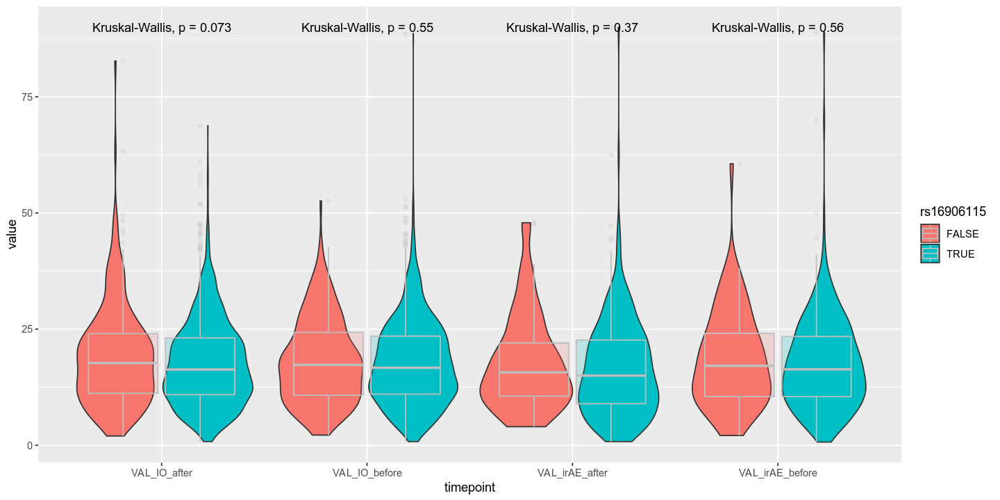

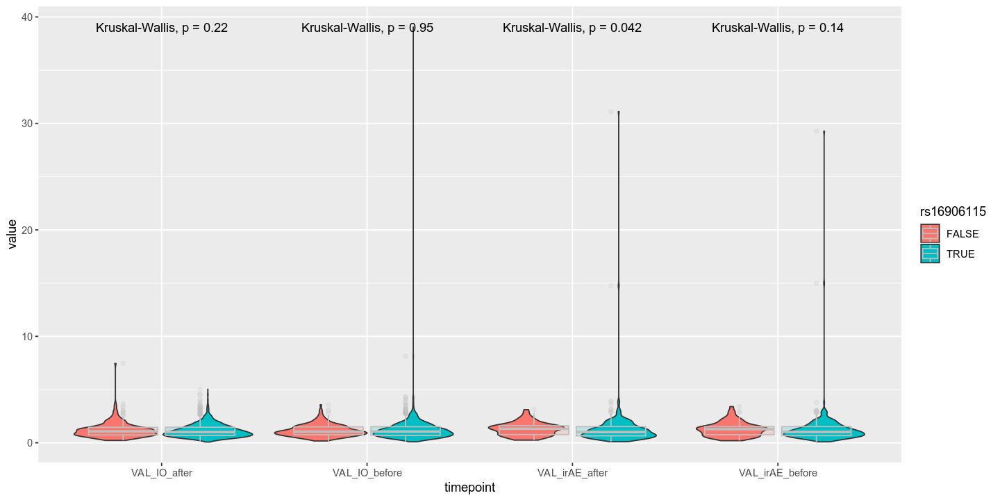

In [108]:
options(repr.plot.width=12, repr.plot.height=6)
inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% filter(TEST_TYPE_CD=="LYMPH") %>% mutate(rs16906115=as.factor(rs16906115>decision_boundary)) %>% ggplot(.,aes(x=timepoint,y=value,fill=rs16906115)) + geom_violin() + geom_boxplot(color="grey", alpha=0.2) + stat_compare_means()
inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% filter(TEST_TYPE_CD=="ALYMPH") %>% mutate(rs16906115=as.factor(rs16906115>decision_boundary)) %>% ggplot(.,aes(x=timepoint,y=value,fill=rs16906115)) + geom_violin() + geom_boxplot(color="grey", alpha=0.2) + stat_compare_means()

Joining, by = "MRN"


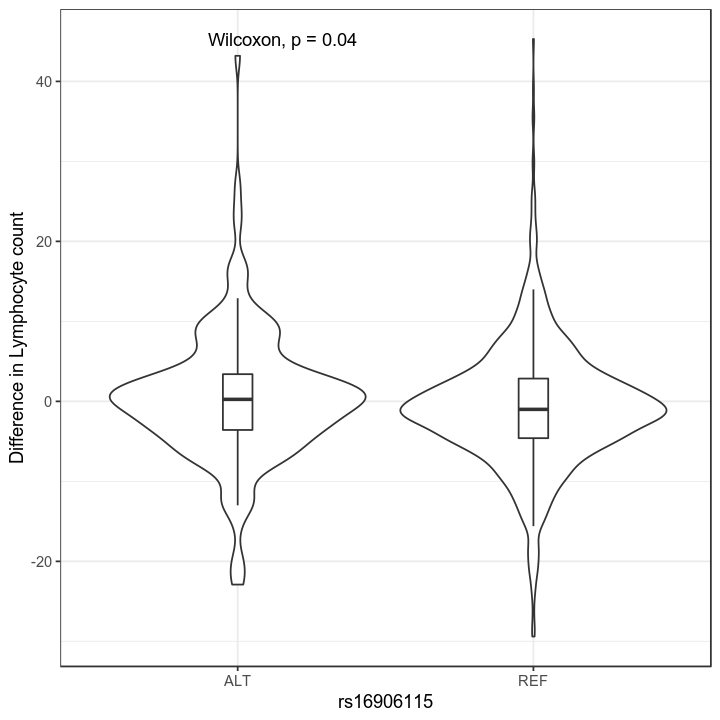

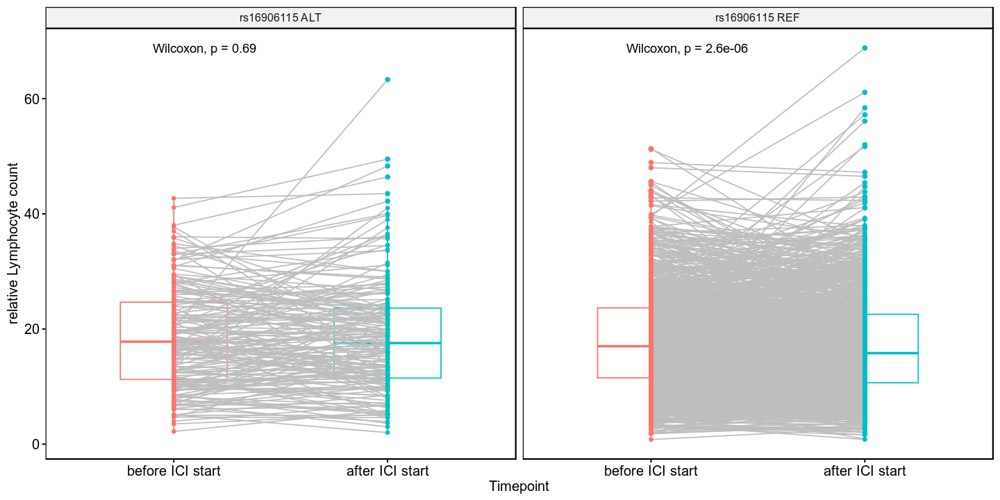

In [109]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

options(repr.plot.width=6, repr.plot.height=6)
dodge <- position_dodge(width = 0.4)
# temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ungroup %>% mutate(SNP_8_79712998=ifelse(SNP_8_79712998==2,"REF","ALT")) %>% ggplot(.,aes(x=SNP_8_79712998,y=diff)) + geom_violin(position = dodge) + geom_boxplot(width=.1, outlier.colour=NA, position = dodge) + stat_compare_means() + theme_bw() + ylab("Difference in Lymphocyte count") + xlab("rs16906115")
temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"ALT","REF"))) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_violin(position = dodge) + geom_boxplot(width=.1, outlier.colour=NA, position = dodge) + stat_compare_means() + theme_bw() + ylab("Difference in Lymphocyte count") + xlab("rs16906115")

options(repr.plot.width=12, repr.plot.height=6)
temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

Joining, by = "MRN"
Joining, by = "MRN"
Joining, by = "MRN"


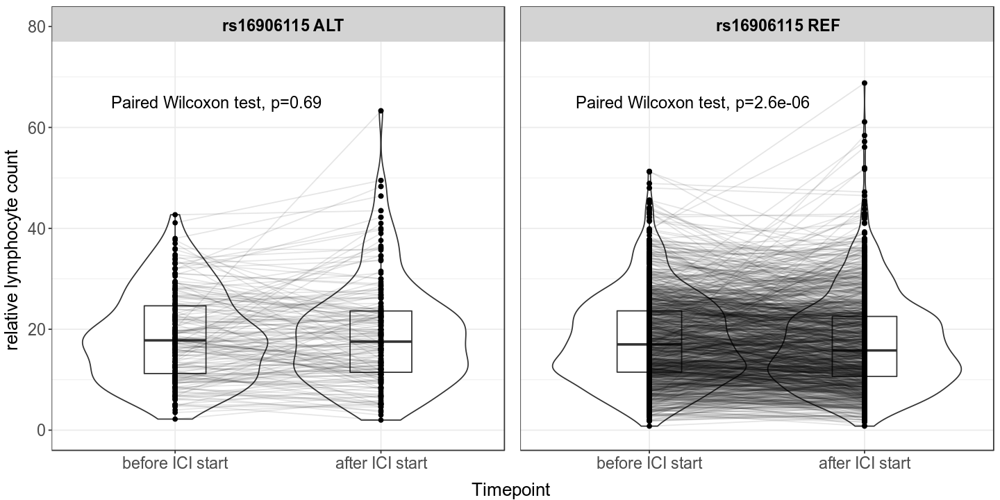

In [100]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))

before <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="before ICI start") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="after ICI start") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p1 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=77,ymax=85,fill="light gray") +
  geom_point() +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,80) + 
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before ICI start", "after"="after ICI start")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text.y=element_blank(),axis.ticks.y=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=65, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

before <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="before ICI start") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="after ICI start") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p2 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=77,ymax=85,fill="light gray") + 
  geom_point() + ylab("relative lymphocyte count") +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,80) +
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before ICI start", "after"="after ICI start")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=65, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

options(repr.plot.width=12, repr.plot.height=6)
figure <- ggarrange(p2, p1, nrow = 1, labels = c("rs16906115 ALT","rs16906115 REF"), vjust = 2.5, hjust=-1.65)
annotate_figure(figure, left = textGrob("relative lymphocyte count", rot = 90, vjust = 0.5, gp = gpar(cex = 1.3)),bottom = textGrob("Timepoint", gp = gpar(cex = 1.3)))

In [101]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

res <- wilcox.test(diff ~ rs16906115, data = temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) , conf.int=T)
res

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))

res <- wilcox.test(value ~ timepoint, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T)
res
res <- wilcox.test(value ~ timepoint, data = temp %>% filter(rs16906115=="rs16906115 ALT"), paired = TRUE, conf.int=T)
res

Joining, by = "MRN"



	Wilcoxon rank sum test with continuity correction

data:  diff by rs16906115
W = 97337, p-value = 0.03975
alternative hypothesis: true location shift is not equal to 0
95 percent confidence interval:
 -2.000049e+00 -1.782185e-05
sample estimates:
difference in location 
             -1.099993 



	Wilcoxon signed rank test with continuity correction

data:  value by timepoint
V = 292310, p-value = 2.587e-06
alternative hypothesis: true location shift is not equal to 0
95 percent confidence interval:
 -1.2500064 -0.5000495
sample estimates:
(pseudo)median 
    -0.8999255 



	Wilcoxon signed rank test with continuity correction

data:  value by timepoint
V = 8330, p-value = 0.6925
alternative hypothesis: true location shift is not equal to 0
95 percent confidence interval:
 -0.7999583  1.1500475
sample estimates:
(pseudo)median 
     0.2000645 


In [353]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115_norm=as.factor(rs16906115 <= decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp %>% group_by(steroids_ICI) %>% count

Joining, by = "MRN"


steroids_ICI,n
<lgl>,<int>
FALSE,2458
TRUE,1172
NA,948


Joining, by = "MRN"


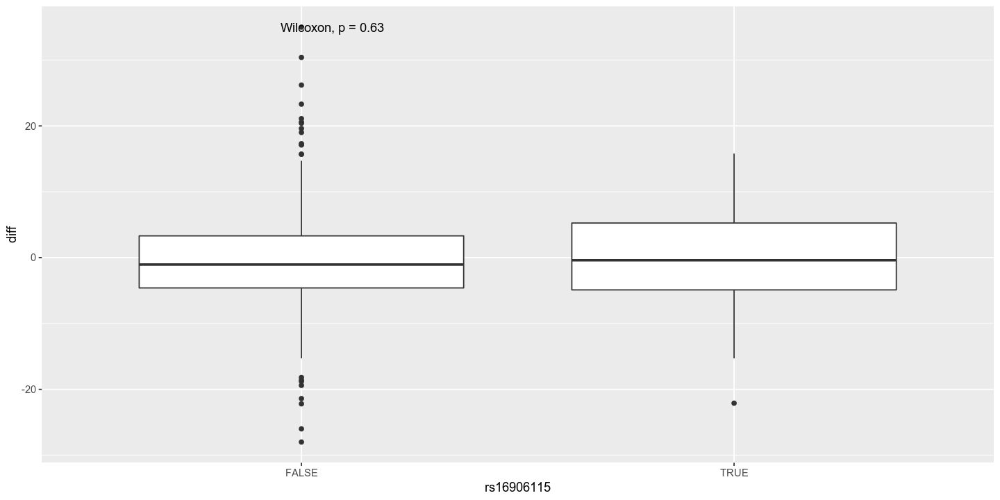

Joining, by = "MRN"


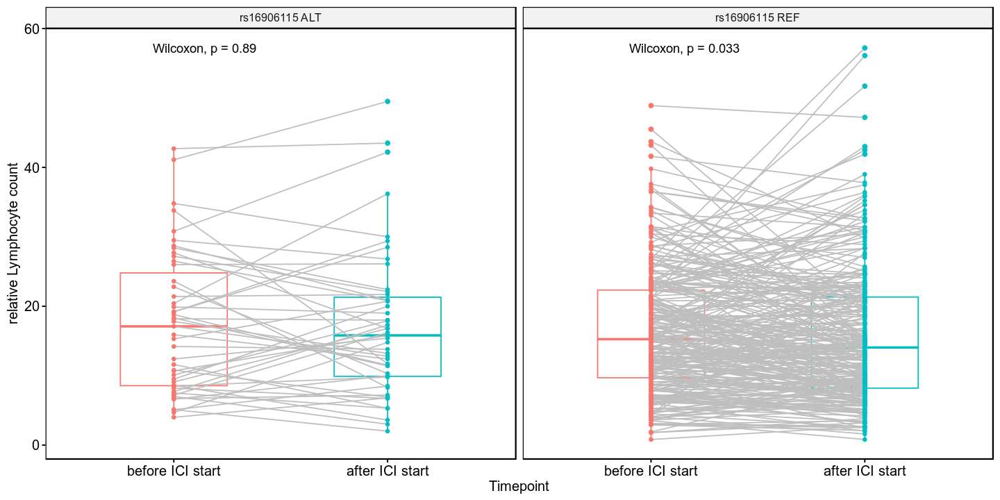

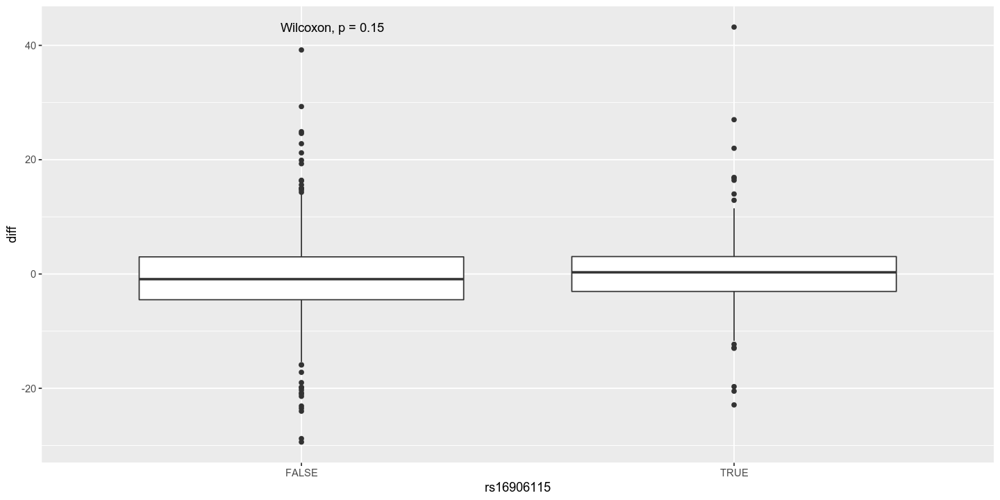

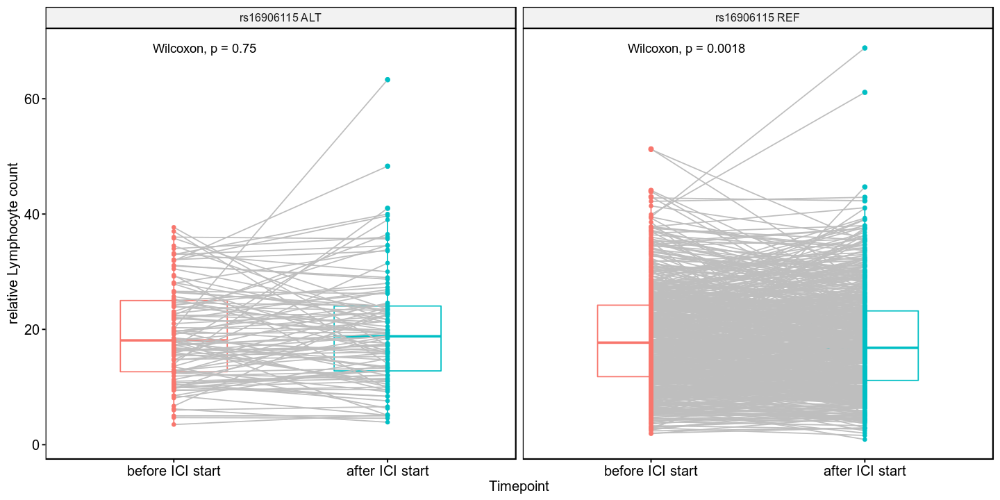

In [354]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% filter(steroids_ICI==T)
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_boxplot() + stat_compare_means()

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% filter(steroids_ICI==F)
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_boxplot() + stat_compare_means()

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

Joining, by = "MRN"


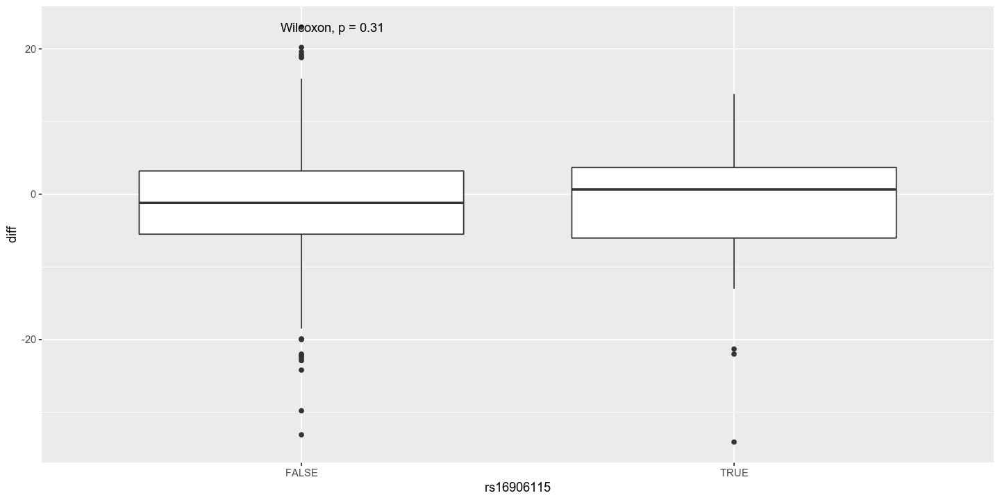

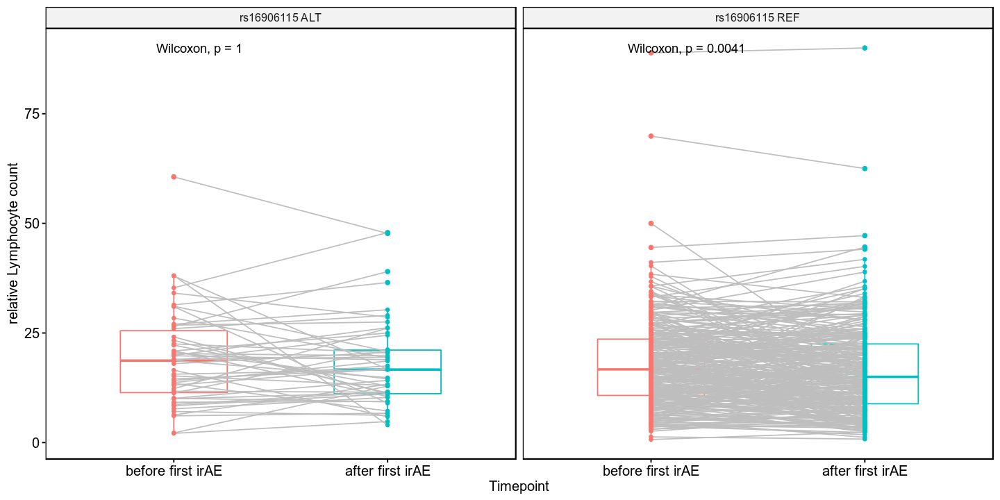

In [355]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_irAE_after-VAL_irAE_before) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_boxplot() + stat_compare_means()

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

Joining, by = "MRN"
Joining, by = "MRN"
Joining, by = "MRN"


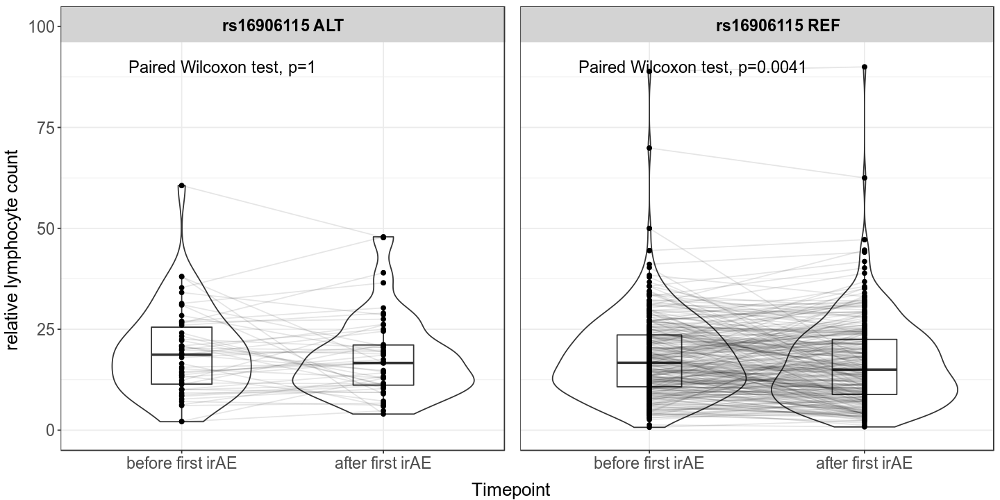

In [164]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))

before <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="before first irAE") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="after first irAE") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p1 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=96,ymax=105,fill="light gray") +
  geom_point() +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,100) + 
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before first irAE", "after"="after first irAE")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text.y=element_blank(),axis.ticks.y=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=90, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

before <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="before first irAE") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="after first irAE") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p2 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=96,ymax=105,fill="light gray") + 
  geom_point() + ylab("relative lymphocyte count") +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,100) +
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before first irAE", "after"="after first irAE")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=90, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

options(repr.plot.width=12, repr.plot.height=6)
figure <- ggarrange(p2, p1, nrow = 1, labels = c("rs16906115 ALT","rs16906115 REF"), vjust = 2.5, hjust=-1.65)
annotate_figure(figure, left = textGrob("relative lymphocyte count", rot = 90, vjust = 0.5, gp = gpar(cex = 1.3)),bottom = textGrob("Timepoint", gp = gpar(cex = 1.3)))

Joining, by = "MRN"


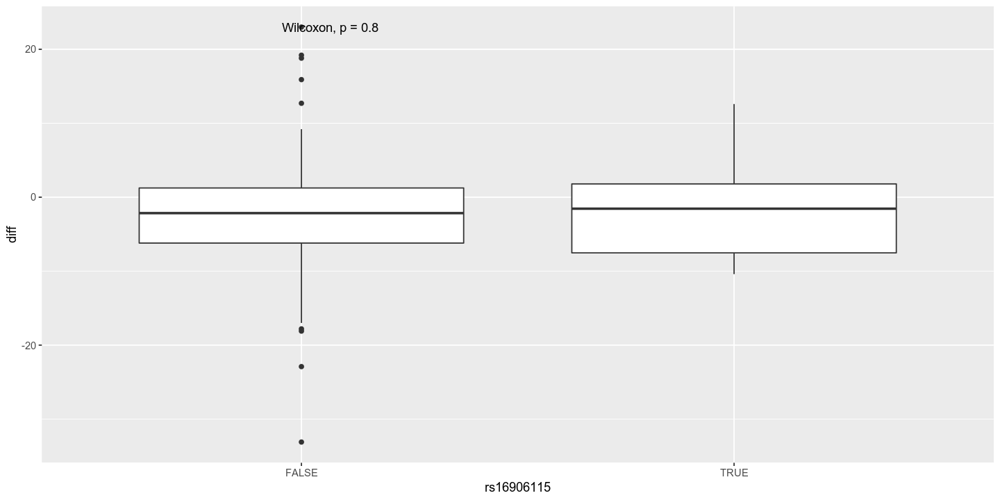

Joining, by = "MRN"


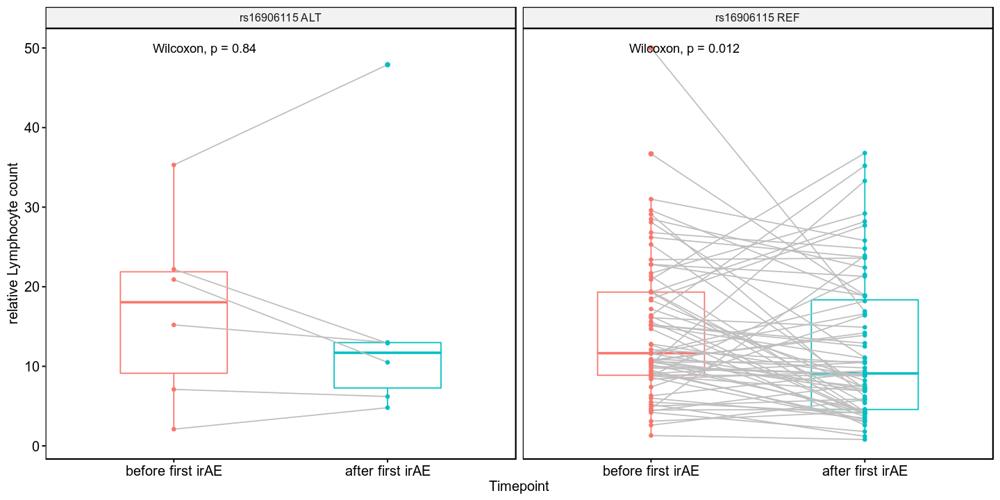

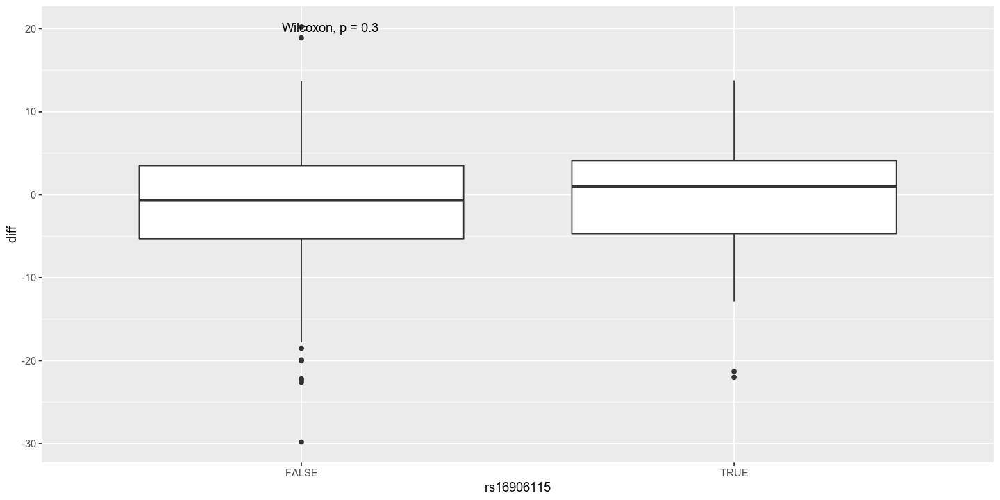

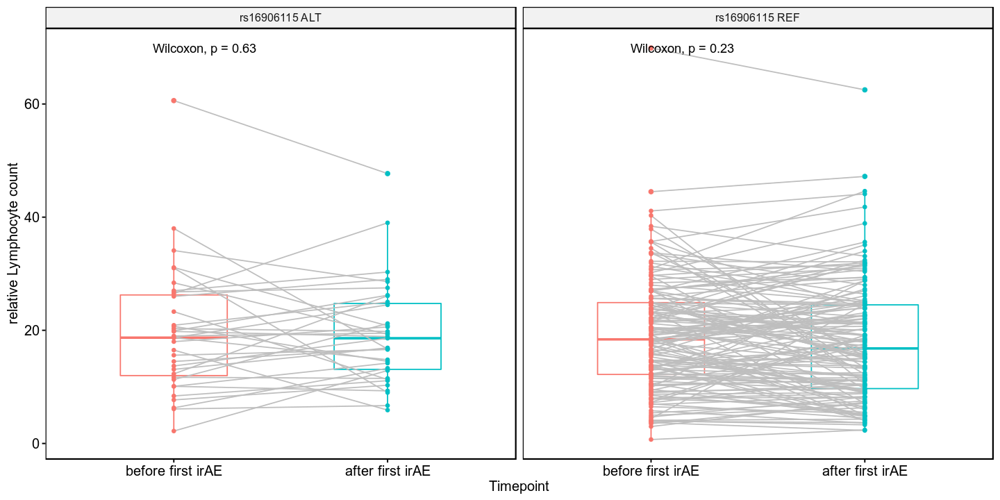

In [356]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% filter(steroids_irAE==T)
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_irAE_after-VAL_irAE_before) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_boxplot() + stat_compare_means()

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% filter(steroids_irAE==F)
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_irAE_after-VAL_irAE_before) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_boxplot() + stat_compare_means()

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

Joining, by = "MRN"
Joining, by = "MRN"
Joining, by = "MRN"


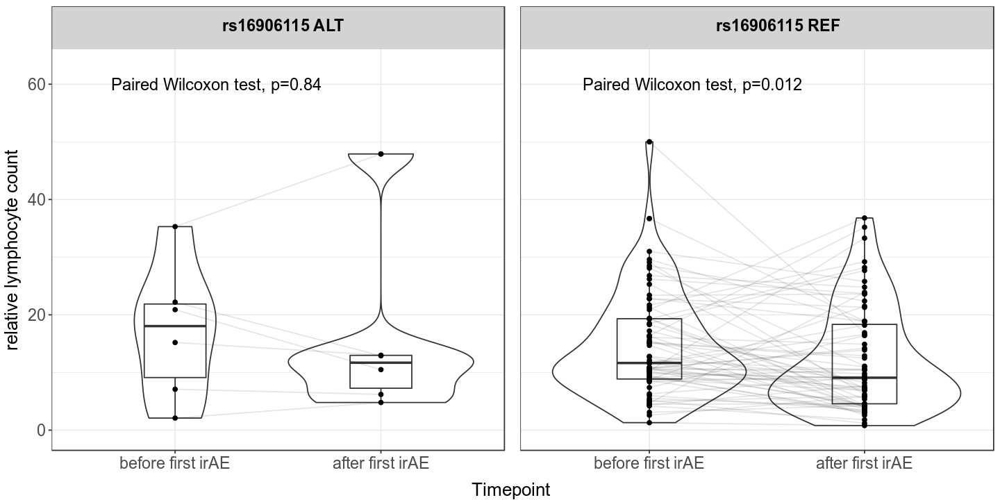

In [165]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% filter(steroids_irAE==T)
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))

before <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="before first irAE") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="after first irAE") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p1 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=66,ymax=75,fill="light gray") +
  geom_point() +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,70) + 
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before first irAE", "after"="after first irAE")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text.y=element_blank(),axis.ticks.y=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=60, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

before <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="before first irAE") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="after first irAE") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p2 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=66,ymax=75,fill="light gray") + 
  geom_point() + ylab("relative lymphocyte count") +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,70) +
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before first irAE", "after"="after first irAE")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=60, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

options(repr.plot.width=12, repr.plot.height=6)
figure <- ggarrange(p2, p1, nrow = 1, labels = c("rs16906115 ALT","rs16906115 REF"), vjust = 2.5, hjust=-1.65)
annotate_figure(figure, left = textGrob("relative lymphocyte count", rot = 90, vjust = 0.5, gp = gpar(cex = 1.3)),bottom = textGrob("Timepoint", gp = gpar(cex = 1.3)))

Joining, by = "MRN"
Joining, by = "MRN"
Joining, by = "MRN"
Warning message in wilcox.test.default(tmp$before, tmp$after, data = temp %>% filter(rs16906115 == :
“cannot compute exact p-value with ties”Warning message in wilcox.test.default(tmp$before, tmp$after, data = temp %>% filter(rs16906115 == :
“cannot compute exact confidence interval with ties”

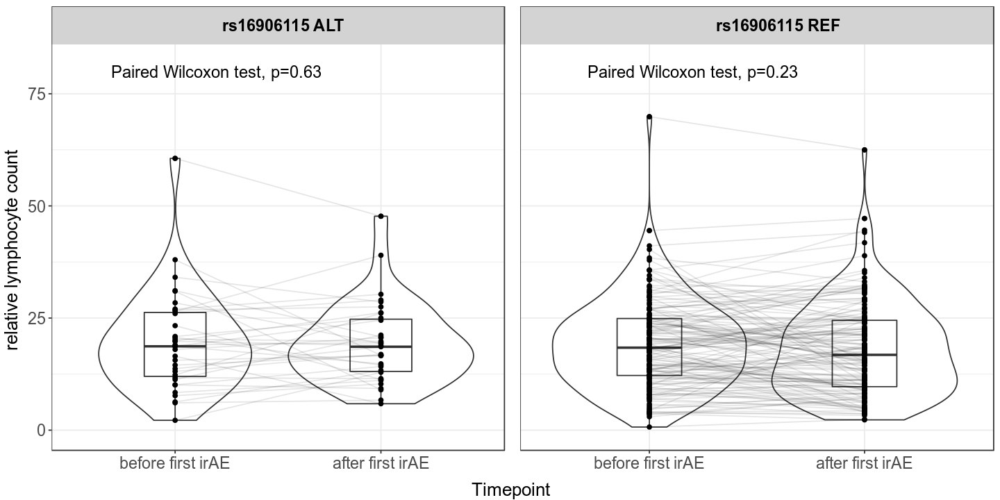

In [166]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% filter(steroids_irAE==F)
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))
temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))

before <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="before first irAE") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 REF",timepoint=="after first irAE") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p1 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=86,ymax=95,fill="light gray") +
  geom_point() +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,90) + 
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before first irAE", "after"="after first irAE")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text.y=element_blank(),axis.ticks.y=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=80, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

before <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="before first irAE") %>% select(MRN,value) %>% rename(before=value)
after <- temp %>% filter(rs16906115=="rs16906115 ALT",timepoint=="after first irAE") %>% select(MRN,value) %>% rename(after=value)
tmp <- inner_join(before,after)

d <- data.frame(before = tmp$before, after = tmp$after)
d$obs <- 1:nrow(d)
d2 <- tidyr::gather(d, time, value, -obs)

wres <- wilcox.test(tmp$before,tmp$after, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T) 

p2 <- ggplot(d2, aes(time, value)) + 
  geom_violin() + geom_boxplot(width=0.3) + geom_rect(xmin=0,xmax=3,ymin=86,ymax=95,fill="light gray") + 
  geom_point() + ylab("relative lymphocyte count") +
  geom_line(aes(group = obs),alpha=0.1) + ylim(0,90) +
  scale_x_discrete(limits = c('before', 'after'), labels=c('before'="before first irAE", "after"="after first irAE")) + theme_bw() + theme(axis.title.y=element_blank(),axis.title.x=element_blank(),axis.text=element_text(size=14)) + annotate(geom="text", x=1.2, y=80, label=paste0("Paired Wilcoxon test, p=",signif(wres$p.value,2)),size=5)

options(repr.plot.width=12, repr.plot.height=6)
figure <- ggarrange(p2, p1, nrow = 1, labels = c("rs16906115 ALT","rs16906115 REF"), vjust = 2.5, hjust=-1.65)
annotate_figure(figure, left = textGrob("relative lymphocyte count", rot = 90, vjust = 0.5, gp = gpar(cex = 1.3)),bottom = textGrob("Timepoint", gp = gpar(cex = 1.3)))

In [304]:
temp

MRN,rs16906115,TEST_TYPE_CD,timepoint,value,steroids_irAE,steroids_ICI
<dbl>,<fct>,<chr>,<chr>,<dbl>,<lgl>,<lgl>
148834,rs16906115 REF,LYMPH,before first irAE,12.3,FALSE,FALSE
184883,rs16906115 REF,LYMPH,before first irAE,20.0,FALSE,FALSE
192074,rs16906115 REF,LYMPH,before first irAE,10.5,FALSE,TRUE
199176,rs16906115 REF,LYMPH,before first irAE,8.0,FALSE,FALSE
203953,rs16906115 REF,LYMPH,before first irAE,27.1,FALSE,TRUE
264491,rs16906115 ALT,LYMPH,before first irAE,13.1,FALSE,FALSE
313704,rs16906115 REF,LYMPH,before first irAE,32.2,FALSE,FALSE
329377,rs16906115 REF,LYMPH,before first irAE,16.7,FALSE,FALSE
351488,rs16906115 REF,LYMPH,before first irAE,69.9,FALSE,FALSE


Joining, by = "MRN"


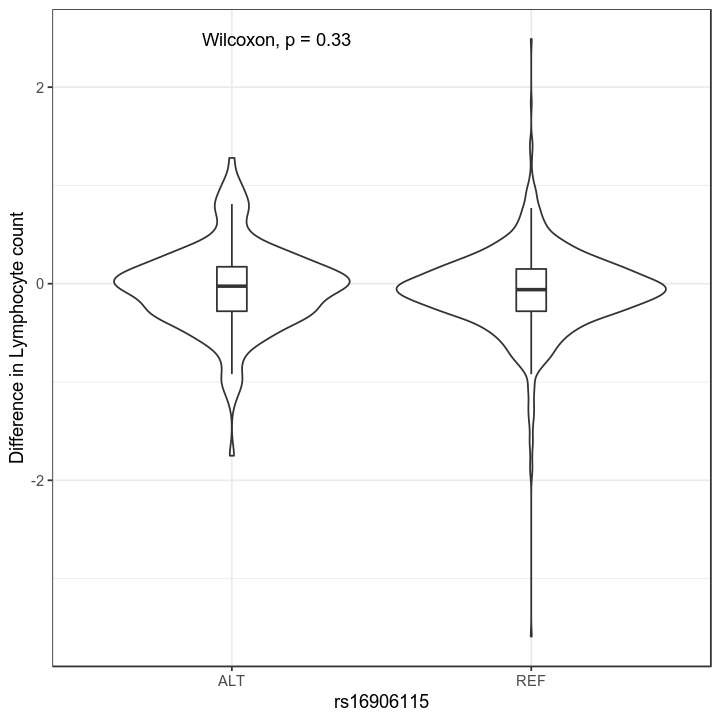

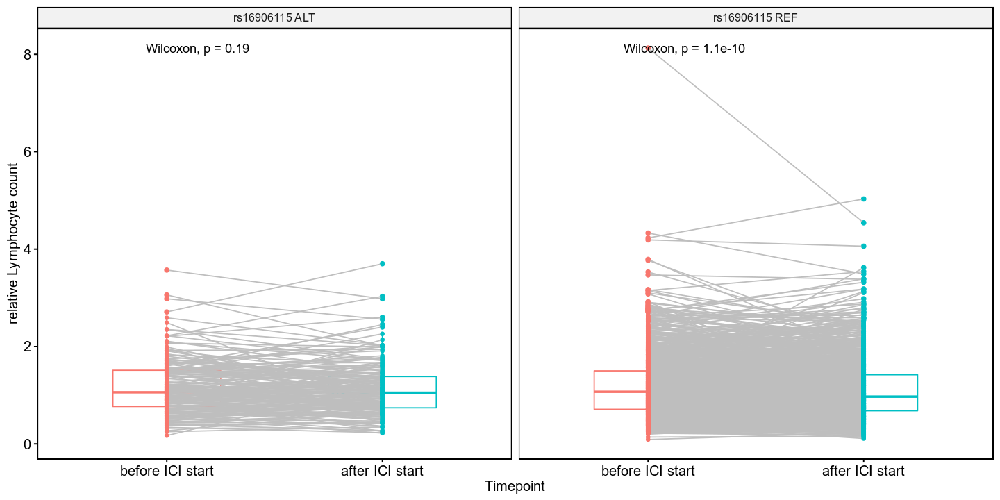

In [384]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="ALYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

options(repr.plot.width=6, repr.plot.height=6)
dodge <- position_dodge(width = 0.4)
# temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ungroup %>% mutate(SNP_8_79712998=ifelse(SNP_8_79712998==2,"REF","ALT")) %>% ggplot(.,aes(x=SNP_8_79712998,y=diff)) + geom_violin(position = dodge) + geom_boxplot(width=.1, outlier.colour=NA, position = dodge) + stat_compare_means() + theme_bw() + ylab("Difference in Lymphocyte count") + xlab("rs16906115")
temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"ALT","REF"))) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_violin(position = dodge) + geom_boxplot(width=.1, outlier.colour=NA, position = dodge) + stat_compare_means() + theme_bw() + ylab("Difference in Lymphocyte count") + xlab("rs16906115")

options(repr.plot.width=12, repr.plot.height=6)
temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="relative Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

In [385]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="ALYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

res <- wilcox.test(diff ~ rs16906115, data = temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) , conf.int=T)
res

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"rs16906115 ALT","rs16906115 REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_IO_before","before ICI start","after ICI start"))

res <- wilcox.test(value ~ timepoint, data = temp %>% filter(rs16906115=="rs16906115 REF"), paired = TRUE, conf.int=T)
res
res <- wilcox.test(value ~ timepoint, data = temp %>% filter(rs16906115=="rs16906115 ALT"), paired = TRUE, conf.int=T)
res

Joining, by = "MRN"



	Wilcoxon rank sum test with continuity correction

data:  diff by rs16906115
W = 102790, p-value = 0.3296
alternative hypothesis: true location shift is not equal to 0
95 percent confidence interval:
 -0.08001344  0.02999335
sample estimates:
difference in location 
           -0.02996686 



	Wilcoxon signed rank test with continuity correction

data:  value by timepoint
V = 274260, p-value = 1.055e-10
alternative hypothesis: true location shift is not equal to 0
95 percent confidence interval:
 -0.08502770 -0.04502482
sample estimates:
(pseudo)median 
   -0.06505702 



	Wilcoxon signed rank test with continuity correction

data:  value by timepoint
V = 6982, p-value = 0.1903
alternative hypothesis: true location shift is not equal to 0
95 percent confidence interval:
 -0.09994390  0.01992435
sample estimates:
(pseudo)median 
   -0.03997574 


Joining, by = "MRN"


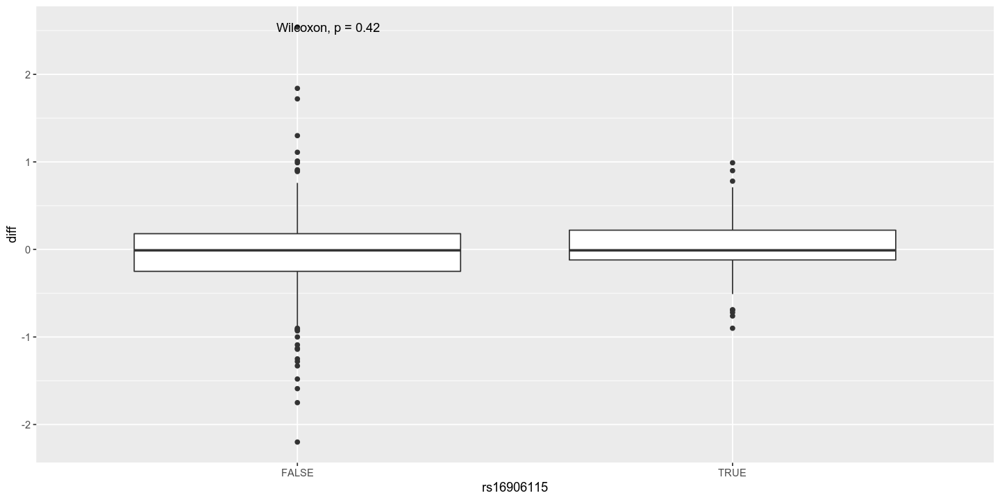

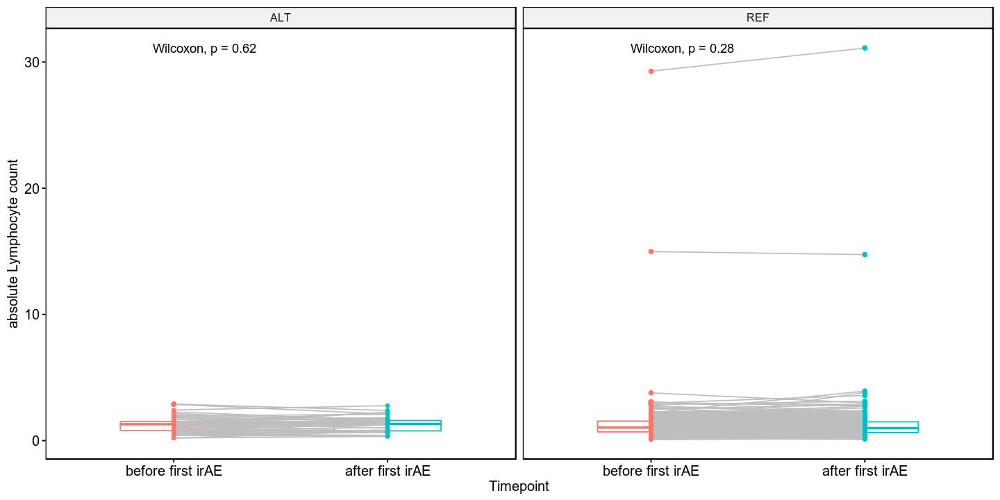

In [359]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="ALYMPH",timepoint!="VAL_IO_before",timepoint!="VAL_IO_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_irAE_after-VAL_irAE_before) %>% ggplot(.,aes(x=rs16906115,y=diff)) + geom_boxplot() + stat_compare_means()

temp <- temp %>% arrange(desc(timepoint)) %>% ungroup %>% mutate(rs16906115 = as.character(rs16906115),rs16906115 = as.factor(ifelse(rs16906115,"ALT","REF"))) %>% rename(rs16906115=rs16906115) %>% mutate(timepoint=ifelse(timepoint=="VAL_irAE_before","before first irAE","after first irAE"))
ggpaired(temp, x = "timepoint", y = "value", color="timepoint", facet.by = "rs16906115", line.color = "gray", xlab="Timepoint",ylab="absolute Lymphocyte count") + stat_compare_means(method="wilcox.test",paired = T) + theme(legend.position="none")

Joining, by = "MRN"


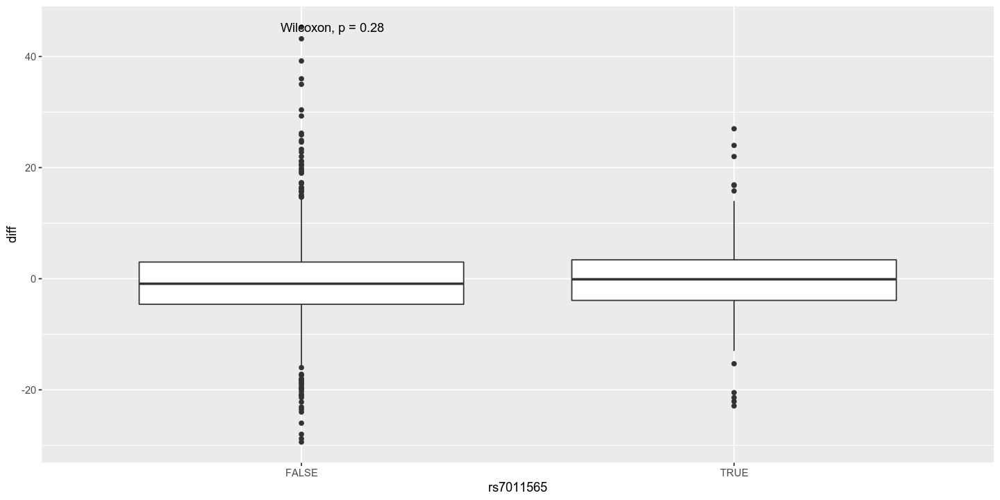

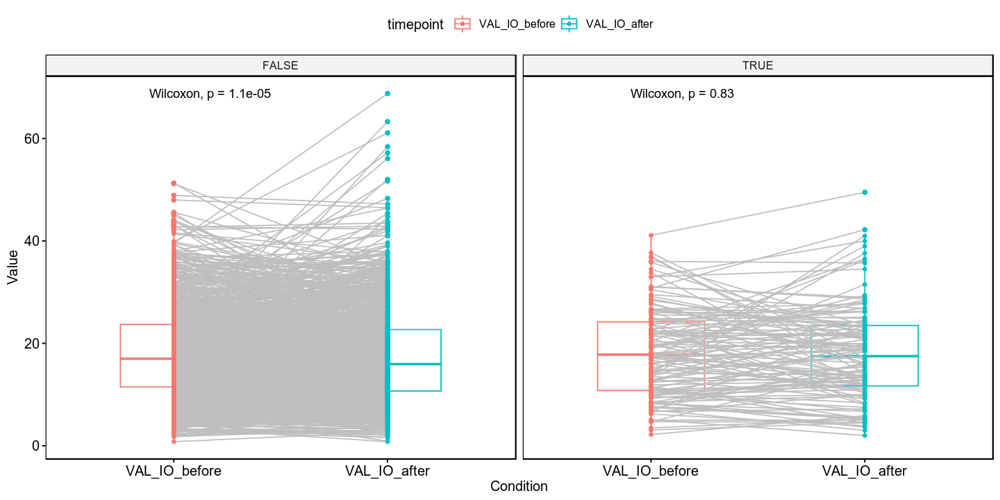

In [360]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs7011565) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs7011565=as.factor(rs7011565 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs7011565) %>% filter(!any(is.na(value)))

temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before) %>% ggplot(.,aes(x=rs7011565,y=diff)) + geom_boxplot() + stat_compare_means()

ggpaired(temp %>% arrange(desc(timepoint)), x = "timepoint", y = "value", color="timepoint", facet.by = "rs7011565", line.color = "gray") + stat_compare_means(method="wilcox.test",paired = T)

Joining, by = "MRN"


$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  463  1491      646           2600
  AE                0    0   258      277            535
  Death             0    0     0     1749           1749

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1780769 0.5734615 0.2484615
  AE        0.0000000 0.0000000 0.4822430 0.5177570
  Death     0.0000000 0.0000000 0.0000000 1.0000000

NULL
NULL
NULL


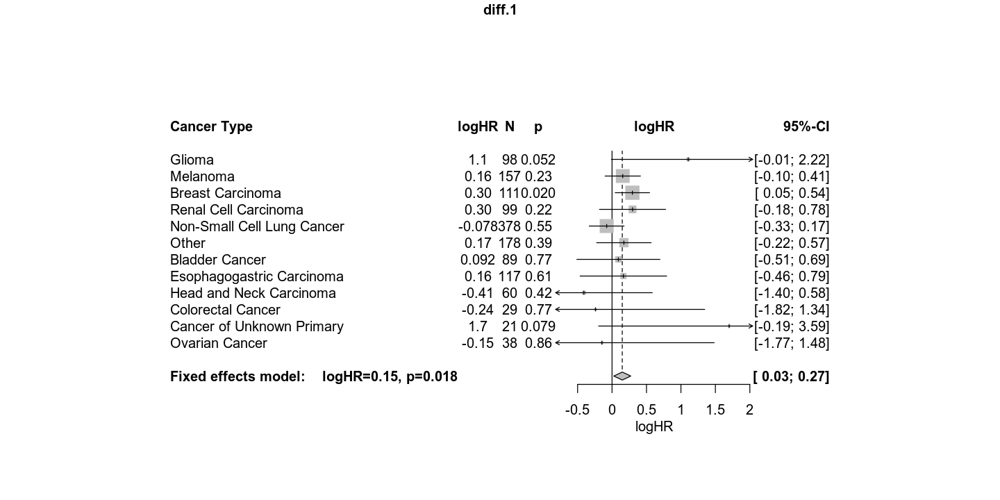

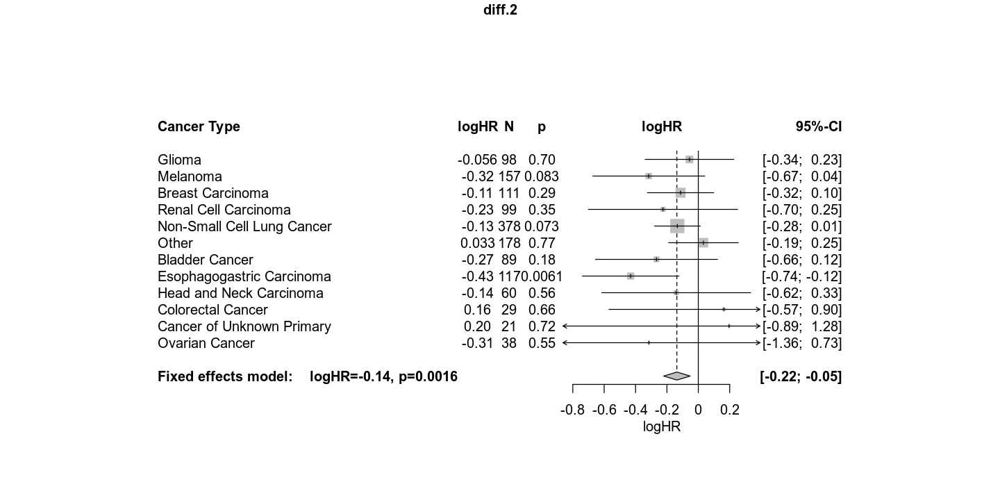

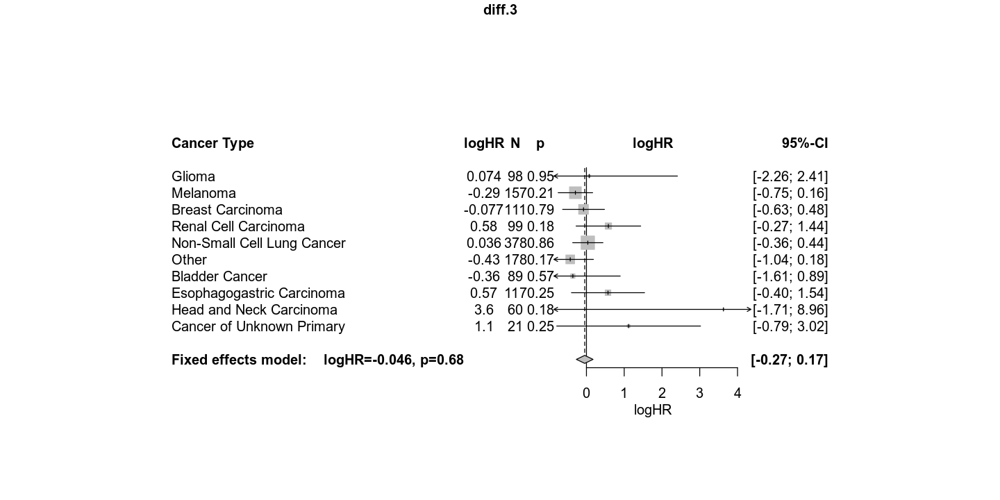

In [110]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))
temp <- left_join(OS,temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before), by="MRN")
temp$diff <- scale(temp$diff)
temp <- make_multistate(temp)
tr <- meta_survival_AE("diff",temp)

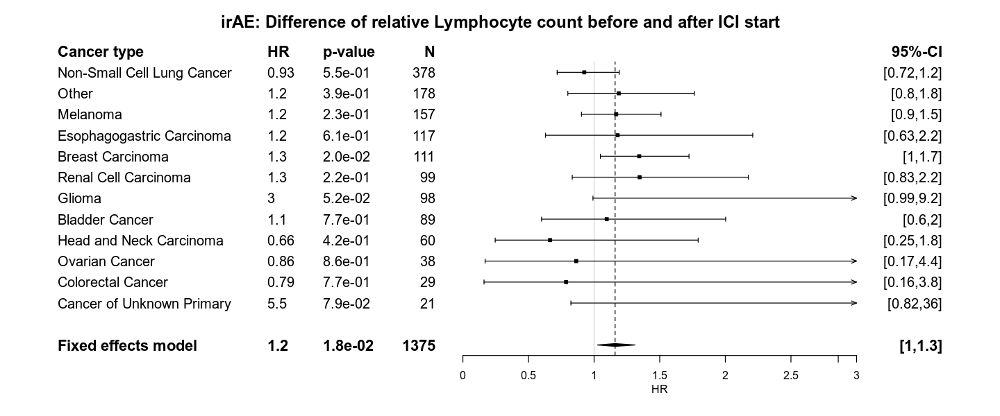

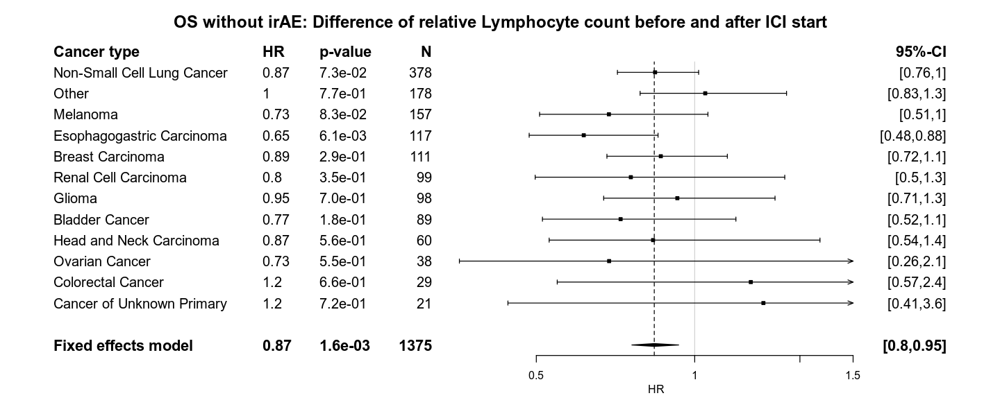

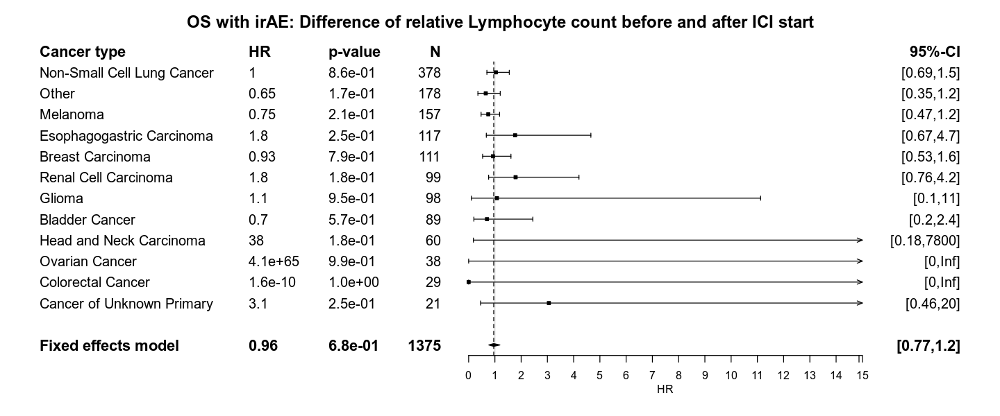

In [111]:
my_forest(tr,"diff.1","irAE: Difference of relative Lymphocyte count before and after ICI start")
my_forest(tr,"diff.2","OS without irAE: Difference of relative Lymphocyte count before and after ICI start")
my_forest(tr,"diff.3","OS with irAE: Difference of relative Lymphocyte count before and after ICI start")

Joining, by = "MRN"


NULL


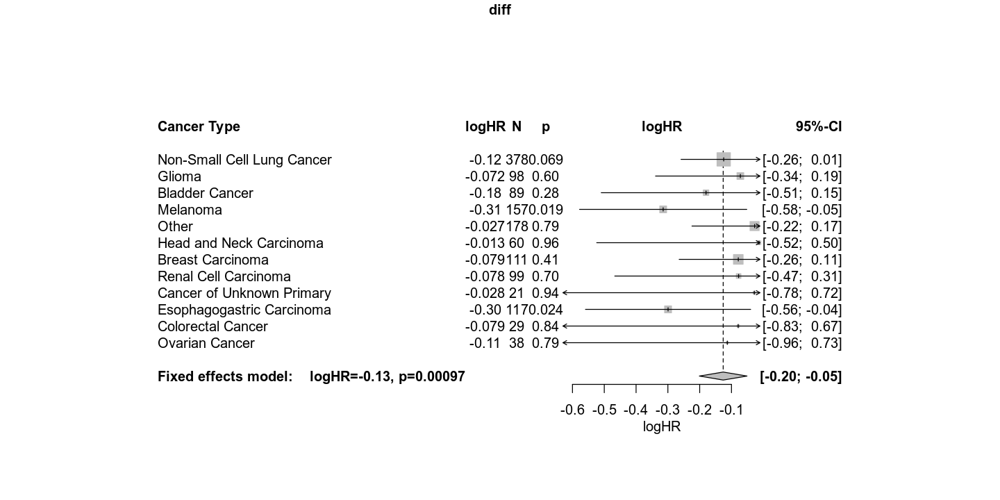

In [104]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="LYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))
temp <- left_join(OS,temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before), by="MRN")
temp$diff <- scale(temp$diff)

tr <- meta_survival_onehot("diff",temp)

Joining, by = "MRN"


$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  463  1491      646           2600
  AE                0    0   258      277            535
  Death             0    0     0     1749           1749

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1780769 0.5734615 0.2484615
  AE        0.0000000 0.0000000 0.4822430 0.5177570
  Death     0.0000000 0.0000000 0.0000000 1.0000000

NULL
NULL
NULL


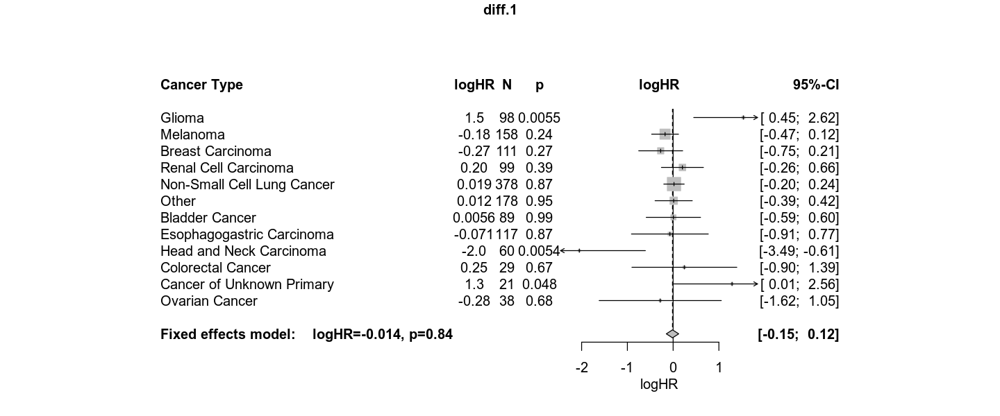

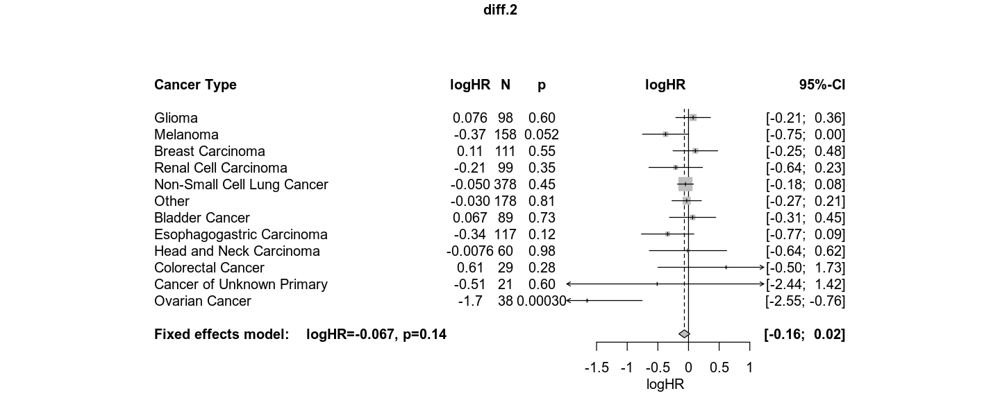

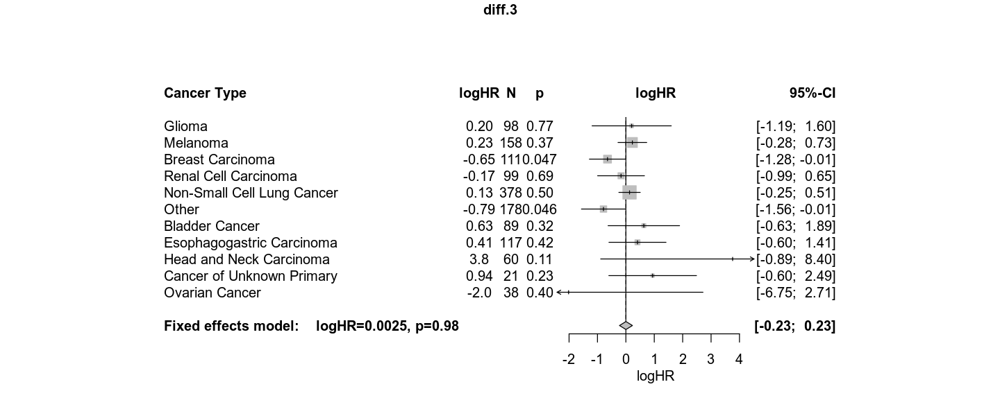

In [363]:
temp <- inner_join(OS_GWAS %>% select(MRN,rs16906115) %>% distinct,rbind(lymphs_IO,lymphs_irAE)) %>% mutate(rs16906115=as.factor(rs16906115 < decision_boundary)) %>% filter(TEST_TYPE_CD=="ALYMPH",timepoint!="VAL_irAE_before",timepoint!="VAL_irAE_after")
temp <- temp %>% group_by(MRN,rs16906115) %>% filter(!any(is.na(value)))
temp <- left_join(OS,temp %>% spread(key = timepoint, value = value) %>% mutate(diff=VAL_IO_after-VAL_IO_before), by="MRN")
temp$diff <- scale(temp$diff)
temp <- make_multistate(temp)
tr <- meta_survival_AE("diff",temp)

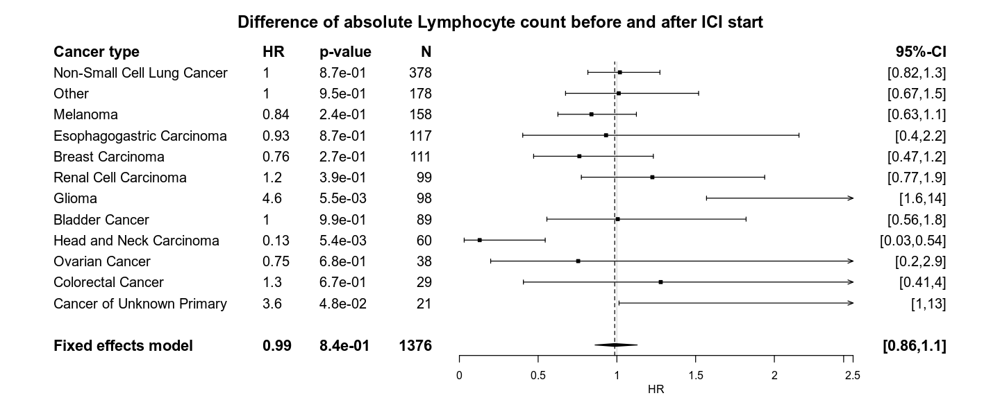

In [364]:
my_forest(tr,"diff.1","Difference of absolute Lymphocyte count before and after ICI start")

$Frequencies
           to
from        Treatment   AE Death no event total entering
  Treatment         0  463  1491      646           2600
  AE                0    0   258      277            535
  Death             0    0     0     1749           1749

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1780769 0.5734615 0.2484615
  AE        0.0000000 0.0000000 0.4822430 0.5177570
  Death     0.0000000 0.0000000 0.0000000 1.0000000

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


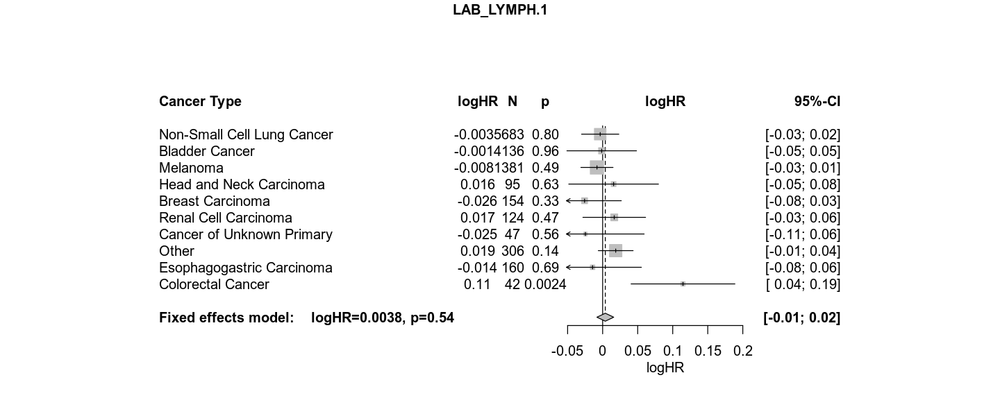

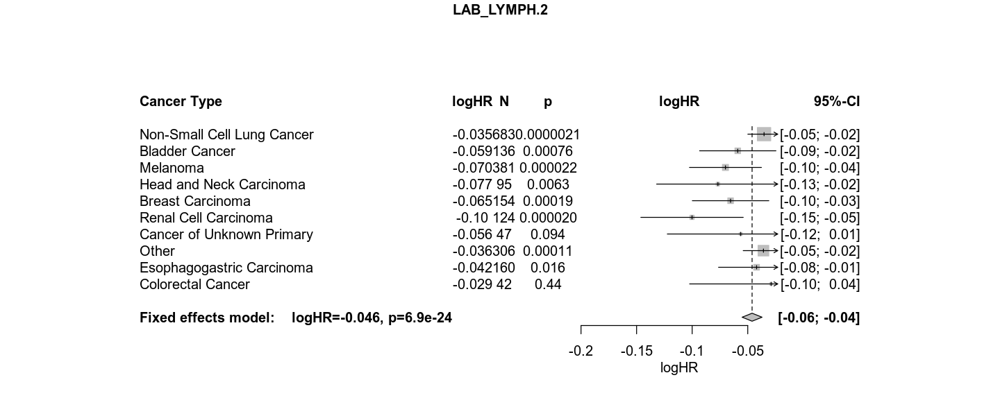

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL


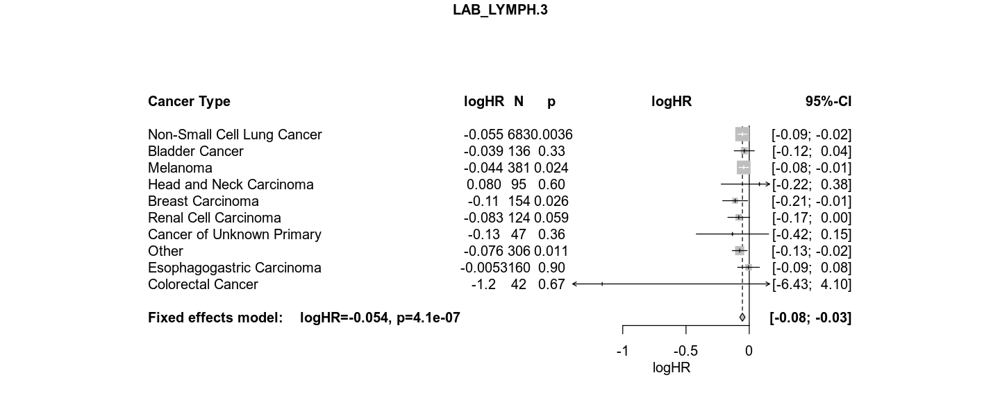

NULL


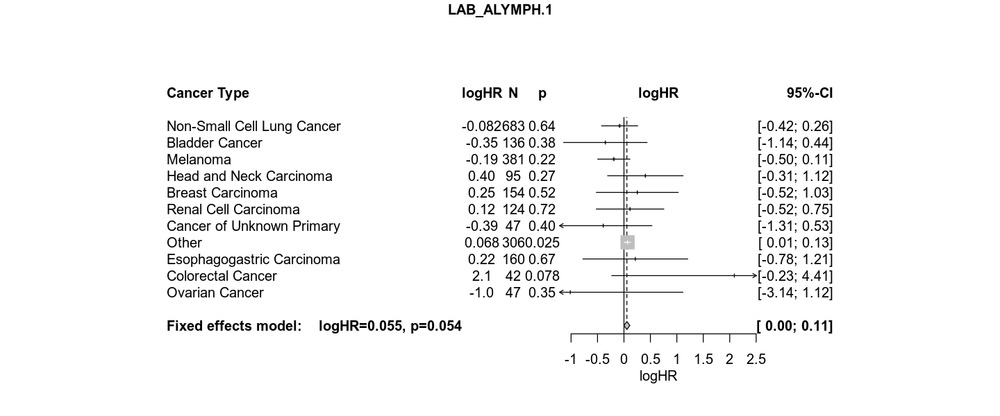

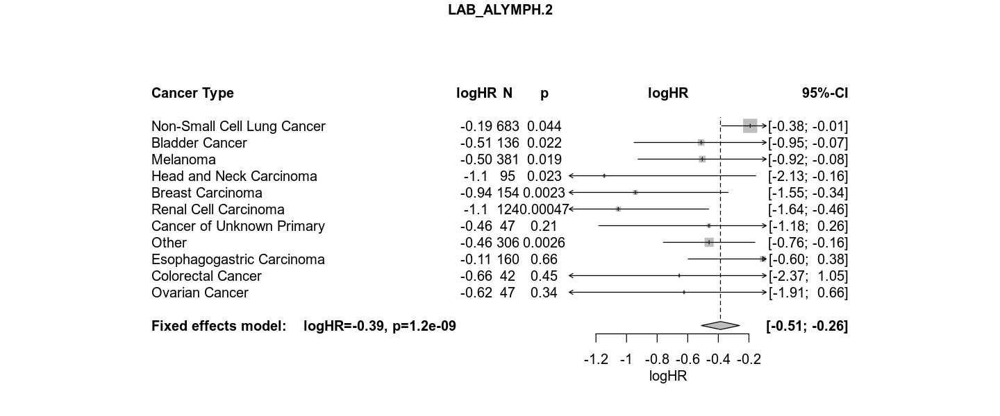

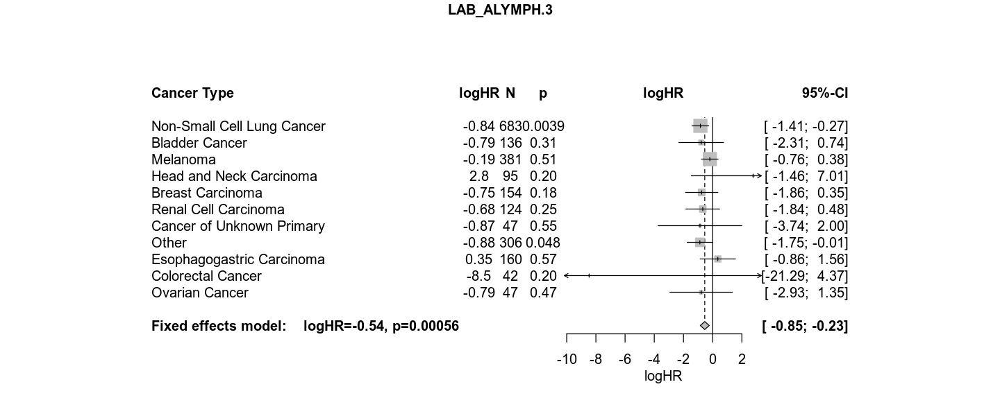

In [167]:
OS_lab <- make_multistate(OS)
tr <- meta_survival_AE("LAB_LYMPH",OS_lab)
tr <- meta_survival_AE("LAB_ALYMPH",OS_lab)

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL
NULL


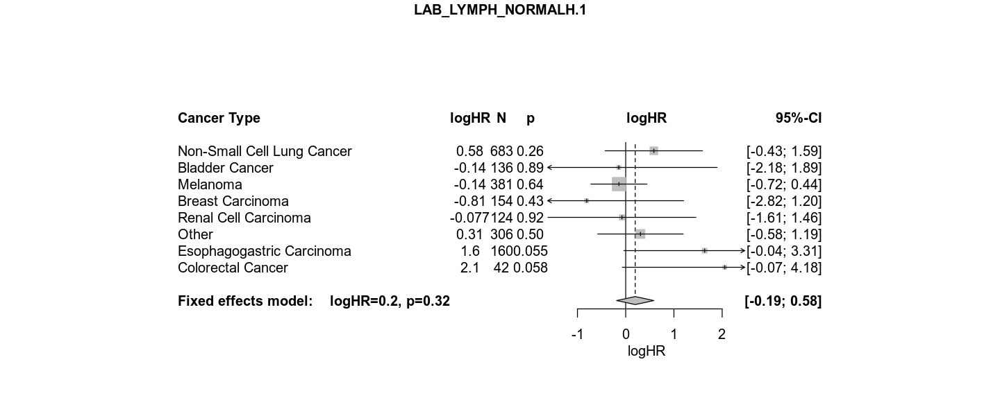

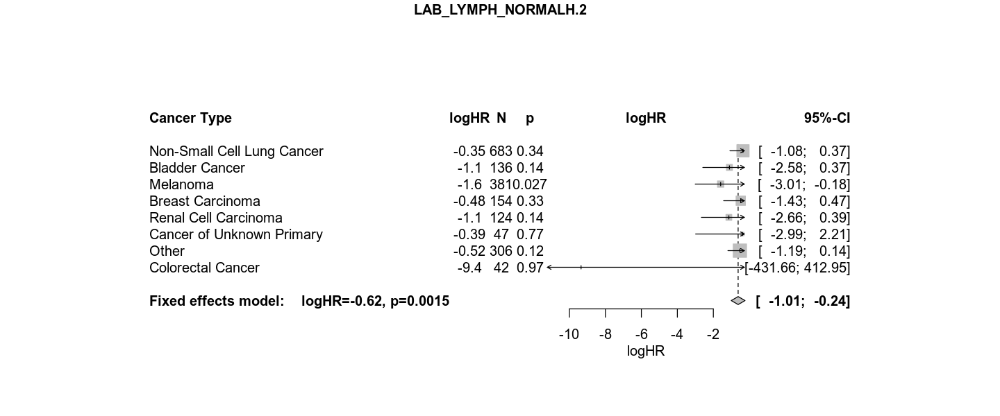

[1] "Error: Error in residuals.coxph(fit, \"schoenfeld\"): NA/NaN/Inf in foreign function call (arg 5)\n"
[1] "Cancer Glioma was unsuccesful"
NULL
NULL


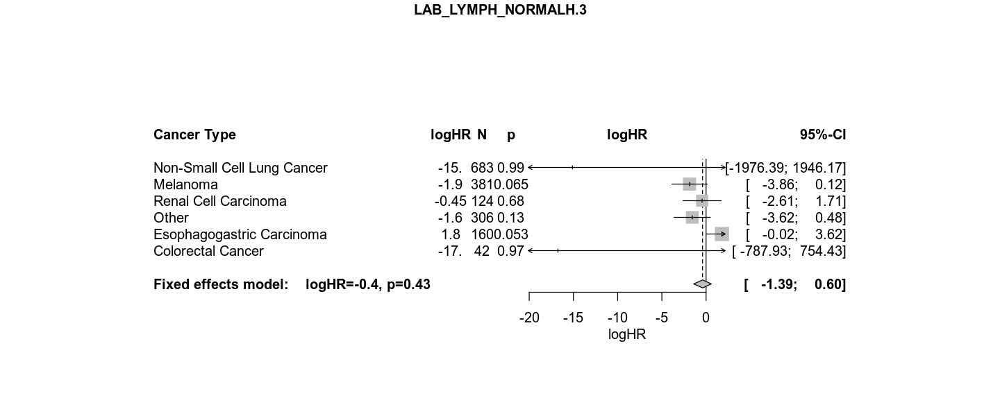

NULL


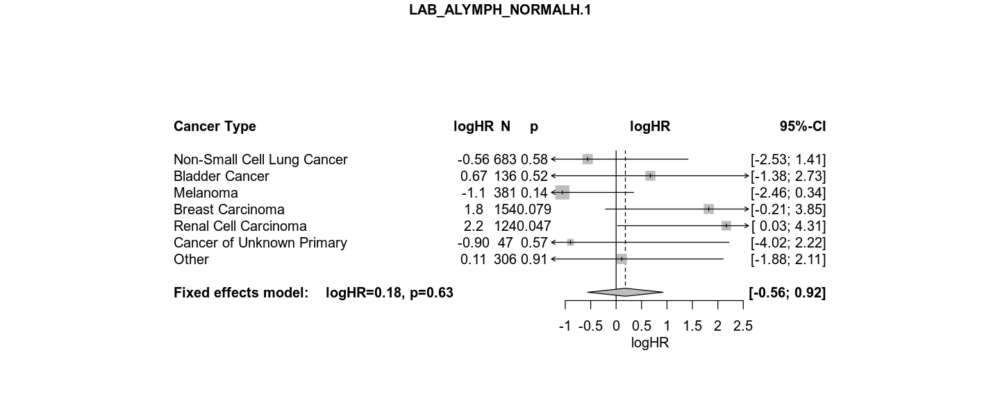

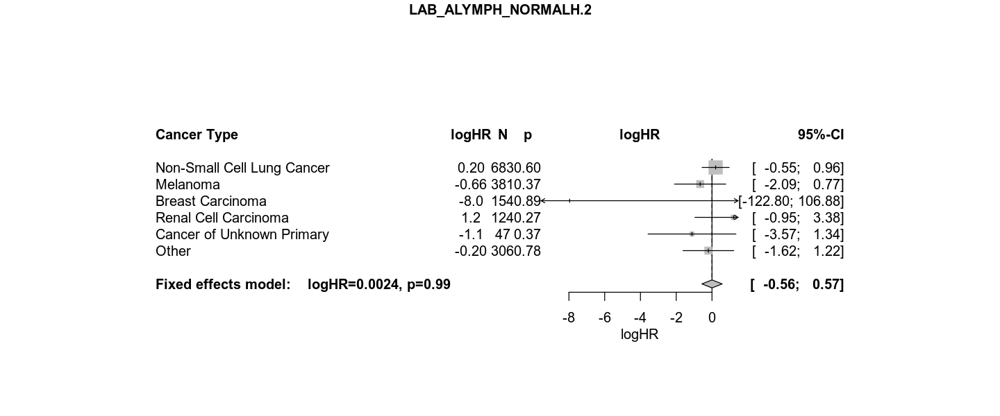

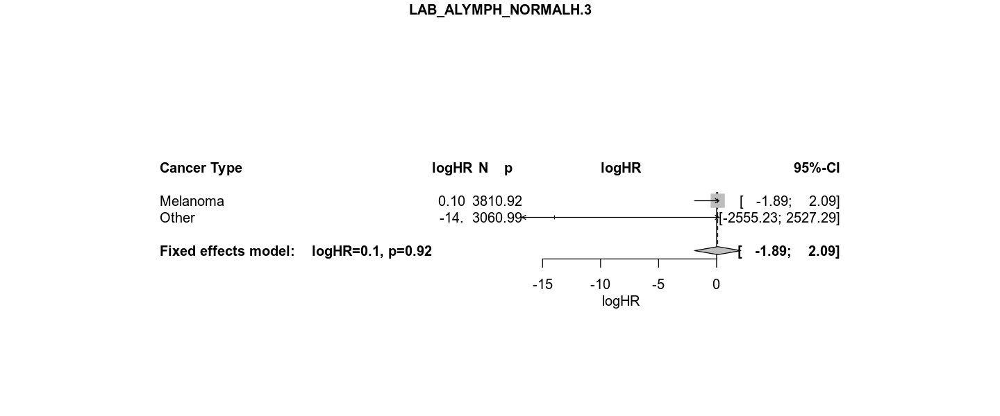

In [168]:
tr <- meta_survival_AE("LAB_LYMPH_NORMALH",OS_lab)
tr <- meta_survival_AE("LAB_ALYMPH_NORMALH",OS_lab)

NULL
NULL
NULL


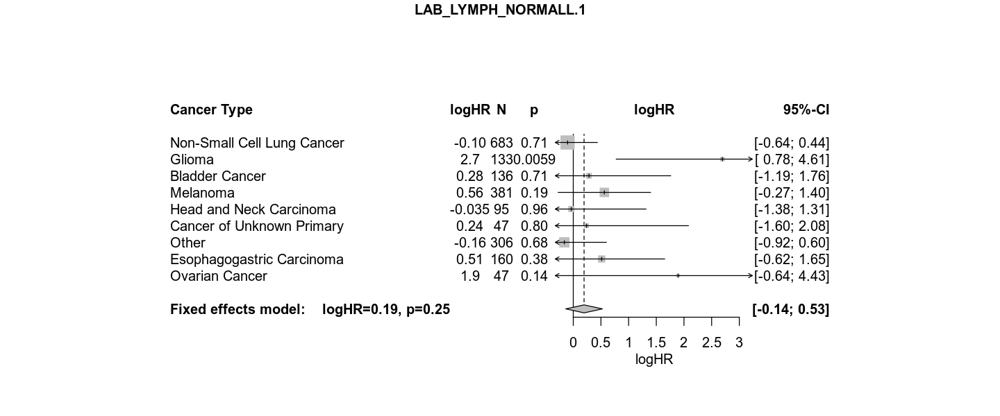

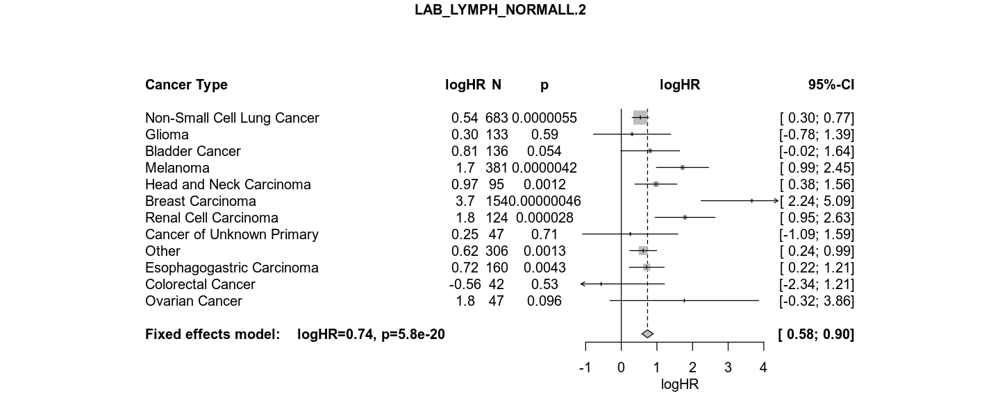

[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Glioma was unsuccesful"


Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in sqrt(diag(cox$var)):
“NaNs produced”Warning message in rma.uni(yi = TE, sei = seTE, method = method.tau, control = control):
“Studies with NAs omitted from model fitting.”

NULL
NULL


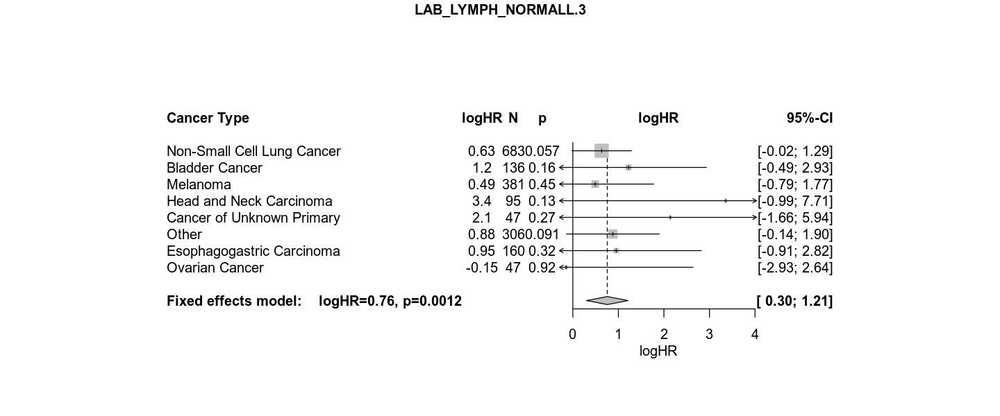

NULL


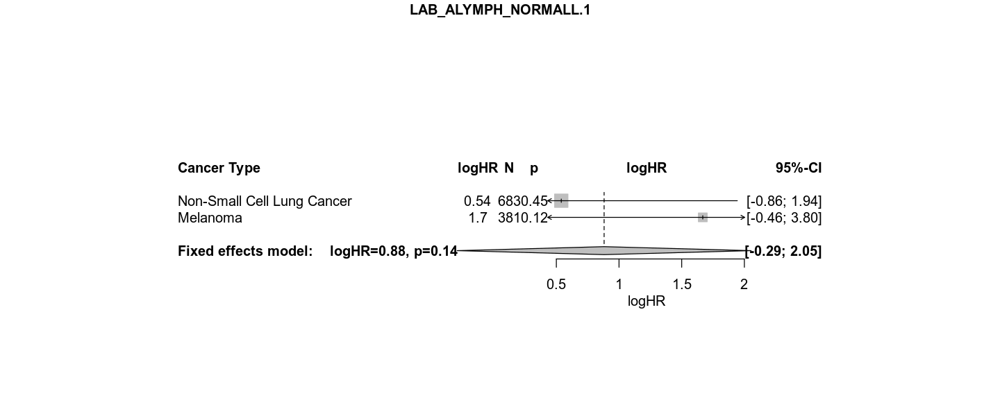

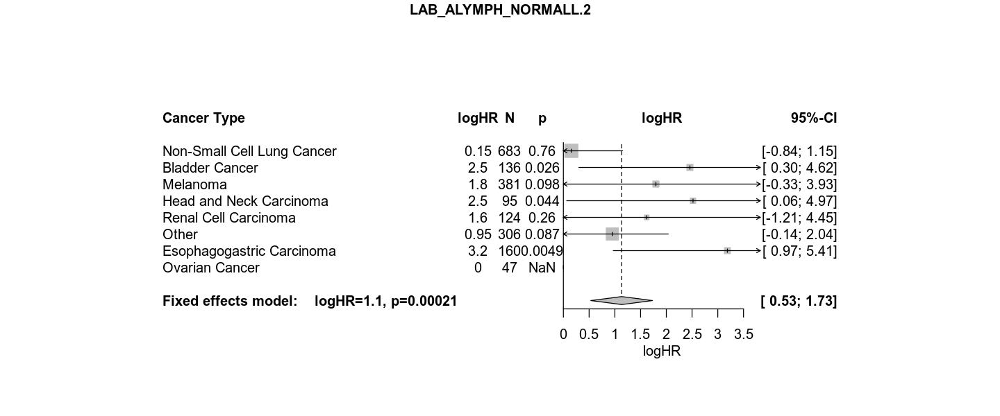

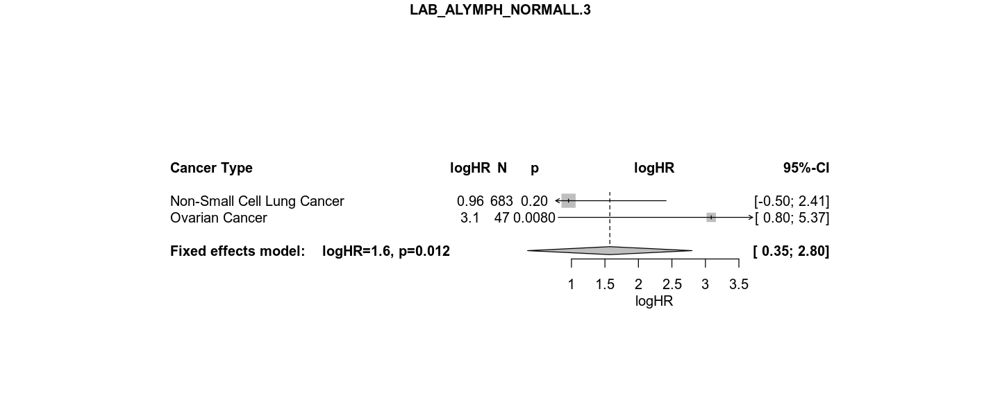

In [169]:
tr <- meta_survival_AE("LAB_LYMPH_NORMALL",OS_lab)
tr <- meta_survival_AE("LAB_ALYMPH_NORMALL",OS_lab)

# Comparison to chemo

In [76]:
OS_ALL <- fread("../OS/OS_ALL.csv",na.string="")
OS_ALL <- OS_ALL %>% mutate(LAST_DATE=as.Date(LAST_DATE),START_DATE=as.Date(START_DATE))

OS_ALL$PANEL_VERSION <- factor(OS_ALL$PANEL_VERSION)
OS_ALL$AGE_AT_TREATMENTSTART_BINNED <- factor(OS_ALL$AGE_AT_TREATMENTSTART_BINNED)
OS_ALL$ANCESTRY_SELFREPORTED <- factor(OS_ALL$ANCESTRY_SELFREPORTED)
OS_ALL$ANCESTRY_SELFREPORTED <- relevel(OS_ALL$ANCESTRY_SELFREPORTED,"White")
OS_ALL$ANCESTRY_GENETICS <- factor(OS_ALL$ANCESTRY_GENETICS)
OS_ALL$ANCESTRY_GENETICS <- relevel(OS_ALL$ANCESTRY_GENETICS,"EUR")
OS_ALL$TMB_binned <- factor(OS_ALL$TMB_binned)
OS_ALL$TMB_binned <- relevel(OS_ALL$TMB_binned,"0")
OS_ALL$PROFILE_AFTER_TREATMENT <- factor(OS_ALL$PROFILE_AFTER_TREATMENT)
OS_ALL$GENDER <- factor(OS_ALL$GENDER)
OS_ALL$PANEL_VERSION <- factor(OS_ALL$PANEL_VERSION)
OS_ALL$PANEL_VERSION <- relevel(OS_ALL$PANEL_VERSION,"3")
OS_ALL$START_YEAR <- factor(OS_ALL$START_YEAR)
levels(OS_ALL$START_YEAR) <- gsub(">","after",gsub("<","before",gsub("/","_",levels(OS_ALL$START_YEAR))))
OS_ALL$START_YEAR <- relevel(OS_ALL$START_YEAR,"2016")
OS_ALL$TPLAN_GOAL <- factor(OS_ALL$TPLAN_GOAL)
OS_ALL$TPLAN_GOAL <- relevel(OS_ALL$TPLAN_GOAL,"PALLIATIVE")
OS_ALL$STAGE <- factor(OS_ALL$STAGE)
OS_ALL$STAGE <- relevel(OS_ALL$STAGE,"STAGE1_2")

OS_ALL <- OS_ALL %>% mutate_if(function(x) !inherits(x, 'Date'),function(x) na_if(x,""))

In [77]:
OS_ALL <- OS_ALL %>% mutate(CANCER_TYPE=ifelse(CANCER_TYPE %in% unique(fread("../OS/OS_ALL.csv")$CANCER_TYPE),CANCER_TYPE,"Other"))

In [78]:
OS_ALL <- OS_ALL %>% mutate_at(vars(matches("LAB_.*_NORMAL")),function(x) try(relevel(as.factor(x),"N")))

Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level
Error in relevel.factor(as.factor(x), "N") : 
  'ref' must be an existing level


In [79]:
make_multistate_chemo <- function(OS_temp) {
    if ("CBIO_PATIENT" %in% names(OS_temp)) {
        OS_temp <- OS_temp %>% select(-CBIO_PATIENT)
    }
    temp <- merge(OS_temp,fread("pseudo_adverse_events_chemo_predicted.csv",na.strings="") %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN")) %>% mutate(irAE_time=as.integer(ifelse(ADV_EVENT,as.integer(difftime(ADV_EVENT_DT,START_DATE,unit="days")),tstop)),irAE=as.numeric(ifelse(ADV_EVENT,1,0))) %>% select(-ADV_EVENT_DT,-ADV_EVENT)
#     temp <- merge(OS_temp,fread("predcur.csv",na.strings="") %>% select(MRN,ADV_EVENT,ADV_EVENT_DT) %>% mutate(ADV_EVENT_DT=as.Date(ADV_EVENT_DT)),by=c("MRN")) %>% mutate(irAE_time=as.integer(ifelse(ADV_EVENT,as.integer(difftime(ADV_EVENT_DT,START_DATE,unit="days")),tstop)),irAE=as.numeric(ifelse(ADV_EVENT,1,0))) %>% select(-ADV_EVENT_DT,-ADV_EVENT)
    temp <- temp %>% mutate(irAE_time=as.integer(ifelse(irAE_time==0,1,irAE_time)),tstop=as.integer(ifelse(tstop<=irAE_time,irAE_time,tstop)))
    temp <- temp %>% drop_na(irAE_time)
    tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
    OS_mult <- msprep(data = temp, trans = tmat, time = c(NA, "irAE_time", "tstop"), status = c(NA, "irAE", "event"), id="MRN")
    OS_mult <- merge(OS_mult,temp,by="MRN") %>% rowwise %>% mutate(Tstart=max(tstart,Tstart),time=Tstop-Tstart) %>% select(-irAE_time,-tstart,-tstop,-event,-irAE,-id)
    OS_mult <- OS_mult %>% filter(Tstop>Tstart)

    attributes(OS_mult)$class <- c("msdata","data.frame")
    attributes(OS_mult)$trans <- tmat

    print(events(OS_mult))
    OS_mult <- OS_mult %>% select_if(function(x) ifelse(is.factor(x),length(levels(x))>=2,ifelse(is.character(x),length(levels(as.factor(x)))>=2,TRUE)))
    covs <- names(OS_mult %>% select(-MRN,-from,-to,-trans,-Tstart,-Tstop,-time,-status,-START_DATE,-AGE_AT_TREATMENTSTART_BINNED,-LAST_DATE,-PRIMARY_CANCER_DIAGNOSIS,-CANCER_TYPE,-anyIO_firstdate))
    OS_mult <- expand.covs(OS_mult, covs, longnames = T)
    return(OS_mult)
}

In [80]:
GWAS_chemo <- fread('topsnp_fullcohort.raw') %>% select(IID,`8:79557237_C`,`8:79712998_G`)
GWAS_chemo <- data.frame(GWAS_chemo)
names(GWAS_chemo) <- c("PBP","rs7011565","rs16906115")
GWAS_chemo <- GWAS_chemo %>% mutate(PBP=gsub("^0_","",PBP))

seq_date <- fread("../../../OncDRS_data/ALL/GENOMIC_SPECIMEN.csv") %>% select(PATIENT_ID,TEST_ORDER_DT) %>% mutate(TEST_ORDER_DT=as.Date(TEST_ORDER_DT,format="%d-%b-%y")) %>% inner_join(translate_sid %>% select(PBP,PATIENT_ID))
GWAS_chemo <- inner_join(GWAS_chemo,seq_date) %>% arrange(PATIENT_ID,TEST_ORDER_DT) %>% group_by(PATIENT_ID) %>% summarise_all(last) %>% select(-TEST_ORDER_DT,-PATIENT_ID)                               

temp_trans <- inner_join(translate_sid %>% select(PATIENT_ID,PBP),translate_pid %>% select(PATIENT_ID,MRN)) %>% select(-PATIENT_ID)
OS_GWAS_chemo <- inner_join(inner_join(OS_ALL,temp_trans),GWAS_chemo) %>% select(-PBP)
OS_GWAS_chemo <- make_multistate_chemo(OS_GWAS_chemo) 

Joining, by = "PATIENT_ID"
Joining, by = "PBP"
Joining, by = "PATIENT_ID"
Joining, by = "MRN"
Joining, by = "PBP"
Warning message in msprepEngine(time = time, status = status, id = id, starttime = starttime, :
“Starting from state 1, simultaneous transitions possible for subjects 394591 704277 831404 at times 1012 1118 753; smallest receiving state chosen”

$Frequencies
           to
from        Treatment    AE Death no event total entering
  Treatment         0  3002  8405    12356          23763
  AE                0     0  1274     1677           2951
  Death             0     0     0     9679           9679

$Proportions
           to
from        Treatment        AE     Death  no event
  Treatment 0.0000000 0.1263309 0.3537011 0.5199680
  AE        0.0000000 0.0000000 0.4317181 0.5682819
  Death     0.0000000 0.0000000 0.0000000 1.0000000



In [81]:
# OS_GWAS_chemo <- OS_GWAS_chemo %>% mutate(rs16906115 = 2-rs16906115)

In [82]:
vie_chemo <- list(trans1=c("anyIO","GENDER"),trans2=c("anyIO","GENDER"),trans3=c("anyIO","GENDER","Tstart"))
via_chemo <- c("PANEL_VERSION","AGE_AT_TREATMENTSTART","LINE_OF_TREATMENT","START_YEAR","ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2")

[1] "Error: Error in quantile.default(get(csv), prob = c(1/3, 2/3)): factors are not allowed\n"
[1] "Cancer Esophagogastric Carcinoma was unsuccesful"
NULL
NULL
NULL


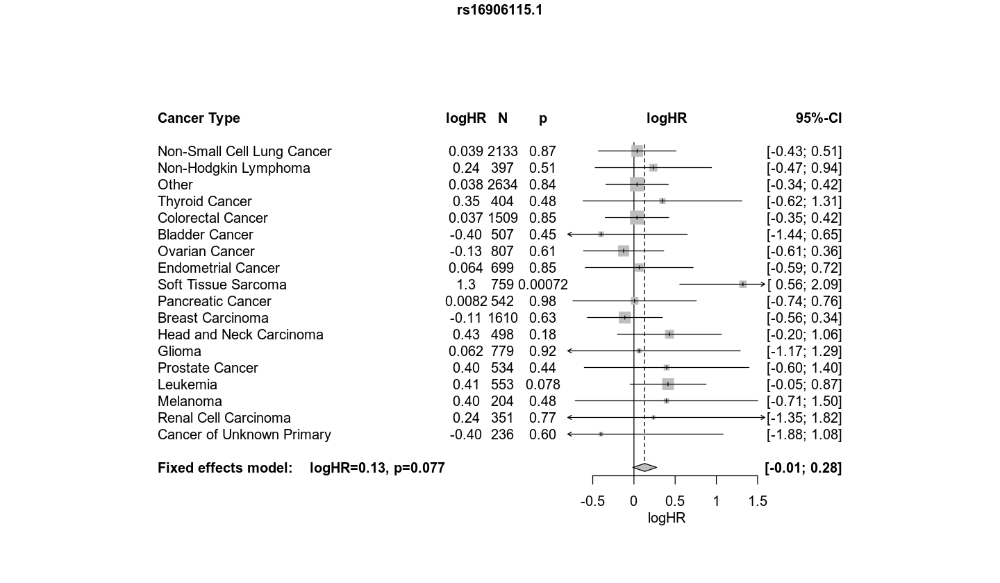

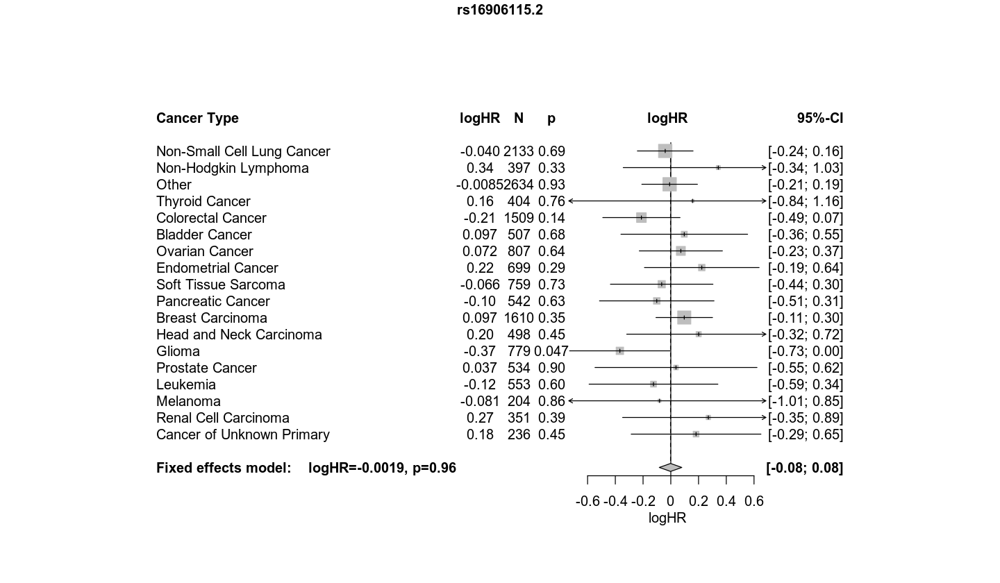

[1] "Error: Error in quantile.default(get(csv), prob = c(1/3, 2/3)): factors are not allowed\n"
[1] "Cancer Bladder Cancer was unsuccesful"
[1] "Error: Error in fitter(X, Y, strats, offset, init, control, weights = weights, : routine failed due to numeric overflow.This should never happen.  Please contact the author.\n"
[1] "Cancer Non-Hodgkin Lymphoma was unsuccesful"
[1] "Error: Error in quantile.default(get(csv), prob = c(1/3, 2/3)): factors are not allowed\n"
[1] "Cancer Leukemia was unsuccesful"
NULL
NULL


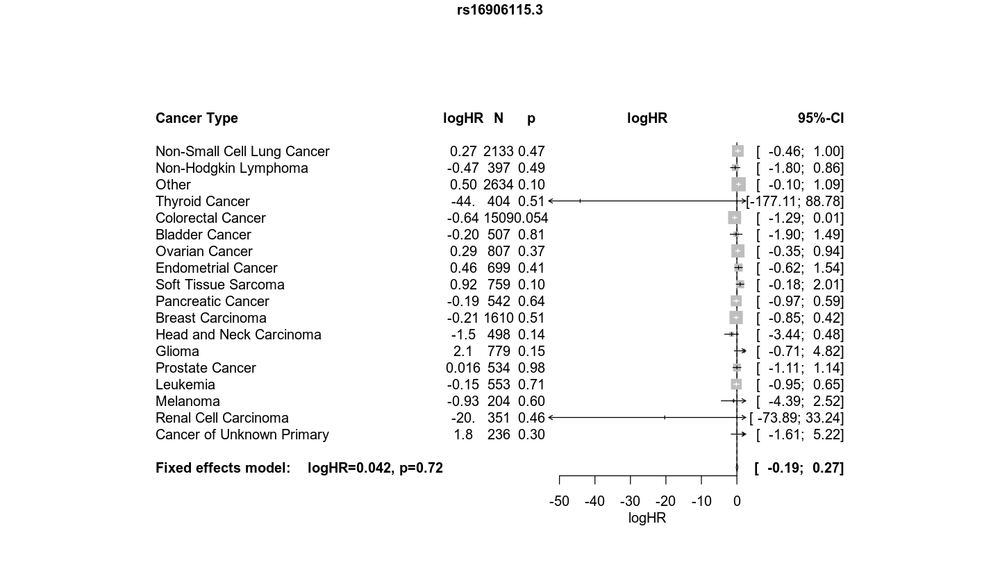

NULL


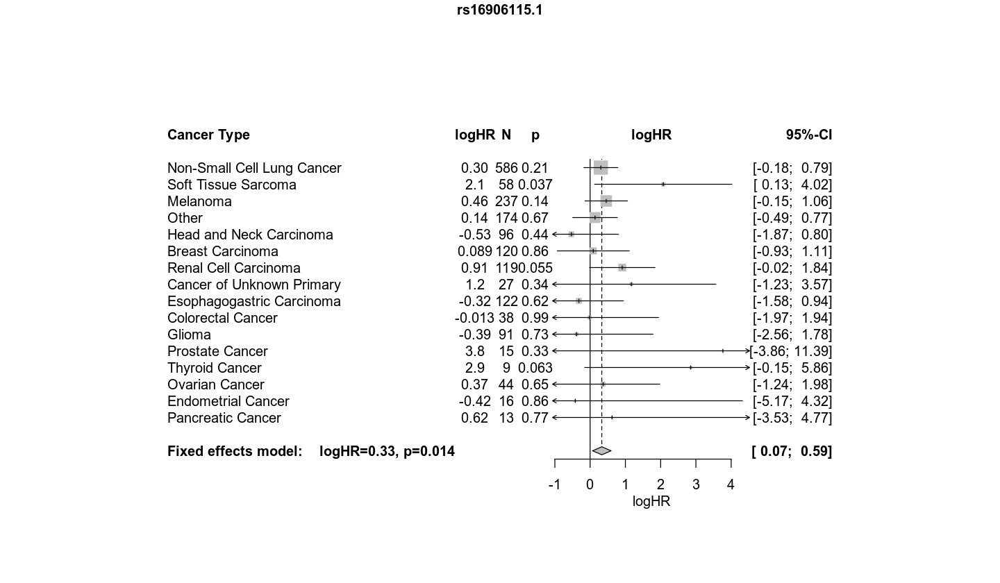

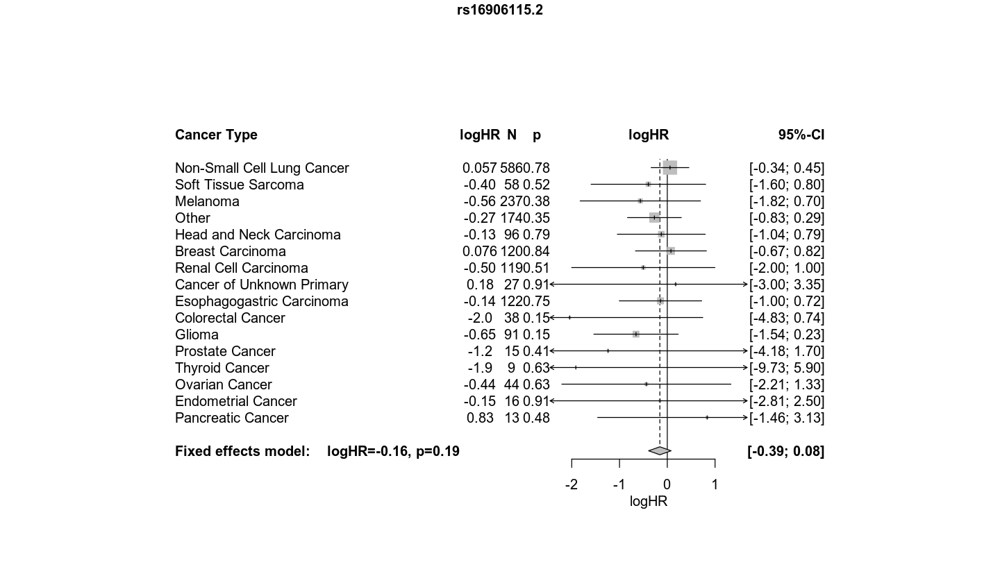

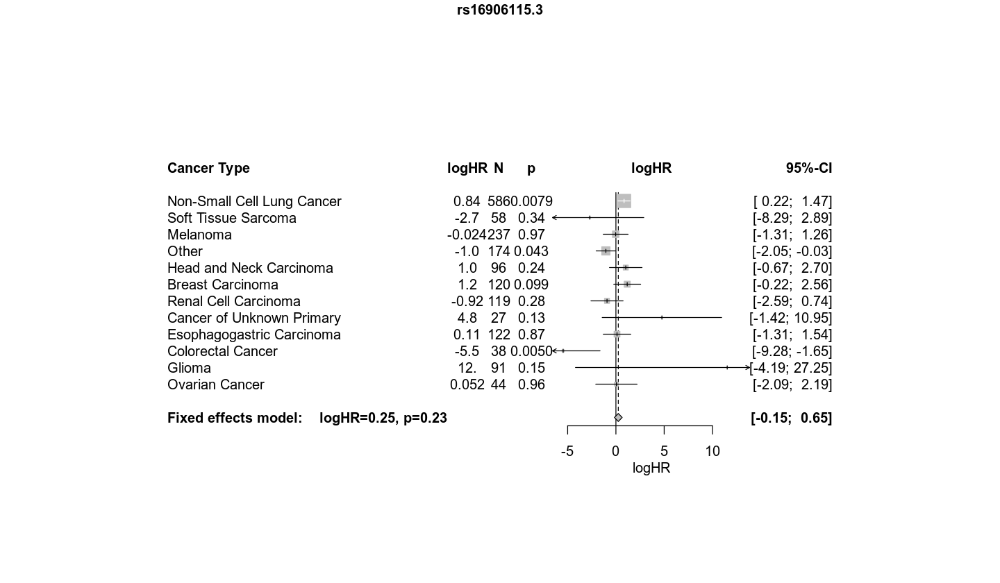

In [84]:
options_save <- options()
options(repr.plot.width=12, repr.plot.height=7)
tr <- meta_survival_AE(c("rs16906115"),OS_GWAS_chemo  %>% filter(anyIO==0) %>% mutate(rs16906115.1=2-rs16906115.1,rs16906115.2=2-rs16906115.2,rs16906115.3=2-rs16906115.3) %>% filter(before_2018==1),vars_in_all=via_chemo,vars_in_each = vie_chemo)
tr1 <- meta_survival_AE(c("rs16906115"),OS_GWAS_chemo %>% filter(anyIO==1) %>% mutate(rs16906115.1=2-rs16906115.1,rs16906115.2=2-rs16906115.2,rs16906115.3=2-rs16906115.3) %>% filter(before_2018==1),vars_in_all=via_chemo,vars_in_each = vie_chemo)
# tr <- meta_survival_AE(c("rs7011565_norm"),OS_GWAS_all %>% filter(anyIO==0),vars_in_all = c(via,"ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2"))
# tr <- meta_survival_AE(c("rs73251644"),OS_GWAS %>% filter(after2018==0) %>% filter(TRANSPLANT_IND==F,immune_suppressant==0),vars_in_all = c(via,"ANCESTRY_PC_ASH","ANCESTRY_PC_NS","ANCESTRY_ROT_PC1","ANCESTRY_ROT_PC2"))
options(options_save)

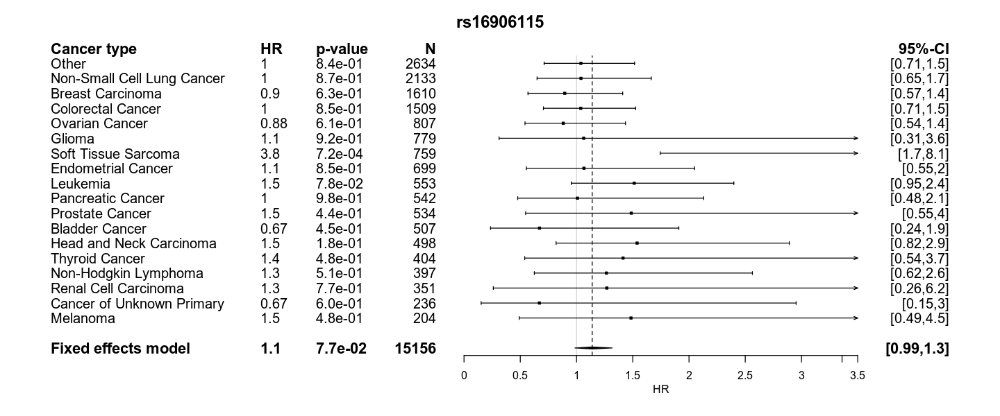

In [85]:
my_forest(tr,"rs16906115.1","rs16906115")

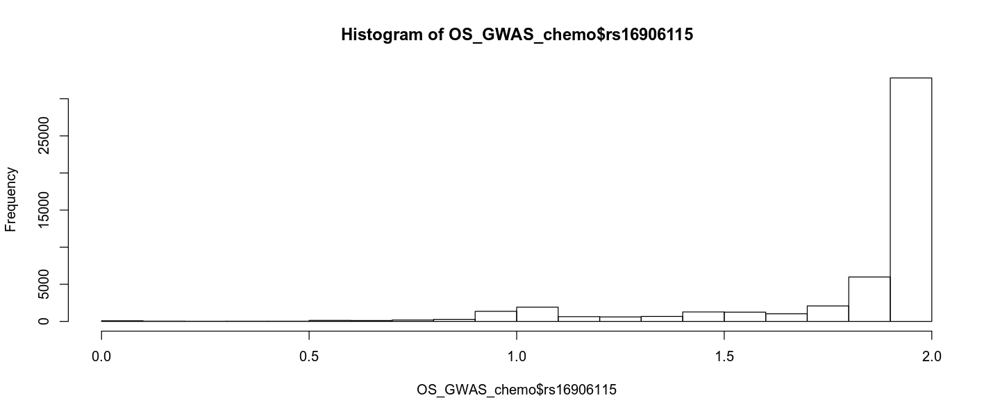

In [375]:
hist(OS_GWAS_chemo$rs16906115)

In [54]:
library(purrr)

prob_ae <- list()
temp <- OS_GWAS_chemo %>% filter(anyIO==0) %>% filter(rs16906115>=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp <- OS_GWAS_chemo %>% filter(anyIO==0) %>% filter(rs16906115<decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

prob_ae <- list()
tempdf <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115>=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = tempdf, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

tempdf <- OS_GWAS %>% filter(before_2018==1) %>% filter(rs16906115<decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = tempdf, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(3), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp1 <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp1[[names(prob_ae)[i]]] <- ttemp
    
}
temp1 <- temp1 %>% reduce(left_join, by = "time")

Warning message in sqrt(diag(varP)):
“NaNs produced”Warning message in sqrt(diag(varP)):
“NaNs produced”

Warning message:
“Removed 1 rows containing missing values (geom_path).”Warning message:
“Removed 1 rows containing missing values (geom_path).”

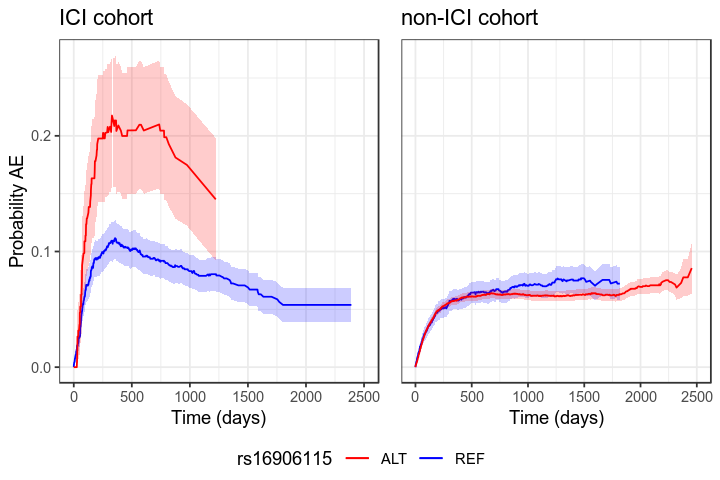

In [55]:
g_legend<-function(a.gplot){
  tmp <- ggplot_gtable(ggplot_build(a.gplot))
  leg <- which(sapply(tmp$grobs, function(x) x$name) == "guide-box")
  legend <- tmp$grobs[[leg]]
  return(legend)}

options_before <- options()
options(repr.plot.width=6,repr.plot.height=4)
g1 <- ggplot() + geom_line(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF")) + geom_ribbon(data=temp[!is.na(temp[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + geom_line(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT"),na.rm=T) + geom_ribbon(data=temp[!is.na(temp[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + scale_color_manual(name = "rs16906115", values=c("REF"="blue","ALT"="red")) + labs(x="Time (days)",y=NULL) + xlim(0,2500) + ylim(0,0.27) + theme_bw() + theme(legend.position="none",axis.text.y = element_blank(),axis.ticks.y = element_blank()) + ggtitle("non-ICI cohort")
g2 <- ggplot() + geom_line(data=temp1[!is.na(temp1[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF")) + geom_ribbon(data=temp1[!is.na(temp1[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="blue") + geom_line(data=temp1[!is.na(temp1[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT"),na.rm=T) + geom_ribbon(data=temp1[!is.na(temp1[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="red") + scale_color_manual(name = "rs16906115", values=c("REF"="blue","ALT"="red")) + labs(x="Time (days)",y="Probability AE") + xlim(0,2500) + ylim(0,0.27) + theme_bw() + theme(axis.title.x = element_text()) + theme(legend.position="bottom") + ggtitle("ICI cohort")

leg <- g_legend(g2)
                      
grid.arrange(arrangeGrob(g2 + theme(legend.position="none"), g1, nrow=1, widths = c(7,6)),leg,nrow=2,heights=c(10, 1))

Warning message:
“Removed 1 rows containing missing values (geom_path).”

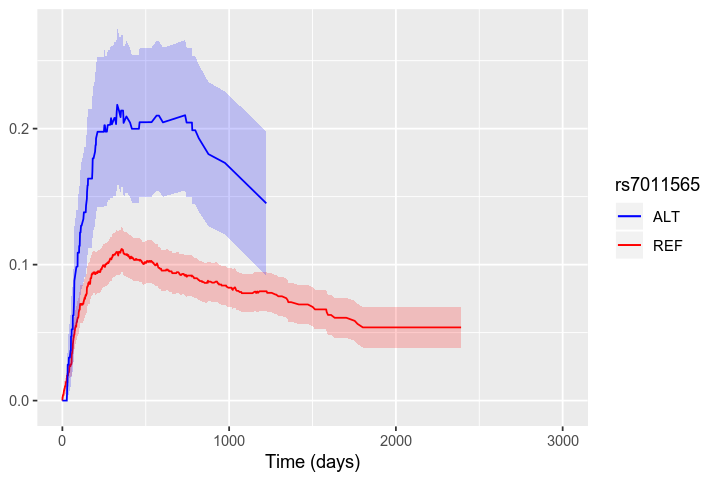

In [378]:
ggplot() + geom_line(data=temp1[!is.na(temp1[,"REF_pstate2"]),],aes(x=time,y=REF_pstate2,color="REF")) + geom_ribbon(data=temp1[!is.na(temp1[,"REF_pstate2"]),],aes(x=time,ymax=REF_pstate2+qnorm(0.975)*REF_se2,ymin=REF_pstate2-qnorm(0.975)*REF_se2),alpha=0.2,fill="red") + geom_line(data=temp1[!is.na(temp1[,"ALT_pstate2"]),],aes(x=time,y=ALT_pstate2,color="ALT"),na.rm=T) + geom_ribbon(data=temp1[!is.na(temp1[,"ALT_pstate2"]),],aes(x=time,ymax=ALT_pstate2+qnorm(0.975)*ALT_se2,ymin=ALT_pstate2-qnorm(0.975)*ALT_se2),alpha=0.2,fill="blue") + scale_color_manual(name = "rs7011565", values=c("REF"="red","ALT"="blue")) + labs(x="Time (days)",y=NULL) + xlim(0,3000) + theme(axis.title.x = element_text())

In [379]:
prob_ae <- list()
temp <- OS_GWAS_chemo %>% filter(anyIO==0) %>% filter(rs16906115>=decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["ALT"]] <- pt0

temp <- OS_GWAS_chemo %>% filter(anyIO==0) %>% filter(rs16906115<decision_boundary)
c0 <- coxph(Surv(Tstart, Tstop, status) ~ strata(trans), data = temp, method = "breslow")
tmat <- transMat(x = list(c(2,3), c(), c()), names = c("Treatment", "AE", "Death"))
msf0 <- msfit(object = c0, vartype = "aalen", trans = tmat)
#     plot(msf0)
pt0 <- probtrans(msf0,predt=0)
prob_ae[["REF"]] <- pt0

temp <- list()
for (i in 1:length(names(prob_ae))) {
    ttemp <- prob_ae[names(prob_ae)[i]][[1]][[1]]
    names(ttemp) <- gsub("(pstate|se)",paste(names(prob_ae)[i],"_\\1",sep=""),names(ttemp))
    temp[[names(prob_ae)[i]]] <- ttemp
    
}
temp <- temp %>% reduce(left_join, by = "time")

# RCC blood draw

In [ ]:
library(openxlsx)
library(ggplot2)

In [ ]:
dates <- read.xlsx("RCC_MRN_ICI_Plasma_Timing .xlsx",sheet = 2) %>% mutate(DATE_COLL=convertToDate(DATE_COLL)) %>% select(PPID,DATE_COLL) %>% rename(MRN=PPID) %>% distinct()
irAE <- fread("adverse_events_truenegcorrected.csv",na.strings="") %>% select(MRN,ADV_EVENT,ADV_EVENT_DT)
rcc <- inner_join(inner_join(OS_IO,dates) %>% select(MRN,DATE_COLL,IO_START),irAE)

In [ ]:
rcc_diff <- rcc %>% mutate(io_diff = abs(as.integer(difftime(IO_START,DATE_COLL,unit="days"))),irae_diff = abs(as.integer(difftime(ADV_EVENT_DT,DATE_COLL,unit="days"))))
rcc_diff <- rcc_diff %>% group_by(MRN) %>% summarise_all(min) %>% select(MRN,io_diff,irae_diff)
rcc_diff %>% ggplot(.) + geom_histogram(aes(io_diff),bins=100)
rcc_diff %>% ggplot(.) + geom_histogram(aes(irae_diff),bins=100)

In [ ]:
median(rcc_diff$io_diff)
median(rcc_diff$irae_diff,na.rm=T)